### Check GPU

In [1]:
# Data manipulation
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os

#Pytorch
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

from PIL import Image
import matplotlib.pyplot as plt

! pip install torchsummary
from torchsummary import summary
from torch.utils.tensorboard import SummaryWriter
from torchvision import models
from tqdm.notebook import tqdm


In [2]:
from tensorboard import version; print(version.VERSION)

2.4.1


In [3]:
# check GPU support
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

### Dataset and dataloader

In [4]:
PATH = '../input/face-recognition/' 

In [5]:
def save_checkpoint(save_path, model, optimizer, val_loss):
    if save_path==None:
        return
    save_path = save_path 
    state_dict = {'model_state_dict': model.state_dict(),
                  'optimizer_state_dict': optimizer.state_dict(),
                  'val_loss': val_loss}

    torch.save(state_dict, save_path)
    print(f'Model saved to {save_path}')

def load_checkpoint(save_path, model, optimizer):
    save_path = save_path #f'cifar_net.pt'
    state_dict = torch.load(save_path)
    model.load_state_dict(state_dict['model_state_dict'])
    optimizer.load_state_dict(state_dict['optimizer_state_dict'])
    val_loss = state_dict['val_loss']
    print(f'Model loaded from {save_path}, with val loss: {val_loss}')
    return val_loss

### 4.2.5 Improving your Model

#### D. Architecture

#### Adopting the ResNet-18

In [6]:
class ImageDatasetRGB(Dataset):
    def __init__(self, info_file, index_file, image_dir, transform=None):
        self.info_df = pd.read_csv(info_file)  
        self.index_df = pd.read_csv(index_file, sep=',',header =None,names=['index','source'])
        #self.classes = np.array(self.info_df.columns[1:]) # image labels 
        self.image_dir = image_dir
        self.transform = transform

    def __getitem__(self, idx):
        img_index1 = self.info_df.iloc[idx, 0]
        img_name1 = os.path.join(self.image_dir, str(self.index_df.iloc[img_index1-1, 1])[5:])
        image1 = Image.open(img_name1)
        image1 = image1.convert('RGB')
        
        img_index2 = self.info_df.iloc[idx, 1]
        img_name2 = os.path.join(self.image_dir, str(self.index_df.iloc[img_index2-1, 1])[5:])
        image2 = Image.open(img_name2)
        image2 = image2.convert('RGB')
        
        label = self.info_df.iloc[idx, 2]
        
        if self.transform is not None:
            image1 = self.transform(image1)
            image2 = self.transform(image2)
        
        return image1, image2, label

    def __len__(self):
        return len(self.info_df)

In [7]:
transform = transforms.Compose(
    [transforms.Resize((64,64)), 
     transforms.ToTensor(),    # range [0, 255]  -> [0.0,1.0] Convert a PIL Image or numpy.ndarray (H x W x C)  to tensor (C x H x W) 
     transforms.Normalize((0.5, 0.5, 0.5 ), (0.5, 0.5, 0.5))   # channel=（channel-mean）/std  -> [-1, 1]
     ])

In [8]:
train_setRGB = ImageDatasetRGB(PATH + 'train.csv', PATH + 'index.txt', PATH, transform=transform)
valid_setRGB = ImageDatasetRGB(PATH + 'valid.csv', PATH + 'index.txt', PATH, transform=transform)
test_setRGB = ImageDatasetRGB(PATH + 'test.csv', PATH + 'index.txt', PATH, transform=transform)

train_loaderRGB = DataLoader(train_setRGB, batch_size=56, shuffle=True)
valid_loaderRGB = DataLoader(valid_setRGB, batch_size=56, shuffle=False)
test_loaderRGB = DataLoader(test_setRGB, batch_size=56,shuffle=False)

In [9]:
class Net(nn.Module): # without skip layer
    def __init__(self, aggregation_type):
        super(Net, self).__init__()
        
        self.cnn = nn.Sequential(
            #first layer
            nn.Conv2d(in_channels=3, out_channels=64, kernel_size=7,stride=1, padding = 3), 
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            
            nn.MaxPool2d(kernel_size=3, stride=2),
            
            #identical ConvNets Layer 1
            
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(in_channels=64, out_channels=64, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            
            #identical ConvNets Layer 2
            
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding = 1,stride = 2),  
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(in_channels=128, out_channels=128, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            
            #identical ConvNets Layer 3
            
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding = 1,stride = 2),  
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            
            #identical ConvNets Layer 4
            
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding = 1,stride = 2),  
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(in_channels=512, out_channels=512, kernel_size=3, padding = 1),  
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            
            
            nn.AvgPool2d(kernel_size=4,stride=1),
            
            nn.Flatten(),
            
        )
        self.aggregation_type = aggregation_type
        if(self.aggregation_type=="concatenation"):
            self.fc1 = nn.Linear(1024,512) # concatenation
        elif(self.aggregation_type=="absolute_substraction"):
            self.fc1 = nn.Linear(512,512) # absolute substraction
        self.drop_out = nn.Dropout(p=0.5)
        self.fc2 = nn.Linear(512,512)
        self.fc3 = nn.Linear(512,1)

    def forward(self, image1, image2):
        
        image1 = self.cnn(image1)
        image2 = self.cnn(image2)
        
        if(self.aggregation_type=="concatenation"):
            h3 = torch.cat((image1,image2),1) #concatenation
        elif(self.aggregation_type=="absolute_substraction"):
            h3 = torch.abs(torch.sub(image1, image2)) #absolute substraction
        print(h3)
        output = self.fc1(h3)
        output = F.relu(output)
        output = self.drop_out(output)
        
        output = F.relu(self.fc2(output))
        output = self.drop_out(output)
        
        output = self.fc3(output)
        output = nn.Sigmoid()(output)
        
        return output

In [10]:
netVGG_11_absolute_substraction = Net("absolute_substraction").cuda()
summary(netVGG_11_absolute_substraction, [(3, 64, 64),(3, 64, 64)])

tensor([[0.1007, 0.2165, 0.0613,  ..., 0.3230, 0.0732, 0.0538],
        [0.1342, 0.1891, 0.0731,  ..., 0.3648, 0.0401, 0.0084]],
       device='cuda:0', grad_fn=<AbsBackward>)
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 64, 64, 64]           9,472
       BatchNorm2d-2           [-1, 64, 64, 64]             128
              ReLU-3           [-1, 64, 64, 64]               0
         MaxPool2d-4           [-1, 64, 31, 31]               0
            Conv2d-5           [-1, 64, 31, 31]          36,928
       BatchNorm2d-6           [-1, 64, 31, 31]             128
              ReLU-7           [-1, 64, 31, 31]               0
            Conv2d-8           [-1, 64, 31, 31]          36,928
       BatchNorm2d-9           [-1, 64, 31, 31]             128
             ReLU-10           [-1, 64, 31, 31]               0
           Conv2d-11           [-1, 64, 31, 31]        

In [11]:
def TRAIN_VGG(net, train_loader, valid_loader,  num_epochs, criterion, optimizer, val_loss,threshold, device, save_name):
    
    step_list = []
    training_loss_list = []
    valid_loss_list = []
    
    if val_loss==None:
        best_val_loss = float("Inf")  
    else: 
        best_val_loss=val_loss
        print('Resume training')


    no_step = 0;
    for epoch in range(num_epochs):  # loop over the dataset multiple times
        net.train()
        running_loss = 0.0
        running_corrects = 0
        for input1,input2, labels in tqdm(train_loader):
            
            no_step +=1
            input1 = input1.to(device)
            input2 = input2.to(device)
            labels = labels.to(device)
            
            labels = labels.unsqueeze(1)
            labels = labels.float()

            '''Training of the model'''
            # Forward pass
            outputs = net(input1, input2)
            
            loss = criterion(outputs, labels)

            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            training_loss = loss.item()
            running_loss += loss.item()
            preds = torch.gt(outputs, threshold).int()                       
            running_corrects += torch.sum(preds == labels.data)            
            
            with torch.no_grad():
                net.eval()
                running_loss_valid = 0.0
                running_corrects_valid = 0
                for input1_valid,input2_valid, labels_valid in tqdm(valid_loader,leave=False):
            
                    input1_valid = input1_valid.to(device)
                    input2_valid = input2_valid.to(device)
                    labels_valid = labels_valid.to(device)

                    labels_valid = labels_valid.unsqueeze(1)
                    labels_valid = labels_valid.float()

                    outputs_valid = net(input1_valid,input2_valid)
                    loss_valid = criterion(outputs_valid, labels_valid)

                    running_loss_valid += loss_valid.item()
                    preds_valid = torch.gt(outputs_valid, threshold).int()
                    running_corrects_valid += torch.sum(preds_valid == labels_valid.data)

                valid_loss = running_loss_valid / len(valid_loader)
                valid_acc = running_corrects_valid / float(len(valid_loader.dataset))
            
            if(no_step%10==0):
                step_list.append(no_step)
                training_loss_list.append(training_loss)
                valid_loss_list.append(valid_loss)
                
                print("step ",no_step," training loss: ",training_loss,", validation loss: ",valid_loss,"\n")
            

        train_loss = running_loss / len(train_loader)
        train_acc = running_corrects / float(len(train_loader.dataset))

        with torch.no_grad():
            net.eval()
            running_loss = 0.0
            running_corrects = 0
            for input1,input2, labels in tqdm(valid_loader):
            
                input1 = input1.to(device)
                input2 = input2.to(device)
                labels = labels.to(device)
                
                labels = labels.unsqueeze(1)
                labels = labels.float()

                outputs = net(input1,input2)
                loss = criterion(outputs, labels)

                running_loss += loss.item()
                preds = torch.gt(outputs, threshold).int()
                running_corrects += torch.sum(preds == labels.data)

            valid_loss = running_loss / len(valid_loader)
            valid_acc = running_corrects / float(len(valid_loader.dataset))

        print('Epoch [{}/{}], Train Loss: {:.4f}, Train Acc: {:.4f}, Valid Loss: {:.4f},  Valid Acc: {:.4f}'
              .format(epoch+1, num_epochs, train_loss, train_acc, valid_loss, valid_acc))

        if valid_loss < best_val_loss:
            best_val_loss = valid_loss
            save_checkpoint(save_name, net, optimizer, best_val_loss)
    
    plt.plot(step_list,training_loss_list,label="Training Loss")
    plt.plot(step_list,valid_loss_list,label="Validation Loss")
    plt.xlabel('Number of steps')
    # Set a title of the current axes.
    plt.title('Traning and Validation loss curves _ Adopting the ResNet-18')
    # show a legend on the plot
    plt.legend()
    # Display a figure.
    plt.show()
    
    print('Finished Training')

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.0175, 0.0039, 0.1522,  ..., 0.0481, 0.0138, 0.0749],
        [0.1382, 0.2833, 0.1730,  ..., 0.4742, 0.3224, 0.4212],
        [0.1848, 0.0344, 0.1054,  ..., 0.0423, 0.1040, 0.0708],
        ...,
        [0.0515, 0.0227, 0.1539,  ..., 0.0197, 0.1302, 0.0057],
        [0.1289, 0.0619, 0.0831,  ..., 0.2708, 0.0225, 0.2876],
        [0.0689, 0.0858, 0.0043,  ..., 0.0073, 0.3184, 0.0628]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.5879e-08, 3.5681e-08, 1.7509e-07,  ..., 0.0000e+00, 2.2352e-08,
         1.8394e-08],
        [3.3528e-08, 1.1933e-08, 1.3784e-07,  ..., 0.0000e+00, 1.4901e-08,
         5.5879e-09],
        [4.4703e-08, 1.2136e-08, 2.6450e-07,  ..., 0.0000e+00, 7.8231e-08,
         6.8219e-08],
        ...,
        [7.4506e-09, 3.2916e-08, 1.3784e-07,  ..., 0.0000e+00, 7.0781e-08,
         8.9989e-08],
        [1.8626e-08, 1.7666e-08, 1.4529e-07,  ..., 0.0000e+00, 2.2352e-08,
         6.6357e-08],
        [1.5274e-07, 2.9861e-08, 2.1979e-07,  ..., 0.0000e+00, 5.5879e-08,
         1.1805e-07]], device='cuda:0')
tensor([[4.8429e-08, 1.8015e-08, 1.6391e-07,  ..., 0.0000e+00, 6.3330e-08,
         4.8662e-08],
        [9.3132e-08, 1.7171e-09, 2.2352e-08,  ..., 0.0000e+00, 7.4506e-09,
         4.1211e-08],
        [2.0489e-07, 1.0972e-08, 2.1607e-07,  ..., 0.0000e+00, 4.8429e-08,
         1.4785e-08],
        ...,
        [8.1956e-08, 1.4930e-08, 1.1176e-08,  ..., 0.0000e+00, 6.7055e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.7253e-08, 5.5210e-08, 3.8370e-07,  ..., 0.0000e+00, 7.0781e-08,
         4.5635e-08],
        [7.8231e-08, 2.1770e-08, 2.6077e-07,  ..., 0.0000e+00, 1.1176e-08,
         6.2399e-08],
        [1.8626e-08, 7.8231e-08, 7.5996e-07,  ..., 0.0000e+00, 3.1665e-07,
         1.8999e-07],
        ...,
        [7.4506e-09, 4.0542e-08, 1.7881e-07,  ..., 0.0000e+00, 9.6858e-08,
         1.0896e-07],
        [5.9605e-08, 1.1059e-09, 2.3842e-07,  ..., 0.0000e+00, 1.0803e-07,
         6.1234e-08],
        [5.5879e-08, 4.6886e-08, 3.8743e-07,  ..., 0.0000e+00, 1.1921e-07,
         1.5507e-07]], device='cuda:0')
tensor([[7.8231e-08, 3.8388e-08, 4.5821e-07,  ..., 0.0000e+00, 8.9407e-08,
         1.1967e-07],
        [1.6391e-07, 2.5233e-08, 1.0058e-07,  ..., 0.0000e+00, 1.4156e-07,
         2.7940e-08],
        [4.4703e-08, 4.3656e-09, 4.2468e-07,  ..., 0.0000e+00, 1.1176e-08,
         6.9849e-09],
        ...,
        [1.3411e-07, 1.6531e-08, 1.3411e-07,  ..., 0.0000e+00, 2.6077e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.1956e-08, 8.1782e-09, 7.2457e-07,  ..., 0.0000e+00, 1.4901e-08,
         1.8626e-09],
        [5.5879e-08, 8.7311e-10, 6.6124e-07,  ..., 0.0000e+00, 0.0000e+00,
         9.6858e-08],
        [2.6077e-08, 2.1158e-08, 1.0561e-06,  ..., 0.0000e+00, 5.6997e-07,
         1.6065e-07],
        ...,
        [5.5879e-08, 2.8405e-08, 3.2410e-07,  ..., 0.0000e+00, 1.8254e-07,
         1.8161e-07],
        [7.8231e-08, 1.1612e-08, 3.6322e-07,  ..., 0.0000e+00, 1.0058e-07,
         1.4342e-07],
        [1.8626e-07, 1.4552e-08, 2.5332e-07,  ..., 0.0000e+00, 1.3411e-07,
         2.1979e-07]], device='cuda:0')
tensor([[1.8999e-07, 1.2835e-08, 3.9861e-07,  ..., 0.0000e+00, 3.6880e-07,
         1.7788e-07],
        [5.2154e-08, 6.8976e-09, 2.6077e-07,  ..., 0.0000e+00, 2.4959e-07,
         1.3877e-07],
        [1.4901e-07, 5.4424e-08, 4.0233e-07,  ..., 0.0000e+00, 1.1548e-07,
         1.8626e-08],
        ...,
        [1.8626e-07, 2.4156e-09, 3.0175e-07,  ..., 0.0000e+00, 1.1921e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.2352e-07, 1.3097e-08, 7.2643e-07,  ..., 0.0000e+00, 3.7253e-08,
         6.5193e-08],
        [5.9605e-08, 1.0768e-08, 7.7486e-07,  ..., 0.0000e+00, 8.7544e-08,
         1.7323e-07],
        [1.0431e-07, 2.1071e-08, 9.2015e-07,  ..., 0.0000e+00, 5.6624e-07,
         2.5239e-07],
        ...,
        [8.5682e-08, 2.4069e-08, 3.7625e-07,  ..., 0.0000e+00, 1.4901e-08,
         3.2410e-07],
        [5.9605e-08, 3.8999e-09, 4.1164e-07,  ..., 0.0000e+00, 1.3225e-07,
         1.1176e-07],
        [2.6822e-07, 2.2992e-09, 1.1176e-08,  ..., 0.0000e+00, 4.0978e-08,
         4.4890e-07]], device='cuda:0')
tensor([[1.4529e-07, 7.1013e-09, 3.1292e-07,  ..., 0.0000e+00, 5.2899e-07,
         3.1665e-07],
        [1.0058e-07, 2.8609e-08, 3.4831e-07,  ..., 0.0000e+00, 2.8871e-07,
         2.0489e-07],
        [1.1176e-08, 4.0920e-08, 2.4028e-07,  ..., 0.0000e+00, 1.1176e-08,
         2.9616e-07],
        ...,
        [7.4506e-09, 7.2177e-09, 4.0233e-07,  ..., 0.0000e+00, 1.3597e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.2352e-07, 6.2864e-09, 6.8359e-07,  ..., 0.0000e+00, 3.1665e-07,
         2.2352e-07],
        [1.7136e-07, 1.9383e-08, 7.2829e-07,  ..., 0.0000e+00, 2.1607e-07,
         2.9802e-07],
        [1.1921e-07, 4.0513e-08, 4.8615e-07,  ..., 0.0000e+00, 8.6427e-07,
         2.8871e-07],
        ...,
        [1.1921e-07, 3.8184e-08, 4.7125e-07,  ..., 0.0000e+00, 8.7544e-08,
         4.0978e-07],
        [9.6858e-08, 3.8417e-09, 3.7812e-07,  ..., 0.0000e+00, 3.9488e-07,
         1.8626e-08],
        [2.3469e-07, 5.4715e-09, 5.2154e-08,  ..., 0.0000e+00, 1.4901e-08,
         4.0047e-07]], device='cuda:0')
tensor([[1.1921e-07, 1.8685e-08, 1.2293e-07,  ..., 0.0000e+00, 6.6124e-07,
         4.9546e-07],
        [1.3039e-07, 1.1700e-08, 3.7067e-07,  ..., 0.0000e+00, 1.7136e-07,
         4.0047e-07],
        [1.4901e-08, 2.6892e-08, 9.8720e-08,  ..., 0.0000e+00, 3.7998e-07,
         8.3447e-07],
        ...,
        [3.3528e-08, 3.0850e-09, 6.6310e-07,  ..., 0.0000e+00, 2.2911e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.9372e-07, 2.6892e-08, 6.4541e-07,  ..., 0.0000e+00, 3.9488e-07,
         4.6939e-07],
        [2.2352e-07, 6.9151e-08, 5.5321e-07,  ..., 0.0000e+00, 1.3225e-07,
         6.5379e-07],
        [6.7055e-08, 3.2014e-08, 3.6974e-07,  ..., 0.0000e+00, 1.0487e-06,
         5.5879e-08],
        ...,
        [9.3132e-08, 3.3178e-09, 3.3528e-07,  ..., 0.0000e+00, 1.6764e-08,
         4.3586e-07],
        [1.2666e-07, 3.1083e-08, 3.1851e-07,  ..., 0.0000e+00, 3.6880e-07,
         1.6764e-08],
        [2.3842e-07, 3.4226e-08, 2.5425e-07,  ..., 0.0000e+00, 1.5832e-07,
         3.9116e-08]], device='cuda:0')
tensor([[3.7253e-09, 6.2049e-08, 4.3306e-07,  ..., 0.0000e+00, 3.8929e-07,
         8.7917e-07],
        [1.7509e-07, 1.1525e-08, 1.8533e-07,  ..., 0.0000e+00, 1.6391e-07,
         4.1537e-07],
        [1.2293e-07, 1.0885e-08, 5.0198e-07,  ..., 0.0000e+00, 1.4901e-07,
         1.4268e-06],
        ...,
        [6.3330e-08, 4.7206e-08, 3.2131e-07,  ..., 0.0000e+00, 4.4703e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.3586e-07, 2.1013e-08, 6.2399e-07,  ..., 3.6519e-07, 4.1537e-07,
         5.2154e-07],
        [2.6822e-07, 7.4331e-08, 6.3796e-07,  ..., 5.6357e-07, 2.6450e-07,
         6.1095e-07],
        [5.8487e-07, 9.1037e-08, 5.4296e-07,  ..., 1.0314e-07, 1.1995e-06,
         5.2899e-07],
        ...,
        [7.4506e-08, 5.8790e-09, 1.8068e-07,  ..., 9.7556e-08, 1.4901e-08,
         1.1586e-06],
        [1.3039e-07, 4.3656e-08, 2.5239e-07,  ..., 3.4808e-08, 2.6636e-07,
         8.1211e-07],
        [4.8429e-08, 8.6031e-08, 3.2317e-07,  ..., 2.2014e-07, 5.4017e-08,
         3.6880e-07]], device='cuda:0')
tensor([[2.4587e-07, 1.3679e-07, 9.9652e-07,  ..., 3.5646e-07, 3.0175e-07,
         1.6838e-06],
        [1.7136e-07, 8.3994e-08, 4.2934e-07,  ..., 2.0466e-07, 2.9244e-07,
         5.4389e-07],
        [1.8999e-07, 1.5018e-08, 8.6054e-07,  ..., 9.6811e-07, 0.0000e+00,
         2.2762e-06],
        ...,
        [3.3528e-08, 6.2282e-09, 3.7532e-07,  ..., 2.0978e-07, 2.3842e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.2212e-07, 7.3342e-09, 1.3923e-07,  ..., 2.7381e-07, 4.3306e-07,
         2.8461e-06],
        [3.7998e-07, 9.2841e-08, 3.1712e-07,  ..., 1.1902e-06, 9.4995e-08,
         1.7881e-07],
        [8.7172e-07, 2.4808e-07, 4.1537e-07,  ..., 9.4064e-08, 1.1977e-06,
         1.7434e-06],
        ...,
        [8.9407e-08, 1.6269e-08, 1.1455e-07,  ..., 3.4459e-08, 1.3039e-08,
         2.0266e-06],
        [8.1956e-08, 6.1380e-08, 1.8859e-07,  ..., 1.6671e-07, 2.0489e-07,
         1.4380e-06],
        [1.0803e-07, 8.9087e-08, 3.5483e-07,  ..., 3.7486e-07, 1.7043e-07,
         8.5682e-07]], device='cuda:0')
tensor([[7.6741e-07, 1.4552e-07, 9.3225e-07,  ..., 7.7300e-07, 2.2911e-07,
         1.8440e-06],
        [1.3039e-07, 1.1476e-07, 2.0722e-07,  ..., 2.7381e-07, 3.4459e-07,
         5.9605e-08],
        [2.4587e-07, 4.8341e-08, 9.7929e-07,  ..., 1.9842e-06, 1.8999e-07,
         3.0808e-06],
        ...,
        [3.3528e-08, 7.5961e-09, 5.7463e-07,  ..., 9.2853e-07, 1.9092e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.8115e-07, 2.7736e-08, 4.0699e-07,  ..., 4.9267e-07, 5.4203e-07,
         4.3213e-06],
        [5.3644e-07, 1.0553e-07, 3.2503e-07,  ..., 1.8738e-06, 2.0396e-07,
         8.2701e-07],
        [1.3039e-06, 3.0480e-07, 2.2328e-07,  ..., 1.3001e-06, 1.1390e-06,
         4.0084e-06],
        ...,
        [1.4901e-08, 4.2724e-08, 3.2829e-08,  ..., 1.4622e-07, 1.8906e-07,
         2.9430e-06],
        [2.7567e-07, 9.0542e-08, 1.1385e-07,  ..., 2.2352e-07, 3.6042e-07,
         2.5630e-06],
        [7.3761e-07, 6.7434e-08, 1.4296e-07,  ..., 8.7544e-07, 3.2503e-07,
         8.1211e-07]], device='cuda:0')
tensor([[1.2666e-06, 1.8007e-07, 2.5076e-07,  ..., 1.9092e-06, 6.8918e-08,
         2.2277e-06],
        [1.1921e-07, 1.6685e-07, 1.1176e-08,  ..., 5.4948e-07, 4.1630e-07,
         1.0654e-06],
        [6.8545e-07, 5.7713e-08, 3.3085e-07,  ..., 3.7998e-06, 4.3679e-07,
         4.1798e-06],
        ...,
        [9.6858e-08, 4.1269e-08, 1.5902e-07,  ..., 2.0275e-06, 1.0710e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0282e-06, 1.0405e-07, 2.4168e-07,  ..., 1.7267e-06, 6.7335e-07,
         5.7444e-06],
        [1.2815e-06, 5.9779e-08, 3.1991e-07,  ..., 1.1474e-06, 2.6543e-07,
         1.4901e-06],
        [1.9372e-06, 4.0216e-07, 3.6205e-08,  ..., 2.8070e-06, 1.1604e-06,
         5.9679e-06],
        ...,
        [1.0431e-07, 3.7602e-08, 2.5495e-08,  ..., 8.7172e-07, 3.2783e-07,
         4.6715e-06],
        [3.5018e-07, 1.0122e-07, 1.3504e-07,  ..., 8.4005e-07, 4.2096e-07,
         3.3453e-06],
        [5.8860e-07, 3.0792e-08, 6.7404e-08,  ..., 7.5065e-07, 3.7253e-07,
         2.5108e-06]], device='cuda:0')
tensor([[6.8545e-07, 2.1470e-07, 3.5623e-08,  ..., 6.9477e-07, 2.6915e-07,
         4.8429e-07],
        [6.3330e-07, 2.2465e-07, 5.5647e-08,  ..., 3.1851e-07, 5.3737e-07,
         2.3842e-06],
        [6.9290e-07, 8.3121e-08, 1.5867e-07,  ..., 4.5262e-06, 5.4948e-07,
         3.8445e-06],
        ...,
        [4.0233e-07, 4.7265e-08, 9.1270e-08,  ..., 2.3693e-06, 1.3597e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.8850e-06, 1.6732e-07, 4.7928e-07,  ..., 4.5914e-06, 6.7893e-07,
         1.0304e-05],
        [1.7658e-06, 1.7753e-08, 5.7672e-07,  ..., 7.9907e-07, 3.3714e-07,
         5.2825e-06],
        [2.9951e-06, 3.5120e-07, 1.2701e-07,  ..., 5.1204e-06, 8.4285e-07,
         9.5963e-06],
        ...,
        [5.3644e-07, 4.1706e-08, 7.4040e-08,  ..., 2.2165e-06, 3.0734e-07,
         6.4373e-06],
        [1.0729e-06, 2.9249e-08, 2.2352e-08,  ..., 2.4661e-06, 3.3434e-07,
         5.1335e-06],
        [3.5763e-07, 1.6036e-08, 4.1793e-08,  ..., 8.9407e-08, 5.1036e-07,
         4.5151e-06]], device='cuda:0')
tensor([[7.4506e-09, 1.1723e-07, 1.4133e-07,  ..., 1.1176e-07, 2.6450e-07,
         2.4512e-06],
        [1.1101e-06, 1.8059e-07, 1.3830e-07,  ..., 1.0878e-06, 6.6310e-07,
         3.9637e-06],
        [9.8348e-07, 9.8662e-08, 6.1700e-08,  ..., 4.7870e-06, 7.5903e-07,
         3.6880e-06],
        ...,
        [6.7055e-08, 9.8982e-08, 1.2293e-07,  ..., 2.8182e-06, 2.9802e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.4736e-06, 1.6479e-07, 4.7876e-07,  ..., 5.2936e-06, 8.0559e-07,
         1.0297e-05],
        [2.2724e-06, 1.1685e-08, 5.7102e-07,  ..., 4.0978e-08, 2.6356e-07,
         2.7716e-06],
        [3.1218e-06, 2.4920e-07, 2.9977e-07,  ..., 6.5714e-06, 7.0222e-07,
         1.0647e-05],
        ...,
        [1.2442e-06, 4.7788e-08, 5.2038e-08,  ..., 3.4012e-06, 3.0361e-07,
         8.7097e-06],
        [2.1383e-06, 4.8298e-08, 1.3309e-07,  ..., 4.3400e-06, 2.0396e-07,
         7.5102e-06],
        [4.1723e-07, 3.3033e-08, 1.8411e-07,  ..., 1.7025e-06, 4.3493e-07,
         8.7768e-06]], device='cuda:0')
tensor([[8.1211e-07, 7.9308e-08, 5.3944e-07,  ..., 2.6301e-06, 1.3970e-07,
         8.5682e-06],
        [1.6317e-06, 1.8308e-07, 1.9884e-07,  ..., 2.1271e-06, 5.8394e-07,
         4.8727e-06],
        [1.0282e-06, 5.4919e-08, 3.2937e-07,  ..., 4.2953e-06, 8.1956e-07,
         1.9819e-06],
        ...,
        [3.3528e-07, 8.9494e-08, 2.6665e-07,  ..., 3.4645e-06, 4.2841e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.9504e-06, 2.6342e-07, 0.0000e+00,  ..., 8.3148e-06, 9.8627e-07,
         1.4789e-05],
        [1.6540e-06, 7.3735e-08, 0.0000e+00,  ..., 1.3039e-07, 3.0454e-07,
         2.1085e-06],
        [4.1947e-06, 3.5745e-07, 0.0000e+00,  ..., 8.8327e-06, 1.0226e-06,
         1.5564e-05],
        ...,
        [1.7881e-06, 3.4081e-08, 0.0000e+00,  ..., 5.0850e-06, 1.8347e-07,
         1.0803e-05],
        [2.5705e-06, 8.2378e-08, 0.0000e+00,  ..., 6.2026e-06, 2.5705e-07,
         1.0051e-05],
        [2.3767e-06, 1.0143e-08, 0.0000e+00,  ..., 2.6934e-06, 6.1002e-07,
         1.1891e-05]], device='cuda:0')
tensor([[2.9206e-06, 5.9517e-08, 0.0000e+00,  ..., 6.2212e-06, 1.0896e-07,
         1.6302e-05],
        [1.6391e-06, 1.8867e-07, 0.0000e+00,  ..., 4.2617e-06, 4.6939e-07,
         7.2867e-06],
        [1.4156e-07, 4.5271e-08, 0.0000e+00,  ..., 4.4629e-06, 7.6555e-07,
         6.0350e-07],
        ...,
        [2.0117e-07, 1.4898e-07, 0.0000e+00,  ..., 3.3453e-06, 1.0896e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.2112e-06, 2.3132e-07, 0.0000e+00,  ..., 7.3798e-06, 1.2023e-06,
         1.2621e-05],
        [1.1921e-06, 6.2551e-08, 0.0000e+00,  ..., 2.1346e-06, 2.8778e-07,
         2.9653e-06],
        [2.2948e-06, 2.5013e-07, 0.0000e+00,  ..., 5.9493e-06, 9.8627e-07,
         9.0450e-06],
        ...,
        [1.5721e-06, 4.0680e-08, 0.0000e+00,  ..., 4.2133e-06, 1.3690e-07,
         9.0152e-06],
        [2.4736e-06, 1.4033e-07, 0.0000e+00,  ..., 6.3851e-06, 2.5239e-07,
         9.3877e-06],
        [9.7603e-07, 6.3570e-08, 0.0000e+00,  ..., 1.9260e-06, 8.7544e-07,
         6.2734e-06]], device='cuda:0')
tensor([[1.0207e-06, 6.0507e-08, 0.0000e+00,  ..., 4.7870e-06, 3.5018e-07,
         1.2845e-05],
        [1.4901e-06, 2.0134e-07, 0.0000e+00,  ..., 6.8769e-06, 3.9116e-07,
         9.9838e-06],
        [1.5870e-06, 2.7459e-08, 0.0000e+00,  ..., 7.5139e-06, 9.2760e-07,
         4.7833e-06],
        ...,
        [4.4703e-07, 2.4505e-07, 0.0000e+00,  ..., 2.5071e-06, 2.7940e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.2857e-06, 2.1964e-07, 0.0000e+00,  ..., 6.0424e-06, 1.3281e-06,
         1.1727e-05],
        [5.3644e-07, 2.8449e-08, 0.0000e+00,  ..., 4.2319e-06, 1.2387e-07,
         6.6012e-06],
        [1.3933e-06, 1.6830e-07, 0.0000e+00,  ..., 5.9381e-06, 1.1129e-06,
         8.7768e-06],
        ...,
        [1.1846e-06, 7.2705e-08, 0.0000e+00,  ..., 3.9451e-06, 1.5087e-07,
         9.3877e-06],
        [2.3320e-06, 1.7893e-07, 0.0000e+00,  ..., 6.4522e-06, 2.6822e-07,
         1.0028e-05],
        [5.9605e-08, 2.7456e-08, 0.0000e+00,  ..., 2.5369e-06, 1.1921e-06,
         6.9737e-06]], device='cuda:0')
tensor([[1.3039e-06, 6.5069e-08, 0.0000e+00,  ..., 6.1356e-06, 5.8953e-07,
         1.6749e-05],
        [1.6764e-06, 2.6179e-07, 0.0000e+00,  ..., 8.4825e-06, 2.8871e-07,
         1.2368e-05],
        [2.9430e-06, 5.7473e-08, 0.0000e+00,  ..., 9.3803e-06, 7.7486e-07,
         7.1973e-06],
        ...,
        [1.0282e-06, 1.7133e-07, 0.0000e+00,  ..., 1.7099e-06, 2.3562e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.1218e-06, 0.0000e+00, 0.0000e+00,  ..., 5.2303e-06, 1.3430e-06,
         1.0073e-05],
        [1.3411e-07, 0.0000e+00, 0.0000e+00,  ..., 7.2718e-06, 4.8429e-08,
         1.2144e-05],
        [5.2154e-08, 0.0000e+00, 0.0000e+00,  ..., 3.0994e-06, 1.3579e-06,
         2.7716e-06],
        ...,
        [1.4231e-06, 0.0000e+00, 0.0000e+00,  ..., 4.4927e-06, 1.6857e-07,
         9.7603e-06],
        [2.5406e-06, 0.0000e+00, 0.0000e+00,  ..., 6.4075e-06, 4.1351e-07,
         8.6576e-06],
        [9.4622e-07, 0.0000e+00, 0.0000e+00,  ..., 4.1202e-06, 1.0459e-06,
         5.3346e-06]], device='cuda:0')
tensor([[1.7360e-06, 0.0000e+00, 0.0000e+00,  ..., 6.1020e-06, 4.0140e-07,
         1.8850e-05],
        [1.5125e-06, 0.0000e+00, 0.0000e+00,  ..., 6.1542e-06, 3.3062e-07,
         8.7470e-06],
        [4.3362e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1966e-05, 4.7963e-07,
         1.1221e-05],
        ...,
        [9.3877e-07, 0.0000e+00, 0.0000e+00,  ..., 3.4943e-06, 2.3656e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.2261e-06, 0.0000e+00, 0.0000e+00,  ..., 6.2883e-06, 1.2070e-06,
         1.0341e-05],
        [1.3858e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2524e-05, 1.0431e-07,
         2.1979e-05],
        [5.2154e-08, 0.0000e+00, 0.0000e+00,  ..., 3.4571e-06, 1.0403e-06,
         1.5199e-06],
        ...,
        [1.3188e-06, 0.0000e+00, 0.0000e+00,  ..., 3.6955e-06, 2.8498e-07,
         8.0317e-06],
        [2.5779e-06, 0.0000e+00, 0.0000e+00,  ..., 7.0855e-06, 3.2596e-07,
         9.1642e-06],
        [9.3132e-07, 0.0000e+00, 0.0000e+00,  ..., 3.1218e-06, 8.3912e-07,
         9.0301e-06]], device='cuda:0')
tensor([[3.0324e-06, 0.0000e+00, 0.0000e+00,  ..., 9.6038e-06, 1.6578e-07,
         2.5988e-05],
        [2.7269e-06, 0.0000e+00, 0.0000e+00,  ..., 8.4341e-06, 4.7963e-07,
         1.1295e-05],
        [4.1351e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1817e-05, 5.9046e-07,
         8.8215e-06],
        ...,
        [1.5721e-06, 0.0000e+00, 0.0000e+00,  ..., 3.1292e-06, 7.6368e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.5300e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0297e-05, 1.3672e-06,
         1.7151e-05],
        [7.9721e-07, 0.0000e+00, 0.0000e+00,  ..., 1.3500e-05, 1.0338e-07,
         2.3097e-05],
        [1.4976e-06, 0.0000e+00, 0.0000e+00,  ..., 4.3511e-06, 1.2852e-06,
         2.1309e-06],
        ...,
        [2.0787e-06, 0.0000e+00, 0.0000e+00,  ..., 5.4687e-06, 1.2945e-07,
         1.1459e-05],
        [2.7344e-06, 0.0000e+00, 0.0000e+00,  ..., 6.6385e-06, 3.7160e-07,
         7.6741e-06],
        [2.0340e-06, 0.0000e+00, 0.0000e+00,  ..., 6.3553e-06, 1.2629e-06,
         6.1542e-06]], device='cuda:0')
tensor([[1.9521e-06, 0.0000e+00, 0.0000e+00,  ..., 5.2750e-06, 2.4959e-07,
         1.9535e-05],
        [3.5539e-06, 0.0000e+00, 0.0000e+00,  ..., 9.7305e-06, 6.6310e-07,
         1.1191e-05],
        [5.3868e-06, 0.0000e+00, 0.0000e+00,  ..., 2.0832e-05, 5.4482e-07,
         2.0236e-05],
        ...,
        [1.2517e-06, 0.0000e+00, 0.0000e+00,  ..., 4.2841e-06, 8.7544e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.5996e-06, 0.0000e+00, 0.0000e+00,  ..., 2.4043e-05, 1.3364e-06,
         3.7864e-05],
        [1.3784e-06, 0.0000e+00, 0.0000e+00,  ..., 6.4075e-07, 2.0955e-07,
         4.5449e-06],
        [6.9812e-06, 0.0000e+00, 0.0000e+00,  ..., 2.2471e-05, 1.7788e-06,
         2.8819e-05],
        ...,
        [1.8924e-06, 0.0000e+00, 0.0000e+00,  ..., 7.7114e-06, 8.7544e-08,
         1.3858e-05],
        [3.5688e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0841e-05, 4.9360e-07,
         1.3784e-05],
        [6.4820e-06, 0.0000e+00, 0.0000e+00,  ..., 2.2128e-05, 1.6391e-06,
         1.7986e-05]], device='cuda:0')
tensor([[1.5348e-06, 0.0000e+00, 0.0000e+00,  ..., 7.6517e-06, 4.3586e-07,
         8.0466e-07],
        [5.9381e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6309e-05, 6.1560e-07,
         2.2128e-05],
        [8.7023e-06, 0.0000e+00, 0.0000e+00,  ..., 3.3490e-05, 7.2271e-07,
         3.9145e-05],
        ...,
        [4.3958e-07, 0.0000e+00, 0.0000e+00,  ..., 5.7817e-06, 2.5332e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.0408e-06, 0.0000e+00, 0.0000e+00,  ..., 2.5123e-05, 1.1344e-06,
         3.7193e-05],
        [1.2368e-06, 0.0000e+00, 0.0000e+00,  ..., 6.1095e-07, 4.0419e-07,
         4.8876e-06],
        [7.2122e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3454e-05, 2.0824e-06,
         2.8580e-05],
        ...,
        [2.8238e-06, 0.0000e+00, 0.0000e+00,  ..., 9.5069e-06, 2.3283e-08,
         1.5810e-05],
        [4.4182e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3672e-05, 3.7625e-07,
         1.7166e-05],
        [5.3942e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8686e-05, 1.5367e-06,
         1.1086e-05]], device='cuda:0')
tensor([[6.2585e-07, 0.0000e+00, 0.0000e+00,  ..., 4.2692e-06, 1.0803e-07,
         8.7619e-06],
        [5.7071e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4223e-05, 8.8941e-07,
         1.8746e-05],
        [7.1898e-06, 0.0000e+00, 0.0000e+00,  ..., 2.9564e-05, 9.2946e-07,
         3.2261e-05],
        ...,
        [1.4231e-06, 0.0000e+00, 0.0000e+00,  ..., 4.2766e-06, 3.6228e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.4240e-06, 0.0000e+00, 0.0000e+00,  ..., 2.2195e-05, 2.6077e-07,
         3.1784e-05],
        [5.2154e-08, 0.0000e+00, 0.0000e+00,  ..., 3.6135e-06, 6.1002e-07,
         1.1668e-05],
        [6.4820e-06, 0.0000e+00, 0.0000e+00,  ..., 2.1018e-05, 1.9474e-06,
         2.2456e-05],
        ...,
        [2.8014e-06, 0.0000e+00, 0.0000e+00,  ..., 9.0152e-06, 1.4901e-08,
         1.7881e-05],
        [4.5300e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3240e-05, 2.9057e-07,
         1.8358e-05],
        [3.2634e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0438e-05, 1.3197e-06,
         4.4405e-06]], device='cuda:0')
tensor([[4.4852e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0960e-05, 3.1386e-07,
         3.3453e-05],
        [5.4017e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3322e-05, 9.8906e-07,
         1.6704e-05],
        [6.0871e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3983e-05, 5.2061e-07,
         2.1815e-05],
        ...,
        [1.0729e-06, 0.0000e+00, 0.0000e+00,  ..., 6.1542e-06, 4.4238e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.5896e-06, 0.0000e+00, 0.0000e+00,  ..., 1.7449e-05, 6.6590e-07,
         2.5809e-05],
        [7.1526e-07, 0.0000e+00, 0.0000e+00,  ..., 6.6310e-06, 2.0396e-07,
         1.6600e-05],
        [5.6475e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7090e-05, 1.6261e-06,
         2.9877e-05],
        ...,
        [4.2915e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2204e-05, 1.7229e-07,
         2.3380e-05],
        [5.5730e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5922e-05, 3.7253e-07,
         2.2575e-05],
        [2.6450e-06, 0.0000e+00, 0.0000e+00,  ..., 8.4192e-06, 1.1614e-06,
         8.4490e-06]], device='cuda:0')
tensor([[7.0482e-06, 0.0000e+00, 0.0000e+00,  ..., 2.0593e-05, 4.3027e-07,
         4.9442e-05],
        [6.2138e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6838e-05, 4.0047e-07,
         2.2799e-05],
        [7.2122e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7277e-05, 7.4506e-09,
         2.6241e-05],
        ...,
        [1.8626e-06, 0.0000e+00, 0.0000e+00,  ..., 4.4778e-06, 4.4797e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.1963e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6123e-05, 5.2154e-07,
         2.2799e-05],
        [2.5406e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1347e-05, 2.8778e-07,
         2.4319e-05],
        [2.0266e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8418e-05, 1.0179e-06,
         1.2338e-05],
        ...,
        [4.3213e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0274e-05, 2.6636e-07,
         2.1130e-05],
        [5.6103e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3277e-05, 3.5204e-07,
         1.9193e-05],
        [7.3016e-07, 0.0000e+00, 0.0000e+00,  ..., 5.2899e-06, 3.3528e-07,
         1.5080e-05]], device='cuda:0')
tensor([[9.7230e-06, 0.0000e+00, 0.0000e+00,  ..., 2.5384e-05, 1.2666e-07,
         6.0111e-05],
        [5.1036e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3366e-05, 1.5087e-07,
         1.8626e-05],
        [6.4746e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3983e-05, 2.8778e-07,
         2.1249e-05],
        ...,
        [1.5646e-06, 0.0000e+00, 0.0000e+00,  ..., 7.2420e-06, 6.5845e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.5481e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5005e-05, 4.5914e-07,
         2.1011e-05],
        [4.1202e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5013e-05, 4.3772e-07,
         2.9534e-05],
        [2.3693e-06, 0.0000e+00, 0.0000e+00,  ..., 2.4214e-06, 1.5302e-06,
         1.2457e-05],
        ...,
        [4.8205e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1958e-05, 3.1758e-07,
         2.4706e-05],
        [4.6566e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1861e-05, 1.8161e-07,
         1.5676e-05],
        [4.7833e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1608e-05, 3.1665e-07,
         4.4376e-05]], device='cuda:0')
tensor([[1.5900e-05, 0.0000e+00, 0.0000e+00,  ..., 4.3042e-05, 5.3551e-07,
         9.0301e-05],
        [4.4778e-06, 0.0000e+00, 0.0000e+00,  ..., 9.2611e-06, 3.4831e-07,
         1.3500e-05],
        [1.8775e-06, 0.0000e+00, 0.0000e+00,  ..., 7.4059e-06, 2.3656e-07,
         5.9903e-06],
        ...,
        [1.2368e-06, 0.0000e+00, 0.0000e+00,  ..., 8.5458e-06, 4.6939e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.8348e-07, 0.0000e+00, 0.0000e+00,  ..., 9.1195e-06, 2.5705e-07,
         1.0759e-05],
        [6.0946e-06, 0.0000e+00, 0.0000e+00,  ..., 2.1189e-05, 3.9861e-07,
         3.9160e-05],
        [6.9067e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2547e-05, 9.4622e-07,
         3.7789e-05],
        ...,
        [5.5954e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4901e-05, 2.3656e-07,
         3.1084e-05],
        [3.3081e-06, 0.0000e+00, 0.0000e+00,  ..., 9.1195e-06, 3.3528e-07,
         1.1563e-05],
        [1.2390e-05, 0.0000e+00, 0.0000e+00,  ..., 3.5569e-05, 4.5262e-07,
         8.6695e-05]], device='cuda:0')
tensor([[2.1502e-05, 0.0000e+00, 0.0000e+00,  ..., 5.9918e-05, 1.9092e-07,
         1.1897e-04],
        [2.5332e-06, 0.0000e+00, 0.0000e+00,  ..., 4.7088e-06, 1.4715e-07,
         5.5730e-06],
        [4.0755e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2979e-05, 4.9081e-07,
         4.1127e-05],
        ...,
        [1.1846e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1683e-05, 3.3993e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.7509e-06, 0.0000e+00, 0.0000e+00,  ..., 8.9854e-06, 1.2480e-07,
         1.0014e-05],
        [5.9903e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9312e-05, 4.2841e-07,
         3.4600e-05],
        [7.4804e-06, 0.0000e+00, 0.0000e+00,  ..., 2.2545e-05, 1.0179e-06,
         5.2005e-05],
        ...,
        [6.8471e-06, 0.0000e+00, 0.0000e+00,  ..., 2.1204e-05, 3.0175e-07,
         4.0084e-05],
        [4.3139e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3039e-05, 3.6601e-07,
         1.7762e-05],
        [1.5281e-05, 0.0000e+00, 0.0000e+00,  ..., 4.3884e-05, 6.7055e-08,
         9.9123e-05]], device='cuda:0')
tensor([[2.5146e-05, 0.0000e+00, 0.0000e+00,  ..., 6.7726e-05, 7.0501e-07,
         1.3277e-04],
        [3.8221e-06, 0.0000e+00, 0.0000e+00,  ..., 5.2303e-06, 3.2224e-07,
         8.6427e-06],
        [6.3851e-06, 0.0000e+00, 0.0000e+00,  ..., 2.2501e-05, 5.6718e-07,
         5.6207e-05],
        ...,
        [1.0803e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2442e-05, 4.4145e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.7881e-06, 0.0000e+00, 0.0000e+00,  ..., 9.5814e-06, 3.7067e-07,
         9.3877e-06],
        [7.3910e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8030e-05, 8.7265e-07,
         3.4094e-05],
        [1.1064e-05, 0.0000e+00, 0.0000e+00,  ..., 3.2708e-05, 8.3540e-07,
         7.1347e-05],
        ...,
        [7.6145e-06, 0.0000e+00, 0.0000e+00,  ..., 2.5600e-05, 3.7905e-07,
         4.7475e-05],
        [4.9770e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5110e-05, 6.7428e-07,
         2.2650e-05],
        [1.9625e-05, 0.0000e+00, 0.0000e+00,  ..., 5.5224e-05, 2.6450e-07,
         1.2091e-04]], device='cuda:0')
tensor([[2.9258e-05, 0.0000e+00, 0.0000e+00,  ..., 7.9617e-05, 1.1092e-06,
         1.5315e-04],
        [4.1351e-06, 0.0000e+00, 0.0000e+00,  ..., 8.4937e-06, 3.1479e-07,
         1.3679e-05],
        [8.5458e-06, 0.0000e+00, 0.0000e+00,  ..., 3.1099e-05, 4.9174e-07,
         7.0453e-05],
        ...,
        [4.1723e-07, 0.0000e+00, 0.0000e+00,  ..., 1.3202e-05, 5.4762e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.3016e-07, 0.0000e+00, 0.0000e+00,  ..., 8.8662e-06, 1.2852e-07,
         9.0003e-06],
        [5.6624e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5005e-05, 7.6834e-07,
         3.0756e-05],
        [7.3314e-06, 0.0000e+00, 0.0000e+00,  ..., 2.5019e-05, 3.9022e-07,
         5.7191e-05],
        ...,
        [7.5623e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7329e-05, 1.7881e-07,
         4.9680e-05],
        [4.8801e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2472e-05, 5.3737e-07,
         1.9133e-05],
        [1.4588e-05, 0.0000e+00, 0.0000e+00,  ..., 4.1574e-05, 7.4133e-07,
         9.8348e-05]], device='cuda:0')
tensor([[2.6613e-05, 0.0000e+00, 0.0000e+00,  ..., 6.7383e-05, 1.6792e-06,
         1.3497e-04],
        [5.0217e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2442e-05, 5.8394e-07,
         1.9014e-05],
        [5.5209e-06, 0.0000e+00, 0.0000e+00,  ..., 1.7643e-05, 5.0291e-08,
         5.0604e-05],
        ...,
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.1936e-05, 5.9232e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.6838e-06, 0.0000e+00, 0.0000e+00,  ..., 6.2585e-06, 6.7987e-08,
         6.0499e-06],
        [4.1053e-06, 0.0000e+00, 0.0000e+00,  ..., 8.8811e-06, 6.3423e-07,
         1.9968e-05],
        [5.9977e-06, 0.0000e+00, 0.0000e+00,  ..., 2.9713e-05, 3.7719e-07,
         5.9098e-05],
        ...,
        [7.3016e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7701e-05, 2.9802e-08,
         5.0128e-05],
        [4.1500e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1370e-05, 5.1502e-07,
         1.7822e-05],
        [1.0267e-05, 0.0000e+00, 0.0000e+00,  ..., 2.2337e-05, 1.1101e-06,
         6.9976e-05]], device='cuda:0')
tensor([[2.0690e-05, 0.0000e+00, 0.0000e+00,  ..., 4.0323e-05, 2.0545e-06,
         9.3669e-05],
        [4.8131e-06, 0.0000e+00, 0.0000e+00,  ..., 9.5665e-06, 7.5810e-07,
         1.6958e-05],
        [1.2368e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9968e-06, 3.1013e-07,
         1.9968e-05],
        ...,
        [2.0117e-07, 0.0000e+00, 0.0000e+00,  ..., 1.0118e-05, 6.4261e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.9372e-06, 0.0000e+00, 0.0000e+00,  ..., 8.1956e-06, 3.8650e-07,
         8.8811e-06],
        [2.1160e-06, 0.0000e+00, 0.0000e+00,  ..., 2.2948e-06, 6.0163e-07,
         9.3877e-06],
        [1.0066e-05, 0.0000e+00, 0.0000e+00,  ..., 4.8921e-05, 6.6217e-07,
         8.7708e-05],
        ...,
        [7.6964e-06, 0.0000e+00, 0.0000e+00,  ..., 3.0652e-05, 3.9116e-08,
         5.4181e-05],
        [3.9488e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0297e-05, 5.7463e-07,
         1.4871e-05],
        [7.2122e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4961e-05, 1.3793e-06,
         5.8204e-05]], device='cuda:0')
tensor([[1.5654e-05, 0.0000e+00, 0.0000e+00,  ..., 2.4989e-05, 2.4168e-06,
         6.9737e-05],
        [3.8147e-06, 0.0000e+00, 0.0000e+00,  ..., 5.9009e-06, 1.0384e-06,
         1.2338e-05],
        [2.7269e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1861e-05, 7.0501e-07,
         4.7088e-06],
        ...,
        [2.2352e-07, 0.0000e+00, 0.0000e+00,  ..., 9.0152e-06, 7.1619e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.2054e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0908e-05, 8.5682e-08,
         1.1116e-05],
        [1.0207e-06, 0.0000e+00, 0.0000e+00,  ..., 6.0797e-06, 4.3586e-07,
         2.7120e-06],
        [1.4193e-05, 0.0000e+00, 0.0000e+00,  ..., 5.2840e-05, 1.4594e-06,
         9.5814e-05],
        ...,
        [8.1137e-06, 0.0000e+00, 0.0000e+00,  ..., 3.3811e-05, 2.3376e-07,
         5.8413e-05],
        [2.8983e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0237e-05, 5.1595e-07,
         1.3679e-05],
        [6.8173e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0058e-05, 1.0477e-06,
         4.8995e-05]], device='cuda:0')
tensor([[1.3709e-05, 0.0000e+00, 0.0000e+00,  ..., 1.7643e-05, 2.7139e-06,
         5.9456e-05],
        [2.2873e-06, 0.0000e+00, 0.0000e+00,  ..., 5.1260e-06, 1.3430e-06,
         1.0878e-05],
        [3.5837e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6332e-05, 1.1418e-06,
         3.8147e-06],
        ...,
        [2.6822e-07, 0.0000e+00, 0.0000e+00,  ..., 9.7007e-06, 8.8755e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.8834e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1772e-05, 1.0990e-07,
         1.2070e-05],
        [1.9372e-07, 0.0000e+00, 0.0000e+00,  ..., 1.1429e-05, 2.6356e-07,
         1.2428e-05],
        [1.3232e-05, 0.0000e+00, 0.0000e+00,  ..., 5.4657e-05, 1.5385e-06,
         9.7901e-05],
        ...,
        [8.7172e-06, 0.0000e+00, 0.0000e+00,  ..., 3.7581e-05, 4.3120e-07,
         6.4641e-05],
        [4.0233e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1981e-05, 5.5041e-07,
         1.6600e-05],
        [5.9828e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1638e-05, 7.2271e-07,
         5.4479e-05]], device='cuda:0')
tensor([[1.3627e-05, 0.0000e+00, 0.0000e+00,  ..., 2.2575e-05, 1.9828e-06,
         6.8396e-05],
        [3.5614e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0759e-05, 1.0654e-06,
         2.0534e-05],
        [3.7625e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1772e-05, 8.0466e-07,
         4.2617e-06],
        ...,
        [4.9919e-07, 0.0000e+00, 0.0000e+00,  ..., 9.0748e-06, 1.0142e-06,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.7386e-06, 0.0000e+00, 0.0000e+00,  ..., 9.4026e-06, 1.2945e-07,
         7.3612e-06],
        [4.3213e-07, 0.0000e+00, 0.0000e+00,  ..., 1.7762e-05, 5.6345e-07,
         2.1428e-05],
        [1.1191e-05, 0.0000e+00, 0.0000e+00,  ..., 5.6207e-05, 2.0051e-06,
         9.6589e-05],
        ...,
        [9.3952e-06, 0.0000e+00, 0.0000e+00,  ..., 4.0144e-05, 2.7660e-07,
         6.9231e-05],
        [4.5598e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3813e-05, 3.8929e-07,
         2.0087e-05],
        [5.7220e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1384e-05, 8.2608e-07,
         5.4508e-05]], device='cuda:0')
tensor([[1.2338e-05, 0.0000e+00, 0.0000e+00,  ..., 1.7896e-05, 2.0135e-06,
         6.3151e-05],
        [3.4198e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2472e-05, 9.8627e-07,
         2.2769e-05],
        [4.0978e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4305e-05, 1.0161e-06,
         5.0664e-07],
        ...,
        [7.5251e-07, 0.0000e+00, 0.0000e+00,  ..., 9.3728e-06, 1.0701e-06,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.8934e-06, 0.0000e+00, 0.0000e+00,  ..., 8.7470e-06, 3.5204e-07,
         6.4671e-06],
        [6.0350e-07, 0.0000e+00, 0.0000e+00,  ..., 1.8865e-05, 1.0710e-07,
         2.5004e-05],
        [1.2748e-05, 0.0000e+00, 0.0000e+00,  ..., 6.6698e-05, 1.5115e-06,
         1.1286e-04],
        ...,
        [1.0602e-05, 0.0000e+00, 0.0000e+00,  ..., 4.3333e-05, 1.3132e-07,
         7.5966e-05],
        [5.0515e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4246e-05, 3.9767e-07,
         2.1577e-05],
        [9.4697e-06, 0.0000e+00, 0.0000e+00,  ..., 2.1622e-05, 1.5050e-06,
         7.3969e-05]], device='cuda:0')
tensor([[1.5669e-05, 0.0000e+00, 0.0000e+00,  ..., 2.4781e-05, 2.1756e-06,
         7.6860e-05],
        [5.5358e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4529e-05, 1.0338e-06,
         2.7955e-05],
        [3.9488e-07, 0.0000e+00, 0.0000e+00,  ..., 2.0564e-06, 1.1018e-06,
         2.4736e-05],
        ...,
        [1.0654e-06, 0.0000e+00, 0.0000e+00,  ..., 6.4075e-06, 9.9745e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.5779e-06, 0.0000e+00, 0.0000e+00,  ..., 2.1636e-05, 1.4808e-07,
         2.6613e-05],
        [2.7344e-06, 0.0000e+00, 0.0000e+00,  ..., 2.9579e-05, 5.2992e-07,
         4.1932e-05],
        [1.2740e-05, 0.0000e+00, 0.0000e+00,  ..., 7.6696e-05, 2.0973e-06,
         1.2252e-04],
        ...,
        [1.0192e-05, 0.0000e+00, 0.0000e+00,  ..., 4.5434e-05, 5.1688e-07,
         7.8052e-05],
        [5.1856e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4171e-05, 6.8080e-07,
         2.1994e-05],
        [5.4315e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4246e-05, 1.7723e-06,
         6.1452e-05]], device='cuda:0')
tensor([[8.2180e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6077e-06, 2.6850e-06,
         3.6299e-05],
        [3.5465e-06, 0.0000e+00, 0.0000e+00,  ..., 3.4273e-06, 1.1260e-06,
         1.3232e-05],
        [2.9281e-06, 0.0000e+00, 0.0000e+00,  ..., 8.5980e-06, 1.1344e-06,
         1.4096e-05],
        ...,
        [1.2964e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1399e-05, 1.1725e-06,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.2112e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3127e-05, 2.8964e-07,
         3.0458e-05],
        [2.8238e-06, 0.0000e+00, 0.0000e+00,  ..., 3.6091e-05, 8.6706e-07,
         5.3287e-05],
        [1.1280e-05, 0.0000e+00, 0.0000e+00,  ..., 7.8186e-05, 2.6589e-06,
         1.2246e-04],
        ...,
        [1.0237e-05, 0.0000e+00, 0.0000e+00,  ..., 4.8384e-05, 4.8149e-07,
         8.1927e-05],
        [5.4389e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5661e-05, 5.1316e-07,
         2.4766e-05],
        [5.6028e-06, 0.0000e+00, 0.0000e+00,  ..., 2.1324e-05, 1.6764e-06,
         7.0602e-05]], device='cuda:0')
tensor([[1.0870e-05, 0.0000e+00, 0.0000e+00,  ..., 7.3463e-06, 2.5798e-06,
         5.3227e-05],
        [4.5896e-06, 0.0000e+00, 0.0000e+00,  ..., 5.4091e-06, 1.0366e-06,
         1.7673e-05],
        [7.9721e-07, 0.0000e+00, 0.0000e+00,  ..., 1.9968e-06, 9.7230e-07,
         3.0905e-05],
        ...,
        [1.7658e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5318e-05, 8.0746e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.2303e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8328e-05, 1.1828e-07,
         2.3007e-05],
        [2.3544e-06, 0.0000e+00, 0.0000e+00,  ..., 3.7745e-05, 1.4408e-06,
         5.8264e-05],
        [1.1623e-05, 0.0000e+00, 0.0000e+00,  ..., 8.2374e-05, 3.5092e-06,
         1.2755e-04],
        ...,
        [9.6485e-06, 0.0000e+00, 0.0000e+00,  ..., 4.6238e-05, 8.6147e-07,
         7.9960e-05],
        [5.4538e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5691e-05, 6.2585e-07,
         2.6852e-05],
        [5.6848e-06, 0.0000e+00, 0.0000e+00,  ..., 2.4185e-05, 1.1781e-06,
         7.2271e-05]], device='cuda:0')
tensor([[1.0066e-05, 0.0000e+00, 0.0000e+00,  ..., 3.2037e-06, 2.9830e-06,
         4.6372e-05],
        [4.2468e-06, 0.0000e+00, 0.0000e+00,  ..., 2.9057e-06, 1.2079e-06,
         1.5587e-05],
        [1.6838e-06, 0.0000e+00, 0.0000e+00,  ..., 2.1458e-06, 7.5623e-07,
         3.0041e-05],
        ...,
        [1.2144e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3381e-05, 6.7893e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.4315e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9550e-05, 7.2643e-08,
         2.4915e-05],
        [3.0249e-06, 0.0000e+00, 0.0000e+00,  ..., 3.8654e-05, 1.6186e-06,
         6.0588e-05],
        [1.4611e-05, 0.0000e+00, 0.0000e+00,  ..., 9.1746e-05, 3.7178e-06,
         1.4248e-04],
        ...,
        [9.4473e-06, 0.0000e+00, 0.0000e+00,  ..., 4.9353e-05, 9.4250e-07,
         8.4430e-05],
        [4.5300e-06, 0.0000e+00, 0.0000e+00,  ..., 1.7092e-05, 6.3423e-07,
         2.7716e-05],
        [8.2850e-06, 0.0000e+00, 0.0000e+00,  ..., 3.1874e-05, 1.2936e-06,
         8.6516e-05]], device='cuda:0')
tensor([[1.0528e-05, 0.0000e+00, 0.0000e+00,  ..., 3.6657e-06, 3.6508e-06,
         4.8339e-05],
        [3.1143e-06, 0.0000e+00, 0.0000e+00,  ..., 4.4703e-08, 1.4082e-06,
         1.1116e-05],
        [2.5332e-07, 0.0000e+00, 0.0000e+00,  ..., 8.4490e-06, 7.4413e-07,
         4.1038e-05],
        ...,
        [1.1921e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3575e-05, 8.4843e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.4315e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8865e-05, 6.1467e-08,
         2.3037e-05],
        [3.0026e-06, 0.0000e+00, 0.0000e+00,  ..., 3.7640e-05, 1.4259e-06,
         5.8144e-05],
        [1.8947e-05, 0.0000e+00, 0.0000e+00,  ..., 9.7916e-05, 3.9199e-06,
         1.5420e-04],
        ...,
        [9.0823e-06, 0.0000e+00, 0.0000e+00,  ..., 4.8593e-05, 9.6951e-07,
         8.3089e-05],
        [3.7402e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5080e-05, 7.6741e-07,
         2.4855e-05],
        [1.2152e-05, 0.0000e+00, 0.0000e+00,  ..., 4.1887e-05, 1.4221e-06,
         1.0449e-04]], device='cuda:0')
tensor([[9.8646e-06, 0.0000e+00, 0.0000e+00,  ..., 4.2170e-06, 3.5111e-06,
         5.1886e-05],
        [1.1623e-06, 0.0000e+00, 0.0000e+00,  ..., 4.3809e-06, 1.5013e-06,
         3.7253e-06],
        [1.2070e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2413e-05, 6.3702e-07,
         4.9472e-05],
        ...,
        [1.3337e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2964e-05, 6.9104e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.0350e-06, 0.0000e+00, 0.0000e+00,  ..., 1.7822e-05, 5.6345e-08,
         2.2680e-05],
        [3.3006e-06, 0.0000e+00, 0.0000e+00,  ..., 3.9399e-05, 1.7514e-06,
         6.2287e-05],
        [1.7188e-05, 0.0000e+00, 0.0000e+00,  ..., 9.4622e-05, 4.4424e-06,
         1.4767e-04],
        ...,
        [9.5889e-06, 0.0000e+00, 0.0000e+00,  ..., 4.8637e-05, 1.2387e-06,
         8.4549e-05],
        [4.0755e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4231e-05, 7.8417e-07,
         2.4825e-05],
        [1.3448e-05, 0.0000e+00, 0.0000e+00,  ..., 4.8414e-05, 1.2955e-06,
         1.1620e-04]], device='cuda:0')
tensor([[1.0595e-05, 0.0000e+00, 0.0000e+00,  ..., 9.1642e-06, 3.8361e-06,
         5.8174e-05],
        [1.7136e-07, 0.0000e+00, 0.0000e+00,  ..., 7.7635e-06, 1.5991e-06,
         2.4140e-06],
        [2.1905e-06, 0.0000e+00, 0.0000e+00,  ..., 1.7107e-05, 6.8266e-07,
         5.8323e-05],
        ...,
        [1.1846e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2279e-05, 7.0641e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.0722e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8954e-05, 3.6322e-08,
         2.3097e-05],
        [2.8834e-06, 0.0000e+00, 0.0000e+00,  ..., 4.1351e-05, 2.1206e-06,
         6.1452e-05],
        [1.6488e-05, 0.0000e+00, 0.0000e+00,  ..., 9.4235e-05, 4.4359e-06,
         1.4347e-04],
        ...,
        [1.0394e-05, 0.0000e+00, 0.0000e+00,  ..., 5.0709e-05, 1.2685e-06,
         8.8036e-05],
        [4.7088e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3903e-05, 6.3935e-07,
         2.5868e-05],
        [1.8060e-05, 0.0000e+00, 0.0000e+00,  ..., 6.6668e-05, 7.3668e-07,
         1.4460e-04]], device='cuda:0')
tensor([[1.5080e-05, 0.0000e+00, 0.0000e+00,  ..., 2.7135e-05, 3.3961e-06,
         8.8274e-05],
        [8.8662e-07, 0.0000e+00, 0.0000e+00,  ..., 7.5847e-06, 1.6592e-06,
         1.0729e-06],
        [5.0142e-06, 0.0000e+00, 0.0000e+00,  ..., 3.0711e-05, 3.6787e-07,
         7.8350e-05],
        ...,
        [1.5795e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4275e-05, 6.5472e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.3612e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5765e-05, 1.3737e-07,
         1.8150e-05],
        [2.0415e-06, 0.0000e+00, 0.0000e+00,  ..., 3.9950e-05, 2.1635e-06,
         6.0499e-05],
        [1.7233e-05, 0.0000e+00, 0.0000e+00,  ..., 9.8318e-05, 4.9016e-06,
         1.4904e-04],
        ...,
        [1.0960e-05, 0.0000e+00, 0.0000e+00,  ..., 5.2974e-05, 1.1553e-06,
         9.2685e-05],
        [4.3958e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3977e-05, 7.2177e-07,
         2.5451e-05],
        [2.2762e-05, 0.0000e+00, 0.0000e+00,  ..., 8.0392e-05, 1.0459e-06,
         1.7053e-04]], device='cuda:0')
tensor([[1.7405e-05, 0.0000e+00, 0.0000e+00,  ..., 3.2723e-05, 3.7076e-06,
         9.9123e-05],
        [1.1027e-06, 0.0000e+00, 0.0000e+00,  ..., 8.5086e-06, 1.7937e-06,
         5.9605e-07],
        [8.4192e-06, 0.0000e+00, 0.0000e+00,  ..., 4.1798e-05, 7.4506e-08,
         9.8288e-05],
        ...,
        [1.5497e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3590e-05, 6.1281e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0036e-05, 0.0000e+00, 0.0000e+00,  ..., 1.1384e-05, 3.8184e-08,
         9.8050e-06],
        [1.8552e-06, 0.0000e+00, 0.0000e+00,  ..., 4.3944e-05, 2.1802e-06,
         6.5744e-05],
        [2.0951e-05, 0.0000e+00, 0.0000e+00,  ..., 1.0926e-04, 5.8189e-06,
         1.6838e-04],
        ...,
        [1.2122e-05, 0.0000e+00, 0.0000e+00,  ..., 5.6759e-05, 1.7742e-06,
         1.0023e-04],
        [4.7758e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6436e-05, 9.6532e-07,
         2.9564e-05],
        [2.6375e-05, 0.0000e+00, 0.0000e+00,  ..., 8.9496e-05, 4.1677e-07,
         1.8865e-04]], device='cuda:0')
tensor([[2.2002e-05, 0.0000e+00, 0.0000e+00,  ..., 4.3541e-05, 3.8403e-06,
         1.1784e-04],
        [6.1840e-07, 0.0000e+00, 0.0000e+00,  ..., 8.7321e-06, 1.9330e-06,
         1.0431e-06],
        [9.5069e-06, 0.0000e+00, 0.0000e+00,  ..., 4.8280e-05, 2.6776e-07,
         1.0899e-04],
        ...,
        [8.0466e-07, 0.0000e+00, 0.0000e+00,  ..., 1.1608e-05, 5.1409e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0654e-05, 0.0000e+00, 0.0000e+00,  ..., 8.9854e-06, 7.6834e-08,
         5.8711e-06],
        [2.6226e-06, 0.0000e+00, 0.0000e+00,  ..., 4.5031e-05, 1.7663e-06,
         6.7294e-05],
        [2.1696e-05, 0.0000e+00, 0.0000e+00,  ..., 1.1615e-04, 6.6720e-06,
         1.7759e-04],
        ...,
        [1.3687e-05, 0.0000e+00, 0.0000e+00,  ..., 6.1393e-05, 1.5846e-06,
         1.0726e-04],
        [5.0217e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6987e-05, 5.5553e-07,
         3.1352e-05],
        [3.3692e-05, 0.0000e+00, 0.0000e+00,  ..., 1.1265e-04, 1.2340e-07,
         2.2757e-04]], device='cuda:0')
tensor([[2.6636e-05, 0.0000e+00, 0.0000e+00,  ..., 5.7787e-05, 3.7076e-06,
         1.4290e-04],
        [3.4273e-07, 0.0000e+00, 0.0000e+00,  ..., 1.1057e-05, 2.6342e-06,
         3.5465e-06],
        [1.4827e-05, 0.0000e+00, 0.0000e+00,  ..., 6.7800e-05, 1.0030e-06,
         1.4129e-04],
        ...,
        [1.0133e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5900e-05, 1.0710e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1913e-05, 0.0000e+00, 0.0000e+00,  ..., 8.0764e-06, 1.9092e-07,
         3.0696e-06],
        [6.4820e-07, 0.0000e+00, 0.0000e+00,  ..., 4.3720e-05, 1.3169e-06,
         6.2197e-05],
        [2.6412e-05, 0.0000e+00, 0.0000e+00,  ..., 1.3256e-04, 6.9393e-06,
         2.0689e-04],
        ...,
        [1.4775e-05, 0.0000e+00, 0.0000e+00,  ..., 6.3941e-05, 1.6349e-06,
         1.1274e-04],
        [4.4405e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4916e-05, 3.2410e-07,
         2.8044e-05],
        [4.3400e-05, 0.0000e+00, 0.0000e+00,  ..., 1.4269e-04, 5.7323e-07,
         2.8220e-04]], device='cuda:0')
tensor([[3.6247e-05, 0.0000e+00, 0.0000e+00,  ..., 8.5205e-05, 3.6238e-06,
         1.9181e-04],
        [7.8976e-07, 0.0000e+00, 0.0000e+00,  ..., 1.6123e-05, 2.9365e-06,
         1.2189e-05],
        [2.3089e-05, 0.0000e+00, 0.0000e+00,  ..., 9.9614e-05, 1.5972e-06,
         1.9714e-04],
        ...,
        [4.2543e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6613e-05, 2.8033e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.4670e-05, 0.0000e+00, 0.0000e+00,  ..., 1.4901e-08, 4.3306e-08,
         1.2487e-05],
        [6.0350e-07, 0.0000e+00, 0.0000e+00,  ..., 3.3945e-05, 1.1437e-06,
         4.5925e-05],
        [3.3937e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5579e-04, 7.1302e-06,
         2.4876e-04],
        ...,
        [1.9081e-05, 0.0000e+00, 0.0000e+00,  ..., 7.4953e-05, 1.6205e-06,
         1.3185e-04],
        [6.1840e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9059e-05, 2.7427e-07,
         3.5822e-05],
        [5.8271e-05, 0.0000e+00, 0.0000e+00,  ..., 1.8929e-04, 1.1567e-06,
         3.6547e-04]], device='cuda:0')
tensor([[5.0589e-05, 0.0000e+00, 0.0000e+00,  ..., 1.2626e-04, 3.1264e-06,
         2.6655e-04],
        [5.3644e-07, 0.0000e+00, 0.0000e+00,  ..., 2.2605e-05, 3.0836e-06,
         2.0146e-05],
        [3.2760e-05, 0.0000e+00, 0.0000e+00,  ..., 1.3670e-04, 2.3493e-06,
         2.6029e-04],
        ...,
        [4.9546e-06, 0.0000e+00, 0.0000e+00,  ..., 3.0845e-05, 6.7288e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.6525e-05, 0.0000e+00, 0.0000e+00,  ..., 7.7933e-06, 2.1420e-08,
         2.5511e-05],
        [1.7062e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6911e-05, 1.0361e-06,
         3.3498e-05],
        [3.0726e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5679e-04, 7.3672e-06,
         2.5108e-04],
        ...,
        [2.0437e-05, 0.0000e+00, 0.0000e+00,  ..., 7.7114e-05, 1.2433e-06,
         1.3587e-04],
        [7.8678e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3648e-05, 1.5786e-07,
         4.3124e-05],
        [6.3404e-05, 0.0000e+00, 0.0000e+00,  ..., 2.0562e-04, 1.3337e-06,
         3.9291e-04]], device='cuda:0')
tensor([[5.3622e-05, 0.0000e+00, 0.0000e+00,  ..., 1.2849e-04, 3.3188e-06,
         2.7341e-04],
        [9.9838e-07, 0.0000e+00, 0.0000e+00,  ..., 2.8998e-05, 3.2117e-06,
         3.0160e-05],
        [3.6485e-05, 0.0000e+00, 0.0000e+00,  ..., 1.4955e-04, 2.8745e-06,
         2.8035e-04],
        ...,
        [4.1127e-06, 0.0000e+00, 0.0000e+00,  ..., 2.9460e-05, 8.0233e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.2881e-05, 0.0000e+00, 0.0000e+00,  ..., 2.3365e-05, 1.5367e-08,
         5.3614e-05],
        [3.0771e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6613e-05, 3.3667e-07,
         3.1769e-05],
        [3.2507e-05, 0.0000e+00, 0.0000e+00,  ..., 1.7226e-04, 7.3556e-06,
         2.7385e-04],
        ...,
        [2.0809e-05, 0.0000e+00, 0.0000e+00,  ..., 7.9259e-05, 3.5018e-07,
         1.3945e-04],
        [6.0499e-06, 0.0000e+00, 0.0000e+00,  ..., 1.7673e-05, 7.1852e-07,
         3.2842e-05],
        [7.3142e-05, 0.0000e+00, 0.0000e+00,  ..., 2.3372e-04, 2.0023e-07,
         4.4110e-04]], device='cuda:0')
tensor([[6.6705e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5540e-04, 4.3432e-06,
         3.2660e-04],
        [1.9148e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7776e-05, 3.5274e-06,
         2.3991e-05],
        [4.2289e-05, 0.0000e+00, 0.0000e+00,  ..., 1.6928e-04, 2.5081e-06,
         3.1435e-04],
        ...,
        [4.5225e-06, 0.0000e+00, 0.0000e+00,  ..., 2.9296e-05, 5.7975e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.2149e-05, 0.0000e+00, 0.0000e+00,  ..., 5.0023e-05, 5.3830e-07,
         1.0091e-04],
        [5.6848e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2308e-05, 3.9209e-07,
         9.2387e-06],
        [4.2543e-05, 0.0000e+00, 0.0000e+00,  ..., 2.1730e-04, 9.2234e-06,
         3.4645e-04],
        ...,
        [2.2843e-05, 0.0000e+00, 0.0000e+00,  ..., 8.4668e-05, 3.8743e-07,
         1.4833e-04],
        [5.6848e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4111e-05, 9.3644e-07,
         2.8014e-05],
        [8.1271e-05, 0.0000e+00, 0.0000e+00,  ..., 2.6256e-04, 1.1479e-06,
         4.8751e-04]], device='cuda:0')
tensor([[7.2420e-05, 0.0000e+00, 0.0000e+00,  ..., 1.6369e-04, 4.7567e-06,
         3.4302e-04],
        [1.9595e-06, 0.0000e+00, 0.0000e+00,  ..., 3.5971e-05, 4.1942e-06,
         3.4750e-05],
        [4.4480e-05, 0.0000e+00, 0.0000e+00,  ..., 1.7779e-04, 3.5823e-06,
         3.2747e-04],
        ...,
        [2.4885e-06, 0.0000e+00, 0.0000e+00,  ..., 2.5645e-05, 1.0263e-06,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.2321e-05, 0.0000e+00, 0.0000e+00,  ..., 5.0575e-05, 5.5833e-07,
         1.0473e-04],
        [7.6666e-06, 0.0000e+00, 0.0000e+00,  ..., 5.6028e-06, 3.6135e-07,
         2.5034e-06],
        [3.6843e-05, 0.0000e+00, 0.0000e+00,  ..., 1.9659e-04, 8.1188e-06,
         3.1516e-04],
        ...,
        [1.9975e-05, 0.0000e+00, 0.0000e+00,  ..., 7.3731e-05, 1.5646e-07,
         1.3179e-04],
        [4.5151e-06, 0.0000e+00, 0.0000e+00,  ..., 9.4324e-06, 1.0822e-06,
         2.1666e-05],
        [7.5109e-05, 0.0000e+00, 0.0000e+00,  ..., 2.4235e-04, 1.1032e-06,
         4.5729e-04]], device='cuda:0')
tensor([[6.9246e-05, 0.0000e+00, 0.0000e+00,  ..., 1.4998e-04, 4.4545e-06,
         3.2428e-04],
        [2.4140e-06, 0.0000e+00, 0.0000e+00,  ..., 3.5092e-05, 4.0336e-06,
         3.5375e-05],
        [3.6553e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5169e-04, 3.7826e-06,
         2.8640e-04],
        ...,
        [1.7956e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3350e-05, 8.2701e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.0205e-05, 0.0000e+00, 0.0000e+00,  ..., 4.6223e-05, 5.0664e-07,
         9.6291e-05],
        [8.5458e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5646e-06, 2.3656e-07,
         1.3411e-05],
        [3.1449e-05, 0.0000e+00, 0.0000e+00,  ..., 1.7616e-04, 7.4892e-06,
         2.8044e-04],
        ...,
        [1.8425e-05, 0.0000e+00, 0.0000e+00,  ..., 6.8441e-05, 3.4273e-07,
         1.2141e-04],
        [5.6252e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4663e-05, 1.1902e-06,
         2.8729e-05],
        [7.2598e-05, 0.0000e+00, 0.0000e+00,  ..., 2.3124e-04, 1.2172e-06,
         4.3896e-04]], device='cuda:0')
tensor([[6.8188e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5073e-04, 3.7658e-06,
         3.2276e-04],
        [3.5167e-06, 0.0000e+00, 0.0000e+00,  ..., 2.9638e-05, 3.1884e-06,
         2.7865e-05],
        [3.4131e-05, 0.0000e+00, 0.0000e+00,  ..., 1.4815e-04, 4.0736e-06,
         2.7832e-04],
        ...,
        [5.2899e-07, 0.0000e+00, 0.0000e+00,  ..., 1.6510e-05, 6.4913e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.3662e-05, 0.0000e+00, 0.0000e+00,  ..., 5.0753e-05, 8.1863e-07,
         1.0523e-04],
        [1.0587e-05, 0.0000e+00, 0.0000e+00,  ..., 7.0035e-07, 4.2841e-07,
         1.2279e-05],
        [3.2075e-05, 0.0000e+00, 0.0000e+00,  ..., 1.8671e-04, 8.0150e-06,
         2.9525e-04],
        ...,
        [1.8492e-05, 0.0000e+00, 0.0000e+00,  ..., 6.9797e-05, 5.0711e-07,
         1.2398e-04],
        [6.0424e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5661e-05, 1.1991e-06,
         3.1054e-05],
        [7.6555e-05, 0.0000e+00, 0.0000e+00,  ..., 2.5348e-04, 1.4729e-06,
         4.7234e-04]], device='cuda:0')
tensor([[7.1235e-05, 0.0000e+00, 0.0000e+00,  ..., 1.6215e-04, 3.7863e-06,
         3.3954e-04],
        [3.4273e-06, 0.0000e+00, 0.0000e+00,  ..., 3.5882e-05, 3.2228e-06,
         3.7163e-05],
        [3.7275e-05, 0.0000e+00, 0.0000e+00,  ..., 1.7095e-04, 4.2245e-06,
         3.1102e-04],
        ...,
        [1.7881e-07, 0.0000e+00, 0.0000e+00,  ..., 2.2158e-05, 8.7125e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.3088e-05, 0.0000e+00, 0.0000e+00,  ..., 4.6879e-05, 1.0622e-06,
         1.0148e-04],
        [1.6391e-06, 0.0000e+00, 0.0000e+00,  ..., 3.2991e-05, 1.0524e-06,
         3.8356e-05],
        [2.0243e-05, 0.0000e+00, 0.0000e+00,  ..., 1.7883e-04, 8.8597e-06,
         2.7096e-04],
        ...,
        [1.7360e-05, 0.0000e+00, 0.0000e+00,  ..., 7.3999e-05, 1.5507e-07,
         1.2654e-04],
        [6.8173e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9506e-05, 1.1618e-06,
         3.6120e-05],
        [5.5328e-05, 0.0000e+00, 0.0000e+00,  ..., 2.0288e-04, 1.7798e-06,
         3.7470e-04]], device='cuda:0')
tensor([[5.4613e-05, 0.0000e+00, 0.0000e+00,  ..., 9.8288e-05, 4.2352e-06,
         2.2614e-04],
        [5.6773e-06, 0.0000e+00, 0.0000e+00,  ..., 4.1187e-05, 3.4696e-06,
         4.3571e-05],
        [1.9617e-05, 0.0000e+00, 0.0000e+00,  ..., 1.2229e-04, 4.3241e-06,
         2.2003e-04],
        ...,
        [3.2112e-06, 0.0000e+00, 0.0000e+00,  ..., 8.9109e-06, 7.4832e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.6202e-05, 0.0000e+00, 0.0000e+00,  ..., 6.1557e-05, 4.5402e-07,
         1.2860e-04],
        [1.2293e-06, 0.0000e+00, 0.0000e+00,  ..., 3.3900e-05, 1.3197e-06,
         3.7253e-05],
        [1.8790e-05, 0.0000e+00, 0.0000e+00,  ..., 1.6987e-04, 8.4727e-06,
         2.6143e-04],
        ...,
        [1.5132e-05, 0.0000e+00, 0.0000e+00,  ..., 6.4686e-05, 2.5192e-07,
         1.1057e-04],
        [6.2585e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1072e-05, 1.4897e-06,
         2.1130e-05],
        [3.7983e-05, 0.0000e+00, 0.0000e+00,  ..., 1.4806e-04, 2.0517e-06,
         2.7794e-04]], device='cuda:0')
tensor([[3.5375e-05, 0.0000e+00, 0.0000e+00,  ..., 4.2081e-05, 3.5772e-06,
         1.2207e-04],
        [6.4448e-06, 0.0000e+00, 0.0000e+00,  ..., 3.5226e-05, 2.6878e-06,
         3.6180e-05],
        [3.1814e-06, 0.0000e+00, 0.0000e+00,  ..., 6.2063e-05, 3.8501e-06,
         1.1656e-04],
        ...,
        [5.5730e-06, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 3.6089e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.5278e-05, 0.0000e+00, 0.0000e+00,  ..., 6.4641e-05, 1.0431e-07,
         1.3053e-04],
        [5.3719e-06, 0.0000e+00, 0.0000e+00,  ..., 4.1157e-05, 1.6708e-06,
         5.2482e-05],
        [1.8813e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5986e-04, 7.3845e-06,
         2.4804e-04],
        ...,
        [1.2383e-05, 0.0000e+00, 0.0000e+00,  ..., 5.6297e-05, 2.3982e-07,
         9.7692e-05],
        [4.6939e-06, 0.0000e+00, 0.0000e+00,  ..., 5.3495e-06, 1.4836e-06,
         1.1772e-05],
        [2.7463e-05, 0.0000e+00, 0.0000e+00,  ..., 1.0636e-04, 1.9311e-06,
         2.0707e-04]], device='cuda:0')
tensor([[2.3678e-05, 0.0000e+00, 0.0000e+00,  ..., 6.0201e-06, 2.8228e-06,
         5.6922e-05],
        [5.8413e-06, 0.0000e+00, 0.0000e+00,  ..., 3.1933e-05, 2.2515e-06,
         3.2753e-05],
        [8.6725e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3962e-05, 3.9432e-06,
         3.4899e-05],
        ...,
        [6.5044e-06, 0.0000e+00, 0.0000e+00,  ..., 4.3064e-06, 1.3132e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.4824e-05, 0.0000e+00, 0.0000e+00,  ..., 7.1153e-05, 3.0035e-07,
         1.3569e-04],
        [6.7055e-07, 0.0000e+00, 0.0000e+00,  ..., 1.5825e-05, 1.0356e-06,
         1.0729e-05],
        [2.4088e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5466e-04, 5.6168e-06,
         2.4474e-04],
        ...,
        [1.1183e-05, 0.0000e+00, 0.0000e+00,  ..., 5.0321e-05, 1.3784e-07,
         8.5533e-05],
        [4.8280e-06, 0.0000e+00, 0.0000e+00,  ..., 7.0930e-06, 7.9954e-07,
         1.2487e-05],
        [3.1807e-05, 0.0000e+00, 0.0000e+00,  ..., 1.1154e-04, 1.6345e-06,
         2.1222e-04]], device='cuda:0')
tensor([[2.4810e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5184e-05, 2.4536e-06,
         6.4850e-05],
        [4.3139e-06, 0.0000e+00, 0.0000e+00,  ..., 3.1143e-05, 1.8510e-06,
         3.4660e-05],
        [8.6427e-07, 0.0000e+00, 0.0000e+00,  ..., 3.2231e-05, 3.3695e-06,
         6.5774e-05],
        ...,
        [6.2585e-06, 0.0000e+00, 0.0000e+00,  ..., 3.0100e-06, 6.7521e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.0092e-05, 0.0000e+00, 0.0000e+00,  ..., 8.4385e-05, 1.8906e-07,
         1.5974e-04],
        [1.0118e-05, 0.0000e+00, 0.0000e+00,  ..., 1.4916e-05, 2.5053e-07,
         4.1574e-05],
        [3.3163e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5570e-04, 4.3451e-06,
         2.5329e-04],
        ...,
        [1.2182e-05, 0.0000e+00, 0.0000e+00,  ..., 4.5151e-05, 1.8626e-07,
         7.8022e-05],
        [6.5044e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1131e-05, 8.0327e-07,
         1.8984e-05],
        [4.2282e-05, 0.0000e+00, 0.0000e+00,  ..., 1.2548e-04, 1.1157e-06,
         2.3779e-04]], device='cuda:0')
tensor([[3.5383e-05, 0.0000e+00, 0.0000e+00,  ..., 5.2497e-05, 1.6685e-06,
         1.1969e-04],
        [1.6913e-06, 0.0000e+00, 0.0000e+00,  ..., 2.5749e-05, 1.4240e-06,
         3.0726e-05],
        [1.3463e-05, 0.0000e+00, 0.0000e+00,  ..., 5.8293e-05, 2.7823e-06,
         1.0803e-04],
        ...,
        [6.8173e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2666e-06, 3.8883e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.2222e-05, 0.0000e+00, 0.0000e+00,  ..., 9.3147e-05, 8.6147e-08,
         1.7235e-04],
        [1.6071e-05, 0.0000e+00, 0.0000e+00,  ..., 3.6225e-05, 1.7881e-07,
         7.2241e-05],
        [3.5860e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5019e-04, 3.0599e-06,
         2.4483e-04],
        ...,
        [1.0885e-05, 0.0000e+00, 0.0000e+00,  ..., 3.7760e-05, 3.3667e-07,
         6.7174e-05],
        [5.4240e-06, 0.0000e+00, 0.0000e+00,  ..., 7.4506e-06, 9.6159e-07,
         1.3709e-05],
        [4.5232e-05, 0.0000e+00, 0.0000e+00,  ..., 1.2808e-04, 6.7335e-07,
         2.3961e-04]], device='cuda:0')
tensor([[3.9339e-05, 0.0000e+00, 0.0000e+00,  ..., 7.2926e-05, 9.2108e-07,
         1.4737e-04],
        [9.8348e-07, 0.0000e+00, 0.0000e+00,  ..., 1.9193e-05, 6.8918e-07,
         2.1130e-05],
        [1.9148e-05, 0.0000e+00, 0.0000e+00,  ..., 6.2868e-05, 2.1067e-06,
         1.1572e-04],
        ...,
        [5.4091e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4901e-07, 8.1025e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.5092e-05, 0.0000e+00, 0.0000e+00,  ..., 7.7203e-05, 7.6322e-07,
         1.4386e-04],
        [1.3776e-05, 0.0000e+00, 0.0000e+00,  ..., 3.2082e-05, 2.9616e-07,
         6.3628e-05],
        [2.9288e-05, 0.0000e+00, 0.0000e+00,  ..., 1.1851e-04, 1.7094e-06,
         1.9625e-04],
        ...,
        [8.5011e-06, 0.0000e+00, 0.0000e+00,  ..., 2.8491e-05, 2.9244e-07,
         5.1826e-05],
        [4.4852e-06, 0.0000e+00, 0.0000e+00,  ..., 7.6890e-06, 3.8464e-07,
         1.3173e-05],
        [3.7149e-05, 0.0000e+00, 0.0000e+00,  ..., 1.0087e-04, 5.1316e-07,
         1.9202e-04]], device='cuda:0')
tensor([[3.2879e-05, 0.0000e+00, 0.0000e+00,  ..., 6.4179e-05, 4.3213e-07,
         1.2508e-04],
        [2.0489e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0908e-05, 3.2689e-07,
         9.1791e-06],
        [1.7650e-05, 0.0000e+00, 0.0000e+00,  ..., 5.8576e-05, 2.0806e-06,
         1.0425e-04],
        ...,
        [4.4405e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0729e-06, 1.0338e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.4758e-05, 0.0000e+00, 0.0000e+00,  ..., 5.5924e-05, 7.1572e-07,
         1.0329e-04],
        [1.0960e-05, 0.0000e+00, 0.0000e+00,  ..., 2.7105e-05, 5.6578e-07,
         5.1618e-05],
        [1.6741e-05, 0.0000e+00, 0.0000e+00,  ..., 7.5147e-05, 5.8068e-07,
         1.2618e-04],
        ...,
        [6.1318e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9923e-05, 1.9697e-07,
         3.6597e-05],
        [3.8370e-06, 0.0000e+00, 0.0000e+00,  ..., 5.9605e-06, 2.1514e-07,
         1.0341e-05],
        [2.7955e-05, 0.0000e+00, 0.0000e+00,  ..., 7.4074e-05, 4.6799e-07,
         1.4213e-04]], device='cuda:0')
tensor([[3.0093e-05, 0.0000e+00, 0.0000e+00,  ..., 5.9813e-05, 6.2399e-08,
         1.1501e-04],
        [3.6135e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1921e-06, 1.8859e-07,
         5.5432e-06],
        [1.4365e-05, 0.0000e+00, 0.0000e+00,  ..., 4.6074e-05, 1.7928e-06,
         8.1271e-05],
        ...,
        [3.4422e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6838e-06, 8.0559e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.9304e-05, 0.0000e+00, 0.0000e+00,  ..., 4.2900e-05, 5.3551e-07,
         7.7486e-05],
        [8.1509e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8567e-05, 2.8359e-07,
         3.4451e-05],
        [9.9838e-06, 0.0000e+00, 0.0000e+00,  ..., 5.5104e-05, 6.0862e-07,
         9.1046e-05],
        ...,
        [4.5821e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6272e-05, 2.6822e-07,
         2.9236e-05],
        [3.3304e-06, 0.0000e+00, 0.0000e+00,  ..., 6.8843e-06, 1.0757e-07,
         1.1355e-05],
        [2.0996e-05, 0.0000e+00, 0.0000e+00,  ..., 5.5790e-05, 3.3155e-07,
         1.0788e-04]], device='cuda:0')
tensor([[2.6077e-05, 0.0000e+00, 0.0000e+00,  ..., 5.0336e-05, 3.7253e-08,
         9.5606e-05],
        [5.1036e-06, 0.0000e+00, 0.0000e+00,  ..., 4.4405e-06, 2.9337e-08,
         1.3024e-05],
        [1.0155e-05, 0.0000e+00, 0.0000e+00,  ..., 3.4556e-05, 1.5693e-06,
         5.9605e-05],
        ...,
        [2.8759e-06, 0.0000e+00, 0.0000e+00,  ..., 2.5034e-06, 1.8952e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.6332e-05, 0.0000e+00, 0.0000e+00,  ..., 3.1322e-05, 3.3341e-07,
         5.7727e-05],
        [5.6624e-06, 0.0000e+00, 0.0000e+00,  ..., 8.2552e-06, 2.3609e-07,
         1.7405e-05],
        [6.0126e-06, 0.0000e+00, 0.0000e+00,  ..., 4.0218e-05, 4.9779e-07,
         6.6698e-05],
        ...,
        [2.6226e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1921e-05, 1.0105e-07,
         2.1964e-05],
        [2.6599e-06, 0.0000e+00, 0.0000e+00,  ..., 7.7337e-06, 1.8394e-07,
         1.1206e-05],
        [1.5087e-05, 0.0000e+00, 0.0000e+00,  ..., 3.8862e-05, 1.9930e-07,
         7.6920e-05]], device='cuda:0')
tensor([[2.1853e-05, 0.0000e+00, 0.0000e+00,  ..., 3.9861e-05, 3.1339e-07,
         7.3910e-05],
        [4.8131e-06, 0.0000e+00, 0.0000e+00,  ..., 5.8115e-06, 2.7521e-07,
         1.3113e-05],
        [6.5789e-06, 0.0000e+00, 0.0000e+00,  ..., 2.1189e-05, 1.3071e-06,
         3.5793e-05],
        ...,
        [2.5034e-06, 0.0000e+00, 0.0000e+00,  ..., 4.0680e-06, 2.6170e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.2904e-05, 0.0000e+00, 0.0000e+00,  ..., 2.2411e-05, 2.0489e-07,
         4.2856e-05],
        [3.6806e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3544e-06, 3.3528e-08,
         8.5235e-06],
        [2.6524e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7314e-05, 1.1921e-07,
         4.5866e-05],
        ...,
        [1.4529e-06, 0.0000e+00, 0.0000e+00,  ..., 8.2850e-06, 8.7079e-08,
         1.4901e-05],
        [1.5944e-06, 0.0000e+00, 0.0000e+00,  ..., 5.9903e-06, 1.7555e-07,
         7.1526e-06],
        [1.1876e-05, 0.0000e+00, 0.0000e+00,  ..., 2.7493e-05, 3.1898e-07,
         5.6654e-05]], device='cuda:0')
tensor([[1.6659e-05, 0.0000e+00, 0.0000e+00,  ..., 2.6524e-05, 2.1840e-07,
         5.0902e-05],
        [3.4869e-06, 0.0000e+00, 0.0000e+00,  ..., 2.8759e-06, 2.6403e-07,
         7.6294e-06],
        [4.1872e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2010e-05, 1.2331e-06,
         2.0325e-05],
        ...,
        [2.3320e-06, 0.0000e+00, 0.0000e+00,  ..., 3.5167e-06, 2.8871e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.3521e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1250e-05, 1.4994e-07,
         2.3484e-05],
        [1.0803e-06, 0.0000e+00, 0.0000e+00,  ..., 3.7551e-06, 1.3970e-09,
         2.0564e-06],
        [1.4752e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4216e-05, 1.7788e-07,
         2.2352e-05],
        ...,
        [9.6858e-07, 0.0000e+00, 0.0000e+00,  ..., 4.5598e-06, 9.6858e-08,
         8.1658e-06],
        [1.2890e-06, 0.0000e+00, 0.0000e+00,  ..., 4.5449e-06, 1.0710e-07,
         5.6028e-06],
        [8.2999e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6779e-05, 2.3795e-07,
         3.7432e-05]], device='cuda:0')
tensor([[1.3314e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5885e-05, 8.3819e-09,
         3.4094e-05],
        [2.9132e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9073e-06, 3.9954e-07,
         6.7651e-06],
        [1.7136e-06, 0.0000e+00, 0.0000e+00,  ..., 3.2485e-06, 1.2619e-06,
         7.3612e-06],
        ...,
        [2.4214e-06, 0.0000e+00, 0.0000e+00,  ..., 4.4107e-06, 1.4435e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.4331e-06, 0.0000e+00, 0.0000e+00,  ..., 4.4703e-08, 4.2841e-08,
         4.2915e-06],
        [1.7881e-07, 0.0000e+00, 0.0000e+00,  ..., 9.7454e-06, 2.8405e-07,
         1.1593e-05],
        [7.2792e-06, 0.0000e+00, 0.0000e+00,  ..., 2.1011e-06, 5.7556e-07,
         6.2585e-06],
        ...,
        [7.4506e-08, 0.0000e+00, 0.0000e+00,  ..., 3.7104e-06, 1.7229e-08,
         6.2585e-06],
        [9.7603e-07, 0.0000e+00, 0.0000e+00,  ..., 6.2585e-06, 3.0408e-07,
         6.9141e-06],
        [4.8056e-06, 0.0000e+00, 0.0000e+00,  ..., 7.8529e-06, 2.3004e-07,
         2.0474e-05]], device='cuda:0')
tensor([[1.0855e-05, 0.0000e+00, 0.0000e+00,  ..., 9.5069e-06, 2.0815e-07,
         2.3007e-05],
        [2.6822e-06, 0.0000e+00, 0.0000e+00,  ..., 7.3016e-07, 4.3400e-07,
         5.0962e-06],
        [2.1607e-07, 0.0000e+00, 0.0000e+00,  ..., 3.0398e-06, 1.3756e-06,
         4.0233e-06],
        ...,
        [1.9297e-06, 0.0000e+00, 0.0000e+00,  ..., 4.0531e-06, 4.8894e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.4075e-07, 0.0000e+00, 0.0000e+00,  ..., 7.8827e-06, 4.6566e-08,
         1.0401e-05],
        [1.9968e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5110e-05, 4.5123e-07,
         2.1338e-05],
        [1.1012e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5214e-05, 9.3738e-07,
         2.8193e-05],
        ...,
        [1.4156e-07, 0.0000e+00, 0.0000e+00,  ..., 2.8461e-06, 2.3749e-08,
         4.6194e-06],
        [1.0878e-06, 0.0000e+00, 0.0000e+00,  ..., 6.0946e-06, 3.4273e-07,
         7.4506e-06],
        [1.6466e-06, 0.0000e+00, 0.0000e+00,  ..., 5.5134e-07, 2.2212e-07,
         5.8711e-06]], device='cuda:0')
tensor([[9.1493e-06, 0.0000e+00, 0.0000e+00,  ..., 6.7204e-06, 7.2643e-08,
         1.7673e-05],
        [2.8908e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4007e-06, 3.0035e-07,
         6.7651e-06],
        [1.0431e-07, 0.0000e+00, 0.0000e+00,  ..., 9.9838e-07, 1.2172e-06,
         2.9802e-07],
        ...,
        [1.8328e-06, 0.0000e+00, 0.0000e+00,  ..., 4.3064e-06, 6.7055e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.4363e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3664e-05, 8.5216e-08,
         2.1100e-05],
        [4.0829e-06, 0.0000e+00, 0.0000e+00,  ..., 2.0474e-05, 5.6578e-07,
         2.9385e-05],
        [1.2323e-05, 0.0000e+00, 0.0000e+00,  ..., 1.9461e-05, 8.0327e-07,
         3.5137e-05],
        ...,
        [1.9372e-07, 0.0000e+00, 0.0000e+00,  ..., 1.8477e-06, 6.1933e-08,
         2.9504e-06],
        [1.2070e-06, 0.0000e+00, 0.0000e+00,  ..., 5.7966e-06, 2.6543e-07,
         6.6161e-06],
        [1.0654e-06, 0.0000e+00, 0.0000e+00,  ..., 8.8662e-06, 4.9826e-08,
         8.5235e-06]], device='cuda:0')
tensor([[6.5938e-06, 0.0000e+00, 0.0000e+00,  ..., 7.8976e-07, 6.2864e-08,
         5.9903e-06],
        [3.0473e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0580e-06, 3.3714e-07,
         6.0499e-06],
        [2.0117e-06, 0.0000e+00, 0.0000e+00,  ..., 5.7817e-06, 9.5833e-07,
         9.8646e-06],
        ...,
        [1.7211e-06, 0.0000e+00, 0.0000e+00,  ..., 4.4554e-06, 4.3306e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.7311e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9327e-05, 1.2387e-07,
         3.0786e-05],
        [6.0946e-06, 0.0000e+00, 0.0000e+00,  ..., 2.5824e-05, 6.6869e-07,
         3.8117e-05],
        [1.3262e-05, 0.0000e+00, 0.0000e+00,  ..., 2.2352e-05, 8.5449e-07,
         4.0770e-05],
        ...,
        [9.6858e-08, 0.0000e+00, 0.0000e+00,  ..., 1.8477e-06, 2.1281e-07,
         1.6987e-06],
        [9.2387e-07, 0.0000e+00, 0.0000e+00,  ..., 6.2734e-06, 2.0210e-07,
         6.2585e-06],
        [3.7625e-06, 0.0000e+00, 0.0000e+00,  ..., 1.7121e-05, 1.5227e-07,
         2.2054e-05]], device='cuda:0')
tensor([[3.3975e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1757e-05, 8.6613e-08,
         1.1861e-05],
        [2.7642e-06, 0.0000e+00, 0.0000e+00,  ..., 7.1526e-07, 2.7288e-07,
         3.3975e-06],
        [4.0159e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2130e-05, 8.2236e-07,
         2.0772e-05],
        ...,
        [1.5348e-06, 0.0000e+00, 0.0000e+00,  ..., 5.0068e-06, 4.4238e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.2585e-06, 0.0000e+00, 0.0000e+00,  ..., 2.4065e-05, 3.9302e-07,
         3.6776e-05],
        [6.9663e-06, 0.0000e+00, 0.0000e+00,  ..., 2.8193e-05, 8.9360e-07,
         4.1038e-05],
        [1.3798e-05, 0.0000e+00, 0.0000e+00,  ..., 2.4602e-05, 8.1537e-07,
         4.4525e-05],
        ...,
        [8.1956e-08, 0.0000e+00, 0.0000e+00,  ..., 1.1921e-07, 1.0850e-07,
         9.2387e-07],
        [1.1399e-06, 0.0000e+00, 0.0000e+00,  ..., 5.6177e-06, 3.7532e-07,
         5.3346e-06],
        [5.4389e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3648e-05, 1.2154e-07,
         3.2306e-05]], device='cuda:0')
tensor([[7.1526e-07, 0.0000e+00, 0.0000e+00,  ..., 1.8790e-05, 1.7043e-07,
         2.3901e-05],
        [1.9222e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8477e-06, 2.1514e-07,
         1.2219e-06],
        [4.9919e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6585e-05, 9.8115e-07,
         2.7299e-05],
        ...,
        [1.6168e-06, 0.0000e+00, 0.0000e+00,  ..., 5.9158e-06, 1.0850e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.5193e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3946e-05, 2.9244e-07,
         3.7968e-05],
        [6.8173e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7612e-05, 8.0932e-07,
         4.0114e-05],
        [1.2860e-05, 0.0000e+00, 0.0000e+00,  ..., 2.3127e-05, 8.1491e-07,
         4.3422e-05],
        ...,
        [2.2352e-08, 0.0000e+00, 0.0000e+00,  ..., 8.6427e-07, 3.7719e-08,
         2.1160e-06],
        [1.1995e-06, 0.0000e+00, 0.0000e+00,  ..., 5.2899e-06, 2.7660e-07,
         5.5432e-06],
        [6.7502e-06, 0.0000e+00, 0.0000e+00,  ..., 2.8625e-05, 8.1956e-08,
         4.0889e-05]], device='cuda:0')
tensor([[9.8348e-07, 0.0000e+00, 0.0000e+00,  ..., 2.3395e-05, 3.6601e-07,
         3.1054e-05],
        [1.6987e-06, 0.0000e+00, 0.0000e+00,  ..., 2.0266e-06, 3.5530e-07,
         6.2585e-07],
        [6.2957e-06, 0.0000e+00, 0.0000e+00,  ..., 2.0683e-05, 9.8813e-07,
         3.4064e-05],
        ...,
        [1.9446e-06, 0.0000e+00, 0.0000e+00,  ..., 6.5863e-06, 9.3598e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.2883e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3976e-05, 1.5134e-07,
         3.7342e-05],
        [5.7220e-06, 0.0000e+00, 0.0000e+00,  ..., 2.4006e-05, 7.0129e-07,
         3.4511e-05],
        [1.2226e-05, 0.0000e+00, 0.0000e+00,  ..., 1.9953e-05, 6.2166e-07,
         3.8534e-05],
        ...,
        [2.6822e-07, 0.0000e+00, 0.0000e+00,  ..., 2.1309e-06, 6.3330e-08,
         3.9339e-06],
        [1.1399e-06, 0.0000e+00, 0.0000e+00,  ..., 4.3660e-06, 3.1525e-07,
         3.8147e-06],
        [7.5623e-06, 0.0000e+00, 0.0000e+00,  ..., 3.1665e-05, 1.6065e-07,
         4.6253e-05]], device='cuda:0')
tensor([[1.8775e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6479e-05, 3.0501e-07,
         3.5048e-05],
        [1.7136e-06, 0.0000e+00, 0.0000e+00,  ..., 3.5614e-06, 4.1397e-07,
         9.8348e-07],
        [7.5772e-06, 0.0000e+00, 0.0000e+00,  ..., 2.4751e-05, 8.5216e-07,
         4.1693e-05],
        ...,
        [1.9595e-06, 0.0000e+00, 0.0000e+00,  ..., 6.5863e-06, 8.9407e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.8264e-06, 0.0000e+00, 0.0000e+00,  ..., 2.0877e-05, 2.5658e-07,
         3.3051e-05],
        [5.2378e-06, 0.0000e+00, 0.0000e+00,  ..., 2.1577e-05, 7.7719e-07,
         3.0875e-05],
        [1.2808e-05, 0.0000e+00, 0.0000e+00,  ..., 2.1920e-05, 6.5751e-07,
         4.2111e-05],
        ...,
        [2.3097e-07, 0.0000e+00, 0.0000e+00,  ..., 1.8477e-06, 1.5832e-08,
         3.4571e-06],
        [1.4901e-06, 0.0000e+00, 0.0000e+00,  ..., 5.1707e-06, 3.3388e-07,
         4.6194e-06],
        [7.9125e-06, 0.0000e+00, 0.0000e+00,  ..., 3.1844e-05, 2.9104e-07,
         4.6343e-05]], device='cuda:0')
tensor([[2.5183e-06, 0.0000e+00, 0.0000e+00,  ..., 2.9117e-05, 3.6089e-07,
         3.8624e-05],
        [1.4901e-06, 0.0000e+00, 0.0000e+00,  ..., 4.8578e-06, 5.1083e-07,
         2.9802e-06],
        [8.2999e-06, 0.0000e+00, 0.0000e+00,  ..., 2.5526e-05, 7.5437e-07,
         4.2468e-05],
        ...,
        [2.3022e-06, 0.0000e+00, 0.0000e+00,  ..., 7.4357e-06, 1.0384e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.6848e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8686e-05, 2.0629e-07,
         2.9683e-05],
        [4.7460e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9759e-05, 7.8883e-07,
         2.7925e-05],
        [1.1727e-05, 0.0000e+00, 0.0000e+00,  ..., 2.2039e-05, 6.6170e-07,
         3.9697e-05],
        ...,
        [3.5018e-07, 0.0000e+00, 0.0000e+00,  ..., 1.3113e-06, 3.1199e-08,
         2.1458e-06],
        [1.4752e-06, 0.0000e+00, 0.0000e+00,  ..., 4.4256e-06, 3.1339e-07,
         4.6790e-06],
        [6.1616e-06, 0.0000e+00, 0.0000e+00,  ..., 2.8059e-05, 1.8580e-07,
         3.9488e-05]], device='cuda:0')
tensor([[1.6093e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6375e-05, 4.1863e-07,
         3.4481e-05],
        [1.1176e-06, 0.0000e+00, 0.0000e+00,  ..., 5.2303e-06, 4.9174e-07,
         3.9637e-06],
        [7.3165e-06, 0.0000e+00, 0.0000e+00,  ..., 2.4274e-05, 8.9407e-07,
         3.8445e-05],
        ...,
        [2.0787e-06, 0.0000e+00, 0.0000e+00,  ..., 7.7784e-06, 7.0315e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.1856e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4529e-05, 2.1420e-08,
         2.3812e-05],
        [4.3288e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6630e-05, 5.7369e-07,
         2.3633e-05],
        [1.0967e-05, 0.0000e+00, 0.0000e+00,  ..., 2.1145e-05, 6.7381e-07,
         3.8743e-05],
        ...,
        [7.1526e-07, 0.0000e+00, 0.0000e+00,  ..., 5.3644e-07, 7.5437e-08,
         1.2517e-06],
        [1.6764e-06, 0.0000e+00, 0.0000e+00,  ..., 4.4405e-06, 2.6170e-07,
         4.5896e-06],
        [4.7460e-06, 0.0000e+00, 0.0000e+00,  ..., 2.5883e-05, 5.2154e-08,
         3.4332e-05]], device='cuda:0')
tensor([[1.3560e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6330e-05, 4.5821e-07,
         3.3289e-05],
        [1.0356e-06, 0.0000e+00, 0.0000e+00,  ..., 5.3197e-06, 4.2515e-07,
         5.2154e-06],
        [6.2659e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3514e-05, 8.8429e-07,
         3.6001e-05],
        ...,
        [1.5795e-06, 0.0000e+00, 0.0000e+00,  ..., 6.0052e-06, 9.7789e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.1558e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4782e-05, 1.3132e-07,
         2.4825e-05],
        [4.1872e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6361e-05, 5.6159e-07,
         2.3216e-05],
        [9.7826e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9088e-05, 6.2026e-07,
         3.4481e-05],
        ...,
        [6.3330e-07, 0.0000e+00, 0.0000e+00,  ..., 5.8115e-07, 1.8626e-09,
         2.3842e-07],
        [1.4678e-06, 0.0000e+00, 0.0000e+00,  ..., 4.8280e-06, 2.9011e-07,
         4.9174e-06],
        [4.6939e-06, 0.0000e+00, 0.0000e+00,  ..., 2.5570e-05, 3.2596e-09,
         3.3557e-05]], device='cuda:0')
tensor([[1.8477e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7925e-05, 4.1677e-07,
         3.6329e-05],
        [6.5565e-07, 0.0000e+00, 0.0000e+00,  ..., 6.7353e-06, 3.6415e-07,
         7.0930e-06],
        [6.0797e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3782e-05, 9.0990e-07,
         3.4690e-05],
        ...,
        [1.0729e-06, 0.0000e+00, 0.0000e+00,  ..., 4.5449e-06, 1.4622e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.2080e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5751e-05, 2.0070e-07,
         2.5600e-05],
        [3.7998e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5944e-05, 6.4960e-07,
         2.2441e-05],
        [8.9556e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8165e-05, 6.7288e-07,
         3.2991e-05],
        ...,
        [7.6741e-07, 0.0000e+00, 0.0000e+00,  ..., 8.1956e-07, 8.6613e-08,
         4.7684e-07],
        [1.3262e-06, 0.0000e+00, 0.0000e+00,  ..., 4.2170e-06, 2.0256e-07,
         3.9935e-06],
        [4.0978e-06, 0.0000e+00, 0.0000e+00,  ..., 2.4498e-05, 2.3283e-08,
         3.0845e-05]], device='cuda:0')
tensor([[2.1979e-06, 0.0000e+00, 0.0000e+00,  ..., 2.8133e-05, 3.9535e-07,
         3.6210e-05],
        [3.1292e-07, 0.0000e+00, 0.0000e+00,  ..., 6.7055e-06, 4.6892e-07,
         7.0333e-06],
        [5.4091e-06, 0.0000e+00, 0.0000e+00,  ..., 2.2069e-05, 8.8010e-07,
         3.1173e-05],
        ...,
        [7.1526e-07, 0.0000e+00, 0.0000e+00,  ..., 4.1574e-06, 7.9628e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.0573e-06, 0.0000e+00, 0.0000e+00,  ..., 1.7688e-05, 2.0722e-07,
         2.9027e-05],
        [4.2170e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6928e-05, 5.7044e-07,
         2.4289e-05],
        [8.3819e-06, 0.0000e+00, 0.0000e+00,  ..., 1.7479e-05, 7.2829e-07,
         3.2216e-05],
        ...,
        [8.7172e-07, 0.0000e+00, 0.0000e+00,  ..., 1.0431e-06, 2.9802e-08,
         1.1325e-06],
        [1.6838e-06, 0.0000e+00, 0.0000e+00,  ..., 5.2601e-06, 2.4494e-07,
         5.7817e-06],
        [3.5390e-06, 0.0000e+00, 0.0000e+00,  ..., 2.2948e-05, 4.5635e-08,
         2.9176e-05]], device='cuda:0')
tensor([[1.8701e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6822e-05, 4.2608e-07,
         3.3557e-05],
        [5.2154e-08, 0.0000e+00, 0.0000e+00,  ..., 7.0632e-06, 4.3306e-07,
         7.4208e-06],
        [4.6194e-06, 0.0000e+00, 0.0000e+00,  ..., 2.0549e-05, 9.4436e-07,
         2.8133e-05],
        ...,
        [6.1840e-07, 0.0000e+00, 0.0000e+00,  ..., 2.9802e-06, 2.3656e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.9828e-06, 0.0000e+00, 0.0000e+00,  ..., 1.7375e-05, 2.2119e-07,
         2.8402e-05],
        [4.1574e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6674e-05, 6.1933e-07,
         2.3663e-05],
        [7.5027e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6049e-05, 8.0978e-07,
         2.9504e-05],
        ...,
        [1.1250e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6838e-06, 4.2375e-08,
         1.4603e-06],
        [1.8477e-06, 0.0000e+00, 0.0000e+00,  ..., 5.3197e-06, 3.2270e-07,
         5.9009e-06],
        [2.9281e-06, 0.0000e+00, 0.0000e+00,  ..., 2.1607e-05, 2.1979e-07,
         2.6852e-05]], device='cuda:0')
tensor([[2.0266e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6196e-05, 3.8650e-07,
         3.3468e-05],
        [7.4506e-08, 0.0000e+00, 0.0000e+00,  ..., 7.1675e-06, 4.9919e-07,
         7.6294e-06],
        [3.9190e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9610e-05, 9.3132e-07,
         2.6107e-05],
        ...,
        [3.8743e-07, 0.0000e+00, 0.0000e+00,  ..., 2.2054e-06, 9.5926e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.6103e-06, 0.0000e+00, 0.0000e+00,  ..., 1.6227e-05, 1.7881e-07,
         2.6554e-05],
        [3.8221e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4558e-05, 4.4890e-07,
         2.0772e-05],
        [6.9663e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4082e-05, 7.8930e-07,
         2.6822e-05],
        ...,
        [1.1474e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5944e-06, 5.0757e-08,
         1.4007e-06],
        [1.8626e-06, 0.0000e+00, 0.0000e+00,  ..., 5.2899e-06, 3.4040e-07,
         6.3479e-06],
        [2.4140e-06, 0.0000e+00, 0.0000e+00,  ..., 2.0325e-05, 1.6112e-07,
         2.4647e-05]], device='cuda:0')
tensor([[2.1607e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6971e-05, 4.1490e-07,
         3.3259e-05],
        [5.5879e-07, 0.0000e+00, 0.0000e+00,  ..., 8.6725e-06, 4.7404e-07,
         8.5831e-06],
        [3.6731e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9372e-05, 8.1398e-07,
         2.5988e-05],
        ...,
        [4.4703e-08, 0.0000e+00, 0.0000e+00,  ..., 9.6858e-07, 7.4506e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.4240e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5870e-05, 2.5658e-07,
         2.5451e-05],
        [3.6582e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4514e-05, 4.9314e-07,
         2.0176e-05],
        [6.5267e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3173e-05, 7.7626e-07,
         2.4647e-05],
        ...,
        [1.3039e-06, 0.0000e+00, 0.0000e+00,  ..., 2.0117e-06, 1.0291e-07,
         2.0564e-06],
        [1.8403e-06, 0.0000e+00, 0.0000e+00,  ..., 5.5283e-06, 3.0780e-07,
         6.0797e-06],
        [2.3618e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9327e-05, 1.9651e-07,
         2.3097e-05]], device='cuda:0')
tensor([[2.8461e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6688e-05, 4.7684e-07,
         3.3826e-05],
        [7.6741e-07, 0.0000e+00, 0.0000e+00,  ..., 8.1509e-06, 5.5414e-07,
         9.8348e-06],
        [3.5912e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8418e-05, 8.3307e-07,
         2.4796e-05],
        ...,
        [1.7136e-07, 0.0000e+00, 0.0000e+00,  ..., 3.7253e-07, 1.1967e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.3495e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5140e-05, 3.5902e-07,
         2.4825e-05],
        [3.4720e-06, 0.0000e+00, 0.0000e+00,  ..., 1.4409e-05, 5.9092e-07,
         2.0236e-05],
        [6.1542e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2517e-05, 7.2457e-07,
         2.3782e-05],
        ...,
        [1.4976e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7865e-06, 2.2817e-08,
         3.4571e-06],
        [2.0862e-06, 0.0000e+00, 0.0000e+00,  ..., 5.9009e-06, 3.3854e-07,
         6.9737e-06],
        [2.2277e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9625e-05, 2.4773e-07,
         2.3425e-05]], device='cuda:0')
tensor([[3.3006e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7716e-05, 5.0059e-07,
         3.5942e-05],
        [8.7172e-07, 0.0000e+00, 0.0000e+00,  ..., 8.1509e-06, 4.8336e-07,
         9.3281e-06],
        [3.5018e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8910e-05, 9.4902e-07,
         2.5541e-05],
        ...,
        [1.2666e-07, 0.0000e+00, 0.0000e+00,  ..., 5.3644e-07, 8.1491e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.7982e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3962e-05, 4.4191e-07,
         2.3037e-05],
        [3.4124e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3903e-05, 7.1479e-07,
         1.9610e-05],
        [6.1691e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2025e-05, 7.5484e-07,
         2.3425e-05],
        ...,
        [1.5572e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6673e-06, 1.7695e-08,
         4.0531e-06],
        [2.0936e-06, 0.0000e+00, 0.0000e+00,  ..., 5.8860e-06, 3.6228e-07,
         7.8082e-06],
        [1.9073e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9431e-05, 2.1933e-07,
         2.2441e-05]], device='cuda:0')
tensor([[2.4959e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6569e-05, 4.3353e-07,
         3.3647e-05],
        [8.1956e-07, 0.0000e+00, 0.0000e+00,  ..., 7.9572e-06, 6.1700e-07,
         9.0599e-06],
        [3.1888e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8343e-05, 8.7963e-07,
         2.4199e-05],
        ...,
        [1.4901e-08, 0.0000e+00, 0.0000e+00,  ..., 9.9838e-07, 1.4855e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.6343e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3590e-05, 3.3667e-07,
         2.2501e-05],
        [3.1888e-06, 0.0000e+00, 0.0000e+00,  ..., 1.3262e-05, 6.7474e-07,
         1.8716e-05],
        [5.7817e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1444e-05, 7.4506e-07,
         2.2352e-05],
        ...,
        [1.6615e-06, 0.0000e+00, 0.0000e+00,  ..., 2.8014e-06, 7.7300e-08,
         4.4405e-06],
        [2.2575e-06, 0.0000e+00, 0.0000e+00,  ..., 6.2287e-06, 3.7299e-07,
         8.0168e-06],
        [1.8850e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9252e-05, 2.0955e-07,
         2.2441e-05]], device='cuda:0')
tensor([[2.8238e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7284e-05, 4.7358e-07,
         3.4600e-05],
        [1.0058e-06, 0.0000e+00, 0.0000e+00,  ..., 8.4937e-06, 6.3377e-07,
         9.5963e-06],
        [3.4943e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8969e-05, 8.3819e-07,
         2.5630e-05],
        ...,
        [6.7055e-08, 0.0000e+00, 0.0000e+00,  ..., 6.7055e-07, 1.1222e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.3288e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2428e-05, 3.0408e-07,
         2.0295e-05],
        [2.7716e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2130e-05, 5.4110e-07,
         1.6361e-05],
        [5.5209e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1161e-05, 7.2829e-07,
         2.2024e-05],
        ...,
        [1.7881e-06, 0.0000e+00, 0.0000e+00,  ..., 2.4587e-06, 4.1910e-08,
         3.8743e-06],
        [2.2799e-06, 0.0000e+00, 0.0000e+00,  ..., 5.4240e-06, 3.1618e-07,
         7.5400e-06],
        [1.8999e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9178e-05, 1.9046e-07,
         2.3067e-05]], device='cuda:0')
tensor([[2.7567e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7418e-05, 5.3411e-07,
         3.4600e-05],
        [1.0654e-06, 0.0000e+00, 0.0000e+00,  ..., 8.5235e-06, 6.2631e-07,
         9.9838e-06],
        [3.9190e-06, 0.0000e+00, 0.0000e+00,  ..., 1.9550e-05, 8.4471e-07,
         2.6137e-05],
        ...,
        [2.9802e-08, 0.0000e+00, 0.0000e+00,  ..., 3.2783e-07, 6.6124e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.2096e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1995e-05, 3.1339e-07,
         1.8895e-05],
        [2.6077e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1832e-05, 5.9884e-07,
         1.5676e-05],
        [4.9174e-06, 0.0000e+00, 0.0000e+00,  ..., 9.8348e-06, 8.1863e-07,
         1.9521e-05],
        ...,
        [1.6987e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3395e-06, 3.9116e-08,
         4.2915e-06],
        [2.1309e-06, 0.0000e+00, 0.0000e+00,  ..., 5.6028e-06, 3.1386e-07,
         7.6890e-06],
        [1.7062e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8686e-05, 2.0582e-07,
         2.1994e-05]], device='cuda:0')
tensor([[2.5854e-06, 0.0000e+00, 0.0000e+00,  ..., 2.6613e-05, 6.6636e-07,
         3.3617e-05],
        [1.1548e-06, 0.0000e+00, 0.0000e+00,  ..., 8.9854e-06, 6.6450e-07,
         1.0371e-05],
        [3.7551e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8626e-05, 8.5775e-07,
         2.5004e-05],
        ...,
        [2.9802e-08, 0.0000e+00, 0.0000e+00,  ..., 2.3842e-07, 8.1025e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.9786e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1593e-05, 3.6601e-07,
         1.8716e-05],
        [2.4661e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1355e-05, 6.3982e-07,
         1.5169e-05],
        [4.7386e-06, 0.0000e+00, 0.0000e+00,  ..., 8.7619e-06, 8.3447e-07,
         1.7405e-05],
        ...,
        [1.7136e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3097e-06, 4.0978e-08,
         4.1723e-06],
        [2.1979e-06, 0.0000e+00, 0.0000e+00,  ..., 5.6624e-06, 4.2515e-07,
         7.5698e-06],
        [1.4678e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8343e-05, 2.2212e-07,
         2.0593e-05]], device='cuda:0')
tensor([[2.4289e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7239e-05, 5.0524e-07,
         3.4183e-05],
        [1.3784e-06, 0.0000e+00, 0.0000e+00,  ..., 9.8497e-06, 6.3935e-07,
         1.2159e-05],
        [3.6061e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8761e-05, 9.4483e-07,
         2.4468e-05],
        ...,
        [4.4703e-08, 0.0000e+00, 0.0000e+00,  ..., 1.3411e-07, 2.3749e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.5241e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1638e-05, 3.9162e-07,
         1.7852e-05],
        [2.2948e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2189e-05, 5.8813e-07,
         1.5348e-05],
        [4.3288e-06, 0.0000e+00, 0.0000e+00,  ..., 7.8380e-06, 9.4529e-07,
         1.6183e-05],
        ...,
        [1.5944e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3693e-06, 5.5414e-08,
         4.1723e-06],
        [2.0564e-06, 0.0000e+00, 0.0000e+00,  ..., 5.6773e-06, 4.9779e-07,
         7.5400e-06],
        [1.2219e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8045e-05, 1.2759e-07,
         2.0444e-05]], device='cuda:0')
tensor([[2.3842e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7344e-05, 5.3737e-07,
         3.4750e-05],
        [1.3709e-06, 0.0000e+00, 0.0000e+00,  ..., 9.6560e-06, 6.0070e-07,
         1.1712e-05],
        [3.5092e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8656e-05, 9.3831e-07,
         2.4378e-05],
        ...,
        [7.4506e-09, 0.0000e+00, 0.0000e+00,  ..., 2.8312e-07, 6.9849e-09,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.6210e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1787e-05, 4.8010e-07,
         1.8418e-05],
        [2.3395e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2055e-05, 5.7509e-07,
         1.5706e-05],
        [3.7625e-06, 0.0000e+00, 0.0000e+00,  ..., 6.8694e-06, 8.3074e-07,
         1.3947e-05],
        ...,
        [1.5870e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3097e-06, 1.1828e-07,
         3.9339e-06],
        [2.1532e-06, 0.0000e+00, 0.0000e+00,  ..., 5.5581e-06, 4.4424e-07,
         7.4804e-06],
        [1.1623e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8209e-05, 1.0571e-07,
         2.0504e-05]], device='cuda:0')
tensor([[2.8387e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7955e-05, 5.0804e-07,
         3.5793e-05],
        [1.7285e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0148e-05, 5.7556e-07,
         1.2517e-05],
        [3.4794e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8969e-05, 9.0245e-07,
         2.5302e-05],
        ...,
        [6.7055e-08, 0.0000e+00, 0.0000e+00,  ..., 7.4506e-08, 3.6322e-08,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.6210e-06, 0.0000e+00, 0.0000e+00,  ..., 1.1787e-05, 4.8010e-07,
         1.8418e-05],
        [2.3395e-06, 0.0000e+00, 0.0000e+00,  ..., 1.2055e-05, 5.7509e-07,
         1.5706e-05],
        [3.7625e-06, 0.0000e+00, 0.0000e+00,  ..., 6.8694e-06, 8.3074e-07,
         1.3947e-05],
        ...,
        [1.5870e-06, 0.0000e+00, 0.0000e+00,  ..., 2.3097e-06, 1.1828e-07,
         3.9339e-06],
        [2.1532e-06, 0.0000e+00, 0.0000e+00,  ..., 5.5581e-06, 4.4424e-07,
         7.4804e-06],
        [1.1623e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8209e-05, 1.0571e-07,
         2.0504e-05]], device='cuda:0')
tensor([[2.8387e-06, 0.0000e+00, 0.0000e+00,  ..., 2.7955e-05, 5.0804e-07,
         3.5793e-05],
        [1.7285e-06, 0.0000e+00, 0.0000e+00,  ..., 1.0148e-05, 5.7556e-07,
         1.2517e-05],
        [3.4794e-06, 0.0000e+00, 0.0000e+00,  ..., 1.8969e-05, 9.0245e-07,
         2.5302e-05],
        ...,
        [6.7055e-08, 0.0000e+00, 0.0000e+00,  ..., 7.4506e-08, 3.6322e-08,
        

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.0127, 0.0403, 0.0440,  ..., 0.0000, 0.0351, 0.0000],
        [0.0671, 0.0529, 0.0303,  ..., 0.0000, 0.0158, 0.0000],
        [0.0102, 0.0409, 0.0395,  ..., 0.0000, 0.0320, 0.0000],
        ...,
        [0.0137, 0.0437, 0.0544,  ..., 0.0000, 0.0392, 0.0000],
        [0.0121, 0.0391, 0.0464,  ..., 0.0000, 0.0329, 0.0000],
        [1.5157, 0.2383, 0.2724,  ..., 3.0015, 0.1562, 2.9627]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.4417e-06, 1.2770e-05, 9.2015e-06,  ..., 0.0000e+00, 1.5154e-05,
         0.0000e+00],
        [1.0025e-05, 4.4405e-06, 1.0222e-05,  ..., 0.0000e+00, 1.1511e-05,
         0.0000e+00],
        [7.4506e-08, 6.6012e-06, 6.5193e-06,  ..., 0.0000e+00, 9.8720e-06,
         0.0000e+00],
        ...,
        [5.7146e-06, 4.2468e-07, 1.3225e-05,  ..., 0.0000e+00, 2.7716e-06,
         0.0000e+00],
        [7.2643e-07, 1.4901e-08, 1.0021e-05,  ..., 0.0000e+00, 4.1798e-06,
         0.0000e+00],
        [4.6119e-06, 1.3880e-05, 1.8798e-05,  ..., 0.0000e+00, 2.0698e-05,
         0.0000e+00]], device='cuda:0')
tensor([[2.7042e-05, 3.5927e-05, 1.1161e-05,  ..., 0.0000e+00, 1.9528e-05,
         0.0000e+00],
        [1.2666e-06, 2.9430e-06, 4.9174e-07,  ..., 0.0000e+00, 2.4512e-06,
         0.0000e+00],
        [2.6688e-05, 3.2775e-05, 3.2857e-06,  ..., 0.0000e+00, 2.4065e-05,
         0.0000e+00],
        ...,
        [8.4341e-06, 7.6666e-06, 7.4729e-06,  ..., 0.0000e+00, 3.2112e-06,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.3779e-05, 1.4067e-05, 6.8769e-06,  ..., 0.0000e+00, 1.0200e-05,
         0.0000e+00],
        [1.4395e-05, 1.2338e-05, 4.9993e-06,  ..., 0.0000e+00, 1.2666e-06,
         0.0000e+00],
        [1.7129e-05, 1.4089e-05, 1.8924e-06,  ..., 0.0000e+00, 9.2313e-06,
         0.0000e+00],
        ...,
        [5.4389e-06, 1.4380e-06, 2.6830e-05,  ..., 0.0000e+00, 5.1409e-06,
         0.0000e+00],
        [6.9439e-06, 1.5944e-06, 2.8618e-05,  ..., 0.0000e+00, 1.0788e-05,
         0.0000e+00],
        [4.5113e-06, 1.2249e-05, 9.0003e-06,  ..., 0.0000e+00, 2.7470e-05,
         0.0000e+00]], device='cuda:0')
tensor([[3.1199e-05, 2.7671e-05, 4.4852e-05,  ..., 0.0000e+00, 2.3782e-05,
         0.0000e+00],
        [1.2416e-05, 6.7651e-06, 1.5125e-05,  ..., 0.0000e+00, 5.1707e-06,
         0.0000e+00],
        [6.6757e-06, 1.6928e-05, 1.3255e-05,  ..., 0.0000e+00, 8.8513e-06,
         0.0000e+00],
        ...,
        [1.7211e-06, 3.9488e-06, 2.6748e-06,  ..., 0.0000e+00, 4.9248e-06,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.3561e-04, 3.6974e-04, 3.7897e-04,  ..., 2.4885e-04, 4.5002e-06,
         3.2498e-04],
        [4.0030e-04, 3.5659e-04, 3.3671e-04,  ..., 2.2520e-04, 1.5847e-05,
         3.0418e-04],
        [4.9435e-05, 1.6600e-05, 5.4814e-05,  ..., 4.9391e-05, 6.1244e-06,
         2.9339e-05],
        ...,
        [7.5020e-05, 6.1989e-06, 6.4045e-05,  ..., 4.7499e-05, 1.9312e-05,
         3.0038e-05],
        [7.0028e-05, 8.0392e-06, 6.0931e-05,  ..., 4.5727e-05, 2.4170e-05,
         2.7111e-05],
        [1.0284e-04, 9.8988e-05, 1.2068e-04,  ..., 1.4148e-05, 6.3814e-05,
         1.1257e-04]], device='cuda:0')
tensor([[6.1885e-05, 8.1509e-05, 9.5420e-05,  ..., 2.4240e-05, 2.8461e-06,
         1.2779e-04],
        [2.6904e-05, 4.8801e-06, 2.5883e-05,  ..., 1.4175e-05, 5.6922e-06,
         7.1921e-06],
        [1.9494e-04, 2.8700e-04, 6.3854e-04,  ..., 4.5745e-04, 2.6169e-04,
         3.5226e-04],
        ...,
        [6.6057e-05, 2.7612e-05, 3.1665e-05,  ..., 8.8653e-05, 5.3763e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[14.8373,  0.0779,  0.1083,  ..., 16.9889,  2.8645, 26.7555],
        [14.8392,  0.0789,  0.1099,  ..., 16.9889,  2.8670, 26.7556],
        [ 2.1395,  0.0779,  0.1047,  ...,  1.6118,  0.4306,  2.9226],
        ...,
        [ 3.4648,  0.0779,  0.1083,  ...,  3.8551,  0.6593,  6.1553],
        [ 3.4648,  0.0779,  0.1084,  ...,  3.8551,  0.6591,  6.1553],
        [37.3919,  0.0779,  0.1083,  ..., 41.7419,  7.2973, 66.6307]],
       device='cuda:0')
tensor([[5.5610e+01, 1.1591e-02, 2.0536e-02,  ..., 5.8445e+01, 1.0748e+01,
         9.4742e+01],
        [2.1182e+00, 1.1591e-02, 2.0536e-02,  ..., 1.7831e+00, 4.0375e-01,
         3.0648e+00],
        [5.3785e+01, 0.0000e+00, 0.0000e+00,  ..., 6.0537e+01, 1.0428e+01,
         9.6556e+01],
        ...,
        [2.9003e-01, 0.0000e+00, 0.0000e+00,  ..., 2.1421e-01, 1.7267e-02,
         4.4332e-01],
        [9.8466e-01, 7.5072e-02, 1.0037e-01,  ..., 8.1222e-01, 1.8096e-01,
         1.4785e+00],
        [2.5173e+00, 6.3355e-03, 1.5111e-02,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1697e-06, 1.0598e-06, 9.9326e-07,  ..., 1.6943e-05, 5.3942e-06,
         2.3171e-05],
        [2.3544e-06, 4.9919e-07, 2.1600e-06,  ..., 2.7418e-05, 2.1681e-06,
         3.3423e-05],
        [5.2899e-07, 2.4792e-06, 5.7061e-07,  ..., 4.4540e-05, 2.4587e-07,
         4.1366e-05],
        ...,
        [8.4862e-06, 1.5404e-06, 7.3668e-07,  ..., 1.5855e-05, 1.0140e-05,
         9.7156e-06],
        [1.4454e-06, 8.6799e-07, 5.1421e-07,  ..., 5.8115e-06, 6.2212e-06,
         9.0152e-06],
        [2.0042e-05, 1.4231e-06, 2.8849e-06,  ..., 7.5534e-05, 1.0431e-05,
         5.4255e-05]], device='cuda:0')
tensor([[1.0766e-05, 4.4610e-06, 2.8456e-06,  ..., 6.0618e-05, 1.4827e-06,
         4.2856e-05],
        [1.5572e-06, 4.1630e-06, 1.0039e-06,  ..., 7.4506e-08, 4.3437e-06,
         2.5779e-06],
        [3.2932e-06, 3.3453e-06, 2.6507e-06,  ..., 5.3152e-05, 2.6375e-06,
         2.7075e-05],
        ...,
        [3.8370e-06, 1.7826e-06, 4.9820e-07,  ..., 1.2219e-05, 1.1027e-06,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.4134e-05, 4.2934e-07, 0.0000e+00,  ..., 7.4387e-05, 6.5565e-07,
         2.3425e-05],
        [7.4245e-06, 5.4948e-07, 0.0000e+00,  ..., 5.9187e-05, 1.6950e-06,
         8.6725e-06],
        [2.1107e-05, 5.9418e-07, 0.0000e+00,  ..., 9.6798e-05, 1.3337e-06,
         3.9726e-05],
        ...,
        [6.6236e-06, 5.7369e-07, 0.0000e+00,  ..., 5.0485e-05, 1.3970e-06,
         1.7673e-05],
        [9.7454e-06, 9.8627e-07, 0.0000e+00,  ..., 7.0214e-05, 7.7486e-07,
         2.9474e-05],
        [5.3160e-06, 3.2596e-07, 0.0000e+00,  ..., 3.4511e-05, 9.7603e-07,
         3.5763e-07]], device='cuda:0')
tensor([[8.4974e-06, 3.9116e-07, 0.0000e+00,  ..., 5.5909e-05, 5.2899e-07,
         1.8597e-05],
        [9.8422e-06, 1.1520e-06, 0.0000e+00,  ..., 6.4492e-05, 5.0291e-07,
         3.5286e-05],
        [3.7141e-06, 5.5041e-07, 0.0000e+00,  ..., 1.7583e-05, 1.9409e-06,
         1.0431e-05],
        ...,
        [1.2890e-06, 7.3016e-07, 0.0000e+00,  ..., 4.1127e-06, 1.3672e-06,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.7213e-06, 1.3020e-06, 0.0000e+00,  ..., 3.1030e-04, 1.7956e-06,
         9.7305e-05],
        [1.7844e-06, 9.3225e-07, 0.0000e+00,  ..., 2.7335e-04, 3.0641e-06,
         8.3685e-05],
        [2.3935e-06, 6.5798e-07, 0.0000e+00,  ..., 3.4642e-04, 2.0750e-06,
         1.3116e-04],
        ...,
        [9.8161e-07, 1.8999e-07, 0.0000e+00,  ..., 1.9109e-04, 8.8476e-07,
         6.8575e-05],
        [1.2554e-06, 6.6916e-07, 0.0000e+00,  ..., 2.5022e-04, 6.9849e-07,
         9.9421e-05],
        [1.1148e-06, 6.3935e-07, 0.0000e+00,  ..., 2.2554e-04, 9.7044e-07,
         7.7933e-05]], device='cuda:0')
tensor([[1.1539e-06, 5.8860e-07, 0.0000e+00,  ..., 3.1316e-04, 2.1793e-07,
         1.2630e-04],
        [7.5623e-07, 1.1991e-06, 0.0000e+00,  ..., 2.5272e-04, 3.1106e-07,
         1.0666e-04],
        [4.6846e-07, 1.6065e-07, 0.0000e+00,  ..., 2.5845e-04, 2.7008e-06,
         9.8437e-05],
        ...,
        [1.7229e-07, 1.1604e-06, 0.0000e+00,  ..., 4.4703e-05, 7.1153e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 7.4250e-07, 0.0000e+00,  ..., 8.0347e-05, 4.7381e-07,
         3.1948e-05],
        [0.0000e+00, 7.6019e-07, 0.0000e+00,  ..., 9.2268e-05, 4.4104e-07,
         3.6895e-05],
        [0.0000e+00, 1.7886e-06, 0.0000e+00,  ..., 1.3781e-04, 5.6403e-08,
         6.0320e-05],
        ...,
        [0.0000e+00, 5.9465e-07, 0.0000e+00,  ..., 7.3910e-06, 2.5239e-07,
         8.4043e-06],
        [0.0000e+00, 8.4960e-07, 0.0000e+00,  ..., 5.9605e-06, 4.6194e-07,
         1.4305e-05],
        [0.0000e+00, 2.7707e-07, 0.0000e+00,  ..., 1.5640e-04, 6.4459e-07,
         5.6148e-05]], device='cuda:0')
tensor([[0.0000e+00, 8.3167e-07, 0.0000e+00,  ..., 1.6141e-04, 8.7620e-07,
         6.0976e-05],
        [0.0000e+00, 9.2108e-07, 0.0000e+00,  ..., 2.2888e-05, 1.5437e-07,
         2.0862e-06],
        [0.0000e+00, 7.1991e-07, 0.0000e+00,  ..., 2.5344e-04, 8.3010e-07,
         8.7142e-05],
        ...,
        [0.0000e+00, 6.3051e-07, 0.0000e+00,  ..., 4.7207e-05, 6.0146e-07,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.1100e-04, 0.0000e+00,
         1.3590e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.4152e-04, 0.0000e+00,
         3.1173e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.5916e-04, 0.0000e+00,
         3.4571e-05],
        ...,
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.5058e-04, 0.0000e+00,
         3.7313e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.4462e-04, 0.0000e+00,
         3.4869e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.9264e-04, 0.0000e+00,
         9.9540e-06]], device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.2101e-04, 0.0000e+00,
         2.4199e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.9373e-04, 0.0000e+00,
         4.7803e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.3971e-04, 0.0000e+00,
         8.3208e-05],
        ...,
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.3590e-05, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 9.2721e-04, 0.0000e+00,
         3.1298e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.3937e-04, 0.0000e+00,
         7.6056e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.2483e-04, 0.0000e+00,
         2.9147e-05],
        ...,
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 3.7432e-05, 0.0000e+00,
         8.5592e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 8.2493e-05, 0.0000e+00,
         1.0228e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 6.3705e-04, 0.0000e+00,
         4.2576e-04]], device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.2279e-04, 0.0000e+00,
         2.0921e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.5177e-04, 0.0000e+00,
         7.8082e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.0216e-03, 0.0000e+00,
         4.3547e-04],
        ...,
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.3185e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 7.5912e-04, 0.0000e+00,
         2.0504e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 6.2981e-03, 0.0000e+00,
         1.6612e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 7.8053e-03, 0.0000e+00,
         2.0156e-03],
        ...,
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 4.3154e-04, 0.0000e+00,
         1.8370e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.9264e-04, 0.0000e+00,
         8.3208e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.1199e-02, 0.0000e+00,
         3.0357e-03]], device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 5.8165e-03, 0.0000e+00,
         1.7563e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 5.9938e-04, 0.0000e+00,
         1.2159e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 7.1163e-03, 0.0000e+00,
         1.7898e-03],
        ...,
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 8.8358e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.1025, 0.0000, 0.0198],
        [0.0000, 0.0000, 0.0000,  ..., 0.1809, 0.0000, 0.0342],
        [0.0000, 0.0000, 0.0000,  ..., 0.1604, 0.0000, 0.0316],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0312, 0.0000, 0.0055],
        [0.0000, 0.0000, 0.0000,  ..., 0.0313, 0.0000, 0.0058],
        [0.0000, 0.0000, 0.0000,  ..., 0.0923, 0.0000, 0.0183]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0391, 0.0000, 0.0076],
        [0.0000, 0.0000, 0.0000,  ..., 0.0588, 0.0000, 0.0113],
        [0.0000, 0.0000, 0.0000,  ..., 0.0149, 0.0000, 0.0031],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0065, 0.0000, 0.0014],
        [0.0000, 0.0000, 0.0000,  ..., 0.1100, 0.0000, 0.0222],
        [0.0000, 0.0000, 0.0000,  ..., 0.0315, 0.0000, 0.0053]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.1035, 0.0000, 0.0199],
        [0.0000, 0.0000, 0.0000,  ..., 0.0704, 0.0000, 0.0129],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.0287e-05, 0.0000e+00, 0.0000e+00,  ..., 4.7481e-03, 0.0000e+00,
         1.3820e-03],
        [8.0551e-06, 0.0000e+00, 0.0000e+00,  ..., 1.5786e-03, 0.0000e+00,
         1.7959e-04],
        [1.4999e-06, 0.0000e+00, 0.0000e+00,  ..., 8.9502e-04, 0.0000e+00,
         3.5167e-05],
        ...,
        [3.4272e-06, 0.0000e+00, 0.0000e+00,  ..., 3.2568e-04, 0.0000e+00,
         1.9258e-04],
        [8.9799e-06, 0.0000e+00, 0.0000e+00,  ..., 3.5167e-04, 0.0000e+00,
         2.7376e-04],
        [1.3829e-04, 0.0000e+00, 0.0000e+00,  ..., 1.0810e-02, 0.0000e+00,
         4.0139e-03]], device='cuda:0')
tensor([[1.1687e-04, 0.0000e+00, 0.0000e+00,  ..., 4.4103e-03, 0.0000e+00,
         2.4949e-03],
        [5.1975e-05, 0.0000e+00, 0.0000e+00,  ..., 3.7813e-03, 0.0000e+00,
         1.9968e-05],
        [3.8472e-05, 0.0000e+00, 0.0000e+00,  ..., 8.2498e-03, 0.0000e+00,
         2.1704e-03],
        ...,
        [3.0810e-05, 0.0000e+00, 0.0000e+00,  ..., 4.6928e-03, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0011, 0.0000, 0.0000,  ..., 0.0120, 0.0000, 0.0014],
        [0.0008, 0.0000, 0.0000,  ..., 0.0085, 0.0000, 0.0011],
        [0.0007, 0.0000, 0.0000,  ..., 0.0086, 0.0000, 0.0008],
        ...,
        [0.0002, 0.0000, 0.0000,  ..., 0.0023, 0.0000, 0.0003],
        [0.0003, 0.0000, 0.0000,  ..., 0.0035, 0.0000, 0.0004],
        [0.0016, 0.0000, 0.0000,  ..., 0.0167, 0.0000, 0.0018]],
       device='cuda:0')
tensor([[0.0012, 0.0000, 0.0000,  ..., 0.0136, 0.0000, 0.0013],
        [0.0004, 0.0000, 0.0000,  ..., 0.0064, 0.0000, 0.0005],
        [0.0009, 0.0000, 0.0000,  ..., 0.0074, 0.0000, 0.0009],
        ...,
        [0.0008, 0.0000, 0.0000,  ..., 0.0081, 0.0000, 0.0009],
        [0.0010, 0.0000, 0.0000,  ..., 0.0094, 0.0000, 0.0013],
        [0.0004, 0.0000, 0.0000,  ..., 0.0036, 0.0000, 0.0004]],
       device='cuda:0')
tensor([[5.7228e-05, 0.0000e+00, 0.0000e+00,  ..., 1.6756e-03, 0.0000e+00,
         1.5754e-04],
        [1.2708e-03, 0.0000e+00, 0.0000e+00,  ..., 1.4400e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1401e-02, 2.2900e-04, 0.0000e+00,  ..., 4.7150e-02, 0.0000e+00,
         9.8539e-03],
        [1.2488e-02, 2.3801e-04, 0.0000e+00,  ..., 4.6956e-02, 0.0000e+00,
         9.8301e-03],
        [5.0533e-03, 1.5492e-04, 0.0000e+00,  ..., 2.7349e-02, 0.0000e+00,
         5.4822e-03],
        ...,
        [3.4319e-03, 8.3745e-05, 0.0000e+00,  ..., 1.2640e-02, 0.0000e+00,
         2.5514e-03],
        [2.8384e-03, 7.3007e-05, 0.0000e+00,  ..., 1.2180e-02, 0.0000e+00,
         2.4887e-03],
        [1.3731e-02, 2.7950e-04, 0.0000e+00,  ..., 5.4709e-02, 0.0000e+00,
         1.1593e-02]], device='cuda:0')
tensor([[7.6176e-03, 1.7343e-04, 0.0000e+00,  ..., 3.5519e-02, 0.0000e+00,
         7.4208e-03],
        [1.3345e-03, 5.8706e-05, 0.0000e+00,  ..., 1.1970e-02, 0.0000e+00,
         2.3909e-03],
        [8.7072e-03, 1.7271e-04, 0.0000e+00,  ..., 3.1207e-02, 0.0000e+00,
         6.6175e-03],
        ...,
        [7.1195e-03, 1.3298e-04, 0.0000e+00,  ..., 2.8924e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0498, 0.0006, 0.0000,  ..., 0.1564, 0.0018, 0.0433],
        [0.0511, 0.0006, 0.0000,  ..., 0.1460, 0.0019, 0.0404],
        [0.0185, 0.0005, 0.0000,  ..., 0.0871, 0.0004, 0.0217],
        ...,
        [0.0146, 0.0002, 0.0000,  ..., 0.0380, 0.0006, 0.0102],
        [0.0123, 0.0002, 0.0000,  ..., 0.0382, 0.0004, 0.0106],
        [0.0517, 0.0008, 0.0000,  ..., 0.1681, 0.0017, 0.0519]],
       device='cuda:0')
tensor([[0.0334, 0.0005, 0.0000,  ..., 0.1173, 0.0011, 0.0336],
        [0.0046, 0.0002, 0.0000,  ..., 0.0310, 0.0002, 0.0081],
        [0.0321, 0.0004, 0.0000,  ..., 0.0968, 0.0010, 0.0298],
        ...,
        [0.0252, 0.0004, 0.0000,  ..., 0.0863, 0.0008, 0.0273],
        [0.0406, 0.0004, 0.0000,  ..., 0.1141, 0.0014, 0.0320],
        [0.0139, 0.0002, 0.0000,  ..., 0.0471, 0.0004, 0.0142]],
       device='cuda:0')
tensor([[0.0163, 0.0004, 0.0000,  ..., 0.0542, 0.0004, 0.0127],
        [0.0369, 0.0005, 0.0000,  ..., 0.1275, 0.0012, 0.0386],
        [0.0648, 0.0010, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0089, 0.0022, 0.0000,  ..., 0.0470, 0.0006, 0.0293],
        [0.0078, 0.0023, 0.0000,  ..., 0.0497, 0.0006, 0.0311],
        [0.0075, 0.0009, 0.0000,  ..., 0.0305, 0.0005, 0.0173],
        ...,
        [0.0015, 0.0007, 0.0000,  ..., 0.0124, 0.0002, 0.0074],
        [0.0024, 0.0006, 0.0000,  ..., 0.0107, 0.0002, 0.0066],
        [0.0139, 0.0027, 0.0000,  ..., 0.0466, 0.0006, 0.0320]],
       device='cuda:0')
tensor([[0.0088, 0.0017, 0.0000,  ..., 0.0308, 0.0005, 0.0203],
        [0.0040, 0.0005, 0.0000,  ..., 0.0121, 0.0003, 0.0070],
        [0.0090, 0.0017, 0.0000,  ..., 0.0273, 0.0003, 0.0203],
        ...,
        [0.0092, 0.0015, 0.0000,  ..., 0.0260, 0.0003, 0.0184],
        [0.0055, 0.0016, 0.0000,  ..., 0.0309, 0.0003, 0.0207],
        [0.0034, 0.0005, 0.0000,  ..., 0.0096, 0.0001, 0.0070]],
       device='cuda:0')
tensor([[0.0006, 0.0005, 0.0000,  ..., 0.0191, 0.0003, 0.0093],
        [0.0094, 0.0017, 0.0000,  ..., 0.0329, 0.0004, 0.0213],
        [0.0132, 0.0031, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.6364e-03, 5.3712e-04, 0.0000e+00,  ..., 1.9956e-02, 0.0000e+00,
         2.8279e-03],
        [1.0093e-03, 4.3110e-04, 0.0000e+00,  ..., 2.1239e-02, 0.0000e+00,
         2.1544e-03],
        [1.0418e-03, 3.3876e-04, 0.0000e+00,  ..., 4.5642e-03, 0.0000e+00,
         1.2944e-03],
        ...,
        [6.4805e-05, 7.4784e-05, 0.0000e+00,  ..., 5.0650e-03, 0.0000e+00,
         1.4469e-04],
        [2.7396e-04, 1.0002e-04, 0.0000e+00,  ..., 3.0476e-03, 0.0000e+00,
         4.3609e-04],
        [3.4658e-03, 8.2371e-04, 0.0000e+00,  ..., 3.1369e-02, 0.0000e+00,
         4.6377e-03]], device='cuda:0')
tensor([[0.0024, 0.0006, 0.0000,  ..., 0.0143, 0.0000, 0.0034],
        [0.0009, 0.0002, 0.0000,  ..., 0.0017, 0.0000, 0.0011],
        [0.0019, 0.0004, 0.0000,  ..., 0.0161, 0.0000, 0.0024],
        ...,
        [0.0021, 0.0005, 0.0000,  ..., 0.0182, 0.0000, 0.0026],
        [0.0014, 0.0004, 0.0000,  ..., 0.0176, 0.0000, 0.0027],
        [0.0012, 0.0003, 0.0000,  ..., 0.0080, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0487e-03, 1.2714e-04, 0.0000e+00,  ..., 1.9231e-01, 0.0000e+00,
         1.2318e-02],
        [4.0025e-03, 4.0935e-05, 0.0000e+00,  ..., 2.0115e-01, 0.0000e+00,
         1.5385e-02],
        [5.2449e-03, 1.7212e-04, 0.0000e+00,  ..., 5.5976e-02, 0.0000e+00,
         4.7356e-05],
        ...,
        [1.8209e-03, 1.4164e-05, 0.0000e+00,  ..., 4.2767e-02, 0.0000e+00,
         4.1774e-03],
        [2.2256e-04, 2.6653e-05, 0.0000e+00,  ..., 2.5373e-02, 0.0000e+00,
         1.4981e-03],
        [6.9450e-04, 2.2564e-04, 0.0000e+00,  ..., 2.7804e-01, 0.0000e+00,
         1.7091e-02]], device='cuda:0')
tensor([[4.2482e-03, 2.1953e-04, 0.0000e+00,  ..., 1.4698e-01, 0.0000e+00,
         5.6989e-03],
        [5.1105e-03, 1.6413e-04, 0.0000e+00,  ..., 4.3772e-02, 0.0000e+00,
         1.1588e-03],
        [1.4239e-03, 5.7854e-05, 0.0000e+00,  ..., 1.3734e-01, 0.0000e+00,
         9.3636e-03],
        ...,
        [1.4461e-04, 1.5633e-04, 0.0000e+00,  ..., 1.7123e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 6.1758e-05, 0.0000e+00,  ..., 3.2945e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.7129e-05, 0.0000e+00,  ..., 6.7815e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.7469e-05, 0.0000e+00,  ..., 5.6032e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.0039e-05, 0.0000e+00,  ..., 1.9964e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.1838e-05, 0.0000e+00,  ..., 8.2723e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.4022e-05, 0.0000e+00,  ..., 1.2765e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 2.7562e-05, 0.0000e+00,  ..., 2.2124e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 8.3360e-05, 0.0000e+00,  ..., 4.6761e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.4347e-06, 0.0000e+00,  ..., 1.7589e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 9.5200e-06, 0.0000e+00,  ..., 5.5895e-03, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 7.9538e-05, 0.0000e+00,  ..., 3.7912e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.0815e-04, 0.0000e+00,  ..., 8.4394e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.5248e-04, 0.0000e+00,  ..., 1.0013e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 8.5307e-05, 0.0000e+00,  ..., 3.3285e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.5800e-05, 0.0000e+00,  ..., 1.6041e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.7157e-04, 0.0000e+00,  ..., 5.6816e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 5.4369e-05, 0.0000e+00,  ..., 2.1244e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.2017e-04, 0.0000e+00,  ..., 9.3653e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.6383e-05, 0.0000e+00,  ..., 7.9935e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.8865e-05, 0.0000e+00,  ..., 2.0758e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.0558e-04, 4.7107e-05,  ..., 2.9585e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.5234e-05, 5.5226e-04,  ..., 5.2214e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.6193e-04, 3.6198e-03,  ..., 5.1528e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.3575e-04, 2.0181e-04,  ..., 1.7018e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.0291e-04, 5.9558e-04,  ..., 9.1950e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.4437e-04, 1.5263e-03,  ..., 1.7859e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 2.6206e-05, 4.2217e-04,  ..., 2.5611e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.1316e-04, 1.6440e-03,  ..., 4.2720e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.5268e-04, 9.5571e-04,  ..., 1.1610e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 6.3598e-05, 8.4762e-05,  ..., 1.3907e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 4.8308e-05, 8.6119e-06,  ..., 3.6891e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 8.3215e-05, 1.8291e-04,  ..., 4.2249e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.8925e-05, 5.0526e-04,  ..., 7.3209e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.4011e-05, 1.6027e-04,  ..., 1.8713e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.5260e-06, 3.7135e-05,  ..., 7.1411e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.6825e-05, 4.2376e-05,  ..., 2.7721e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 4.0118e-05, 1.3943e-04,  ..., 2.9653e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.2997e-05, 2.3088e-04,  ..., 4.5686e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.4137e-05, 5.0945e-05,  ..., 1.2218e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.0142e-05, 2.5937e-04,  ..., 5.0298e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 2.5149e-04, 3.6461e-04,  ..., 1.1929e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.3526e-04, 5.2000e-04,  ..., 1.8721e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.9491e-04, 1.7233e-03,  ..., 2.4984e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.2715e-04, 5.7034e-06,  ..., 3.6233e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.7196e-05, 2.8139e-04,  ..., 2.1039e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.4228e-05, 6.9827e-04,  ..., 7.6786e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 6.3419e-05, 5.0062e-05,  ..., 1.6965e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.9275e-04, 6.7744e-04,  ..., 1.4138e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.5483e-04, 3.2742e-04,  ..., 4.0314e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.5296e-05, 1.3791e-04,  ..., 1.9962e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 0.0000e+00, 2.5500e-03,  ..., 7.1609e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 3.4855e-03,  ..., 1.0425e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 8.1471e-03,  ..., 1.3543e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 4.9492e-04,  ..., 1.9679e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.5585e-03,  ..., 1.3497e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 3.2896e-03,  ..., 4.1694e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 7.7734e-04,  ..., 1.6554e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 3.2985e-03,  ..., 7.0973e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.0214e-03,  ..., 3.4703e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 4.8416e-04,  ..., 1.5641e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 8.2464e-06, 3.5157e-08,  ..., 8.6063e-04, 5.9404e-06,
         0.0000e+00],
        [0.0000e+00, 2.2990e-05, 7.1160e-06,  ..., 2.3056e-03, 2.0136e-05,
         0.0000e+00],
        [0.0000e+00, 4.7052e-05, 3.4382e-05,  ..., 6.8023e-03, 3.6761e-05,
         0.0000e+00],
        ...,
        [0.0000e+00, 3.1972e-06, 3.9348e-08,  ..., 2.5308e-04, 2.8699e-06,
         0.0000e+00],
        [0.0000e+00, 6.0815e-07, 5.6021e-06,  ..., 4.9812e-04, 1.6857e-06,
         0.0000e+00],
        [0.0000e+00, 3.1423e-05, 1.5413e-05,  ..., 4.4298e-03, 2.4378e-05,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 6.3791e-06, 1.0384e-07,  ..., 1.0477e-03, 4.3903e-06,
         0.0000e+00],
        [0.0000e+00, 2.3675e-05, 7.0124e-06,  ..., 2.8639e-03, 2.0791e-05,
         0.0000e+00],
        [0.0000e+00, 7.3398e-06, 8.0019e-06,  ..., 1.1958e-03, 6.1467e-06,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.4550e-06, 1.9746e-06,  ..., 2.0438e-04, 5.4268e-06,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 3.8687e-06, 1.5530e-06,  ..., 3.0838e-05, 7.8715e-06,
         0.0000e+00],
        [0.0000e+00, 1.9111e-06, 4.2212e-07,  ..., 1.5132e-05, 1.6365e-05,
         0.0000e+00],
        [0.0000e+00, 1.1735e-07, 8.3144e-07,  ..., 2.1547e-05, 6.7726e-06,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.6613e-06, 1.8915e-06,  ..., 4.1477e-05, 2.3656e-06,
         0.0000e+00],
        [0.0000e+00, 3.9758e-06, 1.9891e-06,  ..., 3.4198e-05, 2.6077e-08,
         0.0000e+00],
        [0.0000e+00, 1.2994e-05, 3.2852e-06,  ..., 1.2047e-04, 3.9820e-05,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 9.5367e-07, 2.2002e-07,  ..., 1.4707e-05, 2.4959e-06,
         0.0000e+00],
        [0.0000e+00, 5.7807e-06, 1.4314e-06,  ..., 3.8236e-05, 2.3816e-05,
         0.0000e+00],
        [0.0000e+00, 7.4059e-06, 1.4768e-06,  ..., 5.2214e-05, 2.1674e-05,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.3886e-06, 1.0359e-06,  ..., 6.4820e-07, 2.8796e-06,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.5213e-05, 1.0736e-05, 6.3824e-06,  ..., 0.0000e+00, 2.1756e-05,
         0.0000e+00],
        [4.1723e-06, 4.5598e-06, 4.1500e-06,  ..., 0.0000e+00, 4.5672e-06,
         0.0000e+00],
        [2.6885e-05, 4.3426e-05, 3.5659e-05,  ..., 0.0000e+00, 2.2405e-04,
         0.0000e+00],
        ...,
        [2.8571e-05, 8.5607e-06, 6.6683e-06,  ..., 0.0000e+00, 4.0479e-05,
         0.0000e+00],
        [3.5707e-05, 8.5495e-06, 6.1337e-06,  ..., 0.0000e+00, 2.5317e-05,
         0.0000e+00],
        [1.7779e-04, 1.7997e-05, 7.5903e-06,  ..., 0.0000e+00, 1.3289e-04,
         0.0000e+00]], device='cuda:0')
tensor([[7.2621e-05, 4.2580e-06, 1.1489e-05,  ..., 0.0000e+00, 8.5711e-05,
         0.0000e+00],
        [5.3389e-05, 3.5949e-05, 2.8234e-05,  ..., 0.0000e+00, 1.4322e-04,
         0.0000e+00],
        [4.7205e-05, 2.4568e-05, 1.0986e-05,  ..., 0.0000e+00, 4.1656e-05,
         0.0000e+00],
        ...,
        [4.7870e-05, 5.2303e-06, 6.7907e-06,  ..., 0.0000e+00, 9.0554e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3848e-04, 1.2549e-04, 2.7538e-05,  ..., 0.0000e+00, 2.6476e-04,
         0.0000e+00],
        [1.2183e-04, 8.9049e-05, 1.7277e-05,  ..., 0.0000e+00, 1.9239e-04,
         0.0000e+00],
        [6.8285e-04, 1.6214e-04, 6.8021e-06,  ..., 0.0000e+00, 1.6716e-04,
         0.0000e+00],
        ...,
        [3.8467e-05, 1.3268e-04, 1.6209e-05,  ..., 0.0000e+00, 2.1669e-04,
         0.0000e+00],
        [1.4450e-04, 8.6762e-05, 1.3193e-05,  ..., 0.0000e+00, 1.5016e-04,
         0.0000e+00],
        [3.2572e-04, 4.5258e-04, 8.1183e-05,  ..., 0.0000e+00, 8.2527e-04,
         0.0000e+00]], device='cuda:0')
tensor([[1.5050e-04, 3.2654e-04, 3.9206e-05,  ..., 0.0000e+00, 5.0048e-04,
         0.0000e+00],
        [4.5414e-04, 1.5359e-04, 2.1467e-07,  ..., 0.0000e+00, 1.0936e-04,
         0.0000e+00],
        [3.6706e-04, 3.6161e-05, 2.1541e-05,  ..., 0.0000e+00, 1.2558e-04,
         0.0000e+00],
        ...,
        [1.2592e-04, 1.1338e-04, 1.3751e-05,  ..., 0.0000e+00, 2.2978e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.9090e-05, 4.8522e-05, 0.0000e+00,  ..., 1.5199e-04, 1.2660e-04,
         0.0000e+00],
        [1.1727e-04, 1.5019e-05, 0.0000e+00,  ..., 1.0973e-04, 9.7182e-05,
         0.0000e+00],
        [1.6391e-04, 8.9929e-05, 0.0000e+00,  ..., 2.5697e-04, 1.0897e-05,
         0.0000e+00],
        ...,
        [5.7251e-05, 6.0482e-05, 0.0000e+00,  ..., 1.8339e-04, 6.5989e-05,
         0.0000e+00],
        [9.1993e-05, 4.2953e-05, 0.0000e+00,  ..., 1.5793e-04, 4.3959e-05,
         0.0000e+00],
        [1.3910e-05, 2.0013e-04, 0.0000e+00,  ..., 6.2484e-04, 2.9436e-04,
         0.0000e+00]], device='cuda:0')
tensor([[1.9850e-04, 2.0822e-04, 0.0000e+00,  ..., 6.4367e-04, 1.4743e-04,
         0.0000e+00],
        [2.0341e-04, 1.2385e-04, 0.0000e+00,  ..., 6.0265e-04, 2.7056e-05,
         0.0000e+00],
        [1.0283e-04, 2.7312e-05, 0.0000e+00,  ..., 3.7276e-05, 9.8065e-05,
         0.0000e+00],
        ...,
        [7.8049e-05, 8.5637e-05, 0.0000e+00,  ..., 3.4671e-05, 1.0020e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.1767e-05, 1.2971e-04, 0.0000e+00,  ..., 3.5546e-03, 0.0000e+00,
         0.0000e+00],
        [8.6701e-06, 7.8920e-05, 0.0000e+00,  ..., 2.3988e-03, 0.0000e+00,
         0.0000e+00],
        [5.4859e-05, 4.2649e-05, 0.0000e+00,  ..., 1.4286e-04, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.4569e-06, 5.6784e-05, 0.0000e+00,  ..., 1.4410e-03, 0.0000e+00,
         0.0000e+00],
        [2.2518e-05, 4.1570e-05, 0.0000e+00,  ..., 1.4262e-03, 0.0000e+00,
         0.0000e+00],
        [1.5210e-05, 1.2798e-04, 0.0000e+00,  ..., 4.3816e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.6586e-04, 1.9635e-04, 0.0000e+00,  ..., 5.2173e-03, 0.0000e+00,
         0.0000e+00],
        [6.6544e-05, 6.1791e-05, 0.0000e+00,  ..., 2.6783e-03, 0.0000e+00,
         0.0000e+00],
        [5.2514e-05, 3.0200e-05, 0.0000e+00,  ..., 7.0224e-04, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.7138e-06, 2.1175e-05, 0.0000e+00,  ..., 2.7893e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 2.5401e-05, 0.0000e+00,  ..., 3.4756e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.4003e-05, 0.0000e+00,  ..., 2.4630e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.3492e-05, 0.0000e+00,  ..., 1.7850e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.7306e-05, 0.0000e+00,  ..., 1.4123e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.3820e-05, 0.0000e+00,  ..., 1.6107e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.7381e-06, 0.0000e+00,  ..., 6.9249e-04, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 2.8504e-05, 0.0000e+00,  ..., 2.8147e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.2164e-05, 0.0000e+00,  ..., 2.5340e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.4374e-05, 0.0000e+00,  ..., 9.3140e-04, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.0863e-05, 0.0000e+00,  ..., 1.5742e-03, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 7.0136e-05, 0.0000e+00,  ..., 8.8207e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.1339e-05, 0.0000e+00,  ..., 6.2100e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.4771e-05, 0.0000e+00,  ..., 2.8190e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.1928e-05, 0.0000e+00,  ..., 2.9344e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.2256e-05, 0.0000e+00,  ..., 3.1075e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.5347e-06, 0.0000e+00,  ..., 2.2402e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 4.8969e-05, 0.0000e+00,  ..., 4.2577e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.8895e-05, 0.0000e+00,  ..., 1.0454e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.0894e-06, 0.0000e+00,  ..., 1.7622e-04, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.8759e-05, 0.0000e+00,  ..., 1.8286e-03, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0109, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0101, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0070, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0036, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0034, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0026, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0055, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0011, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0005, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0002, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0153, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0056, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.0691e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 7.8821e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0141, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0142, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0057, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0057, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0050, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0139, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0122, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0004, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0057, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0016, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0192, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0071, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0028, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0162, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0854, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0512, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0006, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0245, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0269, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0584, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0564, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0035, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0334, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0062, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0799, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0435, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0053, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0600, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0549, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0336, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0046, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0160, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0154, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0188, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0218, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0016, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0017, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0028, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0603, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0199, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0056, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0265, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0008, 0.0000,  ..., 0.0811, 0.0000, 0.0000],
        [0.0000, 0.0005, 0.0000,  ..., 0.0611, 0.0000, 0.0000],
        [0.0000, 0.0004, 0.0000,  ..., 0.0116, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0002, 0.0000,  ..., 0.0269, 0.0000, 0.0000],
        [0.0000, 0.0003, 0.0000,  ..., 0.0283, 0.0000, 0.0000],
        [0.0000, 0.0010, 0.0000,  ..., 0.1327, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0011, 0.0000,  ..., 0.0940, 0.0000, 0.0000],
        [0.0000, 0.0004, 0.0000,  ..., 0.0086, 0.0000, 0.0000],
        [0.0000, 0.0006, 0.0000,  ..., 0.0850, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0002, 0.0000,  ..., 0.0319, 0.0000, 0.0000],
        [0.0000, 0.0003, 0.0000,  ..., 0.0431, 0.0000, 0.0000],
        [0.0000, 0.0004, 0.0000,  ..., 0.0426, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 3.0255e-05, 0.0000e+00,  ..., 2.1957e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.5874e-04, 0.0000e+00,  ..., 1.0557e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3659e-03, 1.5940e-04, 0.0000e+00,  ..., 0.0000e+00, 5.8632e-05,
         0.0000e+00],
        [7.5961e-04, 9.1895e-05, 0.0000e+00,  ..., 0.0000e+00, 1.1730e-04,
         0.0000e+00],
        [3.3631e-04, 1.5881e-05, 0.0000e+00,  ..., 0.0000e+00, 5.7788e-05,
         0.0000e+00],
        ...,
        [4.7989e-04, 6.0150e-05, 0.0000e+00,  ..., 0.0000e+00, 8.4047e-05,
         0.0000e+00],
        [5.1245e-04, 5.4823e-05, 0.0000e+00,  ..., 0.0000e+00, 5.3245e-05,
         0.0000e+00],
        [1.0517e-03, 1.4380e-04, 0.0000e+00,  ..., 0.0000e+00, 1.1073e-04,
         0.0000e+00]], device='cuda:0')
tensor([[1.1419e-03, 1.1839e-04, 0.0000e+00,  ..., 0.0000e+00, 1.6485e-04,
         0.0000e+00],
        [1.0855e-04, 4.2262e-05, 0.0000e+00,  ..., 0.0000e+00, 5.5449e-05,
         0.0000e+00],
        [4.0035e-04, 4.8415e-05, 0.0000e+00,  ..., 0.0000e+00, 5.0698e-05,
         0.0000e+00],
        ...,
        [6.0771e-05, 2.1541e-05, 0.0000e+00,  ..., 0.0000e+00, 2.0470e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.7838e-04, 4.1649e-05, 8.1896e-06,  ..., 0.0000e+00, 2.3633e-05,
         0.0000e+00],
        [6.4127e-04, 4.6249e-05, 9.6732e-06,  ..., 0.0000e+00, 4.1377e-05,
         0.0000e+00],
        [1.5901e-04, 1.7770e-06, 1.0220e-05,  ..., 0.0000e+00, 7.9647e-05,
         0.0000e+00],
        ...,
        [5.3218e-04, 4.8775e-05, 1.0089e-05,  ..., 0.0000e+00, 3.3349e-05,
         0.0000e+00],
        [4.5803e-04, 3.4329e-05, 9.1284e-06,  ..., 0.0000e+00, 1.3836e-05,
         0.0000e+00],
        [2.2048e-04, 3.6325e-05, 4.8969e-06,  ..., 0.0000e+00, 5.1584e-05,
         0.0000e+00]], device='cuda:0')
tensor([[7.2379e-04, 2.5790e-05, 2.5895e-06,  ..., 0.0000e+00, 1.7545e-04,
         0.0000e+00],
        [5.8356e-04, 9.0934e-06, 1.0666e-05,  ..., 0.0000e+00, 1.2713e-04,
         0.0000e+00],
        [1.3680e-03, 1.1913e-04, 2.2515e-07,  ..., 0.0000e+00, 7.4808e-05,
         0.0000e+00],
        ...,
        [6.2616e-04, 5.4333e-05, 2.5928e-06,  ..., 0.0000e+00, 4.7483e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.7278e-04, 5.9351e-05, 2.2703e-05,  ..., 0.0000e+00, 1.4643e-04,
         0.0000e+00],
        [7.5340e-04, 5.3536e-05, 1.4794e-05,  ..., 0.0000e+00, 1.8701e-06,
         0.0000e+00],
        [1.1501e-04, 1.5136e-05, 5.9980e-06,  ..., 0.0000e+00, 1.2559e-04,
         0.0000e+00],
        ...,
        [3.8728e-04, 1.4205e-05, 4.8650e-06,  ..., 0.0000e+00, 2.1532e-05,
         0.0000e+00],
        [3.4261e-04, 1.0457e-05, 4.4242e-06,  ..., 0.0000e+00, 2.4565e-05,
         0.0000e+00],
        [2.3198e-03, 1.0496e-04, 3.9877e-05,  ..., 0.0000e+00, 3.5948e-04,
         0.0000e+00]], device='cuda:0')
tensor([[1.2028e-03, 3.6441e-05, 2.2591e-05,  ..., 0.0000e+00, 3.9743e-04,
         0.0000e+00],
        [2.6062e-04, 1.8932e-05, 2.7043e-06,  ..., 0.0000e+00, 1.6200e-04,
         0.0000e+00],
        [2.1866e-03, 1.1218e-04, 3.2230e-05,  ..., 0.0000e+00, 2.5010e-04,
         0.0000e+00],
        ...,
        [1.0750e-03, 5.9646e-05, 1.3825e-05,  ..., 0.0000e+00, 9.7521e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.7428e-03, 1.0296e-04, 5.5791e-05,  ..., 0.0000e+00, 7.8560e-04,
         0.0000e+00],
        [1.0033e-03, 3.6173e-05, 3.1238e-05,  ..., 0.0000e+00, 3.6781e-04,
         0.0000e+00],
        [4.7788e-04, 6.7193e-05, 1.4633e-05,  ..., 0.0000e+00, 3.1878e-04,
         0.0000e+00],
        ...,
        [5.9181e-04, 3.3099e-05, 1.5154e-05,  ..., 0.0000e+00, 2.1713e-04,
         0.0000e+00],
        [6.1262e-04, 4.5583e-05, 1.5585e-05,  ..., 0.0000e+00, 2.5417e-04,
         0.0000e+00],
        [2.4637e-03, 1.2813e-04, 7.4885e-05,  ..., 0.0000e+00, 9.3836e-04,
         0.0000e+00]], device='cuda:0')
tensor([[1.6160e-03, 1.3453e-04, 4.8669e-05,  ..., 0.0000e+00, 7.5508e-04,
         0.0000e+00],
        [9.0986e-05, 5.8644e-05, 5.3586e-06,  ..., 0.0000e+00, 1.0279e-04,
         0.0000e+00],
        [1.9343e-03, 9.0089e-05, 5.4698e-05,  ..., 0.0000e+00, 6.6481e-04,
         0.0000e+00],
        ...,
        [7.8034e-04, 3.5223e-05, 2.0715e-05,  ..., 0.0000e+00, 2.7485e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1453e-03, 1.7458e-04, 1.9267e-05,  ..., 0.0000e+00, 7.6604e-04,
         0.0000e+00],
        [6.2895e-04, 7.3072e-05, 1.3644e-05,  ..., 0.0000e+00, 3.6559e-04,
         0.0000e+00],
        [4.0728e-04, 1.2769e-04, 5.0780e-06,  ..., 0.0000e+00, 3.9163e-04,
         0.0000e+00],
        ...,
        [4.7511e-04, 7.0374e-05, 7.7034e-06,  ..., 0.0000e+00, 3.0369e-04,
         0.0000e+00],
        [4.8944e-04, 8.8286e-05, 6.6708e-06,  ..., 0.0000e+00, 3.3929e-04,
         0.0000e+00],
        [1.1689e-03, 1.2756e-04, 1.9638e-05,  ..., 0.0000e+00, 5.0236e-04,
         0.0000e+00]], device='cuda:0')
tensor([[9.6208e-04, 1.7646e-04, 7.3526e-06,  ..., 0.0000e+00, 5.4862e-04,
         0.0000e+00],
        [1.5795e-06, 1.0459e-04, 1.3887e-05,  ..., 0.0000e+00, 1.8841e-04,
         0.0000e+00],
        [6.4492e-04, 4.7479e-05, 1.2674e-05,  ..., 0.0000e+00, 1.8480e-04,
         0.0000e+00],
        ...,
        [3.4168e-04, 2.2929e-05, 4.8701e-06,  ..., 0.0000e+00, 1.1483e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.4796e-04, 5.5298e-05, 1.2177e-07,  ..., 0.0000e+00, 1.0289e-04,
         0.0000e+00],
        [1.0797e-04, 2.3730e-05, 4.9989e-07,  ..., 0.0000e+00, 5.0083e-05,
         0.0000e+00],
        [1.7592e-04, 7.4096e-05, 5.3835e-06,  ..., 0.0000e+00, 1.3440e-04,
         0.0000e+00],
        ...,
        [1.6961e-04, 3.8132e-05, 8.4215e-07,  ..., 0.0000e+00, 1.0876e-04,
         0.0000e+00],
        [1.5336e-04, 4.2178e-05, 8.3470e-07,  ..., 0.0000e+00, 9.6105e-05,
         0.0000e+00],
        [1.0073e-04, 2.6599e-05, 1.0175e-07,  ..., 0.0000e+00, 2.3478e-04,
         0.0000e+00]], device='cuda:0')
tensor([[1.3980e-04, 4.1727e-05, 2.9749e-06,  ..., 0.0000e+00, 6.9469e-05,
         0.0000e+00],
        [1.1155e-04, 8.1044e-05, 4.5644e-06,  ..., 0.0000e+00, 1.1524e-04,
         0.0000e+00],
        [3.4097e-04, 7.0170e-05, 1.1625e-06,  ..., 0.0000e+00, 3.1431e-04,
         0.0000e+00],
        ...,
        [6.5863e-05, 1.8656e-05, 1.5087e-07,  ..., 0.0000e+00, 9.5643e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.3427e-04, 6.9011e-05, 6.3207e-06,  ..., 0.0000e+00, 2.6738e-04,
         0.0000e+00],
        [4.6721e-04, 7.2489e-05, 6.5819e-06,  ..., 0.0000e+00, 2.1319e-04,
         0.0000e+00],
        [1.1322e-04, 5.8670e-05, 2.9122e-06,  ..., 0.0000e+00, 7.3873e-05,
         0.0000e+00],
        ...,
        [9.0927e-05, 7.1190e-06, 1.4405e-06,  ..., 0.0000e+00, 3.2265e-05,
         0.0000e+00],
        [1.0878e-04, 8.0913e-06, 1.7574e-06,  ..., 0.0000e+00, 4.6957e-05,
         0.0000e+00],
        [1.2536e-03, 2.1214e-04, 1.3167e-05,  ..., 0.0000e+00, 6.4875e-04,
         0.0000e+00]], device='cuda:0')
tensor([[5.9903e-04, 7.7650e-05, 5.3328e-06,  ..., 0.0000e+00, 3.6039e-04,
         0.0000e+00],
        [2.3657e-04, 8.0537e-05, 8.7963e-07,  ..., 0.0000e+00, 1.1161e-04,
         0.0000e+00],
        [1.2256e-03, 2.1761e-04, 1.2911e-05,  ..., 0.0000e+00, 5.7976e-04,
         0.0000e+00],
        ...,
        [4.1598e-04, 7.4249e-05, 4.1700e-06,  ..., 0.0000e+00, 2.0723e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.6300e-03, 2.2063e-04, 2.8619e-05,  ..., 0.0000e+00, 5.7028e-04,
         0.0000e+00],
        [1.2823e-03, 1.8125e-04, 2.6987e-05,  ..., 0.0000e+00, 4.4185e-04,
         0.0000e+00],
        [3.4690e-05, 1.3046e-05, 1.9879e-06,  ..., 0.0000e+00, 1.8287e-05,
         0.0000e+00],
        ...,
        [4.7186e-04, 6.4511e-05, 1.1690e-05,  ..., 0.0000e+00, 1.7704e-04,
         0.0000e+00],
        [5.0214e-04, 6.7130e-05, 1.1177e-05,  ..., 0.0000e+00, 1.8451e-04,
         0.0000e+00],
        [3.0064e-03, 4.2720e-04, 4.6476e-05,  ..., 0.0000e+00, 8.7124e-04,
         0.0000e+00]], device='cuda:0')
tensor([[1.7032e-03, 2.2134e-04, 1.9088e-05,  ..., 0.0000e+00, 5.0632e-04,
         0.0000e+00],
        [4.0069e-04, 7.2462e-05, 7.4122e-06,  ..., 0.0000e+00, 1.2109e-04,
         0.0000e+00],
        [2.6389e-03, 3.7763e-04, 4.2932e-05,  ..., 0.0000e+00, 7.2813e-04,
         0.0000e+00],
        ...,
        [9.3579e-04, 1.3525e-04, 1.4496e-05,  ..., 0.0000e+00, 2.4530e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.7139e-03, 5.0704e-04, 7.2518e-05,  ..., 0.0000e+00, 7.3427e-04,
         0.0000e+00],
        [1.9951e-03, 3.9649e-04, 6.4634e-05,  ..., 0.0000e+00, 5.5247e-04,
         0.0000e+00],
        [1.8746e-04, 8.9407e-07, 4.4247e-06,  ..., 0.0000e+00, 3.5688e-05,
         0.0000e+00],
        ...,
        [8.0428e-04, 1.6487e-04, 3.0353e-05,  ..., 0.0000e+00, 2.3208e-04,
         0.0000e+00],
        [8.6510e-04, 1.6497e-04, 2.9428e-05,  ..., 0.0000e+00, 2.3482e-04,
         0.0000e+00],
        [4.3383e-03, 7.8642e-04, 1.1368e-04,  ..., 0.0000e+00, 1.0690e-03,
         0.0000e+00]], device='cuda:0')
tensor([[2.4971e-03, 3.9124e-04, 4.3113e-05,  ..., 0.0000e+00, 5.9384e-04,
         0.0000e+00],
        [6.1309e-04, 1.5355e-04, 2.6664e-05,  ..., 0.0000e+00, 1.6123e-04,
         0.0000e+00],
        [3.7620e-03, 6.9511e-04, 1.0878e-04,  ..., 0.0000e+00, 9.0337e-04,
         0.0000e+00],
        ...,
        [1.2883e-03, 2.4271e-04, 3.4477e-05,  ..., 0.0000e+00, 3.2702e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.2136e-03, 8.3226e-04, 1.3794e-04,  ..., 0.0000e+00, 9.4962e-04,
         0.0000e+00],
        [3.0211e-03, 6.4678e-04, 1.1948e-04,  ..., 0.0000e+00, 6.9896e-04,
         0.0000e+00],
        [3.8898e-04, 1.3756e-05, 9.6259e-06,  ..., 0.0000e+00, 7.6443e-05,
         0.0000e+00],
        ...,
        [1.2315e-03, 2.7830e-04, 5.5915e-05,  ..., 0.0000e+00, 3.0524e-04,
         0.0000e+00],
        [1.3112e-03, 2.7331e-04, 5.3825e-05,  ..., 0.0000e+00, 3.0815e-04,
         0.0000e+00],
        [6.6102e-03, 1.2449e-03, 2.0942e-04,  ..., 0.0000e+00, 1.3318e-03,
         0.0000e+00]], device='cuda:0')
tensor([[3.9015e-03, 6.2805e-04, 8.0681e-05,  ..., 0.0000e+00, 7.6538e-04,
         0.0000e+00],
        [8.6153e-04, 2.4209e-04, 5.4332e-05,  ..., 0.0000e+00, 1.7665e-04,
         0.0000e+00],
        [5.6291e-03, 1.0881e-03, 1.9858e-04,  ..., 0.0000e+00, 1.1002e-03,
         0.0000e+00],
        ...,
        [1.9139e-03, 3.7719e-04, 6.1012e-05,  ..., 0.0000e+00, 3.8674e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.3275e-03, 1.1283e-03, 2.4099e-04,  ..., 0.0000e+00, 8.3247e-04,
         0.0000e+00],
        [4.3362e-03, 8.2876e-04, 2.0266e-04,  ..., 0.0000e+00, 6.3048e-04,
         0.0000e+00],
        [7.2971e-04, 3.8406e-05, 1.8205e-05,  ..., 0.0000e+00, 7.4890e-05,
         0.0000e+00],
        ...,
        [1.8115e-03, 3.4614e-04, 9.2667e-05,  ..., 0.0000e+00, 2.7443e-04,
         0.0000e+00],
        [1.9652e-03, 3.4484e-04, 9.0776e-05,  ..., 0.0000e+00, 2.6768e-04,
         0.0000e+00],
        [9.2341e-03, 1.6226e-03, 3.2914e-04,  ..., 0.0000e+00, 1.1922e-03,
         0.0000e+00]], device='cuda:0')
tensor([[5.8095e-03, 8.6394e-04, 1.6798e-04,  ..., 0.0000e+00, 6.8872e-04,
         0.0000e+00],
        [9.7650e-04, 2.6133e-04, 8.6961e-05,  ..., 0.0000e+00, 1.1994e-04,
         0.0000e+00],
        [7.7453e-03, 1.4179e-03, 2.8955e-04,  ..., 0.0000e+00, 9.8649e-04,
         0.0000e+00],
        ...,
        [2.5701e-03, 4.9004e-04, 1.1119e-04,  ..., 0.0000e+00, 3.5352e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0596e-02, 8.6146e-04, 0.0000e+00,  ..., 0.0000e+00, 1.1867e-03,
         0.0000e+00],
        [7.1957e-03, 6.2896e-04, 0.0000e+00,  ..., 0.0000e+00, 8.6791e-04,
         0.0000e+00],
        [1.4830e-03, 9.0001e-05, 0.0000e+00,  ..., 0.0000e+00, 1.2991e-04,
         0.0000e+00],
        ...,
        [3.0755e-03, 2.7159e-04, 0.0000e+00,  ..., 0.0000e+00, 3.8850e-04,
         0.0000e+00],
        [3.3397e-03, 2.6833e-04, 0.0000e+00,  ..., 0.0000e+00, 3.7755e-04,
         0.0000e+00],
        [1.5542e-02, 1.2839e-03, 0.0000e+00,  ..., 0.0000e+00, 1.7087e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0100, 0.0007, 0.0000,  ..., 0.0000, 0.0009, 0.0000],
        [0.0014, 0.0002, 0.0000,  ..., 0.0000, 0.0002, 0.0000],
        [0.0130, 0.0011, 0.0000,  ..., 0.0000, 0.0014, 0.0000],
        ...,
        [0.0043, 0.0004, 0.0000,  ..., 0.0000, 0.0005, 0.0000],
        [0.0061, 0.0005, 0.0000,  ..., 0.0000, 0.0007, 0.0000],
        [0.0053, 0.0004, 0.0000,  ..., 0.0000, 0.0005,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0372, 0.0019, 0.0000,  ..., 0.0000, 0.0031, 0.0000],
        [0.0248, 0.0013, 0.0000,  ..., 0.0000, 0.0023, 0.0000],
        [0.0068, 0.0003, 0.0000,  ..., 0.0000, 0.0004, 0.0000],
        ...,
        [0.0110, 0.0006, 0.0000,  ..., 0.0000, 0.0011, 0.0000],
        [0.0118, 0.0006, 0.0000,  ..., 0.0000, 0.0010, 0.0000],
        [0.0544, 0.0024, 0.0000,  ..., 0.0000, 0.0038, 0.0000]],
       device='cuda:0')
tensor([[0.0366, 0.0014, 0.0000,  ..., 0.0000, 0.0023, 0.0000],
        [0.0030, 0.0004, 0.0000,  ..., 0.0000, 0.0005, 0.0000],
        [0.0446, 0.0021, 0.0000,  ..., 0.0000, 0.0031, 0.0000],
        ...,
        [0.0154, 0.0007, 0.0000,  ..., 0.0000, 0.0012, 0.0000],
        [0.0206, 0.0012, 0.0000,  ..., 0.0000, 0.0017, 0.0000],
        [0.0187, 0.0008, 0.0000,  ..., 0.0000, 0.0013, 0.0000]],
       device='cuda:0')
tensor([[0.0014, 0.0001, 0.0000,  ..., 0.0000, 0.0002, 0.0000],
        [0.0325, 0.0013, 0.0000,  ..., 0.0000, 0.0023, 0.0000],
        [0.0400, 0.0017, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0667, 0.0019, 0.0000,  ..., 0.0000, 0.0039, 0.0032],
        [0.0466, 0.0015, 0.0000,  ..., 0.0000, 0.0030, 0.0022],
        [0.0102, 0.0001, 0.0000,  ..., 0.0000, 0.0003, 0.0005],
        ...,
        [0.0212, 0.0007, 0.0000,  ..., 0.0000, 0.0017, 0.0008],
        [0.0218, 0.0006, 0.0000,  ..., 0.0000, 0.0015, 0.0009],
        [0.0963, 0.0025, 0.0000,  ..., 0.0000, 0.0045, 0.0063]],
       device='cuda:0')
tensor([[0.0613, 0.0013, 0.0000,  ..., 0.0000, 0.0023, 0.0039],
        [0.0087, 0.0005, 0.0000,  ..., 0.0000, 0.0010, 0.0001],
        [0.0801, 0.0021, 0.0000,  ..., 0.0000, 0.0034, 0.0054],
        ...,
        [0.0275, 0.0008, 0.0000,  ..., 0.0000, 0.0013, 0.0021],
        [0.0383, 0.0011, 0.0000,  ..., 0.0000, 0.0025, 0.0016],
        [0.0323, 0.0007, 0.0000,  ..., 0.0000, 0.0014, 0.0017]],
       device='cuda:0')
tensor([[2.7331e-03, 1.5109e-04, 0.0000e+00,  ..., 0.0000e+00, 3.6342e-04,
         7.3371e-05],
        [5.6453e-02, 1.3467e-03, 0.0000e+00,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.3162e-02, 1.9110e-03, 0.0000e+00,  ..., 0.0000e+00, 3.5369e-03,
         0.0000e+00],
        [3.8655e-02, 1.5232e-03, 0.0000e+00,  ..., 0.0000e+00, 2.8802e-03,
         0.0000e+00],
        [5.9739e-03, 2.3832e-05, 0.0000e+00,  ..., 0.0000e+00, 2.2898e-04,
         0.0000e+00],
        ...,
        [1.8286e-02, 7.9469e-04, 0.0000e+00,  ..., 0.0000e+00, 1.4339e-03,
         0.0000e+00],
        [1.7826e-02, 7.0390e-04, 0.0000e+00,  ..., 0.0000e+00, 1.2072e-03,
         0.0000e+00],
        [7.3915e-02, 2.1106e-03, 0.0000e+00,  ..., 0.0000e+00, 3.6792e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0436, 0.0009, 0.0000,  ..., 0.0000, 0.0020, 0.0000],
        [0.0102, 0.0006, 0.0000,  ..., 0.0000, 0.0008, 0.0000],
        [0.0625, 0.0018, 0.0000,  ..., 0.0000, 0.0029, 0.0000],
        ...,
        [0.0215, 0.0006, 0.0000,  ..., 0.0000, 0.0011, 0.0000],
        [0.0315, 0.0012, 0.0000,  ..., 0.0000, 0.0020, 0.0000],
        [0.0246, 0.0007, 0.0000,  ..., 0.0000, 0.0012,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.3703e-02, 1.5127e-03, 0.0000e+00,  ..., 0.0000e+00, 1.6732e-03,
         0.0000e+00],
        [1.8035e-02, 1.2572e-03, 0.0000e+00,  ..., 0.0000e+00, 1.3824e-03,
         0.0000e+00],
        [1.4978e-03, 3.5554e-05, 0.0000e+00,  ..., 0.0000e+00, 5.5082e-05,
         0.0000e+00],
        ...,
        [8.5846e-03, 6.6337e-04, 0.0000e+00,  ..., 0.0000e+00, 6.7637e-04,
         0.0000e+00],
        [8.1596e-03, 5.8361e-04, 0.0000e+00,  ..., 0.0000e+00, 5.8001e-04,
         0.0000e+00],
        [3.3675e-02, 1.9014e-03, 0.0000e+00,  ..., 0.0000e+00, 2.0819e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0178, 0.0008, 0.0000,  ..., 0.0000, 0.0010, 0.0000],
        [0.0063, 0.0006, 0.0000,  ..., 0.0000, 0.0004, 0.0000],
        [0.0300, 0.0017, 0.0000,  ..., 0.0000, 0.0018, 0.0000],
        ...,
        [0.0101, 0.0005, 0.0000,  ..., 0.0000, 0.0007, 0.0000],
        [0.0142, 0.0010, 0.0000,  ..., 0.0000, 0.0009, 0.0000],
        [0.0111, 0.0006, 0.0000,  ..., 0.0000, 0.0006,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.4522e-02, 1.1335e-03, 3.1886e-04,  ..., 0.0000e+00, 1.1482e-03,
         0.0000e+00],
        [1.1781e-02, 1.0199e-03, 3.1640e-04,  ..., 0.0000e+00, 9.8174e-04,
         0.0000e+00],
        [5.6028e-05, 1.2575e-04, 4.5344e-05,  ..., 0.0000e+00, 3.4943e-06,
         0.0000e+00],
        ...,
        [5.7067e-03, 5.4874e-04, 1.6480e-04,  ..., 0.0000e+00, 4.7441e-04,
         0.0000e+00],
        [5.2418e-03, 4.5240e-04, 1.4090e-04,  ..., 0.0000e+00, 4.1153e-04,
         0.0000e+00],
        [2.0912e-02, 1.4898e-03, 4.5623e-04,  ..., 0.0000e+00, 1.4879e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0099, 0.0005, 0.0001,  ..., 0.0000, 0.0006, 0.0000],
        [0.0051, 0.0006, 0.0001,  ..., 0.0000, 0.0003, 0.0000],
        [0.0193, 0.0013, 0.0004,  ..., 0.0000, 0.0013, 0.0000],
        ...,
        [0.0064, 0.0004, 0.0001,  ..., 0.0000, 0.0005, 0.0000],
        [0.0088, 0.0008, 0.0002,  ..., 0.0000, 0.0006, 0.0000],
        [0.0067, 0.0004, 0.0001,  ..., 0.0000, 0.0004,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.5842e-03, 1.0752e-03, 1.8574e-04,  ..., 0.0000e+00, 8.6673e-04,
         0.0000e+00],
        [8.3683e-03, 1.0822e-03, 2.0078e-04,  ..., 0.0000e+00, 7.6081e-04,
         0.0000e+00],
        [7.1919e-04, 2.3100e-04, 3.2586e-05,  ..., 0.0000e+00, 2.1402e-05,
         0.0000e+00],
        ...,
        [4.0863e-03, 5.3240e-04, 1.0811e-04,  ..., 0.0000e+00, 3.6352e-04,
         0.0000e+00],
        [3.5575e-03, 4.1768e-04, 8.8187e-05,  ..., 0.0000e+00, 3.0843e-04,
         0.0000e+00],
        [1.4367e-02, 1.5223e-03, 2.6458e-04,  ..., 0.0000e+00, 1.2018e-03,
         0.0000e+00]], device='cuda:0')
tensor([[5.7292e-03, 4.2072e-04, 4.8580e-05,  ..., 0.0000e+00, 5.2518e-04,
         0.0000e+00],
        [4.2786e-03, 5.5878e-04, 8.6056e-05,  ..., 0.0000e+00, 2.5544e-04,
         0.0000e+00],
        [1.3758e-02, 1.4241e-03, 2.7011e-04,  ..., 0.0000e+00, 1.0743e-03,
         0.0000e+00],
        ...,
        [4.5306e-03, 4.9378e-04, 8.7337e-05,  ..., 0.0000e+00, 3.8374e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.3694e-03, 1.0231e-03, 1.1775e-04,  ..., 0.0000e+00, 7.9682e-04,
         0.0000e+00],
        [6.9861e-03, 1.1035e-03, 1.4280e-04,  ..., 0.0000e+00, 7.3867e-04,
         0.0000e+00],
        [1.2230e-03, 2.7731e-04, 3.0574e-05,  ..., 0.0000e+00, 4.4588e-05,
         0.0000e+00],
        ...,
        [3.4397e-03, 5.8018e-04, 7.8296e-05,  ..., 0.0000e+00, 3.6415e-04,
         0.0000e+00],
        [2.8486e-03, 4.5093e-04, 6.0848e-05,  ..., 0.0000e+00, 3.0446e-04,
         0.0000e+00],
        [1.1686e-02, 1.4873e-03, 1.7217e-04,  ..., 0.0000e+00, 1.1108e-03,
         0.0000e+00]], device='cuda:0')
tensor([[3.7102e-03, 3.0119e-04, 1.0328e-05,  ..., 0.0000e+00, 4.2764e-04,
         0.0000e+00],
        [4.1458e-03, 6.4169e-04, 6.2571e-05,  ..., 0.0000e+00, 2.5325e-04,
         0.0000e+00],
        [1.1836e-02, 1.4541e-03, 1.8631e-04,  ..., 0.0000e+00, 1.0053e-03,
         0.0000e+00],
        ...,
        [3.7075e-03, 4.5145e-04, 5.7770e-05,  ..., 0.0000e+00, 3.4142e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.0171e-03, 1.0149e-03, 1.1954e-04,  ..., 0.0000e+00, 9.3557e-04,
         0.0000e+00],
        [7.8284e-03, 1.0918e-03, 1.5224e-04,  ..., 0.0000e+00, 8.8915e-04,
         0.0000e+00],
        [1.5219e-03, 2.6706e-04, 3.4410e-05,  ..., 0.0000e+00, 8.6043e-05,
         0.0000e+00],
        ...,
        [3.8545e-03, 5.5174e-04, 8.3877e-05,  ..., 0.0000e+00, 4.3938e-04,
         0.0000e+00],
        [3.2343e-03, 4.3505e-04, 6.6373e-05,  ..., 0.0000e+00, 3.6835e-04,
         0.0000e+00],
        [1.3017e-02, 1.5595e-03, 1.8696e-04,  ..., 0.0000e+00, 1.3527e-03,
         0.0000e+00]], device='cuda:0')
tensor([[4.0763e-03, 3.3265e-04, 9.0776e-06,  ..., 0.0000e+00, 4.9729e-04,
         0.0000e+00],
        [4.9053e-03, 6.4400e-04, 7.3068e-05,  ..., 0.0000e+00, 3.6024e-04,
         0.0000e+00],
        [1.3456e-02, 1.5813e-03, 2.0844e-04,  ..., 0.0000e+00, 1.2564e-03,
         0.0000e+00],
        ...,
        [4.1468e-03, 4.9618e-04, 6.2311e-05,  ..., 0.0000e+00, 4.1894e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.3886e-03, 7.1739e-04, 6.2905e-05,  ..., 0.0000e+00, 7.7989e-04,
         0.0000e+00],
        [5.8632e-03, 8.6428e-04, 1.0114e-04,  ..., 0.0000e+00, 7.5396e-04,
         0.0000e+00],
        [1.8624e-03, 2.9205e-04, 3.1300e-05,  ..., 0.0000e+00, 9.0472e-05,
         0.0000e+00],
        ...,
        [2.8244e-03, 4.2998e-04, 5.6091e-05,  ..., 0.0000e+00, 3.5513e-04,
         0.0000e+00],
        [2.2211e-03, 3.2311e-04, 4.1806e-05,  ..., 0.0000e+00, 3.0195e-04,
         0.0000e+00],
        [9.6830e-03, 1.2133e-03, 1.1059e-04,  ..., 0.0000e+00, 1.2039e-03,
         0.0000e+00]], device='cuda:0')
tensor([[2.3756e-03, 1.7943e-04, 1.3193e-05,  ..., 0.0000e+00, 4.6217e-04,
         0.0000e+00],
        [4.5200e-03, 5.8848e-04, 5.3381e-05,  ..., 0.0000e+00, 3.2523e-04,
         0.0000e+00],
        [1.0677e-02, 1.3354e-03, 1.3833e-04,  ..., 0.0000e+00, 1.1569e-03,
         0.0000e+00],
        ...,
        [3.2868e-03, 4.1910e-04, 4.0897e-05,  ..., 0.0000e+00, 3.9034e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.1890e-03, 5.8232e-04, 3.4322e-05,  ..., 0.0000e+00, 6.7474e-04,
         0.0000e+00],
        [5.1358e-03, 7.9692e-04, 7.8924e-05,  ..., 0.0000e+00, 6.1309e-04,
         0.0000e+00],
        [2.2508e-03, 3.6514e-04, 3.3354e-05,  ..., 0.0000e+00, 8.1304e-05,
         0.0000e+00],
        ...,
        [2.5041e-03, 3.9581e-04, 4.5707e-05,  ..., 0.0000e+00, 2.8260e-04,
         0.0000e+00],
        [1.8237e-03, 2.7573e-04, 3.1245e-05,  ..., 0.0000e+00, 2.4324e-04,
         0.0000e+00],
        [8.1241e-03, 1.0411e-03, 6.9668e-05,  ..., 0.0000e+00, 1.0328e-03,
         0.0000e+00]], device='cuda:0')
tensor([[1.3500e-03, 8.7442e-05, 3.1622e-05,  ..., 0.0000e+00, 4.5284e-04,
         0.0000e+00],
        [4.6418e-03, 6.5964e-04, 5.0315e-05,  ..., 0.0000e+00, 2.9467e-04,
         0.0000e+00],
        [9.5048e-03, 1.1629e-03, 1.0676e-04,  ..., 0.0000e+00, 9.7109e-04,
         0.0000e+00],
        ...,
        [2.8204e-03, 3.6037e-04, 2.8361e-05,  ..., 0.0000e+00, 3.1708e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.7269e-03, 4.3860e-04, 1.8503e-05,  ..., 0.0000e+00, 6.8051e-04,
         0.0000e+00],
        [4.8847e-03, 5.9810e-04, 6.7363e-05,  ..., 0.0000e+00, 6.0325e-04,
         0.0000e+00],
        [2.5238e-03, 2.6902e-04, 3.5994e-05,  ..., 0.0000e+00, 8.6416e-05,
         0.0000e+00],
        ...,
        [2.4306e-03, 3.0964e-04, 4.0871e-05,  ..., 0.0000e+00, 3.0224e-04,
         0.0000e+00],
        [1.7353e-03, 2.2083e-04, 2.6169e-05,  ..., 0.0000e+00, 2.6996e-04,
         0.0000e+00],
        [8.0397e-03, 8.3022e-04, 6.4920e-05,  ..., 0.0000e+00, 1.0445e-03,
         0.0000e+00]], device='cuda:0')
tensor([[1.4029e-03, 9.0227e-05, 2.9318e-05,  ..., 0.0000e+00, 5.4083e-04,
         0.0000e+00],
        [4.8035e-03, 4.7375e-04, 4.9803e-05,  ..., 0.0000e+00, 3.2274e-04,
         0.0000e+00],
        [9.5624e-03, 9.7485e-04, 1.0612e-04,  ..., 0.0000e+00, 8.8570e-04,
         0.0000e+00],
        ...,
        [2.8497e-03, 2.9033e-04, 2.8388e-05,  ..., 0.0000e+00, 2.9157e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0036e-02, 7.2869e-04, 1.2296e-04,  ..., 0.0000e+00, 1.4050e-03,
         0.0000e+00],
        [7.9224e-03, 6.3759e-04, 1.2571e-04,  ..., 0.0000e+00, 9.9050e-04,
         0.0000e+00],
        [1.0705e-03, 1.2698e-04, 3.8427e-05,  ..., 0.0000e+00, 8.6199e-05,
         0.0000e+00],
        ...,
        [4.1612e-03, 3.4179e-04, 7.0026e-05,  ..., 0.0000e+00, 5.2065e-04,
         0.0000e+00],
        [3.9688e-03, 3.1054e-04, 6.5358e-05,  ..., 0.0000e+00, 5.0877e-04,
         0.0000e+00],
        [1.7515e-02, 1.2551e-03, 2.3766e-04,  ..., 0.0000e+00, 1.8377e-03,
         0.0000e+00]], device='cuda:0')
tensor([[8.2257e-03, 5.0256e-04, 7.2603e-05,  ..., 0.0000e+00, 1.0738e-03,
         0.0000e+00],
        [5.8199e-03, 4.4001e-04, 9.8926e-05,  ..., 0.0000e+00, 3.8625e-04,
         0.0000e+00],
        [1.8004e-02, 1.3145e-03, 2.7511e-04,  ..., 0.0000e+00, 1.4727e-03,
         0.0000e+00],
        ...,
        [5.4080e-03, 3.8891e-04, 7.6151e-05,  ..., 0.0000e+00, 4.8742e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.9222e-02, 1.5881e-03, 3.8492e-06,  ..., 0.0000e+00, 3.1405e-03,
         0.0000e+00],
        [1.9806e-02, 1.1515e-03, 0.0000e+00,  ..., 0.0000e+00, 2.0055e-03,
         0.0000e+00],
        [3.3998e-03, 1.1780e-04, 1.0693e-05,  ..., 0.0000e+00, 4.6749e-04,
         0.0000e+00],
        ...,
        [9.6204e-03, 5.6078e-04, 0.0000e+00,  ..., 0.0000e+00, 9.7889e-04,
         0.0000e+00],
        [1.0041e-02, 5.5833e-04, 0.0000e+00,  ..., 0.0000e+00, 9.9215e-04,
         0.0000e+00],
        [4.0431e-02, 2.2949e-03, 0.0000e+00,  ..., 0.0000e+00, 3.5223e-03,
         0.0000e+00]], device='cuda:0')
tensor([[2.4300e-02, 1.2361e-03, 0.0000e+00,  ..., 0.0000e+00, 2.2893e-03,
         0.0000e+00],
        [7.4536e-03, 4.5878e-04, 0.0000e+00,  ..., 0.0000e+00, 4.0794e-04,
         0.0000e+00],
        [3.7209e-02, 2.1103e-03, 0.0000e+00,  ..., 0.0000e+00, 2.7769e-03,
         0.0000e+00],
        ...,
        [1.1386e-02, 6.6183e-04, 0.0000e+00,  ..., 0.0000e+00, 9.4139e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0687, 0.0022, 0.0000,  ..., 0.0000, 0.0047, 0.0000],
        [0.0454, 0.0014, 0.0000,  ..., 0.0000, 0.0031, 0.0000],
        [0.0120, 0.0004, 0.0000,  ..., 0.0000, 0.0011, 0.0000],
        ...,
        [0.0216, 0.0007, 0.0000,  ..., 0.0000, 0.0015, 0.0000],
        [0.0226, 0.0007, 0.0000,  ..., 0.0000, 0.0015, 0.0000],
        [0.0919, 0.0017, 0.0000,  ..., 0.0000, 0.0054, 0.0000]],
       device='cuda:0')
tensor([[0.0613, 0.0012, 0.0000,  ..., 0.0000, 0.0036, 0.0000],
        [0.0102, 0.0004, 0.0000,  ..., 0.0000, 0.0004, 0.0000],
        [0.0782, 0.0013, 0.0000,  ..., 0.0000, 0.0043, 0.0000],
        ...,
        [0.0253, 0.0004, 0.0000,  ..., 0.0000, 0.0015, 0.0000],
        [0.0436, 0.0014, 0.0000,  ..., 0.0000, 0.0027, 0.0000],
        [0.0335, 0.0009, 0.0000,  ..., 0.0000, 0.0019, 0.0000]],
       device='cuda:0')
tensor([[1.2406e-03, 9.0730e-05, 0.0000e+00,  ..., 0.0000e+00, 2.8108e-04,
         0.0000e+00],
        [5.4873e-02, 1.0978e-03, 0.0000e+00,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1715, 0.0000, 0.0000,  ..., 0.0000, 0.0048, 0.0000],
        [0.1137, 0.0000, 0.0000,  ..., 0.0000, 0.0033, 0.0000],
        [0.0340, 0.0000, 0.0000,  ..., 0.0000, 0.0011, 0.0000],
        ...,
        [0.0530, 0.0000, 0.0000,  ..., 0.0000, 0.0017, 0.0000],
        [0.0559, 0.0000, 0.0000,  ..., 0.0000, 0.0016, 0.0000],
        [0.2389, 0.0000, 0.0000,  ..., 0.0000, 0.0032, 0.0003]],
       device='cuda:0')
tensor([[1.6478e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 2.6395e-03,
         0.0000e+00],
        [1.5091e-02, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 3.5484e-04,
         0.0000e+00],
        [1.9642e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 2.2427e-03,
         2.4847e-06],
        ...,
        [6.6580e-02, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 1.7505e-04,
         0.0000e+00],
        [1.0107e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 2.7109e-03,
         0.0000e+00],
        [8.3924e-02, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 2.1043e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.5884, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0956],
        [0.3947, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0660],
        [0.1250, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0185],
        ...,
        [0.1794, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0304],
        [0.1912, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0316],
        [0.8389, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1343]],
       device='cuda:0')
tensor([[0.5883, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0921],
        [0.0302, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0055],
        [0.6805, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1089],
        ...,
        [0.2336, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0376],
        [0.3223, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0526],
        [0.2895, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0459]],
       device='cuda:0')
tensor([[0.0169, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0029],
        [0.5062, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0812],
        [0.6195, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1304, 0.0000, 0.0000,  ..., 0.0000, 0.0102, 0.0000],
        [0.0864, 0.0000, 0.0000,  ..., 0.0000, 0.0070, 0.0000],
        [0.0234, 0.0000, 0.0000,  ..., 0.0000, 0.0015, 0.0000],
        ...,
        [0.0396, 0.0000, 0.0000,  ..., 0.0000, 0.0037, 0.0000],
        [0.0420, 0.0000, 0.0000,  ..., 0.0000, 0.0036, 0.0000],
        [0.1810, 0.0000, 0.0000,  ..., 0.0000, 0.0107, 0.0000]],
       device='cuda:0')
tensor([[0.1217, 0.0000, 0.0000,  ..., 0.0000, 0.0069, 0.0000],
        [0.0175, 0.0000, 0.0000,  ..., 0.0000, 0.0018, 0.0000],
        [0.1570, 0.0000, 0.0000,  ..., 0.0000, 0.0082, 0.0000],
        ...,
        [0.0495, 0.0000, 0.0000,  ..., 0.0000, 0.0027, 0.0000],
        [0.0803, 0.0000, 0.0000,  ..., 0.0000, 0.0069, 0.0000],
        [0.0650, 0.0000, 0.0000,  ..., 0.0000, 0.0041, 0.0000]],
       device='cuda:0')
tensor([[0.0018, 0.0000, 0.0000,  ..., 0.0000, 0.0004, 0.0000],
        [0.1076, 0.0000, 0.0000,  ..., 0.0000, 0.0068, 0.0000],
        [0.1310, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.6543e-02, 1.3695e-03, 0.0000e+00,  ..., 0.0000e+00, 9.4516e-03,
         0.0000e+00],
        [4.6872e-02, 1.1391e-03, 0.0000e+00,  ..., 0.0000e+00, 6.1813e-03,
         0.0000e+00],
        [6.0217e-03, 2.9224e-05, 0.0000e+00,  ..., 0.0000e+00, 1.7882e-03,
         0.0000e+00],
        ...,
        [2.3982e-02, 5.6639e-04, 0.0000e+00,  ..., 0.0000e+00, 3.2311e-03,
         0.0000e+00],
        [2.3170e-02, 4.8807e-04, 0.0000e+00,  ..., 0.0000e+00, 3.3244e-03,
         0.0000e+00],
        [7.6494e-02, 1.8834e-03, 0.0000e+00,  ..., 0.0000e+00, 9.4698e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0435, 0.0009, 0.0000,  ..., 0.0000, 0.0062, 0.0000],
        [0.0180, 0.0005, 0.0000,  ..., 0.0000, 0.0011, 0.0000],
        [0.0632, 0.0017, 0.0000,  ..., 0.0000, 0.0071, 0.0000],
        ...,
        [0.0193, 0.0005, 0.0000,  ..., 0.0000, 0.0022, 0.0000],
        [0.0459, 0.0009, 0.0000,  ..., 0.0000, 0.0060, 0.0000],
        [0.0287, 0.0006, 0.0000,  ..., 0.0000, 0.0039,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.9412e-02, 1.1913e-03, 3.7436e-04,  ..., 0.0000e+00, 8.5216e-03,
         0.0000e+00],
        [2.2106e-02, 1.0577e-03, 3.3483e-04,  ..., 0.0000e+00, 5.8615e-03,
         0.0000e+00],
        [1.9613e-03, 8.8002e-05, 3.1180e-05,  ..., 0.0000e+00, 1.3625e-03,
         0.0000e+00],
        ...,
        [1.1034e-02, 5.2860e-04, 1.7705e-04,  ..., 0.0000e+00, 2.8867e-03,
         0.0000e+00],
        [1.0820e-02, 4.5548e-04, 1.5938e-04,  ..., 0.0000e+00, 3.1138e-03,
         0.0000e+00],
        [3.7224e-02, 1.6751e-03, 5.1016e-04,  ..., 0.0000e+00, 1.0530e-02,
         0.0000e+00]], device='cuda:0')
tensor([[0.0206, 0.0006, 0.0002,  ..., 0.0000, 0.0072, 0.0000],
        [0.0082, 0.0005, 0.0002,  ..., 0.0000, 0.0010, 0.0000],
        [0.0323, 0.0016, 0.0005,  ..., 0.0000, 0.0084, 0.0000],
        ...,
        [0.0101, 0.0005, 0.0002,  ..., 0.0000, 0.0026, 0.0000],
        [0.0178, 0.0007, 0.0002,  ..., 0.0000, 0.0048, 0.0000],
        [0.0138, 0.0005, 0.0002,  ..., 0.0000, 0.0043,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.8433e-03, 4.3075e-04, 2.9160e-04,  ..., 0.0000e+00, 2.0260e-03,
         0.0000e+00],
        [6.2425e-03, 4.2900e-04, 2.1799e-04,  ..., 0.0000e+00, 1.4180e-03,
         0.0000e+00],
        [1.7464e-05, 8.1759e-05, 7.2364e-07,  ..., 0.0000e+00, 1.6755e-04,
         0.0000e+00],
        ...,
        [2.9597e-03, 1.9983e-04, 1.0261e-04,  ..., 0.0000e+00, 6.4090e-04,
         0.0000e+00],
        [2.9491e-03, 1.4877e-04, 1.0743e-04,  ..., 0.0000e+00, 7.4315e-04,
         0.0000e+00],
        [1.1941e-02, 6.5819e-04, 5.0496e-04,  ..., 0.0000e+00, 3.6281e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0059, 0.0001, 0.0003,  ..., 0.0000, 0.0024, 0.0000],
        [0.0030, 0.0003, 0.0001,  ..., 0.0000, 0.0005, 0.0000],
        [0.0111, 0.0007, 0.0005,  ..., 0.0000, 0.0031, 0.0000],
        ...,
        [0.0034, 0.0002, 0.0001,  ..., 0.0000, 0.0010, 0.0000],
        [0.0044, 0.0002, 0.0002,  ..., 0.0000, 0.0012, 0.0000],
        [0.0040, 0.0001, 0.0002,  ..., 0.0000, 0.0013,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.3613e-04, 2.9359e-04, 7.1851e-05,  ..., 0.0000e+00, 3.5824e-04,
         0.0000e+00],
        [4.7421e-04, 2.4812e-04, 5.8530e-05,  ..., 0.0000e+00, 2.1595e-04,
         0.0000e+00],
        [1.6076e-04, 3.3420e-05, 2.4401e-07,  ..., 0.0000e+00, 1.8495e-04,
         0.0000e+00],
        ...,
        [1.2383e-04, 1.2423e-04, 2.3444e-05,  ..., 0.0000e+00, 1.2496e-04,
         0.0000e+00],
        [1.4641e-04, 9.6943e-05, 2.3357e-05,  ..., 0.0000e+00, 1.1186e-04,
         0.0000e+00],
        [1.0313e-03, 2.2363e-04, 1.3000e-04,  ..., 0.0000e+00, 3.3528e-06,
         0.0000e+00]], device='cuda:0')
tensor([[3.0287e-04, 7.3928e-05, 6.6731e-05,  ..., 0.0000e+00, 3.8490e-05,
         0.0000e+00],
        [2.8804e-04, 4.5899e-05, 2.8061e-05,  ..., 0.0000e+00, 1.5122e-04,
         0.0000e+00],
        [1.2357e-03, 1.7694e-04, 1.2870e-04,  ..., 0.0000e+00, 8.6516e-05,
         0.0000e+00],
        ...,
        [3.4226e-04, 7.5229e-05, 3.7052e-05,  ..., 0.0000e+00, 1.5095e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0627e-04, 4.9876e-04, 6.0931e-05,  ..., 0.0000e+00, 5.7913e-04,
         0.0000e+00],
        [7.6374e-05, 3.8986e-04, 4.8154e-05,  ..., 0.0000e+00, 3.8984e-04,
         0.0000e+00],
        [3.9466e-05, 8.2403e-05, 4.2990e-06,  ..., 0.0000e+00, 1.7287e-04,
         0.0000e+00],
        ...,
        [7.1280e-05, 2.0123e-04, 2.1113e-05,  ..., 0.0000e+00, 1.9425e-04,
         0.0000e+00],
        [4.8853e-05, 1.7624e-04, 2.0386e-05,  ..., 0.0000e+00, 2.0020e-04,
         0.0000e+00],
        [4.8496e-05, 5.3105e-04, 8.3808e-05,  ..., 0.0000e+00, 6.2272e-04,
         0.0000e+00]], device='cuda:0')
tensor([[5.7405e-05, 3.2586e-04, 4.9134e-05,  ..., 0.0000e+00, 4.9742e-04,
         0.0000e+00],
        [2.4866e-06, 4.5251e-05, 9.3104e-06,  ..., 0.0000e+00, 6.2346e-05,
         0.0000e+00],
        [4.0026e-05, 4.0598e-04, 6.9970e-05,  ..., 0.0000e+00, 4.8351e-04,
         0.0000e+00],
        ...,
        [2.4205e-05, 1.4699e-04, 1.9953e-05,  ..., 0.0000e+00, 1.4290e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.4024e-05, 5.4672e-04, 6.7441e-05,  ..., 0.0000e+00, 4.2738e-04,
         0.0000e+00],
        [3.2611e-05, 4.1892e-04, 5.2481e-05,  ..., 0.0000e+00, 2.5944e-04,
         0.0000e+00],
        [2.5947e-06, 9.3531e-05, 7.3155e-06,  ..., 0.0000e+00, 1.4767e-04,
         0.0000e+00],
        ...,
        [2.8106e-05, 2.1317e-04, 2.4235e-05,  ..., 0.0000e+00, 1.1824e-04,
         0.0000e+00],
        [2.3954e-05, 1.8586e-04, 2.3037e-05,  ..., 0.0000e+00, 1.3570e-04,
         0.0000e+00],
        [3.6956e-05, 6.4420e-04, 9.1016e-05,  ..., 0.0000e+00, 5.2126e-04,
         0.0000e+00]], device='cuda:0')
tensor([[7.1907e-06, 4.0153e-04, 5.6126e-05,  ..., 0.0000e+00, 4.5614e-04,
         0.0000e+00],
        [2.2155e-05, 8.4110e-05, 1.0728e-05,  ..., 0.0000e+00, 4.2468e-05,
         0.0000e+00],
        [2.6380e-05, 5.1552e-04, 7.4446e-05,  ..., 0.0000e+00, 4.0653e-04,
         0.0000e+00],
        ...,
        [1.8280e-05, 1.7921e-04, 2.3210e-05,  ..., 0.0000e+00, 1.1581e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.6278e-05, 4.2617e-04, 4.7083e-05,  ..., 0.0000e+00, 2.1856e-04,
         0.0000e+00],
        [5.4893e-05, 3.5811e-04, 3.8972e-05,  ..., 0.0000e+00, 1.4462e-04,
         0.0000e+00],
        [6.6925e-06, 6.8009e-05, 5.8766e-06,  ..., 0.0000e+00, 8.8170e-05,
         0.0000e+00],
        ...,
        [2.9293e-05, 1.9135e-04, 1.9842e-05,  ..., 0.0000e+00, 7.6920e-05,
         0.0000e+00],
        [1.4875e-05, 1.5415e-04, 1.7617e-05,  ..., 0.0000e+00, 8.1763e-05,
         0.0000e+00],
        [5.8806e-05, 4.9717e-04, 5.9978e-05,  ..., 0.0000e+00, 2.9017e-04,
         0.0000e+00]], device='cuda:0')
tensor([[2.4528e-05, 3.1123e-04, 3.9829e-05,  ..., 0.0000e+00, 2.7688e-04,
         0.0000e+00],
        [1.3579e-05, 5.1521e-05, 2.8340e-06,  ..., 0.0000e+00, 5.7206e-05,
         0.0000e+00],
        [4.3650e-05, 3.7859e-04, 4.4217e-05,  ..., 0.0000e+00, 2.1382e-04,
         0.0000e+00],
        ...,
        [1.6378e-05, 1.3218e-04, 1.3994e-05,  ..., 0.0000e+00, 5.5507e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.8407e-05, 3.7767e-04, 4.8003e-05,  ..., 0.0000e+00, 1.4007e-04,
         0.0000e+00],
        [4.8978e-05, 3.2173e-04, 4.1437e-05,  ..., 0.0000e+00, 8.8140e-05,
         0.0000e+00],
        [4.0571e-06, 4.8164e-05, 2.1756e-06,  ..., 0.0000e+00, 6.3524e-05,
         0.0000e+00],
        ...,
        [2.6668e-05, 1.8042e-04, 2.2881e-05,  ..., 0.0000e+00, 5.6326e-05,
         0.0000e+00],
        [1.2876e-05, 1.3232e-04, 1.8185e-05,  ..., 0.0000e+00, 5.4896e-05,
         0.0000e+00],
        [3.9455e-05, 4.5008e-04, 6.1453e-05,  ..., 0.0000e+00, 2.0422e-04,
         0.0000e+00]], device='cuda:0')
tensor([[3.7611e-06, 2.5023e-04, 3.5390e-05,  ..., 0.0000e+00, 2.1924e-04,
         0.0000e+00],
        [1.9932e-05, 9.5576e-05, 1.1584e-05,  ..., 0.0000e+00, 3.1993e-05,
         0.0000e+00],
        [2.5626e-05, 3.6291e-04, 4.8309e-05,  ..., 0.0000e+00, 1.6496e-04,
         0.0000e+00],
        ...,
        [1.1435e-05, 1.1478e-04, 1.4411e-05,  ..., 0.0000e+00, 3.5673e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.0364e-05, 3.2470e-04, 4.6411e-05,  ..., 0.0000e+00, 1.1222e-04,
         0.0000e+00],
        [5.4586e-05, 3.2211e-04, 4.5669e-05,  ..., 0.0000e+00, 8.3148e-05,
         0.0000e+00],
        [5.7789e-06, 9.8944e-06, 3.7784e-06,  ..., 0.0000e+00, 3.9637e-05,
         0.0000e+00],
        ...,
        [3.0447e-05, 1.8770e-04, 2.6205e-05,  ..., 0.0000e+00, 5.9351e-05,
         0.0000e+00],
        [1.3342e-05, 1.2031e-04, 1.8924e-05,  ..., 0.0000e+00, 4.3213e-05,
         0.0000e+00],
        [4.2291e-05, 4.0688e-04, 5.7837e-05,  ..., 0.0000e+00, 1.5743e-04,
         0.0000e+00]], device='cuda:0')
tensor([[4.2352e-07, 1.6945e-04, 2.5094e-05,  ..., 0.0000e+00, 1.5599e-04,
         0.0000e+00],
        [2.4490e-05, 1.4039e-04, 1.9848e-05,  ..., 0.0000e+00, 3.8892e-06,
         0.0000e+00],
        [2.3371e-05, 3.0727e-04, 4.3790e-05,  ..., 0.0000e+00, 1.1821e-04,
         0.0000e+00],
        ...,
        [1.0668e-05, 9.7897e-05, 1.2311e-05,  ..., 0.0000e+00, 2.2113e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.1605e-05, 2.7492e-04, 5.1221e-05,  ..., 0.0000e+00, 9.8765e-05,
         0.0000e+00],
        [5.5651e-05, 2.8401e-04, 5.1866e-05,  ..., 0.0000e+00, 7.0050e-05,
         0.0000e+00],
        [3.9353e-06, 1.8548e-05, 3.1302e-06,  ..., 0.0000e+00, 3.7506e-05,
         0.0000e+00],
        ...,
        [3.4086e-05, 1.8829e-04, 3.2086e-05,  ..., 0.0000e+00, 5.4896e-05,
         0.0000e+00],
        [1.5377e-05, 1.1587e-04, 2.2059e-05,  ..., 0.0000e+00, 4.0367e-05,
         0.0000e+00],
        [4.3080e-05, 3.4025e-04, 6.1731e-05,  ..., 0.0000e+00, 1.4836e-04,
         0.0000e+00]], device='cuda:0')
tensor([[1.4126e-06, 1.2089e-04, 2.3137e-05,  ..., 0.0000e+00, 1.4508e-04,
         0.0000e+00],
        [2.4155e-05, 1.2636e-04, 2.3280e-05,  ..., 0.0000e+00, 3.2037e-06,
         0.0000e+00],
        [2.2131e-05, 2.5226e-04, 4.5585e-05,  ..., 0.0000e+00, 1.1075e-04,
         0.0000e+00],
        ...,
        [1.1697e-05, 9.0646e-05, 1.4685e-05,  ..., 0.0000e+00, 2.8998e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.9781e-05, 2.1257e-04, 5.6510e-05,  ..., 0.0000e+00, 9.4071e-05,
         0.0000e+00],
        [6.7725e-05, 2.4527e-04, 6.2037e-05,  ..., 0.0000e+00, 7.1391e-05,
         0.0000e+00],
        [5.1889e-06, 1.3705e-05, 6.6850e-06,  ..., 0.0000e+00, 3.7670e-05,
         0.0000e+00],
        ...,
        [4.3433e-05, 1.7118e-04, 3.9601e-05,  ..., 0.0000e+00, 5.3093e-05,
         0.0000e+00],
        [1.9749e-05, 9.3695e-05, 2.5505e-05,  ..., 0.0000e+00, 4.0218e-05,
         0.0000e+00],
        [4.7270e-05, 2.4199e-04, 6.2432e-05,  ..., 0.0000e+00, 1.3581e-04,
         0.0000e+00]], device='cuda:0')
tensor([[2.4184e-06, 7.7318e-05, 2.1012e-05,  ..., 0.0000e+00, 1.3311e-04,
         0.0000e+00],
        [2.5638e-05, 6.8814e-05, 1.8080e-05,  ..., 0.0000e+00, 2.4021e-05,
         0.0000e+00],
        [2.3626e-05, 1.7084e-04, 4.4018e-05,  ..., 0.0000e+00, 1.0349e-04,
         0.0000e+00],
        ...,
        [1.3730e-05, 6.9335e-05, 1.5397e-05,  ..., 0.0000e+00, 2.7314e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.1752e-05, 2.4768e-04, 6.8921e-05,  ..., 0.0000e+00, 2.0817e-04,
         0.0000e+00],
        [7.2230e-05, 3.0167e-04, 7.7406e-05,  ..., 0.0000e+00, 2.1613e-04,
         0.0000e+00],
        [8.8857e-06, 1.2713e-05, 1.7230e-05,  ..., 0.0000e+00, 1.0744e-05,
         0.0000e+00],
        ...,
        [4.4698e-05, 1.9306e-04, 4.6177e-05,  ..., 0.0000e+00, 1.4621e-04,
         0.0000e+00],
        [1.9757e-05, 9.9406e-05, 2.8408e-05,  ..., 0.0000e+00, 9.1970e-05,
         0.0000e+00],
        [4.7012e-05, 2.3267e-04, 6.1713e-05,  ..., 0.0000e+00, 2.0294e-04,
         0.0000e+00]], device='cuda:0')
tensor([[5.0049e-06, 5.9128e-05, 1.6876e-05,  ..., 0.0000e+00, 1.2238e-04,
         0.0000e+00],
        [2.8476e-05, 7.9483e-05, 2.1216e-05,  ..., 0.0000e+00, 1.1235e-05,
         0.0000e+00],
        [2.0525e-05, 1.5516e-04, 4.1890e-05,  ..., 0.0000e+00, 1.6497e-04,
         0.0000e+00],
        ...,
        [1.1194e-05, 5.4553e-05, 1.2845e-05,  ..., 0.0000e+00, 4.4778e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.9931e-05, 2.9958e-04, 9.5884e-05,  ..., 0.0000e+00, 2.6345e-04,
         0.0000e+00],
        [8.1005e-05, 3.4039e-04, 9.8886e-05,  ..., 0.0000e+00, 2.3267e-04,
         0.0000e+00],
        [1.3521e-05, 3.6348e-05, 3.1787e-05,  ..., 0.0000e+00, 2.6822e-07,
         0.0000e+00],
        ...,
        [4.9087e-05, 1.9846e-04, 5.6714e-05,  ..., 0.0000e+00, 1.4523e-04,
         0.0000e+00],
        [2.1455e-05, 1.0276e-04, 3.6298e-05,  ..., 0.0000e+00, 1.0197e-04,
         0.0000e+00],
        [5.3877e-05, 2.4162e-04, 7.5303e-05,  ..., 0.0000e+00, 2.0142e-04,
         0.0000e+00]], device='cuda:0')
tensor([[4.9042e-06, 7.1984e-05, 2.1956e-05,  ..., 0.0000e+00, 1.5236e-04,
         0.0000e+00],
        [3.3237e-05, 8.0530e-05, 2.6308e-05,  ..., 0.0000e+00, 1.2457e-05,
         0.0000e+00],
        [2.2966e-05, 1.5301e-04, 4.7859e-05,  ..., 0.0000e+00, 1.6950e-04,
         0.0000e+00],
        ...,
        [1.3596e-05, 5.6680e-05, 1.4466e-05,  ..., 0.0000e+00, 3.9175e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.6487e-05, 3.9891e-04, 1.4043e-04,  ..., 0.0000e+00, 3.5465e-04,
         0.0000e+00],
        [8.6361e-05, 3.9932e-04, 1.2591e-04,  ..., 0.0000e+00, 2.5851e-04,
         0.0000e+00],
        [1.8299e-05, 3.2205e-05, 4.2161e-05,  ..., 0.0000e+00, 3.5837e-05,
         0.0000e+00],
        ...,
        [4.9942e-05, 2.2558e-04, 6.6059e-05,  ..., 0.0000e+00, 1.4065e-04,
         0.0000e+00],
        [2.2821e-05, 1.2808e-04, 4.6955e-05,  ..., 0.0000e+00, 1.1469e-04,
         0.0000e+00],
        [5.6972e-05, 2.9569e-04, 9.4435e-05,  ..., 0.0000e+00, 2.1847e-04,
         0.0000e+00]], device='cuda:0')
tensor([[3.1090e-06, 1.2224e-04, 3.6812e-05,  ..., 0.0000e+00, 2.2875e-04,
         0.0000e+00],
        [3.6017e-05, 8.5417e-05, 2.9919e-05,  ..., 0.0000e+00, 5.5999e-05,
         0.0000e+00],
        [2.6291e-05, 1.9964e-04, 6.2043e-05,  ..., 0.0000e+00, 1.9312e-04,
         0.0000e+00],
        ...,
        [1.5866e-05, 6.9955e-05, 1.7574e-05,  ..., 0.0000e+00, 3.4854e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.4172e-05, 5.7962e-04, 2.1044e-04,  ..., 0.0000e+00, 4.8549e-04,
         0.0000e+00],
        [9.0071e-05, 4.8922e-04, 1.5639e-04,  ..., 0.0000e+00, 2.5588e-04,
         0.0000e+00],
        [2.0228e-05, 5.0291e-07, 3.6008e-05,  ..., 0.0000e+00, 1.4527e-04,
         0.0000e+00],
        ...,
        [5.1748e-05, 2.5951e-04, 7.6891e-05,  ..., 0.0000e+00, 1.2183e-04,
         0.0000e+00],
        [2.4188e-05, 1.5561e-04, 5.8262e-05,  ..., 0.0000e+00, 1.1648e-04,
         0.0000e+00],
        [6.1100e-05, 3.6886e-04, 1.1853e-04,  ..., 0.0000e+00, 2.3110e-04,
         0.0000e+00]], device='cuda:0')
tensor([[1.2942e-06, 1.8612e-04, 5.4827e-05,  ..., 0.0000e+00, 3.1801e-04,
         0.0000e+00],
        [4.0017e-05, 1.0589e-04, 3.9143e-05,  ..., 0.0000e+00, 1.0827e-04,
         0.0000e+00],
        [2.8982e-05, 2.5430e-04, 7.7008e-05,  ..., 0.0000e+00, 2.1565e-04,
         0.0000e+00],
        ...,
        [1.7653e-05, 8.3519e-05, 2.0199e-05,  ..., 0.0000e+00, 2.6673e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0677e-04, 9.9964e-04, 3.7019e-04,  ..., 0.0000e+00, 8.1673e-04,
         0.0000e+00],
        [1.1342e-04, 6.7545e-04, 2.2266e-04,  ..., 0.0000e+00, 3.0454e-04,
         0.0000e+00],
        [2.1025e-05, 1.3292e-04, 1.0191e-05,  ..., 0.0000e+00, 3.7767e-04,
         0.0000e+00],
        ...,
        [6.6166e-05, 3.4294e-04, 1.0739e-04,  ..., 0.0000e+00, 1.2237e-04,
         0.0000e+00],
        [3.2273e-05, 2.3159e-04, 9.0450e-05,  ..., 0.0000e+00, 1.6393e-04,
         0.0000e+00],
        [8.3818e-05, 5.4848e-04, 1.8599e-04,  ..., 0.0000e+00, 3.3280e-04,
         0.0000e+00]], device='cuda:0')
tensor([[3.8343e-06, 3.2836e-04, 9.9984e-05,  ..., 0.0000e+00, 5.1026e-04,
         0.0000e+00],
        [6.2115e-05, 2.2632e-04, 8.2788e-05,  ..., 0.0000e+00, 1.4532e-04,
         0.0000e+00],
        [4.1327e-05, 3.5608e-04, 1.1127e-04,  ..., 0.0000e+00, 2.8534e-04,
         0.0000e+00],
        ...,
        [2.3548e-05, 9.5718e-05, 2.6930e-05,  ..., 0.0000e+00, 2.2084e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.2281e-04, 1.3163e-03, 4.8785e-04,  ..., 0.0000e+00, 1.0594e-03,
         0.0000e+00],
        [1.2260e-04, 8.4195e-04, 2.8463e-04,  ..., 0.0000e+00, 3.6041e-04,
         0.0000e+00],
        [1.9427e-05, 2.4313e-04, 5.0163e-05,  ..., 0.0000e+00, 5.4087e-04,
         0.0000e+00],
        ...,
        [7.3889e-05, 4.4281e-04, 1.4173e-04,  ..., 0.0000e+00, 1.3576e-04,
         0.0000e+00],
        [3.8254e-05, 3.4113e-04, 1.3461e-04,  ..., 0.0000e+00, 2.4877e-04,
         0.0000e+00],
        [9.4105e-05, 7.6937e-04, 2.5797e-04,  ..., 0.0000e+00, 4.3492e-04,
         0.0000e+00]], device='cuda:0')
tensor([[2.6310e-07, 4.6412e-04, 1.4625e-04,  ..., 0.0000e+00, 6.8210e-04,
         0.0000e+00],
        [8.0880e-05, 3.2784e-04, 1.1947e-04,  ..., 0.0000e+00, 1.8924e-04,
         0.0000e+00],
        [4.6399e-05, 5.1265e-04, 1.5506e-04,  ..., 0.0000e+00, 3.6551e-04,
         0.0000e+00],
        ...,
        [2.3784e-05, 1.3914e-04, 3.2351e-05,  ..., 0.0000e+00, 1.8597e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3993e-04, 1.5566e-03, 5.8844e-04,  ..., 0.0000e+00, 1.3197e-03,
         0.0000e+00],
        [1.3762e-04, 9.7875e-04, 3.4186e-04,  ..., 0.0000e+00, 5.0001e-04,
         0.0000e+00],
        [1.8302e-05, 3.3463e-04, 8.6416e-05,  ..., 0.0000e+00, 6.7919e-04,
         0.0000e+00],
        ...,
        [8.6072e-05, 5.5886e-04, 1.8109e-04,  ..., 0.0000e+00, 2.2401e-04,
         0.0000e+00],
        [4.7725e-05, 4.6217e-04, 1.8129e-04,  ..., 0.0000e+00, 3.9090e-04,
         0.0000e+00],
        [1.1185e-04, 9.9303e-04, 3.4368e-04,  ..., 0.0000e+00, 6.8803e-04,
         0.0000e+00]], device='cuda:0')
tensor([[2.8632e-06, 6.0893e-04, 1.9960e-04,  ..., 0.0000e+00, 8.8662e-04,
         0.0000e+00],
        [9.4557e-05, 3.7459e-04, 1.4214e-04,  ..., 0.0000e+00, 2.5086e-04,
         0.0000e+00],
        [5.5127e-05, 6.3947e-04, 2.0237e-04,  ..., 0.0000e+00, 5.9678e-04,
         0.0000e+00],
        ...,
        [2.6681e-05, 1.6638e-04, 3.9875e-05,  ..., 0.0000e+00, 7.5474e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.2578e-04, 1.8852e-03, 7.1064e-04,  ..., 0.0000e+00, 1.5872e-03,
         0.0000e+00],
        [1.9982e-04, 1.1871e-03, 4.2599e-04,  ..., 0.0000e+00, 6.0728e-04,
         0.0000e+00],
        [1.7285e-05, 4.6122e-04, 1.2783e-04,  ..., 0.0000e+00, 8.3111e-04,
         0.0000e+00],
        ...,
        [1.2599e-04, 7.2684e-04, 2.3801e-04,  ..., 0.0000e+00, 3.3897e-04,
         0.0000e+00],
        [8.0877e-05, 6.2532e-04, 2.4285e-04,  ..., 0.0000e+00, 5.0822e-04,
         0.0000e+00],
        [1.8282e-04, 1.3837e-03, 4.9426e-04,  ..., 0.0000e+00, 9.6318e-04,
         0.0000e+00]], device='cuda:0')
tensor([[3.1668e-05, 8.7480e-04, 2.9651e-04,  ..., 0.0000e+00, 1.0900e-03,
         0.0000e+00],
        [1.2469e-04, 3.8715e-04, 1.5172e-04,  ..., 0.0000e+00, 2.2753e-04,
         0.0000e+00],
        [1.0180e-04, 8.7270e-04, 2.9192e-04,  ..., 0.0000e+00, 6.8541e-04,
         0.0000e+00],
        ...,
        [3.9964e-05, 2.1859e-04, 5.5187e-05,  ..., 0.0000e+00, 7.4506e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.2988e-04, 2.1347e-03, 8.0323e-04,  ..., 0.0000e+00, 1.4464e-03,
         0.0000e+00],
        [2.7996e-04, 1.3776e-03, 4.9621e-04,  ..., 0.0000e+00, 5.0166e-04,
         0.0000e+00],
        [5.9369e-06, 5.3638e-04, 1.5730e-04,  ..., 0.0000e+00, 8.7126e-04,
         0.0000e+00],
        ...,
        [1.7559e-04, 8.3968e-04, 2.7227e-04,  ..., 0.0000e+00, 2.7421e-04,
         0.0000e+00],
        [1.2267e-04, 7.3523e-04, 2.7657e-04,  ..., 0.0000e+00, 4.8618e-04,
         0.0000e+00],
        [2.8114e-04, 1.7527e-03, 6.4061e-04,  ..., 0.0000e+00, 1.0168e-03,
         0.0000e+00]], device='cuda:0')
tensor([[8.2285e-05, 1.1586e-03, 4.0520e-04,  ..., 0.0000e+00, 1.2556e-03,
         0.0000e+00],
        [1.5060e-04, 3.4957e-04, 1.4196e-04,  ..., 0.0000e+00, 4.0179e-04,
         0.0000e+00],
        [1.7226e-04, 1.1403e-03, 3.9828e-04,  ..., 0.0000e+00, 7.3923e-04,
         0.0000e+00],
        ...,
        [6.4437e-05, 3.1883e-04, 8.4776e-05,  ..., 0.0000e+00, 7.2584e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.3351e-04, 2.2326e-03, 8.3191e-04,  ..., 0.0000e+00, 1.4938e-03,
         0.0000e+00],
        [3.7094e-04, 1.5323e-03, 5.4374e-04,  ..., 0.0000e+00, 6.8931e-04,
         0.0000e+00],
        [2.2324e-06, 5.2241e-04, 1.5629e-04,  ..., 0.0000e+00, 8.0244e-04,
         0.0000e+00],
        ...,
        [2.0702e-04, 8.5378e-04, 2.7341e-04,  ..., 0.0000e+00, 3.5162e-04,
         0.0000e+00],
        [1.5182e-04, 7.5136e-04, 2.7236e-04,  ..., 0.0000e+00, 5.1670e-04,
         0.0000e+00],
        [4.1696e-04, 2.1883e-03, 8.3718e-04,  ..., 0.0000e+00, 1.4035e-03,
         0.0000e+00]], device='cuda:0')
tensor([[1.6330e-04, 1.5404e-03, 5.8293e-04,  ..., 0.0000e+00, 1.4080e-03,
         0.0000e+00],
        [1.4956e-04, 2.3997e-04, 9.3384e-05,  ..., 0.0000e+00, 4.1123e-04,
         0.0000e+00],
        [2.9929e-04, 1.5552e-03, 5.8252e-04,  ..., 0.0000e+00, 1.1247e-03,
         0.0000e+00],
        ...,
        [1.2788e-04, 5.4506e-04, 1.5999e-04,  ..., 0.0000e+00, 2.8381e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.3351e-04, 2.2326e-03, 8.3191e-04,  ..., 0.0000e+00, 1.4938e-03,
         0.0000e+00],
        [3.7094e-04, 1.5323e-03, 5.4374e-04,  ..., 0.0000e+00, 6.8931e-04,
         0.0000e+00],
        [2.2324e-06, 5.2241e-04, 1.5629e-04,  ..., 0.0000e+00, 8.0244e-04,
         0.0000e+00],
        ...,
        [2.0702e-04, 8.5378e-04, 2.7341e-04,  ..., 0.0000e+00, 3.5162e-04,
         0.0000e+00],
        [1.5182e-04, 7.5136e-04, 2.7236e-04,  ..., 0.0000e+00, 5.1670e-04,
         0.0000e+00],
        [4.1696e-04, 2.1883e-03, 8.3718e-04,  ..., 0.0000e+00, 1.4035e-03,
         0.0000e+00]], device='cuda:0')
tensor([[1.6330e-04, 1.5404e-03, 5.8293e-04,  ..., 0.0000e+00, 1.4080e-03,
         0.0000e+00],
        [1.4956e-04, 2.3997e-04, 9.3384e-05,  ..., 0.0000e+00, 4.1123e-04,
         0.0000e+00],
        [2.9929e-04, 1.5552e-03, 5.8252e-04,  ..., 0.0000e+00, 1.1247e-03,
         0.0000e+00],
        ...,
        [1.2788e-04, 5.4506e-04, 1.5999e-04,  ..., 0.0000e+00, 2.8381e-04,
        

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.3109, 0.2424, 0.3676,  ..., 0.4085, 0.3472, 0.2924],
        [0.1602, 0.0924, 0.1846,  ..., 0.0000, 0.2297, 0.0946],
        [0.4625, 0.4362, 0.6356,  ..., 0.0956, 0.6537, 0.3347],
        ...,
        [0.6315, 0.3907, 0.6371,  ..., 0.7181, 0.6405, 0.6133],
        [0.2375, 0.0954, 0.1227,  ..., 0.0383, 0.0929, 0.2305],
        [0.2155, 0.2851, 0.1757,  ..., 0.6200, 0.1890, 0.2106]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.1047e-03, 1.7964e-03, 4.9529e-04,  ..., 5.9730e-03, 1.9777e-03,
         0.0000e+00],
        [3.1480e-03, 1.8656e-03, 5.4775e-04,  ..., 6.1101e-03, 1.9777e-03,
         0.0000e+00],
        [3.5173e-04, 2.3250e-04, 4.8114e-04,  ..., 4.0153e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.7202e-04, 1.8439e-04, 4.4535e-04,  ..., 1.0205e-03, 0.0000e+00,
         0.0000e+00],
        [2.7190e-04, 7.2438e-05, 4.1837e-04,  ..., 1.0899e-03, 0.0000e+00,
         0.0000e+00],
        [7.2519e-04, 7.4135e-04, 4.8857e-04,  ..., 7.5619e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.2131e-04, 2.1631e-04, 1.0024e-05,  ..., 5.5173e-04, 0.0000e+00,
         0.0000e+00],
        [2.1888e-04, 1.2300e-04, 2.3235e-04,  ..., 5.5425e-04, 0.0000e+00,
         0.0000e+00],
        [4.1753e-03, 2.3548e-03, 2.2189e-03,  ..., 7.1347e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.2778e-03, 1.1937e-03, 4.5010e-04,  ..., 5.4056e-03, 5.2810e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.5426e-02, 5.0511e-03, 4.2827e-04,  ..., 5.2690e-02, 6.1046e-03,
         0.0000e+00],
        [1.5336e-02, 4.9645e-03, 5.4018e-05,  ..., 5.1024e-02, 6.1045e-03,
         0.0000e+00],
        [4.7174e-04, 7.4563e-04, 5.9635e-04,  ..., 1.5399e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.1265e-03, 5.1637e-03, 3.0188e-04,  ..., 7.9894e-02, 0.0000e+00,
         0.0000e+00],
        [9.9700e-04, 5.1511e-03, 3.2156e-04,  ..., 8.1876e-02, 0.0000e+00,
         0.0000e+00],
        [1.2988e-02, 8.3425e-03, 1.1122e-03,  ..., 7.3577e-02, 3.0708e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0011, 0.0037, 0.0023,  ..., 0.0698, 0.0000, 0.0000],
        [0.0011, 0.0072, 0.0016,  ..., 0.1634, 0.0000, 0.0000],
        [0.0634, 0.0128, 0.0149,  ..., 0.0869, 0.0202, 0.0000],
        ...,
        [0.0013, 0.0060, 0.0015,  ..., 0.1523, 0.0007, 0.0000],
        [0.0005, 0.0007, 0.0039,  ..., 0.0189, 0.0000, 0.0000],
        [0.0005, 0.0069, 0.0057,  ..., 0.3095, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.9145e-02, 8.1127e-03, 6.2128e-03,  ..., 1.8101e-02, 6.6204e-03,
         0.0000e+00],
        [1.7580e-02, 7.0244e-03, 2.5761e-03,  ..., 1.7403e-02, 3.9109e-03,
         0.0000e+00],
        [1.9287e-03, 6.7595e-05, 7.6714e-04,  ..., 1.0487e-02, 2.2092e-04,
         0.0000e+00],
        ...,
        [2.5315e-03, 6.9199e-03, 2.1965e-02,  ..., 4.6748e-03, 2.0265e-02,
         0.0000e+00],
        [1.7523e-02, 1.5824e-02, 2.5454e-02,  ..., 1.1359e-02, 2.3314e-02,
         0.0000e+00],
        [1.6113e-01, 2.0624e-01, 1.3912e-01,  ..., 5.3943e-02, 2.3321e-01,
         0.0000e+00]], device='cuda:0')
tensor([[0.2224, 0.2501, 0.1608,  ..., 0.0431, 0.3061, 0.0000],
        [0.0065, 0.0033, 0.0054,  ..., 0.0064, 0.0034, 0.0000],
        [0.1834, 0.2300, 0.2279,  ..., 0.0599, 0.2253, 0.0000],
        ...,
        [0.1302, 0.1641, 0.1216,  ..., 0.0000, 0.1693, 0.0000],
        [0.0184, 0.0106, 0.0126,  ..., 0.0543, 0.0074, 0.0000],
        [0.0311, 0.0338, 0.0561,  ..., 0.0418, 0.0424,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1177, 0.0383, 0.0692,  ..., 0.0000, 0.1381, 0.0000],
        [0.0035, 0.0416, 0.0116,  ..., 0.0000, 0.0175, 0.0000],
        [0.0201, 0.0255, 0.0327,  ..., 0.0000, 0.0311, 0.0000],
        ...,
        [0.0272, 0.0125, 0.0044,  ..., 0.0000, 0.0232, 0.0000],
        [0.0135, 0.0145, 0.0109,  ..., 0.0000, 0.0183, 0.0000],
        [0.0407, 0.0485, 0.0482,  ..., 0.0000, 0.0450, 0.0000]],
       device='cuda:0')
tensor([[0.0843, 0.0437, 0.0076,  ..., 0.0000, 0.0612, 0.0000],
        [0.0039, 0.0414, 0.0170,  ..., 0.0000, 0.0409, 0.0000],
        [0.0021, 0.0106, 0.0206,  ..., 0.0000, 0.0195, 0.0000],
        ...,
        [0.0017, 0.0027, 0.0018,  ..., 0.0000, 0.0005, 0.0000],
        [0.0942, 0.0873, 0.0651,  ..., 0.0000, 0.1403, 0.0000],
        [0.0028, 0.0572, 0.0343,  ..., 0.0000, 0.0097, 0.0000]],
       device='cuda:0')
tensor([[0.1061, 0.1218, 0.1632,  ..., 0.0000, 0.1028, 0.0000],
        [0.0358, 0.0497, 0.0086,  ..., 0.0000, 0.0100, 0.0000],
        [0.0096, 0.0478, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3349e-03, 0.0000e+00, 3.0840e-03,  ..., 0.0000e+00, 9.9019e-04,
         0.0000e+00],
        [4.7840e-04, 0.0000e+00, 7.3768e-04,  ..., 0.0000e+00, 1.5759e-04,
         0.0000e+00],
        [1.3157e-03, 0.0000e+00, 1.1056e-02,  ..., 0.0000e+00, 2.7225e-03,
         0.0000e+00],
        ...,
        [6.8244e-04, 0.0000e+00, 2.1612e-03,  ..., 0.0000e+00, 1.7529e-03,
         0.0000e+00],
        [8.5518e-05, 0.0000e+00, 2.3033e-03,  ..., 0.0000e+00, 1.3509e-03,
         0.0000e+00],
        [4.4763e-05, 0.0000e+00, 2.1604e-03,  ..., 0.0000e+00, 1.5179e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0002, 0.0000, 0.0034,  ..., 0.0000, 0.0013, 0.0000],
        [0.0006, 0.0000, 0.0016,  ..., 0.0000, 0.0012, 0.0000],
        [0.0016, 0.0000, 0.0045,  ..., 0.0000, 0.0044, 0.0000],
        ...,
        [0.0003, 0.0000, 0.0010,  ..., 0.0000, 0.0003, 0.0000],
        [0.0016, 0.0000, 0.0185,  ..., 0.0000, 0.0062, 0.0000],
        [0.0002, 0.0000, 0.0020,  ..., 0.0000, 0.0004,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.7057e-04, 0.0000e+00, 1.4735e-03,  ..., 0.0000e+00, 7.8218e-04,
         0.0000e+00],
        [3.6480e-04, 0.0000e+00, 1.4013e-03,  ..., 0.0000e+00, 7.8220e-04,
         0.0000e+00],
        [7.8136e-05, 0.0000e+00, 1.5134e-03,  ..., 0.0000e+00, 3.4089e-05,
         0.0000e+00],
        ...,
        [2.0998e-04, 0.0000e+00, 9.0963e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.6316e-04, 0.0000e+00, 8.0826e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.5083e-04, 0.0000e+00, 4.8485e-03,  ..., 0.0000e+00, 2.1214e-03,
         0.0000e+00]], device='cuda:0')
tensor([[1.6985e-04, 0.0000e+00, 3.0282e-03,  ..., 0.0000e+00, 1.2880e-03,
         0.0000e+00],
        [1.0015e-04, 0.0000e+00, 5.1883e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.0320e-04, 0.0000e+00, 3.8057e-03,  ..., 0.0000e+00, 2.2359e-03,
         0.0000e+00],
        ...,
        [2.1046e-04, 0.0000e+00, 8.7688e-04,  ..., 0.0000e+00, 9.4892e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0437e-03, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.1471e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.9563e-05, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.7534e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.8659e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.3964e-03, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0007, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0005, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0012, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0003, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0007, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0007, 0.0000, 0.0000,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0054, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0025, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0008, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0028, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0024, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0036, 0.0000, 0.0003,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0022, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0031, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0016, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0008, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0052, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0029, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0008, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0050, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0048, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0048, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0022, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0032, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0025, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[5.7477e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.7615e-03, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.8721e-05, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.3829e-03, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.5394e-03, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.8262e-03, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0079,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0016,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0042,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0043,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0149,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0070,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0061,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0104,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0016,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0108,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0091,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0113,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0026, 0.0000, 0.0105,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0026,  ..., 0.0000, 0.0000, 0.0000],
        [0.0017, 0.0000, 0.0031,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0014, 0.0000, 0.0062,  ..., 0.0000, 0.0000, 0.0000],
        [0.0013, 0.0000, 0.0059,  ..., 0.0000, 0.0000, 0.0000],
        [0.0052, 0.0000, 0.0308,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0029, 0.0000, 0.0191,  ..., 0.0000, 0.0000, 0.0000],
        [0.0021, 0.0000, 0.0047,  ..., 0.0000, 0.0000, 0.0000],
        [0.0042, 0.0000, 0.0249,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0013, 0.0000, 0.0029,  ..., 0.0000, 0.0000, 0.0000],
        [0.0020, 0.0000, 0.0088,  ..., 0.0000, 0.0000, 0.0000],
        [0.0028, 0.0000, 0.0079,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0011, 0.0000, 0.0035,  ..., 0.0000, 0.0000, 0.0000],
        [0.0043, 0.0000, 0.0153,  ..., 0.0000, 0.0000, 0.0000],
        [0.0040, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0013, 0.0000, 0.0101,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0067,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0015, 0.0000, 0.0056,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0273,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 1.6750e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5370e-03, 0.0000e+00, 6.9905e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.3271e-05, 0.0000e+00, 2.1686e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 3.3883e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.0780e-03, 0.0000e+00, 9.2059e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.7669e-03, 0.0000e+00, 1.0571e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0096,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0020,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0091,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0002, 0.0000, 0.0062,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0274,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0161,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0073,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0202,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0030,  ..., 0.0000, 0.0000, 0.0000],
        [0.0009, 0.0000, 0.0106,  ..., 0.0000, 0.0000, 0.0000],
        [0.0008, 0.0000, 0.0126,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0162,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.6645e-04, 0.0000e+00, 8.6020e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.7547e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.6141e-05, 0.0000e+00, 8.5940e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.3979e-03, 0.0000e+00, 5.6380e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.0939e-03, 0.0000e+00, 4.6196e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.3979e-03, 0.0000e+00, 2.9661e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0000, 0.0189,  ..., 0.0000, 0.0000, 0.0000],
        [0.0013, 0.0000, 0.0068,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0229,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0030,  ..., 0.0000, 0.0000, 0.0000],
        [0.0020, 0.0000, 0.0101,  ..., 0.0000, 0.0000, 0.0000],
        [0.0019, 0.0000, 0.0116,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0005, 0.0015, 0.0048,  ..., 0.0000, 0.0006, 0.0025],
        [0.0032, 0.0029, 0.0004,  ..., 0.0000, 0.0016, 0.0003],
        [0.0026, 0.0035, 0.0006,  ..., 0.0000, 0.0039, 0.0021],
        ...,
        [0.0035, 0.0028, 0.0046,  ..., 0.0000, 0.0037, 0.0014],
        [0.0021, 0.0005, 0.0048,  ..., 0.0000, 0.0019, 0.0015],
        [0.0125, 0.0159, 0.0013,  ..., 0.0000, 0.0019, 0.0036]],
       device='cuda:0')
tensor([[1.2180e-02, 1.5558e-02, 8.5010e-03,  ..., 0.0000e+00, 5.5545e-03,
         1.1256e-03],
        [3.0653e-03, 8.6951e-04, 5.0830e-03,  ..., 0.0000e+00, 1.5529e-03,
         2.0972e-03],
        [1.1478e-02, 1.4418e-02, 4.2700e-03,  ..., 0.0000e+00, 3.2127e-03,
         2.5424e-03],
        ...,
        [2.0203e-03, 7.3623e-04, 5.5268e-05,  ..., 0.0000e+00, 2.3315e-05,
         8.1730e-04],
        [2.8851e-03, 3.8721e-03, 2.9435e-03,  ..., 0.0000e+00, 4.2786e-03,
         1.5917e-03],
        [5.2885e-03, 7.3793e-03, 7.7985e-03,  ..., 0.0000e+00, 7.5303e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0022,  ..., 0.0000, 0.0000, 0.0083],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0007],
        [0.0000, 0.0000, 0.0064,  ..., 0.0000, 0.0000, 0.0048],
        ...,
        [0.0000, 0.0000, 0.0056,  ..., 0.0000, 0.0000, 0.0064],
        [0.0000, 0.0000, 0.0036,  ..., 0.0000, 0.0000, 0.0057],
        [0.0030, 0.0000, 0.0056,  ..., 0.0000, 0.0000, 0.0174]],
       device='cuda:0')
tensor([[0.0016, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0084],
        [0.0000, 0.0000, 0.0028,  ..., 0.0000, 0.0000, 0.0079],
        [0.0034, 0.0000, 0.0009,  ..., 0.0000, 0.0000, 0.0132],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0047],
        [0.0000, 0.0000, 0.0062,  ..., 0.0000, 0.0000, 0.0073],
        [0.0000, 0.0000, 0.0115,  ..., 0.0000, 0.0000, 0.0100]],
       device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         4.2651e-03],
        [0.0000e+00, 0.0000e+00, 9.2474e-04,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0007],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0004],
        [0.0000, 0.0000, 0.0027,  ..., 0.0000, 0.0000, 0.0007],
        ...,
        [0.0000, 0.0000, 0.0022,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0013,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0022,  ..., 0.0000, 0.0000, 0.0079]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0071],
        [0.0000, 0.0000, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0081],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0000, 0.0035,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0073,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0017],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0039],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0004],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0005],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0012],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0035]],
       device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         3.5471e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         3.3476e-03],
        ...,
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         1.5321e-03],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         4.5670e-05],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         5.5902e-04],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         8.8502e-04],
        ...,
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         1.5766e-03]], device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0019],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0012],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0010],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0023],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0004],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0018],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0010],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0010],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0022]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0009],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0011],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0011],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0021]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0016],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0031],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0003],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0002],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0005],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0009],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0007],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0009]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0020],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0013],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0017],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0006],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0020],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0019]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0005],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0003],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0025,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0014,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0009,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0021,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0020,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0059,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0037,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0014,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0049,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0011,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0021,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0018,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0010,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 0.0000e+00, 8.6574e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 3.3811e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.2294e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 1.7711e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.1344e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.2689e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 2.0811e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 2.8245e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 5.0437e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 3.6390e-05,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 0.0000e+00, 3.7983e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 2.6305e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 3.7828e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 6.3893e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 6.6726e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 5.8026e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 1.1283e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.6637e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 5.0924e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 9.2777e-05,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0004,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0001,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0007,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0008,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0006,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0002,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0001,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0002,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0002,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0003,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 2.4344e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.0799e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 0.0000e+00, 1.7159e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.7463e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 8.9934e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 2.5765e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 3.1998e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.7696e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 5.4271e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 3.3320e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 2.3254e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 5.8681e-05,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0002,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0002,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0001,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0001,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 3.3298e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.2722e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.9601e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 5.7174e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 5.6949e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 6.1532e-05,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0031,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0019,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0014,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0046,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0032,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0039,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0016,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0005,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 2.2750e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 3.0181e-05,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0032,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0024,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0001,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0012,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0047,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0029,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0022,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0010,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0035,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0018,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0019,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0007,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0048,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0043,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0009,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0012,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0018,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0045,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0043,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0015,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0020,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0008,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0033,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0011,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0017,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0002,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0097,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0101,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0039,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0031,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0067,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0081,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0047,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0028,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0009,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0042,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0005,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0015,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0111,  ..., 0.0000, 0.0028, 0.0000],
        [0.0000, 0.0000, 0.0126,  ..., 0.0000, 0.0028, 0.0000],
        [0.0000, 0.0000, 0.0061,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0031,  ..., 0.0000, 0.0007, 0.0000],
        [0.0000, 0.0000, 0.0076,  ..., 0.0000, 0.0007, 0.0000],
        [0.0000, 0.0000, 0.0102,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0059,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0042,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0029,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0049,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0036,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 1.5433e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 5.2265e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0098,  ..., 0.0000, 0.0062, 0.0000],
        [0.0000, 0.0000, 0.0104,  ..., 0.0000, 0.0062, 0.0000],
        [0.0000, 0.0000, 0.0061,  ..., 0.0000, 0.0008, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0025,  ..., 0.0000, 0.0019, 0.0000],
        [0.0000, 0.0000, 0.0055,  ..., 0.0000, 0.0038, 0.0000],
        [0.0000, 0.0000, 0.0087,  ..., 0.0000, 0.0019, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 5.3681e-03,  ..., 0.0000e+00, 4.1760e-05,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 4.4973e-03,  ..., 0.0000e+00, 4.0490e-04,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 2.8194e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 6.4172e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 4.8396e-03,  ..., 0.0000e+00, 7.5115e-04,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 3.4716e-03,  ..., 0.0000e+00, 9.9516e-04,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 0.0000e+00, 4.4965e-03,  ..., 0.0000e+00, 3.9285e-03,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 3.4899e-03,  ..., 0.0000e+00, 3.9285e-03,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 4.0061e-03,  ..., 0.0000e+00, 2.0678e-04,
         0.0000e+00],
        ...,
        [0.0000e+00, 0.0000e+00, 1.5224e-04,  ..., 0.0000e+00, 1.4088e-03,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 1.3679e-03,  ..., 0.0000e+00, 1.4685e-03,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 7.2170e-03,  ..., 0.0000e+00, 5.9671e-05,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0000, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0032,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0013,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0050,  ..., 0.0000, 0.0001, 0.0000],
        [0.0000, 0.0000, 0.0003,  ..., 0.0000, 0.0003,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0002, 0.0048,  ..., 0.0000, 0.0054, 0.0000],
        [0.0000, 0.0002, 0.0036,  ..., 0.0000, 0.0054, 0.0000],
        [0.0000, 0.0000, 0.0040,  ..., 0.0000, 0.0023, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0005,  ..., 0.0000, 0.0014, 0.0000],
        [0.0000, 0.0000, 0.0016,  ..., 0.0000, 0.0029, 0.0000],
        [0.0000, 0.0000, 0.0055,  ..., 0.0000, 0.0021, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0040,  ..., 0.0000, 0.0001, 0.0000],
        [0.0000, 0.0000, 0.0009,  ..., 0.0000, 0.0019, 0.0000],
        [0.0000, 0.0000, 0.0031,  ..., 0.0000, 0.0010, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0013,  ..., 0.0000, 0.0004, 0.0000],
        [0.0000, 0.0000, 0.0051,  ..., 0.0000, 0.0021, 0.0000],
        [0.0000, 0.0000, 0.0002,  ..., 0.0000, 0.0017, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 0.0000e+00, 1.6736e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 0.0000e+00, 6.6235e-05,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0020,  ..., 0.0000, 0.0030, 0.0000],
        [0.0000, 0.0000, 0.0020,  ..., 0.0000, 0.0030, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0012, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0003,  ..., 0.0000, 0.0009, 0.0000],
        [0.0000, 0.0000, 0.0003,  ..., 0.0000, 0.0018, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0008, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0011, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0010, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0011, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0003, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0012, 0.0000, 0.0000,  ..., 0.0000, 0.0025, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0018, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0009, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0017, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0042, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0076, 0.0000, 0.0024,  ..., 0.0000, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0020,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0010, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0030, 0.0000, 0.0007,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.2454e-03, 0.0000e+00, 6.4186e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.2054e-03, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.7091e-05, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.0981e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.6545e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.3625e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0008, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0008, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0001, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0003, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0008, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.6978e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.1291e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.1090e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.7177e-05, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.1620e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.9705e-05, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.0925e-04, 0.0000e+00, 2.5508e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5874e-03, 0.0000e+00, 2.4803e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.3597e-04, 0.0000e+00, 3.2291e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.5660e-05, 0.0000e+00, 4.1459e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5095e-04, 0.0000e+00, 1.3423e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.8886e-04, 0.0000e+00, 2.3790e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[3.2352e-04, 0.0000e+00, 1.3532e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.2297e-04, 0.0000e+00, 9.5875e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.6132e-04, 0.0000e+00, 8.8758e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.6845e-05, 0.0000e+00, 6.3067e-04,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.4806e-04, 1.7741e-03, 3.1028e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [9.6335e-04, 1.6244e-03, 4.0230e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.2711e-04, 6.9618e-04, 7.3612e-04,  ..., 0.0000e+00, 5.5928e-04,
         0.0000e+00],
        ...,
        [7.8236e-05, 5.8200e-04, 7.4523e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.5035e-05, 3.1646e-04, 3.8140e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.4440e-04, 1.6304e-03, 3.3630e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0003, 0.0013, 0.0022,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.0017, 0.0034,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0006, 0.0013,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0001, 0.0005, 0.0009,  ..., 0.0000, 0.0000, 0.0000],
        [0.0003, 0.0020, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.0016, 0.0030,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.2155e-04, 9.0793e-05, 6.2561e-04,  ..., 0.0000e+00, 5.6849e-05,
         0.0000e+00],
        [1.6388e-05, 2.0215e-05, 1.2159e-05,  ..., 0.0000e+00, 7.8049e-05,
         0.0000e+00],
        [1.1090e-04, 2.4815e-05, 6.3789e-04,  ..., 0.0000e+00, 1.9917e-04,
         0.0000e+00],
        ...,
        [1.9369e-04, 9.2776e-05, 8.3887e-04,  ..., 0.0000e+00, 6.0529e-05,
         0.0000e+00],
        [5.8724e-05, 6.5926e-05, 4.4708e-04,  ..., 0.0000e+00, 2.2554e-04,
         0.0000e+00],
        [9.0821e-05, 7.4891e-05, 3.9080e-04,  ..., 0.0000e+00, 2.7439e-05,
         0.0000e+00]], device='cuda:0')
tensor([[1.1614e-04, 5.8255e-05, 5.3135e-04,  ..., 0.0000e+00, 4.1327e-06,
         0.0000e+00],
        [2.9042e-04, 1.7973e-05, 1.4347e-03,  ..., 0.0000e+00, 2.3840e-04,
         0.0000e+00],
        [8.1573e-05, 4.0672e-05, 1.3438e-04,  ..., 0.0000e+00, 3.3584e-05,
         0.0000e+00],
        ...,
        [1.1932e-05, 3.2305e-05, 3.3940e-04,  ..., 0.0000e+00, 1.1048e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.7398e-03, 1.1094e-03, 7.8353e-03,  ..., 0.0000e+00, 2.3320e-03,
         0.0000e+00],
        [2.0805e-03, 1.2518e-03, 8.7344e-03,  ..., 0.0000e+00, 2.5981e-03,
         0.0000e+00],
        [2.2028e-03, 1.2258e-03, 9.8624e-03,  ..., 0.0000e+00, 2.5065e-03,
         0.0000e+00],
        ...,
        [1.2003e-03, 6.7099e-04, 2.8418e-03,  ..., 0.0000e+00, 8.2506e-04,
         0.0000e+00],
        [3.9191e-04, 8.2778e-05, 6.5576e-04,  ..., 0.0000e+00, 1.4768e-04,
         0.0000e+00],
        [3.4372e-04, 1.9832e-04, 3.3806e-03,  ..., 0.0000e+00, 8.0445e-04,
         0.0000e+00]], device='cuda:0')
tensor([[7.0570e-05, 1.0010e-05, 9.1061e-05,  ..., 0.0000e+00, 1.8217e-06,
         0.0000e+00],
        [2.9767e-03, 1.8620e-03, 1.3045e-02,  ..., 0.0000e+00, 3.6396e-03,
         0.0000e+00],
        [2.3806e-04, 1.1728e-04, 1.5038e-04,  ..., 0.0000e+00, 1.0896e-04,
         0.0000e+00],
        ...,
        [3.0522e-04, 3.0005e-04, 9.4622e-04,  ..., 0.0000e+00, 1.0439e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.0187e-04, 8.7113e-04, 4.4977e-03,  ..., 0.0000e+00, 1.1196e-03,
         0.0000e+00],
        [7.3855e-04, 7.8106e-04, 4.1716e-03,  ..., 0.0000e+00, 9.1521e-04,
         0.0000e+00],
        [1.5775e-05, 1.9388e-05, 1.2708e-03,  ..., 0.0000e+00, 4.0042e-04,
         0.0000e+00],
        ...,
        [2.0261e-04, 1.8174e-04, 6.1560e-04,  ..., 0.0000e+00, 3.2537e-04,
         0.0000e+00],
        [2.7767e-04, 4.4792e-04, 1.9814e-03,  ..., 0.0000e+00, 9.7747e-04,
         0.0000e+00],
        [1.2637e-04, 1.2671e-04, 1.4853e-03,  ..., 0.0000e+00, 4.0235e-04,
         0.0000e+00]], device='cuda:0')
tensor([[8.7865e-05, 1.4176e-04, 4.8843e-04,  ..., 0.0000e+00, 1.8218e-04,
         0.0000e+00],
        [7.4666e-04, 7.0156e-04, 4.2484e-03,  ..., 0.0000e+00, 9.3591e-04,
         0.0000e+00],
        [1.8798e-05, 1.7690e-05, 4.1381e-04,  ..., 0.0000e+00, 7.8123e-05,
         0.0000e+00],
        ...,
        [1.6196e-05, 3.1761e-05, 4.6259e-04,  ..., 0.0000e+00, 3.9800e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.6713e-03, 8.7190e-03, 1.7429e-02,  ..., 0.0000e+00, 1.0005e-02,
         0.0000e+00],
        [8.4818e-03, 1.0675e-02, 2.1188e-02,  ..., 0.0000e+00, 1.3475e-02,
         0.0000e+00],
        [3.5833e-03, 5.7202e-03, 1.1321e-02,  ..., 0.0000e+00, 7.5035e-03,
         0.0000e+00],
        ...,
        [2.2632e-03, 7.3144e-04, 2.8431e-05,  ..., 0.0000e+00, 1.0862e-03,
         0.0000e+00],
        [2.7443e-03, 3.4038e-03, 8.6858e-03,  ..., 0.0000e+00, 2.5021e-03,
         0.0000e+00],
        [7.2832e-04, 3.9269e-03, 8.7448e-03,  ..., 0.0000e+00, 5.0460e-03,
         0.0000e+00]], device='cuda:0')
tensor([[1.6732e-03, 2.4958e-03, 4.9645e-03,  ..., 0.0000e+00, 3.5072e-03,
         0.0000e+00],
        [3.6371e-03, 5.6261e-03, 1.1503e-02,  ..., 0.0000e+00, 7.1988e-03,
         0.0000e+00],
        [1.1148e-03, 1.7963e-05, 9.4319e-04,  ..., 0.0000e+00, 9.1489e-05,
         0.0000e+00],
        ...,
        [2.0632e-04, 4.4297e-04, 1.5671e-03,  ..., 0.0000e+00, 2.9664e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.6713e-03, 8.7190e-03, 1.7429e-02,  ..., 0.0000e+00, 1.0005e-02,
         0.0000e+00],
        [8.4818e-03, 1.0675e-02, 2.1188e-02,  ..., 0.0000e+00, 1.3475e-02,
         0.0000e+00],
        [3.5833e-03, 5.7202e-03, 1.1321e-02,  ..., 0.0000e+00, 7.5035e-03,
         0.0000e+00],
        ...,
        [2.2632e-03, 7.3144e-04, 2.8431e-05,  ..., 0.0000e+00, 1.0862e-03,
         0.0000e+00],
        [2.7443e-03, 3.4038e-03, 8.6858e-03,  ..., 0.0000e+00, 2.5021e-03,
         0.0000e+00],
        [7.2832e-04, 3.9269e-03, 8.7448e-03,  ..., 0.0000e+00, 5.0460e-03,
         0.0000e+00]], device='cuda:0')
tensor([[1.6732e-03, 2.4958e-03, 4.9645e-03,  ..., 0.0000e+00, 3.5072e-03,
         0.0000e+00],
        [3.6371e-03, 5.6261e-03, 1.1503e-02,  ..., 0.0000e+00, 7.1988e-03,
         0.0000e+00],
        [1.1148e-03, 1.7963e-05, 9.4319e-04,  ..., 0.0000e+00, 9.1489e-05,
         0.0000e+00],
        ...,
        [2.0632e-04, 4.4297e-04, 1.5671e-03,  ..., 0.0000e+00, 2.9664e-04,
        

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[1.9992e-01, 4.8116e-04, 1.5818e-01,  ..., 5.5672e-01, 4.1049e-02,
         3.0986e-02],
        [3.4269e-01, 6.3678e-02, 2.7536e-01,  ..., 9.0430e-01, 1.6697e-01,
         4.1709e-02],
        [1.2263e-01, 9.3310e-02, 1.1140e-01,  ..., 1.2549e-01, 2.6230e-01,
         1.0211e-01],
        ...,
        [1.5952e-01, 1.1205e-01, 6.0130e-02,  ..., 1.5515e-01, 5.5351e-02,
         3.5529e-02],
        [1.4163e-01, 1.3599e-01, 2.0602e-01,  ..., 1.1550e-01, 2.7594e-01,
         2.0990e-01],
        [1.9979e-01, 6.7960e-02, 2.9668e-02,  ..., 2.8633e-01, 4.1653e-02,
         3.1259e-01]], device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0190, 0.0220, 0.0109,  ..., 0.0000, 0.0263, 0.0126],
        [0.0103, 0.0048, 0.0052,  ..., 0.0000, 0.0100, 0.0061],
        [0.0172, 0.0186, 0.0028,  ..., 0.0000, 0.0231, 0.0134],
        ...,
        [0.0019, 0.0035, 0.0094,  ..., 0.0000, 0.0046, 0.0013],
        [0.0371, 0.0348, 0.0160,  ..., 0.0000, 0.0317, 0.0250],
        [0.0331, 0.0280, 0.0188,  ..., 0.0000, 0.0379, 0.0208]],
       device='cuda:0')
tensor([[0.0261, 0.0213, 0.0074,  ..., 0.0000, 0.0238, 0.0193],
        [0.0412, 0.0385, 0.0127,  ..., 0.0000, 0.0410, 0.0306],
        [0.0165, 0.0095, 0.0050,  ..., 0.0000, 0.0076, 0.0164],
        ...,
        [0.0065, 0.0060, 0.0023,  ..., 0.0000, 0.0078, 0.0047],
        [0.0186, 0.0192, 0.0073,  ..., 0.0000, 0.0239, 0.0128],
        [0.0125, 0.0118, 0.0004,  ..., 0.0000, 0.0193, 0.0075]],
       device='cuda:0')
tensor([[0.0019, 0.0010, 0.0019,  ..., 0.0000, 0.0030, 0.0005],
        [0.1185, 0.0641, 0.2026,  ..., 0.0070, 0.0659, 0.0190],
        [0.0148, 0.0117, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0387, 0.0311, 0.0244,  ..., 0.0000, 0.0380, 0.0162],
        [0.0420, 0.0333, 0.0295,  ..., 0.0000, 0.0404, 0.0168],
        [0.0157, 0.0126, 0.0123,  ..., 0.0000, 0.0149, 0.0046],
        ...,
        [0.0193, 0.0148, 0.0116,  ..., 0.0000, 0.0203, 0.0090],
        [0.0222, 0.0172, 0.0139,  ..., 0.0000, 0.0239, 0.0101],
        [0.0693, 0.0565, 0.0535,  ..., 0.0000, 0.0720, 0.0236]],
       device='cuda:0')
tensor([[0.0262, 0.0215, 0.0212,  ..., 0.0000, 0.0261, 0.0074],
        [0.0080, 0.0075, 0.0026,  ..., 0.0000, 0.0083, 0.0028],
        [0.0516, 0.0436, 0.0404,  ..., 0.0000, 0.0541, 0.0176],
        ...,
        [0.0248, 0.0205, 0.0199,  ..., 0.0000, 0.0243, 0.0085],
        [0.0198, 0.0136, 0.0114,  ..., 0.0000, 0.0175, 0.0089],
        [0.0332, 0.0252, 0.0248,  ..., 0.0000, 0.0303, 0.0121]],
       device='cuda:0')
tensor([[0.0099, 0.0077, 0.0084,  ..., 0.0000, 0.0085, 0.0024],
        [0.0509, 0.0416, 0.0389,  ..., 0.0000, 0.0535, 0.0181],
        [0.0429, 0.0359, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.0514e-03, 1.4834e-03, 3.0607e-03,  ..., 0.0000e+00, 1.2062e-03,
         6.8690e-04],
        [1.8167e-03, 2.6812e-03, 4.1852e-03,  ..., 0.0000e+00, 2.6919e-03,
         1.1893e-04],
        [6.8799e-04, 1.8039e-03, 3.1753e-03,  ..., 0.0000e+00, 1.9398e-03,
         1.8598e-04],
        ...,
        [1.0022e-03, 1.4022e-03, 1.9562e-03,  ..., 0.0000e+00, 1.4058e-03,
         4.8027e-04],
        [1.8828e-04, 1.5033e-04, 1.8230e-04,  ..., 0.0000e+00, 7.1965e-05,
         1.8972e-04],
        [8.3626e-03, 1.0831e-02, 1.6092e-02,  ..., 0.0000e+00, 9.4721e-03,
         1.2571e-03]], device='cuda:0')
tensor([[1.0324e-03, 1.5775e-03, 2.9182e-03,  ..., 0.0000e+00, 1.4207e-03,
         6.1424e-05],
        [1.0610e-02, 1.3155e-02, 1.8215e-02,  ..., 0.0000e+00, 1.1902e-02,
         2.1118e-03],
        [6.8506e-03, 8.4305e-03, 1.2697e-02,  ..., 0.0000e+00, 7.5284e-03,
         1.1183e-03],
        ...,
        [8.9408e-04, 1.4009e-03, 1.8315e-03,  ..., 0.0000e+00, 1.3920e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0082, 0.0045, 0.0117,  ..., 0.0000, 0.0044, 0.0017],
        [0.0308, 0.0157, 0.0352,  ..., 0.0000, 0.0122, 0.0049],
        [0.0169, 0.0138, 0.0187,  ..., 0.0000, 0.0069, 0.0024],
        ...,
        [0.0133, 0.0067, 0.0184,  ..., 0.0000, 0.0067, 0.0025],
        [0.0075, 0.0042, 0.0124,  ..., 0.0000, 0.0047, 0.0015],
        [0.0057, 0.0035, 0.0076,  ..., 0.0000, 0.0032, 0.0002]],
       device='cuda:0')
tensor([[0.0105, 0.0061, 0.0117,  ..., 0.0000, 0.0044, 0.0011],
        [0.0114, 0.0052, 0.0161,  ..., 0.0000, 0.0057, 0.0019],
        [0.0018, 0.0012, 0.0020,  ..., 0.0000, 0.0004, 0.0003],
        ...,
        [0.0049, 0.0020, 0.0073,  ..., 0.0000, 0.0021, 0.0008],
        [0.0064, 0.0018, 0.0052,  ..., 0.0000, 0.0016, 0.0011],
        [0.0114, 0.0054, 0.0161,  ..., 0.0000, 0.0061, 0.0018]],
       device='cuda:0')
tensor([[2.4513e-02, 1.9110e-02, 2.6615e-02,  ..., 0.0000e+00, 8.9807e-03,
         3.2589e-03],
        [3.7846e-03, 1.8970e-03, 6.2080e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0247, 0.0109, 0.0330,  ..., 0.0000, 0.0101, 0.0061],
        [0.0422, 0.0148, 0.0482,  ..., 0.0000, 0.0149, 0.0085],
        [0.0098, 0.0046, 0.0074,  ..., 0.0000, 0.0023, 0.0028],
        ...,
        [0.0280, 0.0122, 0.0372,  ..., 0.0000, 0.0112, 0.0067],
        [0.0171, 0.0088, 0.0265,  ..., 0.0000, 0.0072, 0.0044],
        [0.0276, 0.0116, 0.0370,  ..., 0.0000, 0.0112, 0.0063]],
       device='cuda:0')
tensor([[5.4528e-03, 2.7275e-03, 1.0669e-02,  ..., 0.0000e+00, 3.6415e-03,
         9.4784e-05],
        [7.6835e-03, 3.1144e-03, 1.1986e-02,  ..., 0.0000e+00, 3.9946e-03,
         7.1561e-04],
        [1.7463e-02, 9.4664e-03, 3.0965e-02,  ..., 0.0000e+00, 7.2299e-03,
         4.3652e-03],
        ...,
        [8.2219e-03, 4.0294e-03, 1.2489e-02,  ..., 0.0000e+00, 2.5789e-03,
         2.2422e-03],
        [5.2113e-02, 2.0446e-02, 5.1752e-02,  ..., 0.0000e+00, 1.9655e-02,
         9.0273e-03],
        [1.7068e-03, 5.6218e-04, 1.6381e-03,  ..., 0.0000e+00, 6.1890e-04,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.8404e-03, 2.6783e-03, 4.5971e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.4123e-03, 1.7219e-03, 4.5515e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.4663e-05, 1.3552e-03, 1.5091e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.2742e-03, 5.5362e-04, 3.0610e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5362e-03, 2.0198e-04, 2.1312e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.1607e-03, 5.5362e-04, 2.9291e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.4839e-04, 1.8295e-04, 4.6912e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.6548e-04, 1.8294e-04, 4.5262e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.0924e-03, 1.2557e-03, 3.0079e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.6991e-04, 0.0000e+00, 7.6416e-04,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.4354e-03, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.8699e-03, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.8065e-04, 0.0000e+00, 2.1050e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.6949e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.2182e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.4570e-03, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0001, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0023, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0008, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0043, 0.0000, 0.0007,  ..., 0.0000, 0.0000, 0.0000],
        [0.0003, 0.0000, 0.0000,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0034, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0023, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0040, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0037, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0045, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0053, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0026, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0115, 0.0000, 0.0007,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0036, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0051, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[6.5962e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.3676e-05, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0005, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0004, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0051, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0006, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0065, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0058, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0004, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0003, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0030, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0003, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0013, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0041, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0006, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0086, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[5.0460e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.8578e-03, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0087, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0070, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0036, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0031, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0043, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0010, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0009, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0058, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0005, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0094, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0007, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0003, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0023, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0091, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0070, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0039, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0035, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0052, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0013, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0067, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0009, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0094, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0001, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0028, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0044, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0096, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0080, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0003, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0048, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0045, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0056, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0014, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0074, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0009, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0089, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0005, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0001, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0029, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0046, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0087, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0097, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0063, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0061, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0068, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0016, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0017, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0089, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0013, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0041, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0002, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0037, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0052, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0062, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0101, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0073, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0068, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0073, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0010, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0027, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0094, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0018, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0027, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0019, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0003, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0043, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0055, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0069, 0.0000, 0.0086,  ..., 0.0000, 0.0000, 0.0000],
        [0.0110, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0034, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0101, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0082, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0081, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0002, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0027, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0090, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0019, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0435, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0034, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0009, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0038, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0057, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0075, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0083, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0069, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0065, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0087, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0017, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0037, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0106, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0026, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0085, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0016, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[8.7811e-04, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.3576e-03, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0063, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0035, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0048, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0013, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0069, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0005, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0031, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0026, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0087, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0029, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0005, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0043, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0030, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0313, 0.0282, 0.0487,  ..., 0.0000, 0.0161, 0.0071],
        [0.0332, 0.0181, 0.0330,  ..., 0.0000, 0.0161, 0.0071],
        [0.0034, 0.0151, 0.0127,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0021, 0.0173, 0.0190,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0179, 0.0185,  ..., 0.0000, 0.0000, 0.0000],
        [0.0023, 0.0064, 0.0003,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[3.7935e-03, 7.0740e-03, 7.9245e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.2872e-03, 7.0740e-03, 1.4538e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [9.7111e-02, 1.0476e-01, 8.8965e-02,  ..., 0.0000e+00, 9.2128e-02,
         2.8004e-02],
        ...,
        [2.2637e-02, 2.0515e-02, 1.4803e-02,  ..., 0.0000e+00, 1.4971e-02,
         4.4503e-03],
        [1.1333e-02, 1.4106e-02, 1.4982e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.0140e-03, 2.0256e-02, 2.3964e-02,  ..., 0.0000e+00, 7.9622e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.4217e-02, 1.2608e-02, 0.0000e+00,  ..., 6.9957e-01, 1.7080e-01,
         5.9911e-03],
        [4.9900e-03, 3.9299e-03, 0.0000e+00,  ..., 3.5375e-01, 5.6131e-02,
         0.0000e+00],
        [2.2772e-02, 9.5228e-03, 5.6673e-04,  ..., 6.0349e-01, 1.2077e-01,
         2.1855e-03],
        ...,
        [0.0000e+00, 6.2594e-04, 0.0000e+00,  ..., 1.0448e-01, 1.3421e-02,
         0.0000e+00],
        [0.0000e+00, 4.7275e-04, 0.0000e+00,  ..., 1.0979e-01, 1.5543e-02,
         0.0000e+00],
        [0.0000e+00, 3.1174e-03, 0.0000e+00,  ..., 2.8921e-02, 1.1060e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 3.6395e-03, 0.0000e+00,  ..., 1.1537e-01, 1.0422e-02,
         0.0000e+00],
        [0.0000e+00, 1.0321e-04, 0.0000e+00,  ..., 1.6645e-02, 2.0210e-03,
         0.0000e+00],
        [0.0000e+00, 4.7347e-03, 0.0000e+00,  ..., 4.7385e-02, 1.3985e-02,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.7907e-04, 0.0000e+00,  ..., 1.6812e-02, 3.4379e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0377, 0.0000,  ..., 0.8225, 0.0219, 0.0000],
        [0.0000, 0.0200, 0.0000,  ..., 0.3865, 0.0096, 0.0000],
        [0.0000, 0.0013, 0.0000,  ..., 0.0316, 0.0052, 0.0000],
        ...,
        [0.0000, 0.0164, 0.0000,  ..., 0.3213, 0.0096, 0.0000],
        [0.0000, 0.0154, 0.0000,  ..., 0.3159, 0.0095, 0.0000],
        [0.0000, 0.0486, 0.0000,  ..., 1.0487, 0.0453, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0319, 0.0000,  ..., 0.5871, 0.0250, 0.0000],
        [0.0000, 0.0062, 0.0000,  ..., 0.2442, 0.0120, 0.0000],
        [0.0000, 0.0420, 0.0000,  ..., 1.0700, 0.0475, 0.0000],
        ...,
        [0.0000, 0.0117, 0.0000,  ..., 0.2883, 0.0087, 0.0000],
        [0.0000, 0.0222, 0.0000,  ..., 0.4822, 0.0111, 0.0000],
        [0.0000, 0.0185, 0.0000,  ..., 0.4272, 0.0204, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 1.0133e-02, 0.0000e+00,  ..., 2.2103e-01, 6.0431e-03,
         0.0000e+00],
        [0.0000e+00, 2.6170e-02, 0.0000e+00,  ..., 5.1403e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 7.9296e-03, 0.0000e+00,  ..., 1.7094e-01, 1.6943e-03,
         0.0000e+00],
        [0.0000e+00, 1.2729e-03, 0.0000e+00,  ..., 1.0361e-01, 2.5100e-03,
         0.0000e+00],
        [0.0000e+00, 8.6363e-03, 0.0000e+00,  ..., 2.0213e-02, 1.0077e-03,
         0.0000e+00],
        ...,
        [0.0000e+00, 3.5810e-03, 0.0000e+00,  ..., 2.5408e-02, 1.5183e-03,
         0.0000e+00],
        [0.0000e+00, 2.5976e-03, 0.0000e+00,  ..., 1.9157e-02, 1.2457e-03,
         0.0000e+00],
        [0.0000e+00, 5.4668e-02, 0.0000e+00,  ..., 1.3556e+00, 1.1571e-02,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 5.3776e-02, 0.0000e+00,  ..., 1.6339e+00, 9.7525e-03,
         0.0000e+00],
        [0.0000e+00, 7.4384e-03, 0.0000e+00,  ..., 3.9506e-01, 5.4275e-03,
         0.0000e+00],
        [0.0000e+00, 5.0573e-02, 0.0000e+00,  ..., 1.0494e+00, 5.1816e-03,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.5481e-03, 0.0000e+00,  ..., 8.7811e-02, 2.0251e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[ 0.0000,  0.2397,  0.0000,  ...,  3.7816,  0.0000,  0.0000],
        [ 0.0000,  0.0454,  0.0000,  ...,  0.1966,  0.0000,  0.0000],
        [ 0.0000,  0.0945,  0.0000,  ...,  1.4330,  0.0000,  0.0000],
        ...,
        [ 0.0000,  0.0705,  0.0000,  ...,  1.3671,  0.0000,  0.0000],
        [ 0.0000,  0.0651,  0.0000,  ...,  1.1847,  0.0000,  0.0000],
        [ 0.0000,  0.7010,  0.0000,  ..., 14.0835,  0.0000,  0.0000]],
       device='cuda:0')
tensor([[ 0.0000,  0.5942,  0.0000,  ..., 13.0531,  0.0000,  0.0000],
        [ 0.0000,  0.0326,  0.0000,  ...,  0.7120,  0.0000,  0.0000],
        [ 0.0000,  0.6291,  0.0000,  ..., 11.8490,  0.0000,  0.0000],
        ...,
        [ 0.0000,  0.1342,  0.0000,  ...,  2.2173,  0.0000,  0.0000],
        [ 0.0000,  0.2141,  0.0000,  ...,  4.8012,  0.0000,  0.0000],
        [ 0.0000,  0.2791,  0.0000,  ...,  5.1698,  0.0000,  0.0000]],
       device='cuda:0')
tensor([[ 0.0000,  0.1108,  0.0000,  ...,  2.5875,  0.0000,  0.0000],
        [ 0.00

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 7.0853e-03, 0.0000e+00,  ..., 1.1980e-01, 4.1379e-05,
         0.0000e+00],
        [0.0000e+00, 5.4042e-03, 0.0000e+00,  ..., 2.3303e-02, 4.4073e-04,
         0.0000e+00],
        [0.0000e+00, 6.0663e-03, 0.0000e+00,  ..., 8.1492e-02, 4.2470e-05,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.1401e-02, 0.0000e+00,  ..., 1.5435e-02, 8.7914e-04,
         0.0000e+00],
        [0.0000e+00, 1.0240e-02, 0.0000e+00,  ..., 1.1569e-02, 6.7127e-04,
         0.0000e+00],
        [0.0000e+00, 8.6606e-03, 0.0000e+00,  ..., 1.2553e-01, 5.2227e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 4.7138e-03, 0.0000e+00,  ..., 1.7205e-03, 5.1384e-03,
         0.0000e+00],
        [0.0000e+00, 1.8500e-03, 0.0000e+00,  ..., 1.2772e-01, 2.8173e-03,
         0.0000e+00],
        [0.0000e+00, 2.6395e-03, 0.0000e+00,  ..., 1.6397e-01, 1.9177e-03,
         0.0000e+00],
        ...,
        [0.0000e+00, 6.6936e-05, 0.0000e+00,  ..., 5.5927e-02, 1.9887e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.9154e-03, 2.1901e-02, 4.0596e-03,  ..., 0.0000e+00, 9.2278e-03,
         5.4091e-04],
        [1.2218e-03, 8.2488e-03, 1.3588e-03,  ..., 0.0000e+00, 6.1751e-04,
         3.1135e-04],
        [6.3056e-04, 4.5818e-03, 1.8884e-03,  ..., 0.0000e+00, 7.0271e-03,
         2.9045e-04],
        ...,
        [1.7421e-03, 1.0490e-02, 1.9457e-03,  ..., 0.0000e+00, 6.5260e-05,
         4.0700e-04],
        [1.9679e-03, 1.0962e-02, 1.9635e-03,  ..., 0.0000e+00, 1.0044e-03,
         6.0206e-04],
        [3.7668e-03, 1.4201e-02, 7.7970e-03,  ..., 0.0000e+00, 1.4578e-02,
         8.2160e-04]], device='cuda:0')
tensor([[0.0009, 0.0005, 0.0040,  ..., 0.0000, 0.0105, 0.0014],
        [0.0021, 0.0160, 0.0025,  ..., 0.0000, 0.0069, 0.0007],
        [0.0044, 0.0144, 0.0072,  ..., 0.0000, 0.0115, 0.0002],
        ...,
        [0.0018, 0.0072, 0.0024,  ..., 0.0000, 0.0040, 0.0005],
        [0.0017, 0.0167, 0.0032,  ..., 0.0000, 0.0105, 0.0002],
        [0.0016, 0.0114, 0.0038,  ..., 0.0000, 0.0087,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0156, 0.0541, 0.0280,  ..., 0.0000, 0.0263, 0.0124],
        [0.0110, 0.0275, 0.0123,  ..., 0.0000, 0.0057, 0.0026],
        [0.0024, 0.0103, 0.0056,  ..., 0.0000, 0.0085, 0.0039],
        ...,
        [0.0116, 0.0323, 0.0166,  ..., 0.0000, 0.0102, 0.0040],
        [0.0112, 0.0308, 0.0155,  ..., 0.0000, 0.0088, 0.0030],
        [0.0367, 0.0764, 0.0464,  ..., 0.0000, 0.0308, 0.0136]],
       device='cuda:0')
tensor([[0.0197, 0.0355, 0.0287,  ..., 0.0000, 0.0213, 0.0097],
        [0.0092, 0.0226, 0.0100,  ..., 0.0000, 0.0051, 0.0022],
        [0.0357, 0.0670, 0.0369,  ..., 0.0000, 0.0250, 0.0091],
        ...,
        [0.0201, 0.0255, 0.0137,  ..., 0.0000, 0.0092, 0.0034],
        [0.0083, 0.0431, 0.0285,  ..., 0.0000, 0.0332, 0.0153],
        [0.0100, 0.0398, 0.0246,  ..., 0.0000, 0.0214, 0.0092]],
       device='cuda:0')
tensor([[0.0106, 0.0116, 0.0117,  ..., 0.0000, 0.0100, 0.0052],
        [0.0342, 0.0615, 0.0356,  ..., 0.0000, 0.0151, 0.0068],
        [0.0282, 0.0610, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0569, 0.0726, 0.0617,  ..., 0.0000, 0.0285, 0.0120],
        [0.0336, 0.0393, 0.0207,  ..., 0.0000, 0.0021, 0.0017],
        [0.0013, 0.0145, 0.0229,  ..., 0.0000, 0.0147, 0.0053],
        ...,
        [0.0357, 0.0477, 0.0440,  ..., 0.0000, 0.0148, 0.0082],
        [0.0329, 0.0436, 0.0382,  ..., 0.0000, 0.0108, 0.0056],
        [0.0817, 0.0989, 0.0657,  ..., 0.0000, 0.0083, 0.0191]],
       device='cuda:0')
tensor([[0.0400, 0.0494, 0.0296,  ..., 0.0000, 0.0163, 0.0147],
        [0.0299, 0.0295, 0.0263,  ..., 0.0000, 0.0119, 0.0046],
        [0.0762, 0.0860, 0.0444,  ..., 0.0000, 0.0116, 0.0130],
        ...,
        [0.0417, 0.0377, 0.0096,  ..., 0.0000, 0.0125, 0.0002],
        [0.0276, 0.0714, 0.0899,  ..., 0.0000, 0.0605, 0.0314],
        [0.0397, 0.0585, 0.0502,  ..., 0.0000, 0.0098, 0.0120]],
       device='cuda:0')
tensor([[0.0357, 0.0098, 0.0125,  ..., 0.0000, 0.0107, 0.0060],
        [0.0815, 0.0915, 0.0346,  ..., 0.0000, 0.0137, 0.0122],
        [0.0680, 0.0897, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0462, 0.0812, 0.0012,  ..., 0.0000, 0.0433, 0.0108],
        [0.0060, 0.0192, 0.0083,  ..., 0.0000, 0.0144, 0.0028],
        [0.0159, 0.0186, 0.0093,  ..., 0.0000, 0.0105, 0.0028],
        ...,
        [0.0256, 0.0397, 0.0045,  ..., 0.0000, 0.0198, 0.0056],
        [0.0222, 0.0346, 0.0033,  ..., 0.0000, 0.0170, 0.0047],
        [0.1188, 0.1996, 0.1375,  ..., 0.0000, 0.1719, 0.0600]],
       device='cuda:0')
tensor([[0.0917, 0.1237, 0.0799,  ..., 0.0000, 0.1207, 0.0353],
        [0.0128, 0.0210, 0.0069,  ..., 0.0000, 0.0076, 0.0026],
        [0.0854, 0.1810, 0.1221,  ..., 0.0000, 0.1529, 0.0437],
        ...,
        [0.0413, 0.0753, 0.0595,  ..., 0.0000, 0.0806, 0.0230],
        [0.0620, 0.0917, 0.0100,  ..., 0.0000, 0.0466, 0.0127],
        [0.0502, 0.0728, 0.0040,  ..., 0.0000, 0.0436, 0.0123]],
       device='cuda:0')
tensor([[0.0342, 0.0588, 0.0064,  ..., 0.0000, 0.0252, 0.0097],
        [0.0958, 0.1494, 0.0912,  ..., 0.0000, 0.1242, 0.0341],
        [0.0995, 0.1490, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.6532e-04, 2.9392e-03, 5.6485e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.5948e-04, 6.3256e-04, 2.1523e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.5712e-05, 6.3724e-04, 6.3766e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.5618e-04, 1.8713e-03, 3.8250e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.5180e-04, 1.3656e-03, 3.0261e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.3433e-03, 7.0960e-03, 1.1655e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0006, 0.0036, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0010, 0.0002,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.0074, 0.0012,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0007, 0.0039, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.0036, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.0020, 0.0004,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.4123e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.1133e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.5319e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.0561e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.4878e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.3677e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 2.6226e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.2284e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.3899e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.4048e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0023, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0014, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0043, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0017, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0019, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0002, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0003, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0006, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0009, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0037, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0018, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0054, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0032, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0011, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0135, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0085, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0016, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0057, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0045, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0337, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0168, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0006, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0316, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0157, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0138, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0064, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0070, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0192, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0233, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0111, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0268, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0068, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0095, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0194, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0236, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0054, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0432, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0335, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0391, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0146, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0601, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0399, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0064, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 9.8413e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.2829e-02, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.9003e-03, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.4412e-03, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.8200e-03, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.0611e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0016, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0034, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0119, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0104, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0093, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0156, 0.0000,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0059, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0129, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0033, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0015, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0005, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0023, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0033, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0001, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0087, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0064, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0116, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0133, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0168, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0047, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0060, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[9.2306e-01, 7.7061e-01, 9.2842e-01,  ..., 2.3490e-01, 2.1319e-01,
         8.2464e-01],
        [4.6144e-01, 3.9255e-01, 1.0769e-01,  ..., 3.3253e-02, 2.8252e-02,
         4.5712e-01],
        [1.4686e-02, 4.3817e-01, 2.6947e-01,  ..., 7.0530e-04, 2.6399e-01,
         9.8400e-02],
        ...,
        [4.2097e-01, 1.6620e-01, 2.2546e-01,  ..., 3.9357e-01, 4.1435e-01,
         3.8943e-01],
        [3.1134e-01, 5.6829e-01, 5.3695e-01,  ..., 5.4958e-02, 9.0768e-02,
         2.3020e-01],
        [2.6134e-01, 3.0482e-02, 1.8366e-01,  ..., 1.2952e-01, 7.5971e-02,
         2.5704e-01]], device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0005, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0003, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0002, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0009, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0009, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0002, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0017, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0012, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0024, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0022, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0007, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0002, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0050, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0014, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0040, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0041, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0124, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0129, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0014, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0080, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0063, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0047, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0091, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0023, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0142, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0075, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0192, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0125, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0188, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0530, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0591, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0120, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0007, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0289, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0742, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0404, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0026, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0932, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0331, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0089, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0432, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0440, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0149, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0148, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 3.1175e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.2027e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.5598e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 6.0733e-02, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.1130e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.2861e-01, 0.0000e+00,  ..., 0.0000e+00, 1.9695e-02,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 2.8753e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.5910e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.9837e-01, 0.0000e+00,  ..., 0.0000e+00, 1.2263e-01,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.5704e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 3.7821e-01, 1.0905e-02,  ..., 0.0000e+00, 1.7846e-01,
         0.0000e+00],
        [0.0000e+00, 1.3869e-01, 6.9995e-03,  ..., 0.0000e+00, 1.8789e-01,
         0.0000e+00],
        [0.0000e+00, 1.2589e-01, 1.0683e-02,  ..., 0.0000e+00, 3.9251e-02,
         0.0000e+00],
        ...,
        [0.0000e+00, 3.7416e-01, 2.9397e-04,  ..., 0.0000e+00, 3.0648e-01,
         0.0000e+00],
        [0.0000e+00, 1.7935e-01, 3.3231e-05,  ..., 0.0000e+00, 1.4158e-01,
         0.0000e+00],
        [0.0000e+00, 4.2992e-01, 4.5351e-03,  ..., 0.0000e+00, 3.8524e-01,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 2.2850e-01, 3.0415e-03,  ..., 0.0000e+00, 1.1922e-01,
         0.0000e+00],
        [0.0000e+00, 3.0635e-01, 2.4109e-03,  ..., 0.0000e+00, 2.4024e-01,
         0.0000e+00],
        [0.0000e+00, 2.8091e-01, 3.3411e-03,  ..., 0.0000e+00, 1.4439e-01,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.2294e-01, 5.2307e-04,  ..., 0.0000e+00, 7.1285e-02,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.0693e-03, 6.3339e-01, 1.3428e-02,  ..., 0.0000e+00, 1.7255e-01,
         0.0000e+00],
        [4.0693e-03, 7.9678e-02, 6.3677e-03,  ..., 0.0000e+00, 9.0280e-02,
         0.0000e+00],
        [4.5604e-03, 9.1853e-01, 1.4556e-02,  ..., 0.0000e+00, 2.2426e-01,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.6461e-01, 3.4305e-03,  ..., 0.0000e+00, 1.8300e-01,
         0.0000e+00],
        [0.0000e+00, 2.9047e-01, 2.9505e-03,  ..., 0.0000e+00, 1.3325e-01,
         0.0000e+00],
        [7.7715e-04, 1.3295e-01, 3.1383e-03,  ..., 0.0000e+00, 5.3403e-02,
         0.0000e+00]], device='cuda:0')
tensor([[3.4498e-03, 1.9013e-02, 1.5044e-03,  ..., 0.0000e+00, 8.3552e-02,
         0.0000e+00],
        [0.0000e+00, 3.0948e-01, 3.3065e-03,  ..., 0.0000e+00, 5.6427e-02,
         0.0000e+00],
        [1.8299e-04, 2.9695e-01, 2.2202e-03,  ..., 0.0000e+00, 1.2129e-01,
         0.0000e+00],
        ...,
        [2.3204e-03, 2.0285e-01, 1.1629e-03,  ..., 0.0000e+00, 6.8809e-02,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.5395, 0.0172,  ..., 0.0000, 0.0662, 0.0000],
        [0.0000, 0.5691, 0.0162,  ..., 0.0000, 0.0947, 0.0000],
        [0.0000, 0.2916, 0.0114,  ..., 0.0000, 0.0458, 0.0000],
        ...,
        [0.0000, 0.4462, 0.0134,  ..., 0.0000, 0.1080, 0.0000],
        [0.0000, 0.2165, 0.0120,  ..., 0.0000, 0.0486, 0.0000],
        [0.0000, 0.6183, 0.0164,  ..., 0.0000, 0.1095, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0470, 0.0068,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6443, 0.0045,  ..., 0.0000, 0.1108, 0.0000],
        [0.0000, 0.1526, 0.0095,  ..., 0.0000, 0.0220, 0.0000],
        ...,
        [0.0000, 0.0442, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6958, 0.0129,  ..., 0.0000, 0.1349, 0.0000],
        [0.0000, 0.0950, 0.0116,  ..., 0.0000, 0.0227, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 1.9223e-01, 9.4650e-04,  ..., 0.0000e+00, 3.1627e-02,
         0.0000e+00],
        [0.0000e+00, 4.3917e-01, 7.8636e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1880, 0.0045,  ..., 0.0000, 0.0070, 0.0000],
        [0.0000, 0.1928, 0.0000,  ..., 0.0000, 0.0064, 0.0000],
        [0.0000, 0.2979, 0.0030,  ..., 0.0000, 0.0208, 0.0000],
        ...,
        [0.0000, 0.1483, 0.0000,  ..., 0.0000, 0.0072, 0.0000],
        [0.0000, 0.0043, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2297, 0.0000,  ..., 0.0000, 0.0072, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0096, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3331, 0.0000,  ..., 0.0000, 0.0169, 0.0000],
        [0.0000, 0.0426, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0324, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3490, 0.0000,  ..., 0.0000, 0.0303, 0.0000],
        [0.0000, 0.0083, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1106, 0.0017,  ..., 0.0000, 0.0023, 0.0000],
        [0.0000, 0.1151, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1407, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0724, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0876, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1072, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0643, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0094, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0976, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0034, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1242, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0226, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0187, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1017, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0066, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0412, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0587, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0566, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0163, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0307, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0714, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0359, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0031, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0366, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0646, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0622, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0028, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0128, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0332, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0292, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0011, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0247, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0032, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0032, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0239, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0282, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0035, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0038, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0233, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0021, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0086, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0098, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0283, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0230, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0028, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0044, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0024, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0148, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0027, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0040, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0095, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0226, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0182, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0040, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0075, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0030, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0032, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0066,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0057,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0032,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0022,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0069,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0031,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0022,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0068,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0017,  ..., 0.0000, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0013,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0062, 0.0000, 0.0008,  ..., 0.0000, 0.0000, 0.0000],
        [0.0055, 0.0000, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        [0.0022, 0.0000, 0.0054,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0032, 0.0000, 0.0012,  ..., 0.0000, 0.0000, 0.0000],
        [0.0020, 0.0000, 0.0002,  ..., 0.0000, 0.0000, 0.0000],
        [0.0078, 0.0000, 0.0025,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0040, 0.0000, 0.0028,  ..., 0.0000, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0023,  ..., 0.0000, 0.0000, 0.0000],
        [0.0073, 0.0000, 0.0047,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0024, 0.0000, 0.0015,  ..., 0.0000, 0.0000, 0.0000],
        [0.0049, 0.0000, 0.0149,  ..., 0.0000, 0.0000, 0.0000],
        [0.0020, 0.0000, 0.0012,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0008, 0.0000, 0.0017,  ..., 0.0000, 0.0000, 0.0000],
        [0.0056, 0.0000, 0.0015,  ..., 0.0000, 0.0000, 0.0000],
        [0.0069, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0121, 0.0000, 0.0290,  ..., 0.0000, 0.0000, 0.0061],
        [0.0117, 0.0000, 0.0255,  ..., 0.0000, 0.0000, 0.0068],
        [0.0056, 0.0000, 0.0287,  ..., 0.0000, 0.0000, 0.0051],
        ...,
        [0.0074, 0.0000, 0.0156,  ..., 0.0000, 0.0000, 0.0045],
        [0.0051, 0.0000, 0.0113,  ..., 0.0000, 0.0000, 0.0025],
        [0.0149, 0.0000, 0.0266,  ..., 0.0000, 0.0000, 0.0087]],
       device='cuda:0')
tensor([[0.0070, 0.0000, 0.0124,  ..., 0.0000, 0.0000, 0.0031],
        [0.0017, 0.0000, 0.0078,  ..., 0.0000, 0.0000, 0.0024],
        [0.0135, 0.0000, 0.0221,  ..., 0.0000, 0.0000, 0.0083],
        ...,
        [0.0057, 0.0000, 0.0060,  ..., 0.0000, 0.0000, 0.0030],
        [0.0451, 0.0000, 0.0465,  ..., 0.0000, 0.0000, 0.0287],
        [0.0025, 0.0000, 0.0084,  ..., 0.0000, 0.0000, 0.0016]],
       device='cuda:0')
tensor([[0.0018, 0.0000, 0.0042,  ..., 0.0000, 0.0000, 0.0009],
        [0.0114, 0.0000, 0.0178,  ..., 0.0000, 0.0000, 0.0065],
        [0.0138, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0043, 0.0000, 0.0126,  ..., 0.0000, 0.0167, 0.0130],
        [0.0046, 0.0000, 0.0117,  ..., 0.0000, 0.0149, 0.0110],
        [0.0104, 0.0000, 0.0431,  ..., 0.0000, 0.0162, 0.0061],
        ...,
        [0.0028, 0.0000, 0.0053,  ..., 0.0000, 0.0081, 0.0063],
        [0.0022, 0.0000, 0.0053,  ..., 0.0000, 0.0076, 0.0059],
        [0.0050, 0.0000, 0.0177,  ..., 0.0000, 0.0175, 0.0155]],
       device='cuda:0')
tensor([[0.0045, 0.0000, 0.0106,  ..., 0.0000, 0.0111, 0.0138],
        [0.0022, 0.0000, 0.0005,  ..., 0.0000, 0.0041, 0.0031],
        [0.0026, 0.0000, 0.0223,  ..., 0.0000, 0.0162, 0.0129],
        ...,
        [0.0008, 0.0000, 0.0065,  ..., 0.0000, 0.0043, 0.0021],
        [0.0904, 0.0000, 0.0303,  ..., 0.0000, 0.0364, 0.1386],
        [0.0023, 0.0000, 0.0043,  ..., 0.0000, 0.0058, 0.0053]],
       device='cuda:0')
tensor([[0.0021, 0.0000, 0.0024,  ..., 0.0000, 0.0033, 0.0028],
        [0.0009, 0.0000, 0.0049,  ..., 0.0000, 0.0065, 0.0054],
        [0.0024, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0026, 0.0000, 0.0107,  ..., 0.0009, 0.0266, 0.0025],
        [0.0017, 0.0000, 0.0099,  ..., 0.0006, 0.0234, 0.0008],
        [0.0258, 0.0000, 0.0743,  ..., 0.0005, 0.0102, 0.0172],
        ...,
        [0.0023, 0.0000, 0.0056,  ..., 0.0005, 0.0168, 0.0002],
        [0.0019, 0.0000, 0.0013,  ..., 0.0003, 0.0022, 0.0019],
        [0.0080, 0.0000, 0.0015,  ..., 0.0009, 0.0237, 0.0158]],
       device='cuda:0')
tensor([[8.5803e-03, 0.0000e+00, 4.1289e-03,  ..., 1.8891e-04, 2.5439e-02,
         1.0603e-02],
        [1.6061e-03, 0.0000e+00, 5.9240e-03,  ..., 1.9441e-03, 1.6583e-02,
         7.5278e-03],
        [1.5190e-02, 0.0000e+00, 4.9058e-03,  ..., 1.6809e-03, 5.8649e-02,
         2.4101e-02],
        ...,
        [4.4780e-03, 0.0000e+00, 5.3192e-04,  ..., 3.1531e-04, 1.5073e-02,
         6.4509e-03],
        [1.0821e-01, 0.0000e+00, 1.3129e-02,  ..., 1.9789e-03, 1.1675e-01,
         1.5464e-01],
        [3.5186e-03, 0.0000e+00, 1.2793e-04,  ..., 3.2341e-04, 1.4252e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0638, 0.0051, 0.0820,  ..., 0.0034, 0.1687, 0.0178],
        [0.0626, 0.0054, 0.0863,  ..., 0.0034, 0.1581, 0.0094],
        [0.0101, 0.0027, 0.0513,  ..., 0.0000, 0.1440, 0.0461],
        ...,
        [0.0314, 0.0017, 0.0336,  ..., 0.0015, 0.0793, 0.0025],
        [0.0168, 0.0000, 0.0103,  ..., 0.0009, 0.0562, 0.0078],
        [0.0362, 0.0017, 0.0382,  ..., 0.0026, 0.0964, 0.0062]],
       device='cuda:0')
tensor([[0.0139, 0.0000, 0.0058,  ..., 0.0005, 0.0590, 0.0168],
        [0.0101, 0.0000, 0.0281,  ..., 0.0027, 0.0477, 0.0253],
        [0.0200, 0.0000, 0.0148,  ..., 0.0037, 0.0543, 0.0013],
        ...,
        [0.0054, 0.0000, 0.0087,  ..., 0.0010, 0.0360, 0.0051],
        [0.1066, 0.0000, 0.0114,  ..., 0.0034, 0.2417, 0.1360],
        [0.0018, 0.0000, 0.0014,  ..., 0.0008, 0.0108, 0.0014]],
       device='cuda:0')
tensor([[0.0012, 0.0091, 0.0422,  ..., 0.0000, 0.0057, 0.0017],
        [0.0577, 0.0008, 0.0642,  ..., 0.0041, 0.1557, 0.0158],
        [0.0614, 0.0043, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1281, 0.1495, 0.0593,  ..., 0.0003, 0.1196, 0.0932],
        [0.1293, 0.1609, 0.0635,  ..., 0.0003, 0.1318, 0.0954],
        [0.0538, 0.0494, 0.0441,  ..., 0.0000, 0.0454, 0.0315],
        ...,
        [0.0697, 0.0508, 0.0496,  ..., 0.0000, 0.1183, 0.0652],
        [0.0006, 0.0125, 0.0436,  ..., 0.0000, 0.0341, 0.0006],
        [0.0527, 0.0558, 0.0759,  ..., 0.0021, 0.0620, 0.0554]],
       device='cuda:0')
tensor([[3.9150e-03, 7.2506e-03, 2.2207e-02,  ..., 1.4122e-04, 5.8869e-02,
         2.8966e-02],
        [9.8457e-02, 6.4921e-02, 2.5576e-02,  ..., 0.0000e+00, 9.9283e-02,
         8.8072e-02],
        [2.5460e-02, 1.9209e-02, 8.9442e-02,  ..., 2.9552e-03, 3.4433e-02,
         4.4747e-03],
        ...,
        [2.5818e-02, 9.0637e-03, 4.7684e-02,  ..., 3.8247e-03, 4.3949e-02,
         8.6889e-04],
        [1.4207e-01, 1.6593e-02, 5.8941e-02,  ..., 0.0000e+00, 4.1842e-01,
         9.0905e-02],
        [2.9592e-03, 3.1997e-03, 5.8968e-03,  ..., 9.6380e-04, 6.0301e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1628, 0.1937, 0.0133,  ..., 0.0000, 0.1506, 0.0770],
        [0.0985, 0.1015, 0.0549,  ..., 0.0000, 0.1544, 0.0430],
        [0.0871, 0.0578, 0.0496,  ..., 0.0000, 0.0113, 0.0575],
        ...,
        [0.1259, 0.1163, 0.0114,  ..., 0.0000, 0.1264, 0.0626],
        [0.0728, 0.0626, 0.0113,  ..., 0.0000, 0.0744, 0.0333],
        [0.1339, 0.1266, 0.0027,  ..., 0.0000, 0.1053, 0.0623]],
       device='cuda:0')
tensor([[0.0110, 0.0226, 0.0180,  ..., 0.0000, 0.0173, 0.0148],
        [0.0304, 0.0377, 0.0088,  ..., 0.0000, 0.0165, 0.0137],
        [0.0916, 0.0909, 0.0597,  ..., 0.0000, 0.1064, 0.0671],
        ...,
        [0.0188, 0.0209, 0.0535,  ..., 0.0005, 0.0502, 0.0372],
        [0.0213, 0.0236, 0.0063,  ..., 0.0000, 0.3020, 0.0081],
        [0.0073, 0.0036, 0.0041,  ..., 0.0000, 0.0077, 0.0112]],
       device='cuda:0')
tensor([[0.0228, 0.0469, 0.0201,  ..., 0.0000, 0.0198, 0.0388],
        [0.1656, 0.1642, 0.0062,  ..., 0.0000, 0.1546, 0.0858],
        [0.1582, 0.1643, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0369, 0.0402, 0.0114,  ..., 0.0000, 0.0427, 0.0694],
        [0.0404, 0.0194, 0.0122,  ..., 0.0000, 0.0181, 0.0642],
        [0.1526, 0.1360, 0.0493,  ..., 0.0000, 0.0073, 0.0289],
        ...,
        [0.0019, 0.0236, 0.0132,  ..., 0.0000, 0.0034, 0.0216],
        [0.0158, 0.0117, 0.0031,  ..., 0.0000, 0.0052, 0.0014],
        [0.0094, 0.0241, 0.0193,  ..., 0.0000, 0.0066, 0.0254]],
       device='cuda:0')
tensor([[0.0293, 0.0149, 0.0043,  ..., 0.0000, 0.0044, 0.0052],
        [0.0705, 0.0502, 0.0047,  ..., 0.0000, 0.0233, 0.0468],
        [0.0658, 0.0720, 0.0288,  ..., 0.0000, 0.0282, 0.0183],
        ...,
        [0.0722, 0.0816, 0.0041,  ..., 0.0000, 0.0064, 0.0235],
        [0.0238, 0.0785, 0.0288,  ..., 0.0000, 0.1428, 0.0055],
        [0.0353, 0.0311, 0.0049,  ..., 0.0000, 0.0214, 0.0136]],
       device='cuda:0')
tensor([[0.1519, 0.1190, 0.0113,  ..., 0.0014, 0.0611, 0.0276],
        [0.0296, 0.0379, 0.0210,  ..., 0.0000, 0.0190, 0.0295],
        [0.0445, 0.0563, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1609, 0.2035, 0.0079,  ..., 0.0000, 0.3708, 0.1114],
        [0.1593, 0.1607, 0.0184,  ..., 0.0000, 0.4308, 0.1124],
        [0.0483, 0.0665, 0.0181,  ..., 0.0000, 0.2311, 0.0538],
        ...,
        [0.0296, 0.0766, 0.0156,  ..., 0.0000, 0.2719, 0.0361],
        [0.0468, 0.1425, 0.0069,  ..., 0.0000, 0.1546, 0.0480],
        [0.0139, 0.0410, 0.0140,  ..., 0.0000, 0.2563, 0.0276]],
       device='cuda:0')
tensor([[0.0208, 0.0569, 0.0070,  ..., 0.0000, 0.0649, 0.0184],
        [0.0253, 0.1171, 0.0115,  ..., 0.0000, 0.0615, 0.0221],
        [0.1254, 0.1417, 0.0113,  ..., 0.0000, 0.2006, 0.0654],
        ...,
        [0.1468, 0.1692, 0.0046,  ..., 0.0000, 0.0477, 0.0676],
        [0.0106, 0.0469, 0.0066,  ..., 0.0000, 0.1885, 0.0134],
        [0.1260, 0.1737, 0.0024,  ..., 0.0000, 0.0201, 0.0625]],
       device='cuda:0')
tensor([[0.0000, 0.0345, 0.0010,  ..., 0.0000, 0.0601, 0.0000],
        [0.0929, 0.2516, 0.0035,  ..., 0.0000, 0.1795, 0.0511],
        [0.0963, 0.2110, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0160, 0.0027,  ..., 0.0000, 0.0080, 0.0000],
        [0.0000, 0.0222, 0.0014,  ..., 0.0000, 0.0095, 0.0000],
        [0.0012, 0.0132, 0.0117,  ..., 0.0000, 0.0545, 0.0000],
        ...,
        [0.0000, 0.0107, 0.0004,  ..., 0.0000, 0.0023, 0.0000],
        [0.0000, 0.0041, 0.0007,  ..., 0.0000, 0.0003, 0.0000],
        [0.0000, 0.0033, 0.0016,  ..., 0.0000, 0.0020, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 5.9576e-03, 4.7104e-05,  ..., 0.0000e+00, 1.9324e-03,
         0.0000e+00],
        [0.0000e+00, 6.8396e-06, 1.7791e-03,  ..., 0.0000e+00, 9.2169e-04,
         0.0000e+00],
        [0.0000e+00, 4.0611e-03, 6.5463e-04,  ..., 0.0000e+00, 1.1441e-03,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.4338e-03, 1.8477e-03,  ..., 0.0000e+00, 4.2411e-03,
         0.0000e+00],
        [0.0000e+00, 2.3871e-03, 1.1708e-03,  ..., 0.0000e+00, 1.8010e-04,
         0.0000e+00],
        [0.0000e+00, 9.9926e-03, 2.3044e-03,  ..., 0.0000e+00, 6.7242e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 2.5933e-03, 5.3832e-04,  ..., 0.0000e+00, 1.5129e-03,
         0.0000e+00],
        [0.0000e+00, 4.0419e-03, 6.8955e-05,  ..., 0.0000e+00, 1.7823e-03,
         0.0000e+00],
        [0.0000e+00, 9.6423e-03, 8.2427e-03,  ..., 0.0000e+00, 1.9992e-02,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.8891e-03, 1.3439e-04,  ..., 0.0000e+00, 1.4761e-04,
         0.0000e+00],
        [0.0000e+00, 8.6571e-04, 1.2505e-04,  ..., 0.0000e+00, 8.3441e-05,
         0.0000e+00],
        [0.0000e+00, 3.9279e-04, 4.2801e-04,  ..., 0.0000e+00, 1.2793e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 1.7036e-03, 1.5478e-05,  ..., 0.0000e+00, 7.5012e-04,
         0.0000e+00],
        [0.0000e+00, 7.0015e-04, 3.0721e-04,  ..., 0.0000e+00, 6.2223e-04,
         0.0000e+00],
        [0.0000e+00, 2.9495e-04, 2.5440e-04,  ..., 0.0000e+00, 5.0717e-04,
         0.0000e+00],
        ...,
        [0.0000e+00, 6.9275e-05, 4.6750e-04,  ..., 0.0000e+00, 6.1927e-04,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0006, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0010, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0030, 0.0021,  ..., 0.0000, 0.0090, 0.0000],
        ...,
        [0.0000, 0.0005, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0004, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0003, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0005, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0004, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0002, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0002, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0002, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0009, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 4.4763e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.5451e-04, 0.0000e+00,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.2170e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.5193e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.9908e-03, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 8.9690e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.0691e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.4405e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 1.0267e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.8254e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.1146e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.3156e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.7561e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.5018e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.9391e-03, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.8849e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.3021e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.4067e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 1.7643e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.2852e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.0748e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.3268e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 6.3702e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.8711e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.1707e-03, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 6.4820e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.3618e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.0152e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 3.7998e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.7220e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.4075e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.7889e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 2.0601e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.0319e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.7157e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.1532e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.7311e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.2489e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 3.1181e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.4028e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.6242e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.0882e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 3.1702e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.5933e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.0534e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.2740e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.5367e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.7099e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 1.0058e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.3337e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.5565e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.6077e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.1474e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.1309e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.2044e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 8.6427e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.2352e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.9073e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 3.6508e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.8801e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.2410e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.0282e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 7.3202e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.0547e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.9488e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 5.2713e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.5577e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.4550e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 1.6615e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.1921e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.3469e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.4196e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 3.6880e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.4680e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.6786e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.0431e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.0617e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.0212e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 3.0212e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.1467e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.7369e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 3.2280e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 6.5723e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.7488e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.3627e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.0489e-08, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.6047e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.9376e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 4.8121e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.3448e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.3020e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.4992e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 8.6455e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.3535e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.7511e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 3.4366e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.8226e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.3127e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 4.7088e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.6466e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.8962e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.5309e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.1604e-05, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.9994e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.5029e-04, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.0838e-07, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.1041e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.0937e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 6.0413e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.2083e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.8126e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.7704e-06, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]], device='cuda:0')
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.0859, 0.1551, 0.1953,  ..., 0.0714, 0.0328, 0.1284],
        [0.4623, 0.2574, 0.3212,  ..., 0.0295, 0.5214, 0.2746],
        [0.5922, 0.5359, 0.5280,  ..., 0.2980, 0.0969, 0.4769],
        ...,
        [0.4169, 0.3031, 0.2213,  ..., 0.0242, 0.4910, 0.2114],
        [0.2903, 0.0292, 0.0337,  ..., 0.0563, 0.0000, 0.1301],
        [0.2505, 0.6470, 0.3442,  ..., 0.1399, 0.5198, 0.2795]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.7989e-05, 0.0000e+00, 4.3134e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5748e-04, 2.3506e-06, 2.0401e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.2624e-03, 6.7197e-03, 1.4123e-02,  ..., 1.0930e-02, 0.0000e+00,
         1.2309e-03],
        ...,
        [5.5913e-05, 0.0000e+00, 2.8668e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.7813e-05, 0.0000e+00, 4.4537e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.3696e-05, 0.0000e+00, 2.3755e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[4.5335e-05, 0.0000e+00, 2.2061e-05,  ..., 1.0695e-05, 0.0000e+00,
         0.0000e+00],
        [2.2981e-03, 9.6758e-04, 2.8897e-04,  ..., 1.0684e-05, 0.0000e+00,
         0.0000e+00],
        [1.6181e-04, 0.0000e+00, 1.5364e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.0066e-04, 0.0000e+00, 1.5547e-04,  ..., 2.7591e-05, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.8107e-05, 1.5292e-04, 5.4647e-05,  ..., 4.1080e-05, 0.0000e+00,
         0.0000e+00],
        [1.8185e-04, 2.6747e-04, 1.8982e-04,  ..., 1.9001e-04, 0.0000e+00,
         0.0000e+00],
        [7.6591e-03, 7.7144e-03, 1.5125e-02,  ..., 1.2005e-02, 0.0000e+00,
         1.7018e-03],
        ...,
        [5.9020e-05, 4.1596e-06, 3.1787e-05,  ..., 3.7607e-06, 0.0000e+00,
         0.0000e+00],
        [2.5073e-05, 3.0086e-05, 4.7222e-05,  ..., 5.0402e-05, 0.0000e+00,
         0.0000e+00],
        [6.9687e-05, 4.1401e-05, 2.7043e-05,  ..., 7.3483e-06, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[4.8064e-05, 7.7147e-05, 2.1732e-05,  ..., 9.3817e-05, 0.0000e+00,
         0.0000e+00],
        [2.2045e-03, 8.7097e-04, 1.4857e-04,  ..., 1.4591e-03, 0.0000e+00,
         0.0000e+00],
        [1.4631e-04, 3.2617e-04, 1.3807e-04,  ..., 3.3702e-05, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.0729e-04, 2.5124e-05, 1.6438e-04,  ..., 1.4092e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.5770e-05, 2.6513e-04, 5.8658e-05,  ..., 5.3207e-05, 0.0000e+00,
         1.1359e-04],
        [1.6629e-04, 3.8834e-04, 1.7420e-04,  ..., 1.7616e-04, 0.0000e+00,
         2.6714e-04],
        [7.9105e-03, 8.6174e-03, 1.6509e-02,  ..., 1.3638e-02, 0.0000e+00,
         1.0946e-04],
        ...,
        [6.9952e-05, 4.0554e-06, 2.8060e-05,  ..., 0.0000e+00, 0.0000e+00,
         3.2940e-05],
        [1.5492e-05, 3.1625e-05, 4.6504e-05,  ..., 4.6345e-05, 0.0000e+00,
         3.7829e-05],
        [7.4433e-05, 4.4584e-05, 2.6863e-05,  ..., 4.5402e-06, 0.0000e+00,
         7.6712e-05]], device='cuda:0')
tensor([[5.2547e-05, 7.2563e-05, 2.9434e-05,  ..., 9.5749e-05, 0.0000e+00,
         5.9105e-05],
        [2.4039e-03, 7.1933e-04, 2.6320e-04,  ..., 1.5754e-03, 0.0000e+00,
         4.8957e-04],
        [1.4585e-04, 3.8752e-04, 1.3290e-04,  ..., 2.6321e-05, 0.0000e+00,
         1.6145e-05],
        ...,
        [2.0853e-04, 2.6259e-05, 1.7442e-04,  ..., 1.4421e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.8802e-05, 8.0563e-04, 8.7677e-05,  ..., 9.3882e-05, 0.0000e+00,
         1.3619e-04],
        [3.9229e-05, 9.2755e-04, 1.7266e-04,  ..., 1.0593e-04, 0.0000e+00,
         2.9108e-04],
        [8.2710e-03, 9.1083e-03, 1.9903e-02,  ..., 1.6389e-02, 0.0000e+00,
         3.5168e-03],
        ...,
        [2.0006e-04, 1.1458e-04, 3.8859e-05,  ..., 5.8190e-05, 0.0000e+00,
         5.5332e-05],
        [1.0817e-04, 8.6317e-05, 1.9806e-05,  ..., 7.2345e-06, 0.0000e+00,
         6.3025e-05],
        [9.0538e-05, 5.1291e-05, 2.5217e-05,  ..., 4.7199e-06, 0.0000e+00,
         9.0840e-05]], device='cuda:0')
tensor([[8.1889e-05, 8.3696e-05, 5.4726e-05,  ..., 1.2698e-04, 0.0000e+00,
         6.6247e-05],
        [2.3343e-03, 4.9565e-04, 3.9468e-04,  ..., 1.7141e-03, 0.0000e+00,
         5.8695e-04],
        [1.9526e-04, 5.7099e-04, 1.1553e-04,  ..., 5.4296e-07, 0.0000e+00,
         1.8692e-05],
        ...,
        [2.1464e-04, 3.0397e-05, 1.8741e-04,  ..., 1.5865e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.9386e-04, 5.9171e-04, 1.6385e-04,  ..., 9.6601e-05, 0.0000e+00,
         1.2172e-04],
        [1.2809e-04, 7.2323e-04, 1.5164e-04,  ..., 1.8270e-05, 0.0000e+00,
         2.5367e-04],
        [8.2205e-03, 8.8461e-03, 2.1133e-02,  ..., 1.7430e-02, 0.0000e+00,
         4.3440e-03],
        ...,
        [3.4491e-04, 2.7582e-04, 8.2158e-05,  ..., 1.2232e-04, 0.0000e+00,
         7.4721e-05],
        [2.4445e-04, 2.4032e-04, 6.4424e-05,  ..., 6.9134e-05, 0.0000e+00,
         7.9432e-05],
        [1.0341e-04, 6.5069e-05, 2.6207e-05,  ..., 4.4517e-07, 0.0000e+00,
         1.0329e-04]], device='cuda:0')
tensor([[1.1667e-04, 1.1809e-04, 7.6697e-05,  ..., 1.5963e-04, 0.0000e+00,
         7.3385e-05],
        [2.2393e-03, 1.3928e-05, 6.1688e-04,  ..., 2.0610e-03, 0.0000e+00,
         7.7729e-04],
        [2.7322e-04, 7.3075e-04, 2.0752e-04,  ..., 3.3379e-05, 0.0000e+00,
         3.1651e-05],
        ...,
        [2.2970e-04, 3.7696e-05, 2.0417e-04,  ..., 1.8366e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.5426e-04, 0.0000e+00, 2.9291e-04,  ..., 5.9705e-05, 0.0000e+00,
         1.3685e-04],
        [3.7022e-04, 7.5802e-06, 1.0207e-04,  ..., 2.4263e-05, 0.0000e+00,
         2.3917e-04],
        [7.8518e-03, 8.3807e-03, 2.0518e-02,  ..., 1.7524e-02, 0.0000e+00,
         4.3097e-03],
        ...,
        [4.1509e-04, 0.0000e+00, 9.8422e-05,  ..., 1.3929e-04, 0.0000e+00,
         1.1113e-04],
        [3.0137e-04, 0.0000e+00, 7.1832e-05,  ..., 7.8002e-05, 0.0000e+00,
         1.0715e-04],
        [1.1973e-04, 0.0000e+00, 1.5941e-05,  ..., 4.8596e-06, 0.0000e+00,
         1.2352e-04]], device='cuda:0')
tensor([[1.0745e-04, 0.0000e+00, 6.4656e-05,  ..., 1.4189e-04, 0.0000e+00,
         6.6237e-05],
        [2.0875e-03, 0.0000e+00, 7.9898e-04,  ..., 2.1950e-03, 0.0000e+00,
         9.0913e-04],
        [3.4501e-04, 7.0276e-05, 4.4435e-04,  ..., 7.0981e-05, 0.0000e+00,
         9.0285e-05],
        ...,
        [2.4217e-04, 0.0000e+00, 2.4527e-04,  ..., 2.0419e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.4079e-04, 0.0000e+00, 3.5475e-04,  ..., 3.9269e-05, 0.0000e+00,
         1.7712e-04],
        [6.6897e-04, 0.0000e+00, 1.4221e-04,  ..., 3.8547e-05, 0.0000e+00,
         2.5412e-04],
        [7.6383e-03, 8.3801e-03, 1.9563e-02,  ..., 1.6653e-02, 0.0000e+00,
         2.4900e-03],
        ...,
        [5.2123e-04, 0.0000e+00, 1.1486e-04,  ..., 1.6130e-04, 0.0000e+00,
         1.2176e-04],
        [3.9091e-04, 0.0000e+00, 8.2160e-05,  ..., 9.5862e-05, 0.0000e+00,
         1.2251e-04],
        [1.5792e-04, 0.0000e+00, 6.0163e-06,  ..., 6.5090e-06, 0.0000e+00,
         1.3825e-04]], device='cuda:0')
tensor([[7.4252e-05, 0.0000e+00, 7.6275e-06,  ..., 7.4507e-05, 0.0000e+00,
         6.2726e-05],
        [1.9088e-03, 0.0000e+00, 7.8771e-04,  ..., 2.1152e-03, 0.0000e+00,
         1.1294e-03],
        [4.4150e-04, 0.0000e+00, 8.5731e-04,  ..., 1.2568e-04, 0.0000e+00,
         1.5580e-04],
        ...,
        [2.4615e-04, 0.0000e+00, 2.7089e-04,  ..., 2.1443e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.4660e-04, 0.0000e+00, 2.8387e-04,  ..., 1.1172e-04, 0.0000e+00,
         2.1772e-04],
        [1.0063e-03, 0.0000e+00, 4.7459e-04,  ..., 1.8760e-04, 0.0000e+00,
         2.5443e-04],
        [7.5515e-03, 8.1520e-03, 1.7149e-02,  ..., 1.3405e-02, 0.0000e+00,
         2.6562e-03],
        ...,
        [7.1620e-04, 0.0000e+00, 2.4829e-04,  ..., 2.2510e-04, 0.0000e+00,
         1.3774e-04],
        [5.5579e-04, 0.0000e+00, 1.9355e-04,  ..., 1.4469e-04, 0.0000e+00,
         1.3820e-04],
        [2.1741e-04, 0.0000e+00, 2.9751e-05,  ..., 1.2544e-05, 0.0000e+00,
         1.5518e-04]], device='cuda:0')
tensor([[7.1822e-05, 0.0000e+00, 1.3614e-05,  ..., 4.5081e-05, 0.0000e+00,
         5.7864e-05],
        [1.3496e-03, 0.0000e+00, 6.0574e-04,  ..., 1.7319e-03, 0.0000e+00,
         1.1808e-03],
        [5.0857e-04, 0.0000e+00, 1.9233e-03,  ..., 3.0907e-04, 0.0000e+00,
         3.2127e-04],
        ...,
        [2.7430e-04, 0.0000e+00, 3.1167e-04,  ..., 2.4254e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.3615e-04, 0.0000e+00, 2.0652e-04,  ..., 2.4180e-04, 0.0000e+00,
         1.2496e-03],
        [1.7845e-03, 0.0000e+00, 1.0287e-03,  ..., 4.7250e-04, 0.0000e+00,
         1.8153e-03],
        [7.0326e-03, 7.6752e-03, 1.3823e-02,  ..., 8.4845e-03, 0.0000e+00,
         2.8621e-03],
        ...,
        [8.8932e-04, 0.0000e+00, 2.8191e-04,  ..., 2.6711e-04, 0.0000e+00,
         1.5715e-04],
        [6.7119e-04, 0.0000e+00, 1.9992e-04,  ..., 1.5718e-04, 0.0000e+00,
         1.5821e-04],
        [3.2203e-04, 0.0000e+00, 7.7903e-05,  ..., 4.2688e-05, 0.0000e+00,
         1.7627e-04]], device='cuda:0')
tensor([[1.4465e-04, 0.0000e+00, 1.9076e-05,  ..., 7.3686e-05, 0.0000e+00,
         5.6946e-05],
        [3.2973e-04, 0.0000e+00, 1.3801e-04,  ..., 1.0657e-03, 0.0000e+00,
         1.1538e-03],
        [5.2509e-04, 0.0000e+00, 3.8537e-03,  ..., 1.0372e-03, 0.0000e+00,
         8.1560e-05],
        ...,
        [2.9766e-04, 0.0000e+00, 3.3606e-04,  ..., 2.7139e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.2724e-04, 0.0000e+00, 5.7792e-04,  ..., 6.6502e-04, 0.0000e+00,
         7.8843e-04],
        [2.3723e-03, 0.0000e+00, 1.6063e-03,  ..., 7.8737e-04, 0.0000e+00,
         2.3835e-03],
        [6.5638e-03, 6.7647e-03, 9.9924e-03,  ..., 5.8860e-03, 0.0000e+00,
         3.0689e-03],
        ...,
        [9.1188e-04, 0.0000e+00, 2.4334e-04,  ..., 1.8990e-04, 0.0000e+00,
         1.9170e-04],
        [6.3758e-04, 0.0000e+00, 1.2158e-04,  ..., 5.0589e-05, 0.0000e+00,
         2.3006e-05],
        [4.2516e-04, 0.0000e+00, 1.5226e-04,  ..., 7.2787e-05, 0.0000e+00,
         1.6749e-04]], device='cuda:0')
tensor([[2.9375e-04, 0.0000e+00, 1.8298e-04,  ..., 1.6726e-04, 0.0000e+00,
         3.7445e-04],
        [1.0795e-03, 0.0000e+00, 1.1705e-03,  ..., 1.8997e-05, 0.0000e+00,
         1.1969e-05],
        [2.3281e-04, 0.0000e+00, 7.0059e-03,  ..., 2.4258e-03, 0.0000e+00,
         2.1653e-03],
        ...,
        [3.0927e-04, 0.0000e+00, 3.4660e-04,  ..., 2.8393e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.8873e-04, 0.0000e+00, 1.3323e-03,  ..., 1.2929e-03, 0.0000e+00,
         1.6874e-04],
        [2.8892e-03, 0.0000e+00, 1.9399e-03,  ..., 1.0089e-03, 0.0000e+00,
         4.0320e-04],
        [6.2707e-03, 3.9311e-03, 6.0530e-03,  ..., 7.9027e-03, 0.0000e+00,
         2.4514e-03],
        ...,
        [1.0119e-03, 0.0000e+00, 2.6930e-04,  ..., 1.9320e-04, 0.0000e+00,
         2.2774e-04],
        [6.5490e-04, 0.0000e+00, 1.1508e-04,  ..., 1.0226e-05, 0.0000e+00,
         2.2498e-04],
        [5.3704e-04, 0.0000e+00, 2.1271e-04,  ..., 1.1857e-04, 0.0000e+00,
         2.2472e-04]], device='cuda:0')
tensor([[4.6010e-04, 0.0000e+00, 2.9388e-04,  ..., 2.6532e-04, 0.0000e+00,
         3.9994e-05],
        [1.2542e-03, 0.0000e+00, 8.0876e-04,  ..., 1.6922e-04, 0.0000e+00,
         1.3280e-03],
        [3.9535e-04, 0.0000e+00, 9.8223e-03,  ..., 3.5565e-03, 0.0000e+00,
         5.4373e-03],
        ...,
        [3.3509e-04, 0.0000e+00, 3.4180e-04,  ..., 2.9395e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.2600e-03, 0.0000e+00, 2.2713e-03,  ..., 2.0673e-03, 0.0000e+00,
         2.4203e-04],
        [3.3173e-03, 0.0000e+00, 2.2724e-03,  ..., 1.1837e-03, 0.0000e+00,
         5.9084e-04],
        [6.5214e-03, 0.0000e+00, 1.6367e-03,  ..., 5.5983e-03, 0.0000e+00,
         5.5773e-04],
        ...,
        [1.0041e-03, 0.0000e+00, 2.1630e-04,  ..., 1.8885e-04, 0.0000e+00,
         2.5186e-04],
        [5.5552e-04, 0.0000e+00, 3.0842e-05,  ..., 5.2074e-05, 0.0000e+00,
         2.7001e-04],
        [6.4087e-04, 0.0000e+00, 2.6900e-04,  ..., 1.7600e-04, 0.0000e+00,
         2.5307e-04]], device='cuda:0')
tensor([[6.7410e-04, 0.0000e+00, 4.2136e-04,  ..., 4.2200e-04, 0.0000e+00,
         4.3710e-05],
        [2.2169e-03, 0.0000e+00, 1.2986e-03,  ..., 2.7259e-04, 0.0000e+00,
         1.2706e-03],
        [9.9843e-04, 0.0000e+00, 1.2201e-02,  ..., 4.2095e-03, 0.0000e+00,
         8.0753e-03],
        ...,
        [3.8329e-04, 0.0000e+00, 3.4407e-04,  ..., 3.0648e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.3847e-03, 0.0000e+00, 3.8289e-03,  ..., 3.3185e-03, 0.0000e+00,
         1.8323e-04],
        [4.0110e-03, 0.0000e+00, 2.8109e-03,  ..., 1.3502e-03, 0.0000e+00,
         6.9166e-04],
        [7.1139e-03, 0.0000e+00, 2.7902e-03,  ..., 3.1325e-03, 0.0000e+00,
         1.1692e-03],
        ...,
        [1.1332e-03, 0.0000e+00, 2.4478e-04,  ..., 3.0176e-04, 0.0000e+00,
         1.8024e-04],
        [5.0983e-04, 0.0000e+00, 2.3981e-05,  ..., 3.2792e-05, 0.0000e+00,
         2.1267e-04],
        [8.6305e-04, 0.0000e+00, 3.9331e-04,  ..., 2.7110e-04, 0.0000e+00,
         2.8658e-04]], device='cuda:0')
tensor([[1.0177e-03, 0.0000e+00, 6.6356e-04,  ..., 6.2721e-04, 0.0000e+00,
         4.7755e-05],
        [3.8089e-03, 0.0000e+00, 2.5409e-03,  ..., 1.3206e-03, 0.0000e+00,
         1.4840e-03],
        [1.7285e-03, 0.0000e+00, 1.3352e-02,  ..., 4.2770e-03, 0.0000e+00,
         1.2687e-02],
        ...,
        [4.3827e-04, 0.0000e+00, 3.6563e-04,  ..., 3.0967e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.3172e-03, 0.0000e+00, 5.2238e-03,  ..., 4.3704e-03, 0.0000e+00,
         7.8844e-04],
        [4.5292e-03, 0.0000e+00, 3.0147e-03,  ..., 1.3593e-03, 0.0000e+00,
         6.9276e-04],
        [9.4289e-03, 0.0000e+00, 6.4665e-03,  ..., 1.8745e-03, 0.0000e+00,
         9.2499e-04],
        ...,
        [1.4679e-03, 0.0000e+00, 3.7170e-04,  ..., 5.2015e-04, 0.0000e+00,
         1.0950e-04],
        [6.9906e-04, 0.0000e+00, 7.6306e-05,  ..., 1.2503e-04, 0.0000e+00,
         1.6690e-04],
        [1.0268e-03, 0.0000e+00, 4.1732e-04,  ..., 3.3399e-04, 0.0000e+00,
         2.9304e-04]], device='cuda:0')
tensor([[1.2464e-03, 0.0000e+00, 6.8281e-04,  ..., 6.9651e-04, 0.0000e+00,
         8.9127e-05],
        [3.4853e-03, 0.0000e+00, 1.9314e-03,  ..., 6.9950e-04, 0.0000e+00,
         1.7269e-03],
        [2.5944e-03, 0.0000e+00, 1.3058e-02,  ..., 3.6050e-03, 0.0000e+00,
         1.5008e-02],
        ...,
        [4.5423e-04, 0.0000e+00, 3.3587e-04,  ..., 2.8533e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.2659e-02, 0.0000e+00, 6.4303e-03,  ..., 5.2498e-03, 0.0000e+00,
         6.2396e-04],
        [4.9252e-03, 0.0000e+00, 2.9776e-03,  ..., 1.3493e-03, 0.0000e+00,
         7.7223e-04],
        [1.0059e-02, 0.0000e+00, 9.5000e-03,  ..., 5.4487e-05, 0.0000e+00,
         3.5870e-03],
        ...,
        [1.4873e-03, 0.0000e+00, 5.2941e-04,  ..., 7.5221e-04, 0.0000e+00,
         8.8027e-05],
        [8.4969e-04, 0.0000e+00, 2.0142e-04,  ..., 2.8779e-04, 0.0000e+00,
         1.5205e-04],
        [1.2191e-03, 0.0000e+00, 4.7210e-04,  ..., 4.0273e-04, 0.0000e+00,
         3.2993e-04]], device='cuda:0')
tensor([[1.0387e-03, 0.0000e+00, 6.7434e-04,  ..., 7.6999e-04, 0.0000e+00,
         6.6374e-05],
        [3.3176e-03, 0.0000e+00, 1.5673e-03,  ..., 2.7878e-04, 0.0000e+00,
         1.6246e-03],
        [3.2491e-03, 0.0000e+00, 1.2614e-02,  ..., 2.9213e-03, 0.0000e+00,
         1.6457e-02],
        ...,
        [1.8366e-04, 0.0000e+00, 3.2574e-04,  ..., 2.9750e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.8542e-02, 0.0000e+00, 8.2429e-03,  ..., 7.7831e-03, 0.0000e+00,
         8.2911e-04],
        [5.4264e-03, 0.0000e+00, 3.2466e-03,  ..., 1.7234e-03, 0.0000e+00,
         7.2820e-04],
        [1.0523e-02, 0.0000e+00, 1.6518e-02,  ..., 0.0000e+00, 0.0000e+00,
         5.7604e-03],
        ...,
        [1.8198e-03, 0.0000e+00, 7.4470e-04,  ..., 1.1210e-03, 0.0000e+00,
         2.6108e-05],
        [9.7888e-04, 0.0000e+00, 3.0441e-04,  ..., 4.2872e-04, 0.0000e+00,
         1.4202e-04],
        [1.5406e-03, 0.0000e+00, 6.3528e-04,  ..., 6.6772e-04, 0.0000e+00,
         3.2890e-04]], device='cuda:0')
tensor([[0.0013, 0.0000, 0.0007,  ..., 0.0010, 0.0000, 0.0001],
        [0.0030, 0.0000, 0.0014,  ..., 0.0002, 0.0000, 0.0019],
        [0.0037, 0.0000, 0.0126,  ..., 0.0025, 0.0000, 0.0186],
        ...,
        [0.0002, 0.0000, 0.0003,  ..., 0.0003, 0.0000, 0.0002],
        [0.0042, 0.0722, 0.0134,  ..., 0.0055, 0.0000, 0.0002],
        [0.0011, 0.0000, 0.0003,  ..., 0.0022, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3389e-02, 0.0000e+00, 8.0670e-03,  ..., 9.7731e-03, 0.0000e+00,
         9.6608e-04],
        [5.7723e-03, 0.0000e+00, 3.4527e-03,  ..., 1.7571e-03, 0.0000e+00,
         7.8818e-04],
        [8.5321e-03, 0.0000e+00, 2.4230e-02,  ..., 0.0000e+00, 0.0000e+00,
         5.2236e-03],
        ...,
        [2.4535e-03, 0.0000e+00, 1.0644e-03,  ..., 1.3961e-03, 0.0000e+00,
         4.0283e-05],
        [1.3341e-03, 0.0000e+00, 4.6599e-04,  ..., 5.4558e-04, 0.0000e+00,
         1.7891e-04],
        [2.0098e-03, 0.0000e+00, 8.6421e-04,  ..., 8.5805e-04, 0.0000e+00,
         3.6322e-04]], device='cuda:0')
tensor([[0.0013, 0.0000, 0.0007,  ..., 0.0010, 0.0000, 0.0002],
        [0.0021, 0.0000, 0.0006,  ..., 0.0006, 0.0000, 0.0022],
        [0.0035, 0.0000, 0.0121,  ..., 0.0016, 0.0000, 0.0196],
        ...,
        [0.0002, 0.0000, 0.0003,  ..., 0.0003, 0.0000, 0.0002],
        [0.0037, 0.0866, 0.0136,  ..., 0.0002, 0.0000, 0.0001],
        [0.0007, 0.0000, 0.0004,  ..., 0.0008, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1165e-02, 1.5469e-02, 7.4168e-03,  ..., 9.0894e-03, 0.0000e+00,
         6.7980e-04],
        [6.0183e-03, 0.0000e+00, 3.9541e-03,  ..., 2.0219e-03, 0.0000e+00,
         6.8406e-04],
        [1.4713e-03, 4.5430e-03, 2.8888e-02,  ..., 0.0000e+00, 2.7957e-03,
         3.2693e-04],
        ...,
        [3.5202e-03, 0.0000e+00, 1.8431e-03,  ..., 2.1032e-03, 0.0000e+00,
         1.3813e-05],
        [1.7427e-03, 0.0000e+00, 7.3780e-04,  ..., 7.2180e-04, 0.0000e+00,
         2.3999e-04],
        [2.9665e-03, 0.0000e+00, 1.5261e-03,  ..., 1.4573e-03, 0.0000e+00,
         3.3506e-04]], device='cuda:0')
tensor([[0.0015, 0.0000, 0.0008,  ..., 0.0012, 0.0000, 0.0003],
        [0.0016, 0.0000, 0.0002,  ..., 0.0017, 0.0000, 0.0021],
        [0.0034, 0.0000, 0.0126,  ..., 0.0018, 0.0000, 0.0203],
        ...,
        [0.0002, 0.0000, 0.0003,  ..., 0.0004, 0.0000, 0.0003],
        [0.0038, 0.0938, 0.0134,  ..., 0.0000, 0.0000, 0.0000],
        [0.0009, 0.0000, 0.0011,  ..., 0.0014, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0117, 0.0573, 0.0059,  ..., 0.0074, 0.0008, 0.0000],
        [0.0058, 0.0000, 0.0041,  ..., 0.0021, 0.0000, 0.0001],
        [0.0069, 0.0146, 0.0276,  ..., 0.0000, 0.0064, 0.0033],
        ...,
        [0.0048, 0.0000, 0.0030,  ..., 0.0033, 0.0000, 0.0002],
        [0.0022, 0.0000, 0.0011,  ..., 0.0010, 0.0000, 0.0003],
        [0.0043, 0.0000, 0.0026,  ..., 0.0025, 0.0000, 0.0002]],
       device='cuda:0')
tensor([[0.0017, 0.0000, 0.0009,  ..., 0.0016, 0.0000, 0.0005],
        [0.0014, 0.0000, 0.0010,  ..., 0.0027, 0.0000, 0.0012],
        [0.0024, 0.0000, 0.0133,  ..., 0.0022, 0.0000, 0.0190],
        ...,
        [0.0002, 0.0000, 0.0003,  ..., 0.0004, 0.0000, 0.0003],
        [0.0036, 0.0910, 0.0121,  ..., 0.0007, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0012,  ..., 0.0026, 0.0000, 0.0038]],
       device='cuda:0')
tensor([[0.0114, 0.0162, 0.0050,  ..., 0.0018, 0.0000, 0.0188],
        [0.0002, 0.0000, 0.0010,  ..., 0.0010, 0.0000, 0.0006],
        [0.0033, 0.0833, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1323e-02, 6.0781e-02, 4.8092e-03,  ..., 6.8006e-03, 0.0000e+00,
         0.0000e+00],
        [5.5913e-03, 0.0000e+00, 3.8748e-03,  ..., 2.0004e-03, 0.0000e+00,
         0.0000e+00],
        [1.3024e-02, 1.9973e-02, 2.6767e-02,  ..., 0.0000e+00, 4.7914e-03,
         4.5015e-03],
        ...,
        [6.0747e-03, 0.0000e+00, 3.6471e-03,  ..., 4.0874e-03, 0.0000e+00,
         2.1861e-04],
        [2.6539e-03, 0.0000e+00, 1.4058e-03,  ..., 1.2478e-03, 0.0000e+00,
         0.0000e+00],
        [5.5551e-03, 0.0000e+00, 3.2334e-03,  ..., 3.3383e-03, 0.0000e+00,
         2.2245e-05]], device='cuda:0')
tensor([[0.0019, 0.0000, 0.0007,  ..., 0.0017, 0.0000, 0.0003],
        [0.0012, 0.0000, 0.0015,  ..., 0.0033, 0.0000, 0.0003],
        [0.0007, 0.0000, 0.0138,  ..., 0.0020, 0.0000, 0.0171],
        ...,
        [0.0003, 0.0000, 0.0003,  ..., 0.0005, 0.0000, 0.0000],
        [0.0026, 0.0820, 0.0108,  ..., 0.0010, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0011,  ..., 0.0031, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0099, 0.0499, 0.0035,  ..., 0.0068, 0.0000, 0.0000],
        [0.0057, 0.0000, 0.0037,  ..., 0.0020, 0.0000, 0.0000],
        [0.0196, 0.0119, 0.0251,  ..., 0.0006, 0.0014, 0.0080],
        ...,
        [0.0067, 0.0000, 0.0038,  ..., 0.0043, 0.0000, 0.0000],
        [0.0030, 0.0000, 0.0016,  ..., 0.0015, 0.0000, 0.0000],
        [0.0061, 0.0000, 0.0032,  ..., 0.0034, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0019, 0.0000, 0.0006,  ..., 0.0017, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0022,  ..., 0.0043, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0144,  ..., 0.0013, 0.0000, 0.0099],
        ...,
        [0.0003, 0.0000, 0.0003,  ..., 0.0005, 0.0000, 0.0000],
        [0.0008, 0.0702, 0.0085,  ..., 0.0008, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0007,  ..., 0.0033, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[9.8837e-03, 2.5821e-02, 9.0742e-03,  ..., 1.3049e-03, 0.0000e+00,
         1.8210e-02],
        [9.7510e-04, 0.0000e+00, 2.1027e-03,  ..., 1.3537e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0097, 0.0389, 0.0000,  ..., 0.0071, 0.0000, 0.0004],
        [0.0056, 0.0000, 0.0029,  ..., 0.0021, 0.0000, 0.0004],
        [0.0290, 0.0037, 0.0209,  ..., 0.0030, 0.0000, 0.0140],
        ...,
        [0.0074, 0.0000, 0.0032,  ..., 0.0050, 0.0000, 0.0000],
        [0.0028, 0.0000, 0.0022,  ..., 0.0016, 0.0000, 0.0000],
        [0.0074, 0.0000, 0.0025,  ..., 0.0042, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.0079e-03, 0.0000e+00, 6.1438e-04,  ..., 1.7125e-03, 0.0000e+00,
         0.0000e+00],
        [2.5602e-04, 0.0000e+00, 3.1831e-03,  ..., 4.9375e-03, 0.0000e+00,
         0.0000e+00],
        [2.2540e-03, 0.0000e+00, 1.2561e-02,  ..., 8.4889e-04, 0.0000e+00,
         6.0237e-03],
        ...,
        [0.0000e+00, 0.0000e+00, 2.5854e-04,  ..., 4.5503e-04, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.4267e-02, 5.7023e-03,  ..., 2.9935e-03, 0.0000e+00,
         0.0000e+00],
        [8.7423e-04, 0.0000e+00, 6.9836e-05,  ..., 4.8792e-03, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0073, 0.0314, 0.0000,  ..., 0.0067, 0.0000, 0.0011],
        [0.0053, 0.0000, 0.0000,  ..., 0.0022, 0.0000, 0.0011],
        [0.0303, 0.0000, 0.0173,  ..., 0.0033, 0.0000, 0.0157],
        ...,
        [0.0055, 0.0000, 0.0000,  ..., 0.0054, 0.0000, 0.0000],
        [0.0005, 0.0000, 0.0000,  ..., 0.0017, 0.0000, 0.0000],
        [0.0055, 0.0000, 0.0000,  ..., 0.0046, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0019, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0054, 0.0000, 0.0000],
        [0.0035, 0.0000, 0.0064,  ..., 0.0008, 0.0000, 0.0007],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0004, 0.0000, 0.0000],
        [0.0000, 0.0433, 0.0012,  ..., 0.0034, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0006,  ..., 0.0050, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0116, 0.0445, 0.0000,  ..., 0.0075, 0.0220, 0.0130],
        [0.0000, 0.0000, 0.0000,  ..., 0.0014, 0.0000, 0.0000],
        [0.0000, 0.0406, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0038, 0.0214, 0.0000,  ..., 0.0067, 0.0000, 0.0000],
        [0.0038, 0.0000, 0.0000,  ..., 0.0022, 0.0000, 0.0000],
        [0.0317, 0.0000, 0.0141,  ..., 0.0023, 0.0000, 0.0137],
        ...,
        [0.0025, 0.0000, 0.0000,  ..., 0.0056, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0019, 0.0000, 0.0000],
        [0.0025, 0.0000, 0.0000,  ..., 0.0051, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0021, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0050, 0.0000, 0.0000],
        [0.0054, 0.0000, 0.0025,  ..., 0.0008, 0.0000, 0.0014],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0004, 0.0000, 0.0000],
        [0.0000, 0.0307, 0.0000,  ..., 0.0012, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0005,  ..., 0.0048, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0116, 0.0340, 0.0000,  ..., 0.0108, 0.0099, 0.0124],
        [0.0000, 0.0000, 0.0000,  ..., 0.0010, 0.0000, 0.0000],
        [0.0000, 0.0316, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0079, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0023, 0.0000, 0.0000],
        [0.0334, 0.0000, 0.0109,  ..., 0.0002, 0.0000, 0.0137],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0035, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0001, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0035, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0006, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0006, 0.0000, 0.0000],
        [0.0012, 0.0000, 0.0007,  ..., 0.0008, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0077, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0012, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0168, 0.0126, 0.0000,  ..., 0.0022, 0.0005, 0.0157],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0142, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0045, 0.0000, 0.0000,  ..., 0.0061, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0244, 0.0000, 0.0107,  ..., 0.0000, 0.0000, 0.0075],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0039,  ..., 0.0017, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0030, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0007,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0169, 0.0000, 0.0000,  ..., 0.0100, 0.0000, 0.0119],
        [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0196, 0.0000, 0.0000,  ..., 0.0108, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0037, 0.0000, 0.0000],
        [0.0366, 0.0000, 0.0027,  ..., 0.0015, 0.0000, 0.0168],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0038, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0013, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0037, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0023, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0033, 0.0000, 0.0000],
        [0.0021, 0.0000, 0.0000,  ..., 0.0001, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0003, 0.0000, 0.0000],
        [0.0160, 0.0000, 0.0000,  ..., 0.0076, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0055, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0336, 0.0000, 0.0000,  ..., 0.0114, 0.0000, 0.0172],
        [0.0000, 0.0000, 0.0000,  ..., 0.0002, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0326, 0.0000, 0.0000,  ..., 0.0157, 0.0000, 0.0084],
        [0.0053, 0.0000, 0.0000,  ..., 0.0044, 0.0000, 0.0036],
        [0.0423, 0.0000, 0.0000,  ..., 0.0050, 0.0018, 0.0225],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0027, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0007, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0031, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0025, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0021, 0.0000, 0.0000],
        [0.0077, 0.0000, 0.0000,  ..., 0.0024, 0.0000, 0.0062],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0004, 0.0000, 0.0000],
        [0.0320, 0.0000, 0.0000,  ..., 0.0118, 0.0000, 0.0064],
        [0.0000, 0.0000, 0.0000,  ..., 0.0050, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0456, 0.0000, 0.0000,  ..., 0.0254, 0.0000, 0.0220],
        [0.0000, 0.0000, 0.0000,  ..., 0.0001, 0.0000, 0.0000],
        [0.0141, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0589, 0.0000, 0.0000,  ..., 0.0382, 0.0000, 0.0112],
        [0.0066, 0.0000, 0.0000,  ..., 0.0073, 0.0000, 0.0078],
        [0.0404, 0.0000, 0.0000,  ..., 0.0184, 0.0173, 0.0246],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0010, 0.0000, 0.0009],
        [0.0000, 0.0000, 0.0000,  ..., 0.0006, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0027, 0.0000, 0.0009]],
       device='cuda:0')
tensor([[0.0000, 0.0000, 0.0000,  ..., 0.0028, 0.0000, 0.0000],
        [0.0029, 0.0000, 0.0000,  ..., 0.0016, 0.0000, 0.0036],
        [0.0094, 0.0000, 0.0000,  ..., 0.0011, 0.0000, 0.0071],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0003, 0.0000, 0.0000],
        [0.0516, 0.0000, 0.0000,  ..., 0.0432, 0.0032, 0.0153],
        [0.0000, 0.0000, 0.0000,  ..., 0.0046, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0558, 0.0000, 0.0000,  ..., 0.0606, 0.0116, 0.0251],
        [0.0000, 0.0000, 0.0000,  ..., 0.0013, 0.0000, 0.0012],
        [0.0239, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.6361e-02, 0.0000e+00, 0.0000e+00,  ..., 6.2874e-02, 4.7105e-03,
         1.2283e-02],
        [9.5412e-03, 0.0000e+00, 0.0000e+00,  ..., 1.8768e-02, 3.5114e-03,
         9.0674e-03],
        [5.8783e-02, 0.0000e+00, 0.0000e+00,  ..., 6.0933e-02, 4.3952e-02,
         3.0207e-02],
        ...,
        [1.2012e-03, 0.0000e+00, 0.0000e+00,  ..., 4.0050e-04, 0.0000e+00,
         6.4535e-04],
        [4.6041e-04, 0.0000e+00, 0.0000e+00,  ..., 2.0508e-03, 0.0000e+00,
         6.8443e-06],
        [4.4168e-03, 0.0000e+00, 0.0000e+00,  ..., 8.5079e-03, 0.0000e+00,
         4.9739e-03]], device='cuda:0')
tensor([[0.0019, 0.0000, 0.0000,  ..., 0.0095, 0.0000, 0.0036],
        [0.0121, 0.0000, 0.0000,  ..., 0.0065, 0.0000, 0.0049],
        [0.0145, 0.0000, 0.0000,  ..., 0.0114, 0.0050, 0.0100],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0007, 0.0000, 0.0003],
        [0.1062, 0.0000, 0.0000,  ..., 0.0853, 0.0329, 0.0225],
        [0.0002, 0.0000, 0.0000,  ..., 0.0117, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0796, 0.0000, 0.0000,  ..., 0.0331, 0.0035, 0.0050],
        [0.0063, 0.0000, 0.0000,  ..., 0.0179, 0.0122, 0.0060],
        [0.0898, 0.0000, 0.0000,  ..., 0.0095, 0.0333, 0.0278],
        ...,
        [0.0074, 0.0000, 0.0000,  ..., 0.0075, 0.0000, 0.0034],
        [0.0037, 0.0000, 0.0000,  ..., 0.0063, 0.0000, 0.0029],
        [0.0109, 0.0000, 0.0000,  ..., 0.0150, 0.0000, 0.0058]],
       device='cuda:0')
tensor([[0.0038, 0.0000, 0.0000,  ..., 0.0111, 0.0008, 0.0032],
        [0.0059, 0.0000, 0.0000,  ..., 0.0029, 0.0008, 0.0003],
        [0.0169, 0.0000, 0.0000,  ..., 0.0216, 0.0021, 0.0074],
        ...,
        [0.0009, 0.0000, 0.0000,  ..., 0.0007, 0.0000, 0.0002],
        [0.0742, 0.0000, 0.0000,  ..., 0.0340, 0.0200, 0.0110],
        [0.0048, 0.0000, 0.0000,  ..., 0.0112, 0.0000, 0.0020]],
       device='cuda:0')
tensor([[0.0941, 0.0000, 0.0000,  ..., 0.0021, 0.0035, 0.0141],
        [0.0064, 0.0000, 0.0000,  ..., 0.0088, 0.0000, 0.0043],
        [0.0323, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0630, 0.0000, 0.0000,  ..., 0.0023, 0.0018, 0.0005],
        [0.0010, 0.0000, 0.0000,  ..., 0.0003, 0.0018, 0.0028],
        [0.1157, 0.0000, 0.0000,  ..., 0.0579, 0.0084, 0.0156],
        ...,
        [0.0139, 0.0000, 0.0000,  ..., 0.0079, 0.0000, 0.0041],
        [0.0094, 0.0000, 0.0000,  ..., 0.0111, 0.0000, 0.0047],
        [0.0156, 0.0000, 0.0000,  ..., 0.0102, 0.0000, 0.0052]],
       device='cuda:0')
tensor([[2.8165e-03, 0.0000e+00, 0.0000e+00,  ..., 4.4516e-03, 0.0000e+00,
         2.8210e-03],
        [2.0954e-03, 0.0000e+00, 0.0000e+00,  ..., 4.3637e-03, 0.0000e+00,
         1.9130e-03],
        [1.9065e-02, 0.0000e+00, 0.0000e+00,  ..., 2.5072e-02, 1.4114e-03,
         2.9882e-03],
        ...,
        [2.0782e-04, 0.0000e+00, 0.0000e+00,  ..., 1.3880e-04, 0.0000e+00,
         9.4891e-05],
        [6.9276e-02, 0.0000e+00, 0.0000e+00,  ..., 3.0688e-02, 1.8754e-03,
         5.8425e-03],
        [2.9757e-03, 0.0000e+00, 0.0000e+00,  ..., 6.2664e-03, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.8358e-02, 0.0000e+00, 0.0000e+00,  ..., 1.6767e-02, 0.0000e+00,
         9.0517e-04],
        [4.3245e-03, 0.0000e+00, 0.0000e+00,  ..., 1.4462e-02, 0.0000e+00,
         1.8481e-03],
        [1.2577e-01, 0.0000e+00, 0.0000e+00,  ..., 8.1397e-02, 0.0000e+00,
         3.5173e-03],
        ...,
        [1.4922e-02, 0.0000e+00, 0.0000e+00,  ..., 2.0197e-04, 0.0000e+00,
         2.5798e-03],
        [1.5709e-02, 0.0000e+00, 0.0000e+00,  ..., 1.1225e-04, 0.0000e+00,
         4.0269e-03],
        [1.5805e-02, 0.0000e+00, 0.0000e+00,  ..., 1.3269e-03, 0.0000e+00,
         2.8675e-03]], device='cuda:0')
tensor([[3.0382e-03, 0.0000e+00, 0.0000e+00,  ..., 3.9600e-03, 0.0000e+00,
         2.5222e-03],
        [4.2410e-04, 0.0000e+00, 0.0000e+00,  ..., 6.6909e-03, 0.0000e+00,
         2.9745e-03],
        [1.9007e-02, 0.0000e+00, 0.0000e+00,  ..., 2.4790e-02, 0.0000e+00,
         7.3200e-04],
        ...,
        [1.9393e-04, 0.0000e+00, 0.0000e+00,  ..., 5.3090e-04, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0277, 0.0000, 0.0000,  ..., 0.0284, 0.0000, 0.0025],
        [0.0063, 0.0000, 0.0000,  ..., 0.0164, 0.0000, 0.0018],
        [0.1071, 0.0000, 0.0000,  ..., 0.0871, 0.0000, 0.0030],
        ...,
        [0.0212, 0.0000, 0.0000,  ..., 0.0149, 0.0000, 0.0008],
        [0.0205, 0.0000, 0.0000,  ..., 0.0156, 0.0000, 0.0021],
        [0.0208, 0.0000, 0.0000,  ..., 0.0125, 0.0000, 0.0004]],
       device='cuda:0')
tensor([[0.0036, 0.0000, 0.0000,  ..., 0.0120, 0.0000, 0.0024],
        [0.0033, 0.0000, 0.0000,  ..., 0.0192, 0.0000, 0.0038],
        [0.0189, 0.0000, 0.0000,  ..., 0.0338, 0.0000, 0.0043],
        ...,
        [0.0001, 0.0000, 0.0000,  ..., 0.0012, 0.0000, 0.0001],
        [0.0677, 0.0000, 0.0000,  ..., 0.0863, 0.0000, 0.0025],
        [0.0022, 0.0000, 0.0000,  ..., 0.0147, 0.0000, 0.0018]],
       device='cuda:0')
tensor([[0.0516, 0.0000, 0.0000,  ..., 0.0337, 0.0000, 0.0026],
        [0.0043, 0.0000, 0.0000,  ..., 0.0011, 0.0000, 0.0011],
        [0.0312, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0442, 0.0000, 0.0000,  ..., 0.0586, 0.0000, 0.0007],
        [0.0169, 0.0000, 0.0000,  ..., 0.0054, 0.0000, 0.0019],
        [0.0607, 0.0000, 0.0000,  ..., 0.0645, 0.0000, 0.0003],
        ...,
        [0.0286, 0.0000, 0.0000,  ..., 0.0502, 0.0000, 0.0006],
        [0.0244, 0.0000, 0.0000,  ..., 0.0453, 0.0000, 0.0008],
        [0.0286, 0.0000, 0.0000,  ..., 0.0441, 0.0000, 0.0003]],
       device='cuda:0')
tensor([[0.0039, 0.0000, 0.0000,  ..., 0.0286, 0.0000, 0.0024],
        [0.0039, 0.0000, 0.0000,  ..., 0.0446, 0.0000, 0.0030],
        [0.0261, 0.0000, 0.0000,  ..., 0.0283, 0.0000, 0.0090],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0036, 0.0000, 0.0003],
        [0.0742, 0.0000, 0.0000,  ..., 0.1159, 0.0000, 0.0019],
        [0.0026, 0.0000, 0.0000,  ..., 0.0252, 0.0000, 0.0012]],
       device='cuda:0')
tensor([[0.0324, 0.0000, 0.0000,  ..., 0.0113, 0.0000, 0.0022],
        [0.0044, 0.0000, 0.0000,  ..., 0.0097, 0.0000, 0.0018],
        [0.0366, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0939, 0.0000, 0.0000,  ..., 0.1561, 0.0000, 0.0028],
        [0.0485, 0.0000, 0.0000,  ..., 0.0909, 0.0000, 0.0040],
        [0.0006, 0.0000, 0.0000,  ..., 0.0572, 0.0000, 0.0020],
        ...,
        [0.0399, 0.0000, 0.0000,  ..., 0.1318, 0.0000, 0.0037],
        [0.0243, 0.0000, 0.0000,  ..., 0.1223, 0.0000, 0.0035],
        [0.0384, 0.0000, 0.0000,  ..., 0.1242, 0.0000, 0.0033]],
       device='cuda:0')
tensor([[6.8330e-03, 0.0000e+00, 0.0000e+00,  ..., 8.2532e-02, 0.0000e+00,
         2.9690e-03],
        [7.7048e-03, 0.0000e+00, 0.0000e+00,  ..., 1.1392e-01, 0.0000e+00,
         3.1862e-03],
        [9.1361e-02, 0.0000e+00, 0.0000e+00,  ..., 4.6071e-03, 0.0000e+00,
         1.4431e-02],
        ...,
        [1.5917e-04, 0.0000e+00, 0.0000e+00,  ..., 5.3751e-03, 0.0000e+00,
         7.8592e-04],
        [9.4462e-02, 0.0000e+00, 0.0000e+00,  ..., 2.0500e-01, 0.0000e+00,
         2.7364e-03],
        [4.4984e-03, 0.0000e+00, 0.0000e+00,  ..., 6.0559e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1113, 0.0000, 0.0000,  ..., 0.1558, 0.0000, 0.0000],
        [0.0695, 0.0000, 0.0000,  ..., 0.1139, 0.0000, 0.0000],
        [0.0162, 0.0000, 0.0000,  ..., 0.0318, 0.0000, 0.0054],
        ...,
        [0.0541, 0.0000, 0.0000,  ..., 0.1509, 0.0000, 0.0000],
        [0.0410, 0.0000, 0.0000,  ..., 0.1569, 0.0000, 0.0000],
        [0.0515, 0.0000, 0.0000,  ..., 0.1323, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[6.1393e-03, 0.0000e+00, 0.0000e+00,  ..., 1.1327e-01, 0.0000e+00,
         0.0000e+00],
        [9.3540e-03, 0.0000e+00, 0.0000e+00,  ..., 1.8302e-01, 0.0000e+00,
         0.0000e+00],
        [9.8833e-02, 0.0000e+00, 0.0000e+00,  ..., 3.9377e-03, 0.0000e+00,
         1.4543e-03],
        ...,
        [1.6011e-05, 0.0000e+00, 0.0000e+00,  ..., 2.1224e-03, 0.0000e+00,
         0.0000e+00],
        [9.7239e-02, 0.0000e+00, 0.0000e+00,  ..., 1.8232e-01, 0.0000e+00,
         0.0000e+00],
        [4.9806e-03, 0.0000e+00, 0.0000e+00,  ..., 7.2829e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1133, 0.0000, 0.0000,  ..., 0.1258, 0.0000, 0.0000],
        [0.0809, 0.0000, 0.0000,  ..., 0.0995, 0.0000, 0.0000],
        [0.0438, 0.0000, 0.0000,  ..., 0.0348, 0.0000, 0.0000],
        ...,
        [0.0645, 0.0000, 0.0000,  ..., 0.1301, 0.0000, 0.0000],
        [0.0580, 0.0000, 0.0000,  ..., 0.1567, 0.0000, 0.0000],
        [0.0618, 0.0000, 0.0000,  ..., 0.1016, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0073, 0.0000, 0.0000,  ..., 0.1081, 0.0000, 0.0000],
        [0.0110, 0.0000, 0.0000,  ..., 0.1840, 0.0000, 0.0000],
        [0.0931, 0.0000, 0.0000,  ..., 0.0127, 0.0000, 0.0000],
        ...,
        [0.0003, 0.0000, 0.0000,  ..., 0.0026, 0.0000, 0.0000],
        [0.0950, 0.0000, 0.0000,  ..., 0.1265, 0.0000, 0.0000],
        [0.0082, 0.0000, 0.0000,  ..., 0.0618, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0189, 0.0000, 0.0000,  ..., 0.0331, 0.0000, 0.0000],
        [0.0148, 0.0000, 0.0000,  ..., 0.1177, 0.0000, 0.0000],
        [0.0778, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1062, 0.0000, 0.0000,  ..., 0.1273, 0.0000, 0.0000],
        [0.0791, 0.0000, 0.0000,  ..., 0.1074, 0.0000, 0.0000],
        [0.0616, 0.0000, 0.0000,  ..., 0.0466, 0.0000, 0.0000],
        ...,
        [0.0609, 0.0000, 0.0000,  ..., 0.1303, 0.0000, 0.0000],
        [0.0589, 0.0000, 0.0000,  ..., 0.1706, 0.0000, 0.0000],
        [0.0590, 0.0000, 0.0000,  ..., 0.0930, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0040, 0.0000, 0.0000,  ..., 0.1031, 0.0000, 0.0000],
        [0.0124, 0.0000, 0.0000,  ..., 0.2101, 0.0000, 0.0000],
        [0.0823, 0.0000, 0.0000,  ..., 0.0114, 0.0000, 0.0000],
        ...,
        [0.0008, 0.0000, 0.0000,  ..., 0.0123, 0.0000, 0.0000],
        [0.0872, 0.0000, 0.0000,  ..., 0.1036, 0.0000, 0.0000],
        [0.0099, 0.0000, 0.0000,  ..., 0.0565, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0110, 0.0000, 0.0000,  ..., 0.0320, 0.0000, 0.0000],
        [0.0205, 0.0000, 0.0000,  ..., 0.1397, 0.0000, 0.0000],
        [0.0762, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1071, 0.0000, 0.0000,  ..., 0.1967, 0.0000, 0.0000],
        [0.0826, 0.0000, 0.0000,  ..., 0.1679, 0.0000, 0.0000],
        [0.0709, 0.0000, 0.0000,  ..., 0.0914, 0.0000, 0.0000],
        ...,
        [0.0601, 0.0000, 0.0000,  ..., 0.1675, 0.0000, 0.0000],
        [0.0612, 0.0000, 0.0000,  ..., 0.2245, 0.0000, 0.0000],
        [0.0593, 0.0000, 0.0000,  ..., 0.1371, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0035, 0.0000, 0.0000,  ..., 0.1084, 0.0000, 0.0000],
        [0.0155, 0.0000, 0.0000,  ..., 0.2716, 0.0000, 0.0000],
        [0.0791, 0.0000, 0.0000,  ..., 0.0190, 0.0000, 0.0000],
        ...,
        [0.0010, 0.0000, 0.0000,  ..., 0.0292, 0.0000, 0.0000],
        [0.0849, 0.0000, 0.0000,  ..., 0.1405, 0.0000, 0.0000],
        [0.0109, 0.0000, 0.0000,  ..., 0.0691, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0099, 0.0000, 0.0000,  ..., 0.0398, 0.0000, 0.0000],
        [0.0272, 0.0000, 0.0000,  ..., 0.1748, 0.0000, 0.0000],
        [0.0784, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1145, 0.0000, 0.0000,  ..., 0.4089, 0.0000, 0.0000],
        [0.0885, 0.0000, 0.0000,  ..., 0.3666, 0.0000, 0.0000],
        [0.0859, 0.0000, 0.0000,  ..., 0.3010, 0.0000, 0.0000],
        ...,
        [0.0647, 0.0000, 0.0000,  ..., 0.3232, 0.0000, 0.0000],
        [0.0671, 0.0000, 0.0000,  ..., 0.3992, 0.0000, 0.0000],
        [0.0632, 0.0000, 0.0000,  ..., 0.2668, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0005, 0.0000, 0.0000,  ..., 0.1089, 0.0000, 0.0000],
        [0.0165, 0.0000, 0.0000,  ..., 0.4019, 0.0000, 0.0000],
        [0.0773, 0.0000, 0.0000,  ..., 0.1288, 0.0000, 0.0000],
        ...,
        [0.0022, 0.0000, 0.0000,  ..., 0.0676, 0.0000, 0.0000],
        [0.0907, 0.0000, 0.0000,  ..., 0.2961, 0.0000, 0.0000],
        [0.0124, 0.0000, 0.0000,  ..., 0.1300, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0103, 0.0000, 0.0000,  ..., 0.0437, 0.0000, 0.0000],
        [0.0275, 0.0000, 0.0000,  ..., 0.2199, 0.0000, 0.0000],
        [0.0750, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0997, 0.0000, 0.0000,  ..., 0.2991, 0.0000, 0.0000],
        [0.0822, 0.0000, 0.0000,  ..., 0.2869, 0.0000, 0.0000],
        [0.0735, 0.0000, 0.0000,  ..., 0.2806, 0.0000, 0.0000],
        ...,
        [0.0597, 0.0000, 0.0000,  ..., 0.1985, 0.0000, 0.0000],
        [0.0624, 0.0000, 0.0000,  ..., 0.2650, 0.0000, 0.0000],
        [0.0612, 0.0000, 0.0000,  ..., 0.1911, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0018, 0.0000, 0.0000,  ..., 0.0633, 0.0000, 0.0000],
        [0.0246, 0.0000, 0.0000,  ..., 0.3211, 0.0000, 0.0000],
        [0.0725, 0.0000, 0.0000,  ..., 0.1211, 0.0000, 0.0000],
        ...,
        [0.0050, 0.0000, 0.0000,  ..., 0.0821, 0.0000, 0.0000],
        [0.0840, 0.0000, 0.0000,  ..., 0.2175, 0.0000, 0.0000],
        [0.0164, 0.0000, 0.0000,  ..., 0.0847, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0083, 0.0000, 0.0000,  ..., 0.0236, 0.0000, 0.0000],
        [0.0266, 0.0000, 0.0000,  ..., 0.1588, 0.0000, 0.0000],
        [0.0717, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0898, 0.0000, 0.0000,  ..., 0.3288, 0.0000, 0.0000],
        [0.0732, 0.0000, 0.0000,  ..., 0.3309, 0.0000, 0.0000],
        [0.0723, 0.0000, 0.0000,  ..., 0.4344, 0.0000, 0.0000],
        ...,
        [0.0380, 0.0000, 0.0000,  ..., 0.1401, 0.0000, 0.0000],
        [0.0419, 0.0000, 0.0000,  ..., 0.2117, 0.0000, 0.0000],
        [0.0527, 0.0000, 0.0000,  ..., 0.1956, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0062, 0.0000, 0.0000,  ..., 0.0175, 0.0000, 0.0000],
        [0.0223, 0.0000, 0.0000,  ..., 0.2948, 0.0000, 0.0000],
        [0.0678, 0.0000, 0.0000,  ..., 0.1838, 0.0000, 0.0000],
        ...,
        [0.0055, 0.0000, 0.0000,  ..., 0.1336, 0.0000, 0.0000],
        [0.0777, 0.0000, 0.0000,  ..., 0.2438, 0.0000, 0.0000],
        [0.0245, 0.0000, 0.0000,  ..., 0.0946, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0095, 0.0000, 0.0000,  ..., 0.0040, 0.0000, 0.0000],
        [0.0337, 0.0000, 0.0000,  ..., 0.1922, 0.0000, 0.0000],
        [0.0685, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0806, 0.0000, 0.0000,  ..., 0.4895, 0.0000, 0.0000],
        [0.0652, 0.0000, 0.0000,  ..., 0.4749, 0.0000, 0.0000],
        [0.0734, 0.0000, 0.0000,  ..., 0.6944, 0.0000, 0.0000],
        ...,
        [0.0232, 0.0000, 0.0000,  ..., 0.1103, 0.0000, 0.0000],
        [0.0314, 0.0000, 0.0000,  ..., 0.2487, 0.0000, 0.0000],
        [0.0449, 0.0000, 0.0000,  ..., 0.2906, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0048, 0.0000, 0.0000,  ..., 0.0335, 0.0000, 0.0000],
        [0.0148, 0.0000, 0.0000,  ..., 0.2834, 0.0000, 0.0000],
        [0.0701, 0.0000, 0.0000,  ..., 0.3855, 0.0000, 0.0000],
        ...,
        [0.0056, 0.0000, 0.0000,  ..., 0.2351, 0.0000, 0.0000],
        [0.0796, 0.0000, 0.0000,  ..., 0.4458, 0.0000, 0.0000],
        [0.0276, 0.0000, 0.0000,  ..., 0.2156, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0091, 0.0000, 0.0000,  ..., 0.0245, 0.0000, 0.0000],
        [0.0501, 0.0000, 0.0000,  ..., 0.4604, 0.0000, 0.0000],
        [0.0716, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0780, 0.0000, 0.0000,  ..., 0.8262, 0.0000, 0.0000],
        [0.0593, 0.0000, 0.0000,  ..., 0.6946, 0.0000, 0.0000],
        [0.0931, 0.0000, 0.0000,  ..., 1.2958, 0.0000, 0.0000],
        ...,
        [0.0332, 0.0000, 0.0000,  ..., 0.2650, 0.0000, 0.0000],
        [0.0436, 0.0000, 0.0000,  ..., 0.4953, 0.0000, 0.0000],
        [0.0242, 0.0000, 0.0000,  ..., 0.2365, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0244, 0.0000, 0.0000,  ..., 0.3798, 0.0000, 0.0000],
        [0.0083, 0.0000, 0.0000,  ..., 0.4293, 0.0000, 0.0000],
        [0.0462, 0.0000, 0.0000,  ..., 0.3753, 0.0000, 0.0000],
        ...,
        [0.0061, 0.0000, 0.0000,  ..., 0.2563, 0.0000, 0.0000],
        [0.0672, 0.0000, 0.0000,  ..., 0.6957, 0.0000, 0.0000],
        [0.0294, 0.0000, 0.0000,  ..., 0.4604, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0060, 0.0000, 0.0000,  ..., 0.0469, 0.0000, 0.0000],
        [0.0135, 0.0000, 0.0000,  ..., 0.0418, 0.0000, 0.0000],
        [0.0502, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0913, 0.0000, 0.0000,  ..., 2.0385, 0.0000, 0.0000],
        [0.0656, 0.0000, 0.0000,  ..., 1.5398, 0.0000, 0.0000],
        [0.1214, 0.0000, 0.0000,  ..., 2.8399, 0.0000, 0.0000],
        ...,
        [0.0301, 0.0000, 0.0000,  ..., 0.4317, 0.0000, 0.0000],
        [0.0452, 0.0000, 0.0000,  ..., 0.8548, 0.0000, 0.0000],
        [0.0533, 0.0000, 0.0000,  ..., 1.4206, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0271, 0.0000, 0.0000,  ..., 0.8515, 0.0000, 0.0000],
        [0.0023, 0.0000, 0.0000,  ..., 0.4573, 0.0000, 0.0000],
        [0.0420, 0.0000, 0.0000,  ..., 0.6686, 0.0000, 0.0000],
        ...,
        [0.0026, 0.0000, 0.0000,  ..., 0.2469, 0.0000, 0.0000],
        [0.0794, 0.0000, 0.0000,  ..., 1.6760, 0.0000, 0.0000],
        [0.0260, 0.0000, 0.0000,  ..., 0.9138, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[9.8564e-04, 0.0000e+00, 0.0000e+00,  ..., 1.4889e-01, 0.0000e+00,
         0.0000e+00],
        [6.5109e-03, 0.0000e+00, 0.0000e+00,  ..., 2.5379e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1052, 0.0000, 0.0000,  ..., 2.1784, 0.0000, 0.0000],
        [0.0787, 0.0000, 0.0000,  ..., 1.7145, 0.0000, 0.0000],
        [0.1375, 0.0000, 0.0000,  ..., 2.7914, 0.0000, 0.0000],
        ...,
        [0.0053, 0.0000, 0.0000,  ..., 0.0879, 0.0000, 0.0000],
        [0.0117, 0.0000, 0.0000,  ..., 0.2106, 0.0000, 0.0000],
        [0.0294, 0.0000, 0.0000,  ..., 1.0352, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[3.3566e-03, 0.0000e+00, 0.0000e+00,  ..., 2.2359e-01, 0.0000e+00,
         0.0000e+00],
        [2.0292e-03, 0.0000e+00, 0.0000e+00,  ..., 2.6147e-01, 0.0000e+00,
         0.0000e+00],
        [7.6980e-02, 0.0000e+00, 0.0000e+00,  ..., 1.3646e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.4315e-04, 0.0000e+00, 0.0000e+00,  ..., 2.1302e-01, 0.0000e+00,
         0.0000e+00],
        [1.1046e-01, 0.0000e+00, 0.0000e+00,  ..., 2.3754e+00, 0.0000e+00,
         0.0000e+00],
        [2.7498e-03, 0.0000e+00, 0.0000e+00,  ..., 6.7290e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0865, 0.0000, 0.0000,  ..., 2.2127, 0.0000, 0.0000],
        [0.0570, 0.0000, 0.0000,  ..., 1.7701, 0.0000, 0.0000],
        [0.1188, 0.0000, 0.0000,  ..., 2.0510, 0.0000, 0.0000],
        ...,
        [0.0095, 0.0000, 0.0000,  ..., 0.7565, 0.0000, 0.0000],
        [0.0067, 0.0000, 0.0000,  ..., 0.7772, 0.0000, 0.0000],
        [0.0105, 0.0000, 0.0000,  ..., 1.0108, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[4.5623e-04, 0.0000e+00, 0.0000e+00,  ..., 1.7557e-01, 0.0000e+00,
         0.0000e+00],
        [8.6948e-06, 0.0000e+00, 0.0000e+00,  ..., 7.8376e-02, 0.0000e+00,
         0.0000e+00],
        [6.8018e-02, 0.0000e+00, 0.0000e+00,  ..., 2.0115e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.5880e-04, 0.0000e+00, 0.0000e+00,  ..., 2.7148e-01, 0.0000e+00,
         0.0000e+00],
        [7.9397e-02, 0.0000e+00, 0.0000e+00,  ..., 2.4483e+00, 0.0000e+00,
         0.0000e+00],
        [1.4002e-03, 0.0000e+00, 0.0000e+00,  ..., 3.0257e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0611, 0.0000, 0.0000,  ..., 2.5012, 0.0000, 0.0000],
        [0.0329, 0.0000, 0.0000,  ..., 2.0181, 0.0000, 0.0000],
        [0.0912, 0.0000, 0.0000,  ..., 1.8517, 0.0000, 0.0000],
        ...,
        [0.0040, 0.0000, 0.0000,  ..., 1.0409, 0.0000, 0.0000],
        [0.0033, 0.0000, 0.0000,  ..., 0.8470, 0.0000, 0.0000],
        [0.0069, 0.0000, 0.0000,  ..., 1.3867, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.6700e-03, 0.0000e+00, 0.0000e+00,  ..., 3.4181e-01, 0.0000e+00,
         0.0000e+00],
        [5.9040e-04, 0.0000e+00, 0.0000e+00,  ..., 1.6547e-01, 0.0000e+00,
         0.0000e+00],
        [1.8979e-03, 0.0000e+00, 0.0000e+00,  ..., 7.7293e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [8.7315e-04, 0.0000e+00, 0.0000e+00,  ..., 1.4243e-01, 0.0000e+00,
         0.0000e+00],
        [6.3661e-02, 0.0000e+00, 0.0000e+00,  ..., 2.4006e+00, 0.0000e+00,
         0.0000e+00],
        [9.3254e-04, 0.0000e+00, 0.0000e+00,  ..., 1.9595e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.5902e-02, 0.0000e+00, 0.0000e+00,  ..., 3.1307e+00, 0.0000e+00,
         0.0000e+00],
        [2.5591e-02, 0.0000e+00, 0.0000e+00,  ..., 2.5521e+00, 0.0000e+00,
         0.0000e+00],
        [2.0008e-02, 0.0000e+00, 0.0000e+00,  ..., 2.4288e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [8.6853e-04, 0.0000e+00, 0.0000e+00,  ..., 1.2925e+00, 0.0000e+00,
         0.0000e+00],
        [2.7814e-03, 0.0000e+00, 0.0000e+00,  ..., 7.9852e-01, 0.0000e+00,
         0.0000e+00],
        [2.4551e-03, 0.0000e+00, 0.0000e+00,  ..., 1.7790e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.5093e-03, 0.0000e+00, 0.0000e+00,  ..., 4.6092e-01, 0.0000e+00,
         0.0000e+00],
        [1.5038e-03, 0.0000e+00, 0.0000e+00,  ..., 1.5221e-01, 0.0000e+00,
         0.0000e+00],
        [1.9538e-03, 0.0000e+00, 0.0000e+00,  ..., 2.4064e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [8.9048e-04, 0.0000e+00, 0.0000e+00,  ..., 7.7484e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.8647e-02, 0.0000e+00, 0.0000e+00,  ..., 4.1317e+00, 0.0000e+00,
         0.0000e+00],
        [1.6813e-02, 0.0000e+00, 0.0000e+00,  ..., 3.4598e+00, 0.0000e+00,
         0.0000e+00],
        [2.9194e-02, 2.7404e-02, 0.0000e+00,  ..., 3.0680e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.6738e-03, 0.0000e+00, 0.0000e+00,  ..., 1.7219e+00, 0.0000e+00,
         0.0000e+00],
        [3.7782e-03, 0.0000e+00, 0.0000e+00,  ..., 5.7367e-01, 0.0000e+00,
         0.0000e+00],
        [5.9043e-03, 0.0000e+00, 0.0000e+00,  ..., 2.4374e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.0156e-03, 0.0000e+00, 0.0000e+00,  ..., 2.2422e-01, 0.0000e+00,
         0.0000e+00],
        [2.0099e-03, 0.0000e+00, 0.0000e+00,  ..., 7.8697e-01, 0.0000e+00,
         0.0000e+00],
        [1.6683e-03, 0.0000e+00, 0.0000e+00,  ..., 4.9163e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.0933e-04, 0.0000e+00, 0.0000e+00,  ..., 4.0393e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.0895e-02, 0.0000e+00, 0.0000e+00,  ..., 2.6753e+00, 0.0000e+00,
         0.0000e+00],
        [1.7584e-02, 0.0000e+00, 0.0000e+00,  ..., 2.1871e+00, 0.0000e+00,
         0.0000e+00],
        [3.2027e-02, 3.6516e-02, 0.0000e+00,  ..., 1.8675e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.0357e-03, 0.0000e+00, 0.0000e+00,  ..., 9.9268e-01, 0.0000e+00,
         0.0000e+00],
        [2.1155e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2495e-01, 0.0000e+00,
         0.0000e+00],
        [1.1528e-02, 0.0000e+00, 0.0000e+00,  ..., 1.5639e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.0635e-04, 0.0000e+00, 0.0000e+00,  ..., 1.4491e-01, 0.0000e+00,
         0.0000e+00],
        [7.8342e-03, 0.0000e+00, 0.0000e+00,  ..., 5.3032e-01, 0.0000e+00,
         0.0000e+00],
        [7.7378e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1488e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.8130e-04, 0.0000e+00, 0.0000e+00,  ..., 2.5583e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0198, 0.0000, 0.0000,  ..., 2.1348, 0.0000, 0.0000],
        [0.0181, 0.0000, 0.0000,  ..., 1.6602, 0.0000, 0.0000],
        [0.0372, 0.0556, 0.0000,  ..., 1.4383, 0.0000, 0.0000],
        ...,
        [0.0106, 0.0000, 0.0000,  ..., 0.7796, 0.0000, 0.0000],
        [0.0023, 0.0000, 0.0000,  ..., 0.0492, 0.0000, 0.0000],
        [0.0158, 0.0000, 0.0000,  ..., 1.2279, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.4415e-03, 0.0000e+00, 0.0000e+00,  ..., 2.0803e-01, 0.0000e+00,
         0.0000e+00],
        [1.1957e-02, 0.0000e+00, 0.0000e+00,  ..., 5.1739e-01, 0.0000e+00,
         0.0000e+00],
        [5.2114e-04, 0.0000e+00, 0.0000e+00,  ..., 2.2437e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.6219e-05, 0.0000e+00, 0.0000e+00,  ..., 2.1134e-02, 0.0000e+00,
         0.0000e+00],
        [1.5830e-02, 0.0000e+00, 0.0000e+00,  ..., 2.0715e+00, 0.0000e+00,
         0.0000e+00],
        [1.3573e-03, 0.0000e+00, 0.0000e+00,  ..., 1.8871e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0160, 0.0000, 0.0000,  ..., 1.7136, 0.0000, 0.0000],
        [0.0138, 0.0000, 0.0000,  ..., 1.2826, 0.0000, 0.0000],
        [0.0454, 0.0756, 0.0000,  ..., 1.1950, 0.0000, 0.0000],
        ...,
        [0.0130, 0.0000, 0.0000,  ..., 0.5847, 0.0000, 0.0000],
        [0.0035, 0.0000, 0.0000,  ..., 0.1783, 0.0000, 0.0000],
        [0.0187, 0.0000, 0.0000,  ..., 0.9843, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[7.5770e-03, 0.0000e+00, 0.0000e+00,  ..., 2.3583e-01, 0.0000e+00,
         0.0000e+00],
        [1.5103e-02, 0.0000e+00, 0.0000e+00,  ..., 4.1172e-01, 0.0000e+00,
         0.0000e+00],
        [4.7659e-04, 0.0000e+00, 0.0000e+00,  ..., 2.7241e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.7413e-05, 0.0000e+00, 0.0000e+00,  ..., 1.7768e-02, 0.0000e+00,
         0.0000e+00],
        [1.0078e-02, 0.0000e+00, 0.0000e+00,  ..., 1.6253e+00, 0.0000e+00,
         0.0000e+00],
        [1.3569e-03, 0.0000e+00, 0.0000e+00,  ..., 1.7916e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0070, 0.0000, 0.0000,  ..., 1.4415, 0.0000, 0.0000],
        [0.0061, 0.0000, 0.0000,  ..., 1.0077, 0.0000, 0.0000],
        [0.0462, 0.0943, 0.0000,  ..., 1.0450, 0.0000, 0.0000],
        ...,
        [0.0096, 0.0000, 0.0000,  ..., 0.3896, 0.0000, 0.0000],
        [0.0091, 0.0000, 0.0000,  ..., 0.2251, 0.0000, 0.0000],
        [0.0211, 0.0000, 0.0000,  ..., 0.8014, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[8.3261e-03, 0.0000e+00, 0.0000e+00,  ..., 1.9057e-01, 0.0000e+00,
         0.0000e+00],
        [1.0940e-02, 0.0000e+00, 0.0000e+00,  ..., 2.3490e-01, 0.0000e+00,
         0.0000e+00],
        [6.4201e-04, 0.0000e+00, 0.0000e+00,  ..., 2.8478e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.0913e-04, 0.0000e+00, 0.0000e+00,  ..., 3.0645e-02, 0.0000e+00,
         0.0000e+00],
        [9.7130e-04, 0.0000e+00, 0.0000e+00,  ..., 1.3848e+00, 0.0000e+00,
         0.0000e+00],
        [1.6440e-03, 0.0000e+00, 0.0000e+00,  ..., 1.6119e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0134, 0.0000, 0.0000,  ..., 1.2595, 0.0000, 0.0000],
        [0.0110, 0.0000, 0.0000,  ..., 0.8278, 0.0000, 0.0000],
        [0.0478, 0.1265, 0.0000,  ..., 0.9618, 0.0000, 0.0000],
        ...,
        [0.0040, 0.0000, 0.0000,  ..., 0.2437, 0.0000, 0.0000],
        [0.0103, 0.0000, 0.0000,  ..., 0.2627, 0.0000, 0.0000],
        [0.0202, 0.0000, 0.0000,  ..., 0.7040, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[5.3390e-03, 0.0000e+00, 0.0000e+00,  ..., 8.7759e-02, 0.0000e+00,
         0.0000e+00],
        [4.1079e-03, 0.0000e+00, 0.0000e+00,  ..., 6.5792e-02, 0.0000e+00,
         0.0000e+00],
        [1.5534e-03, 0.0000e+00, 0.0000e+00,  ..., 3.1030e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.7717e-04, 0.0000e+00, 0.0000e+00,  ..., 5.1295e-02, 0.0000e+00,
         0.0000e+00],
        [8.7057e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2881e+00, 0.0000e+00,
         0.0000e+00],
        [1.8591e-03, 0.0000e+00, 0.0000e+00,  ..., 1.6355e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0393, 0.0000, 0.0000,  ..., 0.7963, 0.0000, 0.0000],
        [0.0326, 0.0000, 0.0000,  ..., 0.4415, 0.0000, 0.0000],
        [0.0395, 0.2324, 0.0000,  ..., 0.6739, 0.0000, 0.0000],
        ...,
        [0.0063, 0.0000, 0.0000,  ..., 0.1054, 0.0000, 0.0000],
        [0.0036, 0.0000, 0.0000,  ..., 0.0847, 0.0000, 0.0000],
        [0.0040, 0.0000, 0.0000,  ..., 0.3113, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0021, 0.0000, 0.0000,  ..., 0.0045, 0.0000, 0.0000],
        [0.0082, 0.0000, 0.0000,  ..., 0.0401, 0.0000, 0.0000],
        [0.0041, 0.0000, 0.0000,  ..., 0.2393, 0.0000, 0.0000],
        ...,
        [0.0023, 0.0000, 0.0000,  ..., 0.0655, 0.0000, 0.0000],
        [0.0267, 0.0000, 0.0000,  ..., 0.8388, 0.0000, 0.0000],
        [0.0049, 0.0000, 0.0000,  ..., 0.1459, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0844, 0.0000,  ..., 0.0017, 0.0000, 0.0000],
        [0.0211, 0.0000, 0.0000,  ..., 0.7252, 0.0000, 0.0000],
        [0.0299, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0497, 0.0549, 0.0000,  ..., 0.6111, 0.0000, 0.0000],
        [0.0406, 0.0000, 0.0000,  ..., 0.3070, 0.0000, 0.0000],
        [0.0356, 0.2453, 0.0000,  ..., 0.5007, 0.0000, 0.0000],
        ...,
        [0.0139, 0.0000, 0.0000,  ..., 0.0482, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0786, 0.0000, 0.0000],
        [0.0089, 0.0000, 0.0000,  ..., 0.2018, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0074, 0.0000, 0.0000,  ..., 0.0016, 0.0000, 0.0000],
        [0.0141, 0.0000, 0.0000,  ..., 0.0630, 0.0000, 0.0000],
        [0.0019, 0.0000, 0.0000,  ..., 0.2794, 0.0000, 0.0000],
        ...,
        [0.0032, 0.0000, 0.0000,  ..., 0.0968, 0.0000, 0.0000],
        [0.0367, 0.0054, 0.0000,  ..., 0.5791, 0.0000, 0.0000],
        [0.0038, 0.0000, 0.0000,  ..., 0.1657, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 1.0553e-01, 0.0000e+00,  ..., 4.1866e-04, 0.0000e+00,
         0.0000e+00],
        [3.1253e-02, 0.0000e+00, 0.0000e+00,  ..., 4.6817e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0527, 0.0714, 0.0000,  ..., 0.5275, 0.0000, 0.0000],
        [0.0423, 0.0000, 0.0000,  ..., 0.2446, 0.0000, 0.0000],
        [0.0370, 0.2547, 0.0000,  ..., 0.4488, 0.0000, 0.0000],
        ...,
        [0.0156, 0.0000, 0.0000,  ..., 0.0232, 0.0000, 0.0000],
        [0.0037, 0.0000, 0.0000,  ..., 0.0893, 0.0000, 0.0000],
        [0.0131, 0.0000, 0.0000,  ..., 0.1676, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.0643e-02, 0.0000e+00, 0.0000e+00,  ..., 4.2965e-03, 0.0000e+00,
         0.0000e+00],
        [1.3558e-02, 0.0000e+00, 0.0000e+00,  ..., 9.9150e-02, 0.0000e+00,
         0.0000e+00],
        [3.2711e-04, 0.0000e+00, 0.0000e+00,  ..., 2.8122e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.6718e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0397e-01, 0.0000e+00,
         0.0000e+00],
        [4.1068e-02, 1.1849e-02, 0.0000e+00,  ..., 5.2045e-01, 0.0000e+00,
         0.0000e+00],
        [1.1738e-03, 0.0000e+00, 0.0000e+00,  ..., 1.3037e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.3210e-02, 1.4863e-01, 0.0000e+00,  ..., 4.0589e-01, 0.0000e+00,
         0.0000e+00],
        [4.5462e-02, 0.0000e+00, 0.0000e+00,  ..., 1.9377e-01, 0.0000e+00,
         0.0000e+00],
        [3.5572e-02, 2.7887e-01, 0.0000e+00,  ..., 3.4564e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.9196e-02, 0.0000e+00, 0.0000e+00,  ..., 1.6430e-04, 0.0000e+00,
         0.0000e+00],
        [4.7053e-03, 0.0000e+00, 0.0000e+00,  ..., 9.1091e-02, 0.0000e+00,
         0.0000e+00],
        [2.0942e-02, 0.0000e+00, 0.0000e+00,  ..., 1.2105e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0106, 0.0000, 0.0000,  ..., 0.0085, 0.0000, 0.0000],
        [0.0136, 0.0000, 0.0000,  ..., 0.0660, 0.0000, 0.0000],
        [0.0026, 0.0000, 0.0000,  ..., 0.2333, 0.0000, 0.0000],
        ...,
        [0.0045, 0.0000, 0.0000,  ..., 0.1040, 0.0000, 0.0000],
        [0.0485, 0.0349, 0.0000,  ..., 0.4268, 0.0000, 0.0000],
        [0.0020, 0.0000, 0.0000,  ..., 0.1003, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0459, 0.0249, 0.0000,  ..., 0.3533, 0.0000, 0.0000],
        [0.0328, 0.0000, 0.0000,  ..., 0.1695, 0.0000, 0.0000],
        [0.0536, 0.0760, 0.0000,  ..., 0.3234, 0.0000, 0.0000],
        ...,
        [0.0131, 0.0000, 0.0000,  ..., 0.0147, 0.0000, 0.0000],
        [0.0125, 0.0000, 0.0000,  ..., 0.1009, 0.0000, 0.0000],
        [0.0152, 0.0000, 0.0000,  ..., 0.1003, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0114, 0.0000, 0.0000,  ..., 0.0156, 0.0000, 0.0000],
        [0.0056, 0.0000, 0.0000,  ..., 0.0887, 0.0000, 0.0000],
        [0.0045, 0.0000, 0.0000,  ..., 0.1824, 0.0000, 0.0000],
        ...,
        [0.0044, 0.0000, 0.0000,  ..., 0.1028, 0.0000, 0.0000],
        [0.0420, 0.0000, 0.0000,  ..., 0.3759, 0.0000, 0.0000],
        [0.0058, 0.0000, 0.0000,  ..., 0.0693, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0088, 0.0709, 0.0000,  ..., 0.0218, 0.0000, 0.0000],
        [0.0317, 0.0000, 0.0000,  ..., 0.1734, 0.0000, 0.0000],
        [0.0350, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0337, 0.0000, 0.0000,  ..., 0.3270, 0.0000, 0.0000],
        [0.0211, 0.0000, 0.0000,  ..., 0.1589, 0.0000, 0.0000],
        [0.0624, 0.0184, 0.0000,  ..., 0.2994, 0.0000, 0.0000],
        ...,
        [0.0075, 0.0000, 0.0000,  ..., 0.0243, 0.0000, 0.0000],
        [0.0176, 0.0000, 0.0000,  ..., 0.1093, 0.0000, 0.0000],
        [0.0066, 0.0000, 0.0000,  ..., 0.0875, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0122, 0.0000, 0.0000,  ..., 0.0142, 0.0000, 0.0000],
        [0.0017, 0.0000, 0.0000,  ..., 0.0772, 0.0000, 0.0000],
        [0.0101, 0.0000, 0.0000,  ..., 0.1527, 0.0000, 0.0000],
        ...,
        [0.0038, 0.0000, 0.0000,  ..., 0.0979, 0.0000, 0.0000],
        [0.0367, 0.0000, 0.0000,  ..., 0.3523, 0.0000, 0.0000],
        [0.0090, 0.0000, 0.0000,  ..., 0.0575, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0210, 0.0360, 0.0000,  ..., 0.0275, 0.0000, 0.0000],
        [0.0304, 0.0000, 0.0000,  ..., 0.1354, 0.0000, 0.0000],
        [0.0247, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0110, 0.0000, 0.0000,  ..., 0.3415, 0.0000, 0.0000],
        [0.0136, 0.0000, 0.0000,  ..., 0.1571, 0.0000, 0.0000],
        [0.0610, 0.0000, 0.0000,  ..., 0.3067, 0.0000, 0.0000],
        ...,
        [0.0138, 0.0000, 0.0000,  ..., 0.0319, 0.0000, 0.0000],
        [0.0213, 0.0000, 0.0000,  ..., 0.1236, 0.0000, 0.0000],
        [0.0136, 0.0000, 0.0000,  ..., 0.0879, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[5.0541e-03, 0.0000e+00, 0.0000e+00,  ..., 6.8733e-03, 0.0000e+00,
         0.0000e+00],
        [3.3152e-04, 0.0000e+00, 0.0000e+00,  ..., 5.3432e-02, 0.0000e+00,
         0.0000e+00],
        [1.2338e-02, 0.0000e+00, 0.0000e+00,  ..., 1.5615e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.5370e-03, 0.0000e+00, 0.0000e+00,  ..., 9.6989e-02, 0.0000e+00,
         0.0000e+00],
        [1.7868e-02, 0.0000e+00, 0.0000e+00,  ..., 3.6469e-01, 0.0000e+00,
         0.0000e+00],
        [9.0098e-03, 0.0000e+00, 0.0000e+00,  ..., 5.8463e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0170, 0.0000, 0.0000,  ..., 0.3959, 0.0000, 0.0000],
        [0.0329, 0.0000, 0.0000,  ..., 0.1767, 0.0000, 0.0000],
        [0.0301, 0.0000, 0.0000,  ..., 0.3631, 0.0000, 0.0000],
        ...,
        [0.0249, 0.0000, 0.0000,  ..., 0.0367, 0.0000, 0.0000],
        [0.0220, 0.0000, 0.0000,  ..., 0.1473, 0.0000, 0.0000],
        [0.0242, 0.0000, 0.0000,  ..., 0.1031, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0031, 0.0000, 0.0000,  ..., 0.0038, 0.0000, 0.0000],
        [0.0068, 0.0000, 0.0000,  ..., 0.0479, 0.0000, 0.0000],
        [0.0098, 0.0000, 0.0000,  ..., 0.1954, 0.0000, 0.0000],
        ...,
        [0.0014, 0.0000, 0.0000,  ..., 0.0993, 0.0000, 0.0000],
        [0.0103, 0.0000, 0.0000,  ..., 0.4155, 0.0000, 0.0000],
        [0.0100, 0.0000, 0.0000,  ..., 0.0498, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0352, 0.0000, 0.0000,  ..., 0.0316, 0.0000, 0.0000],
        [0.0021, 0.0000, 0.0000,  ..., 0.1473, 0.0000, 0.0000],
        [0.0320, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0280, 0.0000, 0.0000,  ..., 0.4312, 0.0000, 0.0000],
        [0.0384, 0.0000, 0.0000,  ..., 0.1835, 0.0000, 0.0000],
        [0.0054, 0.0000, 0.0000,  ..., 0.4006, 0.0000, 0.0000],
        ...,
        [0.0265, 0.0000, 0.0000,  ..., 0.0389, 0.0000, 0.0000],
        [0.0189, 0.0000, 0.0000,  ..., 0.1636, 0.0000, 0.0000],
        [0.0271, 0.0000, 0.0000,  ..., 0.1144, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0069, 0.0000, 0.0000,  ..., 0.0101, 0.0000, 0.0000],
        [0.0104, 0.0000, 0.0000,  ..., 0.0455, 0.0000, 0.0000],
        [0.0088, 0.0000, 0.0000,  ..., 0.2184, 0.0000, 0.0000],
        ...,
        [0.0005, 0.0000, 0.0000,  ..., 0.0934, 0.0000, 0.0000],
        [0.0218, 0.0000, 0.0000,  ..., 0.4465, 0.0000, 0.0000],
        [0.0100, 0.0000, 0.0000,  ..., 0.0393, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0218, 0.0000, 0.0000,  ..., 0.0303, 0.0000, 0.0000],
        [0.0040, 0.0000, 0.0000,  ..., 0.1688, 0.0000, 0.0000],
        [0.0303, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0259, 0.0000, 0.0000,  ..., 0.5052, 0.0000, 0.0000],
        [0.0336, 0.0000, 0.0000,  ..., 0.2175, 0.0000, 0.0000],
        [0.0034, 0.0000, 0.0000,  ..., 0.4968, 0.0000, 0.0000],
        ...,
        [0.0243, 0.0000, 0.0000,  ..., 0.0317, 0.0000, 0.0000],
        [0.0174, 0.0000, 0.0000,  ..., 0.1775, 0.0000, 0.0000],
        [0.0248, 0.0000, 0.0000,  ..., 0.1336, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0113, 0.0000, 0.0000,  ..., 0.0305, 0.0000, 0.0000],
        [0.0139, 0.0000, 0.0000,  ..., 0.0347, 0.0000, 0.0000],
        [0.0095, 0.0000, 0.0000,  ..., 0.2291, 0.0000, 0.0000],
        ...,
        [0.0019, 0.0000, 0.0000,  ..., 0.0812, 0.0000, 0.0000],
        [0.0146, 0.0000, 0.0000,  ..., 0.5097, 0.0000, 0.0000],
        [0.0082, 0.0000, 0.0000,  ..., 0.0139, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0061, 0.0000, 0.0000,  ..., 0.0231, 0.0000, 0.0000],
        [0.0004, 0.0000, 0.0000,  ..., 0.2466, 0.0000, 0.0000],
        [0.0248, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0104, 0.0000, 0.0000,  ..., 0.5676, 0.0000, 0.0000],
        [0.0195, 0.0000, 0.0000,  ..., 0.2597, 0.0000, 0.0000],
        [0.0054, 0.0000, 0.0000,  ..., 0.5782, 0.0000, 0.0000],
        ...,
        [0.0200, 0.0000, 0.0000,  ..., 0.0247, 0.0000, 0.0000],
        [0.0228, 0.0000, 0.0000,  ..., 0.1818, 0.0000, 0.0000],
        [0.0137, 0.0000, 0.0000,  ..., 0.1432, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0108, 0.0000, 0.0000,  ..., 0.0512, 0.0000, 0.0000],
        [0.0143, 0.0000, 0.0000,  ..., 0.0411, 0.0000, 0.0000],
        [0.0125, 0.0000, 0.0000,  ..., 0.1804, 0.0000, 0.0000],
        ...,
        [0.0027, 0.0000, 0.0000,  ..., 0.0652, 0.0000, 0.0000],
        [0.0026, 0.0000, 0.0000,  ..., 0.5350, 0.0000, 0.0000],
        [0.0035, 0.0000, 0.0000,  ..., 0.0148, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0006, 0.0000, 0.0000,  ..., 0.0056, 0.0000, 0.0000],
        [0.0102, 0.0000, 0.0000,  ..., 0.3866, 0.0000, 0.0000],
        [0.0181, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0012, 0.0000, 0.0000,  ..., 0.6640, 0.0000, 0.0000],
        [0.0119, 0.0000, 0.0000,  ..., 0.3266, 0.0000, 0.0000],
        [0.0051, 0.0000, 0.0000,  ..., 0.7708, 0.0000, 0.0000],
        ...,
        [0.0175, 0.0000, 0.0000,  ..., 0.0142, 0.0000, 0.0000],
        [0.0262, 0.0000, 0.0000,  ..., 0.1788, 0.0000, 0.0000],
        [0.0073, 0.0000, 0.0000,  ..., 0.1926, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0109, 0.0000, 0.0000,  ..., 0.0691, 0.0000, 0.0000],
        [0.0136, 0.0000, 0.0000,  ..., 0.0824, 0.0000, 0.0000],
        [0.0154, 0.0000, 0.0000,  ..., 0.0955, 0.0000, 0.0000],
        ...,
        [0.0020, 0.0000, 0.0000,  ..., 0.0216, 0.0000, 0.0000],
        [0.0080, 0.0000, 0.0000,  ..., 0.5904, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.1232, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.0075e-04, 0.0000e+00, 0.0000e+00,  ..., 4.9678e-02, 0.0000e+00,
         0.0000e+00],
        [1.9722e-02, 0.0000e+00, 0.0000e+00,  ..., 6.6895e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0288, 0.0000, 0.0000,  ..., 0.9447, 0.0000, 0.0000],
        [0.0121, 0.0000, 0.0000,  ..., 0.5394, 0.0000, 0.0000],
        [0.0171, 0.0000, 0.0000,  ..., 1.0248, 0.0000, 0.0000],
        ...,
        [0.0113, 0.0000, 0.0000,  ..., 0.0531, 0.0000, 0.0000],
        [0.0361, 0.0000, 0.0000,  ..., 0.3201, 0.0000, 0.0000],
        [0.0111, 0.0000, 0.0000,  ..., 0.4205, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0079, 0.0000, 0.0000,  ..., 0.0012, 0.0000, 0.0000],
        [0.0096, 0.0000, 0.0000,  ..., 0.0038, 0.0000, 0.0000],
        [0.0189, 0.0000, 0.0000,  ..., 0.1626, 0.0000, 0.0000],
        ...,
        [0.0022, 0.0000, 0.0000,  ..., 0.0201, 0.0000, 0.0000],
        [0.0323, 0.0000, 0.0000,  ..., 0.7391, 0.0000, 0.0000],
        [0.0040, 0.0000, 0.0000,  ..., 0.1505, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0038, 0.0000, 0.0000,  ..., 0.1016, 0.0000, 0.0000],
        [0.0526, 0.0000, 0.0000,  ..., 1.1245, 0.0000, 0.0000],
        [0.0027, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0502, 0.0000, 0.0000,  ..., 1.3023, 0.0000, 0.0000],
        [0.0294, 0.0000, 0.0000,  ..., 0.8270, 0.0000, 0.0000],
        [0.0479, 0.0000, 0.0000,  ..., 1.4510, 0.0000, 0.0000],
        ...,
        [0.0049, 0.0000, 0.0000,  ..., 0.0923, 0.0000, 0.0000],
        [0.0430, 0.0000, 0.0000,  ..., 0.4126, 0.0000, 0.0000],
        [0.0236, 0.0000, 0.0000,  ..., 0.6006, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0059, 0.0000, 0.0000,  ..., 0.0588, 0.0000, 0.0000],
        [0.0080, 0.0000, 0.0000,  ..., 0.0207, 0.0000, 0.0000],
        [0.0243, 0.0000, 0.0000,  ..., 0.2007, 0.0000, 0.0000],
        ...,
        [0.0024, 0.0000, 0.0000,  ..., 0.0189, 0.0000, 0.0000],
        [0.0493, 0.0000, 0.0000,  ..., 0.9144, 0.0000, 0.0000],
        [0.0085, 0.0000, 0.0000,  ..., 0.1671, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0061, 0.0000, 0.0000,  ..., 0.1528, 0.0000, 0.0000],
        [0.0825, 0.0000, 0.0000,  ..., 1.6342, 0.0000, 0.0000],
        [0.0173, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0406, 0.0000, 0.0000,  ..., 0.8553, 0.0000, 0.0000],
        [0.0420, 0.0000, 0.0000,  ..., 0.4540, 0.0000, 0.0000],
        [0.0514, 0.0000, 0.0000,  ..., 1.3694, 0.0000, 0.0000],
        ...,
        [0.0207, 0.0000, 0.0000,  ..., 0.0474, 0.0000, 0.0000],
        [0.0123, 0.0000, 0.0000,  ..., 0.2446, 0.0000, 0.0000],
        [0.0240, 0.0000, 0.0000,  ..., 0.3377, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0134, 0.0000, 0.0000,  ..., 0.0264, 0.0000, 0.0000],
        [0.0123, 0.0000, 0.0000,  ..., 0.0874, 0.0000, 0.0000],
        [0.0073, 0.0000, 0.0000,  ..., 0.1203, 0.0000, 0.0000],
        ...,
        [0.0010, 0.0000, 0.0000,  ..., 0.0134, 0.0000, 0.0000],
        [0.0248, 0.0000, 0.0000,  ..., 0.4369, 0.0000, 0.0000],
        [0.0070, 0.0000, 0.0000,  ..., 0.0890, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.2445e-02, 0.0000e+00, 0.0000e+00,  ..., 1.3216e-01, 0.0000e+00,
         0.0000e+00],
        [2.5091e-02, 0.0000e+00, 0.0000e+00,  ..., 1.2083e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0349, 0.0000, 0.0000,  ..., 0.3786, 0.0000, 0.0000],
        [0.0209, 0.0000, 0.0000,  ..., 0.1182, 0.0000, 0.0000],
        [0.0791, 0.0000, 0.0000,  ..., 0.8263, 0.0000, 0.0000],
        ...,
        [0.0058, 0.0000, 0.0000,  ..., 0.0202, 0.0000, 0.0000],
        [0.0087, 0.0000, 0.0000,  ..., 0.1100, 0.0000, 0.0000],
        [0.0152, 0.0000, 0.0000,  ..., 0.1006, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[6.0411e-03, 0.0000e+00, 0.0000e+00,  ..., 7.4847e-03, 0.0000e+00,
         0.0000e+00],
        [2.1422e-03, 0.0000e+00, 0.0000e+00,  ..., 5.8539e-02, 0.0000e+00,
         0.0000e+00],
        [2.4611e-03, 0.0000e+00, 0.0000e+00,  ..., 1.7116e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.9208e-05, 0.0000e+00, 0.0000e+00,  ..., 3.7287e-03, 0.0000e+00,
         0.0000e+00],
        [8.7715e-03, 0.0000e+00, 0.0000e+00,  ..., 6.2229e-02, 0.0000e+00,
         0.0000e+00],
        [2.0878e-03, 0.0000e+00, 0.0000e+00,  ..., 5.2352e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0128, 0.0000, 0.0000,  ..., 0.2018, 0.0000, 0.0000],
        [0.0035, 0.0000, 0.0000,  ..., 0.0263, 0.0000, 0.0000],
        [0.0307, 0.0000, 0.0000,  ..., 0.4894, 0.0000, 0.0000],
        ...,
        [0.0016, 0.0000, 0.0000,  ..., 0.0089, 0.0000, 0.0000],
        [0.0051, 0.0000, 0.0000,  ..., 0.0676, 0.0000, 0.0000],
        [0.0060, 0.0000, 0.0000,  ..., 0.0535, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0020, 0.0000, 0.0000,  ..., 0.0264, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0000,  ..., 0.0286, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.1024, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0000, 0.0000,  ..., 0.0012, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0201, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.0429, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0119, 0.0000, 0.0000,  ..., 0.0195, 0.0000, 0.0000],
        [0.0186, 0.0000, 0.0000,  ..., 0.3197, 0.0000, 0.0000],
        [0.0022, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0101, 0.0000, 0.0000,  ..., 0.1243, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0000,  ..., 0.0092, 0.0000, 0.0000],
        [0.0173, 0.0000, 0.0000,  ..., 0.3546, 0.0000, 0.0000],
        ...,
        [0.0014, 0.0000, 0.0000,  ..., 0.0046, 0.0000, 0.0000],
        [0.0040, 0.0000, 0.0000,  ..., 0.0441, 0.0000, 0.0000],
        [0.0044, 0.0000, 0.0000,  ..., 0.0321, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0022, 0.0000, 0.0000,  ..., 0.0359, 0.0000, 0.0000],
        [0.0022, 0.0000, 0.0000,  ..., 0.0226, 0.0000, 0.0000],
        [0.0009, 0.0000, 0.0000,  ..., 0.0468, 0.0000, 0.0000],
        ...,
        [0.0001, 0.0000, 0.0000,  ..., 0.0001, 0.0000, 0.0000],
        [0.0007, 0.0000, 0.0000,  ..., 0.0039, 0.0000, 0.0000],
        [0.0009, 0.0000, 0.0000,  ..., 0.0325, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.0067e-04, 0.0000e+00, 0.0000e+00,  ..., 2.9876e-02, 0.0000e+00,
         0.0000e+00],
        [1.2481e-02, 0.0000e+00, 0.0000e+00,  ..., 1.8090e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0094, 0.0000, 0.0000,  ..., 0.0936, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0300, 0.0000, 0.0000],
        [0.0151, 0.0000, 0.0000,  ..., 0.3062, 0.0000, 0.0000],
        ...,
        [0.0013, 0.0000, 0.0000,  ..., 0.0040, 0.0000, 0.0000],
        [0.0035, 0.0000, 0.0000,  ..., 0.0306, 0.0000, 0.0000],
        [0.0038, 0.0000, 0.0000,  ..., 0.0209, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0026, 0.0000, 0.0000,  ..., 0.0488, 0.0000, 0.0000],
        [0.0042, 0.0000, 0.0000,  ..., 0.0308, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0217, 0.0000, 0.0000],
        ...,
        [0.0002, 0.0000, 0.0000,  ..., 0.0009, 0.0000, 0.0000],
        [0.0005, 0.0000, 0.0000,  ..., 0.0084, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.0310, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0004, 0.0000, 0.0000,  ..., 0.0293, 0.0000, 0.0000],
        [0.0083, 0.0000, 0.0000,  ..., 0.0995, 0.0000, 0.0000],
        [0.0045, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0092, 0.0000, 0.0000,  ..., 0.0716, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0000,  ..., 0.0339, 0.0000, 0.0000],
        [0.0143, 0.0000, 0.0000,  ..., 0.2648, 0.0000, 0.0000],
        ...,
        [0.0012, 0.0000, 0.0000,  ..., 0.0028, 0.0000, 0.0000],
        [0.0034, 0.0000, 0.0000,  ..., 0.0215, 0.0000, 0.0000],
        [0.0031, 0.0000, 0.0000,  ..., 0.0123, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0021, 0.0000, 0.0000,  ..., 0.0376, 0.0000, 0.0000],
        [0.0031, 0.0000, 0.0000,  ..., 0.0073, 0.0000, 0.0000],
        [0.0003, 0.0000, 0.0000,  ..., 0.0111, 0.0000, 0.0000],
        ...,
        [0.0002, 0.0000, 0.0000,  ..., 0.0010, 0.0000, 0.0000],
        [0.0012, 0.0000, 0.0000,  ..., 0.0129, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.0235, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0045, 0.0000, 0.0000,  ..., 0.0063, 0.0000, 0.0000],
        [0.0092, 0.0000, 0.0000,  ..., 0.0856, 0.0000, 0.0000],
        [0.0060, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0079, 0.0000, 0.0000,  ..., 0.0525, 0.0000, 0.0000],
        [0.0025, 0.0000, 0.0000,  ..., 0.0317, 0.0000, 0.0000],
        [0.0153, 0.0000, 0.0000,  ..., 0.2313, 0.0000, 0.0000],
        ...,
        [0.0011, 0.0000, 0.0000,  ..., 0.0014, 0.0000, 0.0000],
        [0.0029, 0.0000, 0.0000,  ..., 0.0158, 0.0000, 0.0000],
        [0.0024, 0.0000, 0.0000,  ..., 0.0066, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0017, 0.0000, 0.0000,  ..., 0.0212, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.0047, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0000,  ..., 0.0065, 0.0000, 0.0000],
        ...,
        [0.0002, 0.0000, 0.0000,  ..., 0.0009, 0.0000, 0.0000],
        [0.0022, 0.0000, 0.0000,  ..., 0.0135, 0.0000, 0.0000],
        [0.0021, 0.0000, 0.0000,  ..., 0.0167, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0051, 0.0000, 0.0000,  ..., 0.0050, 0.0000, 0.0000],
        [0.0086, 0.0000, 0.0000,  ..., 0.0696, 0.0000, 0.0000],
        [0.0078, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0072, 0.0000, 0.0000,  ..., 0.0418, 0.0000, 0.0000],
        [0.0029, 0.0000, 0.0000,  ..., 0.0312, 0.0000, 0.0000],
        [0.0155, 0.0000, 0.0000,  ..., 0.2160, 0.0000, 0.0000],
        ...,
        [0.0012, 0.0000, 0.0000,  ..., 0.0014, 0.0000, 0.0000],
        [0.0023, 0.0000, 0.0000,  ..., 0.0113, 0.0000, 0.0000],
        [0.0019, 0.0000, 0.0000,  ..., 0.0034, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0016, 0.0000, 0.0000,  ..., 0.0145, 0.0000, 0.0000],
        [0.0019, 0.0000, 0.0000,  ..., 0.0088, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0039, 0.0000, 0.0000],
        ...,
        [0.0002, 0.0000, 0.0000,  ..., 0.0010, 0.0000, 0.0000],
        [0.0027, 0.0000, 0.0000,  ..., 0.0146, 0.0000, 0.0000],
        [0.0020, 0.0000, 0.0000,  ..., 0.0135, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0061, 0.0000, 0.0000,  ..., 0.0024, 0.0000, 0.0000],
        [0.0079, 0.0000, 0.0000,  ..., 0.0575, 0.0000, 0.0000],
        [0.0094, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0065, 0.0000, 0.0000,  ..., 0.0324, 0.0000, 0.0000],
        [0.0030, 0.0000, 0.0000,  ..., 0.0302, 0.0000, 0.0000],
        [0.0154, 0.0000, 0.0000,  ..., 0.1995, 0.0000, 0.0000],
        ...,
        [0.0011, 0.0000, 0.0000,  ..., 0.0010, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.0077, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0000,  ..., 0.0011, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.2527e-03, 0.0000e+00, 0.0000e+00,  ..., 9.0786e-03, 0.0000e+00,
         0.0000e+00],
        [2.1052e-03, 0.0000e+00, 0.0000e+00,  ..., 9.8398e-03, 0.0000e+00,
         0.0000e+00],
        [7.6344e-05, 0.0000e+00, 0.0000e+00,  ..., 2.2890e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.2898e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1053e-03, 0.0000e+00,
         0.0000e+00],
        [2.9547e-03, 0.0000e+00, 0.0000e+00,  ..., 1.5172e-02, 0.0000e+00,
         0.0000e+00],
        [1.6821e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0610e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.2287e-03, 0.0000e+00, 0.0000e+00,  ..., 2.8555e-02, 0.0000e+00,
         0.0000e+00],
        [3.2486e-03, 0.0000e+00, 0.0000e+00,  ..., 2.8675e-02, 0.0000e+00,
         0.0000e+00],
        [1.6376e-02, 0.0000e+00, 0.0000e+00,  ..., 2.0427e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.1645e-03, 0.0000e+00, 0.0000e+00,  ..., 1.1690e-03, 0.0000e+00,
         0.0000e+00],
        [1.5981e-03, 0.0000e+00, 0.0000e+00,  ..., 6.0869e-03, 0.0000e+00,
         0.0000e+00],
        [1.1677e-03, 0.0000e+00, 0.0000e+00,  ..., 1.6181e-04, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.1068e-03, 0.0000e+00, 0.0000e+00,  ..., 5.3061e-03, 0.0000e+00,
         0.0000e+00],
        [2.1091e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0881e-02, 0.0000e+00,
         0.0000e+00],
        [5.4425e-05, 0.0000e+00, 0.0000e+00,  ..., 1.7629e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.5783e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1650e-03, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0062, 0.0000, 0.0000,  ..., 0.0270, 0.0000, 0.0000],
        [0.0034, 0.0000, 0.0000,  ..., 0.0290, 0.0000, 0.0000],
        [0.0168, 0.0000, 0.0000,  ..., 0.2016, 0.0000, 0.0000],
        ...,
        [0.0012, 0.0000, 0.0000,  ..., 0.0010, 0.0000, 0.0000],
        [0.0016, 0.0000, 0.0000,  ..., 0.0059, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0000,  ..., 0.0005, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.0168e-03, 0.0000e+00, 0.0000e+00,  ..., 2.4294e-03, 0.0000e+00,
         0.0000e+00],
        [2.0507e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2257e-02, 0.0000e+00,
         0.0000e+00],
        [5.2346e-05, 0.0000e+00, 0.0000e+00,  ..., 1.7697e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.6737e-04, 0.0000e+00, 0.0000e+00,  ..., 1.2022e-03, 0.0000e+00,
         0.0000e+00],
        [3.2674e-03, 0.0000e+00, 0.0000e+00,  ..., 1.4015e-02, 0.0000e+00,
         0.0000e+00],
        [1.4577e-03, 0.0000e+00, 0.0000e+00,  ..., 7.8140e-03, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0061, 0.0000, 0.0000,  ..., 0.0292, 0.0000, 0.0000],
        [0.0038, 0.0000, 0.0000,  ..., 0.0316, 0.0000, 0.0000],
        [0.0171, 0.0000, 0.0000,  ..., 0.2221, 0.0000, 0.0000],
        ...,
        [0.0012, 0.0000, 0.0000,  ..., 0.0012, 0.0000, 0.0000],
        [0.0019, 0.0000, 0.0000,  ..., 0.0076, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0000,  ..., 0.0005, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[8.6161e-04, 0.0000e+00, 0.0000e+00,  ..., 1.8159e-04, 0.0000e+00,
         0.0000e+00],
        [1.6529e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2351e-02, 0.0000e+00,
         0.0000e+00],
        [7.9311e-05, 0.0000e+00, 0.0000e+00,  ..., 2.6477e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.5783e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1614e-03, 0.0000e+00,
         0.0000e+00],
        [2.9287e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2538e-02, 0.0000e+00,
         0.0000e+00],
        [1.1795e-03, 0.0000e+00, 0.0000e+00,  ..., 6.9062e-03, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0059, 0.0000, 0.0000,  ..., 0.0295, 0.0000, 0.0000],
        [0.0042, 0.0000, 0.0000,  ..., 0.0349, 0.0000, 0.0000],
        [0.0168, 0.0000, 0.0000,  ..., 0.2328, 0.0000, 0.0000],
        ...,
        [0.0013, 0.0000, 0.0000,  ..., 0.0011, 0.0000, 0.0000],
        [0.0021, 0.0000, 0.0000,  ..., 0.0083, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0000,  ..., 0.0009, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[8.0221e-04, 0.0000e+00, 0.0000e+00,  ..., 8.3345e-04, 0.0000e+00,
         0.0000e+00],
        [1.3828e-03, 0.0000e+00, 0.0000e+00,  ..., 1.1853e-02, 0.0000e+00,
         0.0000e+00],
        [8.9219e-05, 0.0000e+00, 0.0000e+00,  ..., 2.9598e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.7934e-04, 0.0000e+00, 0.0000e+00,  ..., 1.2478e-03, 0.0000e+00,
         0.0000e+00],
        [2.7279e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2102e-02, 0.0000e+00,
         0.0000e+00],
        [1.0164e-03, 0.0000e+00, 0.0000e+00,  ..., 6.4148e-03, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0056, 0.0000, 0.0000,  ..., 0.0265, 0.0000, 0.0000],
        [0.0042, 0.0000, 0.0000,  ..., 0.0332, 0.0000, 0.0000],
        [0.0172, 0.0000, 0.0000,  ..., 0.2146, 0.0000, 0.0000],
        ...,
        [0.0012, 0.0000, 0.0000,  ..., 0.0006, 0.0000, 0.0000],
        [0.0022, 0.0000, 0.0000,  ..., 0.0083, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0016, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0006, 0.0000, 0.0000,  ..., 0.0028, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0087, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0034, 0.0000, 0.0000],
        ...,
        [0.0002, 0.0000, 0.0000,  ..., 0.0009, 0.0000, 0.0000],
        [0.0021, 0.0000, 0.0000,  ..., 0.0089, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0044, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0029, 0.0000, 0.0000,  ..., 0.0058, 0.0000, 0.0000],
        [0.0090, 0.0000, 0.0000,  ..., 0.0563, 0.0000, 0.0000],
        [0.0095, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0050, 0.0000, 0.0000,  ..., 0.0187, 0.0000, 0.0000],
        [0.0040, 0.0000, 0.0000,  ..., 0.0288, 0.0000, 0.0000],
        [0.0170, 0.0000, 0.0000,  ..., 0.1872, 0.0000, 0.0000],
        ...,
        [0.0011, 0.0000, 0.0000,  ..., 0.0003, 0.0000, 0.0000],
        [0.0021, 0.0000, 0.0000,  ..., 0.0066, 0.0000, 0.0000],
        [0.0008, 0.0000, 0.0000,  ..., 0.0026, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0005, 0.0000, 0.0000,  ..., 0.0021, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0000,  ..., 0.0038, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0033, 0.0000, 0.0000],
        ...,
        [0.0002, 0.0000, 0.0000,  ..., 0.0006, 0.0000, 0.0000],
        [0.0016, 0.0000, 0.0000,  ..., 0.0059, 0.0000, 0.0000],
        [0.0004, 0.0000, 0.0000,  ..., 0.0029, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0008, 0.0000, 0.0000,  ..., 0.0105, 0.0000, 0.0000],
        [0.0088, 0.0000, 0.0000,  ..., 0.0396, 0.0000, 0.0000],
        [0.0081, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0044, 0.0000, 0.0000,  ..., 0.0139, 0.0000, 0.0000],
        [0.0042, 0.0000, 0.0000,  ..., 0.0211, 0.0000, 0.0000],
        [0.0166, 0.0000, 0.0000,  ..., 0.1621, 0.0000, 0.0000],
        ...,
        [0.0009, 0.0000, 0.0000,  ..., 0.0008, 0.0000, 0.0000],
        [0.0021, 0.0000, 0.0000,  ..., 0.0045, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0025, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0004, 0.0000, 0.0000,  ..., 0.0025, 0.0000, 0.0000],
        [0.0003, 0.0000, 0.0000,  ..., 0.0030, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0022, 0.0000, 0.0000],
        ...,
        [0.0002, 0.0000, 0.0000,  ..., 0.0004, 0.0000, 0.0000],
        [0.0013, 0.0000, 0.0000,  ..., 0.0031, 0.0000, 0.0000],
        [0.0003, 0.0000, 0.0000,  ..., 0.0016, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[7.2189e-04, 0.0000e+00, 2.7364e-05,  ..., 1.4164e-02, 0.0000e+00,
         0.0000e+00],
        [8.3511e-03, 0.0000e+00, 0.0000e+00,  ..., 3.4330e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0039, 0.0000, 0.0000,  ..., 0.0123, 0.0000, 0.0000],
        [0.0047, 0.0000, 0.0000,  ..., 0.0216, 0.0000, 0.0000],
        [0.0171, 0.0000, 0.0000,  ..., 0.1593, 0.0000, 0.0000],
        ...,
        [0.0008, 0.0000, 0.0000,  ..., 0.0014, 0.0000, 0.0000],
        [0.0024, 0.0000, 0.0000,  ..., 0.0052, 0.0000, 0.0000],
        [0.0005, 0.0000, 0.0000,  ..., 0.0028, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0003, 0.0000, 0.0000,  ..., 0.0031, 0.0000, 0.0000],
        [0.0003, 0.0000, 0.0000,  ..., 0.0034, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0022, 0.0000, 0.0000],
        ...,
        [0.0002, 0.0000, 0.0000,  ..., 0.0003, 0.0000, 0.0000],
        [0.0013, 0.0000, 0.0000,  ..., 0.0028, 0.0000, 0.0000],
        [0.0003, 0.0000, 0.0000,  ..., 0.0017, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0019, 0.0000, 0.0006,  ..., 0.0165, 0.0000, 0.0000],
        [0.0081, 0.0000, 0.0000,  ..., 0.0336, 0.0000, 0.0000],
        [0.0080, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0034, 0.0000, 0.0000,  ..., 0.0129, 0.0000, 0.0000],
        [0.0058, 0.0000, 0.0000,  ..., 0.0348, 0.0000, 0.0000],
        [0.0183, 0.0000, 0.0000,  ..., 0.1782, 0.0000, 0.0000],
        ...,
        [0.0005, 0.0000, 0.0000,  ..., 0.0021, 0.0000, 0.0000],
        [0.0031, 0.0000, 0.0000,  ..., 0.0076, 0.0000, 0.0000],
        [0.0007, 0.0000, 0.0000,  ..., 0.0030, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0003, 0.0000, 0.0000,  ..., 0.0040, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0000,  ..., 0.0046, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0030, 0.0000, 0.0000],
        ...,
        [0.0003, 0.0000, 0.0000,  ..., 0.0004, 0.0000, 0.0000],
        [0.0016, 0.0000, 0.0000,  ..., 0.0052, 0.0000, 0.0000],
        [0.0004, 0.0000, 0.0000,  ..., 0.0034, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0031, 0.0000, 0.0019,  ..., 0.0191, 0.0000, 0.0000],
        [0.0082, 0.0000, 0.0000,  ..., 0.0367, 0.0000, 0.0000],
        [0.0091, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0034, 0.0000, 0.0000,  ..., 0.0129, 0.0000, 0.0000],
        [0.0058, 0.0000, 0.0000,  ..., 0.0348, 0.0000, 0.0000],
        [0.0183, 0.0000, 0.0000,  ..., 0.1782, 0.0000, 0.0000],
        ...,
        [0.0005, 0.0000, 0.0000,  ..., 0.0021, 0.0000, 0.0000],
        [0.0031, 0.0000, 0.0000,  ..., 0.0076, 0.0000, 0.0000],
        [0.0007, 0.0000, 0.0000,  ..., 0.0030, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0003, 0.0000, 0.0000,  ..., 0.0040, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0000,  ..., 0.0046, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0030, 0.0000, 0.0000],
        ...,
        [0.0003, 0.0000, 0.0000,  ..., 0.0004, 0.0000, 0.0000],
        [0.0016, 0.0000, 0.0000,  ..., 0.0052, 0.0000, 0.0000],
        [0.0004, 0.0000, 0.0000,  ..., 0.0034, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0031, 0.0000, 0.0019,  ..., 0.0191, 0.0000, 0.0000],
        [0.0082, 0.0000, 0.0000,  ..., 0.0367, 0.0000, 0.0000],
        [0.0091, 0.0000, 0.0

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.1680, 0.1711, 0.2293,  ..., 0.1493, 0.4233, 0.1801],
        [0.1952, 0.0817, 0.1538,  ..., 0.1372, 0.0774, 0.0844],
        [0.0524, 0.1656, 0.0762,  ..., 0.2387, 0.3153, 0.1196],
        ...,
        [0.2908, 0.1452, 0.2088,  ..., 0.0937, 0.0635, 0.0040],
        [0.1085, 0.1740, 0.0085,  ..., 0.0899, 0.2991, 0.0543],
        [0.0666, 0.0294, 0.0769,  ..., 0.0600, 0.1216, 0.0344]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0755, 0.0000, 0.0413,  ..., 0.0292, 0.0000, 0.0156],
        [0.0020, 0.0000, 0.0164,  ..., 0.0522, 0.0000, 0.0015],
        [0.1136, 0.0000, 0.0829,  ..., 0.1913, 0.0000, 0.0185],
        ...,
        [0.0113, 0.0000, 0.0074,  ..., 0.0050, 0.0000, 0.0014],
        [0.0164, 0.0000, 0.0127,  ..., 0.0180, 0.0000, 0.0070],
        [0.0204, 0.0000, 0.0146,  ..., 0.0051, 0.0000, 0.0011]],
       device='cuda:0')
tensor([[0.0541, 0.0000, 0.0473,  ..., 0.1059, 0.0000, 0.0105],
        [0.0169, 0.0000, 0.0054,  ..., 0.0173, 0.0000, 0.0000],
        [0.0091, 0.0000, 0.0078,  ..., 0.0116, 0.0000, 0.0051],
        ...,
        [0.0077, 0.0000, 0.0019,  ..., 0.0024, 0.0000, 0.0000],
        [0.0162, 0.0000, 0.0114,  ..., 0.0278, 0.0000, 0.0000],
        [0.0284, 0.0000, 0.0238,  ..., 0.0504, 0.0000, 0.0063]],
       device='cuda:0')
tensor([[0.0013, 0.0000, 0.0228,  ..., 0.0451, 0.0000, 0.0060],
        [0.0410, 0.0000, 0.0244,  ..., 0.0736, 0.0000, 0.0085],
        [0.0524, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0861, 0.0000, 0.0462,  ..., 0.0360, 0.0000, 0.0181],
        [0.0009, 0.0000, 0.0169,  ..., 0.0568, 0.0000, 0.0029],
        [0.1267, 0.0000, 0.0897,  ..., 0.2082, 0.0000, 0.0237],
        ...,
        [0.0112, 0.0000, 0.0065,  ..., 0.0056, 0.0000, 0.0016],
        [0.0191, 0.0000, 0.0149,  ..., 0.0194, 0.0000, 0.0091],
        [0.0231, 0.0000, 0.0158,  ..., 0.0049, 0.0000, 0.0012]],
       device='cuda:0')
tensor([[6.2336e-02, 0.0000e+00, 5.1497e-02,  ..., 1.2142e-01, 0.0000e+00,
         1.4067e-02],
        [1.9198e-02, 0.0000e+00, 5.9591e-03,  ..., 1.0855e-02, 0.0000e+00,
         0.0000e+00],
        [1.1407e-02, 0.0000e+00, 8.4306e-03,  ..., 1.3701e-02, 0.0000e+00,
         6.9611e-03],
        ...,
        [9.6152e-03, 0.0000e+00, 2.3192e-03,  ..., 1.2138e-03, 0.0000e+00,
         3.2177e-04],
        [2.0381e-02, 0.0000e+00, 1.0978e-02,  ..., 2.8142e-02, 0.0000e+00,
         2.2337e-05],
        [3.4318e-02, 0.0000e+00, 2.4524e-02,  ..., 5.5552e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0915, 0.0000, 0.0471,  ..., 0.0427, 0.0000, 0.0201],
        [0.0019, 0.0000, 0.0167,  ..., 0.0591, 0.0000, 0.0036],
        [0.1342, 0.0000, 0.0931,  ..., 0.2210, 0.0000, 0.0283],
        ...,
        [0.0118, 0.0000, 0.0070,  ..., 0.0062, 0.0000, 0.0018],
        [0.0203, 0.0000, 0.0141,  ..., 0.0213, 0.0000, 0.0095],
        [0.0248, 0.0000, 0.0152,  ..., 0.0052, 0.0000, 0.0011]],
       device='cuda:0')
tensor([[0.0628, 0.0000, 0.0511,  ..., 0.1332, 0.0000, 0.0162],
        [0.0192, 0.0000, 0.0053,  ..., 0.0045, 0.0000, 0.0000],
        [0.0126, 0.0000, 0.0091,  ..., 0.0161, 0.0000, 0.0078],
        ...,
        [0.0114, 0.0000, 0.0029,  ..., 0.0008, 0.0000, 0.0011],
        [0.0202, 0.0000, 0.0102,  ..., 0.0271, 0.0000, 0.0007],
        [0.0342, 0.0000, 0.0249,  ..., 0.0595, 0.0000, 0.0083]],
       device='cuda:0')
tensor([[0.0006, 0.0000, 0.0251,  ..., 0.0453, 0.0000, 0.0068],
        [0.0508, 0.0000, 0.0278,  ..., 0.0841, 0.0000, 0.0142],
        [0.0621, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0914, 0.0000, 0.0404,  ..., 0.0550, 0.0000, 0.0218],
        [0.0055, 0.0000, 0.0178,  ..., 0.0641, 0.0000, 0.0021],
        [0.1328, 0.0000, 0.0827,  ..., 0.2420, 0.0000, 0.0305],
        ...,
        [0.0149, 0.0000, 0.0079,  ..., 0.0055, 0.0000, 0.0017],
        [0.0195, 0.0000, 0.0109,  ..., 0.0247, 0.0000, 0.0096],
        [0.0274, 0.0000, 0.0124,  ..., 0.0062, 0.0000, 0.0013]],
       device='cuda:0')
tensor([[0.0488, 0.0000, 0.0412,  ..., 0.1450, 0.0000, 0.0157],
        [0.0156, 0.0000, 0.0022,  ..., 0.0072, 0.0000, 0.0000],
        [0.0094, 0.0000, 0.0104,  ..., 0.0216, 0.0000, 0.0071],
        ...,
        [0.0091, 0.0000, 0.0048,  ..., 0.0072, 0.0000, 0.0000],
        [0.0129, 0.0000, 0.0109,  ..., 0.0301, 0.0000, 0.0000],
        [0.0243, 0.0000, 0.0230,  ..., 0.0688, 0.0000, 0.0070]],
       device='cuda:0')
tensor([[0.0030, 0.0000, 0.0228,  ..., 0.0468, 0.0000, 0.0073],
        [0.0464, 0.0000, 0.0259,  ..., 0.0968, 0.0000, 0.0165],
        [0.0539, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0785, 0.0000, 0.0375,  ..., 0.0639, 0.0000, 0.0219],
        [0.0008, 0.0000, 0.0119,  ..., 0.0669, 0.0000, 0.0000],
        [0.1233, 0.0000, 0.0668,  ..., 0.2549, 0.0000, 0.0303],
        ...,
        [0.0170, 0.0000, 0.0039,  ..., 0.0050, 0.0000, 0.0013],
        [0.0199, 0.0000, 0.0122,  ..., 0.0269, 0.0000, 0.0099],
        [0.0299, 0.0000, 0.0092,  ..., 0.0077, 0.0000, 0.0019]],
       device='cuda:0')
tensor([[0.0282, 0.0000, 0.0286,  ..., 0.1458, 0.0000, 0.0113],
        [0.0115, 0.0000, 0.0041,  ..., 0.0092, 0.0000, 0.0000],
        [0.0055, 0.0000, 0.0121,  ..., 0.0280, 0.0000, 0.0049],
        ...,
        [0.0067, 0.0000, 0.0008,  ..., 0.0141, 0.0000, 0.0000],
        [0.0062, 0.0000, 0.0064,  ..., 0.0317, 0.0000, 0.0000],
        [0.0147, 0.0000, 0.0190,  ..., 0.0760, 0.0000, 0.0043]],
       device='cuda:0')
tensor([[0.0066, 0.0000, 0.0129,  ..., 0.0473, 0.0000, 0.0082],
        [0.0392, 0.0000, 0.0242,  ..., 0.1074, 0.0000, 0.0179],
        [0.0431, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.7081e-02, 0.0000e+00, 2.8801e-02,  ..., 6.9157e-02, 0.0000e+00,
         2.2234e-02],
        [1.2848e-03, 0.0000e+00, 4.2035e-03,  ..., 7.4687e-02, 0.0000e+00,
         0.0000e+00],
        [1.1197e-01, 0.0000e+00, 5.2971e-02,  ..., 2.7136e-01, 0.0000e+00,
         3.1596e-02],
        ...,
        [2.0520e-02, 0.0000e+00, 2.4734e-03,  ..., 2.0231e-04, 0.0000e+00,
         1.9674e-03],
        [1.2261e-02, 0.0000e+00, 1.1978e-02,  ..., 2.5186e-02, 0.0000e+00,
         8.1642e-03],
        [3.0779e-02, 0.0000e+00, 6.8932e-03,  ..., 9.0136e-03, 0.0000e+00,
         4.4668e-03]], device='cuda:0')
tensor([[0.0090, 0.0000, 0.0171,  ..., 0.1506, 0.0000, 0.0078],
        [0.0112, 0.0000, 0.0000,  ..., 0.0119, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0116,  ..., 0.0360, 0.0000, 0.0043],
        ...,
        [0.0080, 0.0000, 0.0018,  ..., 0.0219, 0.0000, 0.0000],
        [0.0051, 0.0000, 0.0012,  ..., 0.0421, 0.0000, 0.0026],
        [0.0108, 0.0000, 0.0108,  ..., 0.0902, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0591, 0.0000, 0.0251,  ..., 0.0750, 0.0000, 0.0261],
        [0.0015, 0.0000, 0.0000,  ..., 0.0796, 0.0000, 0.0013],
        [0.1039, 0.0000, 0.0406,  ..., 0.2886, 0.0000, 0.0342],
        ...,
        [0.0186, 0.0000, 0.0021,  ..., 0.0018, 0.0000, 0.0044],
        [0.0091, 0.0000, 0.0125,  ..., 0.0291, 0.0000, 0.0072],
        [0.0261, 0.0000, 0.0072,  ..., 0.0083, 0.0000, 0.0072]],
       device='cuda:0')
tensor([[0.0084, 0.0000, 0.0091,  ..., 0.1635, 0.0000, 0.0123],
        [0.0116, 0.0000, 0.0000,  ..., 0.0077, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0064,  ..., 0.0435, 0.0000, 0.0058],
        ...,
        [0.0083, 0.0000, 0.0000,  ..., 0.0220, 0.0000, 0.0000],
        [0.0055, 0.0000, 0.0000,  ..., 0.0492, 0.0000, 0.0027],
        [0.0108, 0.0000, 0.0047,  ..., 0.0967, 0.0000, 0.0040]],
       device='cuda:0')
tensor([[0.0049, 0.0000, 0.0180,  ..., 0.0498, 0.0000, 0.0126],
        [0.0391, 0.0000, 0.0258,  ..., 0.1447, 0.0000, 0.0267],
        [0.0422, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0545, 0.0000, 0.0176,  ..., 0.0827, 0.0000, 0.0276],
        [0.0017, 0.0000, 0.0000,  ..., 0.0845, 0.0000, 0.0033],
        [0.0983, 0.0000, 0.0282,  ..., 0.3103, 0.0000, 0.0379],
        ...,
        [0.0178, 0.0000, 0.0020,  ..., 0.0025, 0.0000, 0.0051],
        [0.0087, 0.0000, 0.0086,  ..., 0.0326, 0.0000, 0.0055],
        [0.0247, 0.0000, 0.0078,  ..., 0.0083, 0.0000, 0.0069]],
       device='cuda:0')
tensor([[0.0097, 0.0000, 0.0024,  ..., 0.1820, 0.0000, 0.0198],
        [0.0122, 0.0000, 0.0000,  ..., 0.0021, 0.0000, 0.0055],
        [0.0012, 0.0000, 0.0014,  ..., 0.0500, 0.0000, 0.0083],
        ...,
        [0.0086, 0.0000, 0.0000,  ..., 0.0224, 0.0000, 0.0028],
        [0.0061, 0.0000, 0.0000,  ..., 0.0576, 0.0000, 0.0026],
        [0.0110, 0.0000, 0.0000,  ..., 0.1037, 0.0000, 0.0040]],
       device='cuda:0')
tensor([[0.0144, 0.0000, 0.0165,  ..., 0.0502, 0.0000, 0.0130],
        [0.0406, 0.0000, 0.0252,  ..., 0.1525, 0.0000, 0.0326],
        [0.0440, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0314, 0.0000, 0.0043,  ..., 0.0822, 0.0000, 0.0219],
        [0.0024, 0.0000, 0.0000,  ..., 0.0895, 0.0000, 0.0027],
        [0.0757, 0.0000, 0.0109,  ..., 0.3149, 0.0000, 0.0348],
        ...,
        [0.0094, 0.0000, 0.0018,  ..., 0.0048, 0.0000, 0.0040],
        [0.0098, 0.0000, 0.0028,  ..., 0.0356, 0.0000, 0.0039],
        [0.0169, 0.0000, 0.0046,  ..., 0.0062, 0.0000, 0.0062]],
       device='cuda:0')
tensor([[8.9512e-03, 0.0000e+00, 0.0000e+00,  ..., 1.9313e-01, 0.0000e+00,
         2.1369e-02],
        [1.2779e-02, 0.0000e+00, 0.0000e+00,  ..., 4.5152e-03, 0.0000e+00,
         1.0049e-02],
        [1.4253e-03, 0.0000e+00, 0.0000e+00,  ..., 5.6065e-02, 0.0000e+00,
         4.8077e-03],
        ...,
        [8.1587e-03, 0.0000e+00, 0.0000e+00,  ..., 1.7173e-02, 0.0000e+00,
         1.6878e-03],
        [6.6035e-03, 0.0000e+00, 0.0000e+00,  ..., 6.5165e-02, 0.0000e+00,
         2.6022e-03],
        [1.0937e-02, 0.0000e+00, 0.0000e+00,  ..., 1.0547e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.9508e-02, 0.0000e+00, 2.5376e-03,  ..., 8.7714e-02, 0.0000e+00,
         2.3533e-02],
        [3.3060e-03, 0.0000e+00, 0.0000e+00,  ..., 9.4529e-02, 0.0000e+00,
         1.6199e-03],
        [6.0518e-02, 0.0000e+00, 4.7944e-03,  ..., 3.3069e-01, 0.0000e+00,
         3.2372e-02],
        ...,
        [5.4252e-03, 0.0000e+00, 1.5454e-04,  ..., 1.1583e-02, 0.0000e+00,
         1.5454e-03],
        [9.7996e-03, 0.0000e+00, 2.0878e-03,  ..., 4.2241e-02, 0.0000e+00,
         5.4722e-03],
        [1.3718e-02, 0.0000e+00, 2.2424e-03,  ..., 2.8834e-03, 0.0000e+00,
         4.4625e-03]], device='cuda:0')
tensor([[2.0616e-02, 0.0000e+00, 3.4688e-03,  ..., 2.2310e-01, 0.0000e+00,
         2.6511e-02],
        [1.3069e-02, 0.0000e+00, 0.0000e+00,  ..., 1.9946e-02, 0.0000e+00,
         9.9536e-03],
        [1.7915e-03, 0.0000e+00, 0.0000e+00,  ..., 6.3849e-02, 0.0000e+00,
         6.4594e-03],
        ...,
        [7.2237e-03, 0.0000e+00, 0.0000e+00,  ..., 6.8497e-03, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0291, 0.0000, 0.0032,  ..., 0.0885, 0.0000, 0.0240],
        [0.0041, 0.0000, 0.0000,  ..., 0.1000, 0.0000, 0.0021],
        [0.0452, 0.0000, 0.0009,  ..., 0.3343, 0.0000, 0.0301],
        ...,
        [0.0009, 0.0000, 0.0013,  ..., 0.0171, 0.0000, 0.0009],
        [0.0105, 0.0000, 0.0027,  ..., 0.0463, 0.0000, 0.0081],
        [0.0092, 0.0000, 0.0014,  ..., 0.0021, 0.0000, 0.0023]],
       device='cuda:0')
tensor([[0.0189, 0.0000, 0.0026,  ..., 0.2286, 0.0000, 0.0254],
        [0.0119, 0.0000, 0.0000,  ..., 0.0412, 0.0000, 0.0071],
        [0.0023, 0.0000, 0.0000,  ..., 0.0761, 0.0000, 0.0100],
        ...,
        [0.0045, 0.0000, 0.0000,  ..., 0.0128, 0.0000, 0.0011],
        [0.0080, 0.0000, 0.0000,  ..., 0.0833, 0.0000, 0.0037],
        [0.0098, 0.0000, 0.0000,  ..., 0.1020, 0.0000, 0.0050]],
       device='cuda:0')
tensor([[0.0189, 0.0000, 0.0004,  ..., 0.0439, 0.0000, 0.0113],
        [0.0150, 0.0000, 0.0020,  ..., 0.0234, 0.0000, 0.0056],
        [0.0564, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0347, 0.0000, 0.0108,  ..., 0.0819, 0.0000, 0.0215],
        [0.0051, 0.0000, 0.0000,  ..., 0.0992, 0.0000, 0.0104],
        [0.0281, 0.0000, 0.0000,  ..., 0.3180, 0.0000, 0.0234],
        ...,
        [0.0084, 0.0000, 0.0029,  ..., 0.0242, 0.0000, 0.0036],
        [0.0171, 0.0000, 0.0064,  ..., 0.0477, 0.0000, 0.0088],
        [0.0019, 0.0000, 0.0022,  ..., 0.0111, 0.0000, 0.0016]],
       device='cuda:0')
tensor([[0.0200, 0.0000, 0.0036,  ..., 0.2227, 0.0000, 0.0249],
        [0.0091, 0.0000, 0.0000,  ..., 0.0669, 0.0000, 0.0029],
        [0.0028, 0.0000, 0.0000,  ..., 0.0820, 0.0000, 0.0135],
        ...,
        [0.0024, 0.0000, 0.0000,  ..., 0.0299, 0.0000, 0.0012],
        [0.0075, 0.0000, 0.0000,  ..., 0.0791, 0.0000, 0.0097],
        [0.0092, 0.0000, 0.0000,  ..., 0.0965, 0.0000, 0.0131]],
       device='cuda:0')
tensor([[1.6943e-02, 0.0000e+00, 0.0000e+00,  ..., 2.3020e-02, 0.0000e+00,
         1.0852e-02],
        [5.6334e-03, 0.0000e+00, 2.7510e-03,  ..., 1.0398e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0299, 0.0000, 0.0107,  ..., 0.0666, 0.0000, 0.0161],
        [0.0061, 0.0000, 0.0000,  ..., 0.0868, 0.0000, 0.0139],
        [0.0196, 0.0000, 0.0000,  ..., 0.2793, 0.0000, 0.0126],
        ...,
        [0.0107, 0.0000, 0.0046,  ..., 0.0273, 0.0000, 0.0053],
        [0.0201, 0.0000, 0.0090,  ..., 0.0488, 0.0000, 0.0092],
        [0.0025, 0.0000, 0.0007,  ..., 0.0159, 0.0000, 0.0038]],
       device='cuda:0')
tensor([[0.0199, 0.0000, 0.0043,  ..., 0.1957, 0.0000, 0.0218],
        [0.0040, 0.0000, 0.0000,  ..., 0.0922, 0.0000, 0.0038],
        [0.0031, 0.0000, 0.0000,  ..., 0.0811, 0.0000, 0.0132],
        ...,
        [0.0006, 0.0000, 0.0000,  ..., 0.0395, 0.0000, 0.0027],
        [0.0068, 0.0000, 0.0000,  ..., 0.0648, 0.0000, 0.0124],
        [0.0081, 0.0000, 0.0000,  ..., 0.0832, 0.0000, 0.0150]],
       device='cuda:0')
tensor([[1.1912e-02, 0.0000e+00, 0.0000e+00,  ..., 1.7607e-02, 0.0000e+00,
         9.6394e-03],
        [2.1817e-02, 0.0000e+00, 1.9378e-02,  ..., 1.3440e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0270, 0.0000, 0.0077,  ..., 0.0567, 0.0000, 0.0148],
        [0.0059, 0.0000, 0.0000,  ..., 0.0749, 0.0000, 0.0123],
        [0.0162, 0.0000, 0.0000,  ..., 0.2296, 0.0000, 0.0088],
        ...,
        [0.0103, 0.0000, 0.0030,  ..., 0.0261, 0.0000, 0.0057],
        [0.0203, 0.0000, 0.0066,  ..., 0.0536, 0.0000, 0.0114],
        [0.0017, 0.0000, 0.0021,  ..., 0.0135, 0.0000, 0.0032]],
       device='cuda:0')
tensor([[0.0145, 0.0000, 0.0035,  ..., 0.1158, 0.0000, 0.0142],
        [0.0025, 0.0000, 0.0000,  ..., 0.0538, 0.0000, 0.0008],
        [0.0033, 0.0000, 0.0000,  ..., 0.0805, 0.0000, 0.0100],
        ...,
        [0.0018, 0.0000, 0.0000,  ..., 0.0445, 0.0000, 0.0038],
        [0.0041, 0.0000, 0.0000,  ..., 0.0447, 0.0000, 0.0079],
        [0.0056, 0.0000, 0.0000,  ..., 0.0677, 0.0000, 0.0094]],
       device='cuda:0')
tensor([[0.0106, 0.0000, 0.0000,  ..., 0.0295, 0.0000, 0.0068],
        [0.0310, 0.0000, 0.0243,  ..., 0.0164, 0.0000, 0.0165],
        [0.0770, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0283, 0.0000, 0.0083,  ..., 0.0530, 0.0000, 0.0143],
        [0.0055, 0.0000, 0.0000,  ..., 0.0677, 0.0000, 0.0119],
        [0.0149, 0.0000, 0.0000,  ..., 0.2106, 0.0000, 0.0074],
        ...,
        [0.0084, 0.0000, 0.0028,  ..., 0.0244, 0.0000, 0.0055],
        [0.0191, 0.0000, 0.0067,  ..., 0.0579, 0.0000, 0.0124],
        [0.0065, 0.0000, 0.0038,  ..., 0.0114, 0.0000, 0.0026]],
       device='cuda:0')
tensor([[1.6600e-03, 0.0000e+00, 1.3464e-03,  ..., 3.5528e-02, 0.0000e+00,
         5.1610e-05],
        [1.3781e-02, 0.0000e+00, 5.6364e-03,  ..., 1.8003e-02, 0.0000e+00,
         1.1622e-02],
        [3.2790e-03, 0.0000e+00, 0.0000e+00,  ..., 7.9652e-02, 0.0000e+00,
         8.6574e-03],
        ...,
        [3.3314e-03, 0.0000e+00, 0.0000e+00,  ..., 4.6576e-02, 0.0000e+00,
         4.5802e-03],
        [2.7555e-03, 0.0000e+00, 0.0000e+00,  ..., 3.8410e-02, 0.0000e+00,
         6.4769e-03],
        [4.3401e-03, 0.0000e+00, 0.0000e+00,  ..., 6.1090e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0379, 0.0000, 0.0130,  ..., 0.0579, 0.0000, 0.0146],
        [0.0049, 0.0000, 0.0006,  ..., 0.0614, 0.0000, 0.0125],
        [0.0151, 0.0000, 0.0000,  ..., 0.2070, 0.0000, 0.0068],
        ...,
        [0.0064, 0.0000, 0.0021,  ..., 0.0208, 0.0000, 0.0057],
        [0.0222, 0.0000, 0.0082,  ..., 0.0646, 0.0000, 0.0130],
        [0.0125, 0.0000, 0.0061,  ..., 0.0052, 0.0000, 0.0014]],
       device='cuda:0')
tensor([[0.0009, 0.0000, 0.0012,  ..., 0.0214, 0.0000, 0.0010],
        [0.0186, 0.0000, 0.0080,  ..., 0.0285, 0.0000, 0.0126],
        [0.0032, 0.0000, 0.0000,  ..., 0.0821, 0.0000, 0.0084],
        ...,
        [0.0036, 0.0000, 0.0000,  ..., 0.0422, 0.0000, 0.0041],
        [0.0012, 0.0000, 0.0000,  ..., 0.0312, 0.0000, 0.0051],
        [0.0036, 0.0000, 0.0000,  ..., 0.0602, 0.0000, 0.0057]],
       device='cuda:0')
tensor([[0.0216, 0.0000, 0.0072,  ..., 0.0350, 0.0000, 0.0041],
        [0.0005, 0.0000, 0.0056,  ..., 0.0154, 0.0000, 0.0112],
        [0.0267, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.9648e-02, 0.0000e+00, 1.1222e-02,  ..., 6.6035e-02, 0.0000e+00,
         1.7592e-02],
        [2.3975e-03, 0.0000e+00, 0.0000e+00,  ..., 4.4387e-02, 0.0000e+00,
         4.7004e-03],
        [1.9016e-02, 0.0000e+00, 0.0000e+00,  ..., 2.0931e-01, 0.0000e+00,
         9.7847e-03],
        ...,
        [1.3464e-03, 0.0000e+00, 1.7951e-04,  ..., 1.1340e-02, 0.0000e+00,
         8.3305e-04],
        [1.3807e-02, 0.0000e+00, 4.7874e-03,  ..., 5.9550e-02, 0.0000e+00,
         6.5518e-03],
        [1.1560e-02, 0.0000e+00, 4.9670e-03,  ..., 2.8567e-03, 0.0000e+00,
         3.2648e-03]], device='cuda:0')
tensor([[1.5583e-03, 0.0000e+00, 2.8942e-04,  ..., 1.8122e-02, 0.0000e+00,
         1.1856e-03],
        [1.2299e-02, 0.0000e+00, 6.6980e-03,  ..., 2.7909e-02, 0.0000e+00,
         7.7953e-03],
        [2.8797e-03, 0.0000e+00, 0.0000e+00,  ..., 7.5372e-02, 0.0000e+00,
         5.4635e-03],
        ...,
        [2.6308e-03, 0.0000e+00, 0.0000e+00,  ..., 2.6679e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0516, 0.0000, 0.0165,  ..., 0.0783, 0.0000, 0.0193],
        [0.0026, 0.0000, 0.0000,  ..., 0.0240, 0.0000, 0.0005],
        [0.1118, 0.0000, 0.0224,  ..., 0.2718, 0.0000, 0.0380],
        ...,
        [0.0088, 0.0000, 0.0033,  ..., 0.0007, 0.0000, 0.0018],
        [0.0116, 0.0000, 0.0025,  ..., 0.0512, 0.0000, 0.0061],
        [0.0163, 0.0000, 0.0059,  ..., 0.0102, 0.0000, 0.0051]],
       device='cuda:0')
tensor([[0.0056, 0.0000, 0.0016,  ..., 0.0174, 0.0000, 0.0008],
        [0.0110, 0.0000, 0.0055,  ..., 0.0243, 0.0000, 0.0052],
        [0.0025, 0.0000, 0.0000,  ..., 0.0723, 0.0000, 0.0038],
        ...,
        [0.0016, 0.0000, 0.0000,  ..., 0.0143, 0.0000, 0.0013],
        [0.0015, 0.0000, 0.0000,  ..., 0.0041, 0.0000, 0.0013],
        [0.0019, 0.0000, 0.0000,  ..., 0.0419, 0.0000, 0.0026]],
       device='cuda:0')
tensor([[0.0134, 0.0000, 0.0075,  ..., 0.0262, 0.0000, 0.0126],
        [0.1101, 0.0000, 0.0509,  ..., 0.1069, 0.0000, 0.0553],
        [0.0717, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0785, 0.0000, 0.0206,  ..., 0.0893, 0.0000, 0.0360],
        [0.0132, 0.0000, 0.0055,  ..., 0.0093, 0.0000, 0.0031],
        [0.1944, 0.0000, 0.0668,  ..., 0.3217, 0.0000, 0.1070],
        ...,
        [0.0123, 0.0000, 0.0051,  ..., 0.0100, 0.0000, 0.0018],
        [0.0203, 0.0000, 0.0061,  ..., 0.0456, 0.0000, 0.0066],
        [0.0279, 0.0000, 0.0111,  ..., 0.0162, 0.0000, 0.0043]],
       device='cuda:0')
tensor([[0.0079, 0.0000, 0.0033,  ..., 0.0168, 0.0000, 0.0005],
        [0.0085, 0.0000, 0.0028,  ..., 0.0200, 0.0000, 0.0107],
        [0.0021, 0.0000, 0.0000,  ..., 0.0695, 0.0000, 0.0043],
        ...,
        [0.0013, 0.0000, 0.0000,  ..., 0.0110, 0.0000, 0.0009],
        [0.0028, 0.0000, 0.0000,  ..., 0.0138, 0.0000, 0.0003],
        [0.0010, 0.0000, 0.0000,  ..., 0.0327, 0.0000, 0.0016]],
       device='cuda:0')
tensor([[0.0202, 0.0000, 0.0027,  ..., 0.0083, 0.0000, 0.0145],
        [0.1653, 0.0000, 0.0966,  ..., 0.1453, 0.0000, 0.0820],
        [0.1359, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1083, 0.0000, 0.0225,  ..., 0.0963, 0.0000, 0.0628],
        [0.0160, 0.0000, 0.0072,  ..., 0.0025, 0.0000, 0.0014],
        [0.2669, 0.0000, 0.1384,  ..., 0.3424, 0.0000, 0.1853],
        ...,
        [0.0123, 0.0000, 0.0054,  ..., 0.0155, 0.0000, 0.0019],
        [0.0348, 0.0000, 0.0119,  ..., 0.0408, 0.0000, 0.0156],
        [0.0344, 0.0000, 0.0146,  ..., 0.0214, 0.0000, 0.0084]],
       device='cuda:0')
tensor([[0.0199, 0.0000, 0.0042,  ..., 0.0170, 0.0000, 0.0076],
        [0.0049, 0.0000, 0.0001,  ..., 0.0125, 0.0000, 0.0104],
        [0.0016, 0.0000, 0.0000,  ..., 0.0633, 0.0000, 0.0091],
        ...,
        [0.0010, 0.0000, 0.0000,  ..., 0.0095, 0.0000, 0.0008],
        [0.0049, 0.0000, 0.0000,  ..., 0.0211, 0.0000, 0.0010],
        [0.0004, 0.0000, 0.0000,  ..., 0.0252, 0.0000, 0.0022]],
       device='cuda:0')
tensor([[0.0473, 0.0000, 0.0144,  ..., 0.0055, 0.0000, 0.0405],
        [0.2265, 0.0000, 0.1385,  ..., 0.1762, 0.0000, 0.1303],
        [0.2020, 0.0000, 0.1

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1299, 0.0000, 0.0326,  ..., 0.1004, 0.0000, 0.0646],
        [0.0116, 0.0000, 0.0053,  ..., 0.0094, 0.0000, 0.0144],
        [0.2251, 0.0000, 0.1284,  ..., 0.2898, 0.0000, 0.1854],
        ...,
        [0.0072, 0.0000, 0.0032,  ..., 0.0174, 0.0000, 0.0014],
        [0.0367, 0.0000, 0.0144,  ..., 0.0304, 0.0000, 0.0159],
        [0.0202, 0.0000, 0.0089,  ..., 0.0184, 0.0000, 0.0066]],
       device='cuda:0')
tensor([[0.0401, 0.0000, 0.0055,  ..., 0.0191, 0.0000, 0.0112],
        [0.0193, 0.0000, 0.0034,  ..., 0.0005, 0.0000, 0.0007],
        [0.0034, 0.0000, 0.0000,  ..., 0.0461, 0.0000, 0.0075],
        ...,
        [0.0008, 0.0000, 0.0000,  ..., 0.0065, 0.0000, 0.0006],
        [0.0220, 0.0000, 0.0060,  ..., 0.0293, 0.0000, 0.0039],
        [0.0003, 0.0000, 0.0000,  ..., 0.0132, 0.0000, 0.0004]],
       device='cuda:0')
tensor([[0.0556, 0.0000, 0.0203,  ..., 0.0060, 0.0000, 0.0346],
        [0.3156, 0.0000, 0.1829,  ..., 0.2286, 0.0000, 0.1870],
        [0.2894, 0.0000, 0.1

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1705, 0.0000, 0.0682,  ..., 0.1028, 0.0000, 0.0834],
        [0.0128, 0.0000, 0.0033,  ..., 0.0013, 0.0000, 0.0190],
        [0.3152, 0.0000, 0.1961,  ..., 0.3137, 0.0000, 0.2582],
        ...,
        [0.0053, 0.0000, 0.0015,  ..., 0.0158, 0.0000, 0.0004],
        [0.0422, 0.0000, 0.0174,  ..., 0.0356, 0.0000, 0.0292],
        [0.0223, 0.0000, 0.0082,  ..., 0.0199, 0.0000, 0.0104]],
       device='cuda:0')
tensor([[4.9268e-02, 0.0000e+00, 2.2261e-02,  ..., 2.1013e-02, 0.0000e+00,
         1.6016e-02],
        [3.3615e-02, 0.0000e+00, 1.7548e-02,  ..., 4.7560e-03, 0.0000e+00,
         8.0274e-03],
        [4.8529e-03, 0.0000e+00, 1.6604e-03,  ..., 4.7504e-02, 0.0000e+00,
         1.0114e-02],
        ...,
        [3.5254e-03, 0.0000e+00, 1.5317e-03,  ..., 6.9904e-03, 0.0000e+00,
         2.1207e-03],
        [2.8444e-02, 0.0000e+00, 1.2639e-02,  ..., 3.7569e-02, 0.0000e+00,
         1.0480e-02],
        [7.5251e-06, 0.0000e+00, 3.5541e-05,  ..., 1.2951e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0711, 0.0000, 0.0162,  ..., 0.0735, 0.0000, 0.0294],
        [0.0040, 0.0000, 0.0010,  ..., 0.0004, 0.0000, 0.0013],
        [0.2635, 0.0000, 0.1522,  ..., 0.2762, 0.0000, 0.1716],
        ...,
        [0.0018, 0.0000, 0.0005,  ..., 0.0080, 0.0000, 0.0022],
        [0.0447, 0.0000, 0.0189,  ..., 0.0333, 0.0000, 0.0152],
        [0.0158, 0.0000, 0.0071,  ..., 0.0102, 0.0000, 0.0091]],
       device='cuda:0')
tensor([[0.0172, 0.0000, 0.0039,  ..., 0.0153, 0.0000, 0.0069],
        [0.0127, 0.0000, 0.0035,  ..., 0.0015, 0.0000, 0.0040],
        [0.0041, 0.0000, 0.0000,  ..., 0.0403, 0.0000, 0.0016],
        ...,
        [0.0033, 0.0000, 0.0000,  ..., 0.0074, 0.0000, 0.0011],
        [0.0294, 0.0000, 0.0101,  ..., 0.0340, 0.0000, 0.0120],
        [0.0003, 0.0000, 0.0000,  ..., 0.0121, 0.0000, 0.0001]],
       device='cuda:0')
tensor([[0.0193, 0.0000, 0.0059,  ..., 0.0129, 0.0000, 0.0060],
        [0.3010, 0.0000, 0.1859,  ..., 0.1934, 0.0000, 0.1805],
        [0.2619, 0.0000, 0.1

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0318, 0.0000, 0.0125,  ..., 0.0368, 0.0000, 0.0033],
        [0.0068, 0.0000, 0.0000,  ..., 0.0109, 0.0000, 0.0000],
        [0.0368, 0.0000, 0.0098,  ..., 0.1102, 0.0000, 0.0050],
        ...,
        [0.0019, 0.0000, 0.0000,  ..., 0.0007, 0.0000, 0.0000],
        [0.0079, 0.0000, 0.0000,  ..., 0.0224, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0000,  ..., 0.0014, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0091, 0.0000, 0.0043,  ..., 0.0085, 0.0000, 0.0000],
        [0.0056, 0.0000, 0.0028,  ..., 0.0014, 0.0000, 0.0000],
        [0.0004, 0.0000, 0.0000,  ..., 0.0239, 0.0000, 0.0000],
        ...,
        [0.0005, 0.0000, 0.0000,  ..., 0.0054, 0.0000, 0.0000],
        [0.0057, 0.0000, 0.0000,  ..., 0.0272, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0085, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0534, 0.0000, 0.0518,  ..., 0.0446, 0.0000, 0.0601],
        [0.1609, 0.0000, 0.0744,  ..., 0.1222, 0.0000, 0.0829],
        [0.1064, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0032, 0.0000, 0.0000,  ..., 0.0142, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0000,  ..., 0.0037, 0.0000, 0.0000],
        [0.0507, 0.0000, 0.0126,  ..., 0.0999, 0.0000, 0.0004],
        ...,
        [0.0023, 0.0000, 0.0000,  ..., 0.0039, 0.0000, 0.0000],
        [0.0079, 0.0000, 0.0000,  ..., 0.0196, 0.0000, 0.0000],
        [0.0009, 0.0000, 0.0000,  ..., 0.0058, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0009, 0.0000, 0.0000,  ..., 0.0012, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0028, 0.0000, 0.0000],
        [0.0005, 0.0000, 0.0000,  ..., 0.0200, 0.0000, 0.0000],
        ...,
        [0.0005, 0.0000, 0.0000,  ..., 0.0055, 0.0000, 0.0000],
        [0.0054, 0.0000, 0.0000,  ..., 0.0247, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0099, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0648, 0.0000, 0.0247,  ..., 0.0543, 0.0000, 0.0293],
        [0.0537, 0.0000, 0.0165,  ..., 0.0512, 0.0000, 0.0257],
        [0.0107, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0018, 0.0000, 0.0000,  ..., 0.0041, 0.0000, 0.0000],
        [0.0005, 0.0000, 0.0000,  ..., 0.0054, 0.0000, 0.0000],
        [0.0483, 0.0000, 0.0087,  ..., 0.0699, 0.0000, 0.0000],
        ...,
        [0.0025, 0.0000, 0.0000,  ..., 0.0048, 0.0000, 0.0000],
        [0.0073, 0.0000, 0.0000,  ..., 0.0162, 0.0000, 0.0000],
        [0.0003, 0.0000, 0.0000,  ..., 0.0075, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[5.1448e-04, 0.0000e+00, 0.0000e+00,  ..., 4.2957e-03, 0.0000e+00,
         0.0000e+00],
        [3.7641e-04, 0.0000e+00, 0.0000e+00,  ..., 1.9418e-03, 0.0000e+00,
         0.0000e+00],
        [5.7198e-04, 0.0000e+00, 0.0000e+00,  ..., 1.4706e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.3538e-04, 0.0000e+00, 0.0000e+00,  ..., 5.6711e-03, 0.0000e+00,
         0.0000e+00],
        [4.6131e-03, 0.0000e+00, 0.0000e+00,  ..., 2.5649e-02, 0.0000e+00,
         0.0000e+00],
        [7.6730e-05, 0.0000e+00, 0.0000e+00,  ..., 1.1989e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0006, 0.0000, 0.0000,  ..., 0.0225, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0122, 0.0000, 0.0000],
        [0.0253, 0.0000, 0.0000,  ..., 0.0268, 0.0000, 0.0000],
        ...,
        [0.0027, 0.0000, 0.0000,  ..., 0.0049, 0.0000, 0.0000],
        [0.0068, 0.0000, 0.0000,  ..., 0.0132, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0055, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.5939e-04, 0.0000e+00, 0.0000e+00,  ..., 8.8363e-03, 0.0000e+00,
         0.0000e+00],
        [2.8748e-04, 0.0000e+00, 0.0000e+00,  ..., 1.2063e-03, 0.0000e+00,
         0.0000e+00],
        [8.1000e-04, 0.0000e+00, 0.0000e+00,  ..., 9.6048e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.2247e-04, 0.0000e+00, 0.0000e+00,  ..., 5.3312e-03, 0.0000e+00,
         0.0000e+00],
        [4.1688e-03, 0.0000e+00, 0.0000e+00,  ..., 2.9031e-02, 0.0000e+00,
         0.0000e+00],
        [2.0677e-05, 0.0000e+00, 0.0000e+00,  ..., 1.4009e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0002, 0.0000, 0.0000,  ..., 0.0346, 0.0000, 0.0000],
        [0.0020, 0.0000, 0.0000,  ..., 0.0194, 0.0000, 0.0000],
        [0.0143, 0.0000, 0.0000,  ..., 0.0050, 0.0000, 0.0000],
        ...,
        [0.0027, 0.0000, 0.0000,  ..., 0.0049, 0.0000, 0.0000],
        [0.0055, 0.0000, 0.0000,  ..., 0.0131, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0000,  ..., 0.0060, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.7162e-04, 0.0000e+00, 0.0000e+00,  ..., 1.0753e-02, 0.0000e+00,
         0.0000e+00],
        [3.4512e-04, 0.0000e+00, 0.0000e+00,  ..., 3.2768e-03, 0.0000e+00,
         0.0000e+00],
        [7.5313e-04, 0.0000e+00, 0.0000e+00,  ..., 1.0933e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.9922e-04, 0.0000e+00, 0.0000e+00,  ..., 6.2749e-03, 0.0000e+00,
         0.0000e+00],
        [3.5349e-03, 0.0000e+00, 0.0000e+00,  ..., 3.4919e-02, 0.0000e+00,
         0.0000e+00],
        [3.8473e-05, 0.0000e+00, 0.0000e+00,  ..., 1.7564e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0010, 0.0000, 0.0000,  ..., 0.0386, 0.0000, 0.0000],
        [0.0030, 0.0000, 0.0000,  ..., 0.0280, 0.0000, 0.0000],
        [0.0054, 0.0000, 0.0000,  ..., 0.0198, 0.0000, 0.0000],
        ...,
        [0.0029, 0.0000, 0.0000,  ..., 0.0060, 0.0000, 0.0000],
        [0.0045, 0.0000, 0.0000,  ..., 0.0166, 0.0000, 0.0000],
        [0.0023, 0.0000, 0.0000,  ..., 0.0128, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.5803e-04, 0.0000e+00, 0.0000e+00,  ..., 8.5895e-03, 0.0000e+00,
         0.0000e+00],
        [4.9506e-04, 0.0000e+00, 0.0000e+00,  ..., 5.1685e-03, 0.0000e+00,
         0.0000e+00],
        [6.4105e-04, 0.0000e+00, 0.0000e+00,  ..., 1.8572e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.6251e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1607e-02, 0.0000e+00,
         0.0000e+00],
        [3.1323e-03, 0.0000e+00, 0.0000e+00,  ..., 3.9034e-02, 0.0000e+00,
         0.0000e+00],
        [5.7139e-05, 0.0000e+00, 0.0000e+00,  ..., 2.2884e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0016, 0.0000, 0.0000,  ..., 0.0446, 0.0000, 0.0000],
        [0.0040, 0.0000, 0.0000,  ..., 0.0421, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0000,  ..., 0.0294, 0.0000, 0.0000],
        ...,
        [0.0031, 0.0000, 0.0000,  ..., 0.0081, 0.0000, 0.0000],
        [0.0039, 0.0000, 0.0000,  ..., 0.0222, 0.0000, 0.0000],
        [0.0039, 0.0000, 0.0000,  ..., 0.0238, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[3.0554e-04, 0.0000e+00, 0.0000e+00,  ..., 2.8976e-03, 0.0000e+00,
         0.0000e+00],
        [6.9079e-04, 0.0000e+00, 0.0000e+00,  ..., 9.9806e-03, 0.0000e+00,
         0.0000e+00],
        [5.2522e-04, 0.0000e+00, 0.0000e+00,  ..., 2.8161e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.2207e-03, 0.0000e+00, 0.0000e+00,  ..., 2.3399e-02, 0.0000e+00,
         0.0000e+00],
        [3.1080e-03, 0.0000e+00, 0.0000e+00,  ..., 4.0877e-02, 0.0000e+00,
         0.0000e+00],
        [8.0671e-05, 0.0000e+00, 0.0000e+00,  ..., 3.0473e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0020, 0.0000, 0.0000,  ..., 0.0442, 0.0000, 0.0000],
        [0.0049, 0.0000, 0.0000,  ..., 0.0581, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0000,  ..., 0.0093, 0.0000, 0.0000],
        ...,
        [0.0034, 0.0000, 0.0000,  ..., 0.0141, 0.0000, 0.0000],
        [0.0037, 0.0000, 0.0000,  ..., 0.0301, 0.0000, 0.0000],
        [0.0071, 0.0000, 0.0000,  ..., 0.0596, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0008, 0.0000, 0.0000,  ..., 0.0109, 0.0000, 0.0000],
        [0.0012, 0.0000, 0.0000,  ..., 0.0190, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0678, 0.0000, 0.0000],
        ...,
        [0.0021, 0.0000, 0.0000,  ..., 0.0505, 0.0000, 0.0000],
        [0.0035, 0.0000, 0.0000,  ..., 0.0257, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0000,  ..., 0.0489, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0040, 0.0000, 0.0000,  ..., 0.1299, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0000,  ..., 0.0589, 0.0000, 0.0000],
        [0.0019, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.5072e-03, 0.0000e+00, 0.0000e+00,  ..., 2.2735e-02, 0.0000e+00,
         0.0000e+00],
        [6.2862e-03, 0.0000e+00, 0.0000e+00,  ..., 8.4660e-02, 0.0000e+00,
         0.0000e+00],
        [2.1490e-03, 0.0000e+00, 0.0000e+00,  ..., 4.5449e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.6065e-03, 0.0000e+00, 0.0000e+00,  ..., 3.8784e-02, 0.0000e+00,
         0.0000e+00],
        [8.3648e-05, 0.0000e+00, 0.0000e+00,  ..., 2.5154e-02, 0.0000e+00,
         0.0000e+00],
        [1.1806e-02, 0.0000e+00, 0.0000e+00,  ..., 1.3481e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0045, 0.0000, 0.0000,  ..., 0.0661, 0.0000, 0.0000],
        [0.0041, 0.0000, 0.0000,  ..., 0.0536, 0.0000, 0.0000],
        [0.0049, 0.0000, 0.0000,  ..., 0.1355, 0.0000, 0.0000],
        ...,
        [0.0066, 0.0000, 0.0000,  ..., 0.1284, 0.0000, 0.0000],
        [0.0017, 0.0000, 0.0000,  ..., 0.0454, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0000,  ..., 0.0998, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0010, 0.0000, 0.0000,  ..., 0.0416, 0.0000, 0.0000],
        [0.0093, 0.0000, 0.0000,  ..., 0.0995, 0.0000, 0.0000],
        [0.0059, 0.0000, 0.0000,  ..., 0.1413, 0.0000, 0.0000],
        ...,
        [0.0052, 0.0000, 0.0000,  ..., 0.1192, 0.0000, 0.0000],
        [0.0100, 0.0000, 0.0000,  ..., 0.0889, 0.0000, 0.0000],
        [0.0012, 0.0000, 0.0000,  ..., 0.1211, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0078, 0.0000, 0.0000,  ..., 0.0949, 0.0000, 0.0000],
        [0.0043, 0.0000, 0.0000,  ..., 0.0306, 0.0000, 0.0000],
        [0.0069, 0.0000, 0.0000,  ..., 0.1123, 0.0000, 0.0000],
        ...,
        [0.0183, 0.0000, 0.0000,  ..., 0.3154, 0.0000, 0.0000],
        [0.0109, 0.0000, 0.0000,  ..., 0.0476, 0.0000, 0.0000],
        [0.0061, 0.0000, 0.0000,  ..., 0.2020, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0016, 0.0000, 0.0000,  ..., 0.0127, 0.0000, 0.0000],
        [0.0086, 0.0000, 0.0000,  ..., 0.0516, 0.0000, 0.0000],
        [0.0051, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0033, 0.0000, 0.0000,  ..., 0.1265, 0.0000, 0.0000],
        [0.0113, 0.0000, 0.0000,  ..., 0.0164, 0.0000, 0.0000],
        [0.0113, 0.0000, 0.0000,  ..., 0.2803, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0000, 0.0000,  ..., 0.1548, 0.0000, 0.0000],
        [0.0098, 0.0000, 0.0000,  ..., 0.0428, 0.0000, 0.0000],
        [0.0087, 0.0000, 0.0000,  ..., 0.0058, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0094, 0.0000, 0.0000,  ..., 0.0553, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.1291, 0.0000, 0.0000],
        [0.0032, 0.0000, 0.0000,  ..., 0.0314, 0.0000, 0.0000],
        ...,
        [0.0039, 0.0000, 0.0000,  ..., 0.0357, 0.0000, 0.0000],
        [0.0033, 0.0000, 0.0000,  ..., 0.0035, 0.0000, 0.0000],
        [0.0043, 0.0000, 0.0000,  ..., 0.2769, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0010, 0.0000, 0.0000,  ..., 0.0055, 0.0000, 0.0000],
        [0.0183, 0.0000, 0.0000,  ..., 0.0402, 0.0000, 0.0000],
        [0.0144, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.0559e-04, 0.0000e+00, 0.0000e+00,  ..., 2.3700e-01, 0.0000e+00,
         0.0000e+00],
        [8.3263e-03, 0.0000e+00, 0.0000e+00,  ..., 1.3576e-01, 0.0000e+00,
         0.0000e+00],
        [1.5630e-02, 0.0000e+00, 0.0000e+00,  ..., 5.7415e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [8.5107e-03, 0.0000e+00, 0.0000e+00,  ..., 2.0587e-01, 0.0000e+00,
         0.0000e+00],
        [1.4878e-02, 0.0000e+00, 0.0000e+00,  ..., 2.3038e-01, 0.0000e+00,
         0.0000e+00],
        [1.2503e-02, 0.0000e+00, 0.0000e+00,  ..., 5.9586e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0074, 0.0000, 0.0000,  ..., 0.0007, 0.0000, 0.0000],
        [0.0067, 0.0000, 0.0000,  ..., 0.0859, 0.0000, 0.0000],
        [0.0054, 0.0000, 0.0000,  ..., 0.0513, 0.0000, 0.0000],
        ...,
        [0.0245, 0.0000, 0.0000,  ..., 0.5816, 0.0000, 0.0000],
        [0.0050, 0.0000, 0.0000,  ..., 0.2681, 0.0000, 0.0000],
        [0.0049, 0.0000, 0.0000,  ..., 0.4766, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.1504e-03, 0.0000e+00, 0.0000e+00,  ..., 2.5362e-01, 0.0000e+00,
         0.0000e+00],
        [7.3163e-03, 0.0000e+00, 0.0000e+00,  ..., 1.5862e-01, 0.0000e+00,
         0.0000e+00],
        [1.2012e-02, 0.0000e+00, 0.0000e+00,  ..., 6.8628e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.8010e-03, 0.0000e+00, 0.0000e+00,  ..., 1.8925e-01, 0.0000e+00,
         0.0000e+00],
        [1.6861e-05, 0.0000e+00, 0.0000e+00,  ..., 3.5073e-02, 0.0000e+00,
         0.0000e+00],
        [2.2623e-02, 0.0000e+00, 0.0000e+00,  ..., 8.1906e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0036, 0.0000, 0.0000,  ..., 0.0168, 0.0000, 0.0000],
        [0.0054, 0.0000, 0.0000,  ..., 0.0753, 0.0000, 0.0000],
        [0.0008, 0.0000, 0.0000,  ..., 0.3741, 0.0000, 0.0000],
        ...,
        [0.0039, 0.0000, 0.0000,  ..., 0.4418, 0.0000, 0.0000],
        [0.0033, 0.0000, 0.0000,  ..., 0.4057, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.5249, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.9518e-03, 0.0000e+00, 0.0000e+00,  ..., 2.5697e-01, 0.0000e+00,
         0.0000e+00],
        [9.2479e-03, 0.0000e+00, 0.0000e+00,  ..., 1.6954e-01, 0.0000e+00,
         0.0000e+00],
        [9.2568e-03, 0.0000e+00, 0.0000e+00,  ..., 7.1344e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.7696e-03, 0.0000e+00, 0.0000e+00,  ..., 2.0463e-01, 0.0000e+00,
         0.0000e+00],
        [5.1362e-04, 0.0000e+00, 0.0000e+00,  ..., 6.3355e-02, 0.0000e+00,
         0.0000e+00],
        [2.0839e-02, 0.0000e+00, 0.0000e+00,  ..., 8.8913e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[4.3842e-03, 0.0000e+00, 0.0000e+00,  ..., 4.5643e-03, 0.0000e+00,
         0.0000e+00],
        [6.6412e-03, 0.0000e+00, 0.0000e+00,  ..., 4.7902e-02, 0.0000e+00,
         0.0000e+00],
        [2.6771e-04, 0.0000e+00, 0.0000e+00,  ..., 3.9367e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.7878e-03, 0.0000e+00, 0.0000e+00,  ..., 4.2505e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0031, 0.0000, 0.0000,  ..., 0.1805, 0.0000, 0.0000],
        [0.0092, 0.0000, 0.0000,  ..., 0.0562, 0.0000, 0.0000],
        [0.0042, 0.0000, 0.0000,  ..., 0.5530, 0.0000, 0.0000],
        ...,
        [0.0063, 0.0000, 0.0000,  ..., 0.1970, 0.0000, 0.0000],
        [0.0032, 0.0000, 0.0000,  ..., 0.0046, 0.0000, 0.0000],
        [0.0147, 0.0000, 0.0000,  ..., 0.7031, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0038, 0.0000, 0.0000,  ..., 0.0472, 0.0000, 0.0000],
        [0.0058, 0.0000, 0.0000,  ..., 0.0146, 0.0000, 0.0000],
        [0.0017, 0.0000, 0.0000,  ..., 0.3728, 0.0000, 0.0000],
        ...,
        [0.0018, 0.0000, 0.0000,  ..., 0.3662, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.3222, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000,  ..., 0.4939, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0024, 0.0000, 0.0000,  ..., 0.0378, 0.0000, 0.0000],
        [0.0128, 0.0000, 0.0000,  ..., 0.1627, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0038, 0.0000, 0.0000,  ..., 0.1427, 0.0000, 0.0000],
        [0.0100, 0.0000, 0.0000,  ..., 0.0137, 0.0000, 0.0000],
        [0.0008, 0.0000, 0.0000,  ..., 0.4563, 0.0000, 0.0000],
        ...,
        [0.0072, 0.0000, 0.0000,  ..., 0.2082, 0.0000, 0.0000],
        [0.0079, 0.0000, 0.0000,  ..., 0.2052, 0.0000, 0.0000],
        [0.0061, 0.0000, 0.0000,  ..., 0.5078, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0041, 0.0000, 0.0000,  ..., 0.0799, 0.0000, 0.0000],
        [0.0060, 0.0000, 0.0000,  ..., 0.0584, 0.0000, 0.0000],
        [0.0185, 0.0000, 0.0000,  ..., 0.3647, 0.0000, 0.0000],
        ...,
        [0.0048, 0.0000, 0.0000,  ..., 0.3720, 0.0000, 0.0000],
        [0.0016, 0.0000, 0.0000,  ..., 0.3486, 0.0000, 0.0000],
        [0.0004, 0.0000, 0.0000,  ..., 0.3901, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0014, 0.0000, 0.0000,  ..., 0.0383, 0.0000, 0.0000],
        [0.0294, 0.0000, 0.0000,  ..., 0.0413, 0.0000, 0.0000],
        [0.0168, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0071, 0.0000, 0.0000,  ..., 0.1244, 0.0000, 0.0000],
        [0.0132, 0.0000, 0.0000,  ..., 0.0274, 0.0000, 0.0000],
        [0.0031, 0.0000, 0.0000,  ..., 0.3625, 0.0000, 0.0000],
        ...,
        [0.0055, 0.0000, 0.0000,  ..., 0.2037, 0.0000, 0.0000],
        [0.0045, 0.0000, 0.0000,  ..., 0.1288, 0.0000, 0.0000],
        [0.0086, 0.0000, 0.0000,  ..., 0.4962, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0035, 0.0000, 0.0000,  ..., 0.0802, 0.0000, 0.0000],
        [0.0055, 0.0000, 0.0000,  ..., 0.0675, 0.0000, 0.0000],
        [0.0047, 0.0000, 0.0000,  ..., 0.2172, 0.0000, 0.0000],
        ...,
        [0.0018, 0.0000, 0.0000,  ..., 0.3034, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.2685, 0.0000, 0.0000],
        [0.0004, 0.0000, 0.0000,  ..., 0.2704, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0010, 0.0000, 0.0000,  ..., 0.0379, 0.0000, 0.0000],
        [0.0219, 0.0000, 0.0000,  ..., 0.0271, 0.0000, 0.0000],
        [0.0093, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0123, 0.0000, 0.0000,  ..., 0.1121, 0.0000, 0.0000],
        [0.0135, 0.0000, 0.0000,  ..., 0.1204, 0.0000, 0.0000],
        [0.0057, 0.0000, 0.0000,  ..., 0.2304, 0.0000, 0.0000],
        ...,
        [0.0041, 0.0000, 0.0000,  ..., 0.2333, 0.0000, 0.0000],
        [0.0031, 0.0000, 0.0000,  ..., 0.0829, 0.0000, 0.0000],
        [0.0040, 0.0000, 0.0000,  ..., 0.3948, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0030, 0.0000, 0.0000,  ..., 0.1060, 0.0000, 0.0000],
        [0.0048, 0.0000, 0.0000,  ..., 0.0956, 0.0000, 0.0000],
        [0.0065, 0.0000, 0.0000,  ..., 0.2081, 0.0000, 0.0000],
        ...,
        [0.0015, 0.0000, 0.0000,  ..., 0.3133, 0.0000, 0.0000],
        [0.0026, 0.0000, 0.0000,  ..., 0.2720, 0.0000, 0.0000],
        [0.0009, 0.0000, 0.0000,  ..., 0.1970, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0009, 0.0000, 0.0000,  ..., 0.0413, 0.0000, 0.0000],
        [0.0258, 0.0000, 0.0000,  ..., 0.1127, 0.0000, 0.0000],
        [0.0149, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.5654e-03, 0.0000e+00, 0.0000e+00,  ..., 5.2578e-02, 0.0000e+00,
         0.0000e+00],
        [1.3655e-02, 0.0000e+00, 0.0000e+00,  ..., 1.2405e-01, 0.0000e+00,
         0.0000e+00],
        [7.6545e-03, 0.0000e+00, 0.0000e+00,  ..., 1.8491e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.9968e-03, 0.0000e+00, 0.0000e+00,  ..., 2.1124e-01, 0.0000e+00,
         0.0000e+00],
        [2.0390e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1842e-01, 0.0000e+00,
         0.0000e+00],
        [2.6857e-03, 0.0000e+00, 0.0000e+00,  ..., 2.3126e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.0058e-03, 0.0000e+00, 0.0000e+00,  ..., 2.5227e-02, 0.0000e+00,
         0.0000e+00],
        [3.4829e-03, 0.0000e+00, 0.0000e+00,  ..., 2.4486e-03, 0.0000e+00,
         0.0000e+00],
        [5.8482e-03, 0.0000e+00, 0.0000e+00,  ..., 2.8619e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.5234e-04, 0.0000e+00, 0.0000e+00,  ..., 1.9614e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0065, 0.0000, 0.0000,  ..., 0.1039, 0.0000, 0.0000],
        [0.0097, 0.0000, 0.0000,  ..., 0.1615, 0.0000, 0.0000],
        [0.0076, 0.0000, 0.0000,  ..., 0.1301, 0.0000, 0.0000],
        ...,
        [0.0050, 0.0000, 0.0000,  ..., 0.2605, 0.0000, 0.0000],
        [0.0030, 0.0000, 0.0000,  ..., 0.2978, 0.0000, 0.0000],
        [0.0009, 0.0000, 0.0000,  ..., 0.0393, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0003, 0.0000, 0.0000,  ..., 0.0255, 0.0000, 0.0000],
        [0.0013, 0.0000, 0.0000,  ..., 0.0057, 0.0000, 0.0000],
        [0.0045, 0.0000, 0.0000,  ..., 0.1208, 0.0000, 0.0000],
        ...,
        [0.0004, 0.0000, 0.0000,  ..., 0.0659, 0.0000, 0.0000],
        [0.0048, 0.0000, 0.0000,  ..., 0.0887, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0679, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0058, 0.0000, 0.0000,  ..., 0.0298, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0235, 0.0000, 0.0000],
        [0.0116, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0056, 0.0000, 0.0000,  ..., 0.1530, 0.0000, 0.0000],
        [0.0086, 0.0000, 0.0000,  ..., 0.2366, 0.0000, 0.0000],
        [0.0064, 0.0000, 0.0000,  ..., 0.0171, 0.0000, 0.0000],
        ...,
        [0.0041, 0.0000, 0.0000,  ..., 0.2313, 0.0000, 0.0000],
        [0.0025, 0.0000, 0.0000,  ..., 0.2918, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0241, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0003, 0.0000, 0.0000,  ..., 0.0240, 0.0000, 0.0000],
        [0.0007, 0.0000, 0.0000,  ..., 0.0083, 0.0000, 0.0000],
        [0.0021, 0.0000, 0.0000,  ..., 0.1418, 0.0000, 0.0000],
        ...,
        [0.0002, 0.0000, 0.0000,  ..., 0.0468, 0.0000, 0.0000],
        [0.0062, 0.0000, 0.0000,  ..., 0.0055, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.0549, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0073, 0.0000, 0.0000,  ..., 0.0381, 0.0000, 0.0000],
        [0.0008, 0.0000, 0.0000,  ..., 0.1273, 0.0000, 0.0000],
        [0.0101, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0054, 0.0000, 0.0000,  ..., 0.1688, 0.0000, 0.0000],
        [0.0086, 0.0000, 0.0000,  ..., 0.2530, 0.0000, 0.0000],
        [0.0060, 0.0000, 0.0000,  ..., 0.1175, 0.0000, 0.0000],
        ...,
        [0.0046, 0.0000, 0.0000,  ..., 0.2825, 0.0000, 0.0000],
        [0.0033, 0.0000, 0.0000,  ..., 0.4063, 0.0000, 0.0000],
        [0.0004, 0.0000, 0.0000,  ..., 0.0225, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[3.4763e-04, 0.0000e+00, 0.0000e+00,  ..., 2.5561e-02, 0.0000e+00,
         0.0000e+00],
        [6.9127e-04, 0.0000e+00, 0.0000e+00,  ..., 4.6520e-02, 0.0000e+00,
         0.0000e+00],
        [2.6798e-03, 0.0000e+00, 0.0000e+00,  ..., 1.6558e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [8.3607e-05, 0.0000e+00, 0.0000e+00,  ..., 3.5182e-02, 0.0000e+00,
         0.0000e+00],
        [5.7459e-03, 0.0000e+00, 0.0000e+00,  ..., 8.7578e-02, 0.0000e+00,
         0.0000e+00],
        [1.1902e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0363e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.1118e-03, 0.0000e+00, 0.0000e+00,  ..., 1.1070e-01, 0.0000e+00,
         0.0000e+00],
        [9.6446e-03, 0.0000e+00, 0.0000e+00,  ..., 2.2341e-01, 0.0000e+00,
         0.0000e+00],
        [6.6594e-03, 0.0000e+00, 0.0000e+00,  ..., 2.2933e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.2520e-03, 0.0000e+00, 0.0000e+00,  ..., 2.8473e-01, 0.0000e+00,
         0.0000e+00],
        [4.3808e-03, 0.0000e+00, 0.0000e+00,  ..., 4.7594e-01, 0.0000e+00,
         0.0000e+00],
        [2.9734e-04, 0.0000e+00, 0.0000e+00,  ..., 3.9306e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[4.0995e-04, 0.0000e+00, 0.0000e+00,  ..., 1.8330e-02, 0.0000e+00,
         0.0000e+00],
        [9.4337e-04, 0.0000e+00, 0.0000e+00,  ..., 6.9075e-02, 0.0000e+00,
         0.0000e+00],
        [2.9851e-03, 0.0000e+00, 0.0000e+00,  ..., 2.0779e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [9.1374e-05, 0.0000e+00, 0.0000e+00,  ..., 3.6132e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0054, 0.0000, 0.0000,  ..., 0.2595, 0.0000, 0.0000],
        [0.0137, 0.0000, 0.0000,  ..., 0.0580, 0.0000, 0.0000],
        [0.0073, 0.0000, 0.0000,  ..., 0.8726, 0.0000, 0.0000],
        ...,
        [0.0074, 0.0000, 0.0000,  ..., 0.2555, 0.0000, 0.0000],
        [0.0080, 0.0000, 0.0000,  ..., 0.5991, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.1053, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[7.5186e-04, 0.0000e+00, 0.0000e+00,  ..., 1.8251e-02, 0.0000e+00,
         0.0000e+00],
        [2.1591e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2853e-01, 0.0000e+00,
         0.0000e+00],
        [3.9194e-03, 0.0000e+00, 0.0000e+00,  ..., 4.3506e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.5758e-05, 0.0000e+00, 0.0000e+00,  ..., 4.5825e-02, 0.0000e+00,
         0.0000e+00],
        [2.5833e-03, 0.0000e+00, 0.0000e+00,  ..., 2.8509e-01, 0.0000e+00,
         0.0000e+00],
        [1.8472e-03, 0.0000e+00, 0.0000e+00,  ..., 2.8869e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0000, 0.0000,  ..., 0.4141, 0.0000, 0.0000],
        [0.0156, 0.0000, 0.0000,  ..., 0.0656, 0.0000, 0.0000],
        [0.0089, 0.0000, 0.0000,  ..., 1.2745, 0.0000, 0.0000],
        ...,
        [0.0082, 0.0000, 0.0000,  ..., 0.2992, 0.0000, 0.0000],
        [0.0089, 0.0000, 0.0000,  ..., 0.6260, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0000,  ..., 0.0676, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.0118e-03, 0.0000e+00, 0.0000e+00,  ..., 1.3191e-02, 0.0000e+00,
         0.0000e+00],
        [2.8518e-03, 0.0000e+00, 0.0000e+00,  ..., 8.6720e-02, 0.0000e+00,
         0.0000e+00],
        [4.7718e-03, 0.0000e+00, 0.0000e+00,  ..., 6.1191e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.7298e-04, 0.0000e+00, 0.0000e+00,  ..., 7.2843e-02, 0.0000e+00,
         0.0000e+00],
        [3.4698e-03, 0.0000e+00, 0.0000e+00,  ..., 3.6292e-01, 0.0000e+00,
         0.0000e+00],
        [2.6199e-03, 0.0000e+00, 0.0000e+00,  ..., 4.0579e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.3696e-03, 0.0000e+00, 0.0000e+00,  ..., 2.0994e-01, 0.0000e+00,
         0.0000e+00],
        [1.3158e-02, 0.0000e+00, 0.0000e+00,  ..., 1.5864e-01, 0.0000e+00,
         0.0000e+00],
        [1.0121e-02, 0.0000e+00, 0.0000e+00,  ..., 9.2711e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.6509e-03, 0.0000e+00, 0.0000e+00,  ..., 3.2454e-01, 0.0000e+00,
         0.0000e+00],
        [5.4004e-03, 0.0000e+00, 0.0000e+00,  ..., 4.9719e-01, 0.0000e+00,
         0.0000e+00],
        [7.8259e-04, 0.0000e+00, 0.0000e+00,  ..., 7.5006e-04, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0011, 0.0000, 0.0000,  ..., 0.0172, 0.0000, 0.0000],
        [0.0030, 0.0000, 0.0000,  ..., 0.0049, 0.0000, 0.0000],
        [0.0007, 0.0000, 0.0000,  ..., 0.5660, 0.0000, 0.0000],
        ...,
        [0.0009, 0.0000, 0.0000,  ..., 0.1559, 0.0000, 0.0000],
        [0.0046, 0.0000, 0.0000,  ..., 0.2849, 0.0000, 0.0000],
        [0.0029, 0.0000, 0.0000,  ..., 0.3509, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.4189e-03, 0.0000e+00, 0.0000e+00,  ..., 3.4127e-02, 0.0000e+00,
         0.0000e+00],
        [1.3130e-02, 0.0000e+00, 0.0000e+00,  ..., 3.7828e-01, 0.0000e+00,
         0.0000e+00],
        [7.1208e-03, 0.0000e+00, 0.0000e+00,  ..., 6.4429e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.4455e-03, 0.0000e+00, 0.0000e+00,  ..., 4.0380e-01, 0.0000e+00,
         0.0000e+00],
        [2.5992e-04, 0.0000e+00, 0.0000e+00,  ..., 2.7208e-01, 0.0000e+00,
         0.0000e+00],
        [1.4477e-03, 0.0000e+00, 0.0000e+00,  ..., 1.6886e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0029, 0.0000, 0.0000,  ..., 0.0443, 0.0000, 0.0000],
        [0.0046, 0.0000, 0.0000,  ..., 0.0599, 0.0000, 0.0000],
        [0.0049, 0.0000, 0.0000,  ..., 0.2873, 0.0000, 0.0000],
        ...,
        [0.0020, 0.0000, 0.0000,  ..., 0.2616, 0.0000, 0.0000],
        [0.0050, 0.0000, 0.0000,  ..., 0.0419, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.2741, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0088, 0.0000, 0.0000,  ..., 0.0801, 0.0000, 0.0000],
        [0.0112, 0.0000, 0.0000,  ..., 0.3970, 0.0000, 0.0000],
        [0.0042, 0.0000, 0.0000,  ..., 0.3051, 0.0000, 0.0000],
        ...,
        [0.0013, 0.0000, 0.0000,  ..., 0.3647, 0.0000, 0.0000],
        [0.0017, 0.0000, 0.0000,  ..., 0.1472, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.5476, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0031, 0.0000, 0.0000,  ..., 0.2272, 0.0000, 0.0000],
        [0.0038, 0.0000, 0.0000,  ..., 0.2987, 0.0000, 0.0000],
        [0.0050, 0.0000, 0.0000,  ..., 0.2909, 0.0000, 0.0000],
        ...,
        [0.0027, 0.0000, 0.0000,  ..., 0.3951, 0.0000, 0.0000],
        [0.0005, 0.0000, 0.0000,  ..., 0.2262, 0.0000, 0.0000],
        [0.0008, 0.0000, 0.0000,  ..., 0.2340, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0007, 0.0000, 0.0000,  ..., 0.0104, 0.0000, 0.0000],
        [0.0067, 0.0000, 0.0000,  ..., 0.0376, 0.0000, 0.0000],
        [0.0063, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.7241e-03, 0.0000e+00, 0.0000e+00,  ..., 8.8660e-02, 0.0000e+00,
         0.0000e+00],
        [4.9977e-03, 0.0000e+00, 0.0000e+00,  ..., 2.4249e-01, 0.0000e+00,
         0.0000e+00],
        [2.0851e-03, 0.0000e+00, 0.0000e+00,  ..., 2.4658e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.3660e-03, 0.0000e+00, 0.0000e+00,  ..., 1.8088e-01, 0.0000e+00,
         0.0000e+00],
        [4.0946e-03, 0.0000e+00, 0.0000e+00,  ..., 9.4503e-02, 0.0000e+00,
         0.0000e+00],
        [2.2805e-04, 0.0000e+00, 0.0000e+00,  ..., 1.5523e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0029, 0.0000, 0.0000,  ..., 0.1475, 0.0000, 0.0000],
        [0.0022, 0.0000, 0.0000,  ..., 0.1971, 0.0000, 0.0000],
        [0.0037, 0.0000, 0.0000,  ..., 0.0387, 0.0000, 0.0000],
        ...,
        [0.0021, 0.0000, 0.0000,  ..., 0.5705, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0000,  ..., 0.1952, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0000,  ..., 0.0822, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0017, 0.0000, 0.0000,  ..., 0.0243, 0.0000, 0.0000],
        [0.0030, 0.0000, 0.0000,  ..., 0.1042, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0000,  ..., 0.0115, 0.0000, 0.0000],
        ...,
        [0.0004, 0.0000, 0.0000,  ..., 0.0783, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0768, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0303, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0048, 0.0000, 0.0000,  ..., 0.0063, 0.0000, 0.0000],
        [0.0037, 0.0000, 0.0000,  ..., 0.0599, 0.0000, 0.0000],
        [0.0059, 0.0000, 0.0000,  ..., 0.2841, 0.0000, 0.0000],
        ...,
        [0.0026, 0.0000, 0.0000,  ..., 0.7511, 0.0000, 0.0000],
        [0.0013, 0.0000, 0.0000,  ..., 0.1079, 0.0000, 0.0000],
        [0.0032, 0.0000, 0.0000,  ..., 0.0465, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.3964e-04, 0.0000e+00, 0.0000e+00,  ..., 8.5380e-03, 0.0000e+00,
         0.0000e+00],
        [2.8775e-03, 0.0000e+00, 0.0000e+00,  ..., 3.4123e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.4231e-03, 0.0000e+00, 0.0000e+00,  ..., 9.5031e-02, 0.0000e+00,
         0.0000e+00],
        [3.2911e-04, 0.0000e+00, 0.0000e+00,  ..., 1.7953e-01, 0.0000e+00,
         0.0000e+00],
        [1.6873e-03, 0.0000e+00, 0.0000e+00,  ..., 2.3787e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.6344e-04, 0.0000e+00, 0.0000e+00,  ..., 5.2862e-03, 0.0000e+00,
         0.0000e+00],
        [1.5210e-04, 0.0000e+00, 0.0000e+00,  ..., 2.9871e-03, 0.0000e+00,
         0.0000e+00],
        [6.5685e-04, 0.0000e+00, 0.0000e+00,  ..., 3.7592e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[5.3319e-03, 0.0000e+00, 0.0000e+00,  ..., 1.4853e-01, 0.0000e+00,
         0.0000e+00],
        [2.3000e-03, 0.0000e+00, 0.0000e+00,  ..., 2.0370e-01, 0.0000e+00,
         0.0000e+00],
        [8.0545e-04, 0.0000e+00, 0.0000e+00,  ..., 2.5248e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.8829e-04, 0.0000e+00, 0.0000e+00,  ..., 6.1226e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.6858e-03, 0.0000e+00, 0.0000e+00,  ..., 6.8156e-02, 0.0000e+00,
         0.0000e+00],
        [2.4910e-03, 0.0000e+00, 0.0000e+00,  ..., 3.2082e-02, 0.0000e+00,
         0.0000e+00],
        [2.1896e-03, 0.0000e+00, 0.0000e+00,  ..., 7.8733e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.3631e-04, 0.0000e+00, 0.0000e+00,  ..., 1.6606e-02, 0.0000e+00,
         0.0000e+00],
        [2.4351e-04, 0.0000e+00, 0.0000e+00,  ..., 1.4683e-02, 0.0000e+00,
         0.0000e+00],
        [8.4222e-04, 0.0000e+00, 0.0000e+00,  ..., 7.0047e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[6.9418e-03, 0.0000e+00, 0.0000e+00,  ..., 5.9965e-01, 0.0000e+00,
         0.0000e+00],
        [1.7630e-04, 0.0000e+00, 0.0000e+00,  ..., 1.0475e-01, 0.0000e+00,
         0.0000e+00],
        [1.4925e-03, 0.0000e+00, 0.0000e+00,  ..., 2.4940e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.0941e-03, 0.0000e+00, 0.0000e+00,  ..., 2.4332e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.9781e-03, 0.0000e+00, 0.0000e+00,  ..., 1.6820e-01, 0.0000e+00,
         0.0000e+00],
        [2.9533e-03, 0.0000e+00, 0.0000e+00,  ..., 4.8167e-02, 0.0000e+00,
         0.0000e+00],
        [2.5208e-03, 0.0000e+00, 0.0000e+00,  ..., 1.7991e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.6029e-04, 0.0000e+00, 0.0000e+00,  ..., 1.7993e-03, 0.0000e+00,
         0.0000e+00],
        [7.9356e-04, 0.0000e+00, 0.0000e+00,  ..., 5.8242e-02, 0.0000e+00,
         0.0000e+00],
        [1.5219e-03, 0.0000e+00, 0.0000e+00,  ..., 9.5679e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[9.6528e-03, 0.0000e+00, 0.0000e+00,  ..., 1.6443e+00, 0.0000e+00,
         0.0000e+00],
        [1.5310e-03, 0.0000e+00, 0.0000e+00,  ..., 4.9701e-02, 0.0000e+00,
         0.0000e+00],
        [2.4348e-04, 0.0000e+00, 0.0000e+00,  ..., 3.3723e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.5977e-04, 0.0000e+00, 0.0000e+00,  ..., 4.7953e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0110, 0.0000, 0.0000,  ..., 0.8824, 0.0000, 0.0000],
        [0.0094, 0.0000, 0.0000,  ..., 0.8670, 0.0000, 0.0000],
        [0.0028, 0.0000, 0.0000,  ..., 1.1121, 0.0000, 0.0000],
        ...,
        [0.0022, 0.0000, 0.0000,  ..., 0.0631, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0000,  ..., 0.3419, 0.0000, 0.0000],
        [0.0047, 0.0000, 0.0000,  ..., 0.2756, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[5.5206e-03, 0.0000e+00, 0.0000e+00,  ..., 1.9319e+00, 0.0000e+00,
         0.0000e+00],
        [2.4755e-03, 0.0000e+00, 0.0000e+00,  ..., 3.0594e-01, 0.0000e+00,
         0.0000e+00],
        [2.2063e-04, 0.0000e+00, 0.0000e+00,  ..., 8.9593e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.2223e-03, 0.0000e+00, 0.0000e+00,  ..., 1.5112e+00, 0.0000e+00,
         0.0000e+00],
        [1.0711e-03, 0.0000e+00, 0.0000e+00,  ..., 8.5970e-02, 0.0000e+00,
         0.0000e+00],
        [2.2350e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0337e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.4695e-03, 0.0000e+00, 0.0000e+00,  ..., 1.3418e+00, 0.0000e+00,
         0.0000e+00],
        [2.8602e-03, 0.0000e+00, 0.0000e+00,  ..., 8.0393e-01, 0.0000e+00,
         0.0000e+00],
        [3.0717e-03, 0.0000e+00, 0.0000e+00,  ..., 4.7323e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.1567e-03, 0.0000e+00, 0.0000e+00,  ..., 4.2447e-02, 0.0000e+00,
         0.0000e+00],
        [7.3785e-04, 0.0000e+00, 0.0000e+00,  ..., 1.0530e-01, 0.0000e+00,
         0.0000e+00],
        [1.0595e-03, 0.0000e+00, 0.0000e+00,  ..., 3.6859e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.5934e-03, 0.0000e+00, 0.0000e+00,  ..., 2.1537e+00, 0.0000e+00,
         0.0000e+00],
        [6.2084e-03, 0.0000e+00, 0.0000e+00,  ..., 1.8219e-01, 0.0000e+00,
         0.0000e+00],
        [3.2086e-03, 0.0000e+00, 0.0000e+00,  ..., 3.3004e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.0777e-02, 0.0000e+00, 0.0000e+00,  ..., 1.3618e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.6390e-04, 0.0000e+00, 0.0000e+00,  ..., 6.2761e-01, 0.0000e+00,
         0.0000e+00],
        [6.7906e-04, 0.0000e+00, 0.0000e+00,  ..., 5.6261e-02, 0.0000e+00,
         0.0000e+00],
        [1.9401e-03, 0.0000e+00, 0.0000e+00,  ..., 9.3363e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.4465e-04, 0.0000e+00, 0.0000e+00,  ..., 7.2639e-02, 0.0000e+00,
         0.0000e+00],
        [6.4429e-04, 0.0000e+00, 0.0000e+00,  ..., 1.8240e-02, 0.0000e+00,
         0.0000e+00],
        [2.6653e-04, 0.0000e+00, 0.0000e+00,  ..., 2.5665e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[6.3638e-04, 0.0000e+00, 0.0000e+00,  ..., 1.9099e-01, 0.0000e+00,
         0.0000e+00],
        [6.7479e-04, 0.0000e+00, 0.0000e+00,  ..., 2.9071e-01, 0.0000e+00,
         0.0000e+00],
        [4.6210e-04, 0.0000e+00, 0.0000e+00,  ..., 5.7247e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.0948e-03, 0.0000e+00, 0.0000e+00,  ..., 2.4286e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.2387e-07, 0.0000e+00, 0.0000e+00,  ..., 2.1096e-01, 0.0000e+00,
         0.0000e+00],
        [5.5850e-04, 0.0000e+00, 0.0000e+00,  ..., 8.2361e-02, 0.0000e+00,
         0.0000e+00],
        [8.3640e-04, 0.0000e+00, 0.0000e+00,  ..., 9.1117e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.7156e-04, 0.0000e+00, 0.0000e+00,  ..., 6.9071e-02, 0.0000e+00,
         0.0000e+00],
        [5.7009e-04, 0.0000e+00, 0.0000e+00,  ..., 6.3290e-02, 0.0000e+00,
         0.0000e+00],
        [1.1726e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1439e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.2563e-04, 0.0000e+00, 0.0000e+00,  ..., 8.6754e-02, 0.0000e+00,
         0.0000e+00],
        [2.2557e-04, 0.0000e+00, 0.0000e+00,  ..., 8.4488e-02, 0.0000e+00,
         0.0000e+00],
        [1.7488e-04, 0.0000e+00, 0.0000e+00,  ..., 3.2375e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.3767e-04, 0.0000e+00, 0.0000e+00,  ..., 4.6595e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3751e-04, 0.0000e+00, 0.0000e+00,  ..., 2.1791e-01, 0.0000e+00,
         0.0000e+00],
        [5.0195e-04, 0.0000e+00, 0.0000e+00,  ..., 2.8881e-02, 0.0000e+00,
         0.0000e+00],
        [2.3790e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0947e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.8179e-04, 0.0000e+00, 0.0000e+00,  ..., 6.5426e-02, 0.0000e+00,
         0.0000e+00],
        [5.9680e-04, 0.0000e+00, 0.0000e+00,  ..., 4.8271e-02, 0.0000e+00,
         0.0000e+00],
        [1.3768e-04, 0.0000e+00, 0.0000e+00,  ..., 1.2823e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.7212e-04, 0.0000e+00, 0.0000e+00,  ..., 6.2338e-02, 0.0000e+00,
         0.0000e+00],
        [1.0372e-04, 0.0000e+00, 0.0000e+00,  ..., 1.5432e-02, 0.0000e+00,
         0.0000e+00],
        [1.6843e-04, 0.0000e+00, 0.0000e+00,  ..., 4.9829e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.3618e-04, 0.0000e+00, 0.0000e+00,  ..., 6.9790e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.9450e-04, 0.0000e+00, 0.0000e+00,  ..., 9.4554e-01, 0.0000e+00,
         0.0000e+00],
        [1.5691e-03, 0.0000e+00, 0.0000e+00,  ..., 4.4387e-01, 0.0000e+00,
         0.0000e+00],
        [5.8681e-03, 0.0000e+00, 0.0000e+00,  ..., 3.1239e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.7056e-03, 0.0000e+00, 0.0000e+00,  ..., 1.7722e-01, 0.0000e+00,
         0.0000e+00],
        [1.6275e-03, 0.0000e+00, 0.0000e+00,  ..., 4.1645e-02, 0.0000e+00,
         0.0000e+00],
        [5.0706e-04, 0.0000e+00, 0.0000e+00,  ..., 7.6368e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[3.5535e-04, 0.0000e+00, 0.0000e+00,  ..., 1.4404e-01, 0.0000e+00,
         0.0000e+00],
        [5.2817e-04, 0.0000e+00, 0.0000e+00,  ..., 7.1362e-02, 0.0000e+00,
         0.0000e+00],
        [5.0423e-04, 0.0000e+00, 0.0000e+00,  ..., 6.4392e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.0315e-03, 0.0000e+00, 0.0000e+00,  ..., 2.9585e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.5746e-04, 0.0000e+00, 0.0000e+00,  ..., 2.1521e+00, 0.0000e+00,
         0.0000e+00],
        [2.6128e-03, 0.0000e+00, 0.0000e+00,  ..., 1.1485e+00, 0.0000e+00,
         0.0000e+00],
        [1.3183e-02, 0.0000e+00, 0.0000e+00,  ..., 5.9037e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.3245e-03, 0.0000e+00, 0.0000e+00,  ..., 3.1720e-01, 0.0000e+00,
         0.0000e+00],
        [2.9679e-03, 0.0000e+00, 0.0000e+00,  ..., 3.1944e-02, 0.0000e+00,
         0.0000e+00],
        [1.5495e-03, 0.0000e+00, 0.0000e+00,  ..., 1.6989e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[6.7473e-04, 0.0000e+00, 0.0000e+00,  ..., 2.4986e-01, 0.0000e+00,
         0.0000e+00],
        [1.5642e-03, 0.0000e+00, 0.0000e+00,  ..., 8.6975e-04, 0.0000e+00,
         0.0000e+00],
        [3.5583e-04, 0.0000e+00, 0.0000e+00,  ..., 2.3815e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.9895e-03, 0.0000e+00, 0.0000e+00,  ..., 3.8895e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.4745e-03, 0.0000e+00, 0.0000e+00,  ..., 6.8946e+00, 0.0000e+00,
         0.0000e+00],
        [6.6744e-03, 0.0000e+00, 0.0000e+00,  ..., 4.7675e+00, 0.0000e+00,
         0.0000e+00],
        [1.0993e-02, 0.0000e+00, 0.0000e+00,  ..., 8.2936e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.1460e-03, 0.0000e+00, 0.0000e+00,  ..., 1.3113e-02, 0.0000e+00,
         0.0000e+00],
        [3.6493e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2245e+00, 0.0000e+00,
         0.0000e+00],
        [5.0732e-03, 0.0000e+00, 0.0000e+00,  ..., 3.7775e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.4459e-04, 0.0000e+00, 0.0000e+00,  ..., 7.0803e-01, 0.0000e+00,
         0.0000e+00],
        [4.0624e-03, 0.0000e+00, 0.0000e+00,  ..., 1.7698e-01, 0.0000e+00,
         0.0000e+00],
        [1.1927e-03, 0.0000e+00, 0.0000e+00,  ..., 1.8201e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.1620e-03, 0.0000e+00, 0.0000e+00,  ..., 2.9881e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.3828e-04, 0.0000e+00, 0.0000e+00,  ..., 3.1503e-02, 0.0000e+00,
         0.0000e+00],
        [5.6027e-04, 0.0000e+00, 0.0000e+00,  ..., 4.0264e-02, 0.0000e+00,
         0.0000e+00],
        [4.0996e-04, 0.0000e+00, 0.0000e+00,  ..., 3.1223e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.1414e-05, 0.0000e+00, 0.0000e+00,  ..., 1.5358e-02, 0.0000e+00,
         0.0000e+00],
        [2.3624e-04, 0.0000e+00, 0.0000e+00,  ..., 3.0863e-02, 0.0000e+00,
         0.0000e+00],
        [3.4502e-04, 0.0000e+00, 0.0000e+00,  ..., 4.3316e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[9.2926e-05, 0.0000e+00, 0.0000e+00,  ..., 2.7302e-02, 0.0000e+00,
         0.0000e+00],
        [5.8236e-05, 0.0000e+00, 0.0000e+00,  ..., 3.9244e-02, 0.0000e+00,
         0.0000e+00],
        [5.2360e-04, 0.0000e+00, 0.0000e+00,  ..., 3.0973e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.1322e-04, 0.0000e+00, 0.0000e+00,  ..., 5.6073e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.4391e-03, 0.0000e+00, 0.0000e+00,  ..., 5.4554e-01, 0.0000e+00,
         0.0000e+00],
        [1.3151e-03, 0.0000e+00, 0.0000e+00,  ..., 4.8564e-01, 0.0000e+00,
         0.0000e+00],
        [2.9164e-03, 0.0000e+00, 0.0000e+00,  ..., 5.9705e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.5292e-04, 0.0000e+00, 0.0000e+00,  ..., 3.9621e-02, 0.0000e+00,
         0.0000e+00],
        [5.8066e-04, 0.0000e+00, 0.0000e+00,  ..., 1.8139e-01, 0.0000e+00,
         0.0000e+00],
        [2.2078e-03, 0.0000e+00, 0.0000e+00,  ..., 5.4421e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.1957e-04, 0.0000e+00, 0.0000e+00,  ..., 1.2302e-02, 0.0000e+00,
         0.0000e+00],
        [5.9858e-05, 0.0000e+00, 0.0000e+00,  ..., 4.7379e-02, 0.0000e+00,
         0.0000e+00],
        [7.4495e-05, 0.0000e+00, 0.0000e+00,  ..., 1.3177e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.4114e-04, 0.0000e+00, 0.0000e+00,  ..., 5.4957e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.2110e-04, 0.0000e+00, 0.0000e+00,  ..., 4.8630e-01, 0.0000e+00,
         0.0000e+00],
        [9.7102e-04, 0.0000e+00, 0.0000e+00,  ..., 6.4926e-02, 0.0000e+00,
         0.0000e+00],
        [1.7972e-03, 0.0000e+00, 0.0000e+00,  ..., 6.8418e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.3103e-04, 0.0000e+00, 0.0000e+00,  ..., 2.0818e-01, 0.0000e+00,
         0.0000e+00],
        [2.0301e-04, 0.0000e+00, 0.0000e+00,  ..., 2.0018e-01, 0.0000e+00,
         0.0000e+00],
        [7.1753e-04, 0.0000e+00, 0.0000e+00,  ..., 5.4645e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.4140e-05, 0.0000e+00, 0.0000e+00,  ..., 1.8899e-01, 0.0000e+00,
         0.0000e+00],
        [1.5654e-05, 0.0000e+00, 0.0000e+00,  ..., 1.6553e-02, 0.0000e+00,
         0.0000e+00],
        [6.5392e-04, 0.0000e+00, 0.0000e+00,  ..., 1.9200e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.9246e-04, 0.0000e+00, 0.0000e+00,  ..., 7.7834e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.6308e-03, 0.0000e+00, 0.0000e+00,  ..., 2.7216e-01, 0.0000e+00,
         0.0000e+00],
        [4.1554e-04, 0.0000e+00, 0.0000e+00,  ..., 3.2518e-01, 0.0000e+00,
         0.0000e+00],
        [3.6988e-03, 0.0000e+00, 0.0000e+00,  ..., 5.4308e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [8.0761e-04, 0.0000e+00, 0.0000e+00,  ..., 3.3467e-01, 0.0000e+00,
         0.0000e+00],
        [2.5946e-04, 0.0000e+00, 0.0000e+00,  ..., 3.2937e-01, 0.0000e+00,
         0.0000e+00],
        [1.7821e-03, 0.0000e+00, 0.0000e+00,  ..., 3.5827e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[6.8689e-04, 0.0000e+00, 0.0000e+00,  ..., 2.0452e-01, 0.0000e+00,
         0.0000e+00],
        [2.5017e-04, 0.0000e+00, 0.0000e+00,  ..., 4.4746e-03, 0.0000e+00,
         0.0000e+00],
        [1.0406e-03, 0.0000e+00, 0.0000e+00,  ..., 2.7578e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.5388e-04, 0.0000e+00, 0.0000e+00,  ..., 2.5753e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.9324e-03, 0.0000e+00, 0.0000e+00,  ..., 3.1116e-01, 0.0000e+00,
         0.0000e+00],
        [1.3515e-03, 0.0000e+00, 0.0000e+00,  ..., 5.8221e-01, 0.0000e+00,
         0.0000e+00],
        [2.0172e-03, 0.0000e+00, 0.0000e+00,  ..., 3.5444e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [8.4192e-07, 0.0000e+00, 0.0000e+00,  ..., 1.6349e-01, 0.0000e+00,
         0.0000e+00],
        [3.1199e-05, 0.0000e+00, 0.0000e+00,  ..., 2.3886e-01, 0.0000e+00,
         0.0000e+00],
        [8.9535e-04, 0.0000e+00, 0.0000e+00,  ..., 2.9497e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0005, 0.0000, 0.0000,  ..., 0.0350, 0.0000, 0.0000],
        [0.0004, 0.0000, 0.0000,  ..., 0.1234, 0.0000, 0.0000],
        [0.0003, 0.0000, 0.0000,  ..., 0.0654, 0.0000, 0.0000],
        ...,
        [0.0005, 0.0000, 0.0000,  ..., 0.2864, 0.0000, 0.0000],
        [0.0009, 0.0000, 0.0000,  ..., 0.0894, 0.0000, 0.0000],
        [0.0012, 0.0000, 0.0000,  ..., 0.0520, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.0672e-04, 0.0000e+00, 0.0000e+00,  ..., 9.2026e-01, 0.0000e+00,
         0.0000e+00],
        [4.1415e-04, 0.0000e+00, 0.0000e+00,  ..., 9.3650e-01, 0.0000e+00,
         0.0000e+00],
        [6.4569e-04, 0.0000e+00, 0.0000e+00,  ..., 1.0280e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [9.4695e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1899e-01, 0.0000e+00,
         0.0000e+00],
        [6.6208e-04, 0.0000e+00, 0.0000e+00,  ..., 2.8035e-01, 0.0000e+00,
         0.0000e+00],
        [7.7640e-04, 0.0000e+00, 0.0000e+00,  ..., 6.6594e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.0799e-04, 0.0000e+00, 0.0000e+00,  ..., 9.4586e-02, 0.0000e+00,
         0.0000e+00],
        [1.4801e-04, 0.0000e+00, 0.0000e+00,  ..., 3.0018e-01, 0.0000e+00,
         0.0000e+00],
        [1.1657e-04, 0.0000e+00, 0.0000e+00,  ..., 5.8633e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.7479e-04, 0.0000e+00, 0.0000e+00,  ..., 3.1558e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0011, 0.0000, 0.0000,  ..., 0.5671, 0.0000, 0.0000],
        [0.0016, 0.0000, 0.0000,  ..., 0.4637, 0.0000, 0.0000],
        [0.0017, 0.0000, 0.0000,  ..., 0.3538, 0.0000, 0.0000],
        ...,
        [0.0006, 0.0000, 0.0000,  ..., 0.0805, 0.0000, 0.0000],
        [0.0007, 0.0000, 0.0000,  ..., 0.1149, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.1685, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.7608e-05, 0.0000e+00, 0.0000e+00,  ..., 8.4693e-02, 0.0000e+00,
         0.0000e+00],
        [4.6378e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1120e-01, 0.0000e+00,
         0.0000e+00],
        [2.9482e-04, 0.0000e+00, 0.0000e+00,  ..., 4.4505e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.7442e-05, 0.0000e+00, 0.0000e+00,  ..., 1.9360e-01, 0.0000e+00,
         0.0000e+00],
        [5.9855e-04, 0.0000e+00, 0.0000e+00,  ..., 2.6368e-01, 0.0000e+00,
         0.0000e+00],
        [1.7421e-03, 0.0000e+00, 0.0000e+00,  ..., 2.2010e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0011, 0.0000, 0.0000,  ..., 0.6292, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0000,  ..., 0.5178, 0.0000, 0.0000],
        [0.0016, 0.0000, 0.0000,  ..., 0.4289, 0.0000, 0.0000],
        ...,
        [0.0008, 0.0000, 0.0000,  ..., 0.1148, 0.0000, 0.0000],
        [0.0008, 0.0000, 0.0000,  ..., 0.1612, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0000,  ..., 0.2420, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.1899e-04, 0.0000e+00, 0.0000e+00,  ..., 7.8143e-02, 0.0000e+00,
         0.0000e+00],
        [3.3937e-04, 0.0000e+00, 0.0000e+00,  ..., 1.4590e-01, 0.0000e+00,
         0.0000e+00],
        [2.6177e-04, 0.0000e+00, 0.0000e+00,  ..., 1.4680e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.3334e-04, 0.0000e+00, 0.0000e+00,  ..., 2.1316e-01, 0.0000e+00,
         0.0000e+00],
        [6.6291e-04, 0.0000e+00, 0.0000e+00,  ..., 3.2518e-01, 0.0000e+00,
         0.0000e+00],
        [1.9778e-03, 0.0000e+00, 0.0000e+00,  ..., 1.9744e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.3753e-04, 0.0000e+00, 0.0000e+00,  ..., 3.1987e-01, 0.0000e+00,
         0.0000e+00],
        [1.1693e-03, 0.0000e+00, 0.0000e+00,  ..., 5.4835e-02, 0.0000e+00,
         0.0000e+00],
        [1.6827e-03, 0.0000e+00, 0.0000e+00,  ..., 9.5452e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.0432e-04, 0.0000e+00, 0.0000e+00,  ..., 1.0368e-01, 0.0000e+00,
         0.0000e+00],
        [2.9749e-04, 0.0000e+00, 0.0000e+00,  ..., 1.5961e-01, 0.0000e+00,
         0.0000e+00],
        [1.2168e-03, 0.0000e+00, 0.0000e+00,  ..., 9.4006e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[5.2117e-05, 0.0000e+00, 0.0000e+00,  ..., 6.0874e-02, 0.0000e+00,
         0.0000e+00],
        [3.4579e-04, 0.0000e+00, 0.0000e+00,  ..., 5.0119e-02, 0.0000e+00,
         0.0000e+00],
        [2.9922e-05, 0.0000e+00, 0.0000e+00,  ..., 7.5748e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.3551e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1801e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.5950e-03, 0.0000e+00, 0.0000e+00,  ..., 8.2389e-01, 0.0000e+00,
         0.0000e+00],
        [4.6858e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2231e+00, 0.0000e+00,
         0.0000e+00],
        [4.8155e-03, 0.0000e+00, 0.0000e+00,  ..., 1.4847e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [9.4289e-04, 0.0000e+00, 0.0000e+00,  ..., 3.9894e-02, 0.0000e+00,
         0.0000e+00],
        [1.2182e-03, 0.0000e+00, 0.0000e+00,  ..., 3.4728e-02, 0.0000e+00,
         0.0000e+00],
        [2.7463e-03, 0.0000e+00, 0.0000e+00,  ..., 7.8165e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[9.8586e-05, 0.0000e+00, 0.0000e+00,  ..., 5.0108e-02, 0.0000e+00,
         0.0000e+00],
        [1.5246e-03, 0.0000e+00, 0.0000e+00,  ..., 3.5536e-01, 0.0000e+00,
         0.0000e+00],
        [1.4348e-04, 0.0000e+00, 0.0000e+00,  ..., 7.3485e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [9.0398e-04, 0.0000e+00, 0.0000e+00,  ..., 9.0910e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.2292e-03, 0.0000e+00, 0.0000e+00,  ..., 4.4673e+00, 0.0000e+00,
         0.0000e+00],
        [1.1079e-02, 0.0000e+00, 0.0000e+00,  ..., 5.1138e+00, 0.0000e+00,
         0.0000e+00],
        [9.6512e-03, 0.0000e+00, 0.0000e+00,  ..., 6.4061e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.3946e-03, 0.0000e+00, 0.0000e+00,  ..., 3.1882e-01, 0.0000e+00,
         0.0000e+00],
        [4.8475e-03, 0.0000e+00, 0.0000e+00,  ..., 8.4630e-01, 0.0000e+00,
         0.0000e+00],
        [4.3938e-03, 0.0000e+00, 0.0000e+00,  ..., 3.5035e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.9872e-04, 0.0000e+00, 0.0000e+00,  ..., 1.2459e-02, 0.0000e+00,
         0.0000e+00],
        [3.8913e-03, 0.0000e+00, 0.0000e+00,  ..., 1.5709e+00, 0.0000e+00,
         0.0000e+00],
        [1.3327e-04, 0.0000e+00, 0.0000e+00,  ..., 2.3367e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.1510e-03, 0.0000e+00, 0.0000e+00,  ..., 7.7464e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.7917e-02, 0.0000e+00, 0.0000e+00,  ..., 9.8027e+00, 0.0000e+00,
         0.0000e+00],
        [2.1264e-02, 0.0000e+00, 0.0000e+00,  ..., 1.0850e+01, 0.0000e+00,
         0.0000e+00],
        [1.7275e-02, 0.0000e+00, 0.0000e+00,  ..., 1.3528e+01, 0.0000e+00,
         0.0000e+00],
        ...,
        [9.1783e-03, 0.0000e+00, 0.0000e+00,  ..., 9.4189e-01, 0.0000e+00,
         0.0000e+00],
        [9.8275e-03, 0.0000e+00, 0.0000e+00,  ..., 2.1167e+00, 0.0000e+00,
         0.0000e+00],
        [7.0899e-03, 0.0000e+00, 0.0000e+00,  ..., 7.1981e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[6.5145e-04, 0.0000e+00, 0.0000e+00,  ..., 6.7707e-02, 0.0000e+00,
         0.0000e+00],
        [7.3710e-03, 0.0000e+00, 0.0000e+00,  ..., 3.3253e+00, 0.0000e+00,
         0.0000e+00],
        [8.3946e-05, 0.0000e+00, 0.0000e+00,  ..., 7.1819e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.3225e-03, 0.0000e+00, 0.0000e+00,  ..., 1.7095e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.3009e-02, 0.0000e+00, 0.0000e+00,  ..., 1.9135e+01, 0.0000e+00,
         0.0000e+00],
        [3.8844e-02, 0.0000e+00, 0.0000e+00,  ..., 2.0852e+01, 0.0000e+00,
         0.0000e+00],
        [3.0344e-02, 0.0000e+00, 0.0000e+00,  ..., 2.5907e+01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.7217e-02, 0.0000e+00, 0.0000e+00,  ..., 2.0757e+00, 0.0000e+00,
         0.0000e+00],
        [1.8165e-02, 0.0000e+00, 0.0000e+00,  ..., 4.3516e+00, 0.0000e+00,
         0.0000e+00],
        [1.1447e-02, 0.0000e+00, 0.0000e+00,  ..., 1.3424e+01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.3810e-03, 0.0000e+00, 0.0000e+00,  ..., 2.2307e-01, 0.0000e+00,
         0.0000e+00],
        [1.3437e-02, 0.0000e+00, 0.0000e+00,  ..., 6.4338e+00, 0.0000e+00,
         0.0000e+00],
        [5.8169e-04, 0.0000e+00, 0.0000e+00,  ..., 3.2663e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.1716e-02, 0.0000e+00, 0.0000e+00,  ..., 3.2206e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.9100e-02, 0.0000e+00, 0.0000e+00,  ..., 2.8488e+01, 0.0000e+00,
         0.0000e+00],
        [5.7778e-02, 0.0000e+00, 0.0000e+00,  ..., 3.0840e+01, 0.0000e+00,
         0.0000e+00],
        [4.5174e-02, 0.0000e+00, 0.0000e+00,  ..., 3.8109e+01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.4800e-02, 0.0000e+00, 0.0000e+00,  ..., 3.0827e+00, 0.0000e+00,
         0.0000e+00],
        [2.5932e-02, 0.0000e+00, 0.0000e+00,  ..., 6.3953e+00, 0.0000e+00,
         0.0000e+00],
        [1.6219e-02, 0.0000e+00, 0.0000e+00,  ..., 1.9191e+01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.3441e-03, 0.0000e+00, 0.0000e+00,  ..., 5.4758e-01, 0.0000e+00,
         0.0000e+00],
        [1.9927e-02, 0.0000e+00, 0.0000e+00,  ..., 9.4893e+00, 0.0000e+00,
         0.0000e+00],
        [1.2955e-03, 0.0000e+00, 0.0000e+00,  ..., 7.5149e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.6297e-02, 0.0000e+00, 0.0000e+00,  ..., 4.1363e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.8591e-02, 0.0000e+00, 0.0000e+00,  ..., 2.7226e+01, 0.0000e+00,
         0.0000e+00],
        [5.6787e-02, 0.0000e+00, 0.0000e+00,  ..., 2.8945e+01, 0.0000e+00,
         0.0000e+00],
        [4.4763e-02, 0.0000e+00, 0.0000e+00,  ..., 3.5314e+01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.2881e-02, 0.0000e+00, 0.0000e+00,  ..., 2.8073e+00, 0.0000e+00,
         0.0000e+00],
        [2.3905e-02, 0.0000e+00, 0.0000e+00,  ..., 5.8159e+00, 0.0000e+00,
         0.0000e+00],
        [1.4336e-02, 0.0000e+00, 0.0000e+00,  ..., 1.6055e+01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[3.7609e-03, 0.0000e+00, 0.0000e+00,  ..., 1.4778e+00, 0.0000e+00,
         0.0000e+00],
        [1.9055e-02, 0.0000e+00, 0.0000e+00,  ..., 8.3366e+00, 0.0000e+00,
         0.0000e+00],
        [2.6793e-03, 0.0000e+00, 0.0000e+00,  ..., 2.1478e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.3830e-02, 0.0000e+00, 0.0000e+00,  ..., 2.8796e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.9445e-02, 0.0000e+00, 0.0000e+00,  ..., 1.6643e+01, 0.0000e+00,
         0.0000e+00],
        [3.5103e-02, 0.0000e+00, 0.0000e+00,  ..., 1.7428e+01, 0.0000e+00,
         0.0000e+00],
        [2.7277e-02, 0.0000e+00, 0.0000e+00,  ..., 2.1498e+01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.3092e-02, 0.0000e+00, 0.0000e+00,  ..., 1.3412e+00, 0.0000e+00,
         0.0000e+00],
        [1.3441e-02, 0.0000e+00, 0.0000e+00,  ..., 3.1292e+00, 0.0000e+00,
         0.0000e+00],
        [8.3309e-03, 0.0000e+00, 0.0000e+00,  ..., 9.3979e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[3.0010e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2257e+00, 0.0000e+00,
         0.0000e+00],
        [1.1304e-02, 0.0000e+00, 0.0000e+00,  ..., 4.7863e+00, 0.0000e+00,
         0.0000e+00],
        [2.3630e-03, 0.0000e+00, 0.0000e+00,  ..., 1.7404e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.4278e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0977e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.8657e-02, 0.0000e+00, 0.0000e+00,  ..., 9.3918e+00, 0.0000e+00,
         0.0000e+00],
        [2.2569e-02, 0.0000e+00, 0.0000e+00,  ..., 9.7811e+00, 0.0000e+00,
         0.0000e+00],
        [1.7585e-02, 0.0000e+00, 0.0000e+00,  ..., 1.2196e+01, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.3578e-03, 0.0000e+00, 0.0000e+00,  ..., 4.9926e-01, 0.0000e+00,
         0.0000e+00],
        [7.5031e-03, 0.0000e+00, 0.0000e+00,  ..., 1.4824e+00, 0.0000e+00,
         0.0000e+00],
        [5.3114e-03, 0.0000e+00, 0.0000e+00,  ..., 5.1035e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.9547e-03, 0.0000e+00, 0.0000e+00,  ..., 7.0397e-01, 0.0000e+00,
         0.0000e+00],
        [6.6475e-03, 0.0000e+00, 0.0000e+00,  ..., 2.4585e+00, 0.0000e+00,
         0.0000e+00],
        [1.9802e-03, 0.0000e+00, 0.0000e+00,  ..., 1.1424e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.7924e-03, 0.0000e+00, 0.0000e+00,  ..., 2.3464e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1712e-02, 0.0000e+00, 0.0000e+00,  ..., 5.0663e+00, 0.0000e+00,
         0.0000e+00],
        [1.4089e-02, 0.0000e+00, 0.0000e+00,  ..., 5.2298e+00, 0.0000e+00,
         0.0000e+00],
        [1.1276e-02, 0.0000e+00, 0.0000e+00,  ..., 6.7119e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.9851e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0047e-01, 0.0000e+00,
         0.0000e+00],
        [4.0107e-03, 0.0000e+00, 0.0000e+00,  ..., 6.2428e-01, 0.0000e+00,
         0.0000e+00],
        [3.3873e-03, 0.0000e+00, 0.0000e+00,  ..., 2.7097e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.2553e-03, 0.0000e+00, 0.0000e+00,  ..., 4.0787e-01, 0.0000e+00,
         0.0000e+00],
        [3.8548e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2159e+00, 0.0000e+00,
         0.0000e+00],
        [1.3151e-03, 0.0000e+00, 0.0000e+00,  ..., 6.4114e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.0753e-03, 0.0000e+00, 0.0000e+00,  ..., 3.3485e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.0756e-03, 0.0000e+00, 0.0000e+00,  ..., 2.2729e+00, 0.0000e+00,
         0.0000e+00],
        [8.2778e-03, 0.0000e+00, 0.0000e+00,  ..., 2.3596e+00, 0.0000e+00,
         0.0000e+00],
        [6.9142e-03, 0.0000e+00, 0.0000e+00,  ..., 3.0626e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.8763e-03, 0.0000e+00, 0.0000e+00,  ..., 8.2984e-02, 0.0000e+00,
         0.0000e+00],
        [2.0088e-03, 0.0000e+00, 0.0000e+00,  ..., 1.6583e-01, 0.0000e+00,
         0.0000e+00],
        [2.1773e-03, 0.0000e+00, 0.0000e+00,  ..., 1.1917e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[9.1703e-04, 0.0000e+00, 0.0000e+00,  ..., 2.2625e-01, 0.0000e+00,
         0.0000e+00],
        [2.1677e-03, 0.0000e+00, 0.0000e+00,  ..., 4.4587e-01, 0.0000e+00,
         0.0000e+00],
        [1.0438e-03, 0.0000e+00, 0.0000e+00,  ..., 3.9252e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.0000e-03, 0.0000e+00, 0.0000e+00,  ..., 1.4589e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0103, 0.0000, 0.0000,  ..., 0.6350, 0.0000, 0.0000],
        [0.0127, 0.0000, 0.0000,  ..., 0.7135, 0.0000, 0.0000],
        [0.0090, 0.0000, 0.0000,  ..., 1.0252, 0.0000, 0.0000],
        ...,
        [0.0051, 0.0000, 0.0000,  ..., 0.1422, 0.0000, 0.0000],
        [0.0052, 0.0000, 0.0000,  ..., 0.0380, 0.0000, 0.0000],
        [0.0016, 0.0000, 0.0000,  ..., 0.3881, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0024, 0.0000, 0.0000,  ..., 0.0990, 0.0000, 0.0000],
        [0.0045, 0.0000, 0.0000,  ..., 0.0591, 0.0000, 0.0000],
        [0.0010, 0.0000, 0.0000,  ..., 0.1955, 0.0000, 0.0000],
        ...,
        [0.0037, 0.0000, 0.0000,  ..., 0.1736, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0000,  ..., 0.2853, 0.0000, 0.0000],
        [0.0021, 0.0000, 0.0000,  ..., 0.5132, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[5.4225e-03, 0.0000e+00, 0.0000e+00,  ..., 4.1217e-01, 0.0000e+00,
         0.0000e+00],
        [1.4391e-03, 0.0000e+00, 0.0000e+00,  ..., 1.1075e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0144, 0.0000, 0.0000,  ..., 0.1644, 0.0000, 0.0000],
        [0.0164, 0.0000, 0.0000,  ..., 0.2380, 0.0000, 0.0000],
        [0.0157, 0.0000, 0.0000,  ..., 0.3559, 0.0000, 0.0000],
        ...,
        [0.0060, 0.0000, 0.0000,  ..., 0.1012, 0.0000, 0.0000],
        [0.0073, 0.0000, 0.0000,  ..., 0.0704, 0.0000, 0.0000],
        [0.0039, 0.0000, 0.0000,  ..., 0.1190, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[4.2671e-03, 0.0000e+00, 0.0000e+00,  ..., 3.5500e-02, 0.0000e+00,
         0.0000e+00],
        [6.4639e-03, 0.0000e+00, 0.0000e+00,  ..., 4.2728e-02, 0.0000e+00,
         0.0000e+00],
        [2.0657e-04, 0.0000e+00, 0.0000e+00,  ..., 1.2929e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.1859e-03, 0.0000e+00, 0.0000e+00,  ..., 1.4133e-01, 0.0000e+00,
         0.0000e+00],
        [2.5690e-03, 0.0000e+00, 0.0000e+00,  ..., 2.6264e-01, 0.0000e+00,
         0.0000e+00],
        [4.0623e-03, 0.0000e+00, 0.0000e+00,  ..., 2.5221e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0151, 0.0000, 0.0000,  ..., 0.0064, 0.0000, 0.0000],
        [0.0171, 0.0000, 0.0000,  ..., 0.0758, 0.0000, 0.0000],
        [0.0153, 0.0000, 0.0000,  ..., 0.1362, 0.0000, 0.0000],
        ...,
        [0.0058, 0.0000, 0.0000,  ..., 0.1068, 0.0000, 0.0000],
        [0.0077, 0.0000, 0.0000,  ..., 0.0948, 0.0000, 0.0000],
        [0.0040, 0.0000, 0.0000,  ..., 0.0414, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[4.6294e-03, 0.0000e+00, 0.0000e+00,  ..., 7.2041e-03, 0.0000e+00,
         0.0000e+00],
        [6.3073e-03, 0.0000e+00, 0.0000e+00,  ..., 8.1275e-02, 0.0000e+00,
         0.0000e+00],
        [2.2263e-04, 0.0000e+00, 0.0000e+00,  ..., 1.0750e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.1337e-03, 0.0000e+00, 0.0000e+00,  ..., 1.4509e-01, 0.0000e+00,
         0.0000e+00],
        [1.9444e-03, 0.0000e+00, 0.0000e+00,  ..., 2.6557e-01, 0.0000e+00,
         0.0000e+00],
        [4.1258e-03, 0.0000e+00, 0.0000e+00,  ..., 1.8992e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0160, 0.0000, 0.0000,  ..., 0.2211, 0.0000, 0.0000],
        [0.0188, 0.0000, 0.0000,  ..., 0.2790, 0.0000, 0.0000],
        [0.0152, 0.0000, 0.0000,  ..., 0.3995, 0.0000, 0.0000],
        ...,
        [0.0080, 0.0000, 0.0000,  ..., 0.1115, 0.0000, 0.0000],
        [0.0092, 0.0000, 0.0000,  ..., 0.0630, 0.0000, 0.0000],
        [0.0027, 0.0000, 0.0000,  ..., 0.1293, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0053, 0.0000, 0.0000,  ..., 0.0492, 0.0000, 0.0000],
        [0.0075, 0.0000, 0.0000,  ..., 0.0586, 0.0000, 0.0000],
        [0.0007, 0.0000, 0.0000,  ..., 0.1629, 0.0000, 0.0000],
        ...,
        [0.0070, 0.0000, 0.0000,  ..., 0.1372, 0.0000, 0.0000],
        [0.0024, 0.0000, 0.0000,  ..., 0.2543, 0.0000, 0.0000],
        [0.0036, 0.0000, 0.0000,  ..., 0.2798, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[6.0931e-03, 0.0000e+00, 0.0000e+00,  ..., 3.1843e-01, 0.0000e+00,
         0.0000e+00],
        [3.2430e-03, 0.0000e+00, 0.0000e+00,  ..., 6.8037e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0205, 0.0000, 0.0000,  ..., 0.1259, 0.0000, 0.0000],
        [0.0234, 0.0000, 0.0000,  ..., 0.2109, 0.0000, 0.0000],
        [0.0183, 0.0000, 0.0000,  ..., 0.3138, 0.0000, 0.0000],
        ...,
        [0.0097, 0.0000, 0.0000,  ..., 0.1581, 0.0000, 0.0000],
        [0.0112, 0.0000, 0.0000,  ..., 0.1122, 0.0000, 0.0000],
        [0.0028, 0.0000, 0.0000,  ..., 0.1045, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0065, 0.0000, 0.0000,  ..., 0.0433, 0.0000, 0.0000],
        [0.0089, 0.0000, 0.0000,  ..., 0.1032, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0000,  ..., 0.1838, 0.0000, 0.0000],
        ...,
        [0.0096, 0.0000, 0.0000,  ..., 0.1839, 0.0000, 0.0000],
        [0.0029, 0.0000, 0.0000,  ..., 0.3220, 0.0000, 0.0000],
        [0.0042, 0.0000, 0.0000,  ..., 0.2993, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[7.3070e-03, 0.0000e+00, 0.0000e+00,  ..., 3.7819e-01, 0.0000e+00,
         0.0000e+00],
        [4.1109e-03, 0.0000e+00, 0.0000e+00,  ..., 7.3306e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0205, 0.0000, 0.0000,  ..., 0.1259, 0.0000, 0.0000],
        [0.0234, 0.0000, 0.0000,  ..., 0.2109, 0.0000, 0.0000],
        [0.0183, 0.0000, 0.0000,  ..., 0.3138, 0.0000, 0.0000],
        ...,
        [0.0097, 0.0000, 0.0000,  ..., 0.1581, 0.0000, 0.0000],
        [0.0112, 0.0000, 0.0000,  ..., 0.1122, 0.0000, 0.0000],
        [0.0028, 0.0000, 0.0000,  ..., 0.1045, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0065, 0.0000, 0.0000,  ..., 0.0433, 0.0000, 0.0000],
        [0.0089, 0.0000, 0.0000,  ..., 0.1032, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0000,  ..., 0.1838, 0.0000, 0.0000],
        ...,
        [0.0096, 0.0000, 0.0000,  ..., 0.1839, 0.0000, 0.0000],
        [0.0029, 0.0000, 0.0000,  ..., 0.3220, 0.0000, 0.0000],
        [0.0042, 0.0000, 0.0000,  ..., 0.2993, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[7.3070e-03, 0.0000e+00, 0.0000e+00,  ..., 3.7819e-01, 0.0000e+00,
         0.0000e+00],
        [4.1109e-03, 0.0000e+00, 0.0000e+00,  ..., 7.3306e-

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.2069, 0.6226, 0.2846,  ..., 0.6974, 0.4848, 0.2367],
        [0.0969, 0.0669, 0.0707,  ..., 0.1802, 0.0784, 0.0629],
        [0.1408, 0.2951, 0.2040,  ..., 0.6122, 0.1948, 0.2334],
        ...,
        [0.0845, 0.1361, 0.0694,  ..., 0.1707, 0.1969, 0.2067],
        [0.0874, 0.0736, 0.0850,  ..., 0.0420, 0.0029, 0.0279],
        [0.3242, 0.2649, 0.1902,  ..., 0.1409, 0.1833, 0.0656]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0294, 0.0045, 0.0039,  ..., 0.1313, 0.0000, 0.0000],
        [0.0286, 0.0061, 0.0039,  ..., 0.0467, 0.0000, 0.0000],
        [0.0287, 0.0007, 0.0030,  ..., 0.1096, 0.0000, 0.0000],
        ...,
        [0.0140, 0.0038, 0.0018,  ..., 0.1053, 0.0000, 0.0000],
        [0.0178, 0.0038, 0.0018,  ..., 0.1156, 0.0000, 0.0000],
        [0.0005, 0.0039, 0.0003,  ..., 0.0621, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.0374e-02, 2.0333e-03, 1.1488e-03,  ..., 5.9123e-03, 0.0000e+00,
         0.0000e+00],
        [9.1821e-03, 1.5873e-04, 1.2591e-03,  ..., 3.6185e-02, 0.0000e+00,
         0.0000e+00],
        [7.9930e-03, 4.5796e-03, 6.7088e-04,  ..., 3.5119e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.5593e-02, 5.0638e-03, 4.6901e-03,  ..., 2.2381e-01, 0.0000e+00,
         0.0000e+00],
        [1.9084e-03, 5.1059e-03, 2.7203e-03,  ..., 2.4001e-01, 0.0000e+00,
         0.0000e+00],
        [1.6209e-02, 6.9022e-03, 5.4729e-04,  ..., 6.0571e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0079, 0.0102,  ..., 0.3321, 0.0000, 0.0000],
        [0.0072, 0.0073, 0.0090,  ..., 0.2819, 0.0000, 0.0000],
        [0.0098, 0.0095, 0.0111,  ..., 0.2905, 0.0000, 0.0000],
        ...,
        [0.0005, 0.0067, 0.0019,  ..., 0.1580, 0.0000, 0.0000],
        [0.0008, 0.0074, 0.0029,  ..., 0.1767, 0.0000, 0.0000],
        [0.0016, 0.0008, 0.0026,  ..., 0.0440, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.5891e-03, 4.0672e-03, 2.2652e-03,  ..., 6.4863e-02, 0.0000e+00,
         0.0000e+00],
        [1.9085e-04, 2.4094e-03, 1.7904e-03,  ..., 6.3019e-02, 0.0000e+00,
         0.0000e+00],
        [1.8773e-03, 3.8926e-03, 1.5227e-03,  ..., 1.1147e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.9226e-04, 0.0000e+00, 3.9172e-03,  ..., 2.3542e-01, 0.0000e+00,
         0.0000e+00],
        [1.6714e-03, 4.3308e-03, 3.2294e-03,  ..., 1.9216e-01, 0.0000e+00,
         0.0000e+00],
        [1.0161e-03, 1.5875e-03, 9.7777e-04,  ..., 2.1146e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0016, 0.0000, 0.0096,  ..., 0.6638, 0.0000, 0.0000],
        [0.0025, 0.0000, 0.0072,  ..., 0.6236, 0.0000, 0.0000],
        [0.0039, 0.0014, 0.0132,  ..., 0.6186, 0.0000, 0.0000],
        ...,
        [0.0021, 0.0000, 0.0016,  ..., 0.2416, 0.0000, 0.0000],
        [0.0013, 0.0000, 0.0034,  ..., 0.2831, 0.0000, 0.0000],
        [0.0025, 0.0000, 0.0036,  ..., 0.0254, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0005, 0.0000, 0.0016,  ..., 0.1917, 0.0000, 0.0000],
        [0.0005, 0.0000, 0.0006,  ..., 0.0838, 0.0000, 0.0000],
        [0.0028, 0.0000, 0.0016,  ..., 0.2200, 0.0000, 0.0000],
        ...,
        [0.0014, 0.0000, 0.0025,  ..., 0.3196, 0.0000, 0.0000],
        [0.0004, 0.0000, 0.0040,  ..., 0.1645, 0.0000, 0.0000],
        [0.0007, 0.0000, 0.0010,  ..., 0.0825, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0021, 0.0021, 0.0023,  ..., 0.2270, 0.0000, 0.0000],
        [0.0009, 0.0000, 0.0056,  ..., 0.2579, 0.0000, 0.0000],
        [0.0049, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.2654e-03, 0.0000e+00, 2.3238e-03,  ..., 6.0509e-01, 0.0000e+00,
         0.0000e+00],
        [2.9711e-03, 0.0000e+00, 2.5053e-03,  ..., 5.9157e-01, 0.0000e+00,
         0.0000e+00],
        [8.1818e-04, 0.0000e+00, 4.7243e-03,  ..., 5.5203e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.1963e-03, 0.0000e+00, 5.9695e-04,  ..., 2.0558e-01, 0.0000e+00,
         0.0000e+00],
        [9.6558e-04, 0.0000e+00, 1.2395e-03,  ..., 2.4752e-01, 0.0000e+00,
         0.0000e+00],
        [1.3048e-03, 0.0000e+00, 1.7747e-05,  ..., 6.4230e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[7.3426e-04, 0.0000e+00, 0.0000e+00,  ..., 2.1837e-01, 0.0000e+00,
         0.0000e+00],
        [2.3063e-04, 0.0000e+00, 0.0000e+00,  ..., 5.6766e-02, 0.0000e+00,
         0.0000e+00],
        [1.7217e-03, 0.0000e+00, 8.4889e-04,  ..., 1.8263e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.0434e-03, 0.0000e+00, 0.0000e+00,  ..., 2.6946e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0800e-03, 0.0000e+00, 0.0000e+00,  ..., 3.2647e-01, 0.0000e+00,
         0.0000e+00],
        [9.2993e-04, 0.0000e+00, 0.0000e+00,  ..., 3.0973e-01, 0.0000e+00,
         0.0000e+00],
        [7.6228e-04, 0.0000e+00, 0.0000e+00,  ..., 3.7270e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.2183e-04, 0.0000e+00, 0.0000e+00,  ..., 1.0501e-01, 0.0000e+00,
         0.0000e+00],
        [4.6757e-04, 0.0000e+00, 0.0000e+00,  ..., 1.4405e-01, 0.0000e+00,
         0.0000e+00],
        [2.3246e-06, 0.0000e+00, 0.0000e+00,  ..., 3.2957e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[5.7717e-04, 0.0000e+00, 0.0000e+00,  ..., 1.3483e-01, 0.0000e+00,
         0.0000e+00],
        [2.0248e-04, 0.0000e+00, 0.0000e+00,  ..., 3.7062e-02, 0.0000e+00,
         0.0000e+00],
        [6.9957e-05, 0.0000e+00, 0.0000e+00,  ..., 4.2766e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.0075e-03, 0.0000e+00, 0.0000e+00,  ..., 1.4680e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.5278e-04, 0.0000e+00, 0.0000e+00,  ..., 2.1147e-01, 0.0000e+00,
         0.0000e+00],
        [6.0217e-04, 0.0000e+00, 0.0000e+00,  ..., 1.9843e-01, 0.0000e+00,
         0.0000e+00],
        [6.2638e-04, 0.0000e+00, 0.0000e+00,  ..., 2.9865e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.5563e-04, 0.0000e+00, 0.0000e+00,  ..., 8.2170e-02, 0.0000e+00,
         0.0000e+00],
        [3.9586e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1677e-01, 0.0000e+00,
         0.0000e+00],
        [1.1202e-04, 0.0000e+00, 0.0000e+00,  ..., 4.4689e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[5.8571e-04, 0.0000e+00, 0.0000e+00,  ..., 9.6058e-02, 0.0000e+00,
         0.0000e+00],
        [2.4530e-04, 0.0000e+00, 0.0000e+00,  ..., 3.9627e-02, 0.0000e+00,
         0.0000e+00],
        [7.4785e-05, 0.0000e+00, 0.0000e+00,  ..., 3.2387e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [9.3720e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1462e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.6701e-04, 0.0000e+00, 0.0000e+00,  ..., 3.7086e-01, 0.0000e+00,
         0.0000e+00],
        [4.8431e-04, 0.0000e+00, 0.0000e+00,  ..., 3.5602e-01, 0.0000e+00,
         0.0000e+00],
        [2.6368e-04, 0.0000e+00, 0.0000e+00,  ..., 4.3942e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.6808e-04, 0.0000e+00, 0.0000e+00,  ..., 1.4008e-01, 0.0000e+00,
         0.0000e+00],
        [4.1337e-04, 0.0000e+00, 0.0000e+00,  ..., 1.8698e-01, 0.0000e+00,
         0.0000e+00],
        [1.2929e-04, 0.0000e+00, 0.0000e+00,  ..., 6.8458e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[4.7366e-04, 0.0000e+00, 0.0000e+00,  ..., 1.4712e-01, 0.0000e+00,
         0.0000e+00],
        [2.4673e-04, 0.0000e+00, 0.0000e+00,  ..., 6.5078e-02, 0.0000e+00,
         0.0000e+00],
        [3.4485e-05, 0.0000e+00, 0.0000e+00,  ..., 3.6967e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [8.6454e-04, 0.0000e+00, 0.0000e+00,  ..., 2.2080e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.8714e-04, 0.0000e+00, 0.0000e+00,  ..., 5.5227e-01, 0.0000e+00,
         0.0000e+00],
        [3.3701e-04, 0.0000e+00, 0.0000e+00,  ..., 5.2086e-01, 0.0000e+00,
         0.0000e+00],
        [3.5103e-05, 0.0000e+00, 7.5409e-04,  ..., 5.8103e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.9914e-04, 0.0000e+00, 0.0000e+00,  ..., 1.9906e-01, 0.0000e+00,
         0.0000e+00],
        [4.7191e-04, 0.0000e+00, 0.0000e+00,  ..., 2.4904e-01, 0.0000e+00,
         0.0000e+00],
        [4.0190e-04, 0.0000e+00, 0.0000e+00,  ..., 7.3992e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[4.2092e-04, 0.0000e+00, 0.0000e+00,  ..., 2.1179e-01, 0.0000e+00,
         0.0000e+00],
        [2.9065e-04, 0.0000e+00, 0.0000e+00,  ..., 7.4640e-02, 0.0000e+00,
         0.0000e+00],
        [1.3657e-04, 0.0000e+00, 0.0000e+00,  ..., 9.6768e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.5643e-04, 0.0000e+00, 0.0000e+00,  ..., 3.7546e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0717e-03, 0.0000e+00, 0.0000e+00,  ..., 7.5540e-01, 0.0000e+00,
         0.0000e+00],
        [1.3090e-03, 0.0000e+00, 0.0000e+00,  ..., 7.1011e-01, 0.0000e+00,
         0.0000e+00],
        [2.6124e-03, 0.0000e+00, 5.2101e-05,  ..., 7.7123e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [8.0442e-04, 0.0000e+00, 0.0000e+00,  ..., 2.6642e-01, 0.0000e+00,
         0.0000e+00],
        [5.2365e-04, 0.0000e+00, 0.0000e+00,  ..., 3.3452e-01, 0.0000e+00,
         0.0000e+00],
        [5.5191e-04, 0.0000e+00, 0.0000e+00,  ..., 1.0413e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.9649e-04, 0.0000e+00, 0.0000e+00,  ..., 2.7533e-01, 0.0000e+00,
         0.0000e+00],
        [3.7511e-04, 0.0000e+00, 0.0000e+00,  ..., 9.4483e-02, 0.0000e+00,
         0.0000e+00],
        [1.0387e-04, 0.0000e+00, 0.0000e+00,  ..., 1.5503e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.5327e-04, 0.0000e+00, 0.0000e+00,  ..., 5.3105e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.0976e-03, 0.0000e+00, 0.0000e+00,  ..., 8.9312e-01, 0.0000e+00,
         0.0000e+00],
        [6.4076e-03, 0.0000e+00, 0.0000e+00,  ..., 8.3889e-01, 0.0000e+00,
         0.0000e+00],
        [7.7134e-03, 0.0000e+00, 0.0000e+00,  ..., 8.7593e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.7099e-04, 0.0000e+00, 0.0000e+00,  ..., 3.1839e-01, 0.0000e+00,
         0.0000e+00],
        [1.7194e-03, 0.0000e+00, 0.0000e+00,  ..., 3.9465e-01, 0.0000e+00,
         0.0000e+00],
        [1.4856e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0518e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[8.7321e-05, 0.0000e+00, 0.0000e+00,  ..., 3.3034e-01, 0.0000e+00,
         0.0000e+00],
        [5.3365e-04, 0.0000e+00, 0.0000e+00,  ..., 1.0722e-01, 0.0000e+00,
         0.0000e+00],
        [2.3479e-03, 0.0000e+00, 0.0000e+00,  ..., 2.1251e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.1692e-04, 0.0000e+00, 0.0000e+00,  ..., 6.2635e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0080, 0.0000, 0.0000,  ..., 0.8070, 0.0000, 0.0000],
        [0.0082, 0.0000, 0.0000,  ..., 0.7449, 0.0000, 0.0000],
        [0.0084, 0.0000, 0.0000,  ..., 0.8303, 0.0000, 0.0000],
        ...,
        [0.0010, 0.0000, 0.0000,  ..., 0.3045, 0.0000, 0.0000],
        [0.0026, 0.0000, 0.0000,  ..., 0.3798, 0.0000, 0.0000],
        [0.0009, 0.0000, 0.0000,  ..., 0.0672, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.4582e-03, 0.0000e+00, 0.0000e+00,  ..., 3.3828e-01, 0.0000e+00,
         0.0000e+00],
        [5.9160e-04, 0.0000e+00, 0.0000e+00,  ..., 8.6568e-02, 0.0000e+00,
         0.0000e+00],
        [3.0017e-03, 0.0000e+00, 0.0000e+00,  ..., 1.9454e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.0984e-03, 0.0000e+00, 0.0000e+00,  ..., 5.7638e-01, 0.0000e+00,
         0.0000e+00],
        [1.8046e-04, 0.0000e+00, 0.0000e+00,  ..., 2.3217e-01, 0.0000e+00,
         0.0000e+00],
        [1.8831e-03, 0.0000e+00, 0.0000e+00,  ..., 8.5851e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.5586e-03, 0.0000e+00, 0.0000e+00,  ..., 6.8951e-01, 0.0000e+00,
         0.0000e+00],
        [7.0925e-03, 0.0000e+00, 0.0000e+00,  ..., 5.9966e-01, 0.0000e+00,
         0.0000e+00],
        [8.2815e-03, 0.0000e+00, 0.0000e+00,  ..., 7.2700e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.4921e-03, 0.0000e+00, 0.0000e+00,  ..., 2.6780e-01, 0.0000e+00,
         0.0000e+00],
        [3.0842e-03, 0.0000e+00, 0.0000e+00,  ..., 3.3228e-01, 0.0000e+00,
         0.0000e+00],
        [1.7874e-04, 0.0000e+00, 0.0000e+00,  ..., 1.9564e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.2037e-03, 0.0000e+00, 0.0000e+00,  ..., 3.3305e-01, 0.0000e+00,
         0.0000e+00],
        [6.5802e-04, 0.0000e+00, 0.0000e+00,  ..., 5.2773e-02, 0.0000e+00,
         0.0000e+00],
        [3.0534e-03, 0.0000e+00, 0.0000e+00,  ..., 1.6595e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.7783e-03, 0.0000e+00, 0.0000e+00,  ..., 5.1895e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0062, 0.0000, 0.0000,  ..., 0.4326, 0.0000, 0.0000],
        [0.0054, 0.0000, 0.0000,  ..., 0.3601, 0.0000, 0.0000],
        [0.0063, 0.0000, 0.0000,  ..., 0.4783, 0.0000, 0.0000],
        ...,
        [0.0017, 0.0000, 0.0000,  ..., 0.1887, 0.0000, 0.0000],
        [0.0029, 0.0000, 0.0000,  ..., 0.2185, 0.0000, 0.0000],
        [0.0007, 0.0000, 0.0000,  ..., 0.0291, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.6069e-03, 0.0000e+00, 0.0000e+00,  ..., 2.3920e-01, 0.0000e+00,
         0.0000e+00],
        [3.1567e-04, 0.0000e+00, 0.0000e+00,  ..., 3.3144e-02, 0.0000e+00,
         0.0000e+00],
        [2.1866e-03, 0.0000e+00, 0.0000e+00,  ..., 8.5222e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.7057e-03, 0.0000e+00, 0.0000e+00,  ..., 3.6609e-01, 0.0000e+00,
         0.0000e+00],
        [7.7514e-04, 0.0000e+00, 0.0000e+00,  ..., 1.3315e-01, 0.0000e+00,
         0.0000e+00],
        [1.1061e-03, 0.0000e+00, 0.0000e+00,  ..., 2.3817e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.7930e-04, 0.0000e+00, 0.0000e+00,  ..., 1.7245e-01, 0.0000e+00,
         0.0000e+00],
        [5.9767e-04, 0.0000e+00, 0.0000e+00,  ..., 1.2752e-01, 0.0000e+00,
         0.0000e+00],
        [8.7619e-04, 0.0000e+00, 0.0000e+00,  ..., 2.1730e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.2609e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1444e-01, 0.0000e+00,
         0.0000e+00],
        [4.6512e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1563e-01, 0.0000e+00,
         0.0000e+00],
        [1.9279e-04, 0.0000e+00, 0.0000e+00,  ..., 3.1102e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[7.8171e-05, 0.0000e+00, 0.0000e+00,  ..., 7.3778e-02, 0.0000e+00,
         0.0000e+00],
        [1.1049e-05, 0.0000e+00, 0.0000e+00,  ..., 3.6500e-02, 0.0000e+00,
         0.0000e+00],
        [3.2187e-04, 0.0000e+00, 0.0000e+00,  ..., 3.2430e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.0178e-03, 0.0000e+00, 0.0000e+00,  ..., 1.5279e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0002, 0.0000, 0.0000,  ..., 0.1260, 0.0000, 0.0000],
        [0.0008, 0.0000, 0.0000,  ..., 0.1260, 0.0000, 0.0000],
        [0.0009, 0.0000, 0.0000,  ..., 0.0691, 0.0000, 0.0000],
        ...,
        [0.0009, 0.0000, 0.0000,  ..., 0.0396, 0.0000, 0.0000],
        [0.0006, 0.0000, 0.0000,  ..., 0.0166, 0.0000, 0.0000],
        [0.0001, 0.0000, 0.0000,  ..., 0.0434, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0009, 0.0000, 0.0000,  ..., 0.1469, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0000,  ..., 0.0459, 0.0000, 0.0000],
        [0.0021, 0.0000, 0.0000,  ..., 0.1777, 0.0000, 0.0000],
        ...,
        [0.0025, 0.0000, 0.0000,  ..., 0.0694, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.0319, 0.0000, 0.0000],
        [0.0005, 0.0000, 0.0000,  ..., 0.0068, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[8.6999e-04, 0.0000e+00, 0.0000e+00,  ..., 2.3958e-02, 0.0000e+00,
         0.0000e+00],
        [1.5462e-03, 0.0000e+00, 0.0000e+00,  ..., 2.6794e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.3715e-05, 0.0000e+00, 0.0000e+00,  ..., 1.3870e-01, 0.0000e+00,
         0.0000e+00],
        [1.0467e-04, 0.0000e+00, 0.0000e+00,  ..., 1.1824e-01, 0.0000e+00,
         0.0000e+00],
        [9.1277e-04, 0.0000e+00, 0.0000e+00,  ..., 8.1008e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.2440e-03, 0.0000e+00, 0.0000e+00,  ..., 5.3653e-02, 0.0000e+00,
         0.0000e+00],
        [1.0335e-03, 0.0000e+00, 0.0000e+00,  ..., 3.1762e-02, 0.0000e+00,
         0.0000e+00],
        [2.3641e-05, 0.0000e+00, 0.0000e+00,  ..., 3.2009e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0007, 0.0000, 0.0000,  ..., 0.1192, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0000,  ..., 0.0508, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.1727, 0.0000, 0.0000],
        ...,
        [0.0027, 0.0000, 0.0000,  ..., 0.0448, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0000,  ..., 0.0302, 0.0000, 0.0000],
        [0.0002, 0.0000, 0.0000,  ..., 0.0277, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.1159e-03, 0.0000e+00, 0.0000e+00,  ..., 3.9330e-01, 0.0000e+00,
         0.0000e+00],
        [1.4900e-03, 0.0000e+00, 0.0000e+00,  ..., 3.1608e-01, 0.0000e+00,
         0.0000e+00],
        [1.1594e-03, 0.0000e+00, 0.0000e+00,  ..., 3.4122e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.1967e-03, 0.0000e+00, 0.0000e+00,  ..., 3.3340e-03, 0.0000e+00,
         0.0000e+00],
        [4.8231e-04, 0.0000e+00, 0.0000e+00,  ..., 4.3921e-02, 0.0000e+00,
         0.0000e+00],
        [8.1830e-05, 0.0000e+00, 0.0000e+00,  ..., 5.8867e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0023, 0.0000, 0.0000,  ..., 0.2487, 0.0000, 0.0000],
        [0.0014, 0.0000, 0.0000,  ..., 0.0009, 0.0000, 0.0000],
        [0.0026, 0.0000, 0.0000,  ..., 0.2601, 0.0000, 0.0000],
        ...,
        [0.0039, 0.0000, 0.0000,  ..., 0.1540, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.0112, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.0928, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.8805e-03, 0.0000e+00, 0.0000e+00,  ..., 7.0497e-01, 0.0000e+00,
         0.0000e+00],
        [3.0389e-03, 0.0000e+00, 0.0000e+00,  ..., 5.6726e-01, 0.0000e+00,
         0.0000e+00],
        [5.0508e-03, 0.0000e+00, 0.0000e+00,  ..., 6.1583e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.3006e-03, 0.0000e+00, 0.0000e+00,  ..., 3.3136e-02, 0.0000e+00,
         0.0000e+00],
        [1.3293e-03, 0.0000e+00, 0.0000e+00,  ..., 9.4323e-02, 0.0000e+00,
         0.0000e+00],
        [6.8186e-04, 0.0000e+00, 0.0000e+00,  ..., 5.4019e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0026, 0.0000, 0.0000,  ..., 0.3585, 0.0000, 0.0000],
        [0.0029, 0.0000, 0.0000,  ..., 0.0641, 0.0000, 0.0000],
        [0.0060, 0.0000, 0.0000,  ..., 0.3888, 0.0000, 0.0000],
        ...,
        [0.0057, 0.0000, 0.0000,  ..., 0.1952, 0.0000, 0.0000],
        [0.0029, 0.0000, 0.0000,  ..., 0.0140, 0.0000, 0.0000],
        [0.0041, 0.0000, 0.0000,  ..., 0.2108, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0049, 0.0000, 0.0000,  ..., 0.9788, 0.0000, 0.0000],
        [0.0011, 0.0000, 0.0000,  ..., 0.7998, 0.0000, 0.0000],
        [0.0053, 0.0000, 0.0000,  ..., 0.8372, 0.0000, 0.0000],
        ...,
        [0.0047, 0.0000, 0.0000,  ..., 0.0436, 0.0000, 0.0000],
        [0.0025, 0.0000, 0.0000,  ..., 0.1208, 0.0000, 0.0000],
        [0.0015, 0.0000, 0.0000,  ..., 0.0425, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0019, 0.0000, 0.0000,  ..., 0.4574, 0.0000, 0.0000],
        [0.0036, 0.0000, 0.0000,  ..., 0.1312, 0.0000, 0.0000],
        [0.0064, 0.0000, 0.0000,  ..., 0.5251, 0.0000, 0.0000],
        ...,
        [0.0083, 0.0000, 0.0000,  ..., 0.2117, 0.0000, 0.0000],
        [0.0030, 0.0000, 0.0000,  ..., 0.0261, 0.0000, 0.0000],
        [0.0054, 0.0000, 0.0000,  ..., 0.3250, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[7.2312e-04, 0.0000e+00, 0.0000e+00,  ..., 4.7985e-02, 0.0000e+00,
         0.0000e+00],
        [2.4874e-03, 0.0000e+00, 0.0000e+00,  ..., 5.8837e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0027, 0.0000, 0.0000,  ..., 1.3135, 0.0000, 0.0000],
        [0.0019, 0.0000, 0.0000,  ..., 1.0874, 0.0000, 0.0000],
        [0.0054, 0.0000, 0.0000,  ..., 1.1170, 0.0000, 0.0000],
        ...,
        [0.0065, 0.0000, 0.0000,  ..., 0.0632, 0.0000, 0.0000],
        [0.0040, 0.0000, 0.0000,  ..., 0.1643, 0.0000, 0.0000],
        [0.0024, 0.0000, 0.0000,  ..., 0.0159, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0008, 0.0000, 0.0000,  ..., 0.5336, 0.0000, 0.0000],
        [0.0045, 0.0000, 0.0000,  ..., 0.2273, 0.0000, 0.0000],
        [0.0064, 0.0000, 0.0000,  ..., 0.6819, 0.0000, 0.0000],
        ...,
        [0.0110, 0.0000, 0.0000,  ..., 0.1830, 0.0000, 0.0000],
        [0.0030, 0.0000, 0.0000,  ..., 0.0294, 0.0000, 0.0000],
        [0.0063, 0.0000, 0.0000,  ..., 0.4645, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0013, 0.0000, 0.0000,  ..., 0.0758, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.7897, 0.0000, 0.0000],
        [0.0119, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.3833e-05, 0.0000e+00, 0.0000e+00,  ..., 1.8682e+00, 0.0000e+00,
         0.0000e+00],
        [5.2840e-03, 0.0000e+00, 0.0000e+00,  ..., 1.5668e+00, 0.0000e+00,
         0.0000e+00],
        [5.8896e-03, 0.0000e+00, 0.0000e+00,  ..., 1.5970e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [9.0820e-03, 0.0000e+00, 0.0000e+00,  ..., 1.3709e-01, 0.0000e+00,
         0.0000e+00],
        [5.7450e-03, 0.0000e+00, 0.0000e+00,  ..., 3.0557e-01, 0.0000e+00,
         0.0000e+00],
        [3.8559e-03, 0.0000e+00, 0.0000e+00,  ..., 4.6399e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[6.7371e-04, 0.0000e+00, 0.0000e+00,  ..., 6.6166e-01, 0.0000e+00,
         0.0000e+00],
        [6.0210e-03, 0.0000e+00, 0.0000e+00,  ..., 4.1783e-01, 0.0000e+00,
         0.0000e+00],
        [6.1647e-03, 0.0000e+00, 0.0000e+00,  ..., 8.7678e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.3426e-02, 0.0000e+00, 0.0000e+00,  ..., 1.4348e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0039, 0.0000, 0.0000,  ..., 2.1510, 0.0000, 0.0000],
        [0.0096, 0.0000, 0.0000,  ..., 1.8094, 0.0000, 0.0000],
        [0.0043, 0.0000, 0.0000,  ..., 1.8720, 0.0000, 0.0000],
        ...,
        [0.0108, 0.0000, 0.0000,  ..., 0.1539, 0.0000, 0.0000],
        [0.0072, 0.0000, 0.0000,  ..., 0.3710, 0.0000, 0.0000],
        [0.0047, 0.0000, 0.0000,  ..., 0.1263, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0000, 0.0000,  ..., 0.7025, 0.0000, 0.0000],
        [0.0075, 0.0000, 0.0000,  ..., 0.5307, 0.0000, 0.0000],
        [0.0044, 0.0000, 0.0000,  ..., 0.9824, 0.0000, 0.0000],
        ...,
        [0.0185, 0.0000, 0.0000,  ..., 0.0856, 0.0000, 0.0000],
        [0.0032, 0.0000, 0.0000,  ..., 0.0496, 0.0000, 0.0000],
        [0.0094, 0.0000, 0.0000,  ..., 0.7935, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.4805e-03, 0.0000e+00, 0.0000e+00,  ..., 1.3012e-01, 0.0000e+00,
         0.0000e+00],
        [4.9491e-04, 0.0000e+00, 0.0000e+00,  ..., 1.2459e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.7717e-03, 0.0000e+00, 0.0000e+00,  ..., 2.5805e+00, 0.0000e+00,
         0.0000e+00],
        [1.3937e-02, 0.0000e+00, 0.0000e+00,  ..., 2.1821e+00, 0.0000e+00,
         0.0000e+00],
        [2.4217e-03, 0.0000e+00, 0.0000e+00,  ..., 2.2908e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.2723e-02, 0.0000e+00, 0.0000e+00,  ..., 1.7602e-01, 0.0000e+00,
         0.0000e+00],
        [9.1593e-03, 0.0000e+00, 0.0000e+00,  ..., 4.3475e-01, 0.0000e+00,
         0.0000e+00],
        [5.1948e-03, 0.0000e+00, 0.0000e+00,  ..., 1.9477e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0037, 0.0000, 0.0000,  ..., 0.8579, 0.0000, 0.0000],
        [0.0095, 0.0000, 0.0000,  ..., 0.6947, 0.0000, 0.0000],
        [0.0034, 0.0000, 0.0000,  ..., 1.2082, 0.0000, 0.0000],
        ...,
        [0.0241, 0.0000, 0.0000,  ..., 0.1103, 0.0000, 0.0000],
        [0.0035, 0.0000, 0.0000,  ..., 0.0490, 0.0000, 0.0000],
        [0.0127, 0.0000, 0.0000,  ..., 1.0077, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1380e-02, 0.0000e+00, 0.0000e+00,  ..., 2.8637e+00, 0.0000e+00,
         0.0000e+00],
        [1.7816e-02, 0.0000e+00, 0.0000e+00,  ..., 2.4268e+00, 0.0000e+00,
         0.0000e+00],
        [9.9315e-04, 0.0000e+00, 0.0000e+00,  ..., 2.5200e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.3947e-02, 0.0000e+00, 0.0000e+00,  ..., 1.7725e-01, 0.0000e+00,
         0.0000e+00],
        [1.0396e-02, 0.0000e+00, 0.0000e+00,  ..., 4.6779e-01, 0.0000e+00,
         0.0000e+00],
        [5.3940e-03, 0.0000e+00, 0.0000e+00,  ..., 2.4459e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0031, 0.0000, 0.0000,  ..., 0.9802, 0.0000, 0.0000],
        [0.0113, 0.0000, 0.0000,  ..., 0.8141, 0.0000, 0.0000],
        [0.0020, 0.0000, 0.0000,  ..., 1.3861, 0.0000, 0.0000],
        ...,
        [0.0290, 0.0000, 0.0000,  ..., 0.1151, 0.0000, 0.0000],
        [0.0035, 0.0000, 0.0000,  ..., 0.0411, 0.0000, 0.0000],
        [0.0154, 0.0000, 0.0000,  ..., 1.1597, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3573e-02, 0.0000e+00, 0.0000e+00,  ..., 2.8696e+00, 0.0000e+00,
         0.0000e+00],
        [1.9561e-02, 0.0000e+00, 0.0000e+00,  ..., 2.4241e+00, 0.0000e+00,
         0.0000e+00],
        [2.1482e-03, 0.0000e+00, 0.0000e+00,  ..., 2.5656e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.3376e-02, 0.0000e+00, 0.0000e+00,  ..., 1.5128e-01, 0.0000e+00,
         0.0000e+00],
        [1.0594e-02, 0.0000e+00, 0.0000e+00,  ..., 4.3900e-01, 0.0000e+00,
         0.0000e+00],
        [4.5346e-03, 0.0000e+00, 0.0000e+00,  ..., 2.6379e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0033, 0.0000, 0.0000,  ..., 1.0201, 0.0000, 0.0000],
        [0.0137, 0.0000, 0.0000,  ..., 0.8406, 0.0000, 0.0000],
        [0.0026, 0.0000, 0.0000,  ..., 1.4313, 0.0000, 0.0000],
        ...,
        [0.0317, 0.0000, 0.0000,  ..., 0.1778, 0.0000, 0.0000],
        [0.0031, 0.0000, 0.0000,  ..., 0.0379, 0.0000, 0.0000],
        [0.0152, 0.0000, 0.0000,  ..., 1.2260, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3716e-02, 0.0000e+00, 0.0000e+00,  ..., 2.9942e+00, 0.0000e+00,
         0.0000e+00],
        [2.2237e-02, 0.0000e+00, 0.0000e+00,  ..., 2.5436e+00, 0.0000e+00,
         0.0000e+00],
        [1.9373e-03, 0.0000e+00, 0.0000e+00,  ..., 2.6381e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.6281e-02, 0.0000e+00, 0.0000e+00,  ..., 1.7379e-01, 0.0000e+00,
         0.0000e+00],
        [1.1449e-02, 0.0000e+00, 0.0000e+00,  ..., 5.0959e-01, 0.0000e+00,
         0.0000e+00],
        [6.7682e-03, 0.0000e+00, 0.0000e+00,  ..., 3.3037e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0057, 0.0000, 0.0000,  ..., 0.9988, 0.0000, 0.0000],
        [0.0154, 0.0000, 0.0000,  ..., 0.9072, 0.0000, 0.0000],
        [0.0041, 0.0000, 0.0000,  ..., 1.4927, 0.0000, 0.0000],
        ...,
        [0.0307, 0.0000, 0.0000,  ..., 0.0877, 0.0000, 0.0000],
        [0.0023, 0.0000, 0.0000,  ..., 0.0116, 0.0000, 0.0000],
        [0.0124, 0.0000, 0.0000,  ..., 1.2708, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.4988e-02, 0.0000e+00, 0.0000e+00,  ..., 3.0476e+00, 0.0000e+00,
         0.0000e+00],
        [2.4027e-02, 0.0000e+00, 0.0000e+00,  ..., 2.5990e+00, 0.0000e+00,
         0.0000e+00],
        [3.1564e-04, 0.0000e+00, 0.0000e+00,  ..., 2.7127e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.8555e-02, 0.0000e+00, 0.0000e+00,  ..., 1.9638e-01, 0.0000e+00,
         0.0000e+00],
        [1.2449e-02, 0.0000e+00, 0.0000e+00,  ..., 5.8078e-01, 0.0000e+00,
         0.0000e+00],
        [8.1754e-03, 0.0000e+00, 0.0000e+00,  ..., 4.1392e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0071, 0.0000, 0.0000,  ..., 0.9662, 0.0000, 0.0000],
        [0.0162, 0.0000, 0.0000,  ..., 0.9559, 0.0000, 0.0000],
        [0.0020, 0.0000, 0.0000,  ..., 1.4850, 0.0000, 0.0000],
        ...,
        [0.0295, 0.0000, 0.0000,  ..., 0.0291, 0.0000, 0.0000],
        [0.0018, 0.0000, 0.0000,  ..., 0.0049, 0.0000, 0.0000],
        [0.0107, 0.0000, 0.0000,  ..., 1.3042, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.5751e-02, 0.0000e+00, 0.0000e+00,  ..., 2.9981e+00, 0.0000e+00,
         0.0000e+00],
        [2.8795e-02, 0.0000e+00, 0.0000e+00,  ..., 2.5790e+00, 0.0000e+00,
         0.0000e+00],
        [1.3636e-03, 0.0000e+00, 0.0000e+00,  ..., 2.6262e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.4488e-02, 0.0000e+00, 0.0000e+00,  ..., 1.7086e-01, 0.0000e+00,
         0.0000e+00],
        [1.6999e-02, 0.0000e+00, 0.0000e+00,  ..., 5.7223e-01, 0.0000e+00,
         0.0000e+00],
        [1.1170e-02, 0.0000e+00, 0.0000e+00,  ..., 3.9859e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[8.7336e-03, 0.0000e+00, 0.0000e+00,  ..., 9.2921e-01, 0.0000e+00,
         0.0000e+00],
        [1.7358e-02, 0.0000e+00, 0.0000e+00,  ..., 9.2784e-01, 0.0000e+00,
         0.0000e+00],
        [1.7250e-04, 0.0000e+00, 0.0000e+00,  ..., 1.5492e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.1051e-02, 0.0000e+00, 0.0000e+00,  ..., 1.5040e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0204, 0.0000, 0.0000,  ..., 3.3554, 0.0000, 0.0000],
        [0.0331, 0.0000, 0.0000,  ..., 2.9076, 0.0000, 0.0000],
        [0.0036, 0.0000, 0.0000,  ..., 2.8919, 0.0000, 0.0000],
        ...,
        [0.0244, 0.0000, 0.0000,  ..., 0.1691, 0.0000, 0.0000],
        [0.0165, 0.0000, 0.0000,  ..., 0.6363, 0.0000, 0.0000],
        [0.0118, 0.0000, 0.0000,  ..., 0.4548, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[9.9891e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0548e+00, 0.0000e+00,
         0.0000e+00],
        [1.9240e-02, 0.0000e+00, 0.0000e+00,  ..., 1.0766e+00, 0.0000e+00,
         0.0000e+00],
        [4.3802e-04, 0.0000e+00, 0.0000e+00,  ..., 1.8244e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.5972e-02, 0.0000e+00, 0.0000e+00,  ..., 3.1231e-01, 0.0000e+00,
         0.0000e+00],
        [1.7585e-03, 0.0000e+00, 0.0000e+00,  ..., 1.2077e-01, 0.0000e+00,
         0.0000e+00],
        [1.0665e-02, 0.0000e+00, 0.0000e+00,  ..., 1.3725e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0255, 0.0000, 0.0000,  ..., 3.9455, 0.0000, 0.0000],
        [0.0371, 0.0000, 0.0000,  ..., 3.4388, 0.0000, 0.0000],
        [0.0077, 0.0000, 0.0000,  ..., 3.3016, 0.0000, 0.0000],
        ...,
        [0.0260, 0.0000, 0.0000,  ..., 0.1993, 0.0000, 0.0000],
        [0.0166, 0.0000, 0.0000,  ..., 0.7898, 0.0000, 0.0000],
        [0.0124, 0.0000, 0.0000,  ..., 0.5575, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.1308e-02, 0.0000e+00, 0.0000e+00,  ..., 1.2500e+00, 0.0000e+00,
         0.0000e+00],
        [2.1445e-02, 0.0000e+00, 0.0000e+00,  ..., 1.3108e+00, 0.0000e+00,
         0.0000e+00],
        [3.7503e-04, 0.0000e+00, 0.0000e+00,  ..., 2.1794e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.2409e-02, 0.0000e+00, 0.0000e+00,  ..., 5.0812e-01, 0.0000e+00,
         0.0000e+00],
        [2.0215e-03, 0.0000e+00, 0.0000e+00,  ..., 1.7491e-01, 0.0000e+00,
         0.0000e+00],
        [1.2799e-02, 0.0000e+00, 0.0000e+00,  ..., 1.5741e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0318, 0.0000, 0.0000,  ..., 4.8855, 0.0000, 0.0000],
        [0.0422, 0.0000, 0.0000,  ..., 4.3063, 0.0000, 0.0000],
        [0.0132, 0.0000, 0.0000,  ..., 3.8691, 0.0000, 0.0000],
        ...,
        [0.0324, 0.0000, 0.0000,  ..., 0.2989, 0.0000, 0.0000],
        [0.0213, 0.0000, 0.0000,  ..., 1.1675, 0.0000, 0.0000],
        [0.0149, 0.0000, 0.0000,  ..., 0.7278, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.3913e-02, 0.0000e+00, 0.0000e+00,  ..., 1.3627e+00, 0.0000e+00,
         0.0000e+00],
        [2.4547e-02, 0.0000e+00, 0.0000e+00,  ..., 1.4953e+00, 0.0000e+00,
         0.0000e+00],
        [7.6833e-04, 0.0000e+00, 0.0000e+00,  ..., 2.5437e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.8755e-02, 0.0000e+00, 0.0000e+00,  ..., 8.7934e-01, 0.0000e+00,
         0.0000e+00],
        [2.2329e-03, 0.0000e+00, 0.0000e+00,  ..., 2.5283e-01, 0.0000e+00,
         0.0000e+00],
        [1.5145e-02, 0.0000e+00, 0.0000e+00,  ..., 1.7357e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0260, 0.0000, 0.0000,  ..., 4.0681, 0.0000, 0.0000],
        [0.0421, 0.0000, 0.0000,  ..., 3.5976, 0.0000, 0.0000],
        [0.0042, 0.0000, 0.0000,  ..., 3.3443, 0.0000, 0.0000],
        ...,
        [0.0350, 0.0000, 0.0000,  ..., 0.1296, 0.0000, 0.0000],
        [0.0251, 0.0000, 0.0000,  ..., 0.8982, 0.0000, 0.0000],
        [0.0146, 0.0000, 0.0000,  ..., 0.6720, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.3358e-02, 0.0000e+00, 0.0000e+00,  ..., 1.0111e+00, 0.0000e+00,
         0.0000e+00],
        [2.1900e-02, 0.0000e+00, 0.0000e+00,  ..., 1.2266e+00, 0.0000e+00,
         0.0000e+00],
        [9.7740e-04, 0.0000e+00, 0.0000e+00,  ..., 2.0536e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.3886e-02, 0.0000e+00, 0.0000e+00,  ..., 8.8829e-01, 0.0000e+00,
         0.0000e+00],
        [4.7144e-04, 0.0000e+00, 0.0000e+00,  ..., 2.3181e-01, 0.0000e+00,
         0.0000e+00],
        [1.8518e-02, 0.0000e+00, 0.0000e+00,  ..., 1.4782e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.2020e-02, 0.0000e+00, 0.0000e+00,  ..., 3.1746e+00, 0.0000e+00,
         0.0000e+00],
        [3.6502e-02, 0.0000e+00, 0.0000e+00,  ..., 2.8155e+00, 0.0000e+00,
         0.0000e+00],
        [2.0650e-03, 0.0000e+00, 0.0000e+00,  ..., 2.7273e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.6726e-02, 0.0000e+00, 0.0000e+00,  ..., 3.8191e-02, 0.0000e+00,
         0.0000e+00],
        [2.2465e-02, 0.0000e+00, 0.0000e+00,  ..., 5.9845e-01, 0.0000e+00,
         0.0000e+00],
        [1.8724e-02, 0.0000e+00, 0.0000e+00,  ..., 6.0946e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.0990e-02, 0.0000e+00, 0.0000e+00,  ..., 6.8830e-01, 0.0000e+00,
         0.0000e+00],
        [1.9300e-02, 0.0000e+00, 0.0000e+00,  ..., 9.2911e-01, 0.0000e+00,
         0.0000e+00],
        [8.5426e-03, 0.0000e+00, 0.0000e+00,  ..., 1.5296e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.4333e-02, 0.0000e+00, 0.0000e+00,  ..., 8.7218e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0112, 0.0000, 0.0000,  ..., 2.5560, 0.0000, 0.0000],
        [0.0452, 0.0000, 0.0000,  ..., 2.2739, 0.0000, 0.0000],
        [0.0258, 0.0000, 0.0000,  ..., 2.2255, 0.0000, 0.0000],
        ...,
        [0.0565, 0.0000, 0.0000,  ..., 0.1316, 0.0000, 0.0000],
        [0.0321, 0.0000, 0.0000,  ..., 0.3849, 0.0000, 0.0000],
        [0.0343, 0.0000, 0.0000,  ..., 0.5016, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0163, 0.0000, 0.0000,  ..., 0.4474, 0.0000, 0.0000],
        [0.0258, 0.0000, 0.0000,  ..., 0.6823, 0.0000, 0.0000],
        [0.0083, 0.0000, 0.0000,  ..., 1.1401, 0.0000, 0.0000],
        ...,
        [0.0532, 0.0000, 0.0000,  ..., 0.8372, 0.0000, 0.0000],
        [0.0037, 0.0000, 0.0000,  ..., 0.1374, 0.0000, 0.0000],
        [0.0281, 0.0000, 0.0000,  ..., 1.0613, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[4.4833e-03, 0.0000e+00, 0.0000e+00,  ..., 2.6554e-01, 0.0000e+00,
         0.0000e+00],
        [2.1052e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0897e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0172, 0.0000, 0.0000,  ..., 1.6462, 0.0000, 0.0000],
        [0.0505, 0.0000, 0.0000,  ..., 1.4252, 0.0000, 0.0000],
        [0.0181, 0.0000, 0.0000,  ..., 1.4236, 0.0000, 0.0000],
        ...,
        [0.0461, 0.0000, 0.0000,  ..., 0.2232, 0.0000, 0.0000],
        [0.0315, 0.0000, 0.0000,  ..., 0.0768, 0.0000, 0.0000],
        [0.0225, 0.0000, 0.0000,  ..., 0.3071, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.4295e-02, 0.0000e+00, 0.0000e+00,  ..., 2.0128e-01, 0.0000e+00,
         0.0000e+00],
        [2.1210e-02, 0.0000e+00, 0.0000e+00,  ..., 3.4090e-01, 0.0000e+00,
         0.0000e+00],
        [7.8112e-05, 0.0000e+00, 0.0000e+00,  ..., 7.4139e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.9236e-02, 0.0000e+00, 3.4425e-03,  ..., 6.5413e-01, 0.0000e+00,
         0.0000e+00],
        [6.6885e-03, 0.0000e+00, 0.0000e+00,  ..., 1.0165e-01, 0.0000e+00,
         0.0000e+00],
        [1.7688e-02, 0.0000e+00, 1.9378e-03,  ..., 7.4133e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0153, 0.0000, 0.0070,  ..., 1.2407, 0.0000, 0.0000],
        [0.0470, 0.0000, 0.0036,  ..., 1.0268, 0.0000, 0.0000],
        [0.0178, 0.0000, 0.0062,  ..., 1.0267, 0.0000, 0.0000],
        ...,
        [0.0382, 0.0000, 0.0060,  ..., 0.2492, 0.0000, 0.0000],
        [0.0258, 0.0000, 0.0043,  ..., 0.0550, 0.0000, 0.0000],
        [0.0197, 0.0000, 0.0019,  ..., 0.2150, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0118, 0.0000, 0.0009,  ..., 0.0907, 0.0000, 0.0000],
        [0.0162, 0.0000, 0.0009,  ..., 0.1972, 0.0000, 0.0000],
        [0.0020, 0.0000, 0.0050,  ..., 0.5088, 0.0000, 0.0000],
        ...,
        [0.0356, 0.0000, 0.0119,  ..., 0.5367, 0.0000, 0.0000],
        [0.0078, 0.0000, 0.0009,  ..., 0.0851, 0.0000, 0.0000],
        [0.0228, 0.0000, 0.0116,  ..., 0.5935, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0107, 0.0000, 0.0000,  ..., 0.2416, 0.0000, 0.0000],
        [0.0139, 0.0000, 0.0000,  ..., 0.5840, 0.0000, 0.0000],
        [0.0581, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.4649e-02, 0.0000e+00, 7.8619e-03,  ..., 6.6931e-01, 0.0000e+00,
         0.0000e+00],
        [4.1429e-02, 0.0000e+00, 3.1913e-04,  ..., 4.6445e-01, 0.0000e+00,
         0.0000e+00],
        [1.0470e-02, 0.0000e+00, 9.5003e-03,  ..., 4.9741e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.5470e-02, 0.0000e+00, 9.6141e-03,  ..., 2.7240e-01, 0.0000e+00,
         0.0000e+00],
        [1.7517e-02, 0.0000e+00, 7.0102e-03,  ..., 2.1535e-01, 0.0000e+00,
         0.0000e+00],
        [1.2228e-02, 0.0000e+00, 3.3552e-03,  ..., 1.0546e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[8.8432e-03, 0.0000e+00, 2.3606e-03,  ..., 2.5506e-02, 0.0000e+00,
         0.0000e+00],
        [1.0719e-02, 0.0000e+00, 1.8834e-03,  ..., 3.0313e-02, 0.0000e+00,
         0.0000e+00],
        [2.4545e-03, 0.0000e+00, 3.7874e-03,  ..., 2.6224e-01, 0.0000e+00,
         2.7620e-03],
        ...,
        [3.0521e-02, 0.0000e+00, 7.1542e-03,  ..., 3.7976e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0010, 0.0000, 0.0022,  ..., 0.5596, 0.0000, 0.0052],
        [0.0449, 0.0000, 0.0050,  ..., 0.3284, 0.0000, 0.0054],
        [0.0345, 0.0000, 0.0041,  ..., 0.3346, 0.0000, 0.0070],
        ...,
        [0.0495, 0.0000, 0.0084,  ..., 0.2641, 0.0000, 0.0115],
        [0.0372, 0.0000, 0.0070,  ..., 0.2370, 0.0000, 0.0093],
        [0.0221, 0.0000, 0.0024,  ..., 0.0911, 0.0000, 0.0035]],
       device='cuda:0')
tensor([[1.4142e-02, 0.0000e+00, 3.1555e-03,  ..., 3.8832e-02, 0.0000e+00,
         3.5391e-03],
        [1.4217e-02, 0.0000e+00, 3.3501e-03,  ..., 9.4919e-03, 0.0000e+00,
         3.3738e-03],
        [4.6942e-03, 0.0000e+00, 2.9418e-03,  ..., 1.5815e-01, 0.0000e+00,
         2.7730e-03],
        ...,
        [3.5842e-02, 0.0000e+00, 1.0487e-02,  ..., 3.0005e-01, 0.0000e+00,
         5.9173e-03],
        [8.4415e-03, 0.0000e+00, 1.8849e-03,  ..., 5.4813e-02, 0.0000e+00,
         3.4462e-04],
        [3.1204e-02, 0.0000e+00, 9.5502e-03,  ..., 3.5107e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0094, 0.0000, 0.0222,  ..., 0.5441, 0.0022, 0.0041],
        [0.0399, 0.0000, 0.0019,  ..., 0.2655, 0.0086, 0.0113],
        [0.0511, 0.0000, 0.0128,  ..., 0.2694, 0.0069, 0.0124],
        ...,
        [0.0543, 0.0000, 0.0276,  ..., 0.2681, 0.0042, 0.0157],
        [0.0408, 0.0000, 0.0287,  ..., 0.2570, 0.0056, 0.0115],
        [0.0259, 0.0000, 0.0049,  ..., 0.0992, 0.0007, 0.0083]],
       device='cuda:0')
tensor([[0.0158, 0.0000, 0.0074,  ..., 0.0449, 0.0008, 0.0068],
        [0.0131, 0.0000, 0.0062,  ..., 0.0088, 0.0015, 0.0057],
        [0.0085, 0.0000, 0.0099,  ..., 0.0973, 0.0052, 0.0051],
        ...,
        [0.0439, 0.0000, 0.0164,  ..., 0.2785, 0.0000, 0.0120],
        [0.0063, 0.0000, 0.0077,  ..., 0.0569, 0.0016, 0.0036],
        [0.0384, 0.0000, 0.0163,  ..., 0.3357, 0.0015, 0.0171]],
       device='cuda:0')
tensor([[0.0138, 0.0000, 0.0184,  ..., 0.3269, 0.0059, 0.0074],
        [0.0197, 0.0000, 0.0153,  ..., 0.3200, 0.0000, 0.0077],
        [0.0874, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.7486e-02, 0.0000e+00, 2.2857e-02,  ..., 4.4684e-01, 3.3190e-02,
         1.5348e-02],
        [3.4401e-02, 0.0000e+00, 1.7898e-02,  ..., 2.0346e-01, 3.9516e-02,
         8.3342e-04],
        [1.0789e-01, 8.1467e-03, 1.2683e-02,  ..., 1.7921e-01, 5.6497e-02,
         1.3959e-02],
        ...,
        [3.5900e-02, 0.0000e+00, 1.0089e-02,  ..., 1.5181e-01, 1.2988e-03,
         1.5943e-02],
        [4.0475e-02, 0.0000e+00, 1.4627e-02,  ..., 1.9684e-01, 3.2701e-03,
         2.4686e-02],
        [1.3930e-02, 0.0000e+00, 2.4445e-03,  ..., 8.1201e-02, 5.2717e-03,
         4.0741e-04]], device='cuda:0')
tensor([[1.8167e-02, 0.0000e+00, 3.8511e-03,  ..., 4.6938e-02, 5.1421e-03,
         7.7075e-03],
        [5.9780e-03, 0.0000e+00, 1.4422e-03,  ..., 1.6349e-02, 7.5847e-04,
         8.8931e-03],
        [1.0104e-02, 0.0000e+00, 1.8504e-03,  ..., 2.3716e-02, 8.4946e-03,
         9.3830e-03],
        ...,
        [2.1618e-02, 1.1923e-04, 9.3355e-03,  ..., 1.2826e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1074, 0.0824, 0.0394,  ..., 0.4187, 0.0530, 0.0678],
        [0.0581, 0.0634, 0.0319,  ..., 0.1836, 0.0017, 0.0421],
        [0.1237, 0.1963, 0.0559,  ..., 0.1610, 0.1096, 0.0598],
        ...,
        [0.0222, 0.0030, 0.0036,  ..., 0.0948, 0.0005, 0.0116],
        [0.0302, 0.0043, 0.0016,  ..., 0.1853, 0.0106, 0.0154],
        [0.0304, 0.0183, 0.0143,  ..., 0.0767, 0.0216, 0.0199]],
       device='cuda:0')
tensor([[1.8874e-02, 6.2349e-03, 4.2930e-03,  ..., 5.6933e-02, 7.1915e-03,
         1.0908e-02],
        [1.2048e-02, 2.4152e-02, 8.2862e-03,  ..., 2.0938e-02, 1.0910e-02,
         6.1199e-03],
        [2.5528e-02, 2.6845e-02, 8.7327e-03,  ..., 9.0192e-02, 3.0871e-02,
         1.7579e-02],
        ...,
        [3.5675e-02, 3.6287e-02, 7.0004e-03,  ..., 5.4708e-02, 1.8667e-02,
         1.2273e-02],
        [2.0438e-02, 4.8243e-02, 1.0589e-04,  ..., 4.5021e-02, 2.6126e-02,
         5.8246e-04],
        [6.2014e-02, 4.9448e-02, 1.6473e-02,  ..., 1.6726e-01, 3.0199e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.3482e-03, 1.1142e-01, 4.6086e-03,  ..., 2.0359e-01, 1.6239e-01,
         1.3116e-03],
        [6.0059e-05, 3.4585e-02, 3.9699e-03,  ..., 5.6238e-02, 4.8944e-02,
         3.2598e-03],
        [1.9944e-02, 1.2969e-01, 1.5797e-02,  ..., 6.5509e-02, 8.4291e-02,
         9.6202e-03],
        ...,
        [4.0618e-04, 7.1004e-02, 3.1831e-03,  ..., 1.3634e-01, 2.7661e-02,
         5.5993e-04],
        [2.7247e-03, 1.7675e-01, 1.3872e-02,  ..., 2.6538e-01, 1.3003e-01,
         2.7966e-03],
        [3.9819e-03, 4.2371e-03, 4.5051e-03,  ..., 7.0739e-02, 1.8814e-03,
         4.2088e-03]], device='cuda:0')
tensor([[0.0013, 0.0698, 0.0048,  ..., 0.0984, 0.0467, 0.0013],
        [0.0048, 0.0683, 0.0069,  ..., 0.0507, 0.0350, 0.0035],
        [0.0050, 0.0351, 0.0024,  ..., 0.1232, 0.0509, 0.0040],
        ...,
        [0.0053, 0.0331, 0.0058,  ..., 0.0120, 0.0198, 0.0042],
        [0.0075, 0.0676, 0.0058,  ..., 0.0333, 0.0488, 0.0056],
        [0.0031, 0.0937, 0.0045,  ..., 0.1648, 0.1039,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0140, 0.2420, 0.0108,  ..., 0.1767, 0.1487, 0.0066],
        [0.0115, 0.3928, 0.0134,  ..., 0.3886, 0.2552, 0.0034],
        [0.0058, 0.4219, 0.0184,  ..., 0.2426, 0.2645, 0.0142],
        ...,
        [0.0064, 0.1553, 0.0048,  ..., 0.1844, 0.1069, 0.0014],
        [0.0126, 0.3105, 0.0092,  ..., 0.3240, 0.2180, 0.0050],
        [0.0050, 0.0454, 0.0029,  ..., 0.0037, 0.0184, 0.0035]],
       device='cuda:0')
tensor([[3.8133e-03, 8.8073e-02, 2.3367e-03,  ..., 9.6406e-02, 5.3041e-02,
         1.9321e-03],
        [7.7867e-03, 1.5427e-01, 5.0357e-03,  ..., 1.4066e-01, 9.7900e-02,
         4.4421e-03],
        [9.9742e-04, 4.4228e-02, 1.1284e-03,  ..., 7.3332e-02, 4.1721e-02,
         2.1368e-03],
        ...,
        [1.4075e-03, 1.5525e-02, 9.0280e-04,  ..., 3.1254e-02, 1.4042e-02,
         1.5955e-03],
        [2.0062e-03, 1.0928e-01, 4.3931e-03,  ..., 4.5189e-02, 6.1522e-02,
         6.6835e-03],
        [0.0000e+00, 8.2830e-02, 3.4054e-04,  ..., 1.0467e-01, 4.8610e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.5850, 0.0235,  ..., 0.3771, 0.4014, 0.0034],
        [0.0000, 0.5853, 0.0232,  ..., 0.4682, 0.4111, 0.0034],
        [0.0000, 0.6298, 0.0239,  ..., 0.3376, 0.4278, 0.0000],
        ...,
        [0.0000, 0.2243, 0.0070,  ..., 0.2014, 0.1726, 0.0000],
        [0.0000, 0.4051, 0.0146,  ..., 0.3132, 0.3073, 0.0000],
        [0.0000, 0.0943, 0.0061,  ..., 0.0262, 0.0296, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 8.4154e-02, 3.7309e-03,  ..., 6.9278e-02, 5.4030e-02,
         0.0000e+00],
        [0.0000e+00, 2.2593e-01, 9.8369e-03,  ..., 1.5283e-01, 1.5039e-01,
         0.0000e+00],
        [0.0000e+00, 1.4564e-02, 3.1944e-03,  ..., 1.3747e-02, 3.0847e-02,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.8227e-02, 1.0543e-06,  ..., 3.4221e-02, 3.3820e-02,
         0.0000e+00],
        [0.0000e+00, 2.0061e-01, 8.4067e-03,  ..., 7.0088e-02, 1.5305e-01,
         0.0000e+00],
        [0.0000e+00, 1.2314e-02, 1.5429e-03,  ..., 2.7107e-02, 2.7358e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 1.0191, 0.0161,  ..., 0.4420, 0.6929, 0.0000],
        [0.0000, 0.8609, 0.0197,  ..., 0.4602, 0.6044, 0.0000],
        [0.0000, 0.7425, 0.0099,  ..., 0.2870, 0.4465, 0.0000],
        ...,
        [0.0000, 0.3627, 0.0083,  ..., 0.1973, 0.2966, 0.0000],
        [0.0000, 0.5963, 0.0111,  ..., 0.2870, 0.4484, 0.0000],
        [0.0000, 0.1199, 0.0032,  ..., 0.0238, 0.0090, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 1.2619e-01, 1.5594e-03,  ..., 6.8606e-02, 8.2696e-02,
         0.0000e+00],
        [0.0000e+00, 3.5441e-01, 4.7406e-03,  ..., 1.5822e-01, 2.3666e-01,
         0.0000e+00],
        [0.0000e+00, 2.4894e-02, 4.4493e-03,  ..., 3.2842e-04, 4.8650e-02,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.0710e-02, 1.5323e-03,  ..., 4.2470e-02, 6.0110e-02,
         0.0000e+00],
        [0.0000e+00, 3.3129e-01, 3.7745e-04,  ..., 8.0677e-02, 2.3129e-01,
         0.0000e+00],
        [0.0000e+00, 5.9972e-02, 2.2125e-03,  ..., 2.1953e-02, 3.8726e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.8503e-03, 1.7751e+00, 3.3018e-02,  ..., 5.3326e-01, 1.0993e+00,
         1.2748e-03],
        [2.8503e-03, 1.4319e+00, 3.4909e-02,  ..., 5.0021e-01, 9.1092e-01,
         1.2748e-03],
        [0.0000e+00, 1.2854e+00, 8.1085e-03,  ..., 2.9693e-01, 6.6248e-01,
         0.0000e+00],
        ...,
        [0.0000e+00, 5.8605e-01, 1.2247e-02,  ..., 1.9755e-01, 4.3650e-01,
         0.0000e+00],
        [0.0000e+00, 9.3849e-01, 1.4088e-02,  ..., 2.7655e-01, 6.2959e-01,
         0.0000e+00],
        [0.0000e+00, 2.9284e-01, 2.1860e-03,  ..., 5.1244e-02, 8.2578e-02,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 2.9874e-01, 4.2637e-03,  ..., 9.2070e-02, 1.7090e-01,
         0.0000e+00],
        [0.0000e+00, 6.8143e-01, 9.4044e-03,  ..., 1.8892e-01, 4.0941e-01,
         0.0000e+00],
        [0.0000e+00, 5.3206e-02, 7.6827e-03,  ..., 2.8251e-02, 4.7172e-02,
         0.0000e+00],
        ...,
        [3.9632e-05, 3.5224e-02, 1.9974e-03,  ..., 4.0365e-02, 7.9953e-02,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0056, 1.4376, 0.0225,  ..., 0.4435, 0.8423, 0.0029],
        [0.0056, 1.1035, 0.0237,  ..., 0.4024, 0.6561, 0.0029],
        [0.0000, 0.9597, 0.0103,  ..., 0.2305, 0.4515, 0.0000],
        ...,
        [0.0015, 0.5132, 0.0106,  ..., 0.1846, 0.3620, 0.0000],
        [0.0015, 0.7535, 0.0118,  ..., 0.2298, 0.4792, 0.0000],
        [0.0000, 0.2925, 0.0017,  ..., 0.0340, 0.0961, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 2.3578e-01, 4.4807e-03,  ..., 7.1465e-02, 1.2145e-01,
         0.0000e+00],
        [9.5110e-04, 5.8960e-01, 8.5862e-03,  ..., 1.6497e-01, 3.3550e-01,
         0.0000e+00],
        [1.8920e-03, 8.2487e-02, 7.2326e-03,  ..., 2.0372e-02, 2.2962e-03,
         0.0000e+00],
        ...,
        [1.9124e-04, 9.7799e-02, 2.3949e-03,  ..., 5.4317e-02, 1.2454e-01,
         0.0000e+00],
        [0.0000e+00, 5.9988e-01, 1.9177e-03,  ..., 1.2857e-01, 3.6997e-01,
         0.0000e+00],
        [1.3388e-03, 1.3575e-01, 3.4019e-03,  ..., 5.1155e-02, 2.3058e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0281, 0.9960, 0.0244,  ..., 0.4238, 0.6017, 0.0159],
        [0.0156, 0.6231, 0.0126,  ..., 0.3439, 0.3699, 0.0032],
        [0.0271, 0.6944, 0.0216,  ..., 0.2063, 0.3564, 0.0139],
        ...,
        [0.0107, 0.4480, 0.0094,  ..., 0.2451, 0.3158, 0.0049],
        [0.0180, 0.6532, 0.0154,  ..., 0.2885, 0.4272, 0.0097],
        [0.0065, 0.3165, 0.0123,  ..., 0.0367, 0.1422, 0.0123]],
       device='cuda:0')
tensor([[0.0072, 0.2000, 0.0057,  ..., 0.0777, 0.1085, 0.0029],
        [0.0170, 0.5133, 0.0132,  ..., 0.1982, 0.3134, 0.0088],
        [0.0079, 0.2744, 0.0109,  ..., 0.0768, 0.1552, 0.0136],
        ...,
        [0.0007, 0.1691, 0.0016,  ..., 0.1187, 0.1537, 0.0011],
        [0.0127, 0.6772, 0.0176,  ..., 0.2189, 0.4502, 0.0186],
        [0.0038, 0.0737, 0.0048,  ..., 0.0151, 0.0012, 0.0018]],
       device='cuda:0')
tensor([[7.9858e-03, 3.9319e-01, 8.9423e-03,  ..., 2.2660e-01, 2.8166e-01,
         6.5564e-03],
        [1.8459e-02, 6.8678e-01, 9.9410e-03,  ..., 3.6160e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0419, 1.4904, 0.0298,  ..., 0.6053, 0.9030, 0.0125],
        [0.0305, 1.2368, 0.0212,  ..., 0.5678, 0.7546, 0.0028],
        [0.0438, 1.4258, 0.0372,  ..., 0.4029, 0.8590, 0.0183],
        ...,
        [0.0109, 0.5015, 0.0104,  ..., 0.2214, 0.3387, 0.0041],
        [0.0204, 0.8128, 0.0182,  ..., 0.2890, 0.5260, 0.0084],
        [0.0177, 0.4550, 0.0135,  ..., 0.0985, 0.2413, 0.0119]],
       device='cuda:0')
tensor([[1.1653e-02, 4.2851e-01, 9.8623e-03,  ..., 1.3643e-01, 2.7846e-01,
         3.6862e-03],
        [1.7749e-02, 7.3140e-01, 1.5468e-02,  ..., 2.5784e-01, 4.7124e-01,
         6.3963e-03],
        [2.8351e-03, 2.7862e-02, 2.6750e-03,  ..., 2.1241e-02, 5.4923e-02,
         9.0327e-03],
        ...,
        [7.0364e-04, 3.9462e-02, 2.2450e-04,  ..., 4.9012e-02, 2.4286e-02,
         1.9860e-03],
        [1.5741e-02, 4.9138e-01, 1.4529e-02,  ..., 1.3145e-01, 3.2389e-01,
         1.4908e-02],
        [9.5603e-03, 3.0021e-01, 7.3921e-03,  ..., 9.9778e-02, 1.7573e-01,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.7006e-03, 7.0287e-02, 1.0457e-03,  ..., 3.4353e-01, 1.8315e-03,
         4.8238e-03],
        [4.5047e-03, 4.0183e-02, 1.7758e-03,  ..., 3.4589e-01, 4.9043e-03,
         4.9755e-03],
        [1.2919e-02, 9.6027e-02, 1.5839e-03,  ..., 1.9037e-01, 1.3666e-02,
         3.8176e-03],
        ...,
        [8.5612e-03, 3.9966e-02, 2.7304e-04,  ..., 2.2288e-01, 0.0000e+00,
         1.2817e-03],
        [1.3652e-02, 6.8470e-02, 2.9195e-04,  ..., 2.6593e-01, 1.0250e-04,
         2.0747e-03],
        [3.2122e-04, 3.5935e-02, 1.5758e-03,  ..., 1.0134e-02, 8.3115e-04,
         2.0511e-03]], device='cuda:0')
tensor([[4.8242e-03, 2.2326e-02, 6.2600e-04,  ..., 8.3060e-02, 0.0000e+00,
         1.3493e-03],
        [7.4729e-03, 4.5264e-02, 8.7352e-04,  ..., 1.7277e-01, 0.0000e+00,
         2.3555e-03],
        [1.7848e-03, 3.7143e-02, 1.1491e-03,  ..., 4.2762e-02, 2.0540e-03,
         1.8255e-03],
        ...,
        [5.7706e-03, 2.2263e-02, 9.3383e-04,  ..., 1.3634e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0008, 0.0073, 0.0000,  ..., 0.1189, 0.0000, 0.0000],
        [0.0036, 0.0196, 0.0000,  ..., 0.1924, 0.0000, 0.0000],
        [0.0050, 0.0039, 0.0000,  ..., 0.4608, 0.0000, 0.0000],
        ...,
        [0.0014, 0.0081, 0.0000,  ..., 0.2745, 0.0000, 0.0000],
        [0.0006, 0.0067, 0.0000,  ..., 0.2531, 0.0000, 0.0000],
        [0.0021, 0.0082, 0.0000,  ..., 0.1107, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0006, 0.0028, 0.0000,  ..., 0.0249, 0.0000, 0.0000],
        [0.0006, 0.0025, 0.0000,  ..., 0.0440, 0.0000, 0.0000],
        [0.0004, 0.0098, 0.0000,  ..., 0.2873, 0.0000, 0.0000],
        ...,
        [0.0014, 0.0042, 0.0000,  ..., 0.3000, 0.0000, 0.0000],
        [0.0012, 0.0106, 0.0000,  ..., 0.2774, 0.0000, 0.0000],
        [0.0013, 0.0024, 0.0000,  ..., 0.1295, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.3689e-03, 3.6860e-03, 0.0000e+00,  ..., 2.4859e-01, 0.0000e+00,
         0.0000e+00],
        [8.4943e-04, 3.8680e-03, 0.0000e+00,  ..., 5.6577e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3876e-03, 1.1073e-02, 0.0000e+00,  ..., 2.8308e-01, 0.0000e+00,
         0.0000e+00],
        [2.8968e-03, 2.1558e-02, 0.0000e+00,  ..., 3.0497e-01, 0.0000e+00,
         0.0000e+00],
        [4.7681e-04, 4.0583e-03, 0.0000e+00,  ..., 7.1093e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.9891e-04, 1.5396e-02, 0.0000e+00,  ..., 3.4704e-01, 0.0000e+00,
         0.0000e+00],
        [3.8952e-04, 1.4794e-02, 0.0000e+00,  ..., 2.9249e-01, 0.0000e+00,
         0.0000e+00],
        [4.8773e-04, 9.0343e-03, 0.0000e+00,  ..., 2.1757e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[8.5380e-05, 4.8966e-03, 0.0000e+00,  ..., 2.1554e-02, 0.0000e+00,
         0.0000e+00],
        [1.0033e-04, 6.8850e-03, 0.0000e+00,  ..., 1.6659e-02, 0.0000e+00,
         0.0000e+00],
        [1.0794e-03, 6.4451e-03, 0.0000e+00,  ..., 2.7488e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.4672e-04, 9.7081e-03, 0.0000e+00,  ..., 3.5377e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.2504e-03, 1.1052e-02, 0.0000e+00,  ..., 5.7138e-01, 0.0000e+00,
         0.0000e+00],
        [4.4819e-03, 1.7553e-03, 0.0000e+00,  ..., 5.2994e-01, 0.0000e+00,
         0.0000e+00],
        [1.0794e-04, 3.0594e-02, 0.0000e+00,  ..., 1.1352e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [9.1049e-04, 2.5140e-02, 0.0000e+00,  ..., 3.9881e-01, 0.0000e+00,
         0.0000e+00],
        [2.5598e-04, 2.0487e-02, 0.0000e+00,  ..., 2.8253e-01, 0.0000e+00,
         0.0000e+00],
        [7.6446e-04, 2.0083e-02, 0.0000e+00,  ..., 3.6724e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[3.6522e-04, 2.8406e-03, 0.0000e+00,  ..., 4.7541e-02, 0.0000e+00,
         0.0000e+00],
        [5.4237e-04, 3.7907e-03, 0.0000e+00,  ..., 5.5181e-02, 0.0000e+00,
         0.0000e+00],
        [1.4861e-03, 2.8886e-03, 0.0000e+00,  ..., 2.8877e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [9.1677e-04, 2.1889e-02, 0.0000e+00,  ..., 4.2590e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.5605e-03, 2.4238e-02, 0.0000e+00,  ..., 6.2940e-01, 0.0000e+00,
         0.0000e+00],
        [5.6218e-03, 8.6366e-03, 0.0000e+00,  ..., 5.3614e-01, 0.0000e+00,
         0.0000e+00],
        [3.1599e-04, 5.4848e-02, 0.0000e+00,  ..., 1.2443e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.4420e-03, 3.2225e-02, 0.0000e+00,  ..., 4.0894e-01, 0.0000e+00,
         0.0000e+00],
        [8.8144e-04, 2.4809e-02, 0.0000e+00,  ..., 2.7704e-01, 0.0000e+00,
         0.0000e+00],
        [7.9525e-04, 2.8978e-02, 0.0000e+00,  ..., 4.2917e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[6.0024e-04, 3.8192e-03, 0.0000e+00,  ..., 2.2159e-02, 0.0000e+00,
         0.0000e+00],
        [8.8742e-04, 2.6804e-03, 0.0000e+00,  ..., 6.5343e-02, 0.0000e+00,
         0.0000e+00],
        [1.6910e-03, 4.4134e-03, 0.0000e+00,  ..., 2.1311e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.2960e-03, 2.8487e-02, 0.0000e+00,  ..., 3.9275e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.8447e-03, 2.7512e-02, 0.0000e+00,  ..., 4.2373e-01, 0.0000e+00,
         0.0000e+00],
        [4.5972e-03, 1.0168e-02, 0.0000e+00,  ..., 2.9071e-01, 0.0000e+00,
         0.0000e+00],
        [1.6358e-05, 6.2445e-02, 0.0000e+00,  ..., 9.1716e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.2162e-03, 2.9918e-02, 0.0000e+00,  ..., 3.1994e-01, 0.0000e+00,
         0.0000e+00],
        [9.2945e-04, 2.2955e-02, 0.0000e+00,  ..., 2.3217e-01, 0.0000e+00,
         0.0000e+00],
        [5.5743e-04, 2.9740e-02, 0.0000e+00,  ..., 3.3811e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[5.2923e-04, 5.2341e-03, 0.0000e+00,  ..., 3.0750e-02, 0.0000e+00,
         0.0000e+00],
        [7.1878e-04, 1.8523e-03, 0.0000e+00,  ..., 1.7185e-02, 0.0000e+00,
         0.0000e+00],
        [1.3197e-03, 1.0663e-04, 0.0000e+00,  ..., 6.6319e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.2227e-03, 2.4839e-02, 0.0000e+00,  ..., 2.6081e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1910e-03, 1.0193e-02, 0.0000e+00,  ..., 1.3915e-01, 0.0000e+00,
         0.0000e+00],
        [3.3312e-03, 9.9523e-03, 0.0000e+00,  ..., 8.7061e-03, 0.0000e+00,
         0.0000e+00],
        [2.2617e-04, 3.7421e-02, 0.0000e+00,  ..., 4.5558e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.6630e-04, 2.0746e-02, 0.0000e+00,  ..., 1.9334e-01, 0.0000e+00,
         0.0000e+00],
        [5.9188e-04, 1.9743e-02, 0.0000e+00,  ..., 1.8019e-01, 0.0000e+00,
         0.0000e+00],
        [1.2331e-04, 1.9884e-02, 0.0000e+00,  ..., 1.8507e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.6696e-04, 9.9148e-03, 0.0000e+00,  ..., 8.9748e-02, 0.0000e+00,
         0.0000e+00],
        [3.4575e-04, 5.3529e-03, 0.0000e+00,  ..., 4.3488e-02, 0.0000e+00,
         0.0000e+00],
        [8.1527e-04, 1.2066e-02, 0.0000e+00,  ..., 8.4764e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.6817e-04, 1.2009e-02, 0.0000e+00,  ..., 8.0278e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.9516e-04, 1.1021e-02, 0.0000e+00,  ..., 1.1329e-01, 0.0000e+00,
         0.0000e+00],
        [3.3570e-03, 1.6629e-02, 0.0000e+00,  ..., 4.0339e-02, 0.0000e+00,
         0.0000e+00],
        [1.2500e-04, 4.2227e-02, 0.0000e+00,  ..., 3.8820e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.7167e-04, 2.0201e-02, 0.0000e+00,  ..., 1.6042e-01, 0.0000e+00,
         0.0000e+00],
        [6.5511e-04, 2.1327e-02, 0.0000e+00,  ..., 1.7033e-01, 0.0000e+00,
         0.0000e+00],
        [1.6037e-05, 2.1232e-02, 0.0000e+00,  ..., 1.5559e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0003, 0.0113, 0.0000,  ..., 0.0896, 0.0000, 0.0000],
        [0.0003, 0.0043, 0.0000,  ..., 0.0354, 0.0000, 0.0000],
        [0.0008, 0.0197, 0.0000,  ..., 0.1277, 0.0000, 0.0000],
        ...,
        [0.0007, 0.0107, 0.0000,  ..., 0.0524, 0.0000, 0.0000],
        [0.0010, 0.0098, 0.0000,  ..., 0.0417, 0.0000, 0.0000],
        [0.0002, 0.0190, 0.0000,  ..., 0.1493, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.8899e-04, 2.2161e-02, 0.0000e+00,  ..., 1.5040e-01, 0.0000e+00,
         0.0000e+00],
        [3.4929e-03, 1.2897e-02, 0.0000e+00,  ..., 2.4058e-02, 0.0000e+00,
         0.0000e+00],
        [2.6160e-04, 6.9835e-02, 0.0000e+00,  ..., 4.7982e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.8496e-04, 3.2175e-02, 0.0000e+00,  ..., 2.2328e-01, 0.0000e+00,
         0.0000e+00],
        [8.3905e-04, 2.6693e-02, 0.0000e+00,  ..., 1.9629e-01, 0.0000e+00,
         0.0000e+00],
        [3.5987e-04, 3.6270e-02, 0.0000e+00,  ..., 2.1510e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0003, 0.0037, 0.0000,  ..., 0.0254, 0.0000, 0.0000],
        [0.0004, 0.0059, 0.0000,  ..., 0.0316, 0.0000, 0.0000],
        [0.0012, 0.0227, 0.0000,  ..., 0.1005, 0.0000, 0.0000],
        ...,
        [0.0013, 0.0345, 0.0000,  ..., 0.2079, 0.0000, 0.0000],
        [0.0013, 0.0140, 0.0000,  ..., 0.0443, 0.0000, 0.0000],
        [0.0005, 0.0339, 0.0000,  ..., 0.2048, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0006, 0.0315, 0.0000,  ..., 0.2033, 0.0000, 0.0000],
        [0.0039, 0.0113, 0.0000,  ..., 0.0061, 0.0000, 0.0000],
        [0.0008, 0.0934, 0.0000,  ..., 0.6062, 0.0000, 0.0000],
        ...,
        [0.0011, 0.0431, 0.0000,  ..., 0.2815, 0.0000, 0.0000],
        [0.0010, 0.0324, 0.0000,  ..., 0.2286, 0.0000, 0.0000],
        [0.0007, 0.0506, 0.0000,  ..., 0.2819, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[3.3638e-04, 3.7174e-03, 0.0000e+00,  ..., 2.2561e-02, 0.0000e+00,
         0.0000e+00],
        [3.0406e-04, 1.6631e-02, 0.0000e+00,  ..., 9.7539e-02, 0.0000e+00,
         0.0000e+00],
        [1.6178e-03, 2.7399e-02, 0.0000e+00,  ..., 9.9121e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.2201e-03, 5.8782e-02, 0.0000e+00,  ..., 3.4672e-01, 0.0000e+00,
         0.0000e+00],
        [1.7136e-03, 1.9242e-02, 0.0000e+00,  ..., 5.6583e-02, 0.0000e+00,
         0.0000e+00],
        [7.9475e-04, 4.7689e-02, 0.0000e+00,  ..., 2.6941e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.6142e-04, 2.1404e-02, 0.0000e+00,  ..., 1.5329e-01, 0.0000e+00,
         0.0000e+00],
        [3.9530e-03, 3.1576e-02, 0.0000e+00,  ..., 7.5371e-02, 0.0000e+00,
         0.0000e+00],
        [4.2574e-04, 7.8220e-02, 0.0000e+00,  ..., 5.3778e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [8.4674e-04, 4.3305e-02, 0.0000e+00,  ..., 2.7508e-01, 0.0000e+00,
         0.0000e+00],
        [8.3494e-04, 3.2143e-02, 0.0000e+00,  ..., 2.1648e-01, 0.0000e+00,
         0.0000e+00],
        [5.4929e-04, 5.2940e-02, 0.0000e+00,  ..., 2.9742e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[3.7193e-04, 1.9379e-03, 0.0000e+00,  ..., 1.8238e-02, 0.0000e+00,
         0.0000e+00],
        [3.6024e-04, 1.4443e-02, 0.0000e+00,  ..., 9.4610e-02, 0.0000e+00,
         0.0000e+00],
        [1.8410e-03, 3.8332e-02, 0.0000e+00,  ..., 1.6310e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.1084e-03, 6.3727e-02, 0.0000e+00,  ..., 3.6134e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.0862e-04, 2.2951e-02, 0.0000e+00,  ..., 1.7693e-01, 0.0000e+00,
         0.0000e+00],
        [4.5666e-03, 3.6249e-02, 0.0000e+00,  ..., 6.2493e-02, 0.0000e+00,
         0.0000e+00],
        [1.2598e-04, 8.0073e-02, 0.0000e+00,  ..., 5.8478e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.6517e-04, 4.4638e-02, 0.0000e+00,  ..., 2.8530e-01, 0.0000e+00,
         0.0000e+00],
        [6.1077e-04, 2.9775e-02, 0.0000e+00,  ..., 2.0988e-01, 0.0000e+00,
         0.0000e+00],
        [7.0424e-04, 6.0672e-02, 0.0000e+00,  ..., 3.3987e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[4.0813e-04, 6.7490e-03, 0.0000e+00,  ..., 5.6308e-02, 0.0000e+00,
         0.0000e+00],
        [4.2086e-04, 2.2188e-02, 0.0000e+00,  ..., 1.5881e-01, 0.0000e+00,
         0.0000e+00],
        [2.4812e-03, 4.6177e-02, 0.0000e+00,  ..., 1.8067e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.5177e-03, 7.8128e-02, 0.0000e+00,  ..., 4.4515e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.6472e-04, 1.8681e-02, 0.0000e+00,  ..., 2.4472e-01, 0.0000e+00,
         0.0000e+00],
        [4.5536e-03, 4.8790e-02, 0.0000e+00,  ..., 1.5960e-02, 0.0000e+00,
         0.0000e+00],
        [6.6576e-04, 9.0497e-02, 0.0000e+00,  ..., 7.2019e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.3370e-04, 5.2511e-02, 0.0000e+00,  ..., 2.8837e-01, 0.0000e+00,
         0.0000e+00],
        [5.2623e-04, 3.6829e-02, 0.0000e+00,  ..., 2.0819e-01, 0.0000e+00,
         0.0000e+00],
        [1.0658e-03, 7.0230e-02, 0.0000e+00,  ..., 4.0898e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.7894e-04, 5.0340e-03, 0.0000e+00,  ..., 9.3812e-02, 0.0000e+00,
         0.0000e+00],
        [1.2127e-04, 2.6547e-02, 0.0000e+00,  ..., 2.5323e-01, 0.0000e+00,
         0.0000e+00],
        [2.9067e-03, 5.8687e-02, 0.0000e+00,  ..., 2.2870e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.0070e-03, 1.0510e-01, 0.0000e+00,  ..., 5.2420e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.2322e-04, 5.0910e-02, 0.0000e+00,  ..., 3.0705e-01, 0.0000e+00,
         0.0000e+00],
        [4.6707e-03, 4.9960e-02, 0.0000e+00,  ..., 8.1444e-03, 0.0000e+00,
         0.0000e+00],
        [1.2611e-03, 1.4821e-01, 0.0000e+00,  ..., 8.7840e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.6540e-04, 6.3956e-02, 0.0000e+00,  ..., 3.0863e-01, 0.0000e+00,
         0.0000e+00],
        [4.3448e-04, 4.7812e-02, 0.0000e+00,  ..., 2.3711e-01, 0.0000e+00,
         0.0000e+00],
        [1.4884e-03, 1.1049e-01, 0.0000e+00,  ..., 5.1421e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.9366e-04, 1.3222e-02, 0.0000e+00,  ..., 1.0241e-01, 0.0000e+00,
         0.0000e+00],
        [3.2649e-04, 6.6948e-02, 0.0000e+00,  ..., 3.7964e-01, 0.0000e+00,
         0.0000e+00],
        [3.4659e-03, 9.2433e-02, 0.0000e+00,  ..., 3.1871e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.8256e-03, 1.5112e-01, 0.0000e+00,  ..., 6.5357e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.3502e-04, 9.8257e-02, 0.0000e+00,  ..., 4.7201e-01, 0.0000e+00,
         0.0000e+00],
        [5.4071e-03, 4.8380e-02, 0.0000e+00,  ..., 1.8398e-02, 0.0000e+00,
         0.0000e+00],
        [2.8285e-03, 2.6349e-01, 0.0000e+00,  ..., 1.2996e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.3645e-04, 8.4602e-02, 0.0000e+00,  ..., 3.8957e-01, 0.0000e+00,
         0.0000e+00],
        [6.8658e-04, 7.3220e-02, 0.0000e+00,  ..., 3.5409e-01, 0.0000e+00,
         0.0000e+00],
        [2.1934e-03, 1.6620e-01, 0.0000e+00,  ..., 6.8288e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[9.9805e-06, 2.5087e-02, 0.0000e+00,  ..., 1.3450e-01, 0.0000e+00,
         0.0000e+00],
        [8.7264e-04, 1.0906e-01, 0.0000e+00,  ..., 5.1840e-01, 0.0000e+00,
         0.0000e+00],
        [4.1110e-03, 1.5243e-01, 0.0000e+00,  ..., 5.3927e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.8508e-03, 2.1198e-01, 0.0000e+00,  ..., 8.5601e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.2424, 0.0000,  ..., 1.0646, 0.0000, 0.0000],
        [0.0000, 0.0538, 0.0000,  ..., 0.4447, 0.0000, 0.0000],
        [0.0000, 0.6256, 0.0000,  ..., 2.8121, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1868, 0.0000,  ..., 0.8143, 0.0000, 0.0000],
        [0.0000, 0.1391, 0.0000,  ..., 0.6426, 0.0000, 0.0000],
        [0.0000, 0.3650, 0.0000,  ..., 1.4805, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0833, 0.0000,  ..., 0.3799, 0.0000, 0.0000],
        [0.0000, 0.2774, 0.0000,  ..., 1.2316, 0.0000, 0.0000],
        [0.0000, 0.2432, 0.0000,  ..., 0.8854, 0.0000, 0.0000],
        ...,
        [0.0000, 0.4641, 0.0000,  ..., 1.9347, 0.0000, 0.0000],
        [0.0000, 0.1979, 0.0000,  ..., 0.7628, 0.0000, 0.0000],
        [0.0000, 0.3139, 0.0000,  ..., 1.2948, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 1.8736e-01, 0.0000e+00,  ..., 7.3251e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.6980e-01, 0.0000e+00,  ..., 1.2262e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.0533e-04, 9.1891e-02, 0.0000e+00,  ..., 3.4132e-01, 0.0000e+00,
         0.0000e+00],
        [4.1018e-03, 7.8640e-02, 0.0000e+00,  ..., 1.6301e-01, 0.0000e+00,
         0.0000e+00],
        [2.2544e-03, 2.2660e-01, 0.0000e+00,  ..., 8.9246e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.1844e-04, 5.9398e-02, 0.0000e+00,  ..., 2.3941e-01, 0.0000e+00,
         0.0000e+00],
        [7.2057e-04, 7.0050e-02, 0.0000e+00,  ..., 2.9326e-01, 0.0000e+00,
         0.0000e+00],
        [7.5406e-04, 1.2587e-01, 0.0000e+00,  ..., 4.1880e-01, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[4.3800e-05, 2.2425e-02, 0.0000e+00,  ..., 8.3055e-02, 0.0000e+00,
         0.0000e+00],
        [5.8749e-04, 7.6356e-02, 0.0000e+00,  ..., 2.7953e-01, 0.0000e+00,
         0.0000e+00],
        [3.0091e-03, 1.6537e-01, 0.0000e+00,  ..., 5.2924e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.6562e-03, 1.5846e-01, 0.0000e+00,  ..., 5.2405e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.7463e-05, 2.4558e-02, 0.0000e+00,  ..., 8.8458e-02, 0.0000e+00,
         0.0000e+00],
        [1.1736e-03, 7.0621e-02, 0.0000e+00,  ..., 1.7735e-01, 0.0000e+00,
         0.0000e+00],
        [3.6095e-04, 5.4377e-02, 0.0000e+00,  ..., 2.1472e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.0497e-04, 2.9464e-03, 0.0000e+00,  ..., 2.7631e-02, 0.0000e+00,
         0.0000e+00],
        [1.5702e-04, 2.5290e-02, 0.0000e+00,  ..., 9.9966e-02, 0.0000e+00,
         0.0000e+00],
        [1.6166e-04, 2.1421e-02, 0.0000e+00,  ..., 7.3433e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[4.8205e-06, 4.8745e-03, 0.0000e+00,  ..., 2.3887e-02, 0.0000e+00,
         0.0000e+00],
        [4.0270e-06, 1.1919e-02, 0.0000e+00,  ..., 3.1776e-02, 0.0000e+00,
         0.0000e+00],
        [2.6182e-04, 7.3458e-02, 0.0000e+00,  ..., 2.3930e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.5695e-04, 3.1847e-02, 0.0000e+00,  ..., 7.6570e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0003, 0.0158, 0.0000,  ..., 0.0439, 0.0000, 0.0000],
        [0.0038, 0.0548, 0.0000,  ..., 0.1301, 0.0000, 0.0000],
        [0.0005, 0.0321, 0.0000,  ..., 0.1075, 0.0000, 0.0000],
        ...,
        [0.0009, 0.0025, 0.0000,  ..., 0.0032, 0.0000, 0.0000],
        [0.0003, 0.0158, 0.0000,  ..., 0.0517, 0.0000, 0.0000],
        [0.0005, 0.0082, 0.0000,  ..., 0.0277, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0002, 0.0051, 0.0000,  ..., 0.0229, 0.0000, 0.0000],
        [0.0002, 0.0083, 0.0000,  ..., 0.0160, 0.0000, 0.0000],
        [0.0017, 0.0521, 0.0000,  ..., 0.1476, 0.0000, 0.0000],
        ...,
        [0.0010, 0.0183, 0.0000,  ..., 0.0376, 0.0000, 0.0000],
        [0.0013, 0.0340, 0.0000,  ..., 0.0907, 0.0000, 0.0000],
        [0.0005, 0.0235, 0.0000,  ..., 0.0622, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0004, 0.0091, 0.0000,  ..., 0.0324, 0.0000, 0.0000],
        [0.0020, 0.0215, 0.0000,  ..., 0.0428, 0.0000, 0.0000],
        [0.0021, 0.0135, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0001, 0.0128, 0.0000,  ..., 0.0297, 0.0000, 0.0000],
        [0.0035, 0.0528, 0.0000,  ..., 0.1104, 0.0000, 0.0000],
        [0.0002, 0.0351, 0.0000,  ..., 0.1001, 0.0000, 0.0000],
        ...,
        [0.0004, 0.0104, 0.0000,  ..., 0.0318, 0.0000, 0.0000],
        [0.0002, 0.0166, 0.0000,  ..., 0.0438, 0.0000, 0.0000],
        [0.0002, 0.0177, 0.0000,  ..., 0.0453, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[9.1001e-05, 1.3412e-03, 0.0000e+00,  ..., 8.2126e-03, 0.0000e+00,
         0.0000e+00],
        [1.6695e-04, 1.2039e-02, 0.0000e+00,  ..., 2.4928e-02, 0.0000e+00,
         0.0000e+00],
        [2.0112e-03, 5.0833e-02, 0.0000e+00,  ..., 1.1468e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.7540e-03, 4.1365e-02, 0.0000e+00,  ..., 9.0491e-02, 0.0000e+00,
         0.0000e+00],
        [1.9045e-03, 4.2618e-02, 0.0000e+00,  ..., 9.2132e-02, 0.0000e+00,
         0.0000e+00],
        [2.9171e-04, 2.8847e-02, 0.0000e+00,  ..., 6.5045e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0014, 0.0261, 0.0000,  ..., 0.0552, 0.0000, 0.0000],
        [0.0063, 0.0533, 0.0000,  ..., 0.0854, 0.0000, 0.0000],
        [0.0004, 0.0924, 0.0000,  ..., 0.2076, 0.0000, 0.0000],
        ...,
        [0.0014, 0.0514, 0.0000,  ..., 0.1108, 0.0000, 0.0000],
        [0.0007, 0.0290, 0.0000,  ..., 0.0619, 0.0000, 0.0000],
        [0.0017, 0.0669, 0.0000,  ..., 0.1377, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0008, 0.0152, 0.0000,  ..., 0.0336, 0.0000, 0.0000],
        [0.0007, 0.0342, 0.0000,  ..., 0.0729, 0.0000, 0.0000],
        [0.0059, 0.0696, 0.0000,  ..., 0.1154, 0.0000, 0.0000],
        ...,
        [0.0043, 0.1191, 0.0000,  ..., 0.2423, 0.0000, 0.0000],
        [0.0051, 0.0728, 0.0000,  ..., 0.1176, 0.0000, 0.0000],
        [0.0006, 0.0703, 0.0000,  ..., 0.1431, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0004, 0.0153, 0.0000,  ..., 0.0384, 0.0000, 0.0000],
        [0.0037, 0.0223, 0.0000,  ..., 0.0277, 0.0000, 0.0000],
        [0.0004, 0.0226, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0040, 0.0759, 0.0000,  ..., 0.1411, 0.0000, 0.0000],
        [0.0110, 0.0207, 0.0000,  ..., 0.0062, 0.0000, 0.0000],
        [0.0007, 0.2196, 0.0000,  ..., 0.4153, 0.0000, 0.0000],
        ...,
        [0.0042, 0.1029, 0.0000,  ..., 0.1842, 0.0000, 0.0000],
        [0.0013, 0.0308, 0.0000,  ..., 0.0533, 0.0000, 0.0000],
        [0.0046, 0.1586, 0.0000,  ..., 0.2768, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.0677e-03, 6.5653e-02, 0.0000e+00,  ..., 1.2824e-01, 0.0000e+00,
         0.0000e+00],
        [3.0741e-03, 8.5474e-02, 0.0000e+00,  ..., 1.6175e-01, 0.0000e+00,
         0.0000e+00],
        [1.1973e-02, 8.1191e-02, 0.0000e+00,  ..., 9.8140e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.6991e-03, 2.3119e-01, 0.0000e+00,  ..., 4.0960e-01, 0.0000e+00,
         0.0000e+00],
        [8.6176e-03, 9.9842e-02, 0.0000e+00,  ..., 1.3480e-01, 0.0000e+00,
         0.0000e+00],
        [7.0408e-05, 1.4497e-01, 0.0000e+00,  ..., 2.5773e-01, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0148, 0.2975, 0.0000,  ..., 0.4601, 0.0000, 0.0000],
        [0.0305, 0.1751, 0.0000,  ..., 0.3071, 0.0000, 0.0000],
        [0.0017, 0.6025, 0.0000,  ..., 0.9486, 0.0000, 0.0000],
        ...,
        [0.0096, 0.1781, 0.0000,  ..., 0.2639, 0.0000, 0.0000],
        [0.0029, 0.0157, 0.0000,  ..., 0.0322, 0.0000, 0.0000],
        [0.0100, 0.3959, 0.0000,  ..., 0.5897, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0093, 0.2700, 0.0000,  ..., 0.4319, 0.0000, 0.0000],
        [0.0142, 0.2915, 0.0000,  ..., 0.4589, 0.0000, 0.0000],
        [0.0314, 0.0496, 0.0000,  ..., 0.0048, 0.0000, 0.0000],
        ...,
        [0.0069, 0.4897, 0.0000,  ..., 0.7418, 0.0000, 0.0000],
        [0.0198, 0.1297, 0.0000,  ..., 0.1307, 0.0000, 0.0000],
        [0.0053, 0.3482, 0.0000,  ..., 0.5223, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0017, 0.0970, 0.0000,  ..., 0.1588, 0.0000, 0.0000],
        [0.0063, 0.0658, 0.0000,  ..., 0.1316, 0.0000, 0.0000],
        [0.0071, 0.1797, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0383, 0.5897, 0.0000,  ..., 0.7019, 0.0000, 0.0000],
        [0.0672, 0.4672, 0.0000,  ..., 0.5823, 0.0000, 0.0000],
        [0.0210, 1.1571, 0.0000,  ..., 1.5201, 0.0000, 0.0000],
        ...,
        [0.0182, 0.2649, 0.0000,  ..., 0.3617, 0.0000, 0.0000],
        [0.0101, 0.0734, 0.0000,  ..., 0.0778, 0.0000, 0.0000],
        [0.0119, 0.7342, 0.0000,  ..., 0.9358, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0332, 0.4958, 0.0000,  ..., 0.6271, 0.0000, 0.0000],
        [0.0419, 0.5007, 0.0000,  ..., 0.5967, 0.0000, 0.0000],
        [0.0507, 0.0427, 0.0000,  ..., 0.1465, 0.0000, 0.0000],
        ...,
        [0.0171, 0.7318, 0.0000,  ..., 0.9787, 0.0000, 0.0000],
        [0.0371, 0.1355, 0.0000,  ..., 0.0922, 0.0000, 0.0000],
        [0.0041, 0.5940, 0.0000,  ..., 0.7416, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0051, 0.2086, 0.0000,  ..., 0.2911, 0.0000, 0.0000],
        [0.0105, 0.2149, 0.0000,  ..., 0.2944, 0.0000, 0.0000],
        [0.0127, 0.3475, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0516, 0.6757, 0.0000,  ..., 0.7442, 0.0000, 0.0000],
        [0.1077, 0.5691, 0.0000,  ..., 0.6509, 0.0000, 0.0000],
        [0.0515, 1.6696, 0.0000,  ..., 1.9405, 0.0000, 0.0000],
        ...,
        [0.0294, 0.4342, 0.0000,  ..., 0.4923, 0.0000, 0.0000],
        [0.0260, 0.0304, 0.0000,  ..., 0.0147, 0.0000, 0.0000],
        [0.0054, 1.1668, 0.0000,  ..., 1.2757, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0532, 0.5218, 0.0000,  ..., 0.5769, 0.0000, 0.0000],
        [0.0563, 0.4914, 0.0000,  ..., 0.5616, 0.0000, 0.0000],
        [0.0571, 0.0677, 0.0000,  ..., 0.1771, 0.0000, 0.0000],
        ...,
        [0.0362, 0.7612, 0.0000,  ..., 0.9743, 0.0000, 0.0000],
        [0.0528, 0.2208, 0.0000,  ..., 0.1807, 0.0000, 0.0000],
        [0.0097, 0.6806, 0.0000,  ..., 0.8339, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0100, 0.3630, 0.0000,  ..., 0.4484, 0.0000, 0.0000],
        [0.0158, 0.3861, 0.0000,  ..., 0.4386, 0.0000, 0.0000],
        [0.0133, 0.6768, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0183, 0.4009, 0.0000,  ..., 0.7847, 0.0000, 0.0000],
        [0.0319, 0.1504, 0.0000,  ..., 0.4403, 0.0000, 0.0000],
        [0.0641, 0.7976, 0.0000,  ..., 0.9455, 0.0000, 0.0000],
        ...,
        [0.0116, 0.2503, 0.0000,  ..., 0.2864, 0.0000, 0.0000],
        [0.0035, 0.0797, 0.0000,  ..., 0.0055, 0.0000, 0.0000],
        [0.0061, 0.5805, 0.0000,  ..., 0.6591, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0144, 0.0207, 0.0000,  ..., 0.2763, 0.0000, 0.0000],
        [0.0213, 0.1541, 0.0000,  ..., 0.4951, 0.0000, 0.0000],
        [0.0219, 0.0723, 0.0000,  ..., 0.0563, 0.0000, 0.0000],
        ...,
        [0.0453, 0.1859, 0.0000,  ..., 0.3260, 0.0000, 0.0000],
        [0.0086, 0.2270, 0.0000,  ..., 0.1832, 0.0000, 0.0000],
        [0.0539, 0.4677, 0.0000,  ..., 0.6876, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0106, 0.5169, 0.0000,  ..., 0.5315, 0.0000, 0.0000],
        [0.0097, 0.4621, 0.0000,  ..., 0.5201, 0.0000, 0.0000],
        [0.0113, 0.5200, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0455, 0.1493, 0.0000,  ..., 0.3476, 0.0000, 0.0000],
        [0.1035, 0.4227, 0.0000,  ..., 0.5776, 0.0000, 0.0000],
        [0.1050, 1.4120, 0.0000,  ..., 1.0213, 0.0000, 0.0000],
        ...,
        [0.0056, 0.7850, 0.0000,  ..., 0.7543, 0.0000, 0.0000],
        [0.0184, 0.4620, 0.0000,  ..., 0.5224, 0.0000, 0.0000],
        [0.0296, 1.2740, 0.0000,  ..., 0.8632, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0346, 0.3581, 0.0000,  ..., 0.4359, 0.0000, 0.0000],
        [0.0373, 0.5109, 0.0000,  ..., 0.5731, 0.0000, 0.0000],
        [0.0425, 0.3892, 0.0000,  ..., 0.2447, 0.0000, 0.0000],
        ...,
        [0.0021, 0.3621, 0.0000,  ..., 0.5629, 0.0000, 0.0000],
        [0.0374, 0.4055, 0.0000,  ..., 0.2764, 0.0000, 0.0000],
        [0.0103, 0.3243, 0.0000,  ..., 0.3430, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0077, 0.7040, 0.0000,  ..., 0.6588, 0.0000, 0.0000],
        [0.0237, 0.3756, 0.0000,  ..., 0.2775, 0.0000, 0.0000],
        [0.0095, 1.2993, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0709, 0.0433, 0.0000,  ..., 0.4154, 0.0000, 0.0000],
        [0.1351, 0.4844, 0.0000,  ..., 0.6849, 0.0000, 0.0000],
        [0.0844, 2.5100, 0.0000,  ..., 1.7989, 0.0000, 0.0000],
        ...,
        [0.0043, 1.2607, 0.0000,  ..., 0.9630, 0.0000, 0.0000],
        [0.0208, 0.4971, 0.0000,  ..., 0.5010, 0.0000, 0.0000],
        [0.0284, 2.1888, 0.0000,  ..., 1.4400, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0579, 0.1910, 0.0000,  ..., 0.3774, 0.0000, 0.0000],
        [0.0617, 0.5189, 0.0000,  ..., 0.6652, 0.0000, 0.0000],
        [0.0669, 0.4486, 0.0000,  ..., 0.4031, 0.0000, 0.0000],
        ...,
        [0.0059, 0.7920, 0.0000,  ..., 0.8791, 0.0000, 0.0000],
        [0.0560, 0.5732, 0.0000,  ..., 0.3969, 0.0000, 0.0000],
        [0.0180, 0.5768, 0.0000,  ..., 0.4339, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[3.9818e-03, 8.4693e-01, 0.0000e+00,  ..., 7.1506e-01, 0.0000e+00,
         0.0000e+00],
        [2.5431e-02, 4.9107e-01, 0.0000e+00,  ..., 3.6303e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.4172, 0.0000,  ..., 0.3667, 0.0000, 0.0000],
        [0.0000, 0.8067, 0.0000,  ..., 0.7607, 0.0000, 0.0000],
        [0.0129, 1.3159, 0.0000,  ..., 0.9301, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2030, 0.0000,  ..., 0.2887, 0.0000, 0.0000],
        [0.0000, 0.2146, 0.0000,  ..., 0.2621, 0.0000, 0.0000],
        [0.0000, 0.4554, 0.0000,  ..., 0.2047, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.2021, 0.0000,  ..., 0.2697, 0.0000, 0.0000],
        [0.0000, 0.2739, 0.0000,  ..., 0.3409, 0.0000, 0.0000],
        [0.0000, 0.0846, 0.0000,  ..., 0.0354, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1671, 0.0000,  ..., 0.1764, 0.0000, 0.0000],
        [0.0000, 0.0478, 0.0000,  ..., 0.0407, 0.0000, 0.0000],
        [0.0000, 0.0080, 0.0000,  ..., 0.0374, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0111, 0.0440, 0.0000,  ..., 0.0597, 0.0000, 0.0000],
        [0.0000, 0.0048, 0.0000,  ..., 0.0389, 0.0000, 0.0000],
        [0.0000, 0.0955, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1159, 0.0000,  ..., 0.1020, 0.0000, 0.0000],
        [0.0000, 0.1170, 0.0000,  ..., 0.1298, 0.0000, 0.0000],
        [0.0000, 0.2427, 0.0000,  ..., 0.2192, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0248, 0.0000,  ..., 0.0435, 0.0000, 0.0000],
        [0.0000, 0.0678, 0.0000,  ..., 0.0654, 0.0000, 0.0000],
        [0.0000, 0.1165, 0.0000,  ..., 0.0794, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0901, 0.0000,  ..., 0.0904, 0.0000, 0.0000],
        [0.0000, 0.1028, 0.0000,  ..., 0.1058, 0.0000, 0.0000],
        [0.0000, 0.0445, 0.0000,  ..., 0.0203, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0886, 0.0000,  ..., 0.0563, 0.0000, 0.0000],
        [0.0000, 0.0346, 0.0000,  ..., 0.0069, 0.0000, 0.0000],
        [0.0000, 0.0697, 0.0000,  ..., 0.0388, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0678, 0.0000,  ..., 0.0370, 0.0000, 0.0000],
        [0.0000, 0.0093, 0.0000,  ..., 0.0245, 0.0000, 0.0000],
        [0.0000, 0.0142, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.2315, 0.0000,  ..., 0.1860, 0.0000, 0.0000],
        [0.0000, 0.2511, 0.0000,  ..., 0.1620, 0.0000, 0.0000],
        [0.0000, 0.1054, 0.0000,  ..., 0.0871, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0562, 0.0000,  ..., 0.0453, 0.0000, 0.0000],
        [0.0000, 0.0525, 0.0000,  ..., 0.0437, 0.0000, 0.0000],
        [0.0000, 0.0138, 0.0000,  ..., 0.0240, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0712, 0.0000,  ..., 0.0616, 0.0000, 0.0000],
        [0.0000, 0.1515, 0.0000,  ..., 0.1343, 0.0000, 0.0000],
        [0.0000, 0.0722, 0.0000,  ..., 0.0292, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1623, 0.0000,  ..., 0.0742, 0.0000, 0.0000],
        [0.0000, 0.0029, 0.0000,  ..., 0.0617, 0.0000, 0.0000],
        [0.0000, 0.0930, 0.0000,  ..., 0.1057, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0395, 0.0000,  ..., 0.0203, 0.0000, 0.0000],
        [0.0000, 0.1112, 0.0000,  ..., 0.0748, 0.0000, 0.0000],
        [0.0000, 0.0069, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0160, 0.8089, 0.0000,  ..., 0.2238, 0.0000, 0.0000],
        [0.0160, 1.1767, 0.0000,  ..., 0.3216, 0.0000, 0.0000],
        [0.0052, 0.6954, 0.0000,  ..., 0.2005, 0.0000, 0.0000],
        ...,
        [0.0014, 0.4504, 0.0000,  ..., 0.1344, 0.0000, 0.0000],
        [0.0023, 0.3478, 0.0000,  ..., 0.0510, 0.0000, 0.0000],
        [0.0079, 0.0993, 0.0000,  ..., 0.0849, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0094, 0.3515, 0.0000,  ..., 0.0563, 0.0000, 0.0000],
        [0.0101, 0.5067, 0.0000,  ..., 0.1265, 0.0000, 0.0000],
        [0.0118, 0.9331, 0.0000,  ..., 0.3099, 0.0000, 0.0000],
        ...,
        [0.0134, 1.1218, 0.0000,  ..., 0.3744, 0.0000, 0.0000],
        [0.0057, 0.5230, 0.0000,  ..., 0.1508, 0.0000, 0.0000],
        [0.0107, 0.3898, 0.0000,  ..., 0.1591, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 4.2479e-02, 0.0000e+00,  ..., 1.8455e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.9805e-02, 0.0000e+00,  ..., 3.5403e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0268, 0.0632, 0.0000,  ..., 0.0435, 0.0000, 0.0000],
        [0.0250, 0.8219, 0.0000,  ..., 0.2693, 0.0000, 0.0000],
        [0.0201, 0.5025, 0.0000,  ..., 0.0931, 0.0000, 0.0000],
        ...,
        [0.0014, 0.8642, 0.0000,  ..., 0.2908, 0.0000, 0.0000],
        [0.0045, 0.6883, 0.0000,  ..., 0.2108, 0.0000, 0.0000],
        [0.0042, 1.0224, 0.0000,  ..., 0.3442, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0126, 0.0493, 0.0000,  ..., 0.0304, 0.0000, 0.0000],
        [0.0130, 0.0036, 0.0000,  ..., 0.0573, 0.0000, 0.0000],
        [0.0185, 1.2890, 0.0000,  ..., 0.4058, 0.0000, 0.0000],
        ...,
        [0.0062, 1.2700, 0.0000,  ..., 0.3770, 0.0000, 0.0000],
        [0.0166, 0.5039, 0.0000,  ..., 0.1550, 0.0000, 0.0000],
        [0.0040, 0.7055, 0.0000,  ..., 0.2153, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0036, 0.0465, 0.0000,  ..., 0.0044, 0.0000, 0.0000],
        [0.0038, 0.0823, 0.0000,  ..., 0.0101, 0.0000, 0.0000],
        [0.0015, 0.5811, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.7619e-03, 3.4403e-01, 0.0000e+00,  ..., 6.7280e-02, 0.0000e+00,
         0.0000e+00],
        [5.7028e-03, 1.4359e-01, 0.0000e+00,  ..., 7.8782e-03, 0.0000e+00,
         0.0000e+00],
        [6.3232e-03, 3.9791e-01, 0.0000e+00,  ..., 7.6203e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.9291e-04, 1.8608e-01, 0.0000e+00,  ..., 5.8797e-02, 0.0000e+00,
         0.0000e+00],
        [3.2987e-05, 2.5866e-01, 0.0000e+00,  ..., 7.5822e-02, 0.0000e+00,
         0.0000e+00],
        [2.0245e-03, 2.1415e-01, 0.0000e+00,  ..., 6.4491e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.8605e-03, 2.8134e-01, 0.0000e+00,  ..., 5.2707e-02, 0.0000e+00,
         0.0000e+00],
        [1.6301e-03, 2.9495e-01, 0.0000e+00,  ..., 5.5586e-02, 0.0000e+00,
         0.0000e+00],
        [5.8062e-03, 4.3537e-01, 0.0000e+00,  ..., 1.4039e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.8027e-03, 6.0883e-01, 0.0000e+00,  ..., 1.5753e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1377e-03, 1.5864e-01, 0.0000e+00,  ..., 3.2339e-02, 0.0000e+00,
         0.0000e+00],
        [2.4400e-03, 3.1963e-02, 0.0000e+00,  ..., 6.5984e-03, 0.0000e+00,
         0.0000e+00],
        [8.8918e-04, 2.1588e-01, 0.0000e+00,  ..., 4.5220e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.3591e-04, 7.2840e-02, 0.0000e+00,  ..., 1.5274e-02, 0.0000e+00,
         0.0000e+00],
        [4.8955e-04, 1.2129e-01, 0.0000e+00,  ..., 2.7041e-02, 0.0000e+00,
         0.0000e+00],
        [1.0042e-03, 8.1747e-02, 0.0000e+00,  ..., 2.2495e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[8.2579e-05, 6.9139e-02, 0.0000e+00,  ..., 1.8158e-02, 0.0000e+00,
         0.0000e+00],
        [2.6000e-04, 8.4152e-02, 0.0000e+00,  ..., 2.5549e-02, 0.0000e+00,
         0.0000e+00],
        [1.9667e-03, 2.2192e-01, 0.0000e+00,  ..., 6.4380e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.4186e-04, 1.9916e-01, 0.0000e+00,  ..., 4.7093e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0007, 0.1065, 0.0000,  ..., 0.0198, 0.0000, 0.0000],
        [0.0033, 0.0442, 0.0000,  ..., 0.0165, 0.0000, 0.0000],
        [0.0023, 0.1602, 0.0000,  ..., 0.0314, 0.0000, 0.0000],
        ...,
        [0.0008, 0.0571, 0.0000,  ..., 0.0100, 0.0000, 0.0000],
        [0.0003, 0.0854, 0.0000,  ..., 0.0159, 0.0000, 0.0000],
        [0.0022, 0.0779, 0.0000,  ..., 0.0191, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[3.1188e-05, 2.0635e-02, 0.0000e+00,  ..., 5.6300e-03, 0.0000e+00,
         0.0000e+00],
        [4.9098e-04, 4.2119e-02, 0.0000e+00,  ..., 1.2500e-02, 0.0000e+00,
         0.0000e+00],
        [3.6063e-03, 1.4797e-01, 0.0000e+00,  ..., 3.8019e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.5589e-03, 9.0093e-02, 0.0000e+00,  ..., 2.1337e-02, 0.0000e+00,
         0.0000e+00],
        [2.3593e-03, 5.0453e-02, 0.0000e+00,  ..., 1.8486e-02, 0.0000e+00,
         0.0000e+00],
        [1.1266e-03, 1.0224e-01, 0.0000e+00,  ..., 2.7322e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.2523e-03, 5.1873e-02, 0.0000e+00,  ..., 6.8339e-03, 0.0000e+00,
         0.0000e+00],
        [2.4257e-03, 5.6500e-02, 0.0000e+00,  ..., 1.3268e-02, 0.0000e+00,
         0.0000e+00],
        [1.2664e-03, 7.7785e-02, 0.0000e+00,  ..., 1.1247e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.7116e-05, 3.9795e-02, 0.0000e+00,  ..., 5.4323e-03, 0.0000e+00,
         0.0000e+00],
        [4.5155e-04, 5.1616e-02, 0.0000e+00,  ..., 7.7214e-03, 0.0000e+00,
         0.0000e+00],
        [1.5461e-03, 5.6433e-02, 0.0000e+00,  ..., 1.1008e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0001, 0.0056, 0.0000,  ..., 0.0019, 0.0000, 0.0000],
        [0.0006, 0.0211, 0.0000,  ..., 0.0053, 0.0000, 0.0000],
        [0.0018, 0.0830, 0.0000,  ..., 0.0182, 0.0000, 0.0000],
        ...,
        [0.0006, 0.0344, 0.0000,  ..., 0.0079, 0.0000, 0.0000],
        [0.0014, 0.0417, 0.0000,  ..., 0.0075, 0.0000, 0.0000],
        [0.0006, 0.0627, 0.0000,  ..., 0.0149, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0018, 0.0664, 0.0000,  ..., 0.0083, 0.0000, 0.0000],
        [0.0035, 0.0898, 0.0000,  ..., 0.0169, 0.0000, 0.0000],
        [0.0010, 0.0940, 0.0000,  ..., 0.0109, 0.0000, 0.0000],
        ...,
        [0.0001, 0.0590, 0.0000,  ..., 0.0074, 0.0000, 0.0000],
        [0.0005, 0.0665, 0.0000,  ..., 0.0093, 0.0000, 0.0000],
        [0.0020, 0.0882, 0.0000,  ..., 0.0156, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0002, 0.0023, 0.0000,  ..., 0.0017, 0.0000, 0.0000],
        [0.0008, 0.0221, 0.0000,  ..., 0.0055, 0.0000, 0.0000],
        [0.0020, 0.0957, 0.0000,  ..., 0.0195, 0.0000, 0.0000],
        ...,
        [0.0008, 0.0367, 0.0000,  ..., 0.0083, 0.0000, 0.0000],
        [0.0012, 0.0424, 0.0000,  ..., 0.0052, 0.0000, 0.0000],
        [0.0008, 0.0810, 0.0000,  ..., 0.0180, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[8.9183e-04, 1.3289e-01, 0.0000e+00,  ..., 2.1616e-02, 0.0000e+00,
         0.0000e+00],
        [3.7551e-06, 1.1026e-01, 0.0000e+00,  ..., 1.8607e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0004, 0.1089, 0.0000,  ..., 0.0170, 0.0000, 0.0000],
        [0.0027, 0.0612, 0.0000,  ..., 0.0107, 0.0000, 0.0000],
        [0.0013, 0.1108, 0.0000,  ..., 0.0128, 0.0000, 0.0000],
        ...,
        [0.0006, 0.0643, 0.0000,  ..., 0.0086, 0.0000, 0.0000],
        [0.0002, 0.0680, 0.0000,  ..., 0.0101, 0.0000, 0.0000],
        [0.0020, 0.1123, 0.0000,  ..., 0.0204, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0001, 0.0028, 0.0000,  ..., 0.0007, 0.0000, 0.0000],
        [0.0004, 0.0216, 0.0000,  ..., 0.0058, 0.0000, 0.0000],
        [0.0016, 0.0797, 0.0000,  ..., 0.0163, 0.0000, 0.0000],
        ...,
        [0.0009, 0.0331, 0.0000,  ..., 0.0077, 0.0000, 0.0000],
        [0.0008, 0.0361, 0.0000,  ..., 0.0059, 0.0000, 0.0000],
        [0.0010, 0.0860, 0.0000,  ..., 0.0177, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.6022e-03, 1.2462e-01, 0.0000e+00,  ..., 1.8749e-02, 0.0000e+00,
         0.0000e+00],
        [4.2788e-04, 1.2477e-01, 0.0000e+00,  ..., 2.3776e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0004, 0.1089, 0.0000,  ..., 0.0170, 0.0000, 0.0000],
        [0.0027, 0.0612, 0.0000,  ..., 0.0107, 0.0000, 0.0000],
        [0.0013, 0.1108, 0.0000,  ..., 0.0128, 0.0000, 0.0000],
        ...,
        [0.0006, 0.0643, 0.0000,  ..., 0.0086, 0.0000, 0.0000],
        [0.0002, 0.0680, 0.0000,  ..., 0.0101, 0.0000, 0.0000],
        [0.0020, 0.1123, 0.0000,  ..., 0.0204, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0001, 0.0028, 0.0000,  ..., 0.0007, 0.0000, 0.0000],
        [0.0004, 0.0216, 0.0000,  ..., 0.0058, 0.0000, 0.0000],
        [0.0016, 0.0797, 0.0000,  ..., 0.0163, 0.0000, 0.0000],
        ...,
        [0.0009, 0.0331, 0.0000,  ..., 0.0077, 0.0000, 0.0000],
        [0.0008, 0.0361, 0.0000,  ..., 0.0059, 0.0000, 0.0000],
        [0.0010, 0.0860, 0.0000,  ..., 0.0177, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.6022e-03, 1.2462e-01, 0.0000e+00,  ..., 1.8749e-02, 0.0000e+00,
         0.0000e+00],
        [4.2788e-04, 1.2477e-01, 0.0000e+00,  ..., 2.3776e-

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.4366, 0.3847, 0.0050,  ..., 0.3946, 0.2130, 0.1935],
        [0.3509, 0.0918, 0.0201,  ..., 0.1839, 0.1702, 0.2221],
        [0.1406, 0.2369, 0.1369,  ..., 0.2487, 0.3278, 0.1929],
        ...,
        [0.0984, 0.1293, 0.1779,  ..., 0.2105, 0.2745, 0.2618],
        [0.1135, 0.3289, 0.1646,  ..., 0.4158, 0.2622, 0.1792],
        [0.1243, 0.3315, 0.0269,  ..., 0.2538, 0.0594, 0.0706]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.8587e-03, 4.5758e-02, 6.6318e-03,  ..., 4.2162e-03, 0.0000e+00,
         3.8807e-03],
        [6.0887e-03, 5.1013e-02, 2.6312e-03,  ..., 6.5344e-03, 0.0000e+00,
         2.1937e-03],
        [5.5968e-03, 1.1773e-02, 3.3513e-04,  ..., 1.7244e-05, 0.0000e+00,
         1.0379e-03],
        ...,
        [1.9830e-03, 3.4212e-02, 1.7270e-03,  ..., 3.4887e-03, 0.0000e+00,
         6.1566e-04],
        [3.2374e-03, 4.1145e-02, 1.9778e-03,  ..., 4.3260e-03, 0.0000e+00,
         5.7480e-04],
        [7.7813e-03, 6.6869e-02, 8.0936e-03,  ..., 8.1506e-03, 0.0000e+00,
         5.8837e-03]], device='cuda:0')
tensor([[0.0033, 0.0122, 0.0012,  ..., 0.0021, 0.0000, 0.0012],
        [0.0053, 0.0263, 0.0038,  ..., 0.0037, 0.0000, 0.0031],
        [0.0065, 0.0511, 0.0049,  ..., 0.0073, 0.0000, 0.0040],
        ...,
        [0.0030, 0.0319, 0.0031,  ..., 0.0043, 0.0000, 0.0023],
        [0.0031, 0.0197, 0.0026,  ..., 0.0016, 0.0000, 0.0020],
        [0.0040, 0.0356, 0.0038,  ..., 0.0065, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0029, 0.0618, 0.0093,  ..., 0.0061, 0.0000, 0.0044],
        [0.0141, 0.0944, 0.0051,  ..., 0.0105, 0.0000, 0.0046],
        [0.0078, 0.0323, 0.0012,  ..., 0.0012, 0.0000, 0.0005],
        ...,
        [0.0012, 0.0567, 0.0029,  ..., 0.0059, 0.0000, 0.0013],
        [0.0020, 0.0695, 0.0035,  ..., 0.0074, 0.0000, 0.0015],
        [0.0097, 0.0971, 0.0135,  ..., 0.0119, 0.0000, 0.0071]],
       device='cuda:0')
tensor([[0.0035, 0.0111, 0.0013,  ..., 0.0023, 0.0000, 0.0009],
        [0.0059, 0.0296, 0.0055,  ..., 0.0045, 0.0000, 0.0031],
        [0.0087, 0.0708, 0.0071,  ..., 0.0103, 0.0000, 0.0047],
        ...,
        [0.0032, 0.0382, 0.0033,  ..., 0.0051, 0.0000, 0.0023],
        [0.0037, 0.0258, 0.0031,  ..., 0.0017, 0.0000, 0.0021],
        [0.0048, 0.0539, 0.0052,  ..., 0.0097, 0.0000, 0.0034]],
       device='cuda:0')
tensor([[0.0143, 0.1531, 0.0006,  ..., 0.0118, 0.0000, 0.0011],
        [0.0085, 0.0506, 0.0157,  ..., 0.0023, 0.0000, 0.0076],
        [0.0062, 0.1535, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0033, 0.1093, 0.0132,  ..., 0.0107, 0.0000, 0.0065],
        [0.0263, 0.1467, 0.0118,  ..., 0.0155, 0.0000, 0.0084],
        [0.0134, 0.0577, 0.0033,  ..., 0.0020, 0.0000, 0.0005],
        ...,
        [0.0015, 0.1019, 0.0059,  ..., 0.0094, 0.0000, 0.0031],
        [0.0013, 0.1220, 0.0067,  ..., 0.0114, 0.0000, 0.0034],
        [0.0130, 0.1620, 0.0175,  ..., 0.0182, 0.0000, 0.0098]],
       device='cuda:0')
tensor([[2.2907e-03, 4.4647e-03, 1.1757e-05,  ..., 1.1117e-03, 0.0000e+00,
         2.4483e-04],
        [5.2298e-03, 3.3341e-02, 4.4989e-03,  ..., 4.4942e-03, 0.0000e+00,
         2.8297e-03],
        [1.4156e-02, 1.2629e-01, 1.1337e-02,  ..., 1.6237e-02, 0.0000e+00,
         7.4246e-03],
        ...,
        [5.4193e-03, 6.3489e-02, 5.5489e-03,  ..., 8.2903e-03, 0.0000e+00,
         3.5471e-03],
        [7.1407e-03, 5.8424e-02, 6.5375e-03,  ..., 5.0627e-03, 0.0000e+00,
         4.0713e-03],
        [8.2413e-03, 1.0621e-01, 9.5325e-03,  ..., 1.6026e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0040, 0.1605, 0.0154,  ..., 0.0151, 0.0000, 0.0079],
        [0.0415, 0.2021, 0.0164,  ..., 0.0201, 0.0000, 0.0132],
        [0.0257, 0.1177, 0.0057,  ..., 0.0049, 0.0000, 0.0007],
        ...,
        [0.0057, 0.1564, 0.0091,  ..., 0.0125, 0.0000, 0.0053],
        [0.0047, 0.1718, 0.0087,  ..., 0.0142, 0.0000, 0.0049],
        [0.0179, 0.2358, 0.0204,  ..., 0.0227, 0.0000, 0.0122]],
       device='cuda:0')
tensor([[5.2005e-05, 1.1535e-02, 1.1660e-03,  ..., 1.0121e-03, 0.0000e+00,
         6.2750e-04],
        [3.1025e-03, 1.9181e-02, 2.3455e-03,  ..., 2.6206e-03, 0.0000e+00,
         1.6056e-03],
        [2.3043e-02, 1.9391e-01, 1.4399e-02,  ..., 2.2110e-02, 0.0000e+00,
         1.0665e-02],
        ...,
        [9.5953e-03, 1.1399e-01, 8.1411e-03,  ..., 1.3542e-02, 0.0000e+00,
         5.8205e-03],
        [1.3187e-02, 1.1376e-01, 9.4543e-03,  ..., 1.1435e-02, 0.0000e+00,
         6.7531e-03],
        [1.4037e-02, 1.8552e-01, 1.4012e-02,  ..., 2.3294e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0028, 0.2342, 0.0214,  ..., 0.0157, 0.0000, 0.0102],
        [0.0515, 0.2252, 0.0177,  ..., 0.0210, 0.0000, 0.0162],
        [0.0340, 0.2619, 0.0146,  ..., 0.0116, 0.0000, 0.0035],
        ...,
        [0.0114, 0.2218, 0.0129,  ..., 0.0140, 0.0000, 0.0078],
        [0.0063, 0.1978, 0.0091,  ..., 0.0129, 0.0000, 0.0048],
        [0.0239, 0.3297, 0.0259,  ..., 0.0227, 0.0000, 0.0151]],
       device='cuda:0')
tensor([[0.0033, 0.0287, 0.0022,  ..., 0.0019, 0.0000, 0.0016],
        [0.0005, 0.0054, 0.0005,  ..., 0.0013, 0.0000, 0.0005],
        [0.0293, 0.2762, 0.0174,  ..., 0.0258, 0.0000, 0.0142],
        ...,
        [0.0117, 0.1963, 0.0126,  ..., 0.0197, 0.0000, 0.0096],
        [0.0177, 0.1954, 0.0135,  ..., 0.0191, 0.0000, 0.0106],
        [0.0152, 0.2933, 0.0193,  ..., 0.0295, 0.0000, 0.0141]],
       device='cuda:0')
tensor([[0.0146, 0.2527, 0.0068,  ..., 0.0111, 0.0000, 0.0047],
        [0.0192, 0.0207, 0.0211,  ..., 0.0017, 0.0000, 0.0252],
        [0.0023, 0.4289, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0031, 0.3302, 0.0299,  ..., 0.0142, 0.0000, 0.0128],
        [0.0603, 0.2163, 0.0164,  ..., 0.0170, 0.0000, 0.0185],
        [0.0295, 0.4451, 0.0350,  ..., 0.0180, 0.0000, 0.0098],
        ...,
        [0.0234, 0.3033, 0.0214,  ..., 0.0101, 0.0000, 0.0112],
        [0.0114, 0.2084, 0.0123,  ..., 0.0073, 0.0000, 0.0044],
        [0.0362, 0.4493, 0.0340,  ..., 0.0192, 0.0000, 0.0186]],
       device='cuda:0')
tensor([[6.7329e-03, 4.1142e-02, 2.2611e-03,  ..., 1.7021e-03, 0.0000e+00,
         2.1029e-03],
        [4.4403e-03, 3.3636e-03, 3.5183e-04,  ..., 7.6464e-04, 0.0000e+00,
         3.0742e-04],
        [4.0834e-02, 3.6869e-01, 1.8801e-02,  ..., 2.1898e-02, 0.0000e+00,
         1.7798e-02],
        ...,
        [1.7198e-02, 3.1137e-01, 1.7989e-02,  ..., 2.0659e-02, 0.0000e+00,
         1.4429e-02],
        [2.4742e-02, 3.0117e-01, 1.6551e-02,  ..., 1.9752e-02, 0.0000e+00,
         1.4591e-02],
        [2.0114e-02, 4.2428e-01, 2.4427e-02,  ..., 2.7007e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0079, 0.4256, 0.0361,  ..., 0.0156, 0.0000, 0.0155],
        [0.0733, 0.2702, 0.0170,  ..., 0.0140, 0.0000, 0.0173],
        [0.0103, 0.6392, 0.0543,  ..., 0.0242, 0.0000, 0.0181],
        ...,
        [0.0365, 0.3927, 0.0268,  ..., 0.0105, 0.0000, 0.0149],
        [0.0178, 0.2284, 0.0121,  ..., 0.0066, 0.0000, 0.0046],
        [0.0481, 0.5722, 0.0387,  ..., 0.0204, 0.0000, 0.0220]],
       device='cuda:0')
tensor([[0.0099, 0.0458, 0.0016,  ..., 0.0016, 0.0000, 0.0022],
        [0.0084, 0.0085, 0.0006,  ..., 0.0008, 0.0000, 0.0007],
        [0.0586, 0.4748, 0.0207,  ..., 0.0212, 0.0000, 0.0211],
        ...,
        [0.0259, 0.4258, 0.0229,  ..., 0.0156, 0.0000, 0.0119],
        [0.0385, 0.4265, 0.0199,  ..., 0.0207, 0.0000, 0.0158],
        [0.0267, 0.5432, 0.0282,  ..., 0.0209, 0.0000, 0.0163]],
       device='cuda:0')
tensor([[0.0024, 0.1307, 0.0053,  ..., 0.0000, 0.0000, 0.0045],
        [0.0133, 0.0195, 0.0065,  ..., 0.0000, 0.0000, 0.0164],
        [0.0262, 0.4109, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0083, 0.5531, 0.0376,  ..., 0.0186, 0.0000, 0.0175],
        [0.0914, 0.3035, 0.0187,  ..., 0.0132, 0.0000, 0.0130],
        [0.0118, 0.9315, 0.0734,  ..., 0.0252, 0.0000, 0.0266],
        ...,
        [0.0524, 0.5034, 0.0289,  ..., 0.0117, 0.0000, 0.0173],
        [0.0194, 0.2377, 0.0087,  ..., 0.0061, 0.0000, 0.0043],
        [0.0611, 0.7410, 0.0395,  ..., 0.0232, 0.0000, 0.0242]],
       device='cuda:0')
tensor([[1.6279e-02, 2.9327e-02, 3.9630e-04,  ..., 7.7574e-04, 0.0000e+00,
         2.2279e-03],
        [1.7853e-02, 4.0293e-04, 1.2995e-03,  ..., 1.5260e-03, 0.0000e+00,
         2.9100e-03],
        [7.6865e-02, 5.5465e-01, 1.9452e-02,  ..., 2.3164e-02, 0.0000e+00,
         1.6653e-02],
        ...,
        [3.1585e-02, 5.6770e-01, 3.0091e-02,  ..., 1.8316e-02, 0.0000e+00,
         9.0720e-03],
        [5.1882e-02, 5.6710e-01, 2.3036e-02,  ..., 2.6710e-02, 0.0000e+00,
         1.2234e-02],
        [2.7293e-02, 6.7419e-01, 3.1571e-02,  ..., 2.2385e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.9468e-04, 7.0506e-01, 3.9744e-02,  ..., 2.1300e-02, 0.0000e+00,
         1.4313e-02],
        [1.0620e-01, 3.1428e-01, 2.0063e-02,  ..., 8.7432e-03, 0.0000e+00,
         1.4282e-02],
        [2.4141e-02, 1.2587e+00, 9.2091e-02,  ..., 2.1472e-02, 0.0000e+00,
         3.2963e-02],
        ...,
        [6.2212e-02, 6.2764e-01, 3.2243e-02,  ..., 1.1308e-02, 0.0000e+00,
         1.5478e-02],
        [1.6146e-02, 1.9949e-01, 2.8657e-03,  ..., 4.3873e-03, 0.0000e+00,
         2.2328e-03],
        [6.7649e-02, 8.9190e-01, 4.0267e-02,  ..., 2.2013e-02, 0.0000e+00,
         2.1909e-02]], device='cuda:0')
tensor([[0.0214, 0.0111, 0.0023,  ..., 0.0015, 0.0000, 0.0022],
        [0.0263, 0.0079, 0.0013,  ..., 0.0033, 0.0000, 0.0037],
        [0.0881, 0.5595, 0.0156,  ..., 0.0198, 0.0000, 0.0112],
        ...,
        [0.0545, 0.7801, 0.0352,  ..., 0.0185, 0.0000, 0.0127],
        [0.0782, 0.6639, 0.0265,  ..., 0.0281, 0.0000, 0.0120],
        [0.0407, 0.8038, 0.0320,  ..., 0.0220, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0232, 0.8592, 0.0500,  ..., 0.0085, 0.0000, 0.0109],
        [0.1187, 0.2286, 0.0148,  ..., 0.0066, 0.0000, 0.0139],
        [0.0319, 1.4490, 0.0961,  ..., 0.0053, 0.0000, 0.0336],
        ...,
        [0.0635, 0.6964, 0.0336,  ..., 0.0031, 0.0000, 0.0134],
        [0.0094, 0.0055, 0.0113,  ..., 0.0000, 0.0000, 0.0044],
        [0.0725, 1.0508, 0.0519,  ..., 0.0031, 0.0000, 0.0226]],
       device='cuda:0')
tensor([[2.6348e-02, 1.6015e-01, 1.4445e-02,  ..., 5.1065e-03, 0.0000e+00,
         1.0706e-05],
        [3.6190e-02, 7.6725e-02, 5.4724e-03,  ..., 6.0602e-03, 0.0000e+00,
         3.2213e-03],
        [8.2090e-02, 3.4233e-01, 3.8384e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.9082e-03],
        ...,
        [7.0154e-02, 1.1820e+00, 4.7842e-02,  ..., 1.9862e-02, 0.0000e+00,
         1.4799e-02],
        [8.8578e-02, 6.8221e-01, 2.6595e-02,  ..., 8.1184e-03, 0.0000e+00,
         1.0855e-02],
        [3.6952e-02, 8.9943e-01, 2.9777e-02,  ..., 1.3079e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0538, 0.8897, 0.0481,  ..., 0.0000, 0.0000, 0.0075],
        [0.1109, 0.0630, 0.0129,  ..., 0.0000, 0.0000, 0.0131],
        [0.0199, 1.1771, 0.0613,  ..., 0.0000, 0.0000, 0.0203],
        ...,
        [0.0573, 0.6566, 0.0392,  ..., 0.0000, 0.0000, 0.0173],
        [0.0080, 0.2593, 0.0274,  ..., 0.0000, 0.0000, 0.0089],
        [0.0764, 1.0428, 0.0626,  ..., 0.0000, 0.0000, 0.0264]],
       device='cuda:0')
tensor([[2.3767e-02, 6.1829e-01, 3.7943e-02,  ..., 0.0000e+00, 0.0000e+00,
         5.0741e-03],
        [3.8563e-02, 3.8296e-01, 2.1608e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.8163e-04],
        [5.3150e-02, 2.2398e-01, 3.8009e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.2950e-03],
        ...,
        [9.4255e-02, 1.7913e+00, 8.8608e-02,  ..., 3.7799e-03, 0.0000e+00,
         3.0946e-02],
        [7.5480e-02, 6.7236e-01, 2.9584e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.7135e-02],
        [2.8187e-02, 8.3249e-01, 3.3785e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.4320e-02, 7.7365e-01, 3.7008e-02,  ..., 0.0000e+00, 0.0000e+00,
         4.6612e-03],
        [9.5523e-02, 1.0759e-01, 1.1438e-04,  ..., 0.0000e+00, 0.0000e+00,
         1.0231e-02],
        [1.3275e-02, 1.0159e+00, 4.8448e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.2935e-02],
        ...,
        [6.2600e-02, 5.9899e-01, 3.9941e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.0749e-02],
        [2.7025e-02, 2.3614e-01, 1.6272e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.2942e-03],
        [6.9923e-02, 8.5450e-01, 5.3497e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.3595e-02]], device='cuda:0')
tensor([[0.0156, 1.0821, 0.0655,  ..., 0.0000, 0.0000, 0.0148],
        [0.0326, 0.6828, 0.0403,  ..., 0.0000, 0.0000, 0.0075],
        [0.0252, 0.7450, 0.0727,  ..., 0.0000, 0.0000, 0.0153],
        ...,
        [0.1180, 2.4021, 0.1359,  ..., 0.0000, 0.0000, 0.0500],
        [0.0602, 0.7526, 0.0422,  ..., 0.0000, 0.0000, 0.0216],
        [0.0205, 0.7821, 0.0367,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.2179e-02, 3.1044e-01, 5.0433e-04,  ..., 0.0000e+00, 0.0000e+00,
         6.3684e-03],
        [8.2259e-02, 1.1374e-01, 5.0576e-03,  ..., 0.0000e+00, 0.0000e+00,
         9.3067e-03],
        [8.8124e-03, 6.1621e-01, 2.3838e-02,  ..., 0.0000e+00, 0.0000e+00,
         5.7513e-03],
        ...,
        [4.5823e-02, 3.1546e-01, 2.1122e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.2854e-02],
        [3.9873e-02, 2.7557e-02, 7.5289e-03,  ..., 0.0000e+00, 0.0000e+00,
         9.8436e-03],
        [4.2700e-02, 3.8984e-01, 2.4633e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.0146e-02]], device='cuda:0')
tensor([[9.5017e-03, 8.7467e-01, 4.8239e-02,  ..., 0.0000e+00, 0.0000e+00,
         6.8927e-03],
        [3.6246e-02, 3.1150e-01, 8.3654e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.1302e-03],
        [1.5252e-02, 6.8661e-01, 5.9047e-02,  ..., 0.0000e+00, 0.0000e+00,
         8.9960e-03],
        ...,
        [7.5308e-02, 2.2029e+00, 1.2459e-01,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0725, 0.5031, 0.0202,  ..., 0.0000, 0.0000, 0.0043],
        [0.0987, 0.1814, 0.0058,  ..., 0.0000, 0.0000, 0.0093],
        [0.0078, 0.8329, 0.0396,  ..., 0.0000, 0.0000, 0.0092],
        ...,
        [0.0574, 0.4503, 0.0288,  ..., 0.0000, 0.0000, 0.0115],
        [0.0377, 0.0770, 0.0031,  ..., 0.0000, 0.0000, 0.0045],
        [0.0615, 0.5195, 0.0305,  ..., 0.0000, 0.0000, 0.0113]],
       device='cuda:0')
tensor([[1.5389e-02, 1.1029e+00, 6.4045e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.0789e-02],
        [4.3654e-02, 4.9376e-01, 2.5968e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.9232e-04],
        [2.0127e-02, 9.1533e-01, 8.0288e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.5043e-02],
        ...,
        [7.4648e-02, 2.5539e+00, 1.2925e-01,  ..., 0.0000e+00, 0.0000e+00,
         3.5942e-02],
        [3.5409e-02, 4.9795e-01, 2.2839e-02,  ..., 0.0000e+00, 0.0000e+00,
         9.6130e-03],
        [9.7447e-03, 6.7160e-01, 3.0704e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.8331e-02, 3.3782e-01, 1.5400e-02,  ..., 0.0000e+00, 0.0000e+00,
         5.8161e-03],
        [1.0034e-01, 5.6565e-03, 2.8399e-04,  ..., 0.0000e+00, 0.0000e+00,
         1.1122e-02],
        [3.3581e-03, 6.8216e-01, 3.2690e-02,  ..., 0.0000e+00, 0.0000e+00,
         7.2143e-03],
        ...,
        [5.0289e-02, 5.2220e-01, 2.9468e-02,  ..., 0.0000e+00, 0.0000e+00,
         9.9125e-03],
        [2.9003e-02, 6.5982e-02, 7.1540e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.2853e-03],
        [5.1475e-02, 4.8310e-01, 2.2685e-02,  ..., 0.0000e+00, 0.0000e+00,
         9.3627e-03]], device='cuda:0')
tensor([[2.2659e-02, 8.8999e-01, 5.5868e-02,  ..., 0.0000e+00, 0.0000e+00,
         8.5839e-03],
        [4.3999e-02, 4.4858e-01, 2.7704e-02,  ..., 0.0000e+00, 0.0000e+00,
         8.6463e-04],
        [2.3698e-02, 7.6032e-01, 7.2021e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.3911e-02],
        ...,
        [5.2874e-02, 2.3366e+00, 1.1281e-01,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0796, 0.8874, 0.0407,  ..., 0.0000, 0.0000, 0.0057],
        [0.1096, 0.1495, 0.0068,  ..., 0.0000, 0.0000, 0.0014],
        [0.0059, 1.0137, 0.0439,  ..., 0.0000, 0.0000, 0.0095],
        ...,
        [0.0529, 0.6879, 0.0112,  ..., 0.0000, 0.0000, 0.0066],
        [0.0119, 0.2224, 0.0287,  ..., 0.0000, 0.0000, 0.0053],
        [0.0457, 0.6989, 0.0073,  ..., 0.0000, 0.0000, 0.0046]],
       device='cuda:0')
tensor([[4.2552e-02, 7.1662e-01, 1.8247e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.9829e-02, 4.4318e-01, 1.0077e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.6275e-02, 1.7033e-01, 2.0364e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.1074e-02, 1.6676e+00, 2.5956e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.4383e-03],
        [4.1957e-02, 3.4667e-01, 1.5438e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.7684e-04, 5.7594e-01, 6.6666e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.9068e-02, 9.8085e-01, 2.0992e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [9.3719e-02, 1.9744e-01, 1.1009e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.3793e-02, 1.6022e+00, 5.5059e-02,  ..., 0.0000e+00, 0.0000e+00,
         6.3248e-03],
        ...,
        [4.7009e-02, 8.4053e-01, 1.2158e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.0577e-02, 7.6534e-02, 2.5459e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.9739e-02, 6.3639e-01, 1.3448e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0355, 0.3551, 0.0049,  ..., 0.0000, 0.0000, 0.0000],
        [0.0450, 0.1547, 0.0021,  ..., 0.0000, 0.0000, 0.0000],
        [0.0618, 0.2219, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0058, 1.0884, 0.0061,  ..., 0.0000, 0.0000, 0.0000],
        [0.0528, 0.2473, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0023, 0.6463, 0.0023,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.6481e-02, 9.2514e-01, 1.0901e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.7599e-02, 2.8596e-01, 4.9716e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.8210e-02, 1.9604e+00, 5.5660e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.0496e-03],
        ...,
        [4.3938e-02, 8.4212e-01, 5.5876e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.0550e-02, 2.0224e-01, 3.4014e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.7056e-02, 5.5869e-01, 9.0317e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.8681e-02, 2.1913e-01, 1.9546e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.8194e-02, 6.4756e-02, 4.6162e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.5908e-02, 3.7565e-01, 3.0921e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.9739e-03, 8.7174e-01, 4.3972e-03,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.6427e-02, 9.6171e-01, 8.0701e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.4879e-02, 4.0057e-01, 6.3821e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.1298e-02, 2.1085e+00, 3.5551e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.3648e-02, 7.1937e-01, 4.7389e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.4155e-02, 2.0769e-01, 4.7852e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.7068e-02, 4.6973e-01, 1.7897e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.6033e-02, 2.1301e-01, 1.9309e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.4141e-02, 1.0945e-01, 2.4274e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.2295e-02, 3.5863e-01, 3.3074e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.7338e-03, 7.5191e-01, 3.7047e-03,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.0571e-02, 1.2071e+00, 1.0387e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.1226e-02, 6.9327e-01, 9.4299e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.5782e-02, 2.3192e+00, 2.2518e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.4868e-02, 6.2507e-01, 4.1710e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.8210e-02, 1.3014e-01, 3.1227e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.0261e-02, 3.8090e-01, 5.6958e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0296, 0.3181, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        [0.0387, 0.2455, 0.0009,  ..., 0.0000, 0.0000, 0.0000],
        [0.0187, 0.2173, 0.0050,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0100, 0.7813, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0313, 0.0400, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0150, 0.8474, 0.0034,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.2989e-02, 1.5858e+00, 1.3281e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.6061e-02, 1.0556e+00, 1.2601e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.0788e-02, 2.8279e+00, 2.3203e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.7451e-02, 7.0012e-01, 4.3858e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.0459e-02, 1.2110e-01, 9.9739e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.8953e-02, 4.1094e-01, 9.1448e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0376, 0.4047, 0.0033,  ..., 0.0000, 0.0000, 0.0000],
        [0.0487, 0.3576, 0.0016,  ..., 0.0000, 0.0000, 0.0000],
        [0.0242, 0.1398, 0.0066,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0102, 0.9146, 0.0050,  ..., 0.0000, 0.0000, 0.0000],
        [0.0293, 0.2232, 0.0080,  ..., 0.0000, 0.0000, 0.0000],
        [0.0153, 1.0541, 0.0046,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.1077e-02, 1.3155e+00, 1.0876e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.9085e-02, 8.3732e-01, 9.8122e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.8401e-02, 2.2695e+00, 1.8868e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.6895e-02, 4.8231e-01, 3.1546e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.5007e-02, 1.4010e-01, 6.9629e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.0012e-02, 2.6720e-01, 8.6148e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0245, 0.3651, 0.0024,  ..., 0.0000, 0.0000, 0.0000],
        [0.0337, 0.3686, 0.0014,  ..., 0.0000, 0.0000, 0.0000],
        [0.0153, 0.1779, 0.0043,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0059, 0.6738, 0.0036,  ..., 0.0000, 0.0000, 0.0000],
        [0.0132, 0.2095, 0.0065,  ..., 0.0000, 0.0000, 0.0000],
        [0.0102, 0.8698, 0.0039,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3829e-02, 7.5303e-01, 6.3672e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.7001e-02, 3.0677e-01, 4.4997e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.6592e-03, 1.2875e+00, 1.1271e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.1098e-02, 2.9649e-01, 1.8398e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.1996e-02, 1.6652e-01, 9.2836e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.0734e-03, 1.9287e-01, 4.3086e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[9.7995e-03, 2.0877e-01, 1.1871e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5367e-02, 2.3697e-01, 8.1940e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.2227e-03, 2.4621e-01, 1.3895e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.0849e-04, 3.7545e-01, 1.7061e-03,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.6268e-04, 2.7677e-01, 2.2831e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [9.9122e-03, 9.3295e-02, 1.9865e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.3625e-03, 3.9192e-01, 4.4702e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.3550e-03, 1.2708e-01, 1.0776e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.3958e-03, 9.4765e-02, 8.2264e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.4851e-03, 1.2931e-01, 3.1909e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[2.4701e-03, 5.7024e-02, 2.4810e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.1967e-03, 8.9167e-02, 2.3672e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.1471e-03, 1.8734e-01, 3.9781e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.8730e-04, 1.5241e-01, 6.4702e-04,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.4283e-03, 2.4417e-01, 1.9822e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.0155e-02, 1.1016e-01, 2.3746e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.2690e-03, 3.0272e-01, 3.6412e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.6045e-03, 1.2237e-01, 1.0722e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.2054e-03, 1.0583e-01, 9.0815e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.5738e-03, 1.3337e-01, 4.2684e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[1.7139e-03, 3.2916e-02, 1.4886e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.7905e-03, 6.2191e-02, 1.7441e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.6400e-03, 1.9411e-01, 5.4693e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.0881e-03, 1.3859e-01, 6.4709e-04,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0079, 0.2292, 0.0019,  ..., 0.0000, 0.0000, 0.0000],
        [0.0107, 0.1338, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0134, 0.2768, 0.0044,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.1258, 0.0010,  ..., 0.0000, 0.0000, 0.0000],
        [0.0093, 0.1229, 0.0010,  ..., 0.0000, 0.0000, 0.0000],
        [0.0038, 0.1369, 0.0004,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.3129e-03, 1.7113e-02, 5.3454e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.9980e-03, 4.3212e-02, 5.0973e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.8231e-03, 2.1600e-01, 6.8628e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.0926e-03, 1.4747e-01, 7.1092e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.4222e-03, 1.0315e-01, 6.5677e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.5729e-03, 2.8594e-01, 1.2547e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0112, 0.2001, 0.0050,  ..., 0.0000, 0.0000, 0.0000],
        [0.0166, 0.1738, 0.0033,  ..., 0.0000, 0.0000, 0.0000],
        [0.0126, 0.1957, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0090, 0.1104, 0.0030,  ..., 0.0000, 0.0000, 0.0000],
        [0.0106, 0.1130, 0.0030,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.1246, 0.0016,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.3337e-03, 5.4505e-03, 1.2491e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.3653e-03, 2.8064e-02, 3.1963e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.1711e-02, 2.1171e-01, 3.0257e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.3734e-03, 1.4324e-01, 2.3706e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.6136e-03, 1.1840e-01, 1.4162e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.4677e-02, 2.8610e-01, 4.3040e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0092, 0.1822, 0.0166,  ..., 0.0000, 0.0000, 0.0000],
        [0.0182, 0.2004, 0.0131,  ..., 0.0000, 0.0000, 0.0000],
        [0.0074, 0.1547, 0.0192,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0063, 0.0986, 0.0079,  ..., 0.0000, 0.0000, 0.0000],
        [0.0087, 0.1109, 0.0087,  ..., 0.0000, 0.0000, 0.0000],
        [0.0041, 0.1087, 0.0057,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.5113e-03, 2.1100e-04, 1.4648e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.3972e-03, 1.7903e-02, 8.3356e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.1072e-02, 2.0459e-01, 1.2250e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.4616e-03, 1.3606e-01, 8.9090e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.3295e-03, 1.2974e-01, 7.1253e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.3344e-02, 2.7783e-01, 1.6906e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0103, 0.1906, 0.0154,  ..., 0.0000, 0.0000, 0.0000],
        [0.0227, 0.2328, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0044, 0.1455, 0.0153,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0076, 0.1087, 0.0077,  ..., 0.0000, 0.0000, 0.0000],
        [0.0108, 0.1278, 0.0091,  ..., 0.0000, 0.0000, 0.0000],
        [0.0046, 0.1106, 0.0050,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.9088e-03, 4.9479e-03, 3.0191e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.8920e-03, 1.1096e-02, 2.7330e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.3062e-02, 2.1953e-01, 1.2492e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.4489e-03, 1.4531e-01, 8.8177e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.0139e-02, 1.5414e-01, 8.6820e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5879e-02, 3.0195e-01, 1.6801e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0088, 0.1572, 0.0117,  ..., 0.0000, 0.0000, 0.0018],
        [0.0265, 0.2642, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0009, 0.0973, 0.0098,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0070, 0.0969, 0.0057,  ..., 0.0000, 0.0000, 0.0000],
        [0.0114, 0.1273, 0.0078,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.1009, 0.0039,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.2222e-03, 1.0820e-02, 4.1498e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.5688e-03, 8.5950e-04, 1.4721e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.3845e-02, 2.1076e-01, 1.1419e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.7327e-03, 1.2845e-01, 7.0366e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.2347e-02, 1.6843e-01, 9.0428e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5448e-02, 2.8225e-01, 1.3952e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0090, 0.1307, 0.0085,  ..., 0.0000, 0.0000, 0.0066],
        [0.0288, 0.2739, 0.0138,  ..., 0.0000, 0.0000, 0.0143],
        [0.0084, 0.0070, 0.0027,  ..., 0.0000, 0.0000, 0.0029],
        ...,
        [0.0027, 0.0498, 0.0030,  ..., 0.0000, 0.0000, 0.0016],
        [0.0087, 0.0937, 0.0056,  ..., 0.0000, 0.0000, 0.0047],
        [0.0017, 0.0695, 0.0024,  ..., 0.0000, 0.0000, 0.0018]],
       device='cuda:0')
tensor([[1.5697e-03, 9.5930e-03, 2.4006e-04,  ..., 0.0000e+00, 0.0000e+00,
         4.1329e-04],
        [1.1158e-03, 3.9005e-03, 2.4801e-04,  ..., 0.0000e+00, 0.0000e+00,
         1.9863e-04],
        [1.3985e-02, 1.8054e-01, 9.3751e-03,  ..., 0.0000e+00, 0.0000e+00,
         8.9844e-03],
        ...,
        [5.3527e-03, 1.0521e-01, 5.0270e-03,  ..., 0.0000e+00, 0.0000e+00,
         4.2629e-03],
        [1.4229e-02, 1.7661e-01, 8.8002e-03,  ..., 0.0000e+00, 0.0000e+00,
         8.9074e-03],
        [1.4936e-02, 2.4645e-01, 1.0266e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0521e-02, 9.6449e-02, 5.9320e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.2269e-03],
        [2.0918e-02, 2.0300e-01, 1.1644e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.1047e-02],
        [1.3763e-02, 9.0158e-02, 4.3464e-03,  ..., 0.0000e+00, 0.0000e+00,
         6.9396e-03],
        ...,
        [3.1168e-03, 1.1180e-02, 1.2183e-04,  ..., 0.0000e+00, 0.0000e+00,
         1.3701e-03],
        [4.8670e-03, 4.4848e-02, 3.7509e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.5972e-03],
        [3.9591e-03, 4.7611e-03, 3.7837e-04,  ..., 0.0000e+00, 0.0000e+00,
         1.2686e-03]], device='cuda:0')
tensor([[2.3481e-04, 1.0012e-03, 6.9916e-05,  ..., 0.0000e+00, 0.0000e+00,
         2.0651e-04],
        [1.3614e-03, 1.4632e-02, 7.0283e-04,  ..., 0.0000e+00, 0.0000e+00,
         8.9670e-04],
        [9.8947e-03, 1.0508e-01, 6.7415e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.6643e-03],
        ...,
        [2.3122e-03, 5.0312e-02, 2.4729e-03,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0148, 0.1131, 0.0056,  ..., 0.0000, 0.0000, 0.0113],
        [0.0133, 0.1464, 0.0081,  ..., 0.0000, 0.0000, 0.0074],
        [0.0165, 0.1343, 0.0065,  ..., 0.0000, 0.0000, 0.0121],
        ...,
        [0.0037, 0.0367, 0.0005,  ..., 0.0000, 0.0000, 0.0030],
        [0.0016, 0.0059, 0.0019,  ..., 0.0000, 0.0000, 0.0014],
        [0.0046, 0.0203, 0.0007,  ..., 0.0000, 0.0000, 0.0027]],
       device='cuda:0')
tensor([[3.2435e-04, 5.1777e-03, 6.1095e-05,  ..., 0.0000e+00, 0.0000e+00,
         7.0648e-04],
        [1.9342e-03, 2.0497e-02, 4.8873e-04,  ..., 0.0000e+00, 0.0000e+00,
         2.2891e-03],
        [6.7387e-03, 5.9877e-02, 4.1332e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.8534e-03],
        ...,
        [3.6746e-03, 4.1596e-02, 2.3367e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.6160e-03],
        [5.6756e-03, 8.4939e-02, 4.2886e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.2480e-03],
        [9.0685e-03, 1.0933e-01, 4.4919e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0199, 0.1315, 0.0116,  ..., 0.0000, 0.0000, 0.0148],
        [0.0028, 0.0762, 0.0089,  ..., 0.0000, 0.0000, 0.0053],
        [0.0148, 0.1585, 0.0157,  ..., 0.0000, 0.0000, 0.0170],
        ...,
        [0.0036, 0.0561, 0.0037,  ..., 0.0000, 0.0000, 0.0029],
        [0.0011, 0.0239, 0.0003,  ..., 0.0000, 0.0000, 0.0007],
        [0.0061, 0.0593, 0.0054,  ..., 0.0000, 0.0000, 0.0047]],
       device='cuda:0')
tensor([[0.0006, 0.0145, 0.0002,  ..., 0.0000, 0.0000, 0.0008],
        [0.0025, 0.0282, 0.0007,  ..., 0.0000, 0.0000, 0.0024],
        [0.0016, 0.0020, 0.0002,  ..., 0.0000, 0.0000, 0.0016],
        ...,
        [0.0062, 0.0442, 0.0044,  ..., 0.0000, 0.0000, 0.0039],
        [0.0012, 0.0351, 0.0020,  ..., 0.0000, 0.0000, 0.0004],
        [0.0070, 0.0643, 0.0043,  ..., 0.0000, 0.0000, 0.0054]],
       device='cuda:0')
tensor([[0.0235, 0.1393, 0.0251,  ..., 0.0000, 0.0000, 0.0241],
        [0.0392, 0.2438, 0.0447,  ..., 0.0000, 0.0000, 0.0400],
        [0.0031, 0.0021, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.1953e-02, 1.5426e-01, 1.9671e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.5724e-02],
        [1.8477e-04, 1.7278e-02, 1.4059e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.7842e-03],
        [9.3325e-03, 4.3464e-04, 7.5430e-05,  ..., 0.0000e+00, 0.0000e+00,
         4.3559e-03],
        ...,
        [5.5950e-03, 6.0729e-03, 2.4474e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.4583e-03],
        [4.2212e-03, 2.2716e-02, 3.9881e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.1544e-03],
        [8.0462e-04, 4.8191e-02, 5.7069e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.1985e-05]], device='cuda:0')
tensor([[0.0018, 0.0403, 0.0043,  ..., 0.0000, 0.0000, 0.0015],
        [0.0015, 0.0380, 0.0034,  ..., 0.0000, 0.0000, 0.0012],
        [0.0119, 0.0354, 0.0061,  ..., 0.0000, 0.0000, 0.0102],
        ...,
        [0.0040, 0.0105, 0.0035,  ..., 0.0000, 0.0000, 0.0011],
        [0.0013, 0.0201, 0.0016,  ..., 0.0000, 0.0000, 0.0020],
        [0.0159, 0.0874, 0.0147,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0175, 0.0334, 0.0044,  ..., 0.0000, 0.0000, 0.0226],
        [0.0171, 0.2307, 0.0356,  ..., 0.0000, 0.0000, 0.0174],
        [0.0109, 0.0845, 0.0070,  ..., 0.0000, 0.0000, 0.0010],
        ...,
        [0.0069, 0.0141, 0.0032,  ..., 0.0000, 0.0000, 0.0080],
        [0.0235, 0.1374, 0.0185,  ..., 0.0000, 0.0000, 0.0279],
        [0.0009, 0.1288, 0.0297,  ..., 0.0000, 0.0000, 0.0026]],
       device='cuda:0')
tensor([[0.0057, 0.0183, 0.0015,  ..., 0.0000, 0.0000, 0.0092],
        [0.0087, 0.0379, 0.0043,  ..., 0.0000, 0.0000, 0.0142],
        [0.0828, 0.5879, 0.1208,  ..., 0.0000, 0.0000, 0.0863],
        ...,
        [0.0274, 0.2111, 0.0228,  ..., 0.0000, 0.0000, 0.0364],
        [0.0665, 0.4559, 0.0957,  ..., 0.0000, 0.0000, 0.0718],
        [0.0241, 0.1958, 0.0271,  ..., 0.0000, 0.0000, 0.0308]],
       device='cuda:0')
tensor([[2.1594e-02, 1.8233e-01, 1.9082e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.9638e-02],
        [4.0845e-02, 2.0740e-01, 2.7630e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.2114e-02, 3.6388e-01, 2.3886e-02,  ..., 4.7590e-03, 0.0000e+00,
         2.1897e-02],
        [1.3387e-02, 2.0578e-01, 6.6721e-04,  ..., 3.1309e-03, 0.0000e+00,
         8.1296e-03],
        [1.1305e-01, 7.2631e-01, 8.4968e-02,  ..., 3.9177e-03, 0.0000e+00,
         9.6617e-02],
        ...,
        [3.0349e-02, 2.7119e-01, 3.4559e-02,  ..., 2.3668e-03, 0.0000e+00,
         2.8559e-02],
        [4.6229e-03, 2.1009e-01, 2.6762e-02,  ..., 7.4636e-05, 0.0000e+00,
         1.0990e-02],
        [3.8187e-02, 3.1273e-01, 4.9452e-02,  ..., 3.0863e-03, 0.0000e+00,
         3.7849e-02]], device='cuda:0')
tensor([[1.7049e-02, 9.1050e-03, 7.9162e-03,  ..., 3.1319e-04, 0.0000e+00,
         1.1481e-02],
        [1.7004e-02, 8.0829e-03, 6.0893e-03,  ..., 3.8158e-04, 0.0000e+00,
         1.0499e-02],
        [6.5105e-02, 3.7771e-01, 4.6006e-02,  ..., 3.6816e-03, 0.0000e+00,
         6.5964e-02],
        ...,
        [4.0573e-02, 3.5596e-01, 2.0962e-02,  ..., 4.9298e-03, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.9052e-02, 4.4993e-01, 2.4270e-02,  ..., 1.1548e-02, 0.0000e+00,
         1.1614e-02],
        [1.4413e-02, 2.2268e-01, 3.6149e-03,  ..., 5.5469e-03, 0.0000e+00,
         1.5421e-02],
        [1.6391e-01, 1.2383e+00, 1.3418e-01,  ..., 2.3181e-02, 0.0000e+00,
         1.3553e-01],
        ...,
        [3.7980e-02, 5.3649e-01, 5.7570e-02,  ..., 7.9750e-03, 0.0000e+00,
         2.3344e-02],
        [4.4516e-03, 1.3153e-01, 2.1757e-02,  ..., 2.1031e-03, 0.0000e+00,
         6.2706e-04],
        [3.6713e-02, 5.1701e-01, 5.9118e-02,  ..., 9.2458e-03, 0.0000e+00,
         2.2997e-02]], device='cuda:0')
tensor([[0.0203, 0.2014, 0.0281,  ..., 0.0017, 0.0000, 0.0123],
        [0.0215, 0.2135, 0.0300,  ..., 0.0014, 0.0000, 0.0121],
        [0.0632, 0.5095, 0.0534,  ..., 0.0095, 0.0000, 0.0573],
        ...,
        [0.0330, 0.4237, 0.0147,  ..., 0.0095, 0.0000, 0.0179],
        [0.0282, 0.0923, 0.0132,  ..., 0.0060, 0.0000, 0.0265],
        [0.0570, 0.6892, 0.0443,  ..., 0.0139, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0134, 0.3855, 0.0024,  ..., 0.0133, 0.0000, 0.0087],
        [0.0177, 0.1302, 0.0190,  ..., 0.0069, 0.0000, 0.0203],
        [0.1786, 1.3140, 0.1210,  ..., 0.0292, 0.0000, 0.1422],
        ...,
        [0.0378, 0.6111, 0.0492,  ..., 0.0091, 0.0000, 0.0243],
        [0.0015, 0.1927, 0.0255,  ..., 0.0038, 0.0000, 0.0049],
        [0.0323, 0.5593, 0.0443,  ..., 0.0101, 0.0000, 0.0207]],
       device='cuda:0')
tensor([[0.0255, 0.3294, 0.0295,  ..., 0.0023, 0.0000, 0.0151],
        [0.0266, 0.3366, 0.0310,  ..., 0.0019, 0.0000, 0.0152],
        [0.0543, 0.4652, 0.0445,  ..., 0.0076, 0.0000, 0.0471],
        ...,
        [0.0246, 0.3808, 0.0053,  ..., 0.0110, 0.0000, 0.0160],
        [0.0163, 0.0165, 0.0078,  ..., 0.0046, 0.0000, 0.0192],
        [0.0495, 0.6919, 0.0194,  ..., 0.0163, 0.0000, 0.0278]],
       device='cuda:0')
tensor([[1.2890e-02, 2.4660e-01, 2.4910e-02,  ..., 5.0344e-03, 0.0000e+00,
         1.1940e-02],
        [1.4535e-02, 1.8551e-02, 9.3994e-03,  ..., 4.8695e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0153, 0.3005, 0.0028,  ..., 0.0124, 0.0000, 0.0105],
        [0.0094, 0.0112, 0.0115,  ..., 0.0074, 0.0000, 0.0177],
        [0.1653, 1.1760, 0.1110,  ..., 0.0273, 0.0000, 0.1168],
        ...,
        [0.0314, 0.5641, 0.0268,  ..., 0.0063, 0.0000, 0.0194],
        [0.0217, 0.3566, 0.0436,  ..., 0.0077, 0.0000, 0.0162],
        [0.0281, 0.6092, 0.0301,  ..., 0.0077, 0.0000, 0.0202]],
       device='cuda:0')
tensor([[1.5983e-02, 2.3401e-01, 1.5961e-02,  ..., 3.2309e-04, 0.0000e+00,
         1.1891e-02],
        [1.7220e-02, 2.4692e-01, 1.7275e-02,  ..., 8.3629e-04, 0.0000e+00,
         1.2418e-02],
        [3.5943e-02, 4.8145e-01, 1.2481e-02,  ..., 4.0035e-03, 0.0000e+00,
         3.9333e-02],
        ...,
        [1.8743e-02, 3.0796e-01, 2.4368e-02,  ..., 7.8185e-03, 0.0000e+00,
         1.4867e-02],
        [1.2645e-02, 1.1985e-01, 5.8444e-03,  ..., 2.4828e-03, 0.0000e+00,
         2.4770e-02],
        [3.3534e-02, 5.2795e-01, 4.2033e-04,  ..., 1.1064e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0190, 0.1417, 0.0040,  ..., 0.0112, 0.0000, 0.0065],
        [0.0187, 0.1223, 0.0167,  ..., 0.0075, 0.0000, 0.0242],
        [0.1511, 0.8771, 0.0934,  ..., 0.0219, 0.0000, 0.1066],
        ...,
        [0.0229, 0.3562, 0.0137,  ..., 0.0030, 0.0000, 0.0132],
        [0.0225, 0.3203, 0.0442,  ..., 0.0071, 0.0000, 0.0160],
        [0.0362, 0.5616, 0.0321,  ..., 0.0047, 0.0000, 0.0257]],
       device='cuda:0')
tensor([[0.0136, 0.1827, 0.0107,  ..., 0.0010, 0.0000, 0.0082],
        [0.0147, 0.1997, 0.0137,  ..., 0.0017, 0.0000, 0.0087],
        [0.0634, 0.5709, 0.0210,  ..., 0.0025, 0.0000, 0.0535],
        ...,
        [0.0211, 0.2081, 0.0277,  ..., 0.0039, 0.0000, 0.0148],
        [0.0349, 0.3154, 0.0118,  ..., 0.0017, 0.0000, 0.0363],
        [0.0309, 0.2829, 0.0116,  ..., 0.0049, 0.0000, 0.0197]],
       device='cuda:0')
tensor([[0.0026, 0.1163, 0.0114,  ..., 0.0024, 0.0000, 0.0037],
        [0.0214, 0.0200, 0.0145,  ..., 0.0035, 0.0000, 0.0230],
        [0.0180, 0.1624, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.6530e-02, 1.6299e-01, 1.2049e-02,  ..., 1.2137e-02, 0.0000e+00,
         1.9315e-02],
        [6.8937e-03, 6.7467e-02, 1.1365e-03,  ..., 8.4567e-03, 0.0000e+00,
         1.1182e-02],
        [1.1524e-01, 6.9228e-01, 5.9765e-02,  ..., 1.8575e-02, 0.0000e+00,
         6.5805e-02],
        ...,
        [1.5119e-02, 1.7647e-01, 2.9513e-03,  ..., 2.8068e-04, 0.0000e+00,
         9.7672e-03],
        [1.3174e-02, 2.6494e-01, 2.0953e-02,  ..., 9.8891e-03, 0.0000e+00,
         1.4273e-03],
        [3.0561e-02, 5.5046e-01, 1.7716e-02,  ..., 3.4132e-03, 0.0000e+00,
         2.2500e-02]], device='cuda:0')
tensor([[0.0065, 0.0795, 0.0056,  ..., 0.0025, 0.0000, 0.0042],
        [0.0080, 0.1156, 0.0122,  ..., 0.0030, 0.0000, 0.0045],
        [0.0417, 0.5198, 0.0148,  ..., 0.0019, 0.0000, 0.0436],
        ...,
        [0.0112, 0.1828, 0.0342,  ..., 0.0022, 0.0000, 0.0133],
        [0.0210, 0.2932, 0.0009,  ..., 0.0014, 0.0000, 0.0332],
        [0.0154, 0.2023, 0.0105,  ..., 0.0028, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0600, 0.3125, 0.0031,  ..., 0.0166, 0.0000, 0.0294],
        [0.0012, 0.0497, 0.0110,  ..., 0.0119, 0.0000, 0.0087],
        [0.1149, 0.7531, 0.0358,  ..., 0.0204, 0.0000, 0.0707],
        ...,
        [0.0143, 0.1149, 0.0074,  ..., 0.0045, 0.0000, 0.0134],
        [0.0089, 0.2467, 0.0049,  ..., 0.0145, 0.0000, 0.0032],
        [0.0382, 0.6150, 0.0067,  ..., 0.0042, 0.0000, 0.0330]],
       device='cuda:0')
tensor([[0.0006, 0.0941, 0.0131,  ..., 0.0085, 0.0000, 0.0023],
        [0.0062, 0.0223, 0.0236,  ..., 0.0074, 0.0000, 0.0041],
        [0.0122, 0.2295, 0.0032,  ..., 0.0120, 0.0000, 0.0323],
        ...,
        [0.0168, 0.3685, 0.0532,  ..., 0.0045, 0.0000, 0.0156],
        [0.0022, 0.0309, 0.0375,  ..., 0.0068, 0.0000, 0.0138],
        [0.0125, 0.1889, 0.0047,  ..., 0.0024, 0.0000, 0.0087]],
       device='cuda:0')
tensor([[1.1680e-03, 3.8335e-02, 2.7073e-03,  ..., 1.1057e-03, 0.0000e+00,
         7.0570e-04],
        [7.9758e-03, 1.1442e-02, 5.7703e-03,  ..., 7.2354e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.9216e-02, 4.0333e-01, 9.1255e-04,  ..., 1.8101e-02, 0.0000e+00,
         5.1629e-02],
        [9.5071e-03, 1.4164e-01, 1.3164e-02,  ..., 1.2787e-02, 0.0000e+00,
         1.7492e-03],
        [1.1426e-01, 7.4407e-01, 2.9242e-02,  ..., 2.0118e-02, 0.0000e+00,
         9.0418e-02],
        ...,
        [7.8616e-03, 7.1663e-02, 1.0649e-02,  ..., 5.0094e-03, 0.0000e+00,
         1.2056e-02],
        [9.9876e-03, 1.6802e-01, 3.2732e-03,  ..., 1.3790e-02, 0.0000e+00,
         5.6616e-04],
        [3.1076e-02, 4.6981e-01, 2.8386e-03,  ..., 3.1791e-03, 0.0000e+00,
         3.3513e-02]], device='cuda:0')
tensor([[0.0058, 0.3106, 0.0219,  ..., 0.0142, 0.0000, 0.0029],
        [0.0013, 0.2050, 0.0374,  ..., 0.0123, 0.0000, 0.0010],
        [0.0140, 0.1092, 0.0006,  ..., 0.0168, 0.0000, 0.0088],
        ...,
        [0.0079, 0.4667, 0.0576,  ..., 0.0070, 0.0000, 0.0175],
        [0.0189, 0.1074, 0.0512,  ..., 0.0080, 0.0000, 0.0049],
        [0.0115, 0.1533, 0.0031,  ..., 0.0027, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.7043e-02, 5.9756e-01, 9.2331e-03,  ..., 2.3535e-02, 0.0000e+00,
         6.5865e-02],
        [2.1059e-02, 3.3346e-01, 2.4389e-02,  ..., 1.7204e-02, 0.0000e+00,
         7.8258e-03],
        [8.0257e-02, 8.1859e-01, 1.0986e-02,  ..., 2.1962e-02, 0.0000e+00,
         7.9318e-02],
        ...,
        [9.5415e-04, 1.8256e-02, 1.3749e-02,  ..., 5.4616e-03, 0.0000e+00,
         1.0665e-02],
        [1.5685e-02, 1.7575e-01, 1.1290e-02,  ..., 1.3134e-02, 0.0000e+00,
         1.1164e-03],
        [1.2836e-02, 3.8996e-01, 5.1779e-04,  ..., 8.4981e-04, 0.0000e+00,
         3.0493e-02]], device='cuda:0')
tensor([[2.0589e-02, 6.8978e-01, 4.8393e-02,  ..., 2.3225e-02, 0.0000e+00,
         9.6714e-03],
        [1.4484e-02, 5.5546e-01, 7.0640e-02,  ..., 2.0104e-02, 0.0000e+00,
         6.7042e-03],
        [5.6420e-02, 5.4812e-01, 2.5503e-02,  ..., 2.4507e-02, 0.0000e+00,
         3.2613e-02],
        ...,
        [8.2795e-03, 6.3573e-01, 4.4772e-02,  ..., 1.1034e-02, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.5201e-02, 6.5203e-01, 2.6971e-02,  ..., 2.0075e-03, 0.0000e+00,
         4.9335e-02],
        [1.8589e-02, 4.5407e-01, 4.4442e-02,  ..., 1.7589e-03, 0.0000e+00,
         1.1561e-02],
        [2.7969e-02, 7.7907e-01, 1.7182e-02,  ..., 1.6402e-03, 0.0000e+00,
         4.5878e-02],
        ...,
        [1.6931e-03, 2.5829e-02, 8.6663e-03,  ..., 3.0221e-04, 0.0000e+00,
         7.0905e-03],
        [9.4985e-03, 1.2711e-01, 1.2508e-02,  ..., 6.3996e-04, 0.0000e+00,
         3.1324e-03],
        [5.9085e-04, 2.7528e-01, 1.1011e-02,  ..., 3.3774e-04, 0.0000e+00,
         1.6489e-02]], device='cuda:0')
tensor([[0.0196, 0.7215, 0.0641,  ..., 0.0028, 0.0000, 0.0018],
        [0.0119, 0.5833, 0.0857,  ..., 0.0019, 0.0000, 0.0018],
        [0.0570, 0.6786, 0.0206,  ..., 0.0046, 0.0000, 0.0455],
        ...,
        [0.0170, 0.6792, 0.0386,  ..., 0.0020, 0.0000, 0.0104],
        [0.0235, 0.1374, 0.0662,  ..., 0.0000, 0.0000, 0.0042],
        [0.0095, 0.2985, 0.0119,  ..., 0.0015, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0294, 0.6701, 0.0401,  ..., 0.0000, 0.0000, 0.0245],
        [0.0189, 0.5049, 0.0498,  ..., 0.0000, 0.0000, 0.0000],
        [0.0199, 0.7497, 0.0249,  ..., 0.0000, 0.0000, 0.0213],
        ...,
        [0.0038, 0.0198, 0.0100,  ..., 0.0000, 0.0000, 0.0000],
        [0.0105, 0.1161, 0.0107,  ..., 0.0000, 0.0000, 0.0000],
        [0.0042, 0.2180, 0.0103,  ..., 0.0000, 0.0000, 0.0022]],
       device='cuda:0')
tensor([[0.0243, 0.6385, 0.0638,  ..., 0.0000, 0.0000, 0.0000],
        [0.0151, 0.4982, 0.0718,  ..., 0.0000, 0.0000, 0.0000],
        [0.0527, 0.6752, 0.0128,  ..., 0.0018, 0.0000, 0.0289],
        ...,
        [0.0219, 0.6067, 0.0395,  ..., 0.0018, 0.0000, 0.0000],
        [0.0069, 0.0646, 0.0382,  ..., 0.0000, 0.0000, 0.0087],
        [0.0137, 0.2933, 0.0137,  ..., 0.0013, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0017, 0.0110, 0.0057,  ..., 0.0000, 0.0000, 0.0012],
        [0.0046, 0.0645, 0.0043,  ..., 0.0000, 0.0000, 0.0027],
        [0.0075, 0.0032, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.8949e-02, 7.3863e-01, 6.5828e-02,  ..., 3.9113e-03, 0.0000e+00,
         6.0564e-03],
        [3.2304e-02, 5.6912e-01, 7.2958e-02,  ..., 3.9110e-03, 0.0000e+00,
         0.0000e+00],
        [2.5484e-02, 7.9363e-01, 4.9217e-02,  ..., 2.7236e-03, 0.0000e+00,
         6.2324e-03],
        ...,
        [7.4382e-03, 1.8896e-02, 1.2471e-02,  ..., 4.7583e-04, 0.0000e+00,
         0.0000e+00],
        [1.3957e-02, 1.2396e-01, 2.1960e-02,  ..., 4.7561e-04, 0.0000e+00,
         0.0000e+00],
        [9.7146e-03, 2.1720e-01, 1.1796e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0253, 0.6295, 0.0808,  ..., 0.0051, 0.0000, 0.0000],
        [0.0219, 0.4747, 0.0842,  ..., 0.0037, 0.0000, 0.0000],
        [0.0496, 0.7241, 0.0282,  ..., 0.0067, 0.0000, 0.0057],
        ...,
        [0.0076, 0.5666, 0.0451,  ..., 0.0033, 0.0000, 0.0000],
        [0.0058, 0.0648, 0.0383,  ..., 0.0000, 0.0000, 0.0000],
        [0.0078, 0.2858, 0.0215,  ..., 0.0031, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.3980e-02, 9.0849e-01, 1.4350e-01,  ..., 5.0187e-03, 0.0000e+00,
         0.0000e+00],
        [3.6139e-02, 7.2155e-01, 1.4159e-01,  ..., 5.0187e-03, 0.0000e+00,
         0.0000e+00],
        [2.2654e-02, 9.5769e-01, 1.1287e-01,  ..., 1.7967e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.1142e-02, 2.0928e-02, 2.1190e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.0705e-02, 1.6568e-01, 3.9062e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.8261e-02, 2.5933e-01, 1.4244e-02,  ..., 2.4954e-04, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0311, 0.7523, 0.1538,  ..., 0.0062, 0.0000, 0.0000],
        [0.0249, 0.5562, 0.1483,  ..., 0.0039, 0.0000, 0.0000],
        [0.0443, 0.8587, 0.0819,  ..., 0.0094, 0.0000, 0.0000],
        ...,
        [0.0000, 0.6388, 0.0767,  ..., 0.0043, 0.0000, 0.0000],
        [0.0096, 0.0611, 0.0495,  ..., 0.0000, 0.0000, 0.0000],
        [0.0034, 0.3440, 0.0527,  ..., 0.0038, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0266, 0.9648, 0.1827,  ..., 0.0032, 0.0000, 0.0000],
        [0.0221, 0.7799, 0.1834,  ..., 0.0032, 0.0000, 0.0000],
        [0.0211, 0.9983, 0.1354,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0152, 0.0262, 0.0325,  ..., 0.0000, 0.0000, 0.0000],
        [0.0139, 0.1831, 0.0521,  ..., 0.0000, 0.0000, 0.0000],
        [0.0193, 0.2748, 0.0077,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0225, 0.7660, 0.1843,  ..., 0.0039, 0.0000, 0.0000],
        [0.0225, 0.5550, 0.1758,  ..., 0.0009, 0.0000, 0.0000],
        [0.0250, 0.9064, 0.1106,  ..., 0.0108, 0.0000, 0.0000],
        ...,
        [0.0000, 0.6250, 0.0713,  ..., 0.0043, 0.0000, 0.0000],
        [0.0072, 0.0518, 0.0483,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3467, 0.0591,  ..., 0.0038, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0033, 0.0036, 0.0032,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1186, 0.0028,  ..., 0.0000, 0.0000, 0.0000],
        [0.0220, 0.0531, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.7740e-03, 1.0163e+00, 2.2069e-01,  ..., 8.1775e-03, 0.0000e+00,
         0.0000e+00],
        [1.0504e-02, 8.1170e-01, 2.1867e-01,  ..., 8.1778e-03, 0.0000e+00,
         0.0000e+00],
        [6.8827e-03, 1.0531e+00, 1.6095e-01,  ..., 2.3137e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.4359e-03, 4.4487e-02, 3.6855e-02,  ..., 1.0305e-03, 0.0000e+00,
         0.0000e+00],
        [2.7904e-03, 1.9676e-01, 7.0227e-02,  ..., 1.0305e-03, 0.0000e+00,
         0.0000e+00],
        [4.4359e-03, 3.2175e-01, 6.4119e-03,  ..., 3.8927e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0088, 0.7805, 0.2128,  ..., 0.0092, 0.0000, 0.0000],
        [0.0088, 0.5555, 0.2025,  ..., 0.0050, 0.0000, 0.0000],
        [0.0063, 0.9609, 0.1416,  ..., 0.0183, 0.0000, 0.0000],
        ...,
        [0.0000, 0.6223, 0.0717,  ..., 0.0052, 0.0000, 0.0000],
        [0.0089, 0.0838, 0.0494,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3483, 0.0659,  ..., 0.0044, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.5643e-03, 1.1560e+00, 3.5147e-01,  ..., 2.7101e-02, 0.0000e+00,
         0.0000e+00],
        [9.8166e-03, 9.1228e-01, 3.3719e-01,  ..., 2.4470e-02, 0.0000e+00,
         0.0000e+00],
        [5.7398e-03, 1.2067e+00, 2.6685e-01,  ..., 1.7959e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.9743e-03, 6.8199e-02, 5.6221e-02,  ..., 5.5967e-03, 0.0000e+00,
         0.0000e+00],
        [8.4060e-04, 2.3944e-01, 1.1731e-01,  ..., 7.0218e-03, 0.0000e+00,
         0.0000e+00],
        [2.9743e-03, 4.0478e-01, 2.3900e-02,  ..., 8.2386e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0075, 0.8838, 0.3281,  ..., 0.0224, 0.0000, 0.0000],
        [0.0075, 0.6236, 0.3243,  ..., 0.0154, 0.0000, 0.0000],
        [0.0041, 1.1041, 0.2484,  ..., 0.0402, 0.0000, 0.0000],
        ...,
        [0.0000, 0.7045, 0.1281,  ..., 0.0105, 0.0000, 0.0000],
        [0.0109, 0.0845, 0.0683,  ..., 0.0085, 0.0000, 0.0000],
        [0.0000, 0.3979, 0.1115,  ..., 0.0078, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.1021e-03, 1.2781e+00, 4.4178e-01,  ..., 3.9575e-02, 0.0000e+00,
         0.0000e+00],
        [4.5999e-03, 9.9955e-01, 4.2249e-01,  ..., 3.5322e-02, 0.0000e+00,
         0.0000e+00],
        [3.4259e-04, 1.3483e+00, 3.3051e-01,  ..., 2.7898e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.0453e-01, 5.8544e-02,  ..., 6.2439e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.8215e-01, 1.3402e-01,  ..., 9.9291e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.9866e-01, 3.8708e-02,  ..., 8.4507e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 1.0102, 0.4096,  ..., 0.0323, 0.0000, 0.0000],
        [0.0000, 0.6938, 0.3947,  ..., 0.0219, 0.0000, 0.0000],
        [0.0000, 1.2481, 0.3207,  ..., 0.0564, 0.0000, 0.0000],
        ...,
        [0.0000, 0.8909, 0.1878,  ..., 0.0181, 0.0000, 0.0000],
        [0.0056, 0.0040, 0.0778,  ..., 0.0120, 0.0000, 0.0000],
        [0.0000, 0.4783, 0.1535,  ..., 0.0120, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.4204e+00, 4.5707e-01,  ..., 4.9993e-02, 0.0000e+00,
         0.0000e+00],
        [1.0618e-03, 1.0408e+00, 4.1701e-01,  ..., 4.4676e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.5475e+00, 3.6615e-01,  ..., 3.7071e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.4601e-01, 3.3219e-02,  ..., 6.5955e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.2032e-01, 1.2562e-01,  ..., 1.2541e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.3240e-01, 6.5808e-02,  ..., 7.9261e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 1.0743, 0.4113,  ..., 0.0399, 0.0000, 0.0000],
        [0.0000, 0.7268, 0.3868,  ..., 0.0270, 0.0000, 0.0000],
        [0.0000, 1.3941, 0.3400,  ..., 0.0811, 0.0000, 0.0000],
        ...,
        [0.0000, 1.0402, 0.2116,  ..., 0.0241, 0.0000, 0.0000],
        [0.0021, 0.0020, 0.0959,  ..., 0.0165, 0.0000, 0.0000],
        [0.0000, 0.5531, 0.1711,  ..., 0.0153, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 1.1978, 0.2424,  ..., 0.0417, 0.0000, 0.0000],
        [0.0000, 0.7578, 0.1843,  ..., 0.0356, 0.0000, 0.0000],
        [0.0000, 1.3561, 0.2113,  ..., 0.0325, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1672, 0.0067,  ..., 0.0053, 0.0000, 0.0000],
        [0.0000, 0.1985, 0.0605,  ..., 0.0097, 0.0000, 0.0000],
        [0.0000, 0.6225, 0.0770,  ..., 0.0064, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.7691, 0.1909,  ..., 0.0310, 0.0000, 0.0000],
        [0.0000, 0.5035, 0.1819,  ..., 0.0202, 0.0000, 0.0000],
        [0.0000, 1.1331, 0.1111,  ..., 0.0621, 0.0000, 0.0000],
        ...,
        [0.0000, 0.7603, 0.0863,  ..., 0.0172, 0.0000, 0.0000],
        [0.0000, 0.3013, 0.0438,  ..., 0.0245, 0.0000, 0.0000],
        [0.0000, 0.3971, 0.0779,  ..., 0.0096, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0210, 0.0004,  ..., 0.0007, 0.0000, 0.0000],
        [0.0000, 0.1310, 0.0009,  ..., 0.0062, 0.0000, 0.0000],
        [0.0000, 0.0235, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 1.0803, 0.0922,  ..., 0.0392, 0.0000, 0.0000],
        [0.0000, 0.5564, 0.0418,  ..., 0.0314, 0.0000, 0.0000],
        [0.0000, 1.2680, 0.1082,  ..., 0.0332, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1872, 0.0115,  ..., 0.0041, 0.0000, 0.0000],
        [0.0000, 0.1175, 0.0247,  ..., 0.0085, 0.0000, 0.0000],
        [0.0000, 0.6166, 0.0905,  ..., 0.0051, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 6.0331e-01, 5.5133e-02,  ..., 2.8066e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.7187e-01, 8.3570e-02,  ..., 1.8127e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.3282e-01, 3.1382e-04,  ..., 6.3708e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 6.2594e-01, 4.8830e-02,  ..., 1.4167e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.3210e-01, 7.3726e-02,  ..., 3.3035e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.1371e-01, 3.8236e-02,  ..., 7.3600e-03, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.9554, 0.0677,  ..., 0.0313, 0.0000, 0.0000],
        [0.0000, 0.3449, 0.0074,  ..., 0.0240, 0.0000, 0.0000],
        [0.0000, 1.1692, 0.0904,  ..., 0.0286, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2073, 0.0170,  ..., 0.0026, 0.0000, 0.0000],
        [0.0000, 0.0279, 0.0084,  ..., 0.0054, 0.0000, 0.0000],
        [0.0000, 0.5798, 0.0743,  ..., 0.0050, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.4271, 0.0305,  ..., 0.0202, 0.0000, 0.0000],
        [0.0000, 0.2245, 0.0404,  ..., 0.0125, 0.0000, 0.0000],
        [0.0000, 0.5685, 0.0123,  ..., 0.0462, 0.0000, 0.0000],
        ...,
        [0.0000, 0.5084, 0.0282,  ..., 0.0091, 0.0000, 0.0000],
        [0.0000, 0.6646, 0.0569,  ..., 0.0363, 0.0000, 0.0000],
        [0.0000, 0.2412, 0.0220,  ..., 0.0036, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0318, 0.0038,  ..., 0.0004, 0.0000, 0.0000],
        [0.0000, 0.0771, 0.0165,  ..., 0.0039, 0.0000, 0.0000],
        [0.0000, 0.1028, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 7.7922e-01, 8.5181e-02,  ..., 3.3980e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.5182e-01, 1.1354e-02,  ..., 2.2971e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.0530e+00, 1.0654e-01,  ..., 3.3499e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.4783e-01, 1.8920e-02,  ..., 8.6180e-04, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.5529e-02, 8.6998e-03,  ..., 4.4610e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.6775e-01, 6.5032e-02,  ..., 3.0324e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.2412, 0.0487,  ..., 0.0186, 0.0000, 0.0000],
        [0.0000, 0.0565, 0.0386,  ..., 0.0107, 0.0000, 0.0000],
        [0.0000, 0.2171, 0.0040,  ..., 0.0631, 0.0000, 0.0000],
        ...,
        [0.0000, 0.4469, 0.0328,  ..., 0.0077, 0.0000, 0.0000],
        [0.0000, 0.6529, 0.0201,  ..., 0.0407, 0.0000, 0.0000],
        [0.0000, 0.2033, 0.0228,  ..., 0.0041, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.5847, 0.0898,  ..., 0.0445, 0.0000, 0.0000],
        [0.0000, 0.0564, 0.0101,  ..., 0.0312, 0.0000, 0.0000],
        [0.0000, 0.9371, 0.1216,  ..., 0.0352, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2778, 0.0137,  ..., 0.0039, 0.0000, 0.0000],
        [0.0000, 0.1250, 0.0126,  ..., 0.0061, 0.0000, 0.0000],
        [0.0000, 0.5265, 0.0559,  ..., 0.0096, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0544, 0.0387,  ..., 0.0243, 0.0000, 0.0000],
        [0.0000, 0.1050, 0.0272,  ..., 0.0102, 0.0000, 0.0000],
        [0.0000, 0.1228, 0.0065,  ..., 0.0652, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3716, 0.0325,  ..., 0.0074, 0.0000, 0.0000],
        [0.0000, 0.5296, 0.0071,  ..., 0.0494, 0.0000, 0.0000],
        [0.0000, 0.1794, 0.0204,  ..., 0.0049, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 4.5699e-02, 4.7920e-03,  ..., 2.1365e-05, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.8554e-02, 1.2299e-03,  ..., 1.2175e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.4577, 0.1002,  ..., 0.0462, 0.0000, 0.0000],
        [0.0000, 0.1941, 0.0149,  ..., 0.0324, 0.0000, 0.0000],
        [0.0000, 0.9004, 0.1517,  ..., 0.0421, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2979, 0.0194,  ..., 0.0093, 0.0000, 0.0000],
        [0.0000, 0.1534, 0.0117,  ..., 0.0109, 0.0000, 0.0000],
        [0.0000, 0.5018, 0.0625,  ..., 0.0148, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0210, 0.0313,  ..., 0.0274, 0.0000, 0.0000],
        [0.0000, 0.1704, 0.0175,  ..., 0.0138, 0.0000, 0.0000],
        [0.0000, 0.2960, 0.0173,  ..., 0.0648, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3456, 0.0379,  ..., 0.0077, 0.0000, 0.0000],
        [0.0000, 0.3390, 0.0226,  ..., 0.0535, 0.0000, 0.0000],
        [0.0000, 0.1902, 0.0222,  ..., 0.0054, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0479, 0.0056,  ..., 0.0003, 0.0000, 0.0000],
        [0.0000, 0.0190, 0.0018,  ..., 0.0089, 0.0000, 0.0000],
        [0.0000, 0.1023, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.3909, 0.1099,  ..., 0.0656, 0.0000, 0.0000],
        [0.0000, 0.2800, 0.0095,  ..., 0.0505, 0.0000, 0.0000],
        [0.0000, 0.9187, 0.1865,  ..., 0.0685, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3060, 0.0231,  ..., 0.0069, 0.0000, 0.0000],
        [0.0000, 0.1520, 0.0169,  ..., 0.0182, 0.0000, 0.0000],
        [0.0000, 0.4700, 0.0691,  ..., 0.0129, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0395, 0.0336,  ..., 0.0265, 0.0000, 0.0000],
        [0.0000, 0.1843, 0.0161,  ..., 0.0112, 0.0000, 0.0000],
        [0.0000, 0.3922, 0.0242,  ..., 0.0864, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3467, 0.0482,  ..., 0.0098, 0.0000, 0.0000],
        [0.0000, 0.1906, 0.0179,  ..., 0.0754, 0.0000, 0.0000],
        [0.0000, 0.2155, 0.0259,  ..., 0.0049, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 4.8526e-02, 7.0386e-03,  ..., 6.5293e-05, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.8377e-02, 8.3254e-03,  ..., 6.3864e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.3209, 0.1076,  ..., 0.0636, 0.0000, 0.0000],
        [0.0000, 0.3186, 0.0009,  ..., 0.0536, 0.0000, 0.0000],
        [0.0000, 0.8654, 0.2007,  ..., 0.0740, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2814, 0.0245,  ..., 0.0039, 0.0000, 0.0000],
        [0.0000, 0.1505, 0.0188,  ..., 0.0166, 0.0000, 0.0000],
        [0.0000, 0.4055, 0.0695,  ..., 0.0106, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0576, 0.0312,  ..., 0.0213, 0.0000, 0.0000],
        [0.0000, 0.1890, 0.0122,  ..., 0.0066, 0.0000, 0.0000],
        [0.0000, 0.4291, 0.0287,  ..., 0.0866, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3108, 0.0531,  ..., 0.0097, 0.0000, 0.0000],
        [0.0000, 0.0933, 0.0116,  ..., 0.0823, 0.0000, 0.0000],
        [0.0000, 0.2126, 0.0288,  ..., 0.0039, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0418, 0.0079,  ..., 0.0006, 0.0000, 0.0000],
        [0.0000, 0.0824, 0.0149,  ..., 0.0037, 0.0000, 0.0000],
        [0.0000, 0.0395, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.9103e-01, 9.6240e-02,  ..., 5.2816e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.4057e-01, 1.9341e-02,  ..., 3.9691e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 8.2347e-01, 2.1803e-01,  ..., 7.5481e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.6419e-01, 2.8299e-02,  ..., 3.8670e-04, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.5399e-01, 1.8137e-02,  ..., 1.4330e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.5119e-01, 7.0638e-02,  ..., 4.8331e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 8.9868e-02, 2.2324e-02,  ..., 1.3403e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.9879e-01, 2.7552e-03,  ..., 1.3193e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.2848e-01, 3.7233e-02,  ..., 6.8256e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.7069e-01, 5.6671e-02,  ..., 7.8967e-03, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 9.4411e-02, 9.8934e-02,  ..., 4.1691e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.6811e-01, 4.1115e-02,  ..., 2.5578e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 8.3719e-01, 2.6510e-01,  ..., 7.5862e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.3667e-01, 3.3075e-02,  ..., 3.1513e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.3180e-01, 2.3149e-02,  ..., 1.3657e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.0915e-01, 7.4766e-02,  ..., 2.3693e-05, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.1096, 0.0132,  ..., 0.0062, 0.0000, 0.0000],
        [0.0000, 0.2042, 0.0094,  ..., 0.0038, 0.0000, 0.0000],
        [0.0000, 0.6236, 0.0527,  ..., 0.0527, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2471, 0.0651,  ..., 0.0054, 0.0000, 0.0000],
        [0.0000, 0.1797, 0.0076,  ..., 0.0553, 0.0000, 0.0000],
        [0.0000, 0.2537, 0.0376,  ..., 0.0025, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0280, 0.1126,  ..., 0.0364, 0.0000, 0.0000],
        [0.0000, 0.7043, 0.0659,  ..., 0.0183, 0.0000, 0.0000],
        [0.0000, 0.8918, 0.3325,  ..., 0.0774, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2474, 0.0413,  ..., 0.0046, 0.0000, 0.0000],
        [0.0000, 0.1140, 0.0330,  ..., 0.0151, 0.0000, 0.0000],
        [0.0000, 0.3321, 0.0895,  ..., 0.0039, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1249, 0.0105,  ..., 0.0039, 0.0000, 0.0000],
        [0.0000, 0.2273, 0.0211,  ..., 0.0061, 0.0000, 0.0000],
        [0.0000, 0.7113, 0.0676,  ..., 0.0460, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2783, 0.0851,  ..., 0.0068, 0.0000, 0.0000],
        [0.0000, 0.2664, 0.0078,  ..., 0.0485, 0.0000, 0.0000],
        [0.0000, 0.2910, 0.0557,  ..., 0.0051, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 3.9601e-02, 8.2646e-03,  ..., 1.5456e-03, 0.0000e+00,
         0.0000e+00],
        [1.0542e-03, 1.9854e-01, 6.2010e-02,  ..., 7.3870e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1085, 0.0603,  ..., 0.0164, 0.0000, 0.0000],
        [0.0000, 0.7367, 0.1109,  ..., 0.0018, 0.0000, 0.0000],
        [0.0000, 0.6533, 0.2610,  ..., 0.0500, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2392, 0.0469,  ..., 0.0073, 0.0000, 0.0000],
        [0.0000, 0.1638, 0.0121,  ..., 0.0074, 0.0000, 0.0000],
        [0.0000, 0.2302, 0.0728,  ..., 0.0055, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1361, 0.0127,  ..., 0.0029, 0.0000, 0.0000],
        [0.0000, 0.2172, 0.0402,  ..., 0.0095, 0.0000, 0.0000],
        [0.0000, 0.7311, 0.0964,  ..., 0.0227, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1966, 0.0647,  ..., 0.0015, 0.0000, 0.0000],
        [0.0000, 0.3372, 0.0323,  ..., 0.0293, 0.0000, 0.0000],
        [0.0000, 0.2829, 0.0577,  ..., 0.0062, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0233, 0.0049,  ..., 0.0002, 0.0000, 0.0000],
        [0.0092, 0.2212, 0.0687,  ..., 0.0097, 0.0000, 0.0000],
        [0.0091, 0.1004, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.2059, 0.0022,  ..., 0.0034, 0.0000, 0.0000],
        [0.0000, 0.6939, 0.1374,  ..., 0.0117, 0.0000, 0.0000],
        [0.0083, 0.5182, 0.2105,  ..., 0.0253, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1838, 0.0426,  ..., 0.0070, 0.0000, 0.0000],
        [0.0000, 0.1761, 0.0050,  ..., 0.0035, 0.0000, 0.0000],
        [0.0000, 0.1395, 0.0551,  ..., 0.0038, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1323, 0.0177,  ..., 0.0043, 0.0000, 0.0000],
        [0.0000, 0.1857, 0.0372,  ..., 0.0075, 0.0000, 0.0000],
        [0.0000, 0.6744, 0.1131,  ..., 0.0071, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1653, 0.0564,  ..., 0.0030, 0.0000, 0.0000],
        [0.0000, 0.3434, 0.0588,  ..., 0.0117, 0.0000, 0.0000],
        [0.0000, 0.2673, 0.0550,  ..., 0.0061, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0016, 0.0029, 0.0002,  ..., 0.0008, 0.0000, 0.0000],
        [0.0134, 0.2194, 0.0664,  ..., 0.0084, 0.0000, 0.0000],
        [0.0130, 0.0923, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0122, 0.3451, 0.0487,  ..., 0.0109, 0.0000, 0.0000],
        [0.0122, 0.8392, 0.2012,  ..., 0.0172, 0.0000, 0.0000],
        [0.0168, 0.4568, 0.1915,  ..., 0.0117, 0.0000, 0.0000],
        ...,
        [0.0042, 0.2210, 0.0606,  ..., 0.0047, 0.0000, 0.0000],
        [0.0054, 0.1944, 0.0233,  ..., 0.0091, 0.0000, 0.0000],
        [0.0012, 0.1600, 0.0694,  ..., 0.0045, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0031, 0.2179, 0.0328,  ..., 0.0085, 0.0000, 0.0000],
        [0.0048, 0.2700, 0.0545,  ..., 0.0094, 0.0000, 0.0000],
        [0.0000, 0.7272, 0.1475,  ..., 0.0070, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1908, 0.0711,  ..., 0.0020, 0.0000, 0.0000],
        [0.0000, 0.3680, 0.0891,  ..., 0.0022, 0.0000, 0.0000],
        [0.0000, 0.2958, 0.0634,  ..., 0.0065, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0022, 0.0066, 0.0028,  ..., 0.0011, 0.0000, 0.0000],
        [0.0135, 0.2063, 0.0712,  ..., 0.0067, 0.0000, 0.0000],
        [0.0096, 0.0251, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.5852e-02, 3.6918e-01, 5.8979e-02,  ..., 1.1952e-02, 0.0000e+00,
         0.0000e+00],
        [1.7009e-02, 8.6882e-01, 2.2075e-01,  ..., 1.6465e-02, 0.0000e+00,
         0.0000e+00],
        [2.3398e-03, 1.4775e-01, 1.0201e-01,  ..., 2.2028e-04, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.3467e-03, 2.5545e-01, 7.1144e-02,  ..., 5.0180e-03, 0.0000e+00,
         0.0000e+00],
        [8.5826e-03, 1.3960e-01, 4.5501e-03,  ..., 7.3375e-03, 0.0000e+00,
         0.0000e+00],
        [4.2368e-03, 2.0474e-01, 9.0306e-02,  ..., 3.4436e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0077, 0.2477, 0.0490,  ..., 0.0090, 0.0000, 0.0000],
        [0.0092, 0.3088, 0.0621,  ..., 0.0099, 0.0000, 0.0000],
        [0.0000, 0.7144, 0.1543,  ..., 0.0099, 0.0000, 0.0000],
        ...,
        [0.0045, 0.1858, 0.0724,  ..., 0.0040, 0.0000, 0.0000],
        [0.0000, 0.3938, 0.1055,  ..., 0.0017, 0.0000, 0.0000],
        [0.0013, 0.2961, 0.0653,  ..., 0.0050, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0136, 0.3358, 0.0474,  ..., 0.0101, 0.0000, 0.0000],
        [0.0161, 0.7931, 0.1993,  ..., 0.0137, 0.0000, 0.0000],
        [0.0053, 0.0768, 0.0342,  ..., 0.0048, 0.0000, 0.0000],
        ...,
        [0.0037, 0.2272, 0.0599,  ..., 0.0041, 0.0000, 0.0000],
        [0.0080, 0.0547, 0.0168,  ..., 0.0043, 0.0000, 0.0000],
        [0.0044, 0.1975, 0.0867,  ..., 0.0022, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[7.8097e-03, 2.3590e-01, 4.4284e-02,  ..., 7.6947e-03, 0.0000e+00,
         0.0000e+00],
        [9.1120e-03, 2.9137e-01, 5.5412e-02,  ..., 8.3652e-03, 0.0000e+00,
         0.0000e+00],
        [8.7689e-05, 6.4575e-01, 1.4452e-01,  ..., 8.2930e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.6639e-03, 1.5742e-01, 6.1967e-02,  ..., 4.2390e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.0082e-01, 1.1064e-01,  ..., 2.1632e-03, 0.0000e+00,
         0.0000e+00],
        [3.7387e-03, 2.8168e-01, 6.0787e-02,  ..., 4.8294e-03, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0100, 0.2459, 0.0166,  ..., 0.0079, 0.0000, 0.0000],
        [0.0167, 0.7175, 0.1783,  ..., 0.0110, 0.0000, 0.0000],
        [0.0041, 0.0079, 0.0572,  ..., 0.0038, 0.0000, 0.0000],
        ...,
        [0.0043, 0.2198, 0.0511,  ..., 0.0039, 0.0000, 0.0000],
        [0.0078, 0.0026, 0.0345,  ..., 0.0031, 0.0000, 0.0000],
        [0.0039, 0.2434, 0.0958,  ..., 0.0008, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[8.3028e-03, 2.3744e-01, 2.7617e-02,  ..., 7.7025e-03, 0.0000e+00,
         0.0000e+00],
        [9.3675e-03, 2.9079e-01, 3.9132e-02,  ..., 8.3698e-03, 0.0000e+00,
         0.0000e+00],
        [2.1462e-03, 5.7222e-01, 1.2968e-01,  ..., 6.2978e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.5866e-03, 1.4744e-01, 7.1184e-02,  ..., 4.8190e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.4191e-01, 1.0750e-01,  ..., 4.9813e-04, 0.0000e+00,
         0.0000e+00],
        [5.6792e-03, 2.7915e-01, 5.4017e-02,  ..., 4.3126e-03, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0076, 0.1834, 0.0136,  ..., 0.0060, 0.0000, 0.0000],
        [0.0076, 0.7387, 0.1865,  ..., 0.0094, 0.0000, 0.0000],
        [0.0000, 0.0527, 0.0856,  ..., 0.0049, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2234, 0.0563,  ..., 0.0030, 0.0000, 0.0000],
        [0.0000, 0.1538, 0.0527,  ..., 0.0008, 0.0000, 0.0000],
        [0.0000, 0.2543, 0.1157,  ..., 0.0016, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1876, 0.0165,  ..., 0.0066, 0.0000, 0.0000],
        [0.0000, 0.2701, 0.0406,  ..., 0.0071, 0.0000, 0.0000],
        [0.0000, 0.5820, 0.1488,  ..., 0.0040, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1078, 0.0568,  ..., 0.0053, 0.0000, 0.0000],
        [0.0000, 0.2993, 0.1194,  ..., 0.0019, 0.0000, 0.0000],
        [0.0000, 0.2490, 0.0726,  ..., 0.0011, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.8657e-05, 2.6778e-03, 2.5204e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.1672e-02, 1.6280e-01, 9.1771e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.1594e-03, 1.5096e-01, 2.0711e-02,  ..., 2.4840e-04, 0.0000e+00,
         0.0000e+00],
        [9.2434e-03, 5.6945e-01, 1.2354e-01,  ..., 2.6998e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.0004e-02, 7.9423e-02,  ..., 1.7738e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.4813e-03, 1.4426e-01, 4.4100e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.6934e-03, 1.2792e-01, 4.6046e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.1204e-04, 1.3166e-01, 7.6719e-02,  ..., 1.1777e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0015, 0.1343, 0.0120,  ..., 0.0010, 0.0000, 0.0000],
        [0.0026, 0.1973, 0.0393,  ..., 0.0010, 0.0000, 0.0000],
        [0.0000, 0.4373, 0.1035,  ..., 0.0031, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0829, 0.0387,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2649, 0.0915,  ..., 0.0010, 0.0000, 0.0000],
        [0.0000, 0.2056, 0.0620,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0101, 0.1241, 0.0383,  ..., 0.0000, 0.0000, 0.0000],
        [0.0143, 0.4485, 0.0677,  ..., 0.0000, 0.0000, 0.0000],
        [0.0050, 0.0540, 0.0643,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0007, 0.1025, 0.0375,  ..., 0.0000, 0.0000, 0.0000],
        [0.0051, 0.1185, 0.0433,  ..., 0.0000, 0.0000, 0.0000],
        [0.0063, 0.0409, 0.0261,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[6.7285e-03, 9.7301e-02, 1.1115e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.6404e-03, 1.4387e-01, 3.0338e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.8291e-03, 3.5520e-01, 7.0498e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.3820e-05, 7.6629e-02, 2.6358e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.0469e-04, 2.3744e-01, 6.3132e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.7477e-03, 1.7808e-01, 5.1325e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.6675e-03, 1.7107e-04, 4.3089e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.2556e-02, 3.7250e-01, 5.2598e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.8497e-03, 4.7166e-02, 4.0439e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.6588e-05, 8.2767e-02, 3.4257e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.7588e-03, 1.1362e-01, 3.7319e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.1384e-03, 2.9493e-02, 2.0264e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[5.7584e-03, 8.7530e-02, 1.3211e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.5165e-03, 1.2293e-01, 2.7905e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.1809e-02, 2.8482e-01, 5.3773e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.8010e-04, 6.7489e-02, 2.1397e-02,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0047, 0.0059, 0.0246,  ..., 0.0000, 0.0000, 0.0000],
        [0.0211, 0.4471, 0.0464,  ..., 0.0000, 0.0000, 0.0000],
        [0.0078, 0.1038, 0.0678,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0021, 0.1616, 0.0415,  ..., 0.0000, 0.0000, 0.0000],
        [0.0062, 0.0676, 0.0226,  ..., 0.0000, 0.0000, 0.0000],
        [0.0028, 0.0938, 0.0246,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[8.5576e-03, 1.0748e-01, 4.2411e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.0007e-02, 1.5806e-01, 1.7331e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [9.6516e-03, 2.7641e-01, 4.6519e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.8793e-04, 9.9617e-02, 2.9137e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.2842e-03, 2.3949e-01, 3.6101e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.4798e-05, 1.9699e-01, 5.1032e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0045, 0.0039, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        [0.0218, 0.4346, 0.0465,  ..., 0.0000, 0.0000, 0.0000],
        [0.0053, 0.1077, 0.0533,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0029, 0.1647, 0.0319,  ..., 0.0000, 0.0000, 0.0000],
        [0.0060, 0.0445, 0.0122,  ..., 0.0000, 0.0000, 0.0000],
        [0.0015, 0.1185, 0.0234,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0093, 0.1054, 0.0046,  ..., 0.0000, 0.0000, 0.0000],
        [0.0106, 0.1461, 0.0123,  ..., 0.0000, 0.0000, 0.0000],
        [0.0096, 0.2366, 0.0359,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0006, 0.1120, 0.0245,  ..., 0.0000, 0.0000, 0.0000],
        [0.0074, 0.2265, 0.0292,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.2010, 0.0395,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0019, 0.0599, 0.0055,  ..., 0.0000, 0.0000, 0.0000],
        [0.0025, 0.0460, 0.0184,  ..., 0.0000, 0.0000, 0.0054],
        [0.0022, 0.0033, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0038, 0.0050, 0.0018,  ..., 0.0000, 0.0000, 0.0000],
        [0.0174, 0.3627, 0.0398,  ..., 0.0000, 0.0000, 0.0000],
        [0.0089, 0.1174, 0.0364,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0012, 0.1365, 0.0202,  ..., 0.0000, 0.0000, 0.0000],
        [0.0069, 0.0887, 0.0119,  ..., 0.0000, 0.0000, 0.0000],
        [0.0032, 0.1039, 0.0190,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0097, 0.0848, 0.0045,  ..., 0.0000, 0.0000, 0.0000],
        [0.0101, 0.1265, 0.0091,  ..., 0.0000, 0.0000, 0.0000],
        [0.0150, 0.1938, 0.0259,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0015, 0.1064, 0.0203,  ..., 0.0000, 0.0000, 0.0000],
        [0.0145, 0.2071, 0.0277,  ..., 0.0000, 0.0000, 0.0000],
        [0.0003, 0.1862, 0.0301,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0008, 0.0504, 0.0061,  ..., 0.0000, 0.0000, 0.0000],
        [0.0015, 0.0174, 0.0118,  ..., 0.0000, 0.0000, 0.0017],
        [0.0011, 0.0225, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.6093e-03, 1.6522e-04, 2.9151e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.4258e-03, 2.5484e-01, 2.2330e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.3529e-02, 1.1331e-01, 2.4350e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.6509e-04, 7.8610e-02, 8.1188e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [9.1342e-03, 7.1632e-02, 4.6639e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.8472e-03, 5.7574e-02, 7.6634e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0039, 0.0573, 0.0016,  ..., 0.0000, 0.0000, 0.0000],
        [0.0031, 0.0824, 0.0023,  ..., 0.0000, 0.0000, 0.0000],
        [0.0040, 0.1447, 0.0217,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0026, 0.0735, 0.0126,  ..., 0.0000, 0.0000, 0.0000],
        [0.0081, 0.1694, 0.0226,  ..., 0.0000, 0.0000, 0.0000],
        [0.0010, 0.1440, 0.0194,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0132e-02, 2.3498e-03, 2.1490e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.2608e-02, 2.0626e-01, 1.6373e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.0075e-02, 1.3338e-01, 1.9408e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.0795e-03, 4.8258e-02, 2.1274e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.7446e-03, 5.7682e-02, 1.1891e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.4823e-03, 3.6054e-02, 1.8455e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0088, 0.0367, 0.0016,  ..., 0.0000, 0.0000, 0.0000],
        [0.0043, 0.0504, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        [0.0176, 0.1344, 0.0176,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0033, 0.0511, 0.0071,  ..., 0.0000, 0.0000, 0.0000],
        [0.0132, 0.1627, 0.0183,  ..., 0.0000, 0.0000, 0.0000],
        [0.0005, 0.1264, 0.0129,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.5885e-03, 2.1231e-04, 1.6946e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.2185e-02, 2.1539e-01, 1.8226e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.8847e-02, 1.8911e-01, 2.1187e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.4916e-04, 5.2483e-02, 1.3714e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.4356e-03, 5.6523e-02, 3.0243e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.7924e-03, 4.3388e-02, 1.0102e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0092, 0.0279, 0.0032,  ..., 0.0000, 0.0000, 0.0000],
        [0.0050, 0.0395, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0169, 0.1466, 0.0209,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0030, 0.0433, 0.0014,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.1767, 0.0191,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.1357, 0.0113,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0091, 0.0011, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.2380, 0.0205,  ..., 0.0000, 0.0000, 0.0000],
        [0.0173, 0.1997, 0.0189,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0004, 0.0497, 0.0014,  ..., 0.0000, 0.0000, 0.0000],
        [0.0020, 0.0439, 0.0049,  ..., 0.0000, 0.0000, 0.0000],
        [0.0071, 0.0476, 0.0022,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0091, 0.0251, 0.0038,  ..., 0.0000, 0.0000, 0.0000],
        [0.0055, 0.0272, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        [0.0142, 0.1872, 0.0240,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0041, 0.0445, 0.0004,  ..., 0.0000, 0.0000, 0.0000],
        [0.0098, 0.2026, 0.0208,  ..., 0.0000, 0.0000, 0.0000],
        [0.0009, 0.1447, 0.0116,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0007, 0.0197, 0.0023,  ..., 0.0000, 0.0000, 0.0000],
        [0.0045, 0.0199, 0.0103,  ..., 0.0000, 0.0000, 0.0000],
        [0.0021, 0.0369, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0072, 0.0116, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        [0.0093, 0.2152, 0.0152,  ..., 0.0017, 0.0000, 0.0000],
        [0.0132, 0.2113, 0.0249,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0011, 0.0400, 0.0014,  ..., 0.0000, 0.0000, 0.0000],
        [0.0011, 0.0246, 0.0049,  ..., 0.0009, 0.0000, 0.0000],
        [0.0078, 0.0346, 0.0026,  ..., 0.0004, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[6.4448e-03, 1.6974e-02, 5.3856e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.7867e-03, 1.4546e-02, 1.9778e-03,  ..., 5.7314e-05, 0.0000e+00,
         0.0000e+00],
        [1.0608e-02, 1.8442e-01, 1.8123e-02,  ..., 2.4293e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [4.8238e-03, 2.9351e-02, 1.2158e-03,  ..., 1.1663e-03, 0.0000e+00,
         0.0000e+00],
        [8.2123e-03, 1.7676e-01, 1.1991e-02,  ..., 3.1698e-03, 0.0000e+00,
         0.0000e+00],
        [1.9811e-03, 1.2545e-01, 9.3370e-03,  ..., 8.1814e-04, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0058, 0.0141, 0.0073,  ..., 0.0000, 0.0000, 0.0000],
        [0.0072, 0.1931, 0.0093,  ..., 0.0031, 0.0000, 0.0000],
        [0.0096, 0.2126, 0.0312,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0018, 0.0346, 0.0014,  ..., 0.0005, 0.0000, 0.0000],
        [0.0045, 0.0093, 0.0051,  ..., 0.0021, 0.0000, 0.0000],
        [0.0099, 0.0217, 0.0052,  ..., 0.0006, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0035, 0.0169, 0.0025,  ..., 0.0002, 0.0000, 0.0000],
        [0.0018, 0.0161, 0.0027,  ..., 0.0010, 0.0000, 0.0000],
        [0.0080, 0.1564, 0.0105,  ..., 0.0044, 0.0000, 0.0000],
        ...,
        [0.0072, 0.0169, 0.0011,  ..., 0.0018, 0.0000, 0.0000],
        [0.0078, 0.1384, 0.0048,  ..., 0.0050, 0.0000, 0.0000],
        [0.0028, 0.1022, 0.0071,  ..., 0.0020, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[5.5541e-04, 1.3455e-02, 1.1104e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.7619e-06, 3.7878e-02, 8.9023e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0042, 0.0084, 0.0129,  ..., 0.0005, 0.0000, 0.0000],
        [0.0051, 0.2217, 0.0066,  ..., 0.0045, 0.0000, 0.0000],
        [0.0090, 0.3188, 0.0599,  ..., 0.0010, 0.0000, 0.0000],
        ...,
        [0.0025, 0.0650, 0.0050,  ..., 0.0009, 0.0000, 0.0000],
        [0.0085, 0.0139, 0.0032,  ..., 0.0026, 0.0000, 0.0000],
        [0.0127, 0.0381, 0.0058,  ..., 0.0006, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0004, 0.0262, 0.0082,  ..., 0.0004, 0.0000, 0.0000],
        [0.0016, 0.0399, 0.0049,  ..., 0.0012, 0.0000, 0.0000],
        [0.0067, 0.1388, 0.0033,  ..., 0.0061, 0.0000, 0.0000],
        ...,
        [0.0097, 0.0178, 0.0040,  ..., 0.0021, 0.0000, 0.0000],
        [0.0084, 0.1157, 0.0014,  ..., 0.0047, 0.0000, 0.0000],
        [0.0046, 0.1056, 0.0113,  ..., 0.0030, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[4.6849e-04, 1.5660e-02, 1.1873e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.2442e-03, 5.5884e-02, 1.4193e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0016, 0.0059, 0.0169,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.2746, 0.0054,  ..., 0.0030, 0.0000, 0.0000],
        [0.0137, 0.4609, 0.0988,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0044, 0.1232, 0.0132,  ..., 0.0007, 0.0000, 0.0000],
        [0.0143, 0.0196, 0.0017,  ..., 0.0020, 0.0000, 0.0000],
        [0.0152, 0.0668, 0.0044,  ..., 0.0005, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0063, 0.0566, 0.0099,  ..., 0.0008, 0.0000, 0.0000],
        [0.0064, 0.0929, 0.0020,  ..., 0.0008, 0.0000, 0.0000],
        [0.0102, 0.1058, 0.0110,  ..., 0.0041, 0.0000, 0.0000],
        ...,
        [0.0116, 0.0113, 0.0075,  ..., 0.0021, 0.0000, 0.0000],
        [0.0133, 0.0682, 0.0137,  ..., 0.0023, 0.0000, 0.0000],
        [0.0076, 0.1072, 0.0143,  ..., 0.0011, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.3429e-04, 1.7761e-02, 3.2559e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.6202e-02, 1.0575e-01, 3.2251e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.3339e-04, 5.7217e-03, 1.9449e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.5431e-03, 2.8836e-01, 4.9976e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.7038e-02, 5.5617e-01, 1.2538e-01,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.6201e-03, 1.6180e-01, 1.8680e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5099e-02, 2.2434e-02, 2.5469e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5311e-02, 7.8061e-02, 5.7525e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0089, 0.0722, 0.0088,  ..., 0.0000, 0.0000, 0.0000],
        [0.0082, 0.1272, 0.0030,  ..., 0.0000, 0.0000, 0.0000],
        [0.0095, 0.0720, 0.0293,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0101, 0.0052, 0.0071,  ..., 0.0000, 0.0000, 0.0000],
        [0.0090, 0.0161, 0.0316,  ..., 0.0000, 0.0000, 0.0000],
        [0.0089, 0.0967, 0.0134,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0026, 0.0107, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0078, 0.2162, 0.0101,  ..., 0.0000, 0.0000, 0.0000],
        [0.0029, 0.4955, 0.1123,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0066, 0.1739, 0.0210,  ..., 0.0000, 0.0000, 0.0000],
        [0.0038, 0.0591, 0.0112,  ..., 0.0000, 0.0000, 0.0000],
        [0.0070, 0.0372, 0.0189,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0029, 0.0462, 0.0134,  ..., 0.0000, 0.0000, 0.0000],
        [0.0029, 0.1344, 0.0076,  ..., 0.0000, 0.0000, 0.0000],
        [0.0105, 0.0449, 0.0701,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0022, 0.0174, 0.0029,  ..., 0.0000, 0.0000, 0.0000],
        [0.0080, 0.0935, 0.0675,  ..., 0.0000, 0.0000, 0.0000],
        [0.0048, 0.0728, 0.0067,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.3898e-04, 1.5297e-02, 1.7584e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.0905e-02, 2.6748e-01, 7.7047e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0026, 0.0107, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0078, 0.2162, 0.0101,  ..., 0.0000, 0.0000, 0.0000],
        [0.0029, 0.4955, 0.1123,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0066, 0.1739, 0.0210,  ..., 0.0000, 0.0000, 0.0000],
        [0.0038, 0.0591, 0.0112,  ..., 0.0000, 0.0000, 0.0000],
        [0.0070, 0.0372, 0.0189,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0029, 0.0462, 0.0134,  ..., 0.0000, 0.0000, 0.0000],
        [0.0029, 0.1344, 0.0076,  ..., 0.0000, 0.0000, 0.0000],
        [0.0105, 0.0449, 0.0701,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0022, 0.0174, 0.0029,  ..., 0.0000, 0.0000, 0.0000],
        [0.0080, 0.0935, 0.0675,  ..., 0.0000, 0.0000, 0.0000],
        [0.0048, 0.0728, 0.0067,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.3898e-04, 1.5297e-02, 1.7584e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.0905e-02, 2.6748e-01, 7.7047e-02,  ..., 0.0000e+

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.0632, 0.0124, 0.0423,  ..., 0.0822, 0.0551, 0.0210],
        [0.1760, 0.1712, 0.2267,  ..., 0.1467, 0.2455, 0.1465],
        [0.0532, 0.3140, 0.1205,  ..., 0.0331, 0.1911, 0.0210],
        ...,
        [0.0552, 0.0199, 0.0046,  ..., 0.1597, 0.0413, 0.0350],
        [0.0490, 0.0209, 0.0152,  ..., 0.0844, 0.0708, 0.0619],
        [0.1518, 0.3218, 0.0599,  ..., 0.3694, 0.0885, 0.1217]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0025, 0.0053, 0.0194,  ..., 0.0000, 0.0000, 0.0000],
        [0.0024, 0.0352, 0.0211,  ..., 0.0000, 0.0000, 0.0000],
        [0.0538, 0.1072, 0.0463,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0012, 0.0680, 0.0085,  ..., 0.0000, 0.0000, 0.0000],
        [0.0055, 0.1088, 0.0278,  ..., 0.0000, 0.0000, 0.0000],
        [0.0084, 0.0506, 0.0256,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0022, 0.0439, 0.0084,  ..., 0.0000, 0.0000, 0.0000],
        [0.0053, 0.0760, 0.0166,  ..., 0.0000, 0.0000, 0.0000],
        [0.0005, 0.0278, 0.0035,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0017, 0.0365, 0.0072,  ..., 0.0000, 0.0000, 0.0000],
        [0.0031, 0.0930, 0.0546,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.0265, 0.0093,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0152, 0.0424, 0.0071,  ..., 0.0000, 0.0000, 0.0141],
        [0.1019, 0.1499, 0.0180,  ..., 0.0000, 0.0000, 0.0816],
        [0.1080, 0.1378, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.4395e-03, 3.7789e-05, 1.7004e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.5773e-03, 1.0834e-02, 2.4492e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.1486e-02, 4.9148e-02, 2.2600e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.7931e-03, 5.1808e-02, 2.3796e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.1588e-03, 9.9491e-02, 2.3183e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.6753e-03, 6.3194e-02, 2.6608e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0016, 0.0403, 0.0078,  ..., 0.0000, 0.0000, 0.0000],
        [0.0054, 0.0702, 0.0148,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.0362, 0.0035,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0015, 0.0401, 0.0078,  ..., 0.0000, 0.0000, 0.0000],
        [0.0042, 0.0837, 0.0443,  ..., 0.0000, 0.0000, 0.0000],
        [0.0033, 0.0422, 0.0115,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0036, 0.0120, 0.0159,  ..., 0.0000, 0.0000, 0.0000],
        [0.0047, 0.0079, 0.0235,  ..., 0.0000, 0.0000, 0.0000],
        [0.0031, 0.0405, 0.0142,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0019, 0.0435, 0.0018,  ..., 0.0000, 0.0000, 0.0000],
        [0.0071, 0.0891, 0.0190,  ..., 0.0000, 0.0000, 0.0000],
        [0.0098, 0.0637, 0.0259,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0015, 0.0417, 0.0079,  ..., 0.0000, 0.0000, 0.0000],
        [0.0060, 0.0710, 0.0139,  ..., 0.0000, 0.0000, 0.0000],
        [0.0003, 0.0357, 0.0030,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0014, 0.0395, 0.0073,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0789, 0.0423,  ..., 0.0000, 0.0000, 0.0000],
        [0.0036, 0.0501, 0.0136,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0043, 0.0330, 0.0064,  ..., 0.0000, 0.0000, 0.0075],
        [0.0423, 0.1592, 0.0082,  ..., 0.0000, 0.0000, 0.0470],
        [0.0453, 0.1637, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0030, 0.0277, 0.0158,  ..., 0.0000, 0.0000, 0.0000],
        [0.0048, 0.0123, 0.0249,  ..., 0.0000, 0.0000, 0.0000],
        [0.0083, 0.0872, 0.0133,  ..., 0.0000, 0.0000, 0.0018],
        ...,
        [0.0018, 0.0363, 0.0048,  ..., 0.0000, 0.0000, 0.0000],
        [0.0090, 0.0916, 0.0192,  ..., 0.0000, 0.0000, 0.0000],
        [0.0108, 0.0784, 0.0299,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0019, 0.0496, 0.0086,  ..., 0.0000, 0.0000, 0.0000],
        [0.0080, 0.0819, 0.0179,  ..., 0.0000, 0.0000, 0.0000],
        [0.0008, 0.0374, 0.0028,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0010, 0.0389, 0.0067,  ..., 0.0000, 0.0000, 0.0000],
        [0.0117, 0.0995, 0.0460,  ..., 0.0000, 0.0000, 0.0000],
        [0.0029, 0.0539, 0.0157,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.7983e-03, 3.1168e-02, 6.2006e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.0445e-03],
        [3.0391e-02, 1.5985e-01, 1.0237e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.3713e-03, 1.5293e-02, 2.2760e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.5221e-03, 1.2732e-02, 2.8048e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.8037e-05, 1.6415e-02, 2.7695e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.5072e-03, 3.0701e-02, 1.0413e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.8009e-03, 1.1955e-01, 2.5871e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.9680e-03, 1.1310e-01, 4.4701e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0005, 0.0610, 0.0099,  ..., 0.0000, 0.0000, 0.0000],
        [0.0032, 0.0981, 0.0263,  ..., 0.0000, 0.0000, 0.0000],
        [0.0019, 0.0272, 0.0008,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0016, 0.0429, 0.0075,  ..., 0.0000, 0.0000, 0.0000],
        [0.0089, 0.0394, 0.0239,  ..., 0.0000, 0.0000, 0.0000],
        [0.0037, 0.0375, 0.0115,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0072, 0.0191, 0.0245,  ..., 0.0000, 0.0000, 0.0000],
        [0.0093, 0.0599, 0.0193,  ..., 0.0000, 0.0000, 0.0000],
        [0.0033, 0.1692, 0.0079,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0095, 0.0147, 0.0304,  ..., 0.0000, 0.0000, 0.0000],
        [0.0042, 0.1160, 0.0260,  ..., 0.0000, 0.0000, 0.0000],
        [0.0149, 0.1473, 0.0629,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0022, 0.0712, 0.0164,  ..., 0.0000, 0.0000, 0.0000],
        [0.0073, 0.1111, 0.0364,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.0052, 0.0045,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0028, 0.0570, 0.0117,  ..., 0.0000, 0.0000, 0.0000],
        [0.0032, 0.0429, 0.0168,  ..., 0.0000, 0.0000, 0.0000],
        [0.0043, 0.0205, 0.0115,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0152, 0.0968, 0.0250,  ..., 0.0000, 0.0000, 0.0000],
        [0.0218, 0.3365, 0.0572,  ..., 0.0000, 0.0000, 0.0000],
        [0.0228, 0.3490, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0090, 0.0098, 0.0331,  ..., 0.0000, 0.0000, 0.0000],
        [0.0072, 0.0787, 0.0136,  ..., 0.0000, 0.0000, 0.0000],
        [0.0037, 0.2211, 0.0135,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0088, 0.0142, 0.0261,  ..., 0.0000, 0.0000, 0.0000],
        [0.0061, 0.1301, 0.0331,  ..., 0.0000, 0.0000, 0.0000],
        [0.0161, 0.1564, 0.0600,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[5.3372e-03, 8.8499e-02, 2.7192e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.0308e-02, 1.4905e-01, 4.4071e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.3057e-05, 4.2608e-03, 2.3338e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [3.4461e-03, 4.0872e-02, 8.0488e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.6020e-03, 5.8162e-02, 1.9401e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.2307e-03, 2.9373e-02, 1.2933e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0134, 0.0105, 0.0496,  ..., 0.0000, 0.0000, 0.0000],
        [0.0078, 0.0826, 0.0155,  ..., 0.0000, 0.0000, 0.0000],
        [0.0027, 0.1975, 0.0212,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0109, 0.0216, 0.0300,  ..., 0.0000, 0.0000, 0.0000],
        [0.0074, 0.1273, 0.0373,  ..., 0.0000, 0.0000, 0.0000],
        [0.0203, 0.1678, 0.0667,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0104, 0.0971, 0.0426,  ..., 0.0000, 0.0000, 0.0000],
        [0.0142, 0.1604, 0.0502,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.0054, 0.0018,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0061, 0.0780, 0.0142,  ..., 0.0000, 0.0000, 0.0000],
        [0.0036, 0.0443, 0.0196,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.0340, 0.0101,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0237, 0.1363, 0.0705,  ..., 0.0000, 0.0000, 0.0000],
        [0.0385, 0.6474, 0.1438,  ..., 0.0000, 0.0000, 0.0000],
        [0.0272, 0.5677, 0.1

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0151, 0.0187, 0.0566,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0799, 0.0275,  ..., 0.0000, 0.0000, 0.0000],
        [0.0029, 0.1666, 0.0142,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0130, 0.0318, 0.0348,  ..., 0.0000, 0.0000, 0.0000],
        [0.0048, 0.1376, 0.0466,  ..., 0.0000, 0.0000, 0.0000],
        [0.0178, 0.2415, 0.0911,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0277, 0.0569, 0.0774,  ..., 0.0000, 0.0000, 0.0000],
        [0.0161, 0.0956, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0094, 0.0290,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1069, 0.0197,  ..., 0.0000, 0.0000, 0.0000],
        [0.0027, 0.0123, 0.0190,  ..., 0.0000, 0.0000, 0.0000],
        [0.0030, 0.0412, 0.0037,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0230, 0.0534, 0.0533,  ..., 0.0000, 0.0000, 0.0000],
        [0.0359, 0.6377, 0.1397,  ..., 0.0000, 0.0000, 0.0000],
        [0.0302, 0.6150, 0.1

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0135, 0.1524, 0.0611,  ..., 0.0000, 0.0000, 0.0000],
        [0.0218, 0.0772, 0.0723,  ..., 0.0000, 0.0000, 0.0000],
        [0.0025, 0.1773, 0.0049,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0169, 0.0653, 0.0455,  ..., 0.0000, 0.0000, 0.0000],
        [0.0012, 0.1784, 0.0515,  ..., 0.0000, 0.0000, 0.0000],
        [0.0181, 0.2952, 0.0622,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.0829e-03, 9.2949e-02, 5.5963e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.3924e-02, 3.7106e-01, 3.6075e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.0372e-03, 9.5726e-02, 8.4328e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [9.3473e-03, 1.4039e-01, 1.8602e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.8891e-02, 1.1316e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.4247e-04, 6.6089e-02, 1.0720e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0050, 0.3980, 0.1052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0102, 0.0884, 0.1142,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.0930, 0.0055,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0004, 0.0797, 0.0435,  ..., 0.0000, 0.0000, 0.0000],
        [0.0270, 0.3513, 0.0013,  ..., 0.0000, 0.0000, 0.0000],
        [0.0168, 0.2713, 0.0099,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[4.1840e-04, 2.3170e-03, 2.3818e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.4148e-03, 4.4687e-02, 1.0011e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.1483e-02, 4.3655e-01, 9.6496e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.4723e-03, 1.8859e-01, 1.9340e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5109e-02, 8.0396e-02, 4.8712e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.8725e-03, 5.9085e-02, 2.5624e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0103, 0.3251, 0.1167,  ..., 0.0000, 0.0000, 0.0000],
        [0.0040, 0.2153, 0.0922,  ..., 0.0000, 0.0000, 0.0000],
        [0.0024, 0.2194, 0.0238,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0112, 0.0306, 0.0441,  ..., 0.0000, 0.0000, 0.0000],
        [0.0292, 0.2690, 0.0470,  ..., 0.0000, 0.0000, 0.0000],
        [0.0224, 0.2824, 0.0406,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0007, 0.0019, 0.0009,  ..., 0.0000, 0.0000, 0.0000],
        [0.0015, 0.0407, 0.0096,  ..., 0.0000, 0.0000, 0.0000],
        [0.0319, 0.4449, 0.0763,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0008, 0.1042, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0207, 0.1317, 0.0535,  ..., 0.0000, 0.0000, 0.0000],
        [0.0024, 0.0496, 0.0067,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0180, 0.0875, 0.0044,  ..., 0.0000, 0.0000, 0.0000],
        [0.0160, 0.3439, 0.0253,  ..., 0.0000, 0.0000, 0.0000],
        [0.0179, 0.3276, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0047, 0.0160, 0.1423,  ..., 0.0000, 0.0000, 0.0000],
        [0.0020, 0.0701, 0.1048,  ..., 0.0000, 0.0000, 0.0000],
        [0.0040, 0.2615, 0.0556,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0042, 0.0455, 0.0057,  ..., 0.0000, 0.0000, 0.0000],
        [0.0013, 0.1263, 0.0215,  ..., 0.0000, 0.0000, 0.0000],
        [0.0298, 0.2583, 0.0418,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[6.3244e-04, 3.7336e-04, 3.3906e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.2383e-02, 2.5760e-01, 2.8458e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.4997e-02, 3.3687e-01, 4.5341e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [7.7613e-04, 1.6879e-01, 2.1598e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.4781e-02, 2.8948e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.7048e-02, 2.7522e-01, 2.3395e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0125, 0.0304, 0.0692,  ..., 0.0000, 0.0000, 0.0000],
        [0.0026, 0.0811, 0.0138,  ..., 0.0000, 0.0000, 0.0000],
        [0.0077, 0.0168, 0.0170,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0017, 0.0014, 0.0184,  ..., 0.0000, 0.0000, 0.0000],
        [0.0025, 0.0815, 0.0499,  ..., 0.0000, 0.0000, 0.0000],
        [0.0287, 0.2175, 0.0357,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0018, 0.1465, 0.0011,  ..., 0.0000, 0.0000, 0.0000],
        [0.0138, 0.4497, 0.0765,  ..., 0.0000, 0.0000, 0.0000],
        [0.0268, 0.3289, 0.0281,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0015, 0.2443, 0.0055,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0348, 0.0365,  ..., 0.0000, 0.0000, 0.0000],
        [0.0185, 0.0502, 0.0382,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0197, 0.1769, 0.0278,  ..., 0.0000, 0.0000, 0.0000],
        [0.0142, 0.3871, 0.0184,  ..., 0.0000, 0.0000, 0.0000],
        [0.0073, 0.3976, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0095, 0.0238, 0.0297,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1092, 0.0284,  ..., 0.0000, 0.0000, 0.0000],
        [0.0031, 0.0123, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0023, 0.0534, 0.0263,  ..., 0.0000, 0.0000, 0.0000],
        [0.0023, 0.0734, 0.0427,  ..., 0.0000, 0.0000, 0.0000],
        [0.0243, 0.1189, 0.0161,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0081, 0.1857, 0.0221,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.4602, 0.0732,  ..., 0.0000, 0.0000, 0.0000],
        [0.0209, 0.2467, 0.0288,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0072, 0.2518, 0.0246,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0722, 0.0394,  ..., 0.0000, 0.0000, 0.0000],
        [0.0023, 0.1093, 0.0150,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0241, 0.2605, 0.0360,  ..., 0.0000, 0.0000, 0.0000],
        [0.0141, 0.4036, 0.0225,  ..., 0.0000, 0.0000, 0.0000],
        [0.0120, 0.2208, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0047, 0.0083, 0.0177,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1350, 0.0441,  ..., 0.0000, 0.0000, 0.0000],
        [0.0060, 0.0297, 0.0084,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0002, 0.0777, 0.0215,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0675, 0.0285,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0884, 0.0228,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0144, 0.0621, 0.0949,  ..., 0.0000, 0.0000, 0.0000],
        [0.0030, 0.1755, 0.0075,  ..., 0.0000, 0.0000, 0.0000],
        [0.0058, 0.0453, 0.0269,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0821, 0.0299,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0789, 0.0406,  ..., 0.0000, 0.0000, 0.0000],
        [0.0009, 0.0499, 0.0056,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0229, 0.3354, 0.0220,  ..., 0.0000, 0.0000, 0.0000],
        [0.0161, 0.3742, 0.0340,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0893, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0152, 0.0127,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1284, 0.0495,  ..., 0.0000, 0.0000, 0.0000],
        [0.0030, 0.1093, 0.0016,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0783, 0.0191,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0518, 0.0186,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0791, 0.0130,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.8320e-02, 3.4757e-01, 6.7571e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.6841e-05, 3.2229e-02, 3.4714e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.1686e-02, 5.2782e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.7276e-01, 2.0269e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.1406e-01, 4.1115e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.6994e-02, 1.4259e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0630, 0.0010,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0806, 0.0340,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1347, 0.0039,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0707, 0.0159,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0462, 0.0068,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0116, 0.0181,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 4.6758e-02, 2.2985e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.3546e-02, 1.4734e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.1187e-02, 1.2934e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 9.6939e-02, 1.4766e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.2590e-01, 3.1897e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.5909e-02, 9.2104e-05,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0248, 0.0070,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0022, 0.0017,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1222, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0131, 0.0043,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0055, 0.0060,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0061,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0307, 0.0160,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0052, 0.0106,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0470, 0.0104,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0618, 0.0113,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0848, 0.0199,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0385, 0.0015,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0431, 0.0194,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0930, 0.0112,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1651, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0019, 0.0082,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0173, 0.0023,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0929, 0.0047,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0458, 0.0037,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0269, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0278, 0.0022,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0159, 0.0054,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0089, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0255, 0.0035,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0125, 0.0101,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0190, 0.0062,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0183, 0.0027,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0183, 0.0013,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0455, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0701, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0216, 0.0102,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0314, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0924, 0.0062,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0628, 0.0060,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0446, 0.0078,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0235, 0.0007,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0182, 0.0080,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0013, 0.0037,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.0016,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0005, 0.0089,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0148, 0.0012,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0332, 0.0005,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0238, 0.0030,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0492, 0.0015,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0735, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0323, 0.0126,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0294, 0.0039,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1620, 0.0130,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0514, 0.0023,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0258, 0.0075,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0127, 0.0046,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0069, 0.0089,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0025, 0.0075,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0765, 0.0048,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0343, 0.0102,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0538, 0.0026,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0124, 0.0035,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0221, 0.0030,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0696, 0.0045,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1035, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 9.4503e-02, 2.0468e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.7220e-02, 4.1602e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.6348e-01, 2.7700e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 4.9632e-02, 1.9355e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.0792e-02, 5.1468e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.3358e-03, 1.0679e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0204, 0.0092,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0255, 0.0116,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0640, 0.0114,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0384, 0.0115,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1078, 0.0089,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0063, 0.0056,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0275, 0.0182,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0301, 0.0022,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2415, 0.0333,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0558, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0735, 0.0026,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0074, 0.0141,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0452, 0.0065,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0621, 0.0104,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0070, 0.0186,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0162, 0.0120,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1019, 0.0143,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0163, 0.0093,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1273, 0.0037,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0909, 0.0071,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1709, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0300, 0.0145,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0143, 0.0020,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1698, 0.0238,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0587, 0.0054,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0851, 0.0016,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0175, 0.0145,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0549, 0.0042,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0768, 0.0072,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0279, 0.0160,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0069, 0.0128,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0957, 0.0141,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0190, 0.0105,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1650, 0.0070,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0773, 0.0046,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1638, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0588, 0.0039,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0416, 0.0010,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1009, 0.0081,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0454, 0.0028,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0776, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0130, 0.0048,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0577, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0803, 0.0002,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0447, 0.0060,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0034, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0841, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0172, 0.0029,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1571, 0.0085,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0452, 0.0014,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1266, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1388, 0.0083,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1389, 0.0128,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0471, 0.0083,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0276, 0.0039,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0553, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0292, 0.0019,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0728, 0.0069,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0826, 0.0094,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1150, 0.0058,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0566, 0.0020,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0063, 0.0023,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0056, 0.0016,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1131, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0398, 0.0012,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0367, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.2298, 0.0208,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2551, 0.0244,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1441, 0.0268,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0176, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0485, 0.0095,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0531, 0.0010,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1198, 0.0131,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1235, 0.0175,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2331, 0.0082,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1299, 0.0084,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0910, 0.0024,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0494, 0.0056,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0620, 0.0013,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1155, 0.0017,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0130, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.2511, 0.0238,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2687, 0.0271,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1571, 0.0294,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0188, 0.0044,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0518, 0.0105,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0541, 0.0009,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1310, 0.0149,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1331, 0.0194,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2575, 0.0101,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1424, 0.0104,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1110, 0.0036,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0534, 0.0069,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0251, 0.0019,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1319, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0271, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.2413, 0.0225,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2269, 0.0264,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0685, 0.0200,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0463, 0.0056,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0907, 0.0115,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0468, 0.0007,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1396, 0.0155,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1324, 0.0183,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2443, 0.0131,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1191, 0.0094,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1064, 0.0045,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0343, 0.0060,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0210, 0.0007,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1309, 0.0016,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0279, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1437, 0.0117,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1136, 0.0165,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1684, 0.0092,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0851, 0.0084,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1626, 0.0123,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0146, 0.0028,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1251, 0.0121,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1205, 0.0124,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1644, 0.0152,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0637, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0586, 0.0071,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0068, 0.0028,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.2344, 0.0192,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1000, 0.0054,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0129, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1447, 0.0154,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1994, 0.0240,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0498, 0.0032,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0600, 0.0076,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1473, 0.0138,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0276, 0.0017,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1470, 0.0155,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1360, 0.0164,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2199, 0.0154,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0808, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0112, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0122, 0.0044,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3842, 0.0138,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1373, 0.0063,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0004, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.2068, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3434, 0.0161,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1611, 0.0103,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0426, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1237, 0.0034,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0607, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1868, 0.0032,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1670, 0.0032,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3011, 0.0109,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1149, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1149, 0.0042,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0494, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3959, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1893, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0243, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.3684, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5160, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4392, 0.0087,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0652, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1372, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1386, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.2782, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2404, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4441, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1828, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2258, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1163, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3563, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2509, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0194, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.6015, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.8225, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.7150, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1093, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1935, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2339, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.4157, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3668, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6498, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2881, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3489, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2016, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.2072, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3084, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0285, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 4.6936e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.7487e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.7091e-01, 1.5150e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.2095e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.9076e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.8557e-01, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.3400, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3053, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4767, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1986, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2500, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1590, 0.0000,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.4911, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6932, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5645, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1379, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2022, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1866, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3345, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3124, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4512, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1894, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2324, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1659, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0276, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1814, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1015, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.4193, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5906, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4787, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1231, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1702, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1567, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.2821, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2673, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3753, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1550, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1986, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1440, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0857, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1368, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1037, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.4936, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6733, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5484, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1138, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1727, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1721, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3267, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3191, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4465, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1953, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2378, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1693, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1219, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1404, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1293, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.5434, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.7342, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6128, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1111, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1751, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1911, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3597, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3542, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5068, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2266, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2658, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1849, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1323, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1521, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1419, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.4940, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6734, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5504, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0975, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1576, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1720, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3318, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3269, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4734, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2134, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2482, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1755, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1318, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1430, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1267, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.4700, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6461, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5266, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0894, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1470, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1622, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3215, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3159, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4586, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2082, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2384, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1707, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1307, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1420, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1139, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.5662, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.7593, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6559, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0973, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1709, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1929, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3843, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3780, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5469, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2555, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2709, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2019, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1358, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1675, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1336, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.9992, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.2916, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.2121, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1347, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2514, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3273, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.6493, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6576, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.9384, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.4715, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4387, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3376, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1766, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2834, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2213, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 1.5954, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 2.0490, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.9766, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1733, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3423, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5048, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 1.0041, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.0473, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.4986, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.8020, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6860, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5369, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.2531, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4638, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3143, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 1.4646, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.8957, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.8497, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1287, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2868, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4426, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.9170, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.9686, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.3922, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.7987, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6519, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5032, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.2665, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4747, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2181, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 1.0824, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.4130, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.3869, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0750, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1999, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3087, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.6825, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.7238, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.0511, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.6374, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5104, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3809, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.2350, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3950, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0987, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.7247, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.9589, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.9139, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0356, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1232, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2036, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.4639, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4796, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.7498, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.4553, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3754, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2589, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0017, 0.1846, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3116, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0073, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.4670, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0080, 0.6290, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0114, 0.5732, 0.0092,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0124, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0699, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1350, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3093, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3015, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5232, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3180, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2762, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1719, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0135, 0.1358, 0.0036,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2357, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0407, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0107, 0.2287, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0174, 0.3289, 0.0108,  ..., 0.0000, 0.0000, 0.0000],
        [0.0200, 0.2616, 0.0274,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0055, 0.0077, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0037, 0.0235, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0009, 0.0685, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0067, 0.1608, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0055, 0.1427, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0225, 0.2992, 0.0038,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0111, 0.1825, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0125, 0.1801, 0.0035,  ..., 0.0000, 0.0000, 0.0000],
        [0.0034, 0.0905, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0060, 0.0814, 0.0066,  ..., 0.0000, 0.0000, 0.0000],
        [0.0128, 0.1591, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0095, 0.0711, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0108, 0.0872, 0.0141,  ..., 0.0000, 0.0000, 0.0000],
        [0.0334, 0.1504, 0.0172,  ..., 0.0000, 0.0000, 0.0000],
        [0.0271, 0.0737, 0.0257,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0040, 0.0177, 0.0025,  ..., 0.0000, 0.0000, 0.0000],
        [0.0025, 0.0031, 0.0018,  ..., 0.0000, 0.0000, 0.0000],
        [0.0019, 0.0301, 0.0017,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0063, 0.0688, 0.0102,  ..., 0.0000, 0.0000, 0.0000],
        [0.0054, 0.0443, 0.0100,  ..., 0.0000, 0.0000, 0.0000],
        [0.0199, 0.1595, 0.0126,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0070, 0.0998, 0.0126,  ..., 0.0000, 0.0000, 0.0000],
        [0.0229, 0.1238, 0.0059,  ..., 0.0000, 0.0000, 0.0000],
        [0.0011, 0.0438, 0.0049,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0045, 0.0450, 0.0021,  ..., 0.0000, 0.0000, 0.0000],
        [0.0106, 0.1154, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0088, 0.0920, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0174, 0.0194, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0325, 0.0580, 0.0085,  ..., 0.0000, 0.0000, 0.0000],
        [0.0091, 0.0091, 0.0200,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0067, 0.0212, 0.0025,  ..., 0.0000, 0.0000, 0.0000],
        [0.0057, 0.0154, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0068, 0.0109, 0.0023,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0130, 0.0226, 0.0054,  ..., 0.0000, 0.0000, 0.0000],
        [0.0091, 0.0004, 0.0048,  ..., 0.0000, 0.0000, 0.0000],
        [0.0364, 0.0865, 0.0065,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0206, 0.0602, 0.0077,  ..., 0.0000, 0.0000, 0.0000],
        [0.0205, 0.0904, 0.0037,  ..., 0.0000, 0.0000, 0.0000],
        [0.0051, 0.0215, 0.0026,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0091, 0.0204, 0.0008,  ..., 0.0000, 0.0000, 0.0000],
        [0.0238, 0.0870, 0.0089,  ..., 0.0000, 0.0000, 0.0000],
        [0.0173, 0.0939, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0092, 0.0070, 0.0125,  ..., 0.0000, 0.0000, 0.0000],
        [0.0192, 0.0182, 0.0116,  ..., 0.0000, 0.0000, 0.0000],
        [0.0031, 0.0444, 0.0270,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0085, 0.0273, 0.0026,  ..., 0.0000, 0.0000, 0.0000],
        [0.0086, 0.0249, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        [0.0024, 0.0013, 0.0029,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0065, 0.0035, 0.0057,  ..., 0.0000, 0.0000, 0.0000],
        [0.0025, 0.0211, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0229, 0.0577, 0.0054,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0198, 0.0539, 0.0075,  ..., 0.0000, 0.0000, 0.0000],
        [0.0149, 0.0828, 0.0031,  ..., 0.0000, 0.0000, 0.0000],
        [0.0034, 0.0147, 0.0024,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0067, 0.0149, 0.0013,  ..., 0.0000, 0.0000, 0.0000],
        [0.0208, 0.0854, 0.0175,  ..., 0.0000, 0.0000, 0.0000],
        [0.0211, 0.1101, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0095, 0.0029, 0.0260,  ..., 0.0000, 0.0000, 0.0000],
        [0.0183, 0.0225, 0.0270,  ..., 0.0000, 0.0000, 0.0000],
        [0.0105, 0.0252, 0.0506,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0029, 0.0331, 0.0060,  ..., 0.0000, 0.0000, 0.0000],
        [0.0028, 0.0282, 0.0017,  ..., 0.0000, 0.0000, 0.0000],
        [0.0016, 0.0005, 0.0120,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0078, 0.0059, 0.0143,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0213, 0.0147,  ..., 0.0000, 0.0000, 0.0000],
        [0.0134, 0.0659, 0.0038,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0040, 0.0638, 0.0164,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0890, 0.0028,  ..., 0.0000, 0.0000, 0.0000],
        [0.0005, 0.0172, 0.0060,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0096, 0.0026, 0.0051,  ..., 0.0000, 0.0000, 0.0000],
        [0.0224, 0.0962, 0.0176,  ..., 0.0000, 0.0000, 0.0000],
        [0.0180, 0.1250, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0016, 0.0041, 0.0271,  ..., 0.0000, 0.0000, 0.0000],
        [0.0115, 0.0285, 0.0297,  ..., 0.0000, 0.0000, 0.0000],
        [0.0144, 0.0046, 0.0642,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0040, 0.0361, 0.0082,  ..., 0.0000, 0.0000, 0.0000],
        [0.0038, 0.0288, 0.0011,  ..., 0.0000, 0.0000, 0.0000],
        [0.0044, 0.0023, 0.0134,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0022, 0.0080, 0.0132,  ..., 0.0000, 0.0000, 0.0000],
        [0.0028, 0.0197, 0.0147,  ..., 0.0000, 0.0000, 0.0000],
        [0.0036, 0.0674, 0.0035,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0038, 0.0715, 0.0294,  ..., 0.0000, 0.0000, 0.0000],
        [0.0108, 0.0924, 0.0044,  ..., 0.0000, 0.0000, 0.0000],
        [0.0007, 0.0185, 0.0103,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.2541e-02, 2.0249e-02, 1.6467e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.1716e-03, 9.9452e-02, 1.7327e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0056, 0.0095, 0.0305,  ..., 0.0000, 0.0000, 0.0000],
        [0.0052, 0.0348, 0.0379,  ..., 0.0000, 0.0000, 0.0000],
        [0.0139, 0.0366, 0.0765,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0042, 0.0410, 0.0076,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.0334, 0.0008,  ..., 0.0000, 0.0000, 0.0000],
        [0.0050, 0.0061, 0.0120,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0053, 0.0106, 0.0129,  ..., 0.0000, 0.0000, 0.0000],
        [0.0058, 0.0201, 0.0140,  ..., 0.0000, 0.0000, 0.0000],
        [0.0042, 0.0679, 0.0049,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0041, 0.0820, 0.0271,  ..., 0.0000, 0.0000, 0.0000],
        [0.0029, 0.1013, 0.0056,  ..., 0.0000, 0.0000, 0.0000],
        [0.0007, 0.0197, 0.0095,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0153, 0.0315, 0.0285,  ..., 0.0000, 0.0000, 0.0000],
        [0.0032, 0.1043, 0.0175,  ..., 0.0000, 0.0000, 0.0000],
        [0.0101, 0.1470, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0060, 0.0157, 0.0372,  ..., 0.0000, 0.0000, 0.0000],
        [0.0048, 0.0360, 0.0433,  ..., 0.0000, 0.0000, 0.0000],
        [0.0087, 0.0621, 0.0843,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0045, 0.0526, 0.0079,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.0391, 0.0017,  ..., 0.0000, 0.0000, 0.0000],
        [0.0061, 0.0171, 0.0120,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0053, 0.0127, 0.0155,  ..., 0.0000, 0.0000, 0.0000],
        [0.0057, 0.0208, 0.0154,  ..., 0.0000, 0.0000, 0.0000],
        [0.0050, 0.0669, 0.0070,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0047, 0.0948, 0.0280,  ..., 0.0000, 0.0000, 0.0000],
        [0.0009, 0.1052, 0.0064,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.0216, 0.0101,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0110, 0.0390, 0.0331,  ..., 0.0000, 0.0000, 0.0000],
        [0.0033, 0.1075, 0.0193,  ..., 0.0000, 0.0000, 0.0000],
        [0.0111, 0.1599, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0066, 0.0302, 0.0435,  ..., 0.0000, 0.0000, 0.0000],
        [0.0076, 0.0504, 0.0476,  ..., 0.0000, 0.0000, 0.0000],
        [0.0034, 0.0844, 0.0970,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0061, 0.0663, 0.0095,  ..., 0.0000, 0.0000, 0.0000],
        [0.0046, 0.0467, 0.0036,  ..., 0.0000, 0.0000, 0.0000],
        [0.0083, 0.0244, 0.0146,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0053, 0.0263, 0.0207,  ..., 0.0000, 0.0000, 0.0000],
        [0.0060, 0.0166, 0.0195,  ..., 0.0000, 0.0000, 0.0000],
        [0.0061, 0.0770, 0.0105,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0065, 0.1233, 0.0345,  ..., 0.0000, 0.0000, 0.0000],
        [0.0012, 0.1231, 0.0055,  ..., 0.0000, 0.0000, 0.0000],
        [0.0008, 0.0269, 0.0123,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[4.7372e-03, 2.2786e-02, 3.2437e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.3642e-03, 1.2727e-01, 1.7785e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0082, 0.0265, 0.0487,  ..., 0.0000, 0.0000, 0.0000],
        [0.0101, 0.0430, 0.0495,  ..., 0.0000, 0.0000, 0.0000],
        [0.0042, 0.0762, 0.1102,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0083, 0.0826, 0.0111,  ..., 0.0000, 0.0000, 0.0000],
        [0.0057, 0.0570, 0.0060,  ..., 0.0000, 0.0000, 0.0000],
        [0.0111, 0.0391, 0.0175,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0055, 0.0250, 0.0269,  ..., 0.0000, 0.0000, 0.0000],
        [0.0066, 0.0285, 0.0246,  ..., 0.0000, 0.0000, 0.0000],
        [0.0060, 0.0652, 0.0156,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0095, 0.1482, 0.0418,  ..., 0.0000, 0.0000, 0.0000],
        [0.0011, 0.1358, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.0275, 0.0154,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0025, 0.0030, 0.0294,  ..., 0.0000, 0.0000, 0.0000],
        [0.0056, 0.1274, 0.0158,  ..., 0.0000, 0.0000, 0.0000],
        [0.0182, 0.2251, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0266, 0.0576,  ..., 0.0000, 0.0000, 0.0000],
        [0.0098, 0.0375, 0.0559,  ..., 0.0000, 0.0000, 0.0000],
        [0.0085, 0.0830, 0.1251,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0101, 0.1048, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        [0.0060, 0.0698, 0.0085,  ..., 0.0000, 0.0000, 0.0000],
        [0.0116, 0.0606, 0.0168,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0031, 0.0295, 0.0352,  ..., 0.0000, 0.0000, 0.0000],
        [0.0050, 0.0337, 0.0318,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.0572, 0.0228,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0119, 0.1751, 0.0450,  ..., 0.0000, 0.0000, 0.0000],
        [0.0012, 0.1531, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        [0.0007, 0.0297, 0.0181,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0021, 0.0262, 0.0263,  ..., 0.0000, 0.0000, 0.0000],
        [0.0066, 0.1219, 0.0154,  ..., 0.0000, 0.0000, 0.0000],
        [0.0197, 0.2445, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0048, 0.0273, 0.0662,  ..., 0.0000, 0.0000, 0.0000],
        [0.0088, 0.0322, 0.0629,  ..., 0.0000, 0.0000, 0.0000],
        [0.0065, 0.0864, 0.1402,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0113, 0.1233, 0.0106,  ..., 0.0000, 0.0000, 0.0000],
        [0.0058, 0.0793, 0.0120,  ..., 0.0000, 0.0000, 0.0000],
        [0.0123, 0.0800, 0.0157,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0006, 0.0307, 0.0419,  ..., 0.0000, 0.0000, 0.0000],
        [0.0031, 0.0335, 0.0379,  ..., 0.0000, 0.0000, 0.0000],
        [0.0010, 0.0446, 0.0299,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0143, 0.2005, 0.0468,  ..., 0.0000, 0.0000, 0.0000],
        [0.0022, 0.1652, 0.0042,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.0298, 0.0186,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0016, 0.0524, 0.0230,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.1335, 0.0157,  ..., 0.0000, 0.0000, 0.0000],
        [0.0210, 0.2622, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0034, 0.0385, 0.0737,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0379, 0.0693,  ..., 0.0000, 0.0000, 0.0000],
        [0.0042, 0.0973, 0.1493,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0120, 0.1401, 0.0100,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0891, 0.0136,  ..., 0.0000, 0.0000, 0.0000],
        [0.0128, 0.0991, 0.0146,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0004, 0.0344, 0.0442,  ..., 0.0000, 0.0000, 0.0000],
        [0.0024, 0.0252, 0.0393,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.0373, 0.0344,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0157, 0.2087, 0.0478,  ..., 0.0000, 0.0000, 0.0000],
        [0.0030, 0.1750, 0.0049,  ..., 0.0000, 0.0000, 0.0000],
        [0.0015, 0.0311, 0.0183,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0013, 0.0690, 0.0209,  ..., 0.0000, 0.0000, 0.0000],
        [0.0083, 0.1399, 0.0156,  ..., 0.0000, 0.0000, 0.0000],
        [0.0219, 0.2744, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0016, 0.0576, 0.0823,  ..., 0.0000, 0.0000, 0.0000],
        [0.0061, 0.0537, 0.0769,  ..., 0.0000, 0.0000, 0.0000],
        [0.0012, 0.1249, 0.1628,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0127, 0.1641, 0.0110,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.1028, 0.0140,  ..., 0.0000, 0.0000, 0.0000],
        [0.0131, 0.1200, 0.0145,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0020, 0.0552, 0.0492,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.0114, 0.0431,  ..., 0.0000, 0.0000, 0.0000],
        [0.0027, 0.0520, 0.0398,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0179, 0.2276, 0.0525,  ..., 0.0000, 0.0000, 0.0000],
        [0.0038, 0.1975, 0.0058,  ..., 0.0000, 0.0000, 0.0000],
        [0.0017, 0.0359, 0.0198,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0008, 0.0897, 0.0174,  ..., 0.0000, 0.0000, 0.0000],
        [0.0090, 0.1520, 0.0162,  ..., 0.0000, 0.0000, 0.0000],
        [0.0232, 0.2908, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0009, 0.0842, 0.0922,  ..., 0.0000, 0.0000, 0.0000],
        [0.0038, 0.0796, 0.0866,  ..., 0.0000, 0.0000, 0.0000],
        [0.0037, 0.1754, 0.1796,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0137, 0.1915, 0.0121,  ..., 0.0000, 0.0000, 0.0000],
        [0.0062, 0.1189, 0.0139,  ..., 0.0000, 0.0000, 0.0000],
        [0.0136, 0.1407, 0.0140,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[4.2689e-03, 7.7927e-02, 5.5500e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.1255e-04, 2.7785e-03, 4.7645e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.6286e-03, 7.3605e-02, 4.7639e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.9932e-02, 2.6421e-01, 4.2362e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.9792e-03, 2.2824e-01, 8.3913e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.2669e-03, 4.5207e-02, 2.2400e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0030, 0.1035, 0.1011,  ..., 0.0000, 0.0000, 0.0000],
        [0.0019, 0.0983, 0.0956,  ..., 0.0000, 0.0000, 0.0000],
        [0.0078, 0.2276, 0.1930,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0148, 0.2158, 0.0129,  ..., 0.0000, 0.0000, 0.0000],
        [0.0064, 0.1337, 0.0143,  ..., 0.0000, 0.0000, 0.0000],
        [0.0143, 0.1604, 0.0133,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[5.9958e-03, 8.3622e-02, 5.7309e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.2110e-03, 1.5637e-03, 5.1557e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.7070e-03, 7.6847e-02, 5.4212e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.6446e-02, 2.9879e-01, 2.8965e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.2600e-03, 2.5133e-01, 1.0537e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5291e-04, 4.8964e-02, 1.2818e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0063, 0.1337, 0.1003,  ..., 0.0000, 0.0000, 0.0000],
        [0.0012, 0.1301, 0.0951,  ..., 0.0000, 0.0000, 0.0000],
        [0.0135, 0.3010, 0.2004,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0116, 0.2455, 0.0136,  ..., 0.0000, 0.0000, 0.0000],
        [0.0067, 0.1496, 0.0153,  ..., 0.0000, 0.0000, 0.0000],
        [0.0103, 0.1805, 0.0123,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0078, 0.1089, 0.0476,  ..., 0.0000, 0.0000, 0.0000],
        [0.0030, 0.0033, 0.0457,  ..., 0.0000, 0.0000, 0.0000],
        [0.0094, 0.0883, 0.0563,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0103, 0.3559, 0.0143,  ..., 0.0000, 0.0000, 0.0000],
        [0.0073, 0.2754, 0.0133,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0399, 0.0038,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0015, 0.1552, 0.0066,  ..., 0.0000, 0.0000, 0.0000],
        [0.0131, 0.1917, 0.0227,  ..., 0.0000, 0.0000, 0.0000],
        [0.0289, 0.3857, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0094, 0.1723, 0.0841,  ..., 0.0000, 0.0000, 0.0000],
        [0.0041, 0.1703, 0.0811,  ..., 0.0000, 0.0000, 0.0000],
        [0.0122, 0.3749, 0.1984,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0051, 0.2760, 0.0012,  ..., 0.0000, 0.0000, 0.0000],
        [0.0051, 0.1655, 0.0104,  ..., 0.0000, 0.0000, 0.0000],
        [0.0029, 0.1991, 0.0016,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0018, 0.1386, 0.0279,  ..., 0.0000, 0.0000, 0.0000],
        [0.0018, 0.0130, 0.0262,  ..., 0.0000, 0.0000, 0.0000],
        [0.0040, 0.1078, 0.0391,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0029, 0.4349, 0.0073,  ..., 0.0000, 0.0000, 0.0000],
        [0.0019, 0.2974, 0.0182,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0549, 0.0040,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0024, 0.1796, 0.0035,  ..., 0.0000, 0.0000, 0.0000],
        [0.0147, 0.2068, 0.0264,  ..., 0.0000, 0.0000, 0.0000],
        [0.0313, 0.4181, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0048, 0.2321, 0.0714,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2349, 0.0699,  ..., 0.0000, 0.0000, 0.0000],
        [0.0107, 0.4979, 0.1974,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2930, 0.0011,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1648, 0.0045,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1835, 0.0014,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1902, 0.0163,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0296, 0.0144,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1469, 0.0253,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.5349, 0.0075,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3238, 0.0127,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0777, 0.0040,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[3.3975e-03, 2.0116e-01, 3.4064e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.6687e-02, 2.2083e-01, 1.5931e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 3.5351e-01, 6.1036e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.6572e-01, 6.1363e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.7076e-03, 6.8464e-01, 1.9702e-01,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 3.0015e-01, 6.8864e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.4810e-01, 5.1061e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.6024e-01, 6.8297e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.2958, 0.0143,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0886, 0.0123,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2608, 0.0206,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.6300, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3590, 0.0089,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1115, 0.0041,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.6458, 0.0423,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6774, 0.0439,  ..., 0.0000, 0.0000, 0.0000],
        [0.0041, 1.0661, 0.1926,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3185, 0.0018,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1171, 0.0071,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1145, 0.0022,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.5142, 0.0160,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2534, 0.0144,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4966, 0.0166,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.8171, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4398, 0.0055,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1809, 0.0040,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0034, 0.2687, 0.0111,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.3081, 0.0032,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.5745, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 1.0297, 0.0310,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.0821, 0.0355,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.5584, 0.1800,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3333, 0.0026,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0656, 0.0072,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0479, 0.0054,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.8090, 0.0181,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4721, 0.0158,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.8104, 0.0184,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 1.0550, 0.0070,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5413, 0.0048,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2693, 0.0054,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3239, 0.0201,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4791, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6608, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.9713, 0.0408,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.0276, 0.0454,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.4808, 0.1861,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3284, 0.0029,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0767, 0.0072,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0474, 0.0052,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.7682, 0.0174,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4404, 0.0155,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.7663, 0.0165,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 1.0128, 0.0063,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5268, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2496, 0.0051,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3116, 0.0174,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4501, 0.0021,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6383, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 9.6497e-01, 5.3771e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.0273e+00, 5.6890e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.3410e-04, 1.4719e+00, 1.9156e-01,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 3.0731e-01, 2.9096e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.7085e-02, 6.8116e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.8891e-02, 4.7964e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.7654, 0.0159,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4488, 0.0141,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.7744, 0.0215,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.9794, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5083, 0.0061,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2409, 0.0045,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 1.3115, 0.0504,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.4065, 0.0535,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.9027, 0.1830,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2996, 0.0038,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0113, 0.0070,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0554, 0.0039,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 1.0299, 0.0124,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6568, 0.0109,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.0769, 0.0223,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 1.1671, 0.0036,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5938, 0.0066,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3167, 0.0051,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3195, 0.0193,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6019, 0.0025,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6452, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 1.7246, 0.0447,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.8552, 0.0485,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 2.3913, 0.1719,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3005, 0.0054,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0386, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1628, 0.0029,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 1.3400, 0.0132,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.8886, 0.0133,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 1.4460, 0.0213,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 1.3981, 0.0017,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6987, 0.0088,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4021, 0.0041,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3682, 0.0244,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.7077, 0.0121,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6329, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.1296e+00, 7.2826e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.2135e+00, 7.3106e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.6624e+00, 1.9688e-01,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 3.2051e-01, 1.9360e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.2890e-02, 1.5243e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.2764e-02, 3.6641e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 9.0311e-01, 2.8489e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.5119e-01, 2.8443e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.3765e-01, 3.8322e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.0878e+00, 9.2857e-05,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.6799, 0.0928,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.7200, 0.0999,  ..., 0.0000, 0.0000, 0.0000],
        [0.0052, 1.0934, 0.2179,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3089, 0.0059,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1207, 0.0170,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0860, 0.0051,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.5681, 0.0457,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3027, 0.0457,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5460, 0.0515,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.8097, 0.0051,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4266, 0.0269,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1602, 0.0020,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0072, 0.2707, 0.0059,  ..., 0.0000, 0.0000, 0.0000],
        [0.0025, 0.3118, 0.0256,  ..., 0.0000, 0.0000, 0.0000],
        [0.0025, 0.5422, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.4939, 0.1013,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.5123, 0.1067,  ..., 0.0000, 0.0000, 0.0000],
        [0.0086, 0.8640, 0.2240,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3080, 0.0155,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1466, 0.0079,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1342, 0.0098,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.4307, 0.0589,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2034, 0.0469,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3777, 0.0622,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.7038, 0.0216,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3723, 0.0252,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1181, 0.0068,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0068, 0.2519, 0.0016,  ..., 0.0000, 0.0000, 0.0000],
        [0.0153, 0.2457, 0.0377,  ..., 0.0000, 0.0000, 0.0000],
        [0.0153, 0.5065, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0013, 0.3661, 0.0936,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3686, 0.0958,  ..., 0.0000, 0.0000, 0.0000],
        [0.0111, 0.7117, 0.2119,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3053, 0.0265,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1626, 0.0030,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1680, 0.0145,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.3350, 0.0568,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1345, 0.0481,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2587, 0.0641,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.6249, 0.0407,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3275, 0.0284,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0890, 0.0136,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0071, 0.2397, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0190, 0.2038, 0.0339,  ..., 0.0000, 0.0000, 0.0000],
        [0.0248, 0.4828, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0092, 0.2320, 0.0717,  ..., 0.0000, 0.0000, 0.0000],
        [0.0046, 0.2168, 0.0702,  ..., 0.0000, 0.0000, 0.0000],
        [0.0128, 0.5423, 0.1734,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0036, 0.2858, 0.0215,  ..., 0.0000, 0.0000, 0.0000],
        [0.0036, 0.1683, 0.0020,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1892, 0.0160,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.2266, 0.0495,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0639, 0.0384,  ..., 0.0000, 0.0000, 0.0000],
        [0.0019, 0.1411, 0.0568,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.5180, 0.0517,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2665, 0.0169,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0615, 0.0170,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0072, 0.2101, 0.0113,  ..., 0.0000, 0.0000, 0.0000],
        [0.0145, 0.1764, 0.0239,  ..., 0.0000, 0.0000, 0.0000],
        [0.0323, 0.4410, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.3491e-03, 1.5229e-01, 6.0299e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.7891e-04, 1.2398e-01, 5.5226e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.1350e-02, 4.3136e-01, 1.5438e-01,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.2919e-02, 2.6700e-01, 1.7961e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.5109e-03, 1.6654e-01, 3.3887e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.0516e-02, 1.9601e-01, 1.5497e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0074, 0.1535, 0.0407,  ..., 0.0000, 0.0000, 0.0000],
        [0.0020, 0.0165, 0.0323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0096, 0.0816, 0.0429,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0103, 0.4286, 0.0447,  ..., 0.0000, 0.0000, 0.0000],
        [0.0078, 0.2177, 0.0123,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0438, 0.0138,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0019, 0.1293, 0.0558,  ..., 0.0000, 0.0000, 0.0000],
        [0.0037, 0.0946, 0.0535,  ..., 0.0000, 0.0000, 0.0000],
        [0.0060, 0.3948, 0.1470,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0162, 0.2605, 0.0173,  ..., 0.0000, 0.0000, 0.0000],
        [0.0080, 0.1643, 0.0037,  ..., 0.0000, 0.0000, 0.0000],
        [0.0147, 0.1988, 0.0158,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[5.0654e-03, 1.2714e-01, 3.8504e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.6598e-04, 4.4134e-03, 3.0943e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.9067e-03, 6.0019e-02, 3.8907e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.6384e-02, 3.9179e-01, 4.1362e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.8573e-03, 1.9404e-01, 1.0720e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.8589e-02, 1.2928e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.7489e-03, 8.8776e-02, 5.1573e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.0039e-03, 4.6391e-02, 5.3812e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.6425e-04, 3.3774e-01, 1.2813e-01,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.4849e-02, 2.4988e-01, 1.4866e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.9753e-03, 1.5968e-01, 4.6096e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.4530e-02, 2.0045e-01, 1.5199e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0021, 0.0905, 0.0342,  ..., 0.0000, 0.0000, 0.0000],
        [0.0019, 0.0161, 0.0282,  ..., 0.0000, 0.0000, 0.0000],
        [0.0036, 0.0243, 0.0319,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0191, 0.3478, 0.0361,  ..., 0.0000, 0.0000, 0.0000],
        [0.0057, 0.1656, 0.0066,  ..., 0.0000, 0.0000, 0.0000],
        [0.0010, 0.0292, 0.0117,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0063, 0.0520, 0.0439,  ..., 0.0000, 0.0000, 0.0000],
        [0.0132, 0.0015, 0.0442,  ..., 0.0000, 0.0000, 0.0000],
        [0.0054, 0.2863, 0.1002,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.2396, 0.0124,  ..., 0.0000, 0.0000, 0.0000],
        [0.0060, 0.1549, 0.0064,  ..., 0.0000, 0.0000, 0.0000],
        [0.0149, 0.2019, 0.0167,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[8.9710e-04, 5.9516e-02, 2.7421e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.0366e-03, 3.5155e-02, 2.3772e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.6954e-05, 9.9442e-03, 2.2857e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.7089e-02, 3.1151e-01, 3.0027e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.6296e-03, 1.3956e-01, 4.2215e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.0452e-04, 2.1829e-02, 8.9529e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0100, 0.0238, 0.0333,  ..., 0.0000, 0.0000, 0.0000],
        [0.0168, 0.0334, 0.0291,  ..., 0.0000, 0.0000, 0.0000],
        [0.0090, 0.2447, 0.0732,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0119, 0.2321, 0.0106,  ..., 0.0000, 0.0000, 0.0000],
        [0.0053, 0.1523, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0151, 0.2048, 0.0199,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0034, 0.0342, 0.0207,  ..., 0.0000, 0.0000, 0.0000],
        [0.0057, 0.0491, 0.0188,  ..., 0.0000, 0.0000, 0.0000],
        [0.0031, 0.0356, 0.0145,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0154, 0.2857, 0.0264,  ..., 0.0000, 0.0000, 0.0000],
        [0.0020, 0.1184, 0.0032,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.0167, 0.0075,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.0580e-02, 1.0625e-01, 1.0071e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [9.8873e-04, 1.1201e-01, 1.4057e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0128, 0.0017, 0.0300,  ..., 0.0000, 0.0000, 0.0000],
        [0.0194, 0.0626, 0.0186,  ..., 0.0000, 0.0000, 0.0000],
        [0.0112, 0.2155, 0.0490,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0103, 0.2235, 0.0106,  ..., 0.0000, 0.0000, 0.0000],
        [0.0044, 0.1482, 0.0060,  ..., 0.0000, 0.0000, 0.0000],
        [0.0153, 0.2065, 0.0227,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0054, 0.0143, 0.0198,  ..., 0.0000, 0.0000, 0.0000],
        [0.0069, 0.0575, 0.0198,  ..., 0.0000, 0.0000, 0.0000],
        [0.0058, 0.0578, 0.0127,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0138, 0.2643, 0.0218,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.0969, 0.0011,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.0140, 0.0070,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0109, 0.0958, 0.0152,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.1035, 0.0130,  ..., 0.0000, 0.0000, 0.0000],
        [0.0148, 0.3443, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0142, 0.0174, 0.0275,  ..., 0.0000, 0.0000, 0.0000],
        [0.0203, 0.0866, 0.0099,  ..., 0.0000, 0.0000, 0.0000],
        [0.0130, 0.1810, 0.0261,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0084, 0.2099, 0.0198,  ..., 0.0000, 0.0000, 0.0000],
        [0.0031, 0.1409, 0.0028,  ..., 0.0000, 0.0000, 0.0000],
        [0.0147, 0.2025, 0.0302,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[6.9765e-03, 5.9130e-03, 2.0866e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.6631e-03, 6.5445e-02, 2.0308e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.1490e-03, 7.8373e-02, 1.0279e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.1747e-02, 2.3856e-01, 2.6915e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.8917e-04, 7.6177e-02, 1.5158e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.9811e-04, 9.9963e-03, 1.0629e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0140, 0.0349, 0.0225,  ..., 0.0000, 0.0000, 0.0040],
        [0.0196, 0.1033, 0.0252,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.1013, 0.0185,  ..., 0.0000, 0.0000, 0.0279],
        ...,
        [0.0059, 0.1830, 0.0372,  ..., 0.0000, 0.0000, 0.0000],
        [0.0018, 0.1213, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0125, 0.1835, 0.0454,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0074, 0.0247, 0.0262,  ..., 0.0000, 0.0000, 0.0000],
        [0.0074, 0.0660, 0.0211,  ..., 0.0000, 0.0000, 0.0000],
        [0.0090, 0.0900, 0.0162,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0088, 0.1957, 0.0468,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.0486, 0.0088,  ..., 0.0000, 0.0000, 0.0000],
        [0.0003, 0.0069, 0.0091,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0183, 0.0618, 0.0529,  ..., 0.0000, 0.0009, 0.0166],
        [0.0046, 0.0741, 0.0145,  ..., 0.0000, 0.0054, 0.0097],
        [0.0285, 0.2710, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0140, 0.0349, 0.0225,  ..., 0.0000, 0.0000, 0.0040],
        [0.0196, 0.1033, 0.0252,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.1013, 0.0185,  ..., 0.0000, 0.0000, 0.0279],
        ...,
        [0.0059, 0.1830, 0.0372,  ..., 0.0000, 0.0000, 0.0000],
        [0.0018, 0.1213, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0125, 0.1835, 0.0454,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0074, 0.0247, 0.0262,  ..., 0.0000, 0.0000, 0.0000],
        [0.0074, 0.0660, 0.0211,  ..., 0.0000, 0.0000, 0.0000],
        [0.0090, 0.0900, 0.0162,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0088, 0.1957, 0.0468,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.0486, 0.0088,  ..., 0.0000, 0.0000, 0.0000],
        [0.0003, 0.0069, 0.0091,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0183, 0.0618, 0.0529,  ..., 0.0000, 0.0009, 0.0166],
        [0.0046, 0.0741, 0.0145,  ..., 0.0000, 0.0054, 0.0097],
        [0.0285, 0.2710, 0.0

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.0133, 0.0063, 0.1692,  ..., 0.6378, 0.2110, 0.0696],
        [0.3972, 0.3624, 0.0544,  ..., 0.0597, 0.1878, 0.3406],
        [0.0136, 0.0134, 0.0179,  ..., 0.0403, 0.0268, 0.0484],
        ...,
        [0.2650, 0.3692, 0.1422,  ..., 0.2451, 0.2033, 0.1874],
        [0.0541, 0.3860, 0.1586,  ..., 0.1990, 0.3301, 0.3629],
        [0.2096, 0.1827, 0.1031,  ..., 0.1852, 0.0736, 0.1009]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0355, 0.0659, 0.0275,  ..., 0.0048, 0.0000, 0.0310],
        [0.0022, 0.0117, 0.0941,  ..., 0.0002, 0.0211, 0.0260],
        [0.0091, 0.0459, 0.0709,  ..., 0.0162, 0.0145, 0.0003],
        ...,
        [0.0283, 0.0955, 0.0307,  ..., 0.0043, 0.0004, 0.0401],
        [0.0300, 0.1013, 0.0278,  ..., 0.0025, 0.0000, 0.0019],
        [0.0490, 0.0956, 0.0150,  ..., 0.0045, 0.0055, 0.0181]],
       device='cuda:0')
tensor([[0.0218, 0.0409, 0.0035,  ..., 0.0072, 0.0000, 0.0493],
        [0.0281, 0.0326, 0.0026,  ..., 0.0071, 0.0000, 0.0518],
        [0.0837, 0.2764, 0.0108,  ..., 0.0163, 0.0000, 0.0577],
        ...,
        [0.0318, 0.0090, 0.0331,  ..., 0.0119, 0.0000, 0.0713],
        [0.0214, 0.1020, 0.0067,  ..., 0.0033, 0.0000, 0.0050],
        [0.0375, 0.0229, 0.0317,  ..., 0.0040, 0.0000, 0.0222]],
       device='cuda:0')
tensor([[0.0245, 0.0548, 0.0393,  ..., 0.0029, 0.0178, 0.0330],
        [0.0220, 0.0021, 0.0589,  ..., 0.0064, 0.0077, 0.0354],
        [0.0096, 0.0565, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0341, 0.0423, 0.0159,  ..., 0.0051, 0.0000, 0.0085],
        [0.0056, 0.0152, 0.1223,  ..., 0.0062, 0.0007, 0.0296],
        [0.0143, 0.0428, 0.1315,  ..., 0.0268, 0.0000, 0.0161],
        ...,
        [0.0399, 0.1011, 0.0431,  ..., 0.0074, 0.0000, 0.0180],
        [0.0356, 0.1128, 0.0238,  ..., 0.0027, 0.0000, 0.0000],
        [0.0571, 0.1398, 0.0098,  ..., 0.0051, 0.0000, 0.0015]],
       device='cuda:0')
tensor([[0.0289, 0.0416, 0.0150,  ..., 0.0059, 0.0000, 0.0097],
        [0.0353, 0.0141, 0.0133,  ..., 0.0073, 0.0000, 0.0147],
        [0.1009, 0.3639, 0.0300,  ..., 0.0196, 0.0000, 0.0157],
        ...,
        [0.0344, 0.0710, 0.0656,  ..., 0.0173, 0.0000, 0.0449],
        [0.0338, 0.2085, 0.0157,  ..., 0.0022, 0.0000, 0.0000],
        [0.0384, 0.0252, 0.0020,  ..., 0.0071, 0.0000, 0.0259]],
       device='cuda:0')
tensor([[0.0394, 0.0752, 0.0484,  ..., 0.0033, 0.0000, 0.0189],
        [0.0263, 0.0142, 0.0926,  ..., 0.0091, 0.0000, 0.0100],
        [0.0077, 0.1189, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0299, 0.0775, 0.0172,  ..., 0.0121, 0.0000, 0.0000],
        [0.0004, 0.1224, 0.1325,  ..., 0.0035, 0.0000, 0.0185],
        [0.0198, 0.1149, 0.1848,  ..., 0.0269, 0.0000, 0.0045],
        ...,
        [0.0512, 0.1163, 0.0471,  ..., 0.0110, 0.0000, 0.0000],
        [0.0340, 0.1351, 0.0301,  ..., 0.0063, 0.0000, 0.0000],
        [0.1015, 0.2107, 0.0069,  ..., 0.0054, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0292, 0.0376, 0.0159,  ..., 0.0135, 0.0000, 0.0000],
        [0.0324, 0.0728, 0.0117,  ..., 0.0161, 0.0000, 0.0000],
        [0.1255, 0.4471, 0.0529,  ..., 0.0330, 0.0000, 0.0052],
        ...,
        [0.0256, 0.1337, 0.1044,  ..., 0.0207, 0.0000, 0.0208],
        [0.0449, 0.4003, 0.0163,  ..., 0.0040, 0.0000, 0.0000],
        [0.0442, 0.0974, 0.0219,  ..., 0.0113, 0.0000, 0.0055]],
       device='cuda:0')
tensor([[0.0617, 0.1220, 0.0344,  ..., 0.0036, 0.0000, 0.0012],
        [0.0226, 0.0181, 0.0637,  ..., 0.0106, 0.0000, 0.0000],
        [0.0129, 0.1948, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0152, 0.2351, 0.0098,  ..., 0.0197, 0.0000, 0.0000],
        [0.0182, 0.2562, 0.1239,  ..., 0.0003, 0.0000, 0.0170],
        [0.0112, 0.2166, 0.2034,  ..., 0.0224, 0.0000, 0.0000],
        ...,
        [0.0682, 0.1312, 0.0736,  ..., 0.0077, 0.0000, 0.0000],
        [0.0357, 0.0772, 0.0085,  ..., 0.0123, 0.0000, 0.0000],
        [0.1603, 0.2474, 0.0352,  ..., 0.0196, 0.0000, 0.0200]],
       device='cuda:0')
tensor([[1.2944e-02, 1.6305e-01, 5.9019e-03,  ..., 1.7790e-02, 0.0000e+00,
         0.0000e+00],
        [1.6487e-02, 1.6609e-01, 5.6643e-03,  ..., 1.8925e-02, 0.0000e+00,
         0.0000e+00],
        [1.3052e-01, 4.2689e-01, 1.3029e-01,  ..., 1.9795e-02, 0.0000e+00,
         3.0044e-02],
        ...,
        [2.9726e-02, 4.7654e-05, 1.2606e-01,  ..., 1.1688e-02, 0.0000e+00,
         2.0236e-02],
        [5.0676e-02, 5.2075e-01, 1.3095e-02,  ..., 1.7526e-02, 0.0000e+00,
         0.0000e+00],
        [3.4035e-03, 1.5039e-01, 4.0244e-02,  ..., 1.1295e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0090, 0.2812, 0.0176,  ..., 0.0219, 0.0000, 0.0000],
        [0.0311, 0.3194, 0.1113,  ..., 0.0025, 0.0000, 0.0193],
        [0.0016, 0.2373, 0.2311,  ..., 0.0225, 0.0000, 0.0000],
        ...,
        [0.0873, 0.1810, 0.0821,  ..., 0.0068, 0.0000, 0.0000],
        [0.0343, 0.0508, 0.0066,  ..., 0.0167, 0.0000, 0.0000],
        [0.1899, 0.2175, 0.0454,  ..., 0.0353, 0.0086, 0.0332]],
       device='cuda:0')
tensor([[0.0061, 0.1893, 0.0088,  ..., 0.0159, 0.0000, 0.0000],
        [0.0111, 0.1727, 0.0166,  ..., 0.0172, 0.0000, 0.0000],
        [0.1518, 0.4733, 0.1322,  ..., 0.0164, 0.0014, 0.0342],
        ...,
        [0.0534, 0.0924, 0.1029,  ..., 0.0113, 0.0033, 0.0209],
        [0.0491, 0.5839, 0.0000,  ..., 0.0327, 0.0000, 0.0000],
        [0.0069, 0.1671, 0.0259,  ..., 0.0137, 0.0000, 0.0124]],
       device='cuda:0')
tensor([[0.0759, 0.1939, 0.0165,  ..., 0.0460, 0.0000, 0.0000],
        [0.0292, 0.1188, 0.0229,  ..., 0.0062, 0.0000, 0.0000],
        [0.0420, 0.1613, 0.1

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0225, 0.2881, 0.0307,  ..., 0.0308, 0.0000, 0.0055],
        [0.0251, 0.2926, 0.0934,  ..., 0.0023, 0.0000, 0.0188],
        [0.0005, 0.2179, 0.2334,  ..., 0.0080, 0.0000, 0.0000],
        ...,
        [0.1139, 0.2065, 0.1124,  ..., 0.0083, 0.0000, 0.0072],
        [0.0366, 0.0191, 0.0211,  ..., 0.0158, 0.0000, 0.0004],
        [0.1802, 0.1421, 0.0262,  ..., 0.0447, 0.0259, 0.0506]],
       device='cuda:0')
tensor([[0.0129, 0.1700, 0.0249,  ..., 0.0144, 0.0000, 0.0000],
        [0.0250, 0.1478, 0.0322,  ..., 0.0161, 0.0000, 0.0000],
        [0.1765, 0.4571, 0.1595,  ..., 0.0034, 0.0193, 0.0509],
        ...,
        [0.0761, 0.1907, 0.1027,  ..., 0.0016, 0.0193, 0.0236],
        [0.0875, 0.5690, 0.0000,  ..., 0.0479, 0.0000, 0.0000],
        [0.0205, 0.0972, 0.0272,  ..., 0.0080, 0.0137, 0.0034]],
       device='cuda:0')
tensor([[0.0892, 0.1875, 0.0005,  ..., 0.0953, 0.0000, 0.0000],
        [0.0666, 0.1595, 0.0207,  ..., 0.0055, 0.0000, 0.0000],
        [0.0832, 0.0879, 0.2

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0425, 0.1911, 0.0436,  ..., 0.0297, 0.0098, 0.0247],
        [0.0537, 0.0789, 0.0906,  ..., 0.0080, 0.0098, 0.0032],
        [0.0087, 0.1917, 0.1886,  ..., 0.0275, 0.0000, 0.0000],
        ...,
        [0.1404, 0.1850, 0.1174,  ..., 0.0091, 0.0135, 0.0337],
        [0.0760, 0.0036, 0.0186,  ..., 0.0062, 0.0055, 0.0228],
        [0.1420, 0.0748, 0.0108,  ..., 0.0463, 0.0242, 0.0661]],
       device='cuda:0')
tensor([[0.0678, 0.1097, 0.0394,  ..., 0.0140, 0.0000, 0.0131],
        [0.0872, 0.0900, 0.0485,  ..., 0.0105, 0.0086, 0.0216],
        [0.1922, 0.3810, 0.2286,  ..., 0.0159, 0.0333, 0.0724],
        ...,
        [0.0864, 0.2378, 0.1514,  ..., 0.0079, 0.0210, 0.0475],
        [0.1700, 0.3537, 0.0249,  ..., 0.0549, 0.0000, 0.0145],
        [0.0107, 0.0318, 0.0382,  ..., 0.0020, 0.0054, 0.0025]],
       device='cuda:0')
tensor([[0.1821, 0.1622, 0.0000,  ..., 0.1984, 0.0000, 0.0000],
        [0.1115, 0.1526, 0.0046,  ..., 0.0398, 0.0000, 0.0041],
        [0.1191, 0.1102, 0.3

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0599, 0.3871, 0.0424,  ..., 0.0939, 0.0123, 0.0329],
        [0.0716, 0.1244, 0.0042,  ..., 0.0217, 0.0123, 0.0329],
        [0.0040, 0.2190, 0.0863,  ..., 0.0968, 0.0000, 0.0000],
        ...,
        [0.1070, 0.1672, 0.0469,  ..., 0.0171, 0.0019, 0.0190],
        [0.1099, 0.0472, 0.0273,  ..., 0.0188, 0.0023, 0.0238],
        [0.2351, 0.1517, 0.0180,  ..., 0.1009, 0.0405, 0.0372]],
       device='cuda:0')
tensor([[0.0492, 0.2690, 0.0347,  ..., 0.0514, 0.0000, 0.0126],
        [0.0575, 0.2733, 0.0405,  ..., 0.0510, 0.0050, 0.0210],
        [0.3053, 0.4589, 0.1322,  ..., 0.0096, 0.0430, 0.0878],
        ...,
        [0.0911, 0.2085, 0.1574,  ..., 0.0464, 0.0264, 0.0869],
        [0.2608, 0.6227, 0.0213,  ..., 0.1325, 0.0000, 0.0133],
        [0.0379, 0.0335, 0.0359,  ..., 0.0525, 0.0054, 0.0134]],
       device='cuda:0')
tensor([[0.0828, 0.1486, 0.0000,  ..., 0.1509, 0.0000, 0.0000],
        [0.0851, 0.1277, 0.0000,  ..., 0.0277, 0.0000, 0.0000],
        [0.1428, 0.0188, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0393, 0.4155, 0.0310,  ..., 0.2142, 0.0000, 0.0226],
        [0.0527, 0.1953, 0.0310,  ..., 0.0022, 0.0000, 0.0226],
        [0.0233, 0.2579, 0.0211,  ..., 0.1807, 0.0000, 0.0000],
        ...,
        [0.0293, 0.1116, 0.0197,  ..., 0.0496, 0.0000, 0.0000],
        [0.0964, 0.0983, 0.0135,  ..., 0.0302, 0.0000, 0.0088],
        [0.3281, 0.3028, 0.0307,  ..., 0.1523, 0.0364, 0.0525]],
       device='cuda:0')
tensor([[0.0076, 0.3140, 0.0168,  ..., 0.1077, 0.0000, 0.0000],
        [0.0113, 0.3277, 0.0242,  ..., 0.1195, 0.0000, 0.0062],
        [0.4567, 0.8696, 0.0642,  ..., 0.0641, 0.0443, 0.0600],
        ...,
        [0.1066, 0.1498, 0.1248,  ..., 0.0966, 0.0434, 0.0867],
        [0.2384, 0.8294, 0.0000,  ..., 0.2498, 0.0000, 0.0000],
        [0.0618, 0.1037, 0.0383,  ..., 0.1003, 0.0081, 0.0143]],
       device='cuda:0')
tensor([[0.0423, 0.1439, 0.0000,  ..., 0.1161, 0.0000, 0.0000],
        [0.0237, 0.0468, 0.0000,  ..., 0.0044, 0.0000, 0.0000],
        [0.0808, 0.0240, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0025, 0.4593, 0.0012,  ..., 0.1750, 0.0000, 0.0000],
        [0.0442, 0.0312, 0.0012,  ..., 0.0401, 0.0000, 0.0000],
        [0.0512, 0.2126, 0.0000,  ..., 0.3499, 0.0000, 0.0000],
        ...,
        [0.0187, 0.0811, 0.0000,  ..., 0.0764, 0.0000, 0.0000],
        [0.0542, 0.1634, 0.0000,  ..., 0.0171, 0.0000, 0.0000],
        [0.2274, 0.3519, 0.0204,  ..., 0.1756, 0.0000, 0.0245]],
       device='cuda:0')
tensor([[0.0414, 0.3890, 0.0000,  ..., 0.1052, 0.0000, 0.0000],
        [0.0409, 0.4174, 0.0000,  ..., 0.1443, 0.0000, 0.0000],
        [0.4157, 0.8491, 0.0477,  ..., 0.1391, 0.0317, 0.0512],
        ...,
        [0.1234, 0.1192, 0.0697,  ..., 0.1326, 0.0399, 0.0439],
        [0.1879, 0.8236, 0.0000,  ..., 0.2602, 0.0000, 0.0000],
        [0.0465, 0.0989, 0.0095,  ..., 0.1205, 0.0099, 0.0028]],
       device='cuda:0')
tensor([[3.4346e-02, 1.1916e-01, 0.0000e+00,  ..., 4.4634e-02, 0.0000e+00,
         0.0000e+00],
        [1.4309e-02, 7.3199e-02, 0.0000e+00,  ..., 9.3222e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0355, 0.4869, 0.0000,  ..., 0.1762, 0.0000, 0.0000],
        [0.0154, 0.0514, 0.0000,  ..., 0.0608, 0.0000, 0.0000],
        [0.0577, 0.1881, 0.0000,  ..., 0.4140, 0.0000, 0.0000],
        ...,
        [0.0250, 0.0192, 0.0000,  ..., 0.0732, 0.0000, 0.0000],
        [0.0098, 0.2133, 0.0000,  ..., 0.0207, 0.0000, 0.0000],
        [0.0692, 0.4317, 0.0000,  ..., 0.1752, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0640, 0.3951, 0.0000,  ..., 0.1140, 0.0000, 0.0000],
        [0.0646, 0.4655, 0.0000,  ..., 0.1502, 0.0000, 0.0000],
        [0.2597, 0.9729, 0.0053,  ..., 0.1709, 0.0000, 0.0174],
        ...,
        [0.0977, 0.0505, 0.0356,  ..., 0.2007, 0.0077, 0.0239],
        [0.0667, 0.9478, 0.0000,  ..., 0.3131, 0.0000, 0.0000],
        [0.0268, 0.2005, 0.0148,  ..., 0.1527, 0.0000, 0.0054]],
       device='cuda:0')
tensor([[0.0203, 0.0746, 0.0000,  ..., 0.0226, 0.0000, 0.0000],
        [0.0198, 0.1448, 0.0000,  ..., 0.0007, 0.0000, 0.0000],
        [0.0270, 0.2309, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0199, 0.4554, 0.0000,  ..., 0.1177, 0.0000, 0.0000],
        [0.0359, 0.2365, 0.0000,  ..., 0.0949, 0.0000, 0.0000],
        [0.0415, 0.0970, 0.0000,  ..., 0.4549, 0.0000, 0.0000],
        ...,
        [0.0256, 0.0063, 0.0000,  ..., 0.0710, 0.0000, 0.0000],
        [0.0050, 0.2117, 0.0000,  ..., 0.0058, 0.0000, 0.0000],
        [0.0428, 0.3570, 0.0000,  ..., 0.1563, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0499, 0.3669, 0.0000,  ..., 0.0706, 0.0000, 0.0000],
        [0.0520, 0.4609, 0.0000,  ..., 0.1054, 0.0000, 0.0000],
        [0.1088, 0.8474, 0.0000,  ..., 0.1838, 0.0000, 0.0000],
        ...,
        [0.0309, 0.0826, 0.0069,  ..., 0.2181, 0.0000, 0.0000],
        [0.0506, 0.8631, 0.0000,  ..., 0.2471, 0.0000, 0.0000],
        [0.0150, 0.1908, 0.0000,  ..., 0.1371, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0124, 0.0096, 0.0000,  ..., 0.1023, 0.0000, 0.0000],
        [0.0213, 0.1739, 0.0000,  ..., 0.0026, 0.0000, 0.0000],
        [0.0402, 0.1588, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0186, 0.4047, 0.0000,  ..., 0.1401, 0.0000, 0.0000],
        [0.0337, 0.2328, 0.0000,  ..., 0.0955, 0.0000, 0.0000],
        [0.0215, 0.0077, 0.0000,  ..., 0.4598, 0.0000, 0.0000],
        ...,
        [0.0248, 0.0156, 0.0000,  ..., 0.0654, 0.0000, 0.0000],
        [0.0031, 0.1977, 0.0000,  ..., 0.0054, 0.0000, 0.0000],
        [0.0443, 0.3065, 0.0000,  ..., 0.1491, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0413, 0.2603, 0.0000,  ..., 0.0958, 0.0000, 0.0000],
        [0.0455, 0.4016, 0.0000,  ..., 0.1301, 0.0000, 0.0000],
        [0.0719, 0.8378, 0.0000,  ..., 0.2114, 0.0000, 0.0000],
        ...,
        [0.0222, 0.1651, 0.0000,  ..., 0.2075, 0.0000, 0.0000],
        [0.0509, 0.8798, 0.0000,  ..., 0.2586, 0.0000, 0.0000],
        [0.0189, 0.2193, 0.0000,  ..., 0.1254, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0072, 0.0494, 0.0000,  ..., 0.0969, 0.0000, 0.0000],
        [0.0231, 0.2276, 0.0000,  ..., 0.0052, 0.0000, 0.0000],
        [0.0498, 0.1659, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0243, 0.3903, 0.0000,  ..., 0.1717, 0.0000, 0.0000],
        [0.0177, 0.3272, 0.0000,  ..., 0.1129, 0.0000, 0.0000],
        [0.0483, 0.0590, 0.0000,  ..., 0.6164, 0.0000, 0.0000],
        ...,
        [0.0302, 0.0262, 0.0000,  ..., 0.0788, 0.0000, 0.0000],
        [0.0051, 0.1739, 0.0000,  ..., 0.0037, 0.0000, 0.0000],
        [0.0446, 0.2463, 0.0000,  ..., 0.1663, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0519, 0.2398, 0.0000,  ..., 0.1244, 0.0000, 0.0000],
        [0.0584, 0.3891, 0.0000,  ..., 0.1704, 0.0000, 0.0000],
        [0.0666, 0.7995, 0.0000,  ..., 0.2354, 0.0000, 0.0000],
        ...,
        [0.0272, 0.1614, 0.0000,  ..., 0.2321, 0.0000, 0.0000],
        [0.0488, 0.8721, 0.0000,  ..., 0.2915, 0.0000, 0.0000],
        [0.0172, 0.1850, 0.0000,  ..., 0.1329, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0031, 0.0915, 0.0000,  ..., 0.1201, 0.0000, 0.0000],
        [0.0236, 0.2730, 0.0000,  ..., 0.0501, 0.0000, 0.0000],
        [0.0539, 0.1786, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0301, 0.3916, 0.0000,  ..., 0.1998, 0.0000, 0.0000],
        [0.0082, 0.4123, 0.0000,  ..., 0.1141, 0.0000, 0.0000],
        [0.0656, 0.1026, 0.0000,  ..., 0.7212, 0.0000, 0.0000],
        ...,
        [0.0347, 0.0476, 0.0000,  ..., 0.0889, 0.0000, 0.0000],
        [0.0110, 0.1624, 0.0000,  ..., 0.0081, 0.0000, 0.0000],
        [0.0480, 0.2164, 0.0000,  ..., 0.1817, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0566, 0.1963, 0.0000,  ..., 0.1510, 0.0000, 0.0000],
        [0.0669, 0.3579, 0.0000,  ..., 0.2106, 0.0000, 0.0000],
        [0.0633, 0.8051, 0.0000,  ..., 0.2694, 0.0000, 0.0000],
        ...,
        [0.0342, 0.1734, 0.0000,  ..., 0.2497, 0.0000, 0.0000],
        [0.0487, 0.8866, 0.0000,  ..., 0.3258, 0.0000, 0.0000],
        [0.0147, 0.1956, 0.0000,  ..., 0.1417, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0017, 0.1273, 0.0000,  ..., 0.1234, 0.0000, 0.0000],
        [0.0237, 0.2712, 0.0000,  ..., 0.0727, 0.0000, 0.0000],
        [0.0556, 0.2091, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0265, 0.2188, 0.0000,  ..., 0.2147, 0.0000, 0.0000],
        [0.0168, 0.3071, 0.0000,  ..., 0.0491, 0.0000, 0.0000],
        [0.0273, 0.2029, 0.0000,  ..., 0.6265, 0.0000, 0.0000],
        ...,
        [0.0433, 0.0094, 0.0000,  ..., 0.0956, 0.0000, 0.0000],
        [0.0122, 0.1466, 0.0000,  ..., 0.0012, 0.0000, 0.0000],
        [0.0670, 0.2624, 0.0000,  ..., 0.1939, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0224, 0.0724, 0.0000,  ..., 0.1582, 0.0000, 0.0000],
        [0.0407, 0.2062, 0.0000,  ..., 0.2287, 0.0000, 0.0000],
        [0.0461, 0.7794, 0.0000,  ..., 0.3319, 0.0000, 0.0000],
        ...,
        [0.0584, 0.1687, 0.0000,  ..., 0.2785, 0.0000, 0.0000],
        [0.0366, 0.8444, 0.0000,  ..., 0.3269, 0.0000, 0.0000],
        [0.0231, 0.2500, 0.0000,  ..., 0.1715, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0034, 0.1243, 0.0000,  ..., 0.0855, 0.0000, 0.0000],
        [0.0044, 0.2333, 0.0000,  ..., 0.0561, 0.0000, 0.0000],
        [0.0469, 0.1818, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0072, 0.0215, 0.0000,  ..., 0.1867, 0.0000, 0.0000],
        [0.0572, 0.3232, 0.0000,  ..., 0.0116, 0.0000, 0.0000],
        [0.0236, 0.4298, 0.0000,  ..., 0.4944, 0.0000, 0.0000],
        ...,
        [0.0472, 0.0666, 0.0000,  ..., 0.0914, 0.0000, 0.0000],
        [0.0094, 0.0982, 0.0000,  ..., 0.0036, 0.0000, 0.0000],
        [0.0774, 0.1701, 0.0000,  ..., 0.2537, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0239, 0.2278, 0.0000,  ..., 0.1221, 0.0000, 0.0000],
        [0.0089, 0.0963, 0.0000,  ..., 0.2170, 0.0000, 0.0000],
        [0.0412, 0.4957, 0.0000,  ..., 0.3536, 0.0000, 0.0000],
        ...,
        [0.0817, 0.1922, 0.0000,  ..., 0.3351, 0.0000, 0.0000],
        [0.0377, 0.7133, 0.0000,  ..., 0.3126, 0.0000, 0.0000],
        [0.0257, 0.1380, 0.0000,  ..., 0.2217, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0031, 0.1132, 0.0000,  ..., 0.0392, 0.0000, 0.0000],
        [0.0188, 0.2291, 0.0000,  ..., 0.0589, 0.0000, 0.0000],
        [0.0317, 0.1849, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0595, 0.1133, 0.0000,  ..., 0.0758, 0.0000, 0.0000],
        [0.1023, 0.3154, 0.0000,  ..., 0.0350, 0.0000, 0.0000],
        [0.0657, 0.3880, 0.0000,  ..., 0.2932, 0.0000, 0.0000],
        ...,
        [0.0109, 0.1058, 0.0000,  ..., 0.1028, 0.0000, 0.0000],
        [0.0255, 0.1307, 0.0000,  ..., 0.0198, 0.0000, 0.0000],
        [0.0483, 0.0675, 0.0000,  ..., 0.2161, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0602, 0.2307, 0.0000,  ..., 0.0631, 0.0000, 0.0000],
        [0.0599, 0.2143, 0.0000,  ..., 0.1221, 0.0000, 0.0000],
        [0.0676, 0.2626, 0.0000,  ..., 0.2730, 0.0000, 0.0000],
        ...,
        [0.0542, 0.0187, 0.0000,  ..., 0.2756, 0.0000, 0.0000],
        [0.0543, 0.3441, 0.0000,  ..., 0.2243, 0.0000, 0.0000],
        [0.0158, 0.0205, 0.0000,  ..., 0.1706, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0015, 0.0984, 0.0000,  ..., 0.0214, 0.0000, 0.0000],
        [0.0293, 0.2091, 0.0000,  ..., 0.0526, 0.0000, 0.0000],
        [0.0208, 0.1547, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0622, 0.0465, 0.0000,  ..., 0.0226, 0.0000, 0.0000],
        [0.0930, 0.1709, 0.0000,  ..., 0.0508, 0.0000, 0.0000],
        [0.0680, 0.2328, 0.0000,  ..., 0.1313, 0.0000, 0.0000],
        ...,
        [0.0161, 0.1467, 0.0000,  ..., 0.0686, 0.0000, 0.0000],
        [0.0388, 0.1373, 0.0000,  ..., 0.0018, 0.0000, 0.0000],
        [0.0131, 0.1241, 0.0000,  ..., 0.1355, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0564, 0.1222, 0.0000,  ..., 0.0199, 0.0000, 0.0000],
        [0.0586, 0.1176, 0.0000,  ..., 0.0416, 0.0000, 0.0000],
        [0.0420, 0.1135, 0.0000,  ..., 0.1584, 0.0000, 0.0000],
        ...,
        [0.0187, 0.1255, 0.0000,  ..., 0.1669, 0.0000, 0.0000],
        [0.0419, 0.2140, 0.0000,  ..., 0.0925, 0.0000, 0.0000],
        [0.0175, 0.0302, 0.0000,  ..., 0.1045, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0008, 0.0732, 0.0000,  ..., 0.0086, 0.0000, 0.0000],
        [0.0220, 0.1514, 0.0000,  ..., 0.0228, 0.0000, 0.0000],
        [0.0179, 0.1051, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0290, 0.0745, 0.0000,  ..., 0.0399, 0.0000, 0.0000],
        [0.0353, 0.0254, 0.0000,  ..., 0.0767, 0.0000, 0.0000],
        [0.0272, 0.0277, 0.0000,  ..., 0.0138, 0.0000, 0.0000],
        ...,
        [0.0088, 0.0583, 0.0000,  ..., 0.0358, 0.0000, 0.0000],
        [0.0230, 0.0705, 0.0000,  ..., 0.0267, 0.0000, 0.0000],
        [0.0099, 0.0529, 0.0000,  ..., 0.0594, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0139, 0.0245, 0.0000,  ..., 0.0216, 0.0000, 0.0000],
        [0.0116, 0.0372, 0.0000,  ..., 0.0295, 0.0000, 0.0000],
        [0.0055, 0.0707, 0.0000,  ..., 0.0628, 0.0000, 0.0000],
        ...,
        [0.0052, 0.0246, 0.0000,  ..., 0.0620, 0.0000, 0.0000],
        [0.0142, 0.0539, 0.0000,  ..., 0.0158, 0.0000, 0.0000],
        [0.0182, 0.0661, 0.0000,  ..., 0.0341, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0402, 0.0000,  ..., 0.0002, 0.0000, 0.0000],
        [0.0072, 0.0604, 0.0000,  ..., 0.0063, 0.0000, 0.0000],
        [0.0137, 0.0614, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0984, 0.0000,  ..., 0.0480, 0.0000, 0.0000],
        [0.0000, 0.0807, 0.0000,  ..., 0.0768, 0.0000, 0.0000],
        [0.0000, 0.0089, 0.0000,  ..., 0.0426, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0321, 0.0000,  ..., 0.0245, 0.0000, 0.0000],
        [0.0000, 0.0296, 0.0000,  ..., 0.0278, 0.0000, 0.0000],
        [0.0000, 0.0550, 0.0000,  ..., 0.0397, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0471, 0.0000,  ..., 0.0263, 0.0000, 0.0000],
        [0.0000, 0.0536, 0.0000,  ..., 0.0391, 0.0000, 0.0000],
        [0.0000, 0.1310, 0.0000,  ..., 0.0468, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0471, 0.0000,  ..., 0.0287, 0.0000, 0.0000],
        [0.0000, 0.0033, 0.0000,  ..., 0.0045, 0.0000, 0.0000],
        [0.0000, 0.0540, 0.0000,  ..., 0.0153, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0274, 0.0000,  ..., 0.0106, 0.0000, 0.0000],
        [0.0000, 0.0378, 0.0000,  ..., 0.0096, 0.0000, 0.0000],
        [0.0000, 0.0687, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1082, 0.0000,  ..., 0.0431, 0.0000, 0.0000],
        [0.0000, 0.1238, 0.0000,  ..., 0.0697, 0.0000, 0.0000],
        [0.0000, 0.0025, 0.0000,  ..., 0.0481, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0656, 0.0000,  ..., 0.0063, 0.0000, 0.0000],
        [0.0000, 0.0341, 0.0000,  ..., 0.0014, 0.0000, 0.0000],
        [0.0000, 0.1060, 0.0000,  ..., 0.0280, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0236, 0.0000,  ..., 0.0351, 0.0000, 0.0000],
        [0.0000, 0.0254, 0.0000,  ..., 0.0404, 0.0000, 0.0000],
        [0.0000, 0.1484, 0.0000,  ..., 0.0408, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0209, 0.0000,  ..., 0.0013, 0.0000, 0.0000],
        [0.0000, 0.0172, 0.0000,  ..., 0.0104, 0.0000, 0.0000],
        [0.0000, 0.0524, 0.0000,  ..., 0.0083, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0392, 0.0000,  ..., 0.0149, 0.0000, 0.0000],
        [0.0000, 0.0531, 0.0000,  ..., 0.0017, 0.0000, 0.0000],
        [0.0000, 0.1144, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1653, 0.0000,  ..., 0.0468, 0.0000, 0.0000],
        [0.0000, 0.1915, 0.0000,  ..., 0.0809, 0.0000, 0.0000],
        [0.0000, 0.0601, 0.0000,  ..., 0.0542, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1116, 0.0000,  ..., 0.0073, 0.0000, 0.0000],
        [0.0000, 0.0515, 0.0000,  ..., 0.0028, 0.0000, 0.0000],
        [0.0000, 0.1787, 0.0000,  ..., 0.0315, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0192, 0.0000,  ..., 0.0457, 0.0000, 0.0000],
        [0.0000, 0.0277, 0.0000,  ..., 0.0521, 0.0000, 0.0000],
        [0.0000, 0.2127, 0.0000,  ..., 0.0508, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0293, 0.0000,  ..., 0.0030, 0.0000, 0.0000],
        [0.0000, 0.0310, 0.0000,  ..., 0.0162, 0.0000, 0.0000],
        [0.0000, 0.0612, 0.0000,  ..., 0.0090, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0431, 0.0000,  ..., 0.0182, 0.0000, 0.0000],
        [0.0000, 0.0674, 0.0000,  ..., 0.0032, 0.0000, 0.0000],
        [0.0000, 0.1974, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.3539, 0.0000,  ..., 0.0613, 0.0000, 0.0000],
        [0.0000, 0.4403, 0.0000,  ..., 0.1055, 0.0000, 0.0000],
        [0.0000, 0.0350, 0.0000,  ..., 0.0794, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2152, 0.0000,  ..., 0.0052, 0.0000, 0.0000],
        [0.0000, 0.0809, 0.0000,  ..., 0.0043, 0.0000, 0.0000],
        [0.0000, 0.3456, 0.0000,  ..., 0.0345, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0181, 0.0000,  ..., 0.0665, 0.0000, 0.0000],
        [0.0000, 0.0025, 0.0000,  ..., 0.0773, 0.0000, 0.0000],
        [0.0000, 0.3661, 0.0000,  ..., 0.0685, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1054, 0.0000,  ..., 0.0044, 0.0000, 0.0000],
        [0.0000, 0.0789, 0.0000,  ..., 0.0211, 0.0000, 0.0000],
        [0.0000, 0.1696, 0.0000,  ..., 0.0074, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0594, 0.0000,  ..., 0.0163, 0.0000, 0.0000],
        [0.0000, 0.0992, 0.0000,  ..., 0.0070, 0.0000, 0.0000],
        [0.0000, 0.3046, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 5.6036e-01, 0.0000e+00,  ..., 7.1758e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.3613e-01, 0.0000e+00,  ..., 1.2530e-01, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.3292e-02, 0.0000e+00,  ..., 1.0397e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.6091e-01, 0.0000e+00,  ..., 1.2597e-04, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.0765e-02, 0.0000e+00,  ..., 6.5785e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.7917e-01, 0.0000e+00,  ..., 3.1568e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0052, 0.0000,  ..., 0.0894, 0.0000, 0.0000],
        [0.0000, 0.0625, 0.0000,  ..., 0.1039, 0.0000, 0.0000],
        [0.0000, 0.5939, 0.0000,  ..., 0.0816, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2219, 0.0000,  ..., 0.0140, 0.0000, 0.0000],
        [0.0000, 0.1807, 0.0000,  ..., 0.0253, 0.0000, 0.0000],
        [0.0000, 0.2365, 0.0000,  ..., 0.0061, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 4.2035e-01, 0.0000e+00,  ..., 4.0780e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.2469e-01, 0.0000e+00,  ..., 9.2668e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.2168e-01, 0.0000e+00,  ..., 6.0618e-02, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.7929e-01, 0.0000e+00,  ..., 4.0606e-04, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.8276e-02, 0.0000e+00,  ..., 1.0037e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.6814e-01, 0.0000e+00,  ..., 2.8777e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.1005, 0.0000,  ..., 0.0714, 0.0000, 0.0000],
        [0.0000, 0.0665, 0.0000,  ..., 0.0761, 0.0000, 0.0000],
        [0.0000, 0.4426, 0.0000,  ..., 0.0661, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0679, 0.0000,  ..., 0.0029, 0.0000, 0.0000],
        [0.0000, 0.1022, 0.0000,  ..., 0.0298, 0.0000, 0.0000],
        [0.0000, 0.1589, 0.0000,  ..., 0.0109, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.2574, 0.0000,  ..., 0.0113, 0.0000, 0.0000],
        [0.0000, 0.2750, 0.0000,  ..., 0.0289, 0.0000, 0.0000],
        [0.0000, 0.2927, 0.0000,  ..., 0.0112, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2384, 0.0000,  ..., 0.0018, 0.0000, 0.0000],
        [0.0000, 0.0829, 0.0000,  ..., 0.0031, 0.0000, 0.0000],
        [0.0000, 0.3663, 0.0000,  ..., 0.0108, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1326, 0.0000,  ..., 0.0146, 0.0000, 0.0000],
        [0.0000, 0.1295, 0.0000,  ..., 0.0149, 0.0000, 0.0000],
        [0.0000, 0.2537, 0.0000,  ..., 0.0208, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0208, 0.0000,  ..., 0.0006, 0.0000, 0.0000],
        [0.0000, 0.0496, 0.0000,  ..., 0.0135, 0.0000, 0.0000],
        [0.0000, 0.1079, 0.0000,  ..., 0.0011, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1002, 0.0000,  ..., 0.0047, 0.0000, 0.0000],
        [0.0000, 0.0972, 0.0000,  ..., 0.0066, 0.0000, 0.0000],
        [0.0000, 0.2867, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1563, 0.0000,  ..., 0.0048, 0.0000, 0.0000],
        [0.0000, 0.1225, 0.0000,  ..., 0.0172, 0.0000, 0.0000],
        [0.0000, 0.3188, 0.0000,  ..., 0.0009, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1688, 0.0000,  ..., 0.0006, 0.0000, 0.0000],
        [0.0000, 0.0629, 0.0000,  ..., 0.0032, 0.0000, 0.0000],
        [0.0000, 0.2461, 0.0000,  ..., 0.0065, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1271, 0.0000,  ..., 0.0085, 0.0000, 0.0000],
        [0.0000, 0.1297, 0.0000,  ..., 0.0080, 0.0000, 0.0000],
        [0.0000, 0.1385, 0.0000,  ..., 0.0126, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0217, 0.0000,  ..., 0.0018, 0.0000, 0.0000],
        [0.0000, 0.0195, 0.0000,  ..., 0.0103, 0.0000, 0.0000],
        [0.0000, 0.0764, 0.0000,  ..., 0.0014, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0785, 0.0000,  ..., 0.0027, 0.0000, 0.0000],
        [0.0000, 0.0717, 0.0000,  ..., 0.0061, 0.0000, 0.0000],
        [0.0000, 0.1655, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 3.3851e-02, 0.0000e+00,  ..., 6.4367e-04, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.2888e-02, 0.0000e+00,  ..., 1.0534e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.8418e-01, 0.0000e+00,  ..., 3.8212e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.3285e-01, 0.0000e+00,  ..., 6.9734e-05, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.3044e-02, 0.0000e+00,  ..., 3.4694e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.6607e-01, 0.0000e+00,  ..., 4.0955e-03, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.1593, 0.0000,  ..., 0.0053, 0.0000, 0.0000],
        [0.0000, 0.1836, 0.0000,  ..., 0.0042, 0.0000, 0.0000],
        [0.0000, 0.0343, 0.0000,  ..., 0.0072, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0711, 0.0000,  ..., 0.0023, 0.0000, 0.0000],
        [0.0000, 0.0102, 0.0000,  ..., 0.0082, 0.0000, 0.0000],
        [0.0000, 0.0049, 0.0000,  ..., 0.0016, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0057, 0.0000,  ..., 0.0009, 0.0000, 0.0000],
        [0.0000, 0.0604, 0.0000,  ..., 0.0053, 0.0000, 0.0000],
        [0.0000, 0.3117, 0.0000,  ..., 0.0022, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0742, 0.0000,  ..., 0.0010, 0.0000, 0.0000],
        [0.0000, 0.0180, 0.0000,  ..., 0.0034, 0.0000, 0.0000],
        [0.0000, 0.1197, 0.0000,  ..., 0.0019, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0849, 0.0000,  ..., 0.0053, 0.0000, 0.0000],
        [0.0000, 0.1143, 0.0000,  ..., 0.0045, 0.0000, 0.0000],
        [0.0000, 0.0630, 0.0000,  ..., 0.0055, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0960, 0.0000,  ..., 0.0009, 0.0000, 0.0000],
        [0.0000, 0.0380, 0.0000,  ..., 0.0064, 0.0000, 0.0000],
        [0.0000, 0.0098, 0.0000,  ..., 0.0010, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0422, 0.0000,  ..., 0.0010, 0.0000, 0.0000],
        [0.0000, 0.0028, 0.0000,  ..., 0.0039, 0.0000, 0.0000],
        [0.0000, 0.0338, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0454, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0594, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2268, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0464, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0062, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0678, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0698, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0981, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0162, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0717, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0191, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0088, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0130, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0144, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0308, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0593, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0852, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1874, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0335, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0004, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0458, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0694, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0974, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0108, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0625, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0107, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0091, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0351, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0203, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0629, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0645, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1043, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1555, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0164, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0005, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0116, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0591, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0811, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0329, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0315, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0035, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0016, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0372, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0170, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0750, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0454, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0797, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1083, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0053, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0042, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0027, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0432, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0554, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0214, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0124, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0010, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0011, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0169, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0129, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0454, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0544, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0897, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0866, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0009, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0025, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0158, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0371, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0505, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0393, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0115, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0042, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0004, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0209, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0146, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0595, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0577, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0901, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0677, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0064, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0005, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0250, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0296, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0424, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0489, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0097, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0059, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0008, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0204, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0151, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0655, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0561, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0819, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0442, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0113, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0009, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0319, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0188, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0294, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0551, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0072, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0070, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0010, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0201, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0165, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0676, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0549, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0744, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0271, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0158, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0026, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0378, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0104, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0201, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0622, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0077, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0068, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0002, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0184, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0179, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0685, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0492, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0559, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0048, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0168, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0013, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0398, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0003, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0071, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0633, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0071, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0058, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0129, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0179, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0627, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0497, 0.0019,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0531, 0.0019,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0080, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0207, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0012, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0439, 0.0057,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0154, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0086, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0037, 0.0568, 0.0010,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0026, 0.0066, 0.0039,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0125, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0043, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0077, 0.0198,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0100, 0.0100,  ..., 0.0000, 0.0000, 0.0177],
        [0.0000, 0.0478, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0425, 0.0574,  ..., 0.0000, 0.0000, 0.0893],
        [0.0000, 0.0069, 0.0751,  ..., 0.0000, 0.0000, 0.0893],
        [0.0000, 0.0909, 0.0076,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0026, 0.0142,  ..., 0.0000, 0.0000, 0.0282],
        [0.0000, 0.0381, 0.0092,  ..., 0.0000, 0.0000, 0.0108],
        [0.0000, 0.0285, 0.0366,  ..., 0.0000, 0.0000, 0.0764]],
       device='cuda:0')
tensor([[0.0000, 0.0710, 0.0233,  ..., 0.0000, 0.0000, 0.0096],
        [0.0000, 0.0686, 0.0310,  ..., 0.0000, 0.0000, 0.0208],
        [0.0115, 0.0415, 0.0432,  ..., 0.0000, 0.0000, 0.1247],
        ...,
        [0.0119, 0.0230, 0.0009,  ..., 0.0000, 0.0000, 0.0344],
        [0.0000, 0.0422, 0.0197,  ..., 0.0000, 0.0000, 0.0077],
        [0.0000, 0.0150, 0.0068,  ..., 0.0000, 0.0000, 0.0181]],
       device='cuda:0')
tensor([[0.0000, 0.0082, 0.0568,  ..., 0.0000, 0.0000, 0.0128],
        [0.0005, 0.0265, 0.0011,  ..., 0.0000, 0.0000, 0.0436],
        [0.0005, 0.0338, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0889, 0.0673,  ..., 0.0000, 0.0000, 0.1234],
        [0.0000, 0.0597, 0.1071,  ..., 0.0000, 0.0000, 0.1345],
        [0.0000, 0.1057, 0.0027,  ..., 0.0000, 0.0000, 0.0093],
        ...,
        [0.0000, 0.0436, 0.0142,  ..., 0.0000, 0.0000, 0.0527],
        [0.0000, 0.0096, 0.0105,  ..., 0.0000, 0.0000, 0.0064],
        [0.0001, 0.0639, 0.0353,  ..., 0.0000, 0.0000, 0.1037]],
       device='cuda:0')
tensor([[0.0000, 0.0321, 0.0205,  ..., 0.0000, 0.0000, 0.0042],
        [0.0000, 0.0141, 0.0343,  ..., 0.0000, 0.0000, 0.0233],
        [0.0085, 0.0699, 0.0514,  ..., 0.0000, 0.0025, 0.1408],
        ...,
        [0.0076, 0.0123, 0.0052,  ..., 0.0000, 0.0000, 0.0334],
        [0.0000, 0.0119, 0.0313,  ..., 0.0000, 0.0000, 0.0109],
        [0.0000, 0.0145, 0.0039,  ..., 0.0000, 0.0000, 0.0255]],
       device='cuda:0')
tensor([[0.0000e+00, 9.0158e-03, 5.7747e-02,  ..., 0.0000e+00, 0.0000e+00,
         4.3621e-02],
        [7.1804e-05, 3.3829e-02, 5.9490e-04,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0706, 0.0563,  ..., 0.0000, 0.0000, 0.0847],
        [0.0000, 0.0528, 0.0870,  ..., 0.0000, 0.0000, 0.0934],
        [0.0000, 0.0565, 0.0122,  ..., 0.0000, 0.0000, 0.0001],
        ...,
        [0.0000, 0.0495, 0.0096,  ..., 0.0000, 0.0000, 0.0472],
        [0.0000, 0.0238, 0.0100,  ..., 0.0000, 0.0000, 0.0132],
        [0.0000, 0.0610, 0.0288,  ..., 0.0000, 0.0000, 0.0775]],
       device='cuda:0')
tensor([[0.0000e+00, 5.6825e-02, 2.2506e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.4582e-03],
        [0.0000e+00, 4.4826e-02, 3.1234e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.6309e-03],
        [0.0000e+00, 5.2596e-02, 3.9661e-02,  ..., 0.0000e+00, 0.0000e+00,
         9.7944e-02],
        ...,
        [0.0000e+00, 7.9933e-03, 3.3319e-05,  ..., 0.0000e+00, 0.0000e+00,
         2.0523e-02],
        [0.0000e+00, 1.0515e-03, 2.1290e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.4126e-03],
        [0.0000e+00, 1.1580e-02, 2.6561e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0487, 0.0390,  ..., 0.0000, 0.0000, 0.0506],
        [0.0000, 0.0262, 0.0621,  ..., 0.0000, 0.0000, 0.0531],
        [0.0000, 0.0497, 0.0153,  ..., 0.0000, 0.0000, 0.0048],
        ...,
        [0.0000, 0.0479, 0.0072,  ..., 0.0000, 0.0000, 0.0222],
        [0.0000, 0.0255, 0.0094,  ..., 0.0000, 0.0000, 0.0148],
        [0.0000, 0.0546, 0.0216,  ..., 0.0000, 0.0000, 0.0449]],
       device='cuda:0')
tensor([[0.0000, 0.0600, 0.0173,  ..., 0.0000, 0.0000, 0.0039],
        [0.0000, 0.0547, 0.0228,  ..., 0.0000, 0.0000, 0.0009],
        [0.0000, 0.0365, 0.0308,  ..., 0.0000, 0.0000, 0.0622],
        ...,
        [0.0000, 0.0007, 0.0008,  ..., 0.0000, 0.0000, 0.0100],
        [0.0000, 0.0058, 0.0147,  ..., 0.0000, 0.0000, 0.0017],
        [0.0000, 0.0080, 0.0027,  ..., 0.0000, 0.0000, 0.0031]],
       device='cuda:0')
tensor([[0.0000, 0.0054, 0.0301,  ..., 0.0000, 0.0000, 0.0224],
        [0.0000, 0.0343, 0.0042,  ..., 0.0000, 0.0000, 0.0330],
        [0.0000, 0.0654, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0293, 0.0346,  ..., 0.0000, 0.0000, 0.0576],
        [0.0000, 0.0027, 0.0567,  ..., 0.0000, 0.0000, 0.0588],
        [0.0000, 0.0568, 0.0005,  ..., 0.0000, 0.0000, 0.0258],
        ...,
        [0.0000, 0.0418, 0.0079,  ..., 0.0000, 0.0000, 0.0373],
        [0.0000, 0.0273, 0.0063,  ..., 0.0000, 0.0000, 0.0188],
        [0.0000, 0.0449, 0.0203,  ..., 0.0000, 0.0000, 0.0519]],
       device='cuda:0')
tensor([[0.0000e+00, 5.4479e-02, 1.6279e-02,  ..., 0.0000e+00, 0.0000e+00,
         8.8590e-03],
        [0.0000e+00, 5.6380e-02, 2.1002e-02,  ..., 0.0000e+00, 0.0000e+00,
         7.6639e-03],
        [0.0000e+00, 2.4135e-02, 2.9401e-02,  ..., 0.0000e+00, 0.0000e+00,
         5.6508e-02],
        ...,
        [0.0000e+00, 5.1852e-04, 9.3833e-05,  ..., 0.0000e+00, 0.0000e+00,
         2.9033e-03],
        [0.0000e+00, 1.2794e-02, 1.2336e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.1623e-04],
        [0.0000e+00, 5.3306e-03, 3.8607e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0070, 0.0341,  ..., 0.0000, 0.0000, 0.0557],
        [0.0000, 0.0220, 0.0543,  ..., 0.0000, 0.0000, 0.0540],
        [0.0000, 0.0472, 0.0104,  ..., 0.0000, 0.0000, 0.0329],
        ...,
        [0.0000, 0.0353, 0.0081,  ..., 0.0000, 0.0000, 0.0474],
        [0.0000, 0.0275, 0.0084,  ..., 0.0000, 0.0000, 0.0198],
        [0.0000, 0.0329, 0.0201,  ..., 0.0000, 0.0000, 0.0539]],
       device='cuda:0')
tensor([[0.0000, 0.0477, 0.0180,  ..., 0.0000, 0.0000, 0.0145],
        [0.0000, 0.0538, 0.0247,  ..., 0.0000, 0.0000, 0.0167],
        [0.0000, 0.0116, 0.0266,  ..., 0.0000, 0.0000, 0.0391],
        ...,
        [0.0000, 0.0038, 0.0041,  ..., 0.0000, 0.0000, 0.0005],
        [0.0000, 0.0160, 0.0116,  ..., 0.0000, 0.0000, 0.0002],
        [0.0000, 0.0012, 0.0068,  ..., 0.0000, 0.0000, 0.0091]],
       device='cuda:0')
tensor([[0.0000, 0.0088, 0.0204,  ..., 0.0000, 0.0000, 0.0108],
        [0.0000, 0.0338, 0.0133,  ..., 0.0000, 0.0000, 0.0269],
        [0.0000, 0.0275, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0037, 0.0378,  ..., 0.0000, 0.0000, 0.0327],
        [0.0000, 0.0245, 0.0546,  ..., 0.0000, 0.0000, 0.0212],
        [0.0000, 0.0310, 0.0111,  ..., 0.0000, 0.0000, 0.0174],
        ...,
        [0.0000, 0.0282, 0.0027,  ..., 0.0000, 0.0000, 0.0330],
        [0.0000, 0.0280, 0.0126,  ..., 0.0000, 0.0000, 0.0191],
        [0.0000, 0.0216, 0.0180,  ..., 0.0000, 0.0000, 0.0348]],
       device='cuda:0')
tensor([[0.0000, 0.0308, 0.0176,  ..., 0.0000, 0.0000, 0.0059],
        [0.0000, 0.0384, 0.0295,  ..., 0.0000, 0.0000, 0.0099],
        [0.0000, 0.0006, 0.0293,  ..., 0.0000, 0.0000, 0.0216],
        ...,
        [0.0000, 0.0018, 0.0081,  ..., 0.0000, 0.0000, 0.0039],
        [0.0000, 0.0196, 0.0174,  ..., 0.0000, 0.0000, 0.0041],
        [0.0000, 0.0014, 0.0064,  ..., 0.0000, 0.0000, 0.0052]],
       device='cuda:0')
tensor([[0.0000, 0.0052, 0.0112,  ..., 0.0000, 0.0000, 0.0053],
        [0.0000, 0.0303, 0.0135,  ..., 0.0000, 0.0000, 0.0241],
        [0.0000, 0.0151, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.0247e-05, 8.9008e-03, 4.2752e-02,  ..., 0.0000e+00, 2.9429e-03,
         7.7086e-03],
        [2.0558e-05, 1.2273e-02, 5.6690e-02,  ..., 0.0000e+00, 2.9425e-03,
         4.8731e-03],
        [0.0000e+00, 3.1749e-02, 1.0993e-02,  ..., 0.0000e+00, 1.3483e-03,
         1.1708e-02],
        ...,
        [0.0000e+00, 2.7451e-02, 1.5232e-04,  ..., 0.0000e+00, 0.0000e+00,
         2.9208e-02],
        [0.0000e+00, 3.1194e-02, 1.5322e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.0145e-02],
        [1.0473e-04, 2.4673e-02, 1.8526e-02,  ..., 0.0000e+00, 1.3882e-03,
         2.7546e-02]], device='cuda:0')
tensor([[0.0000e+00, 2.4715e-02, 1.8701e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.7189e-02],
        [0.0000e+00, 1.9808e-02, 3.4379e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.5196e-02],
        [3.3480e-03, 5.9676e-03, 3.4592e-02,  ..., 0.0000e+00, 2.0896e-03,
         8.3357e-03],
        ...,
        [3.9762e-03, 1.6712e-02, 1.7937e-02,  ..., 0.0000e+00, 5.4362e-05,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0004, 0.0381,  ..., 0.0000, 0.0010, 0.0129],
        [0.0000, 0.0145, 0.0424,  ..., 0.0000, 0.0017, 0.0153],
        [0.0000, 0.0229, 0.0034,  ..., 0.0000, 0.0028, 0.0013],
        ...,
        [0.0000, 0.0177, 0.0019,  ..., 0.0000, 0.0000, 0.0157],
        [0.0000, 0.0261, 0.0151,  ..., 0.0000, 0.0000, 0.0134],
        [0.0000, 0.0120, 0.0235,  ..., 0.0000, 0.0004, 0.0136]],
       device='cuda:0')
tensor([[0.0000e+00, 1.6632e-02, 9.3996e-03,  ..., 0.0000e+00, 9.4993e-04,
         4.5301e-03],
        [0.0000e+00, 1.0936e-02, 1.8449e-02,  ..., 0.0000e+00, 9.4994e-04,
         1.7682e-02],
        [2.4271e-03, 4.1734e-04, 4.2220e-02,  ..., 0.0000e+00, 1.0863e-03,
         9.2618e-05],
        ...,
        [3.2521e-03, 1.0684e-02, 1.6478e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.6809e-02],
        [0.0000e+00, 2.1523e-02, 1.2138e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.3626e-02],
        [0.0000e+00, 1.1192e-02, 6.6874e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0214, 0.0356,  ..., 0.0000, 0.0000, 0.0189],
        [0.0000, 0.0083, 0.0395,  ..., 0.0000, 0.0016, 0.0237],
        [0.0000, 0.0153, 0.0038,  ..., 0.0000, 0.0027, 0.0089],
        ...,
        [0.0000, 0.0191, 0.0034,  ..., 0.0000, 0.0000, 0.0087],
        [0.0000, 0.0310, 0.0111,  ..., 0.0000, 0.0000, 0.0117],
        [0.0000, 0.0150, 0.0238,  ..., 0.0000, 0.0000, 0.0054]],
       device='cuda:0')
tensor([[0.0000, 0.0049, 0.0099,  ..., 0.0000, 0.0000, 0.0100],
        [0.0000, 0.0154, 0.0179,  ..., 0.0000, 0.0000, 0.0217],
        [0.0000, 0.0119, 0.0395,  ..., 0.0000, 0.0000, 0.0119],
        ...,
        [0.0002, 0.0167, 0.0132,  ..., 0.0000, 0.0000, 0.0207],
        [0.0000, 0.0261, 0.0108,  ..., 0.0000, 0.0000, 0.0117],
        [0.0000, 0.0160, 0.0052,  ..., 0.0000, 0.0000, 0.0028]],
       device='cuda:0')
tensor([[0.0000, 0.0023, 0.0015,  ..., 0.0000, 0.0009, 0.0042],
        [0.0000, 0.0243, 0.0043,  ..., 0.0000, 0.0008, 0.0149],
        [0.0000, 0.0301, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0047, 0.0064,  ..., 0.0000, 0.0000, 0.0047],
        [0.0000, 0.0025, 0.0088,  ..., 0.0000, 0.0000, 0.0039],
        [0.0000, 0.0096, 0.0017,  ..., 0.0000, 0.0000, 0.0058],
        ...,
        [0.0000, 0.0072, 0.0014,  ..., 0.0000, 0.0000, 0.0014],
        [0.0000, 0.0159, 0.0012,  ..., 0.0000, 0.0000, 0.0063],
        [0.0000, 0.0005, 0.0044,  ..., 0.0000, 0.0000, 0.0053]],
       device='cuda:0')
tensor([[0.0000, 0.0080, 0.0023,  ..., 0.0000, 0.0000, 0.0003],
        [0.0000, 0.0004, 0.0035,  ..., 0.0000, 0.0000, 0.0004],
        [0.0000, 0.0028, 0.0119,  ..., 0.0000, 0.0000, 0.0078],
        ...,
        [0.0000, 0.0012, 0.0085,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0151, 0.0021,  ..., 0.0000, 0.0000, 0.0044],
        [0.0000, 0.0018, 0.0014,  ..., 0.0000, 0.0000, 0.0006]],
       device='cuda:0')
tensor([[0.0000e+00, 8.6545e-04, 1.2152e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.7167e-03],
        [0.0000e+00, 2.4369e-02, 5.9541e-05,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0028, 0.0062,  ..., 0.0000, 0.0000, 0.0002],
        [0.0000, 0.0031, 0.0081,  ..., 0.0000, 0.0000, 0.0014],
        [0.0000, 0.0075, 0.0016,  ..., 0.0000, 0.0000, 0.0050],
        ...,
        [0.0000, 0.0058, 0.0017,  ..., 0.0000, 0.0000, 0.0017],
        [0.0000, 0.0142, 0.0007,  ..., 0.0000, 0.0000, 0.0040],
        [0.0000, 0.0008, 0.0046,  ..., 0.0000, 0.0000, 0.0002]],
       device='cuda:0')
tensor([[0.0000e+00, 7.3027e-03, 2.1940e-03,  ..., 0.0000e+00, 0.0000e+00,
         4.5930e-04],
        [0.0000e+00, 6.5491e-05, 3.2681e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.9948e-04],
        [0.0000e+00, 5.6665e-03, 7.6703e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.3477e-03],
        ...,
        [0.0000e+00, 3.8390e-03, 3.1375e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.7765e-03],
        [0.0000e+00, 1.4350e-02, 1.8879e-03,  ..., 0.0000e+00, 0.0000e+00,
         4.0681e-03],
        [0.0000e+00, 4.0402e-04, 1.4485e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0120, 0.0078,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0068, 0.0100,  ..., 0.0000, 0.0000, 0.0032],
        [0.0000, 0.0043, 0.0024,  ..., 0.0000, 0.0000, 0.0037],
        ...,
        [0.0000, 0.0088, 0.0023,  ..., 0.0000, 0.0000, 0.0023],
        [0.0000, 0.0185, 0.0006,  ..., 0.0000, 0.0000, 0.0032],
        [0.0000, 0.0036, 0.0055,  ..., 0.0000, 0.0000, 0.0014]],
       device='cuda:0')
tensor([[0.0000, 0.0061, 0.0030,  ..., 0.0000, 0.0000, 0.0021],
        [0.0000, 0.0061, 0.0044,  ..., 0.0000, 0.0000, 0.0010],
        [0.0000, 0.0026, 0.0089,  ..., 0.0000, 0.0000, 0.0028],
        ...,
        [0.0000, 0.0018, 0.0032,  ..., 0.0000, 0.0000, 0.0026],
        [0.0000, 0.0181, 0.0023,  ..., 0.0000, 0.0000, 0.0021],
        [0.0000, 0.0029, 0.0017,  ..., 0.0000, 0.0000, 0.0005]],
       device='cuda:0')
tensor([[0.0000, 0.0028, 0.0013,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0289, 0.0007,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0344, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0237, 0.0094,  ..., 0.0000, 0.0000, 0.0028],
        [0.0000, 0.0196, 0.0124,  ..., 0.0000, 0.0000, 0.0048],
        [0.0000, 0.0002, 0.0041,  ..., 0.0000, 0.0000, 0.0045],
        ...,
        [0.0000, 0.0152, 0.0026,  ..., 0.0000, 0.0000, 0.0027],
        [0.0000, 0.0261, 0.0007,  ..., 0.0000, 0.0000, 0.0037],
        [0.0000, 0.0108, 0.0062,  ..., 0.0000, 0.0000, 0.0017]],
       device='cuda:0')
tensor([[0.0000, 0.0033, 0.0042,  ..., 0.0000, 0.0000, 0.0014],
        [0.0000, 0.0153, 0.0059,  ..., 0.0000, 0.0000, 0.0024],
        [0.0000, 0.0112, 0.0101,  ..., 0.0000, 0.0000, 0.0031],
        ...,
        [0.0000, 0.0048, 0.0036,  ..., 0.0000, 0.0000, 0.0034],
        [0.0000, 0.0217, 0.0028,  ..., 0.0000, 0.0000, 0.0021],
        [0.0000, 0.0060, 0.0018,  ..., 0.0000, 0.0000, 0.0003]],
       device='cuda:0')
tensor([[0.0000, 0.0054, 0.0015,  ..., 0.0000, 0.0000, 0.0007],
        [0.0000, 0.0371, 0.0008,  ..., 0.0000, 0.0000, 0.0021],
        [0.0000, 0.0501, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0377, 0.0122,  ..., 0.0000, 0.0000, 0.0050],
        [0.0000, 0.0372, 0.0172,  ..., 0.0000, 0.0000, 0.0082],
        [0.0000, 0.0135, 0.0074,  ..., 0.0000, 0.0000, 0.0079],
        ...,
        [0.0000, 0.0232, 0.0027,  ..., 0.0000, 0.0000, 0.0039],
        [0.0000, 0.0341, 0.0016,  ..., 0.0000, 0.0000, 0.0046],
        [0.0000, 0.0202, 0.0073,  ..., 0.0000, 0.0000, 0.0031]],
       device='cuda:0')
tensor([[0.0000, 0.0053, 0.0059,  ..., 0.0000, 0.0000, 0.0032],
        [0.0000, 0.0279, 0.0084,  ..., 0.0000, 0.0000, 0.0048],
        [0.0000, 0.0168, 0.0125,  ..., 0.0000, 0.0000, 0.0015],
        ...,
        [0.0000, 0.0049, 0.0053,  ..., 0.0000, 0.0000, 0.0036],
        [0.0000, 0.0264, 0.0038,  ..., 0.0000, 0.0000, 0.0015],
        [0.0000, 0.0087, 0.0024,  ..., 0.0000, 0.0000, 0.0008]],
       device='cuda:0')
tensor([[0.0000e+00, 1.1486e-02, 1.3063e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.2319e-03],
        [0.0000e+00, 4.4616e-02, 1.2618e-04,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0464, 0.0150,  ..., 0.0000, 0.0081, 0.0092],
        [0.0000, 0.0567, 0.0217,  ..., 0.0000, 0.0081, 0.0140],
        [0.0000, 0.0326, 0.0110,  ..., 0.0000, 0.0000, 0.0130],
        ...,
        [0.0000, 0.0289, 0.0029,  ..., 0.0000, 0.0045, 0.0037],
        [0.0000, 0.0384, 0.0020,  ..., 0.0000, 0.0027, 0.0032],
        [0.0000, 0.0270, 0.0084,  ..., 0.0000, 0.0073, 0.0044]],
       device='cuda:0')
tensor([[0.0000e+00, 1.5388e-02, 7.3954e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.7157e-03],
        [0.0000e+00, 4.0383e-02, 1.0647e-02,  ..., 0.0000e+00, 2.5903e-03,
         8.4090e-03],
        [0.0000e+00, 2.2683e-02, 1.4748e-02,  ..., 0.0000e+00, 9.1578e-03,
         3.3621e-03],
        ...,
        [0.0000e+00, 1.6806e-03, 6.9843e-03,  ..., 0.0000e+00, 2.2894e-03,
         1.9971e-05],
        [0.0000e+00, 2.6785e-02, 4.5861e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.6983e-04],
        [0.0000e+00, 5.5729e-03, 2.9406e-03,  ..., 0.0000e+00, 2.7586e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 5.1408e-02, 1.2863e-02,  ..., 0.0000e+00, 1.3065e-03,
         1.2735e-02],
        [0.0000e+00, 6.2328e-02, 1.7949e-02,  ..., 0.0000e+00, 1.3064e-03,
         1.8400e-02],
        [0.0000e+00, 3.8492e-02, 8.5550e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.4137e-02],
        ...,
        [0.0000e+00, 2.3016e-02, 2.4512e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.1763e-03],
        [0.0000e+00, 3.0393e-02, 1.3270e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.0036e-03],
        [0.0000e+00, 2.4019e-02, 7.0069e-03,  ..., 0.0000e+00, 1.5891e-05,
         5.2941e-03]], device='cuda:0')
tensor([[0.0000, 0.0233, 0.0058,  ..., 0.0000, 0.0000, 0.0076],
        [0.0000, 0.0460, 0.0086,  ..., 0.0000, 0.0000, 0.0115],
        [0.0000, 0.0260, 0.0132,  ..., 0.0000, 0.0051, 0.0087],
        ...,
        [0.0000, 0.0048, 0.0072,  ..., 0.0000, 0.0061, 0.0054],
        [0.0000, 0.0232, 0.0033,  ..., 0.0000, 0.0000, 0.0005],
        [0.0000, 0.0065, 0.0033,  ..., 0.0000, 0.0009,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0278, 0.0053,  ..., 0.0000, 0.0000, 0.0088],
        [0.0000, 0.0302, 0.0070,  ..., 0.0000, 0.0000, 0.0088],
        [0.0000, 0.0156, 0.0027,  ..., 0.0000, 0.0000, 0.0006],
        ...,
        [0.0000, 0.0108, 0.0014,  ..., 0.0000, 0.0000, 0.0025],
        [0.0000, 0.0150, 0.0001,  ..., 0.0000, 0.0000, 0.0017],
        [0.0000, 0.0125, 0.0032,  ..., 0.0000, 0.0000, 0.0041]],
       device='cuda:0')
tensor([[0.0000, 0.0077, 0.0020,  ..., 0.0000, 0.0000, 0.0027],
        [0.0000, 0.0203, 0.0030,  ..., 0.0000, 0.0000, 0.0054],
        [0.0000, 0.0217, 0.0058,  ..., 0.0000, 0.0000, 0.0072],
        ...,
        [0.0000, 0.0078, 0.0035,  ..., 0.0000, 0.0000, 0.0050],
        [0.0000, 0.0097, 0.0014,  ..., 0.0000, 0.0000, 0.0003],
        [0.0000, 0.0057, 0.0017,  ..., 0.0000, 0.0000, 0.0030]],
       device='cuda:0')
tensor([[0.0000, 0.0049, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0191, 0.0003,  ..., 0.0000, 0.0000, 0.0020],
        [0.0000, 0.0364, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0251, 0.0048,  ..., 0.0000, 0.0000, 0.0075],
        [0.0000, 0.0273, 0.0064,  ..., 0.0000, 0.0000, 0.0098],
        [0.0000, 0.0151, 0.0022,  ..., 0.0000, 0.0000, 0.0044],
        ...,
        [0.0000, 0.0088, 0.0016,  ..., 0.0000, 0.0000, 0.0023],
        [0.0000, 0.0141, 0.0004,  ..., 0.0000, 0.0000, 0.0019],
        [0.0000, 0.0101, 0.0029,  ..., 0.0000, 0.0000, 0.0034]],
       device='cuda:0')
tensor([[0.0000e+00, 7.6469e-03, 1.8199e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.7201e-03],
        [0.0000e+00, 1.9412e-02, 2.8151e-03,  ..., 0.0000e+00, 0.0000e+00,
         6.0735e-03],
        [0.0000e+00, 1.8696e-02, 4.6899e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.6422e-03],
        ...,
        [0.0000e+00, 7.4362e-03, 2.6363e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.9557e-03],
        [0.0000e+00, 1.0110e-02, 1.1480e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.3858e-05],
        [0.0000e+00, 4.8966e-03, 1.5046e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0636, 0.0082,  ..., 0.0000, 0.0000, 0.0091],
        [0.0000, 0.0734, 0.0117,  ..., 0.0000, 0.0000, 0.0122],
        [0.0000, 0.0402, 0.0050,  ..., 0.0000, 0.0000, 0.0077],
        ...,
        [0.0000, 0.0216, 0.0024,  ..., 0.0000, 0.0000, 0.0028],
        [0.0000, 0.0287, 0.0003,  ..., 0.0000, 0.0000, 0.0021],
        [0.0000, 0.0269, 0.0046,  ..., 0.0000, 0.0000, 0.0041]],
       device='cuda:0')
tensor([[0.0000, 0.0258, 0.0034,  ..., 0.0000, 0.0000, 0.0047],
        [0.0000, 0.0533, 0.0053,  ..., 0.0000, 0.0000, 0.0076],
        [0.0000, 0.0429, 0.0078,  ..., 0.0000, 0.0000, 0.0066],
        ...,
        [0.0000, 0.0185, 0.0041,  ..., 0.0000, 0.0000, 0.0042],
        [0.0000, 0.0216, 0.0017,  ..., 0.0000, 0.0000, 0.0002],
        [0.0000, 0.0139, 0.0025,  ..., 0.0000, 0.0000, 0.0027]],
       device='cuda:0')
tensor([[0.0000, 0.0135, 0.0006,  ..., 0.0000, 0.0000, 0.0011],
        [0.0000, 0.0397, 0.0006,  ..., 0.0000, 0.0000, 0.0025],
        [0.0000, 0.0791, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0873, 0.0112,  ..., 0.0000, 0.0000, 0.0093],
        [0.0000, 0.1106, 0.0168,  ..., 0.0000, 0.0000, 0.0133],
        [0.0000, 0.0832, 0.0102,  ..., 0.0000, 0.0000, 0.0105],
        ...,
        [0.0000, 0.0305, 0.0020,  ..., 0.0000, 0.0000, 0.0024],
        [0.0000, 0.0386, 0.0009,  ..., 0.0000, 0.0000, 0.0016],
        [0.0000, 0.0354, 0.0052,  ..., 0.0000, 0.0000, 0.0038]],
       device='cuda:0')
tensor([[0.0000e+00, 5.0547e-02, 6.2300e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.8226e-03],
        [0.0000e+00, 8.8762e-02, 9.1265e-03,  ..., 0.0000e+00, 0.0000e+00,
         8.8575e-03],
        [0.0000e+00, 5.0455e-02, 1.0694e-02,  ..., 0.0000e+00, 0.0000e+00,
         6.5455e-03],
        ...,
        [0.0000e+00, 1.0075e-02, 6.2106e-03,  ..., 0.0000e+00, 0.0000e+00,
         4.0583e-03],
        [0.0000e+00, 3.0251e-02, 2.5654e-03,  ..., 0.0000e+00, 0.0000e+00,
         8.0865e-05],
        [0.0000e+00, 1.1478e-02, 3.1780e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0020, 0.0829, 0.0280,  ..., 0.0000, 0.0081, 0.0324],
        [0.0020, 0.1216, 0.0365,  ..., 0.0000, 0.0081, 0.0421],
        [0.0000, 0.1265, 0.0165,  ..., 0.0000, 0.0000, 0.0227],
        ...,
        [0.0000, 0.0386, 0.0017,  ..., 0.0000, 0.0031, 0.0073],
        [0.0000, 0.0492, 0.0035,  ..., 0.0000, 0.0011, 0.0060],
        [0.0011, 0.0391, 0.0170,  ..., 0.0000, 0.0069, 0.0142]],
       device='cuda:0')
tensor([[0.0000, 0.0602, 0.0088,  ..., 0.0000, 0.0000, 0.0193],
        [0.0000, 0.0973, 0.0122,  ..., 0.0000, 0.0014, 0.0294],
        [0.0073, 0.0350, 0.0469,  ..., 0.0000, 0.0130, 0.0193],
        ...,
        [0.0067, 0.0039, 0.0358,  ..., 0.0000, 0.0063, 0.0081],
        [0.0000, 0.0396, 0.0036,  ..., 0.0000, 0.0000, 0.0083],
        [0.0029, 0.0063, 0.0171,  ..., 0.0000, 0.0038, 0.0049]],
       device='cuda:0')
tensor([[0.0000e+00, 3.3106e-02, 1.4199e-04,  ..., 0.0000e+00, 0.0000e+00,
         5.5654e-04],
        [1.2475e-04, 5.7340e-02, 1.7253e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0083, 0.0625, 0.0564,  ..., 0.0000, 0.0094, 0.0251],
        [0.0083, 0.0939, 0.0646,  ..., 0.0000, 0.0094, 0.0341],
        [0.0000, 0.1175, 0.0160,  ..., 0.0000, 0.0000, 0.0209],
        ...,
        [0.0032, 0.0320, 0.0095,  ..., 0.0000, 0.0041, 0.0113],
        [0.0003, 0.0468, 0.0079,  ..., 0.0000, 0.0009, 0.0083],
        [0.0067, 0.0311, 0.0272,  ..., 0.0000, 0.0076, 0.0172]],
       device='cuda:0')
tensor([[0.0000, 0.0403, 0.0141,  ..., 0.0000, 0.0000, 0.0132],
        [0.0024, 0.0697, 0.0317,  ..., 0.0000, 0.0031, 0.0222],
        [0.0103, 0.0221, 0.0604,  ..., 0.0000, 0.0106, 0.0095],
        ...,
        [0.0040, 0.0119, 0.0418,  ..., 0.0000, 0.0031, 0.0090],
        [0.0000, 0.0472, 0.0149,  ..., 0.0000, 0.0000, 0.0089],
        [0.0028, 0.0006, 0.0218,  ..., 0.0000, 0.0027, 0.0030]],
       device='cuda:0')
tensor([[0.0000, 0.0382, 0.0007,  ..., 0.0000, 0.0000, 0.0010],
        [0.0013, 0.0635, 0.0057,  ..., 0.0000, 0.0014, 0.0168],
        [0.0025, 0.1146, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0089, 0.0414, 0.0592,  ..., 0.0000, 0.0045, 0.0093],
        [0.0091, 0.0483, 0.0903,  ..., 0.0000, 0.0045, 0.0143],
        [0.0000, 0.0508, 0.0380,  ..., 0.0000, 0.0000, 0.0056],
        ...,
        [0.0028, 0.0312, 0.0078,  ..., 0.0000, 0.0022, 0.0098],
        [0.0009, 0.0504, 0.0074,  ..., 0.0000, 0.0022, 0.0091],
        [0.0047, 0.0275, 0.0239,  ..., 0.0000, 0.0039, 0.0119]],
       device='cuda:0')
tensor([[0.0033, 0.0083, 0.0277,  ..., 0.0000, 0.0000, 0.0035],
        [0.0056, 0.0339, 0.0462,  ..., 0.0000, 0.0006, 0.0059],
        [0.0044, 0.0101, 0.0453,  ..., 0.0000, 0.0042, 0.0034],
        ...,
        [0.0004, 0.0240, 0.0253,  ..., 0.0000, 0.0022, 0.0095],
        [0.0009, 0.0518, 0.0107,  ..., 0.0000, 0.0000, 0.0050],
        [0.0009, 0.0070, 0.0133,  ..., 0.0000, 0.0003, 0.0012]],
       device='cuda:0')
tensor([[0.0000e+00, 3.1956e-02, 9.3667e-04,  ..., 0.0000e+00, 0.0000e+00,
         6.2257e-03],
        [4.5985e-04, 6.0627e-02, 5.8362e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0012, 0.0284, 0.0366,  ..., 0.0000, 0.0000, 0.0001],
        [0.0012, 0.0280, 0.0619,  ..., 0.0000, 0.0000, 0.0009],
        [0.0000, 0.0002, 0.0304,  ..., 0.0000, 0.0000, 0.0017],
        ...,
        [0.0002, 0.0314, 0.0058,  ..., 0.0000, 0.0000, 0.0030],
        [0.0002, 0.0526, 0.0035,  ..., 0.0000, 0.0000, 0.0033],
        [0.0011, 0.0269, 0.0165,  ..., 0.0000, 0.0000, 0.0027]],
       device='cuda:0')
tensor([[0.0000, 0.0045, 0.0201,  ..., 0.0000, 0.0000, 0.0007],
        [0.0000, 0.0157, 0.0292,  ..., 0.0000, 0.0000, 0.0010],
        [0.0011, 0.0030, 0.0301,  ..., 0.0000, 0.0000, 0.0017],
        ...,
        [0.0008, 0.0356, 0.0166,  ..., 0.0000, 0.0000, 0.0051],
        [0.0000, 0.0520, 0.0071,  ..., 0.0000, 0.0000, 0.0009],
        [0.0000, 0.0121, 0.0095,  ..., 0.0000, 0.0000, 0.0012]],
       device='cuda:0')
tensor([[0.0000, 0.0368, 0.0009,  ..., 0.0000, 0.0000, 0.0044],
        [0.0010, 0.0627, 0.0057,  ..., 0.0000, 0.0012, 0.0144],
        [0.0024, 0.0952, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0224, 0.0282,  ..., 0.0000, 0.0000, 0.0011],
        [0.0000, 0.0185, 0.0378,  ..., 0.0000, 0.0000, 0.0010],
        [0.0000, 0.0185, 0.0115,  ..., 0.0000, 0.0000, 0.0010],
        ...,
        [0.0000, 0.0319, 0.0050,  ..., 0.0000, 0.0000, 0.0030],
        [0.0000, 0.0535, 0.0028,  ..., 0.0000, 0.0000, 0.0034],
        [0.0000, 0.0272, 0.0132,  ..., 0.0000, 0.0000, 0.0026]],
       device='cuda:0')
tensor([[0.0000, 0.0098, 0.0128,  ..., 0.0000, 0.0000, 0.0017],
        [0.0000, 0.0078, 0.0198,  ..., 0.0000, 0.0000, 0.0024],
        [0.0000, 0.0024, 0.0204,  ..., 0.0000, 0.0000, 0.0025],
        ...,
        [0.0000, 0.0417, 0.0063,  ..., 0.0000, 0.0000, 0.0061],
        [0.0000, 0.0523, 0.0056,  ..., 0.0000, 0.0000, 0.0010],
        [0.0000, 0.0148, 0.0045,  ..., 0.0000, 0.0000, 0.0015]],
       device='cuda:0')
tensor([[0.0000, 0.0372, 0.0013,  ..., 0.0000, 0.0000, 0.0008],
        [0.0000, 0.0644, 0.0058,  ..., 0.0000, 0.0000, 0.0024],
        [0.0000, 0.0928, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0232, 0.0059,  ..., 0.0000, 0.0000, 0.0013],
        [0.0000, 0.0185, 0.0089,  ..., 0.0000, 0.0000, 0.0015],
        [0.0000, 0.0246, 0.0052,  ..., 0.0000, 0.0000, 0.0027],
        ...,
        [0.0000, 0.0313, 0.0008,  ..., 0.0000, 0.0000, 0.0030],
        [0.0000, 0.0529, 0.0027,  ..., 0.0000, 0.0000, 0.0035],
        [0.0000, 0.0284, 0.0023,  ..., 0.0000, 0.0000, 0.0026]],
       device='cuda:0')
tensor([[0.0000, 0.0102, 0.0027,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0062, 0.0040,  ..., 0.0000, 0.0000, 0.0027],
        [0.0000, 0.0015, 0.0077,  ..., 0.0000, 0.0000, 0.0027],
        ...,
        [0.0000, 0.0420, 0.0008,  ..., 0.0000, 0.0000, 0.0064],
        [0.0000, 0.0500, 0.0013,  ..., 0.0000, 0.0000, 0.0009],
        [0.0000, 0.0152, 0.0007,  ..., 0.0000, 0.0000, 0.0016]],
       device='cuda:0')
tensor([[0.0000, 0.0414, 0.0013,  ..., 0.0000, 0.0000, 0.0008],
        [0.0000, 0.0562, 0.0018,  ..., 0.0000, 0.0000, 0.0024],
        [0.0000, 0.0831, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0206, 0.0138,  ..., 0.0000, 0.0000, 0.0042],
        [0.0000, 0.0121, 0.0209,  ..., 0.0000, 0.0000, 0.0056],
        [0.0000, 0.0443, 0.0065,  ..., 0.0000, 0.0000, 0.0072],
        ...,
        [0.0000, 0.0394, 0.0047,  ..., 0.0000, 0.0000, 0.0043],
        [0.0000, 0.0640, 0.0012,  ..., 0.0000, 0.0000, 0.0055],
        [0.0000, 0.0346, 0.0102,  ..., 0.0000, 0.0000, 0.0030]],
       device='cuda:0')
tensor([[0.0000, 0.0185, 0.0023,  ..., 0.0000, 0.0000, 0.0039],
        [0.0000, 0.0034, 0.0056,  ..., 0.0000, 0.0000, 0.0059],
        [0.0000, 0.0061, 0.0122,  ..., 0.0000, 0.0000, 0.0054],
        ...,
        [0.0000, 0.0565, 0.0011,  ..., 0.0000, 0.0000, 0.0091],
        [0.0000, 0.0554, 0.0039,  ..., 0.0000, 0.0000, 0.0017],
        [0.0000, 0.0200, 0.0021,  ..., 0.0000, 0.0000, 0.0023]],
       device='cuda:0')
tensor([[0.0000, 0.0544, 0.0012,  ..., 0.0000, 0.0000, 0.0024],
        [0.0000, 0.0476, 0.0012,  ..., 0.0000, 0.0000, 0.0035],
        [0.0000, 0.0793, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 5.9909e-03, 1.4640e-02,  ..., 0.0000e+00, 0.0000e+00,
         5.9164e-03],
        [0.0000e+00, 9.3822e-03, 2.6833e-02,  ..., 0.0000e+00, 0.0000e+00,
         8.9313e-03],
        [0.0000e+00, 7.6730e-02, 1.3212e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.1897e-02],
        ...,
        [0.0000e+00, 4.7072e-02, 6.2767e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.6364e-03],
        [0.0000e+00, 7.5345e-02, 9.1299e-05,  ..., 0.0000e+00, 0.0000e+00,
         7.1012e-03],
        [0.0000e+00, 4.0651e-02, 1.1948e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.7279e-03]], device='cuda:0')
tensor([[0.0000, 0.0351, 0.0045,  ..., 0.0000, 0.0000, 0.0060],
        [0.0000, 0.0265, 0.0071,  ..., 0.0000, 0.0000, 0.0089],
        [0.0000, 0.0156, 0.0125,  ..., 0.0000, 0.0000, 0.0072],
        ...,
        [0.0000, 0.0796, 0.0004,  ..., 0.0000, 0.0000, 0.0119],
        [0.0000, 0.0585, 0.0042,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0277, 0.0024,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0067, 0.0165,  ..., 0.0000, 0.0000, 0.0072],
        [0.0000, 0.0280, 0.0282,  ..., 0.0000, 0.0000, 0.0111],
        [0.0000, 0.1090, 0.0124,  ..., 0.0000, 0.0000, 0.0155],
        ...,
        [0.0000, 0.0551, 0.0077,  ..., 0.0000, 0.0000, 0.0070],
        [0.0000, 0.0855, 0.0016,  ..., 0.0000, 0.0000, 0.0089],
        [0.0000, 0.0467, 0.0136,  ..., 0.0000, 0.0000, 0.0047]],
       device='cuda:0')
tensor([[0.0000, 0.0485, 0.0043,  ..., 0.0000, 0.0000, 0.0073],
        [0.0000, 0.0473, 0.0074,  ..., 0.0000, 0.0000, 0.0110],
        [0.0000, 0.0270, 0.0122,  ..., 0.0000, 0.0000, 0.0090],
        ...,
        [0.0000, 0.1018, 0.0017,  ..., 0.0000, 0.0000, 0.0150],
        [0.0000, 0.0582, 0.0040,  ..., 0.0000, 0.0000, 0.0019],
        [0.0000, 0.0360, 0.0025,  ..., 0.0000, 0.0000, 0.0040]],
       device='cuda:0')
tensor([[0.0000, 0.0800, 0.0015,  ..., 0.0000, 0.0000, 0.0052],
        [0.0000, 0.1047, 0.0037,  ..., 0.0000, 0.0000, 0.0061],
        [0.0000, 0.1326, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0136, 0.0149,  ..., 0.0000, 0.0000, 0.0068],
        [0.0000, 0.0349, 0.0255,  ..., 0.0000, 0.0000, 0.0106],
        [0.0000, 0.1253, 0.0101,  ..., 0.0000, 0.0000, 0.0161],
        ...,
        [0.0000, 0.0560, 0.0068,  ..., 0.0000, 0.0000, 0.0075],
        [0.0000, 0.0889, 0.0007,  ..., 0.0000, 0.0000, 0.0098],
        [0.0000, 0.0499, 0.0121,  ..., 0.0000, 0.0000, 0.0053]],
       device='cuda:0')
tensor([[0.0000, 0.0536, 0.0036,  ..., 0.0000, 0.0000, 0.0069],
        [0.0000, 0.0615, 0.0068,  ..., 0.0000, 0.0000, 0.0111],
        [0.0000, 0.0264, 0.0112,  ..., 0.0000, 0.0000, 0.0083],
        ...,
        [0.0000, 0.1107, 0.0010,  ..., 0.0000, 0.0000, 0.0152],
        [0.0000, 0.0488, 0.0040,  ..., 0.0000, 0.0000, 0.0013],
        [0.0000, 0.0395, 0.0025,  ..., 0.0000, 0.0000, 0.0040]],
       device='cuda:0')
tensor([[0.0000, 0.0835, 0.0012,  ..., 0.0000, 0.0000, 0.0057],
        [0.0000, 0.1059, 0.0038,  ..., 0.0000, 0.0000, 0.0064],
        [0.0000, 0.1301, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0115, 0.0138,  ..., 0.0000, 0.0000, 0.0056],
        [0.0000, 0.0274, 0.0217,  ..., 0.0000, 0.0000, 0.0087],
        [0.0000, 0.1426, 0.0050,  ..., 0.0000, 0.0000, 0.0165],
        ...,
        [0.0000, 0.0661, 0.0056,  ..., 0.0000, 0.0000, 0.0085],
        [0.0000, 0.1000, 0.0010,  ..., 0.0000, 0.0000, 0.0108],
        [0.0000, 0.0630, 0.0106,  ..., 0.0000, 0.0000, 0.0067]],
       device='cuda:0')
tensor([[0.0000, 0.0536, 0.0029,  ..., 0.0000, 0.0000, 0.0062],
        [0.0000, 0.0647, 0.0059,  ..., 0.0000, 0.0000, 0.0104],
        [0.0000, 0.0223, 0.0111,  ..., 0.0000, 0.0000, 0.0073],
        ...,
        [0.0000, 0.1234, 0.0011,  ..., 0.0000, 0.0000, 0.0153],
        [0.0000, 0.0450, 0.0042,  ..., 0.0000, 0.0000, 0.0010],
        [0.0000, 0.0426, 0.0024,  ..., 0.0000, 0.0000, 0.0038]],
       device='cuda:0')
tensor([[0.0000, 0.0901, 0.0021,  ..., 0.0000, 0.0000, 0.0061],
        [0.0000, 0.1099, 0.0010,  ..., 0.0000, 0.0000, 0.0063],
        [0.0000, 0.1391, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0048, 0.0110,  ..., 0.0000, 0.0000, 0.0034],
        [0.0000, 0.0076, 0.0193,  ..., 0.0000, 0.0000, 0.0045],
        [0.0000, 0.1548, 0.0054,  ..., 0.0000, 0.0000, 0.0147],
        ...,
        [0.0000, 0.0762, 0.0044,  ..., 0.0000, 0.0000, 0.0090],
        [0.0000, 0.1094, 0.0012,  ..., 0.0000, 0.0000, 0.0112],
        [0.0000, 0.0782, 0.0085,  ..., 0.0000, 0.0000, 0.0079]],
       device='cuda:0')
tensor([[0.0000, 0.0494, 0.0027,  ..., 0.0000, 0.0000, 0.0046],
        [0.0000, 0.0650, 0.0049,  ..., 0.0000, 0.0000, 0.0083],
        [0.0000, 0.0121, 0.0099,  ..., 0.0000, 0.0000, 0.0056],
        ...,
        [0.0000, 0.1359, 0.0018,  ..., 0.0000, 0.0000, 0.0144],
        [0.0000, 0.0352, 0.0033,  ..., 0.0000, 0.0000, 0.0006],
        [0.0000, 0.0441, 0.0018,  ..., 0.0000, 0.0000, 0.0032]],
       device='cuda:0')
tensor([[0.0000, 0.0896, 0.0009,  ..., 0.0000, 0.0000, 0.0054],
        [0.0000, 0.1084, 0.0017,  ..., 0.0000, 0.0000, 0.0054],
        [0.0000, 0.1405, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0057, 0.0113,  ..., 0.0000, 0.0000, 0.0005],
        [0.0000, 0.0146, 0.0190,  ..., 0.0000, 0.0000, 0.0004],
        [0.0000, 0.1426, 0.0063,  ..., 0.0000, 0.0000, 0.0108],
        ...,
        [0.0000, 0.0746, 0.0038,  ..., 0.0000, 0.0000, 0.0083],
        [0.0000, 0.1053, 0.0014,  ..., 0.0000, 0.0000, 0.0101],
        [0.0000, 0.0815, 0.0071,  ..., 0.0000, 0.0000, 0.0084]],
       device='cuda:0')
tensor([[0.0000e+00, 3.7452e-02, 3.1421e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.3106e-03],
        [0.0000e+00, 5.3352e-02, 6.2989e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.1553e-03],
        [0.0000e+00, 2.3531e-03, 9.0665e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.4226e-03],
        ...,
        [0.0000e+00, 1.2577e-01, 3.6110e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.2521e-02],
        [0.0000e+00, 2.5102e-02, 2.3694e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.0713e-04],
        [0.0000e+00, 4.0617e-02, 2.2488e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0164, 0.0095,  ..., 0.0000, 0.0000, 0.0022],
        [0.0000, 0.0358, 0.0154,  ..., 0.0000, 0.0000, 0.0045],
        [0.0000, 0.1118, 0.0068,  ..., 0.0000, 0.0000, 0.0052],
        ...,
        [0.0000, 0.0622, 0.0018,  ..., 0.0000, 0.0000, 0.0059],
        [0.0000, 0.0895, 0.0030,  ..., 0.0000, 0.0000, 0.0066],
        [0.0000, 0.0720, 0.0047,  ..., 0.0000, 0.0000, 0.0067]],
       device='cuda:0')
tensor([[0.0000e+00, 1.8703e-02, 3.4222e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.3456e-05],
        [0.0000e+00, 3.1822e-02, 6.6779e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.3029e-03],
        [0.0000e+00, 4.4032e-03, 6.8794e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.7813e-04],
        ...,
        [0.0000e+00, 9.7917e-02, 4.0705e-03,  ..., 0.0000e+00, 0.0000e+00,
         8.1827e-03],
        [0.0000e+00, 1.5502e-02, 1.4056e-03,  ..., 0.0000e+00, 0.0000e+00,
         4.4595e-04],
        [0.0000e+00, 3.1472e-02, 1.9026e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0171, 0.0077,  ..., 0.0000, 0.0000, 0.0033],
        [0.0000, 0.0414, 0.0127,  ..., 0.0000, 0.0000, 0.0061],
        [0.0000, 0.1074, 0.0074,  ..., 0.0000, 0.0000, 0.0032],
        ...,
        [0.0000, 0.0601, 0.0004,  ..., 0.0000, 0.0000, 0.0058],
        [0.0000, 0.0858, 0.0053,  ..., 0.0000, 0.0000, 0.0059],
        [0.0000, 0.0706, 0.0021,  ..., 0.0000, 0.0000, 0.0069]],
       device='cuda:0')
tensor([[0.0000, 0.0152, 0.0032,  ..., 0.0000, 0.0000, 0.0008],
        [0.0000, 0.0298, 0.0065,  ..., 0.0000, 0.0000, 0.0002],
        [0.0000, 0.0078, 0.0061,  ..., 0.0000, 0.0000, 0.0005],
        ...,
        [0.0000, 0.0939, 0.0059,  ..., 0.0000, 0.0000, 0.0063],
        [0.0000, 0.0088, 0.0008,  ..., 0.0000, 0.0000, 0.0007],
        [0.0000, 0.0302, 0.0019,  ..., 0.0000, 0.0000, 0.0009]],
       device='cuda:0')
tensor([[0.0000, 0.0499, 0.0016,  ..., 0.0000, 0.0000, 0.0017],
        [0.0000, 0.0618, 0.0004,  ..., 0.0000, 0.0000, 0.0012],
        [0.0000, 0.0842, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.8243e-02, 5.1727e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.5948e-03],
        [0.0000e+00, 4.4799e-02, 8.5848e-03,  ..., 0.0000e+00, 0.0000e+00,
         6.7806e-03],
        [0.0000e+00, 8.0241e-02, 7.4052e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.9336e-03],
        ...,
        [0.0000e+00, 5.6402e-02, 2.1557e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.3930e-03],
        [0.0000e+00, 8.0307e-02, 7.0929e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.4300e-03],
        [0.0000e+00, 6.6825e-02, 1.0893e-05,  ..., 0.0000e+00, 0.0000e+00,
         6.5891e-03]], device='cuda:0')
tensor([[0.0000, 0.0099, 0.0022,  ..., 0.0000, 0.0000, 0.0011],
        [0.0000, 0.0230, 0.0050,  ..., 0.0000, 0.0000, 0.0003],
        [0.0000, 0.0102, 0.0045,  ..., 0.0000, 0.0000, 0.0011],
        ...,
        [0.0000, 0.0854, 0.0066,  ..., 0.0000, 0.0000, 0.0062],
        [0.0000, 0.0045, 0.0006,  ..., 0.0000, 0.0000, 0.0010],
        [0.0000, 0.0272, 0.0015,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 2.4400e-02, 4.1387e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.1996e-03],
        [0.0000e+00, 5.6546e-02, 7.5086e-03,  ..., 0.0000e+00, 0.0000e+00,
         6.5248e-03],
        [0.0000e+00, 1.2203e-01, 6.3117e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.8489e-03],
        ...,
        [0.0000e+00, 7.2486e-02, 2.2860e-03,  ..., 0.0000e+00, 0.0000e+00,
         7.1437e-03],
        [0.0000e+00, 9.7833e-02, 7.4478e-03,  ..., 0.0000e+00, 0.0000e+00,
         7.5228e-03],
        [0.0000e+00, 8.6659e-02, 1.0711e-04,  ..., 0.0000e+00, 0.0000e+00,
         8.4335e-03]], device='cuda:0')
tensor([[0.0000, 0.0113, 0.0016,  ..., 0.0000, 0.0000, 0.0006],
        [0.0000, 0.0285, 0.0037,  ..., 0.0000, 0.0000, 0.0010],
        [0.0000, 0.0170, 0.0042,  ..., 0.0000, 0.0000, 0.0009],
        ...,
        [0.0000, 0.1055, 0.0056,  ..., 0.0000, 0.0000, 0.0087],
        [0.0000, 0.0012, 0.0010,  ..., 0.0000, 0.0000, 0.0015],
        [0.0000, 0.0315, 0.0010,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0160, 0.0045,  ..., 0.0000, 0.0000, 0.0020],
        [0.0000, 0.0483, 0.0088,  ..., 0.0000, 0.0000, 0.0054],
        [0.0000, 0.2026, 0.0052,  ..., 0.0000, 0.0000, 0.0146],
        ...,
        [0.0000, 0.1036, 0.0022,  ..., 0.0000, 0.0000, 0.0108],
        [0.0000, 0.1345, 0.0076,  ..., 0.0000, 0.0000, 0.0123],
        [0.0000, 0.1245, 0.0011,  ..., 0.0000, 0.0000, 0.0121]],
       device='cuda:0')
tensor([[0.0000, 0.0327, 0.0013,  ..., 0.0000, 0.0000, 0.0011],
        [0.0000, 0.0666, 0.0030,  ..., 0.0000, 0.0000, 0.0048],
        [0.0000, 0.0209, 0.0048,  ..., 0.0000, 0.0000, 0.0006],
        ...,
        [0.0000, 0.1648, 0.0049,  ..., 0.0000, 0.0000, 0.0151],
        [0.0000, 0.0065, 0.0018,  ..., 0.0000, 0.0000, 0.0024],
        [0.0000, 0.0487, 0.0007,  ..., 0.0000, 0.0000, 0.0027]],
       device='cuda:0')
tensor([[0.0000, 0.0814, 0.0037,  ..., 0.0000, 0.0000, 0.0042],
        [0.0000, 0.0876, 0.0059,  ..., 0.0000, 0.0000, 0.0026],
        [0.0000, 0.1252, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 2.1708e-04, 6.1303e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.1269e-04],
        [0.0000e+00, 3.2181e-02, 1.2383e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.9984e-03],
        [0.0000e+00, 2.9516e-01, 3.9988e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.5956e-02],
        ...,
        [0.0000e+00, 1.4141e-01, 1.1140e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.0315e-02],
        [0.0000e+00, 1.8116e-01, 4.9006e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.0315e-02],
        [0.0000e+00, 1.6841e-01, 4.7210e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.1258e-02]], device='cuda:0')
tensor([[0.0000, 0.0591, 0.0019,  ..., 0.0000, 0.0000, 0.0038],
        [0.0000, 0.1162, 0.0036,  ..., 0.0000, 0.0000, 0.0106],
        [0.0000, 0.0223, 0.0067,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2421, 0.0025,  ..., 0.0000, 0.0000, 0.0054],
        [0.0000, 0.0092, 0.0025,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0737, 0.0008,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 5.6164e-03, 7.7014e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.9619e-02, 1.4898e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.8934e-01, 1.9404e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.9033e-02],
        ...,
        [0.0000e+00, 1.8354e-01, 2.9867e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.3005e-01, 4.3116e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.2197e-01, 7.3440e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.9164e-04]], device='cuda:0')
tensor([[0.0000, 0.0769, 0.0012,  ..., 0.0000, 0.0000, 0.0054],
        [0.0000, 0.1536, 0.0028,  ..., 0.0000, 0.0000, 0.0060],
        [0.0000, 0.0339, 0.0075,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3168, 0.0013,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0040, 0.0037,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0870, 0.0005,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0162, 0.0109,  ..., 0.0000, 0.0000, 0.0016],
        [0.0000, 0.0871, 0.0200,  ..., 0.0000, 0.0000, 0.0049],
        [0.0000, 0.3857, 0.0066,  ..., 0.0000, 0.0000, 0.0339],
        ...,
        [0.0000, 0.1937, 0.0035,  ..., 0.0000, 0.0000, 0.0072],
        [0.0000, 0.2486, 0.0037,  ..., 0.0000, 0.0000, 0.0072],
        [0.0000, 0.2383, 0.0083,  ..., 0.0000, 0.0000, 0.0088]],
       device='cuda:0')
tensor([[0.0000, 0.0501, 0.0032,  ..., 0.0000, 0.0000, 0.0040],
        [0.0000, 0.1163, 0.0060,  ..., 0.0000, 0.0000, 0.0115],
        [0.0000, 0.0518, 0.0085,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3116, 0.0022,  ..., 0.0000, 0.0000, 0.0005],
        [0.0000, 0.0099, 0.0035,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0724, 0.0012,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 1.5196e-01, 1.6278e-03,  ..., 0.0000e+00, 0.0000e+00,
         8.6349e-03],
        [0.0000e+00, 1.6174e-01, 6.9280e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0469, 0.0110,  ..., 0.0000, 0.0000, 0.0033],
        [0.0000, 0.1449, 0.0219,  ..., 0.0000, 0.0000, 0.0080],
        [0.0000, 0.3345, 0.0124,  ..., 0.0000, 0.0000, 0.0264],
        ...,
        [0.0000, 0.1942, 0.0030,  ..., 0.0000, 0.0000, 0.0184],
        [0.0000, 0.2462, 0.0041,  ..., 0.0000, 0.0000, 0.0193],
        [0.0000, 0.2400, 0.0070,  ..., 0.0000, 0.0000, 0.0204]],
       device='cuda:0')
tensor([[0.0000e+00, 5.4896e-04, 5.5960e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.8963e-03],
        [0.0000e+00, 4.5820e-02, 8.9950e-03,  ..., 0.0000e+00, 0.0000e+00,
         7.7307e-03],
        [0.0000e+00, 5.7702e-02, 8.2368e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.0069e-04],
        ...,
        [0.0000e+00, 2.6914e-01, 3.7497e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.3370e-02],
        [0.0000e+00, 1.7586e-02, 2.7760e-03,  ..., 0.0000e+00, 0.0000e+00,
         4.4728e-05],
        [0.0000e+00, 5.9005e-02, 1.6312e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0666, 0.0109,  ..., 0.0000, 0.0000, 0.0041],
        [0.0000, 0.1652, 0.0229,  ..., 0.0000, 0.0000, 0.0097],
        [0.0000, 0.2805, 0.0161,  ..., 0.0000, 0.0000, 0.0191],
        ...,
        [0.0000, 0.1821, 0.0019,  ..., 0.0000, 0.0000, 0.0158],
        [0.0000, 0.2298, 0.0053,  ..., 0.0000, 0.0000, 0.0198],
        [0.0000, 0.2286, 0.0055,  ..., 0.0000, 0.0000, 0.0180]],
       device='cuda:0')
tensor([[0.0000, 0.0186, 0.0072,  ..., 0.0000, 0.0000, 0.0002],
        [0.0000, 0.0056, 0.0110,  ..., 0.0000, 0.0000, 0.0042],
        [0.0000, 0.0676, 0.0081,  ..., 0.0000, 0.0000, 0.0005],
        ...,
        [0.0000, 0.2387, 0.0050,  ..., 0.0000, 0.0000, 0.0211],
        [0.0000, 0.0266, 0.0020,  ..., 0.0000, 0.0000, 0.0047],
        [0.0000, 0.0492, 0.0019,  ..., 0.0000, 0.0000, 0.0033]],
       device='cuda:0')
tensor([[0.0000e+00, 1.0749e-01, 2.0507e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.0894e-03],
        [0.0000e+00, 1.1054e-01, 6.8868e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0673, 0.0116,  ..., 0.0000, 0.0000, 0.0043],
        [0.0000, 0.1569, 0.0232,  ..., 0.0000, 0.0000, 0.0100],
        [0.0000, 0.2455, 0.0180,  ..., 0.0000, 0.0000, 0.0155],
        ...,
        [0.0000, 0.1663, 0.0018,  ..., 0.0000, 0.0000, 0.0141],
        [0.0000, 0.2084, 0.0050,  ..., 0.0000, 0.0000, 0.0180],
        [0.0000, 0.2119, 0.0050,  ..., 0.0000, 0.0000, 0.0162]],
       device='cuda:0')
tensor([[0.0000, 0.0213, 0.0074,  ..., 0.0000, 0.0000, 0.0008],
        [0.0000, 0.0006, 0.0112,  ..., 0.0000, 0.0000, 0.0028],
        [0.0000, 0.0639, 0.0080,  ..., 0.0000, 0.0000, 0.0007],
        ...,
        [0.0000, 0.2140, 0.0057,  ..., 0.0000, 0.0000, 0.0196],
        [0.0000, 0.0296, 0.0013,  ..., 0.0000, 0.0000, 0.0046],
        [0.0000, 0.0417, 0.0018,  ..., 0.0000, 0.0000, 0.0029]],
       device='cuda:0')
tensor([[0.0000, 0.0949, 0.0017,  ..., 0.0000, 0.0000, 0.0045],
        [0.0000, 0.0956, 0.0061,  ..., 0.0000, 0.0015, 0.0031],
        [0.0000, 0.1523, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0529, 0.0118,  ..., 0.0000, 0.0000, 0.0031],
        [0.0000, 0.1242, 0.0237,  ..., 0.0000, 0.0000, 0.0085],
        [0.0000, 0.2579, 0.0175,  ..., 0.0000, 0.0000, 0.0193],
        ...,
        [0.0000, 0.1585, 0.0026,  ..., 0.0000, 0.0000, 0.0146],
        [0.0000, 0.2028, 0.0042,  ..., 0.0000, 0.0000, 0.0196],
        [0.0000, 0.2034, 0.0061,  ..., 0.0000, 0.0000, 0.0167]],
       device='cuda:0')
tensor([[0.0000e+00, 1.5880e-03, 6.9711e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.7142e-04],
        [0.0000e+00, 2.9967e-02, 1.0353e-02,  ..., 0.0000e+00, 0.0000e+00,
         4.8826e-03],
        [0.0000e+00, 5.1314e-02, 8.5534e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.8976e-05],
        ...,
        [0.0000e+00, 2.1186e-01, 4.4959e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.1712e-02],
        [0.0000e+00, 3.6718e-02, 2.2528e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.8053e-03],
        [0.0000e+00, 4.3107e-02, 1.1876e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0273, 0.0109,  ..., 0.0000, 0.0000, 0.0023],
        [0.0000, 0.0826, 0.0215,  ..., 0.0000, 0.0000, 0.0079],
        [0.0000, 0.2276, 0.0144,  ..., 0.0000, 0.0000, 0.0193],
        ...,
        [0.0000, 0.1232, 0.0042,  ..., 0.0000, 0.0000, 0.0142],
        [0.0000, 0.1671, 0.0018,  ..., 0.0000, 0.0000, 0.0194],
        [0.0000, 0.1598, 0.0074,  ..., 0.0000, 0.0000, 0.0162]],
       device='cuda:0')
tensor([[0.0000e+00, 4.0976e-03, 6.0583e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.5307e-04],
        [0.0000e+00, 3.9573e-02, 8.9443e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.3510e-03],
        [0.0000e+00, 3.4865e-02, 8.0774e-03,  ..., 0.0000e+00, 0.0000e+00,
         6.0387e-05],
        ...,
        [0.0000e+00, 1.8045e-01, 1.7036e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.1200e-02],
        [0.0000e+00, 3.7910e-02, 2.9699e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.9898e-03],
        [0.0000e+00, 3.8679e-02, 7.6062e-04,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0169, 0.0095,  ..., 0.0000, 0.0000, 0.0023],
        [0.0000, 0.0627, 0.0184,  ..., 0.0000, 0.0000, 0.0072],
        [0.0000, 0.1817, 0.0125,  ..., 0.0000, 0.0000, 0.0164],
        ...,
        [0.0000, 0.0935, 0.0040,  ..., 0.0000, 0.0000, 0.0115],
        [0.0000, 0.1342, 0.0013,  ..., 0.0000, 0.0000, 0.0167],
        [0.0000, 0.1227, 0.0068,  ..., 0.0000, 0.0000, 0.0133]],
       device='cuda:0')
tensor([[0.0000, 0.0004, 0.0056,  ..., 0.0000, 0.0000, 0.0002],
        [0.0000, 0.0323, 0.0078,  ..., 0.0000, 0.0000, 0.0042],
        [0.0000, 0.0250, 0.0072,  ..., 0.0000, 0.0000, 0.0004],
        ...,
        [0.0000, 0.1448, 0.0013,  ..., 0.0000, 0.0000, 0.0177],
        [0.0000, 0.0403, 0.0025,  ..., 0.0000, 0.0000, 0.0058],
        [0.0000, 0.0309, 0.0006,  ..., 0.0000, 0.0000, 0.0027]],
       device='cuda:0')
tensor([[0.0000, 0.0637, 0.0007,  ..., 0.0000, 0.0000, 0.0038],
        [0.0000, 0.0645, 0.0040,  ..., 0.0000, 0.0000, 0.0031],
        [0.0000, 0.0937, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0169, 0.0095,  ..., 0.0000, 0.0000, 0.0023],
        [0.0000, 0.0627, 0.0184,  ..., 0.0000, 0.0000, 0.0072],
        [0.0000, 0.1817, 0.0125,  ..., 0.0000, 0.0000, 0.0164],
        ...,
        [0.0000, 0.0935, 0.0040,  ..., 0.0000, 0.0000, 0.0115],
        [0.0000, 0.1342, 0.0013,  ..., 0.0000, 0.0000, 0.0167],
        [0.0000, 0.1227, 0.0068,  ..., 0.0000, 0.0000, 0.0133]],
       device='cuda:0')
tensor([[0.0000, 0.0004, 0.0056,  ..., 0.0000, 0.0000, 0.0002],
        [0.0000, 0.0323, 0.0078,  ..., 0.0000, 0.0000, 0.0042],
        [0.0000, 0.0250, 0.0072,  ..., 0.0000, 0.0000, 0.0004],
        ...,
        [0.0000, 0.1448, 0.0013,  ..., 0.0000, 0.0000, 0.0177],
        [0.0000, 0.0403, 0.0025,  ..., 0.0000, 0.0000, 0.0058],
        [0.0000, 0.0309, 0.0006,  ..., 0.0000, 0.0000, 0.0027]],
       device='cuda:0')
tensor([[0.0000, 0.0637, 0.0007,  ..., 0.0000, 0.0000, 0.0038],
        [0.0000, 0.0645, 0.0040,  ..., 0.0000, 0.0000, 0.0031],
        [0.0000, 0.0937, 0.0

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.0482, 0.2285, 0.0114,  ..., 0.1092, 0.0323, 0.0322],
        [0.1775, 0.5835, 0.2368,  ..., 0.3998, 0.0098, 0.0969],
        [0.4005, 0.1368, 0.1126,  ..., 0.1994, 0.0326, 0.1261],
        ...,
        [0.3380, 0.2352, 0.7104,  ..., 0.2302, 0.7268, 0.5906],
        [0.0502, 0.5791, 0.6149,  ..., 0.2881, 0.4705, 0.4423],
        [0.4352, 0.3171, 0.2122,  ..., 0.0105, 0.0099, 0.0166]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0006, 0.0175, 0.0028,  ..., 0.0000, 0.0015, 0.0029],
        [0.0015, 0.0409, 0.0096,  ..., 0.0000, 0.0041, 0.0087],
        [0.0044, 0.0015, 0.0057,  ..., 0.0000, 0.0030, 0.0116],
        ...,
        [0.0001, 0.0059, 0.0029,  ..., 0.0000, 0.0004, 0.0026],
        [0.0008, 0.0092, 0.0051,  ..., 0.0000, 0.0047, 0.0006],
        [0.0009, 0.0063, 0.0046,  ..., 0.0000, 0.0024, 0.0033]],
       device='cuda:0')
tensor([[5.8440e-04, 1.2141e-02, 2.1409e-03,  ..., 0.0000e+00, 4.0216e-04,
         2.2201e-03],
        [1.7584e-03, 1.6103e-02, 2.3023e-03,  ..., 0.0000e+00, 2.4253e-03,
         3.2553e-03],
        [1.4007e-04, 4.2619e-03, 2.3395e-03,  ..., 0.0000e+00, 7.4919e-05,
         2.3295e-03],
        ...,
        [1.5664e-03, 2.1135e-03, 4.1201e-03,  ..., 0.0000e+00, 6.4215e-03,
         6.8466e-04],
        [1.1340e-03, 3.4440e-03, 7.7573e-04,  ..., 0.0000e+00, 3.8031e-03,
         1.8855e-03],
        [1.0593e-04, 1.7439e-03, 4.5225e-06,  ..., 0.0000e+00, 6.0571e-04,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0006, 0.0236, 0.0043,  ..., 0.0000, 0.0016, 0.0056],
        [0.0027, 0.0598, 0.0211,  ..., 0.0000, 0.0092, 0.0213],
        [0.0067, 0.0020, 0.0142,  ..., 0.0000, 0.0215, 0.0258],
        ...,
        [0.0001, 0.0122, 0.0036,  ..., 0.0000, 0.0003, 0.0045],
        [0.0006, 0.0162, 0.0104,  ..., 0.0000, 0.0052, 0.0014],
        [0.0017, 0.0130, 0.0026,  ..., 0.0000, 0.0041, 0.0047]],
       device='cuda:0')
tensor([[8.1185e-04, 2.0508e-02, 2.4809e-03,  ..., 0.0000e+00, 1.3662e-03,
         4.7175e-03],
        [2.6131e-03, 2.3607e-02, 6.7675e-03,  ..., 0.0000e+00, 5.9251e-03,
         7.8822e-03],
        [1.6466e-04, 2.8735e-03, 1.5486e-03,  ..., 0.0000e+00, 7.9495e-04,
         1.7414e-03],
        ...,
        [1.9527e-03, 3.9136e-04, 8.5289e-03,  ..., 0.0000e+00, 7.3360e-03,
         2.5676e-04],
        [1.3440e-03, 2.7845e-03, 6.4552e-03,  ..., 0.0000e+00, 5.0527e-03,
         2.1049e-03],
        [5.9842e-05, 2.9696e-03, 9.3415e-04,  ..., 0.0000e+00, 5.2297e-04,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0004, 0.0299, 0.0052,  ..., 0.0000, 0.0019, 0.0077],
        [0.0030, 0.0754, 0.0301,  ..., 0.0000, 0.0114, 0.0308],
        [0.0097, 0.0098, 0.0220,  ..., 0.0000, 0.0284, 0.0391],
        ...,
        [0.0002, 0.0188, 0.0023,  ..., 0.0000, 0.0002, 0.0076],
        [0.0044, 0.0226, 0.0216,  ..., 0.0000, 0.0058, 0.0036],
        [0.0012, 0.0203, 0.0047,  ..., 0.0000, 0.0050, 0.0091]],
       device='cuda:0')
tensor([[0.0016, 0.0301, 0.0067,  ..., 0.0000, 0.0032, 0.0086],
        [0.0015, 0.0328, 0.0151,  ..., 0.0000, 0.0087, 0.0120],
        [0.0013, 0.0024, 0.0060,  ..., 0.0000, 0.0022, 0.0014],
        ...,
        [0.0042, 0.0033, 0.0189,  ..., 0.0000, 0.0077, 0.0047],
        [0.0030, 0.0016, 0.0162,  ..., 0.0000, 0.0053, 0.0077],
        [0.0002, 0.0037, 0.0007,  ..., 0.0000, 0.0003, 0.0012]],
       device='cuda:0')
tensor([[5.4930e-05, 2.4357e-02, 1.1750e-02,  ..., 0.0000e+00, 3.1232e-03,
         1.0028e-02],
        [1.3888e-03, 1.2196e-02, 1.7430e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0004, 0.0316, 0.0063,  ..., 0.0000, 0.0016, 0.0084],
        [0.0040, 0.0789, 0.0334,  ..., 0.0000, 0.0111, 0.0348],
        [0.0109, 0.0075, 0.0212,  ..., 0.0000, 0.0269, 0.0427],
        ...,
        [0.0005, 0.0189, 0.0013,  ..., 0.0000, 0.0007, 0.0083],
        [0.0060, 0.0232, 0.0303,  ..., 0.0000, 0.0149, 0.0029],
        [0.0003, 0.0221, 0.0092,  ..., 0.0000, 0.0068, 0.0068]],
       device='cuda:0')
tensor([[2.6245e-03, 3.7328e-02, 1.2566e-02,  ..., 0.0000e+00, 5.4153e-03,
         1.3626e-02],
        [3.2924e-03, 3.8366e-02, 2.2254e-02,  ..., 0.0000e+00, 1.1313e-02,
         1.9170e-02],
        [1.8273e-03, 1.5985e-03, 8.3872e-03,  ..., 0.0000e+00, 4.0594e-03,
         6.9863e-04],
        ...,
        [5.8313e-03, 6.3344e-03, 2.5795e-02,  ..., 0.0000e+00, 1.7418e-02,
         3.8717e-03],
        [3.5889e-03, 1.8666e-03, 2.3262e-02,  ..., 0.0000e+00, 1.2725e-02,
         9.0579e-03],
        [6.4244e-05, 3.3671e-03, 7.0941e-04,  ..., 0.0000e+00, 5.1965e-04,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.5239e-04, 3.1362e-02, 3.7277e-03,  ..., 0.0000e+00, 4.0476e-03,
         7.5620e-03],
        [1.3941e-03, 7.2682e-02, 2.2503e-02,  ..., 0.0000e+00, 1.3094e-02,
         2.6460e-02],
        [8.4348e-03, 7.9933e-03, 1.9090e-02,  ..., 0.0000e+00, 2.2173e-02,
         3.8228e-02],
        ...,
        [9.3976e-04, 1.6970e-02, 2.9137e-03,  ..., 7.2211e-05, 9.6569e-04,
         7.0078e-03],
        [7.6891e-03, 2.4473e-02, 3.7847e-02,  ..., 0.0000e+00, 1.5550e-02,
         2.9159e-03],
        [2.3109e-03, 2.5698e-02, 1.6169e-02,  ..., 7.2211e-05, 1.5447e-02,
         5.9548e-03]], device='cuda:0')
tensor([[3.1301e-03, 4.2045e-02, 1.5469e-02,  ..., 0.0000e+00, 6.1682e-03,
         1.5484e-02],
        [3.5110e-03, 4.0105e-02, 2.6511e-02,  ..., 0.0000e+00, 1.1456e-02,
         2.0353e-02],
        [1.2217e-03, 1.9875e-03, 1.0496e-02,  ..., 9.4772e-05, 2.4884e-03,
         2.2323e-03],
        ...,
        [7.2062e-03, 1.2872e-02, 3.0015e-02,  ..., 0.0000e+00, 1.7236e-02,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.7709e-04, 2.7021e-02, 3.8428e-03,  ..., 0.0000e+00, 4.9847e-03,
         4.7267e-03],
        [2.0893e-03, 6.1168e-02, 6.1165e-03,  ..., 0.0000e+00, 2.0655e-02,
         1.6552e-02],
        [6.9724e-03, 2.0218e-02, 2.0643e-02,  ..., 0.0000e+00, 2.0684e-02,
         3.4181e-02],
        ...,
        [1.8211e-04, 1.8613e-02, 5.1322e-03,  ..., 1.0898e-04, 1.7249e-03,
         6.7133e-03],
        [4.8726e-03, 2.8213e-02, 3.4008e-02,  ..., 7.4442e-05, 6.2805e-03,
         7.2894e-03],
        [4.1690e-03, 2.9252e-02, 1.7995e-02,  ..., 0.0000e+00, 5.2351e-03,
         7.8080e-03]], device='cuda:0')
tensor([[0.0015, 0.0376, 0.0102,  ..., 0.0000, 0.0113, 0.0073],
        [0.0032, 0.0309, 0.0186,  ..., 0.0000, 0.0186, 0.0076],
        [0.0001, 0.0022, 0.0062,  ..., 0.0002, 0.0002, 0.0038],
        ...,
        [0.0034, 0.0184, 0.0217,  ..., 0.0000, 0.0036, 0.0136],
        [0.0013, 0.0080, 0.0165,  ..., 0.0001, 0.0023, 0.0158],
        [0.0003, 0.0022, 0.0018,  ..., 0.0000, 0.0014,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.4948e-04, 2.6692e-02, 7.3406e-03,  ..., 3.3758e-04, 4.9524e-03,
         5.2994e-03],
        [1.0088e-03, 5.0999e-02, 2.1055e-02,  ..., 3.1841e-04, 1.0632e-02,
         1.2024e-02],
        [5.9698e-03, 3.4077e-02, 1.9041e-02,  ..., 0.0000e+00, 2.6888e-02,
         2.2343e-02],
        ...,
        [5.6144e-04, 1.5570e-02, 3.9349e-03,  ..., 1.1419e-04, 3.0607e-03,
         6.2340e-03],
        [1.7572e-03, 3.0362e-02, 3.0946e-02,  ..., 6.5179e-06, 1.3460e-03,
         1.3163e-02],
        [8.3769e-04, 2.5521e-02, 1.3712e-02,  ..., 1.0421e-03, 2.1663e-03,
         9.5948e-03]], device='cuda:0')
tensor([[1.7463e-04, 1.9235e-02, 4.2156e-03,  ..., 0.0000e+00, 2.1991e-03,
         1.3637e-03],
        [3.0198e-03, 1.1472e-02, 1.0734e-02,  ..., 2.0035e-05, 8.6032e-03,
         1.3832e-03],
        [2.5152e-04, 2.7299e-03, 4.9437e-03,  ..., 9.6083e-05, 1.4265e-03,
         5.2502e-03],
        ...,
        [4.5666e-04, 1.7498e-02, 1.5483e-02,  ..., 1.0907e-03, 5.2332e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.3088e-04, 2.5754e-02, 6.1988e-03,  ..., 3.8145e-04, 4.4476e-03,
         3.2956e-03],
        [5.8931e-04, 4.7600e-02, 2.5543e-02,  ..., 6.7293e-04, 7.2171e-03,
         7.0236e-03],
        [5.3305e-03, 3.0953e-02, 2.2892e-02,  ..., 0.0000e+00, 3.2640e-02,
         2.9595e-02],
        ...,
        [2.2138e-05, 1.7092e-02, 7.2975e-03,  ..., 1.4505e-04, 2.1933e-03,
         5.3838e-03],
        [2.9225e-03, 3.0360e-02, 3.7793e-02,  ..., 1.7547e-04, 7.7423e-04,
         9.4888e-03],
        [1.4294e-03, 2.4698e-02, 1.6647e-02,  ..., 1.4194e-03, 8.0092e-04,
         7.7714e-03]], device='cuda:0')
tensor([[4.8372e-04, 1.0613e-02, 3.2149e-03,  ..., 4.1423e-04, 1.4548e-03,
         5.0226e-03],
        [2.9972e-03, 3.0651e-03, 1.2191e-02,  ..., 1.0135e-03, 7.4477e-03,
         5.1015e-03],
        [2.0029e-04, 2.0958e-03, 5.3385e-03,  ..., 1.0586e-04, 1.4074e-03,
         4.0155e-03],
        ...,
        [2.2247e-04, 1.8703e-02, 2.1229e-02,  ..., 1.7280e-03, 4.1987e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3825e-03, 2.4215e-02, 1.1228e-03,  ..., 2.6340e-05, 6.4880e-03,
         2.0977e-03],
        [4.6223e-04, 4.6452e-02, 1.8273e-02,  ..., 5.7064e-04, 1.0057e-02,
         3.5266e-03],
        [5.2239e-03, 2.8344e-02, 3.0566e-02,  ..., 1.1000e-03, 4.4341e-02,
         3.7746e-02],
        ...,
        [1.2194e-04, 1.9794e-02, 9.3962e-03,  ..., 1.1327e-04, 2.3045e-03,
         4.7015e-03],
        [4.0078e-03, 2.9746e-02, 4.2441e-02,  ..., 3.3522e-04, 1.9729e-03,
         6.9608e-03],
        [4.1193e-04, 2.4104e-02, 1.2986e-02,  ..., 1.1723e-03, 3.1878e-03,
         8.2276e-03]], device='cuda:0')
tensor([[2.1493e-04, 6.0222e-03, 2.4556e-03,  ..., 1.5063e-05, 3.5037e-03,
         5.1362e-03],
        [2.7273e-03, 1.1736e-04, 1.5278e-02,  ..., 1.2989e-03, 7.6015e-03,
         7.6066e-03],
        [3.8768e-04, 4.8184e-04, 3.4687e-03,  ..., 1.3973e-04, 1.8789e-03,
         2.4033e-03],
        ...,
        [8.3558e-05, 2.1365e-02, 2.2884e-02,  ..., 1.7059e-03, 5.9146e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0020, 0.0204, 0.0058,  ..., 0.0002, 0.0067, 0.0017],
        [0.0001, 0.0390, 0.0141,  ..., 0.0004, 0.0083, 0.0030],
        [0.0049, 0.0260, 0.0444,  ..., 0.0022, 0.0506, 0.0409],
        ...,
        [0.0009, 0.0202, 0.0118,  ..., 0.0002, 0.0010, 0.0024],
        [0.0051, 0.0257, 0.0421,  ..., 0.0006, 0.0047, 0.0022],
        [0.0002, 0.0224, 0.0098,  ..., 0.0010, 0.0035, 0.0074]],
       device='cuda:0')
tensor([[1.2775e-03, 5.7157e-03, 6.7190e-03,  ..., 1.5329e-04, 5.0127e-03,
         6.1757e-03],
        [2.5998e-03, 1.6984e-03, 1.2809e-02,  ..., 1.1128e-03, 5.9686e-03,
         9.1386e-03],
        [2.4045e-04, 1.6145e-03, 1.7494e-03,  ..., 1.9488e-04, 1.4988e-03,
         3.8280e-04],
        ...,
        [7.1014e-04, 2.0051e-02, 2.3858e-02,  ..., 1.8316e-03, 5.1176e-03,
         1.7066e-02],
        [4.2734e-04, 8.0750e-03, 1.7140e-02,  ..., 9.2525e-04, 3.2522e-03,
         1.3820e-02],
        [3.4239e-05, 1.1773e-03, 1.7882e-03,  ..., 2.8695e-05, 5.7606e-04,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.4101e-03, 1.7941e-02, 7.3694e-03,  ..., 2.7629e-04, 6.9854e-03,
         1.3098e-05],
        [1.7427e-03, 3.5558e-02, 8.6738e-03,  ..., 3.1510e-04, 1.1366e-02,
         1.2209e-03],
        [5.9688e-03, 2.3628e-02, 6.1721e-02,  ..., 3.5614e-03, 3.7363e-02,
         2.4256e-02],
        ...,
        [7.7888e-05, 2.0220e-02, 8.6875e-03,  ..., 1.5800e-04, 2.9971e-03,
         3.5597e-03],
        [4.8067e-03, 2.6379e-02, 3.6753e-02,  ..., 5.3312e-04, 1.7361e-04,
         5.2375e-03],
        [1.3528e-03, 2.0936e-02, 4.4958e-03,  ..., 7.4727e-04, 6.1707e-03,
         7.8160e-03]], device='cuda:0')
tensor([[1.7930e-03, 4.4300e-03, 7.6321e-03,  ..., 1.7035e-04, 5.3494e-03,
         6.3424e-03],
        [2.0414e-03, 2.3389e-03, 1.0328e-02,  ..., 7.7648e-04, 4.1061e-03,
         1.0415e-02],
        [2.5188e-04, 2.4450e-03, 1.2175e-03,  ..., 1.8995e-04, 1.3409e-03,
         1.7063e-04],
        ...,
        [1.0404e-03, 1.9874e-02, 1.6943e-02,  ..., 1.4100e-03, 8.7191e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.2947e-03, 1.7881e-02, 1.4531e-02,  ..., 4.8829e-04, 8.5745e-03,
         6.8032e-03],
        [1.2143e-03, 3.7496e-02, 5.3832e-03,  ..., 5.5012e-05, 1.0327e-02,
         1.1480e-02],
        [2.7160e-03, 1.6551e-02, 5.5004e-02,  ..., 3.8499e-03, 4.0063e-02,
         3.1668e-02],
        ...,
        [9.8790e-04, 2.2796e-02, 1.2379e-02,  ..., 6.5807e-06, 1.2166e-03,
         1.2047e-03],
        [1.0069e-02, 2.5957e-02, 4.6078e-02,  ..., 3.8236e-04, 3.9642e-03,
         2.5800e-04],
        [1.3540e-03, 2.0888e-02, 2.1474e-03,  ..., 5.9653e-04, 5.5492e-03,
         8.5040e-03]], device='cuda:0')
tensor([[1.7344e-03, 3.5206e-03, 8.3478e-03,  ..., 1.8450e-04, 4.9883e-03,
         6.0522e-03],
        [1.9327e-03, 2.0819e-03, 9.6668e-03,  ..., 8.5061e-04, 3.7451e-03,
         9.9467e-03],
        [4.8176e-04, 3.8064e-03, 6.1052e-04,  ..., 2.4399e-04, 1.3390e-03,
         9.6197e-04],
        ...,
        [5.1880e-04, 1.5092e-02, 1.8566e-02,  ..., 1.3435e-03, 6.4304e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0046, 0.0214, 0.0164,  ..., 0.0007, 0.0105, 0.0082],
        [0.0021, 0.0529, 0.0185,  ..., 0.0008, 0.0020, 0.0238],
        [0.0069, 0.0047, 0.0357,  ..., 0.0010, 0.0548, 0.0642],
        ...,
        [0.0026, 0.0256, 0.0205,  ..., 0.0004, 0.0048, 0.0078],
        [0.0160, 0.0244, 0.0677,  ..., 0.0010, 0.0175, 0.0123],
        [0.0005, 0.0241, 0.0040,  ..., 0.0013, 0.0019, 0.0026]],
       device='cuda:0')
tensor([[2.2188e-03, 4.6188e-03, 4.6136e-03,  ..., 2.4264e-04, 4.0358e-03,
         3.4917e-03],
        [1.3976e-03, 2.1863e-03, 6.5511e-03,  ..., 1.4456e-03, 4.5692e-03,
         4.9017e-03],
        [2.9511e-04, 2.4970e-03, 1.6077e-03,  ..., 2.6603e-04, 1.4605e-03,
         1.3036e-03],
        ...,
        [9.8444e-03, 9.8478e-03, 3.1287e-02,  ..., 1.9568e-03, 1.7236e-03,
         1.0341e-02],
        [4.2172e-03, 7.9444e-04, 1.4205e-02,  ..., 6.6709e-04, 1.0316e-03,
         1.3994e-02],
        [4.2635e-04, 6.7264e-04, 1.0986e-03,  ..., 4.6825e-05, 3.2711e-04,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0013, 0.0244, 0.0211,  ..., 0.0000, 0.0172, 0.0006],
        [0.0042, 0.0680, 0.0185,  ..., 0.0021, 0.0050, 0.0293],
        [0.0218, 0.0063, 0.0345,  ..., 0.0000, 0.0686, 0.0921],
        ...,
        [0.0023, 0.0277, 0.0205,  ..., 0.0011, 0.0103, 0.0168],
        [0.0124, 0.0222, 0.0668,  ..., 0.0021, 0.0275, 0.0263],
        [0.0016, 0.0272, 0.0078,  ..., 0.0018, 0.0036, 0.0058]],
       device='cuda:0')
tensor([[0.0023, 0.0088, 0.0070,  ..., 0.0000, 0.0069, 0.0001],
        [0.0041, 0.0076, 0.0087,  ..., 0.0004, 0.0076, 0.0010],
        [0.0009, 0.0019, 0.0029,  ..., 0.0006, 0.0017, 0.0031],
        ...,
        [0.0101, 0.0122, 0.0380,  ..., 0.0030, 0.0100, 0.0031],
        [0.0034, 0.0006, 0.0115,  ..., 0.0008, 0.0029, 0.0082],
        [0.0001, 0.0003, 0.0004,  ..., 0.0002, 0.0004, 0.0018]],
       device='cuda:0')
tensor([[0.0040, 0.0232, 0.0144,  ..., 0.0000, 0.0066, 0.0168],
        [0.0002, 0.0042, 0.0076,  ..., 0.0000, 0.0148, 0.0123],
        [0.0029, 0.0125, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0038, 0.0298, 0.0211,  ..., 0.0000, 0.0198, 0.0085],
        [0.0016, 0.0885, 0.0268,  ..., 0.0000, 0.0104, 0.0297],
        [0.0185, 0.0110, 0.0103,  ..., 0.0000, 0.0478, 0.0603],
        ...,
        [0.0005, 0.0263, 0.0132,  ..., 0.0000, 0.0127, 0.0218],
        [0.0122, 0.0213, 0.0517,  ..., 0.0001, 0.0328, 0.0358],
        [0.0029, 0.0288, 0.0039,  ..., 0.0000, 0.0051, 0.0113]],
       device='cuda:0')
tensor([[8.3690e-04, 1.2561e-02, 6.2230e-03,  ..., 0.0000e+00, 4.8971e-03,
         1.8150e-03],
        [2.2114e-03, 9.7748e-03, 3.7962e-03,  ..., 0.0000e+00, 7.5831e-03,
         4.0300e-03],
        [1.4439e-03, 2.2731e-03, 9.8407e-05,  ..., 4.7957e-04, 1.3024e-05,
         4.4005e-03],
        ...,
        [5.0942e-03, 1.2468e-02, 3.7449e-02,  ..., 1.3697e-03, 1.1007e-02,
         2.6181e-03],
        [2.2827e-03, 4.6274e-04, 1.3376e-02,  ..., 7.4390e-04, 1.8711e-03,
         4.7835e-03],
        [9.4559e-05, 1.3831e-04, 1.0853e-04,  ..., 2.7653e-04, 4.4569e-04,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.0311e-03, 4.2878e-02, 1.3608e-02,  ..., 0.0000e+00, 2.1603e-02,
         1.3838e-02],
        [7.8837e-02, 1.4926e-02, 4.6532e-02,  ..., 0.0000e+00, 6.2475e-02,
         8.5770e-02],
        [1.0623e-01, 8.1011e-02, 7.3368e-02,  ..., 9.9459e-02, 8.9043e-02,
         9.0981e-02],
        ...,
        [9.1456e-05, 2.6885e-02, 1.2430e-02,  ..., 0.0000e+00, 1.4697e-02,
         2.4514e-02],
        [8.0166e-03, 1.7598e-02, 2.6696e-02,  ..., 0.0000e+00, 3.5116e-02,
         4.6259e-02],
        [1.2650e-03, 3.1341e-02, 2.2989e-03,  ..., 0.0000e+00, 1.2561e-02,
         1.8040e-02]], device='cuda:0')
tensor([[0.0009, 0.0160, 0.0037,  ..., 0.0000, 0.0034, 0.0014],
        [0.0019, 0.0135, 0.0032,  ..., 0.0000, 0.0103, 0.0065],
        [0.0022, 0.0006, 0.0009,  ..., 0.0000, 0.0027, 0.0065],
        ...,
        [0.0028, 0.0106, 0.0096,  ..., 0.0000, 0.0165, 0.0111],
        [0.0030, 0.0080, 0.0095,  ..., 0.0000, 0.0024, 0.0036],
        [0.0002, 0.0019, 0.0020,  ..., 0.0000, 0.0005,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0139, 0.0290, 0.0222,  ..., 0.0000, 0.0128, 0.0298],
        [0.1215, 0.0016, 0.0820,  ..., 0.1212, 0.0659, 0.0713],
        [0.2839, 0.1542, 0.1074,  ..., 0.6173, 0.1175, 0.1196],
        ...,
        [0.0051, 0.0211, 0.0130,  ..., 0.0000, 0.0111, 0.0239],
        [0.0117, 0.0221, 0.0318,  ..., 0.0000, 0.0306, 0.0464],
        [0.0059, 0.0251, 0.0050,  ..., 0.0000, 0.0135, 0.0250]],
       device='cuda:0')
tensor([[7.0326e-03, 2.3290e-02, 1.4775e-02,  ..., 0.0000e+00, 1.1133e-02,
         6.3383e-03],
        [8.3169e-03, 2.6190e-02, 1.3320e-02,  ..., 0.0000e+00, 1.8866e-02,
         1.6619e-02],
        [2.6886e-03, 1.6662e-03, 7.2186e-03,  ..., 8.7926e-05, 3.7507e-03,
         8.8984e-03],
        ...,
        [3.1221e-03, 6.3299e-03, 2.3546e-02,  ..., 0.0000e+00, 1.3592e-02,
         8.8344e-03],
        [1.3673e-04, 3.2363e-02, 8.7548e-03,  ..., 0.0000e+00, 2.3193e-03,
         1.2110e-02],
        [6.0832e-04, 6.7237e-04, 2.7752e-03,  ..., 0.0000e+00, 3.2225e-04,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0892, 0.0137, 0.0521,  ..., 0.0592, 0.0481, 0.0740],
        [0.1534, 0.0037, 0.0922,  ..., 0.2140, 0.0390, 0.0537],
        [0.0140, 0.1323, 0.1023,  ..., 0.3011, 0.2272, 0.1816],
        ...,
        [0.0161, 0.0104, 0.0037,  ..., 0.0010, 0.0020, 0.0183],
        [0.0095, 0.0244, 0.0232,  ..., 0.0000, 0.0164, 0.0354],
        [0.0203, 0.0113, 0.0021,  ..., 0.0010, 0.0168, 0.0336]],
       device='cuda:0')
tensor([[0.0314, 0.0609, 0.0405,  ..., 0.0000, 0.0346, 0.0372],
        [0.0300, 0.0633, 0.0393,  ..., 0.0000, 0.0425, 0.0478],
        [0.0043, 0.0028, 0.0100,  ..., 0.0038, 0.0047, 0.0122],
        ...,
        [0.0052, 0.0044, 0.0248,  ..., 0.0021, 0.0121, 0.0103],
        [0.0061, 0.0418, 0.0082,  ..., 0.0037, 0.0031, 0.0175],
        [0.0029, 0.0066, 0.0026,  ..., 0.0013, 0.0008, 0.0049]],
       device='cuda:0')
tensor([[0.2907, 0.1061, 0.0825,  ..., 0.6194, 0.2854, 0.3732],
        [0.5867, 0.1053, 0.0393,  ..., 0.0874, 0.1360, 0.2087],
        [0.3544, 0.0336, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1971, 0.0078, 0.0062,  ..., 0.4967, 0.0541, 0.0094],
        [0.0978, 0.0138, 0.0583,  ..., 0.4482, 0.0377, 0.0924],
        [0.0711, 0.1401, 0.0845,  ..., 0.0381, 0.2573, 0.1586],
        ...,
        [0.0452, 0.0019, 0.0098,  ..., 0.0485, 0.0178, 0.0284],
        [0.0137, 0.0329, 0.0101,  ..., 0.0000, 0.0345, 0.0462],
        [0.0670, 0.0113, 0.0159,  ..., 0.0485, 0.0253, 0.0378]],
       device='cuda:0')
tensor([[0.1285, 0.1168, 0.0658,  ..., 0.2221, 0.0467, 0.0228],
        [0.1141, 0.1157, 0.0817,  ..., 0.2110, 0.0295, 0.0415],
        [0.0117, 0.0050, 0.0168,  ..., 0.0059, 0.0073, 0.0186],
        ...,
        [0.0066, 0.0193, 0.0189,  ..., 0.0020, 0.0150, 0.0259],
        [0.0137, 0.0013, 0.0076,  ..., 0.0013, 0.0046, 0.0308],
        [0.0140, 0.0217, 0.0048,  ..., 0.0070, 0.0026, 0.0072]],
       device='cuda:0')
tensor([[1.0181e+00, 5.9075e-02, 2.3801e-02,  ..., 3.0022e-02, 1.4838e-01,
         1.7342e-01],
        [2.8146e-01, 4.6949e-02, 3.0535e-02,  ..., 1.2564e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.7073e-01, 2.5302e-02, 3.8653e-03,  ..., 8.8020e-01, 1.4648e-02,
         7.4961e-02],
        [8.8310e-02, 2.0421e-03, 1.9529e-02,  ..., 6.8291e-01, 1.3395e-01,
         1.9968e-01],
        [9.8687e-02, 1.4925e-01, 1.0161e-01,  ..., 2.2745e-01, 2.4737e-01,
         1.5612e-01],
        ...,
        [1.2578e-01, 2.7818e-03, 3.8275e-02,  ..., 4.6844e-01, 5.1844e-02,
         1.2006e-01],
        [5.8433e-02, 3.3988e-02, 5.8935e-02,  ..., 8.4927e-05, 8.9135e-02,
         1.1486e-01],
        [1.7473e-01, 2.6834e-02, 2.0767e-02,  ..., 4.6783e-01, 9.1683e-03,
         4.8362e-02]], device='cuda:0')
tensor([[0.0040, 0.0127, 0.0178,  ..., 0.1360, 0.0062, 0.0340],
        [0.0316, 0.0213, 0.0684,  ..., 0.0552, 0.0490, 0.0717],
        [0.0161, 0.0091, 0.0227,  ..., 0.0083, 0.0059, 0.0209],
        ...,
        [0.0374, 0.0250, 0.0003,  ..., 0.0239, 0.0553, 0.0692],
        [0.0363, 0.0467, 0.0105,  ..., 0.0105, 0.0206, 0.0623],
        [0.0167, 0.0219, 0.0189,  ..., 0.0070, 0.0040,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.2166, 0.0556, 0.0479,  ..., 0.9718, 0.0690, 0.1584],
        [0.0114, 0.0203, 0.0634,  ..., 0.7052, 0.2235, 0.2562],
        [0.0858, 0.1397, 0.0987,  ..., 0.2735, 0.2046, 0.1283],
        ...,
        [0.0522, 0.0050, 0.0625,  ..., 0.5761, 0.0852, 0.1761],
        [0.0946, 0.0236, 0.0660,  ..., 0.0405, 0.0777, 0.0964],
        [0.0952, 0.0094, 0.0201,  ..., 0.6171, 0.0891, 0.1598]],
       device='cuda:0')
tensor([[2.2288e-01, 1.1295e-01, 4.2061e-02,  ..., 1.6984e-01, 8.2290e-03,
         4.8793e-02],
        [2.5298e-01, 1.2303e-01, 1.8548e-02,  ..., 2.9332e-01, 2.8212e-02,
         1.2255e-02],
        [1.0287e-02, 1.7922e-03, 7.8799e-03,  ..., 7.3298e-03, 1.7275e-03,
         1.3788e-02],
        ...,
        [3.9520e-02, 2.6167e-02, 2.4460e-04,  ..., 2.7701e-02, 5.4131e-02,
         7.1445e-02],
        [1.3134e-01, 1.1383e-01, 7.4913e-03,  ..., 2.2796e-02, 9.7349e-02,
         9.5511e-02],
        [8.5990e-03, 3.6987e-03, 2.5665e-02,  ..., 1.8470e-03, 4.5956e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.0015e-01, 1.3489e-01, 9.7942e-02,  ..., 8.8255e-01, 1.8038e-01,
         1.8287e-01],
        [7.7090e-02, 1.9477e-02, 4.7272e-02,  ..., 5.3957e-01, 2.9678e-01,
         2.3509e-01],
        [1.1297e-01, 2.9270e-02, 5.0238e-02,  ..., 3.7477e-01, 1.3459e-01,
         6.3825e-02],
        ...,
        [4.0246e-02, 6.8368e-04, 1.1571e-02,  ..., 4.2238e-01, 9.6788e-02,
         1.2852e-01],
        [5.4641e-02, 3.6755e-03, 6.5372e-02,  ..., 2.2299e-01, 5.2443e-04,
         4.8777e-02],
        [7.1761e-02, 7.0650e-02, 6.8788e-02,  ..., 6.9445e-01, 1.5764e-01,
         2.7172e-01]], device='cuda:0')
tensor([[0.1789, 0.1024, 0.0553,  ..., 0.1546, 0.1022, 0.0772],
        [0.2245, 0.1755, 0.0476,  ..., 0.3132, 0.0873, 0.0591],
        [0.0277, 0.0085, 0.0527,  ..., 0.0186, 0.0136, 0.0148],
        ...,
        [0.0693, 0.1064, 0.0407,  ..., 0.0359, 0.0411, 0.0673],
        [0.4240, 0.1946, 0.0530,  ..., 0.0760, 0.0827, 0.0684],
        [0.0213, 0.0199, 0.0186,  ..., 0.0217, 0.0255,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0212, 0.1238, 0.0637,  ..., 0.5508, 0.2390, 0.1745],
        [0.2340, 0.0117, 0.0056,  ..., 0.2192, 0.3024, 0.1950],
        [0.1151, 0.0336, 0.0121,  ..., 0.3883, 0.0562, 0.0280],
        ...,
        [0.2779, 0.0477, 0.0352,  ..., 0.1562, 0.1354, 0.1072],
        [0.1300, 0.0847, 0.0066,  ..., 0.0808, 0.0131, 0.0427],
        [0.3944, 0.1283, 0.0340,  ..., 0.6034, 0.1370, 0.2069]],
       device='cuda:0')
tensor([[0.1802, 0.0089, 0.0082,  ..., 0.0813, 0.1187, 0.0587],
        [0.1157, 0.0865, 0.0455,  ..., 0.0317, 0.1320, 0.0711],
        [0.2271, 0.1972, 0.0441,  ..., 0.0665, 0.0195, 0.1267],
        ...,
        [0.1400, 0.1433, 0.0845,  ..., 0.0342, 0.0361, 0.0594],
        [0.6009, 0.1399, 0.0018,  ..., 0.1132, 0.1704, 0.1614],
        [0.1319, 0.0936, 0.0657,  ..., 0.0596, 0.0228, 0.0454]],
       device='cuda:0')
tensor([[0.0475, 0.0263, 0.0000,  ..., 0.0851, 0.0000, 0.0000],
        [0.0692, 0.0000, 0.0000,  ..., 0.3210, 0.0018, 0.0174],
        [0.4390, 0.0000, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.3241, 0.0351, 0.0336,  ..., 0.1683, 0.2384, 0.1285],
        [0.4065, 0.0896, 0.0134,  ..., 0.1784, 0.2665, 0.1400],
        [0.0666, 0.1136, 0.0090,  ..., 0.3615, 0.0295, 0.0160],
        ...,
        [0.5634, 0.0987, 0.0784,  ..., 0.0672, 0.1457, 0.0481],
        [0.3846, 0.0062, 0.0000,  ..., 0.5011, 0.0559, 0.0256],
        [0.8167, 0.1048, 0.0784,  ..., 0.1015, 0.1478, 0.0598]],
       device='cuda:0')
tensor([[0.2265, 0.0496, 0.0386,  ..., 0.1642, 0.0928, 0.0332],
        [0.1621, 0.0169, 0.0009,  ..., 0.1686, 0.1077, 0.0504],
        [0.2591, 0.1060, 0.0095,  ..., 0.0239, 0.0971, 0.0613],
        ...,
        [0.2281, 0.1339, 0.0774,  ..., 0.0355, 0.0386, 0.0661],
        [0.3032, 0.1442, 0.0494,  ..., 0.1017, 0.1207, 0.1057],
        [0.2565, 0.1060, 0.0790,  ..., 0.0391, 0.0036, 0.0124]],
       device='cuda:0')
tensor([[0.0297, 0.0520, 0.0000,  ..., 0.0433, 0.0000, 0.0000],
        [0.0345, 0.0000, 0.0000,  ..., 0.2096, 0.0080, 0.0218],
        [0.4521, 0.0489, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.5204, 0.0865, 0.0214,  ..., 0.1492, 0.2029, 0.0890],
        [0.5315, 0.2303, 0.0110,  ..., 0.3847, 0.2029, 0.0890],
        [0.0118, 0.1752, 0.0281,  ..., 0.2192, 0.0000, 0.0000],
        ...,
        [0.7301, 0.1278, 0.0891,  ..., 0.2823, 0.1147, 0.0326],
        [0.4016, 0.0193, 0.0000,  ..., 0.0825, 0.1142, 0.0466],
        [1.0214, 0.1278, 0.0891,  ..., 0.3095, 0.1465, 0.0421]],
       device='cuda:0')
tensor([[0.1560, 0.1331, 0.0432,  ..., 0.2672, 0.0601, 0.0199],
        [0.1199, 0.0878, 0.0079,  ..., 0.2846, 0.0479, 0.0358],
        [0.0364, 0.0000, 0.0017,  ..., 0.1850, 0.0192, 0.0661],
        ...,
        [0.2645, 0.1202, 0.0626,  ..., 0.0402, 0.0331, 0.0573],
        [0.0951, 0.2065, 0.1211,  ..., 0.0826, 0.0459, 0.0394],
        [0.2496, 0.1046, 0.0786,  ..., 0.0452, 0.0189, 0.0054]],
       device='cuda:0')
tensor([[0.0000, 0.0512, 0.0009,  ..., 0.0117, 0.0000, 0.0000],
        [0.1146, 0.0000, 0.0000,  ..., 0.0761, 0.0000, 0.0195],
        [0.2780, 0.1808, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.0971e-01, 2.9204e-01, 1.1754e-02,  ..., 4.0988e-01, 1.0868e-01,
         4.9036e-02],
        [6.0971e-01, 4.3603e-01, 0.0000e+00,  ..., 4.4413e-01, 1.0868e-01,
         4.9036e-02],
        [0.0000e+00, 2.3220e-01, 3.2275e-02,  ..., 7.1750e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [6.4019e-01, 2.1818e-01, 7.6499e-02,  ..., 4.6334e-01, 6.8597e-02,
         3.7419e-02],
        [6.4019e-01, 3.4298e-01, 7.7404e-04,  ..., 4.2431e-01, 6.8596e-02,
         3.7419e-02],
        [8.3529e-01, 2.1818e-01, 7.6499e-02,  ..., 5.9254e-01, 9.0175e-02,
         3.5442e-02]], device='cuda:0')
tensor([[0.0295, 0.2743, 0.0263,  ..., 0.2120, 0.0275, 0.0121],
        [0.0183, 0.2404, 0.0450,  ..., 0.2561, 0.0275, 0.0214],
        [0.2207, 0.0123, 0.0048,  ..., 0.1088, 0.0822, 0.0510],
        ...,
        [0.2914, 0.1074, 0.1018,  ..., 0.2010, 0.0102, 0.0116],
        [0.0030, 0.2064, 0.0440,  ..., 0.0507, 0.0000, 0.0000],
        [0.0853, 0.0945, 0.0747,  ..., 0.0183, 0.0641,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.5531, 0.5659, 0.0000,  ..., 0.3266, 0.0644, 0.0308],
        [0.5531, 0.5649, 0.0000,  ..., 0.3588, 0.0644, 0.0308],
        [0.0000, 0.1982, 0.0151,  ..., 0.0394, 0.0000, 0.0000],
        ...,
        [0.2535, 0.3586, 0.0191,  ..., 0.3234, 0.0000, 0.0195],
        [0.2535, 0.5225, 0.0000,  ..., 0.2605, 0.0000, 0.0195],
        [0.3039, 0.3498, 0.0191,  ..., 0.4765, 0.0000, 0.0137]],
       device='cuda:0')
tensor([[0.0000, 0.3947, 0.0442,  ..., 0.0411, 0.0000, 0.0000],
        [0.0000, 0.3490, 0.0382,  ..., 0.0820, 0.0000, 0.0000],
        [0.2191, 0.1878, 0.0235,  ..., 0.0128, 0.0701, 0.1283],
        ...,
        [0.3387, 0.0979, 0.1513,  ..., 0.8083, 0.2050, 0.1534],
        [0.0000, 0.1067, 0.0045,  ..., 0.0576, 0.0000, 0.0000],
        [0.0584, 0.0350, 0.0308,  ..., 0.0390, 0.1416, 0.0889]],
       device='cuda:0')
tensor([[0.0000, 0.0008, 0.0000,  ..., 0.0158, 0.0000, 0.0000],
        [0.0712, 0.1110, 0.0000,  ..., 0.0437, 0.0000, 0.0000],
        [0.0712, 0.3933, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.3262, 0.7034, 0.0000,  ..., 0.2164, 0.0223, 0.0224],
        [0.3262, 0.6034, 0.0000,  ..., 0.2655, 0.0223, 0.0224],
        [0.0000, 0.0739, 0.0013,  ..., 0.0289, 0.0000, 0.0000],
        ...,
        [0.0767, 0.3315, 0.0038,  ..., 0.1059, 0.0000, 0.0000],
        [0.0767, 0.5192, 0.0000,  ..., 0.0391, 0.0000, 0.0000],
        [0.0744, 0.3704, 0.0038,  ..., 0.0790, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.4025, 0.0300,  ..., 0.1150, 0.0000, 0.0000],
        [0.0000, 0.3465, 0.0242,  ..., 0.0772, 0.0000, 0.0000],
        [0.0745, 0.3633, 0.0501,  ..., 0.0125, 0.0462, 0.0939],
        ...,
        [0.0514, 0.0145, 0.1494,  ..., 0.5379, 0.2329, 0.1763],
        [0.0000, 0.0649, 0.0000,  ..., 0.0722, 0.0000, 0.0000],
        [0.0550, 0.0615, 0.0388,  ..., 0.0382, 0.1396, 0.0863]],
       device='cuda:0')
tensor([[0.0000, 0.0219, 0.0030,  ..., 0.0284, 0.0000, 0.0000],
        [0.0478, 0.2086, 0.0000,  ..., 0.0231, 0.0000, 0.0000],
        [0.0478, 0.4556, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.7846e-02, 6.5388e-01, 0.0000e+00,  ..., 1.1838e-01, 0.0000e+00,
         5.5153e-03],
        [6.7846e-02, 5.2734e-01, 0.0000e+00,  ..., 1.7634e-01, 0.0000e+00,
         5.5151e-03],
        [0.0000e+00, 1.7749e-01, 1.3542e-02,  ..., 1.5054e-01, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.4733e-01, 0.0000e+00,  ..., 1.6251e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.8170e-01, 0.0000e+00,  ..., 4.3887e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.8879e-01, 0.0000e+00,  ..., 3.8183e-04, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.3131, 0.0131,  ..., 0.0752, 0.0000, 0.0000],
        [0.0000, 0.3125, 0.0127,  ..., 0.0993, 0.0000, 0.0000],
        [0.0390, 0.4667, 0.0920,  ..., 0.0708, 0.0306, 0.0523],
        ...,
        [0.1150, 0.1882, 0.1464,  ..., 0.3128, 0.2296, 0.1774],
        [0.0000, 0.1733, 0.0018,  ..., 0.0732, 0.0000, 0.0000],
        [0.0193, 0.1264, 0.0759,  ..., 0.0141, 0.0842,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0422, 0.4979, 0.0000,  ..., 0.0370, 0.0000, 0.0000],
        [0.0422, 0.3699, 0.0000,  ..., 0.1030, 0.0000, 0.0000],
        [0.0000, 0.2776, 0.0187,  ..., 0.1935, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0336, 0.0000,  ..., 0.0517, 0.0000, 0.0000],
        [0.0000, 0.0343, 0.0000,  ..., 0.0556, 0.0000, 0.0000],
        [0.0000, 0.0368, 0.0000,  ..., 0.0285, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0873, 0.0000,  ..., 0.0329, 0.0000, 0.0000],
        [0.0000, 0.2365, 0.0030,  ..., 0.0471, 0.0000, 0.0000],
        [0.0145, 0.4064, 0.0685,  ..., 0.0737, 0.0155, 0.0308],
        ...,
        [0.1401, 0.3840, 0.1267,  ..., 0.2680, 0.2347, 0.1657],
        [0.0000, 0.2071, 0.0043,  ..., 0.0630, 0.0000, 0.0000],
        [0.0000, 0.1859, 0.0266,  ..., 0.0756, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0204, 0.0037,  ..., 0.0257, 0.0000, 0.0000],
        [0.0000, 0.4046, 0.0000,  ..., 0.0394, 0.0000, 0.0000],
        [0.0000, 0.3333, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.3895, 0.0238,  ..., 0.2105, 0.0000, 0.0000],
        [0.0000, 0.4290, 0.0380,  ..., 0.2404, 0.0000, 0.0000],
        [0.0000, 0.0933, 0.0670,  ..., 0.1180, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1720, 0.0168,  ..., 0.1255, 0.0000, 0.0000],
        [0.0000, 0.2211, 0.0094,  ..., 0.1517, 0.0000, 0.0000],
        [0.0000, 0.2076, 0.0081,  ..., 0.1155, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.2138, 0.0266,  ..., 0.1407, 0.0000, 0.0000],
        [0.0000, 0.2369, 0.0266,  ..., 0.1824, 0.0000, 0.0000],
        [0.0000, 0.2247, 0.0176,  ..., 0.0998, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1838, 0.0052,  ..., 0.0310, 0.0000, 0.0000],
        [0.0000, 0.0999, 0.0183,  ..., 0.0356, 0.0000, 0.0000],
        [0.0000, 0.1820, 0.0000,  ..., 0.0630, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0116, 0.0056,  ..., 0.0046, 0.0000, 0.0000],
        [0.0000, 0.0803, 0.0016,  ..., 0.0858, 0.0000, 0.0000],
        [0.0000, 0.2107, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0057, 0.0280, 0.0074,  ..., 0.0434, 0.0000, 0.0000],
        [0.0044, 0.0067, 0.0043,  ..., 0.0578, 0.0000, 0.0000],
        [0.0060, 0.0658, 0.0268,  ..., 0.0513, 0.0000, 0.0000],
        ...,
        [0.0060, 0.0330, 0.0277,  ..., 0.0056, 0.0000, 0.0000],
        [0.0000, 0.0048, 0.0017,  ..., 0.0328, 0.0000, 0.0000],
        [0.0060, 0.0365, 0.0223,  ..., 0.0068, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.4926e-03, 2.2049e-02, 1.9949e-02,  ..., 3.4678e-02, 0.0000e+00,
         0.0000e+00],
        [3.6780e-05, 2.6340e-02, 2.0841e-02,  ..., 4.9112e-02, 0.0000e+00,
         0.0000e+00],
        [7.6737e-04, 4.0877e-02, 2.9284e-03,  ..., 5.9642e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 5.1277e-02, 7.3608e-02,  ..., 4.6282e-02, 0.0000e+00,
         0.0000e+00],
        [3.5353e-03, 2.9109e-03, 1.4837e-02,  ..., 1.4136e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.6944e-03, 3.1113e-02,  ..., 2.4250e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0216, 0.0046,  ..., 0.0103, 0.0000, 0.0000],
        [0.0000, 0.0095, 0.0164,  ..., 0.0051, 0.0000, 0.0000],
        [0.0000, 0.0506, 0.0028,  ..., 0.0012, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0266, 0.0124,  ..., 0.0088, 0.0000, 0.0000],
        [0.0000, 0.0013, 0.0032,  ..., 0.0057, 0.0000, 0.0000],
        [0.0000, 0.0273, 0.0106,  ..., 0.0083, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0110, 0.0073,  ..., 0.0034, 0.0000, 0.0000],
        [0.0000, 0.0200, 0.0009,  ..., 0.0046, 0.0000, 0.0000],
        [0.0000, 0.0440, 0.0112,  ..., 0.0010, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0389, 0.0008,  ..., 0.0050, 0.0000, 0.0000],
        [0.0000, 0.0129, 0.0189,  ..., 0.0054, 0.0000, 0.0000],
        [0.0011, 0.0427, 0.0099,  ..., 0.0010, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0134, 0.0028,  ..., 0.0014, 0.0000, 0.0000],
        [0.0000, 0.0041, 0.0017,  ..., 0.0053, 0.0000, 0.0000],
        [0.0000, 0.0135, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0694, 0.0073,  ..., 0.0004, 0.0000, 0.0000],
        [0.0000, 0.0383, 0.0133,  ..., 0.0037, 0.0000, 0.0000],
        [0.0000, 0.0269, 0.0002,  ..., 0.0055, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0360, 0.0100,  ..., 0.0047, 0.0000, 0.0000],
        [0.0000, 0.0169, 0.0048,  ..., 0.0039, 0.0000, 0.0000],
        [0.0000, 0.0445, 0.0049,  ..., 0.0033, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0741, 0.0115,  ..., 0.0061, 0.0000, 0.0000],
        [0.0000, 0.0094, 0.0029,  ..., 0.0034, 0.0000, 0.0000],
        [0.0000, 0.1104, 0.0187,  ..., 0.0198, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0073, 0.0003,  ..., 0.0012, 0.0000, 0.0000],
        [0.0000, 0.0066, 0.0094,  ..., 0.0002, 0.0000, 0.0000],
        [0.0000, 0.0411, 0.0084,  ..., 0.0092, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0230, 0.0040,  ..., 0.0023, 0.0000, 0.0000],
        [0.0000, 0.0149, 0.0045,  ..., 0.0049, 0.0000, 0.0000],
        [0.0000, 0.0238, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1353, 0.0061,  ..., 0.0019, 0.0000, 0.0000],
        [0.0000, 0.0960, 0.0111,  ..., 0.0015, 0.0000, 0.0000],
        [0.0000, 0.0202, 0.0010,  ..., 0.0049, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0560, 0.0071,  ..., 0.0074, 0.0000, 0.0000],
        [0.0000, 0.0454, 0.0062,  ..., 0.0054, 0.0000, 0.0000],
        [0.0000, 0.0759, 0.0030,  ..., 0.0018, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1738, 0.0112,  ..., 0.0115, 0.0000, 0.0000],
        [0.0000, 0.0526, 0.0051,  ..., 0.0016, 0.0000, 0.0000],
        [0.0000, 0.2193, 0.0200,  ..., 0.0258, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0371, 0.0038,  ..., 0.0007, 0.0000, 0.0000],
        [0.0000, 0.0070, 0.0068,  ..., 0.0012, 0.0000, 0.0000],
        [0.0000, 0.0436, 0.0037,  ..., 0.0074, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 5.0421e-02, 3.1543e-03,  ..., 7.6969e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.0670e-02, 1.6533e-03,  ..., 3.1100e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0218, 0.0014,  ..., 0.0330, 0.0000, 0.0000],
        [0.0000, 0.0969, 0.0099,  ..., 0.0396, 0.0000, 0.0000],
        [0.0000, 0.3566, 0.0030,  ..., 0.0321, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0981, 0.0078,  ..., 0.0283, 0.0000, 0.0000],
        [0.0000, 0.0462, 0.0015,  ..., 0.0220, 0.0000, 0.0000],
        [0.0000, 0.0879, 0.0070,  ..., 0.0203, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1333, 0.0044,  ..., 0.0053, 0.0000, 0.0000],
        [0.0000, 0.0210, 0.0008,  ..., 0.0194, 0.0000, 0.0000],
        [0.0000, 0.2187, 0.0105,  ..., 0.0142, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0561, 0.0033,  ..., 0.0043, 0.0000, 0.0000],
        [0.0000, 0.1282, 0.0071,  ..., 0.0010, 0.0000, 0.0000],
        [0.0000, 0.1259, 0.0088,  ..., 0.0072, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1562, 0.0000,  ..., 0.0263, 0.0000, 0.0000],
        [0.0000, 0.0370, 0.0000,  ..., 0.0168, 0.0000, 0.0000],
        [0.0000, 0.1087, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.2198, 0.0000,  ..., 0.0592, 0.0000, 0.0000],
        [0.0000, 0.3824, 0.0000,  ..., 0.0657, 0.0000, 0.0000],
        [0.0000, 0.7556, 0.0000,  ..., 0.0277, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1872, 0.0000,  ..., 0.0519, 0.0000, 0.0000],
        [0.0000, 0.0806, 0.0000,  ..., 0.0400, 0.0000, 0.0000],
        [0.0000, 0.1012, 0.0000,  ..., 0.0379, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 5.8137e-02, 0.0000e+00,  ..., 1.5536e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 8.4784e-02, 0.0000e+00,  ..., 3.0557e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.8563e-01, 0.0000e+00,  ..., 1.9698e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.0421e-01, 0.0000e+00,  ..., 9.2219e-04, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.1586e-01, 0.0000e+00,  ..., 8.6620e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.4217e-01, 0.0000e+00,  ..., 1.2293e-04, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.5252, 0.0000,  ..., 0.0586, 0.0000, 0.0000],
        [0.0000, 0.7715, 0.0000,  ..., 0.0663, 0.0000, 0.0000],
        [0.0000, 1.1899, 0.0000,  ..., 0.0065, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3117, 0.0000,  ..., 0.0741, 0.0000, 0.0000],
        [0.0000, 0.1465, 0.0000,  ..., 0.0506, 0.0000, 0.0000],
        [0.0000, 0.0871, 0.0000,  ..., 0.0592, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0842, 0.0000,  ..., 0.0182, 0.0000, 0.0000],
        [0.0000, 0.1332, 0.0000,  ..., 0.0366, 0.0000, 0.0000],
        [0.0000, 0.0337, 0.0000,  ..., 0.0080, 0.0000, 0.0000],
        ...,
        [0.0000, 0.4197, 0.0000,  ..., 0.0210, 0.0000, 0.0000],
        [0.0000, 0.5892, 0.0000,  ..., 0.0289, 0.0000, 0.0000],
        [0.0000, 0.3731, 0.0000,  ..., 0.0153, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.6189, 0.0000,  ..., 0.0562, 0.0000, 0.0000],
        [0.0000, 0.1488, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.4574, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1441, 0.0033,  ..., 0.0348, 0.0000, 0.0000],
        [0.0000, 0.1489, 0.0325,  ..., 0.0339, 0.0000, 0.0000],
        [0.0000, 0.5111, 0.0114,  ..., 0.0106, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1725, 0.0225,  ..., 0.0305, 0.0000, 0.0000],
        [0.0000, 0.0779, 0.0079,  ..., 0.0232, 0.0000, 0.0000],
        [0.0000, 0.1237, 0.0150,  ..., 0.0225, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0622, 0.0109,  ..., 0.0109, 0.0000, 0.0000],
        [0.0000, 0.0475, 0.0027,  ..., 0.0183, 0.0000, 0.0000],
        [0.0000, 0.1218, 0.0198,  ..., 0.0029, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1653, 0.0114,  ..., 0.0025, 0.0000, 0.0000],
        [0.0000, 0.1877, 0.0166,  ..., 0.0117, 0.0000, 0.0000],
        [0.0000, 0.1637, 0.0119,  ..., 0.0011, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.2798, 0.0169,  ..., 0.0345, 0.0000, 0.0000],
        [0.0000, 0.0035, 0.0022,  ..., 0.0186, 0.0000, 0.0000],
        [0.0000, 0.2230, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0364, 0.0046,  ..., 0.0173, 0.0000, 0.0000],
        [0.0000, 0.0635, 0.0360,  ..., 0.0151, 0.0000, 0.0000],
        [0.0000, 0.1346, 0.0090,  ..., 0.0102, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1092, 0.0185,  ..., 0.0086, 0.0000, 0.0000],
        [0.0000, 0.0662, 0.0125,  ..., 0.0072, 0.0000, 0.0000],
        [0.0000, 0.0937, 0.0078,  ..., 0.0067, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1165, 0.0195,  ..., 0.0031, 0.0000, 0.0000],
        [0.0000, 0.0373, 0.0041,  ..., 0.0081, 0.0000, 0.0000],
        [0.0000, 0.1263, 0.0275,  ..., 0.0077, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0327, 0.0014,  ..., 0.0032, 0.0000, 0.0000],
        [0.0000, 0.0490, 0.0236,  ..., 0.0054, 0.0000, 0.0000],
        [0.0000, 0.0613, 0.0121,  ..., 0.0039, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.1410, 0.0167,  ..., 0.0099, 0.0000, 0.0000],
        [0.0000, 0.0102, 0.0083,  ..., 0.0080, 0.0000, 0.0000],
        [0.0000, 0.1149, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0618, 0.0020,  ..., 0.0077, 0.0000, 0.0000],
        [0.0000, 0.0895, 0.0190,  ..., 0.0063, 0.0000, 0.0000],
        [0.0000, 0.0149, 0.0055,  ..., 0.0054, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0600, 0.0042,  ..., 0.0038, 0.0000, 0.0000],
        [0.0000, 0.0427, 0.0068,  ..., 0.0029, 0.0000, 0.0000],
        [0.0000, 0.0525, 0.0045,  ..., 0.0021, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 9.6877e-02, 1.0091e-02,  ..., 1.5035e-05, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.1102e-02, 2.1605e-03,  ..., 3.2085e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 8.6355e-02, 9.1254e-03,  ..., 7.0235e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.4734e-02, 5.0825e-03,  ..., 3.1212e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.9136e-04, 1.6738e-02,  ..., 1.9871e-03, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.8067e-02, 2.8510e-03,  ..., 3.0119e-03, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0065, 0.0346, 0.0054,  ..., 0.0010, 0.0000, 0.0000],
        [0.0102, 0.0419, 0.0037,  ..., 0.0016, 0.0031, 0.0000],
        [0.0019, 0.0083, 0.0069,  ..., 0.0014, 0.0000, 0.0000],
        ...,
        [0.0033, 0.0157, 0.0031,  ..., 0.0012, 0.0000, 0.0000],
        [0.0029, 0.0130, 0.0029,  ..., 0.0017, 0.0000, 0.0000],
        [0.0018, 0.0204, 0.0117,  ..., 0.0009, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0133, 0.0501, 0.0007,  ..., 0.0036, 0.0000, 0.0000],
        [0.0050, 0.0193, 0.0023,  ..., 0.0024, 0.0000, 0.0000],
        [0.0157, 0.0508, 0.0032,  ..., 0.0049, 0.0130, 0.0054],
        ...,
        [0.0075, 0.0177, 0.0048,  ..., 0.0033, 0.0000, 0.0000],
        [0.0040, 0.0054, 0.0104,  ..., 0.0004, 0.0064, 0.0018],
        [0.0010, 0.0014, 0.0005,  ..., 0.0025, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0038, 0.0157, 0.0008,  ..., 0.0002, 0.0000, 0.0000],
        [0.0048, 0.0134, 0.0032,  ..., 0.0017, 0.0000, 0.0000],
        [0.0011, 0.0023, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0065, 0.0268, 0.0043,  ..., 0.0236, 0.0345, 0.0182],
        [0.0087, 0.0325, 0.0071,  ..., 0.0267, 0.0623, 0.0289],
        [0.0057, 0.0170, 0.0234,  ..., 0.0146, 0.0428, 0.0195],
        ...,
        [0.0007, 0.0040, 0.0095,  ..., 0.0034, 0.0003, 0.0008],
        [0.0021, 0.0066, 0.0108,  ..., 0.0064, 0.0205, 0.0105],
        [0.0004, 0.0089, 0.0295,  ..., 0.0121, 0.0106, 0.0020]],
       device='cuda:0')
tensor([[0.0126, 0.0402, 0.0113,  ..., 0.0246, 0.0573, 0.0287],
        [0.0044, 0.0129, 0.0028,  ..., 0.0128, 0.0254, 0.0141],
        [0.0204, 0.0423, 0.0091,  ..., 0.0380, 0.0864, 0.0412],
        ...,
        [0.0087, 0.0236, 0.0214,  ..., 0.0084, 0.0370, 0.0172],
        [0.0079, 0.0125, 0.0083,  ..., 0.0094, 0.0472, 0.0183],
        [0.0016, 0.0033, 0.0041,  ..., 0.0041, 0.0074, 0.0023]],
       device='cuda:0')
tensor([[0.0013, 0.0053, 0.0021,  ..., 0.0038, 0.0111, 0.0054],
        [0.0041, 0.0153, 0.0106,  ..., 0.0108, 0.0172, 0.0083],
        [0.0029, 0.0097, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0525, 0.0095, 0.0227,  ..., 0.0452, 0.0393, 0.0527],
        [0.0666, 0.0083, 0.0240,  ..., 0.0450, 0.0523, 0.0660],
        [0.0653, 0.0001, 0.0023,  ..., 0.0197, 0.0658, 0.0684],
        ...,
        [0.0058, 0.0019, 0.0081,  ..., 0.0093, 0.0185, 0.0111],
        [0.0187, 0.0001, 0.0008,  ..., 0.0062, 0.0175, 0.0207],
        [0.0095, 0.0047, 0.0215,  ..., 0.0334, 0.0334, 0.0200]],
       device='cuda:0')
tensor([[0.0627, 0.0205, 0.0083,  ..., 0.0417, 0.0897, 0.0674],
        [0.0291, 0.0009, 0.0073,  ..., 0.0219, 0.0206, 0.0294],
        [0.0900, 0.0189, 0.0518,  ..., 0.0628, 0.0842, 0.0856],
        ...,
        [0.0453, 0.0195, 0.0010,  ..., 0.0085, 0.0939, 0.0543],
        [0.0392, 0.0013, 0.0148,  ..., 0.0110, 0.0365, 0.0372],
        [0.0120, 0.0039, 0.0013,  ..., 0.0034, 0.0232, 0.0110]],
       device='cuda:0')
tensor([[2.7567e-03, 7.8875e-05, 1.9586e-03,  ..., 3.4787e-03, 1.2123e-03,
         4.9827e-04],
        [2.5202e-02, 4.6894e-03, 7.6054e-03,  ..., 6.2196e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.3580e-02, 7.8880e-03, 2.1173e-02,  ..., 6.4474e-02, 1.5201e-02,
         5.4963e-02],
        [7.8969e-02, 8.1931e-03, 1.7781e-02,  ..., 6.9727e-02, 1.8397e-02,
         5.7104e-02],
        [7.6229e-02, 7.9115e-03, 1.6697e-02,  ..., 5.4791e-02, 4.2377e-02,
         4.6934e-02],
        ...,
        [5.8504e-03, 1.1020e-04, 3.2757e-02,  ..., 2.8085e-02, 2.3434e-02,
         3.8618e-03],
        [2.2476e-02, 2.5047e-03, 4.8966e-03,  ..., 4.9402e-03, 7.0713e-03,
         1.5675e-02],
        [1.5124e-02, 8.4210e-05, 5.3411e-02,  ..., 4.3378e-02, 3.2863e-02,
         1.6516e-02]], device='cuda:0')
tensor([[0.0781, 0.0095, 0.0062,  ..., 0.0216, 0.0484, 0.0654],
        [0.0421, 0.0049, 0.0210,  ..., 0.0334, 0.0041, 0.0300],
        [0.0873, 0.0068, 0.0190,  ..., 0.0679, 0.0428, 0.0588],
        ...,
        [0.0364, 0.0063, 0.0587,  ..., 0.0239, 0.0657, 0.0306],
        [0.0336, 0.0015, 0.0256,  ..., 0.0346, 0.0215, 0.0130],
        [0.0122, 0.0018, 0.0150,  ..., 0.0058, 0.0178,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1775e-01, 3.3812e-02, 1.6264e-02,  ..., 9.5360e-02, 4.5946e-03,
         3.6119e-02],
        [1.2834e-01, 3.4644e-02, 1.6169e-02,  ..., 1.0844e-01, 7.1952e-03,
         4.3968e-02],
        [1.0053e-01, 4.1498e-02, 1.1843e-04,  ..., 7.5775e-02, 1.2833e-02,
         3.2152e-02],
        ...,
        [4.9357e-02, 5.0362e-03, 8.7990e-03,  ..., 5.1326e-02, 4.9310e-03,
         2.0909e-02],
        [2.8272e-02, 1.0992e-02, 3.2560e-03,  ..., 1.6967e-02, 1.0860e-04,
         1.0217e-02],
        [6.7402e-02, 3.1441e-03, 1.8585e-02,  ..., 8.4038e-02, 5.6697e-03,
         2.6925e-02]], device='cuda:0')
tensor([[0.0835, 0.0222, 0.0050,  ..., 0.0400, 0.0013, 0.0248],
        [0.0764, 0.0197, 0.0075,  ..., 0.0587, 0.0016, 0.0219],
        [0.1089, 0.0201, 0.0108,  ..., 0.1046, 0.0113, 0.0344],
        ...,
        [0.0054, 0.0096, 0.0102,  ..., 0.0479, 0.0060, 0.0006],
        [0.0510, 0.0107, 0.0029,  ..., 0.0370, 0.0101, 0.0135],
        [0.0006, 0.0024, 0.0009,  ..., 0.0104, 0.0015,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1574, 0.0351, 0.0208,  ..., 0.2199, 0.0314, 0.0633],
        [0.1777, 0.0352, 0.0217,  ..., 0.2405, 0.0363, 0.0716],
        [0.1269, 0.0429, 0.0022,  ..., 0.1803, 0.0157, 0.0589],
        ...,
        [0.0618, 0.0014, 0.0148,  ..., 0.1185, 0.0133, 0.0163],
        [0.0301, 0.0112, 0.0054,  ..., 0.0648, 0.0044, 0.0110],
        [0.1073, 0.0025, 0.0241,  ..., 0.1617, 0.0238, 0.0248]],
       device='cuda:0')
tensor([[0.1093, 0.0288, 0.0114,  ..., 0.1547, 0.0136, 0.0373],
        [0.0908, 0.0221, 0.0131,  ..., 0.1566, 0.0193, 0.0349],
        [0.1357, 0.0227, 0.0163,  ..., 0.1923, 0.0326, 0.0598],
        ...,
        [0.0113, 0.0101, 0.0055,  ..., 0.0232, 0.0162, 0.0037],
        [0.0601, 0.0097, 0.0010,  ..., 0.0721, 0.0131, 0.0389],
        [0.0003, 0.0038, 0.0003,  ..., 0.0071, 0.0028, 0.0002]],
       device='cuda:0')
tensor([[0.0287, 0.0011, 0.0029,  ..., 0.0366, 0.0062, 0.0070],
        [0.0041, 0.0019, 0.0000,  ..., 0.0114, 0.0124, 0.0043],
        [0.1081, 0.0029, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.2278, 0.0262, 0.0181,  ..., 0.2385, 0.0692, 0.0781],
        [0.2713, 0.0251, 0.0202,  ..., 0.2767, 0.0789, 0.0880],
        [0.2116, 0.0350, 0.0047,  ..., 0.1351, 0.0363, 0.0683],
        ...,
        [0.0786, 0.0030, 0.0181,  ..., 0.1148, 0.0441, 0.0189],
        [0.0405, 0.0079, 0.0062,  ..., 0.0364, 0.0162, 0.0156],
        [0.1352, 0.0039, 0.0204,  ..., 0.1906, 0.0686, 0.0428]],
       device='cuda:0')
tensor([[1.3855e-01, 2.8673e-02, 1.7057e-02,  ..., 1.4855e-01, 3.5942e-02,
         5.2311e-02],
        [1.0857e-01, 1.4686e-02, 1.6964e-02,  ..., 1.3437e-01, 4.3700e-02,
         4.6797e-02],
        [1.8877e-01, 1.6730e-03, 1.3575e-02,  ..., 2.0048e-01, 6.8279e-02,
         7.7072e-02],
        ...,
        [9.6028e-03, 1.5701e-02, 0.0000e+00,  ..., 4.0476e-02, 3.0741e-02,
         5.0069e-03],
        [1.0668e-01, 7.0890e-03, 1.9762e-03,  ..., 7.4718e-02, 1.7260e-02,
         3.4748e-02],
        [1.7552e-03, 3.1070e-03, 4.5726e-04,  ..., 7.5491e-04, 5.6846e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.3079, 0.0245, 0.0242,  ..., 0.2748, 0.1193, 0.0983],
        [0.3551, 0.0215, 0.0270,  ..., 0.3402, 0.1444, 0.1111],
        [0.2587, 0.0384, 0.0028,  ..., 0.1403, 0.0583, 0.0853],
        ...,
        [0.0811, 0.0068, 0.0188,  ..., 0.1382, 0.0643, 0.0215],
        [0.0376, 0.0095, 0.0052,  ..., 0.0395, 0.0218, 0.0150],
        [0.1591, 0.0104, 0.0270,  ..., 0.2317, 0.1109, 0.0513]],
       device='cuda:0')
tensor([[1.7013e-01, 2.8243e-02, 1.6881e-02,  ..., 1.5244e-01, 6.1941e-02,
         6.0544e-02],
        [1.3263e-01, 1.3902e-02, 1.7250e-02,  ..., 1.5927e-01, 7.1239e-02,
         5.1010e-02],
        [2.6391e-01, 1.2667e-02, 2.0298e-02,  ..., 2.5156e-01, 1.1026e-01,
         8.7386e-02],
        ...,
        [2.2936e-02, 2.3317e-02, 7.9266e-04,  ..., 7.5948e-02, 4.3762e-02,
         5.8837e-03],
        [1.6651e-01, 5.3592e-03, 2.7746e-03,  ..., 1.0087e-01, 3.0199e-02,
         4.3083e-02],
        [3.1896e-03, 3.5647e-03, 1.0909e-03,  ..., 6.6815e-03, 8.3661e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.3143, 0.0201, 0.0308,  ..., 0.3221, 0.1676, 0.1189],
        [0.3596, 0.0155, 0.0335,  ..., 0.4123, 0.1956, 0.1356],
        [0.2903, 0.0416, 0.0017,  ..., 0.1729, 0.0950, 0.1095],
        ...,
        [0.0685, 0.0062, 0.0167,  ..., 0.1511, 0.0699, 0.0252],
        [0.0370, 0.0125, 0.0041,  ..., 0.0429, 0.0236, 0.0144],
        [0.1333, 0.0228, 0.0326,  ..., 0.2563, 0.1345, 0.0569]],
       device='cuda:0')
tensor([[1.6803e-01, 2.9619e-02, 1.6083e-02,  ..., 1.6836e-01, 8.0126e-02,
         7.2169e-02],
        [1.3269e-01, 1.5407e-02, 1.6013e-02,  ..., 1.8261e-01, 8.1338e-02,
         6.1841e-02],
        [2.8130e-01, 2.3678e-02, 2.7682e-02,  ..., 3.0341e-01, 1.5537e-01,
         1.0804e-01],
        ...,
        [1.6992e-02, 3.6245e-02, 8.6481e-03,  ..., 9.4291e-02, 5.2055e-02,
         6.0727e-03],
        [1.9237e-01, 4.6276e-03, 3.4787e-03,  ..., 1.4992e-01, 5.8897e-02,
         6.1638e-02],
        [3.8131e-03, 6.1541e-03, 1.4037e-03,  ..., 9.7543e-03, 1.0714e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.3068, 0.0191, 0.0295,  ..., 0.3580, 0.1757, 0.1340],
        [0.3445, 0.0141, 0.0309,  ..., 0.4622, 0.2066, 0.1507],
        [0.3127, 0.0441, 0.0008,  ..., 0.2146, 0.1173, 0.1231],
        ...,
        [0.0503, 0.0028, 0.0129,  ..., 0.1525, 0.0571, 0.0324],
        [0.0377, 0.0150, 0.0024,  ..., 0.0418, 0.0188, 0.0170],
        [0.1097, 0.0247, 0.0311,  ..., 0.2697, 0.1318, 0.0639]],
       device='cuda:0')
tensor([[1.5804e-01, 3.3247e-02, 1.3179e-02,  ..., 1.8520e-01, 8.3748e-02,
         7.9937e-02],
        [1.1743e-01, 1.9527e-02, 1.2328e-02,  ..., 1.9413e-01, 6.9756e-02,
         6.9199e-02],
        [2.7680e-01, 2.5485e-02, 2.7893e-02,  ..., 3.5094e-01, 1.6984e-01,
         1.2020e-01],
        ...,
        [2.8195e-03, 3.9772e-02, 1.1414e-02,  ..., 9.5617e-02, 4.5214e-02,
         5.0352e-03],
        [2.0404e-01, 4.8635e-03, 2.8396e-03,  ..., 1.9601e-01, 7.1571e-02,
         6.9876e-02],
        [2.9735e-04, 6.0210e-03, 1.0331e-03,  ..., 1.0400e-02, 7.6626e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.3146, 0.0317, 0.0195,  ..., 0.4112, 0.1700, 0.1540],
        [0.3379, 0.0268, 0.0218,  ..., 0.5110, 0.1990, 0.1677],
        [0.3493, 0.0493, 0.0018,  ..., 0.2770, 0.1281, 0.1411],
        ...,
        [0.0366, 0.0042, 0.0102,  ..., 0.1515, 0.0382, 0.0484],
        [0.0366, 0.0189, 0.0007,  ..., 0.0472, 0.0120, 0.0294],
        [0.0890, 0.0133, 0.0242,  ..., 0.2669, 0.1041, 0.0768]],
       device='cuda:0')
tensor([[1.5325e-01, 4.0452e-02, 7.9968e-03,  ..., 1.9443e-01, 8.3657e-02,
         9.6218e-02],
        [1.0766e-01, 2.6310e-02, 7.8143e-03,  ..., 2.0091e-01, 5.9722e-02,
         8.8822e-02],
        [2.7920e-01, 1.4895e-02, 1.7874e-02,  ..., 4.0883e-01, 1.5978e-01,
         1.3829e-01],
        ...,
        [1.5708e-02, 3.6128e-02, 9.5968e-03,  ..., 9.1848e-02, 2.7173e-02,
         3.2071e-03],
        [2.1285e-01, 6.3024e-03, 1.4360e-04,  ..., 2.4917e-01, 7.6661e-02,
         8.0419e-02],
        [3.7823e-03, 6.9747e-03, 1.0972e-03,  ..., 1.1823e-02, 4.6874e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.2014e-01, 3.5996e-02, 1.7749e-02,  ..., 4.4157e-01, 1.6655e-01,
         1.6803e-01],
        [3.3428e-01, 3.2895e-02, 1.7429e-02,  ..., 5.3822e-01, 1.8492e-01,
         1.7534e-01],
        [3.7173e-01, 4.8153e-02, 3.1750e-03,  ..., 3.1527e-01, 1.3814e-01,
         1.5468e-01],
        ...,
        [2.9805e-02, 8.2462e-03, 1.4708e-02,  ..., 1.4619e-01, 2.8271e-02,
         5.1369e-02],
        [3.7522e-02, 1.9586e-02, 9.8951e-05,  ..., 5.1544e-02, 1.0868e-02,
         2.9904e-02],
        [7.5500e-02, 6.7218e-03, 2.5913e-02,  ..., 2.5871e-01, 8.4617e-02,
         8.4930e-02]], device='cuda:0')
tensor([[0.1479, 0.0429, 0.0111,  ..., 0.2023, 0.0829, 0.1063],
        [0.1026, 0.0307, 0.0110,  ..., 0.2059, 0.0529, 0.0998],
        [0.2841, 0.0100, 0.0161,  ..., 0.4367, 0.1544, 0.1534],
        ...,
        [0.0237, 0.0302, 0.0084,  ..., 0.0902, 0.0100, 0.0020],
        [0.2181, 0.0071, 0.0017,  ..., 0.2771, 0.0817, 0.0829],
        [0.0075, 0.0059, 0.0010,  ..., 0.0132, 0.0006,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.3015e-01, 3.7601e-02, 1.6007e-02,  ..., 4.7199e-01, 1.7114e-01,
         1.7973e-01],
        [3.3813e-01, 3.3653e-02, 1.7836e-02,  ..., 5.7677e-01, 1.8247e-01,
         1.8153e-01],
        [4.0133e-01, 4.7544e-02, 1.3424e-02,  ..., 3.4559e-01, 1.4687e-01,
         1.5997e-01],
        ...,
        [2.4321e-02, 9.3910e-03, 2.0457e-02,  ..., 1.4405e-01, 2.3918e-02,
         5.6221e-02],
        [3.8673e-02, 2.0098e-02, 5.5891e-04,  ..., 5.4691e-02, 1.1233e-02,
         3.4577e-02],
        [6.2481e-02, 2.9794e-03, 3.0194e-02,  ..., 2.5563e-01, 7.4774e-02,
         9.5671e-02]], device='cuda:0')
tensor([[0.1445, 0.0453, 0.0145,  ..., 0.2120, 0.0835, 0.1185],
        [0.1006, 0.0328, 0.0138,  ..., 0.2156, 0.0500, 0.1071],
        [0.2872, 0.0065, 0.0153,  ..., 0.4635, 0.1548, 0.1642],
        ...,
        [0.0332, 0.0291, 0.0078,  ..., 0.0878, 0.0008, 0.0011],
        [0.2258, 0.0066, 0.0061,  ..., 0.2999, 0.0867, 0.0835],
        [0.0102, 0.0067, 0.0008,  ..., 0.0153, 0.0009,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.3373e-01, 4.1572e-02, 1.3098e-02,  ..., 4.8651e-01, 1.6847e-01,
         1.8621e-01],
        [3.3420e-01, 3.6721e-02, 2.5621e-02,  ..., 6.1312e-01, 1.7324e-01,
         1.8379e-01],
        [4.2321e-01, 4.8468e-02, 2.1731e-02,  ..., 3.6805e-01, 1.5367e-01,
         1.6053e-01],
        ...,
        [1.5618e-02, 1.0652e-02, 1.8167e-02,  ..., 1.3898e-01, 1.8346e-02,
         5.8721e-02],
        [3.9063e-02, 2.1582e-02, 2.1634e-03,  ..., 5.4948e-02, 1.1136e-02,
         3.7144e-02],
        [4.8657e-02, 3.9779e-05, 3.3008e-02,  ..., 2.4838e-01, 6.3298e-02,
         1.0383e-01]], device='cuda:0')
tensor([[1.3670e-01, 4.7089e-02, 1.3792e-02,  ..., 2.1550e-01, 8.1768e-02,
         1.2636e-01],
        [9.4952e-02, 3.5272e-02, 8.9485e-03,  ..., 2.1923e-01, 4.6339e-02,
         1.1212e-01],
        [2.8308e-01, 1.5775e-03, 1.2977e-02,  ..., 4.7266e-01, 1.5164e-01,
         1.7022e-01],
        ...,
        [3.8405e-02, 2.8364e-02, 8.4187e-03,  ..., 8.4032e-02, 7.3193e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.3346, 0.0434, 0.0120,  ..., 0.4894, 0.1682, 0.1930],
        [0.3312, 0.0382, 0.0288,  ..., 0.6237, 0.1731, 0.1904],
        [0.4351, 0.0480, 0.0250,  ..., 0.3677, 0.1500, 0.1568],
        ...,
        [0.0060, 0.0113, 0.0165,  ..., 0.1330, 0.0167, 0.0581],
        [0.0360, 0.0221, 0.0033,  ..., 0.0524, 0.0107, 0.0344],
        [0.0330, 0.0013, 0.0346,  ..., 0.2423, 0.0574, 0.1124]],
       device='cuda:0')
tensor([[1.3529e-01, 4.7726e-02, 7.7047e-03,  ..., 2.1540e-01, 7.7626e-02,
         1.3029e-01],
        [9.2051e-02, 3.6432e-02, 5.6968e-03,  ..., 2.1772e-01, 4.4454e-02,
         1.1314e-01],
        [2.8610e-01, 1.7919e-03, 8.5235e-03,  ..., 4.7240e-01, 1.5382e-01,
         1.7710e-01],
        ...,
        [4.7246e-02, 2.8698e-02, 1.2267e-02,  ..., 8.3055e-02, 1.0284e-02,
         3.0630e-03],
        [2.3624e-01, 5.6965e-03, 1.1415e-02,  ..., 3.1526e-01, 9.3517e-02,
         7.8362e-02],
        [1.4232e-02, 7.9240e-03, 4.5575e-03,  ..., 1.6970e-02, 2.4661e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.3266, 0.0441, 0.0150,  ..., 0.4875, 0.1583, 0.1951],
        [0.3219, 0.0385, 0.0308,  ..., 0.6039, 0.1680, 0.1948],
        [0.4303, 0.0473, 0.0246,  ..., 0.3451, 0.1256, 0.1447],
        ...,
        [0.0020, 0.0113, 0.0209,  ..., 0.1338, 0.0176, 0.0586],
        [0.0335, 0.0216, 0.0038,  ..., 0.0480, 0.0101, 0.0302],
        [0.0185, 0.0019, 0.0342,  ..., 0.2466, 0.0562, 0.1159]],
       device='cuda:0')
tensor([[0.1379, 0.0468, 0.0072,  ..., 0.2204, 0.0706, 0.1304],
        [0.0868, 0.0361, 0.0092,  ..., 0.2168, 0.0425, 0.1085],
        [0.2872, 0.0043, 0.0089,  ..., 0.4653, 0.1423, 0.1768],
        ...,
        [0.0606, 0.0279, 0.0138,  ..., 0.0794, 0.0072, 0.0057],
        [0.2381, 0.0061, 0.0114,  ..., 0.3014, 0.0876, 0.0783],
        [0.0167, 0.0082, 0.0060,  ..., 0.0146, 0.0009, 0.0015]],
       device='cuda:0')
tensor([[0.0118, 0.0038, 0.0042,  ..., 0.0987, 0.0171, 0.0112],
        [0.0154, 0.0020, 0.0013,  ..., 0.0429, 0.0005, 0.0097],
        [0.0115, 0.0043, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.3091, 0.0485, 0.0162,  ..., 0.4777, 0.1374, 0.1867],
        [0.3032, 0.0423, 0.0279,  ..., 0.5736, 0.1502, 0.1915],
        [0.4138, 0.0471, 0.0212,  ..., 0.3022, 0.0988, 0.1292],
        ...,
        [0.0075, 0.0114, 0.0220,  ..., 0.1334, 0.0167, 0.0585],
        [0.0299, 0.0217, 0.0023,  ..., 0.0439, 0.0081, 0.0282],
        [0.0044, 0.0050, 0.0303,  ..., 0.2514, 0.0551, 0.1114]],
       device='cuda:0')
tensor([[0.1306, 0.0459, 0.0092,  ..., 0.2242, 0.0654, 0.1238],
        [0.0765, 0.0360, 0.0127,  ..., 0.2183, 0.0401, 0.1002],
        [0.2755, 0.0091, 0.0117,  ..., 0.4538, 0.1233, 0.1668],
        ...,
        [0.0686, 0.0230, 0.0116,  ..., 0.0791, 0.0048, 0.0064],
        [0.2367, 0.0066, 0.0056,  ..., 0.2805, 0.0698, 0.0773],
        [0.0181, 0.0083, 0.0073,  ..., 0.0137, 0.0008, 0.0010]],
       device='cuda:0')
tensor([[0.0161, 0.0050, 0.0066,  ..., 0.1155, 0.0173, 0.0152],
        [0.0150, 0.0023, 0.0012,  ..., 0.0428, 0.0016, 0.0085],
        [0.0023, 0.0076, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.2927, 0.0508, 0.0137,  ..., 0.4411, 0.1112, 0.1699],
        [0.2875, 0.0439, 0.0190,  ..., 0.5401, 0.1233, 0.1810],
        [0.3905, 0.0461, 0.0132,  ..., 0.2276, 0.0699, 0.1084],
        ...,
        [0.0135, 0.0109, 0.0153,  ..., 0.1358, 0.0154, 0.0517],
        [0.0293, 0.0214, 0.0009,  ..., 0.0392, 0.0054, 0.0199],
        [0.0085, 0.0110, 0.0218,  ..., 0.2562, 0.0511, 0.1018]],
       device='cuda:0')
tensor([[1.2391e-01, 4.4621e-02, 1.1113e-02,  ..., 2.2193e-01, 6.0565e-02,
         1.1307e-01],
        [7.4422e-02, 3.4149e-02, 1.2308e-02,  ..., 2.1664e-01, 3.4746e-02,
         8.6839e-02],
        [2.6664e-01, 1.6732e-02, 8.6570e-03,  ..., 4.1957e-01, 1.0544e-01,
         1.4794e-01],
        ...,
        [7.1433e-02, 1.6282e-02, 7.3772e-03,  ..., 7.6836e-02, 3.7913e-03,
         6.1891e-03],
        [2.3611e-01, 5.6559e-03, 1.4899e-04,  ..., 2.3761e-01, 4.9978e-02,
         6.8400e-02],
        [1.6367e-02, 3.7792e-03, 3.3083e-03,  ..., 1.6478e-02, 2.7278e-04,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.2687, 0.0480, 0.0103,  ..., 0.3943, 0.0915, 0.1572],
        [0.2631, 0.0406, 0.0170,  ..., 0.4910, 0.1044, 0.1725],
        [0.3679, 0.0461, 0.0086,  ..., 0.1490, 0.0427, 0.0935],
        ...,
        [0.0216, 0.0094, 0.0116,  ..., 0.1358, 0.0175, 0.0465],
        [0.0301, 0.0204, 0.0007,  ..., 0.0351, 0.0031, 0.0176],
        [0.0237, 0.0128, 0.0178,  ..., 0.2570, 0.0493, 0.0908]],
       device='cuda:0')
tensor([[1.1691e-01, 4.3972e-02, 8.0738e-03,  ..., 2.0874e-01, 5.2358e-02,
         1.0287e-01],
        [7.4200e-02, 3.3040e-02, 9.3881e-03,  ..., 2.0820e-01, 2.9758e-02,
         7.6538e-02],
        [2.5121e-01, 1.8021e-02, 4.3282e-03,  ..., 3.6230e-01, 8.6593e-02,
         1.3318e-01],
        ...,
        [7.3864e-02, 1.4056e-02, 7.3296e-03,  ..., 7.9607e-02, 6.1654e-04,
         2.5811e-03],
        [2.2479e-01, 4.9881e-03, 8.3714e-04,  ..., 1.8145e-01, 3.6342e-02,
         6.1938e-02],
        [1.6289e-02, 4.0203e-03, 9.7267e-04,  ..., 1.9100e-02, 2.1040e-05,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.2636, 0.0447, 0.0093,  ..., 0.3474, 0.0759, 0.1458],
        [0.2552, 0.0365, 0.0150,  ..., 0.4428, 0.0909, 0.1648],
        [0.3463, 0.0461, 0.0059,  ..., 0.0762, 0.0164, 0.0844],
        ...,
        [0.0229, 0.0082, 0.0085,  ..., 0.1392, 0.0199, 0.0428],
        [0.0402, 0.0198, 0.0006,  ..., 0.0347, 0.0007, 0.0151],
        [0.0315, 0.0128, 0.0145,  ..., 0.2631, 0.0490, 0.0828]],
       device='cuda:0')
tensor([[0.1235, 0.0434, 0.0048,  ..., 0.1992, 0.0415, 0.0955],
        [0.0836, 0.0308, 0.0064,  ..., 0.2035, 0.0257, 0.0656],
        [0.2473, 0.0180, 0.0044,  ..., 0.3111, 0.0717, 0.1235],
        ...,
        [0.0732, 0.0141, 0.0073,  ..., 0.0873, 0.0059, 0.0040],
        [0.2111, 0.0042, 0.0009,  ..., 0.1163, 0.0268, 0.0588],
        [0.0201, 0.0038, 0.0010,  ..., 0.0223, 0.0016, 0.0007]],
       device='cuda:0')
tensor([[0.0244, 0.0097, 0.0028,  ..., 0.1161, 0.0216, 0.0192],
        [0.0224, 0.0071, 0.0019,  ..., 0.0622, 0.0163, 0.0007],
        [0.0307, 0.0105, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.2669, 0.0428, 0.0076,  ..., 0.3333, 0.0603, 0.1401],
        [0.2569, 0.0335, 0.0128,  ..., 0.4197, 0.0747, 0.1602],
        [0.3380, 0.0448, 0.0075,  ..., 0.0365, 0.0055, 0.0783],
        ...,
        [0.0165, 0.0085, 0.0079,  ..., 0.1451, 0.0183, 0.0415],
        [0.0518, 0.0198, 0.0009,  ..., 0.0379, 0.0010, 0.0136],
        [0.0249, 0.0143, 0.0132,  ..., 0.2730, 0.0440, 0.0812]],
       device='cuda:0')
tensor([[0.1376, 0.0429, 0.0040,  ..., 0.2040, 0.0340, 0.0920],
        [0.0952, 0.0301, 0.0058,  ..., 0.2085, 0.0203, 0.0608],
        [0.2541, 0.0189, 0.0024,  ..., 0.2978, 0.0577, 0.1201],
        ...,
        [0.0771, 0.0139, 0.0070,  ..., 0.0915, 0.0055, 0.0035],
        [0.2007, 0.0025, 0.0013,  ..., 0.0849, 0.0186, 0.0571],
        [0.0249, 0.0039, 0.0009,  ..., 0.0224, 0.0018, 0.0017]],
       device='cuda:0')
tensor([[0.0244, 0.0111, 0.0027,  ..., 0.1133, 0.0161, 0.0188],
        [0.0233, 0.0057, 0.0018,  ..., 0.0620, 0.0171, 0.0007],
        [0.0172, 0.0121, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.2557, 0.0432, 0.0070,  ..., 0.3275, 0.0527, 0.1364],
        [0.2407, 0.0335, 0.0123,  ..., 0.4121, 0.0645, 0.1564],
        [0.3278, 0.0461, 0.0083,  ..., 0.0192, 0.0010, 0.0764],
        ...,
        [0.0201, 0.0079, 0.0077,  ..., 0.1429, 0.0180, 0.0405],
        [0.0514, 0.0194, 0.0012,  ..., 0.0338, 0.0021, 0.0132],
        [0.0334, 0.0124, 0.0128,  ..., 0.2764, 0.0429, 0.0791]],
       device='cuda:0')
tensor([[0.1328, 0.0418, 0.0039,  ..., 0.2041, 0.0316, 0.0891],
        [0.0913, 0.0299, 0.0057,  ..., 0.2064, 0.0183, 0.0594],
        [0.2443, 0.0178, 0.0017,  ..., 0.2943, 0.0502, 0.1156],
        ...,
        [0.0814, 0.0138, 0.0070,  ..., 0.0945, 0.0057, 0.0026],
        [0.1941, 0.0023, 0.0013,  ..., 0.0743, 0.0143, 0.0564],
        [0.0264, 0.0040, 0.0009,  ..., 0.0229, 0.0015, 0.0010]],
       device='cuda:0')
tensor([[0.0217, 0.0108, 0.0026,  ..., 0.1139, 0.0147, 0.0162],
        [0.0245, 0.0064, 0.0018,  ..., 0.0626, 0.0177, 0.0009],
        [0.0247, 0.0109, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.2330, 0.0441, 0.0073,  ..., 0.3211, 0.0486, 0.1336],
        [0.2138, 0.0344, 0.0124,  ..., 0.4081, 0.0567, 0.1539],
        [0.3152, 0.0472, 0.0074,  ..., 0.0107, 0.0021, 0.0775],
        ...,
        [0.0260, 0.0066, 0.0067,  ..., 0.1371, 0.0184, 0.0391],
        [0.0440, 0.0184, 0.0014,  ..., 0.0239, 0.0028, 0.0131],
        [0.0484, 0.0087, 0.0120,  ..., 0.2760, 0.0432, 0.0760]],
       device='cuda:0')
tensor([[0.1185, 0.0405, 0.0031,  ..., 0.1991, 0.0306, 0.0870],
        [0.0810, 0.0295, 0.0049,  ..., 0.2021, 0.0182, 0.0592],
        [0.2258, 0.0161, 0.0018,  ..., 0.2889, 0.0469, 0.1110],
        ...,
        [0.0862, 0.0150, 0.0073,  ..., 0.0982, 0.0078, 0.0025],
        [0.1874, 0.0032, 0.0010,  ..., 0.0683, 0.0132, 0.0549],
        [0.0274, 0.0041, 0.0010,  ..., 0.0237, 0.0013, 0.0010]],
       device='cuda:0')
tensor([[2.0084e-02, 1.0227e-02, 2.5228e-03,  ..., 1.1675e-01, 1.5941e-02,
         1.5773e-02],
        [2.5601e-02, 7.0710e-03, 1.8225e-03,  ..., 6.6914e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1809, 0.0425, 0.0087,  ..., 0.3316, 0.0513, 0.1254],
        [0.1549, 0.0333, 0.0132,  ..., 0.4115, 0.0552, 0.1455],
        [0.2909, 0.0502, 0.0048,  ..., 0.0153, 0.0038, 0.0780],
        ...,
        [0.0402, 0.0060, 0.0049,  ..., 0.1321, 0.0200, 0.0369],
        [0.0194, 0.0163, 0.0014,  ..., 0.0257, 0.0025, 0.0152],
        [0.0813, 0.0023, 0.0112,  ..., 0.2814, 0.0476, 0.0694]],
       device='cuda:0')
tensor([[6.4876e-02, 3.6208e-02, 2.1480e-03,  ..., 1.8308e-01, 2.9423e-02,
         8.1209e-02],
        [4.6145e-02, 2.9951e-02, 3.7383e-03,  ..., 1.8709e-01, 2.0220e-02,
         6.0289e-02],
        [1.7131e-01, 1.0266e-02, 3.1681e-03,  ..., 2.9011e-01, 4.4562e-02,
         1.0092e-01],
        ...,
        [8.3681e-02, 1.6891e-02, 7.8737e-03,  ..., 1.0256e-01, 1.6387e-02,
         3.3204e-05],
        [1.7600e-01, 6.2407e-03, 2.9725e-04,  ..., 8.2006e-02, 1.3459e-02,
         4.8466e-02],
        [2.3913e-02, 4.0329e-03, 1.1794e-03,  ..., 2.3556e-02, 1.0031e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.2681e-01, 3.5594e-02, 9.8719e-03,  ..., 3.4568e-01, 4.9157e-02,
         1.1617e-01],
        [9.5519e-02, 2.6744e-02, 1.4309e-02,  ..., 4.1748e-01, 5.1529e-02,
         1.3686e-01],
        [2.6820e-01, 5.2146e-02, 4.3253e-03,  ..., 2.3414e-02, 3.3545e-03,
         7.8685e-02],
        ...,
        [4.9362e-02, 7.9345e-03, 5.2772e-03,  ..., 1.2620e-01, 1.9649e-02,
         3.5294e-02],
        [1.3876e-02, 1.7089e-02, 1.4113e-03,  ..., 3.1935e-02, 1.6352e-03,
         1.5634e-02],
        [1.0672e-01, 3.4898e-04, 1.2170e-02,  ..., 2.8240e-01, 4.8415e-02,
         6.6268e-02]], device='cuda:0')
tensor([[1.5223e-02, 3.0864e-02, 2.7952e-03,  ..., 1.8095e-01, 2.6251e-02,
         7.3772e-02],
        [4.9360e-03, 3.0051e-02, 4.2952e-03,  ..., 1.8345e-01, 2.1103e-02,
         5.7618e-02],
        [1.0832e-01, 3.3183e-03, 4.3266e-03,  ..., 2.9122e-01, 4.4210e-02,
         9.5668e-02],
        ...,
        [7.6338e-02, 1.6185e-02, 8.2708e-03,  ..., 1.0774e-01, 1.8949e-02,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0752, 0.0295, 0.0119,  ..., 0.3311, 0.0467, 0.1072],
        [0.0425, 0.0209, 0.0140,  ..., 0.4029, 0.0532, 0.1240],
        [0.2269, 0.0536, 0.0043,  ..., 0.0144, 0.0116, 0.0724],
        ...,
        [0.0535, 0.0092, 0.0060,  ..., 0.1320, 0.0214, 0.0297],
        [0.0059, 0.0176, 0.0013,  ..., 0.0375, 0.0017, 0.0135],
        [0.1207, 0.0032, 0.0143,  ..., 0.2922, 0.0527, 0.0608]],
       device='cuda:0')
tensor([[1.3654e-02, 2.9586e-02, 3.6478e-03,  ..., 1.7848e-01, 2.2218e-02,
         6.7503e-02],
        [2.2417e-02, 3.0128e-02, 5.1232e-03,  ..., 1.8331e-01, 2.2712e-02,
         5.2297e-02],
        [5.9071e-02, 3.4329e-03, 5.5274e-03,  ..., 2.6067e-01, 4.1477e-02,
         8.9744e-02],
        ...,
        [7.6976e-02, 1.6167e-02, 9.0524e-03,  ..., 1.1849e-01, 2.3320e-02,
         3.7162e-03],
        [1.2796e-01, 4.5009e-03, 3.9595e-04,  ..., 6.0262e-02, 1.3700e-02,
         4.9731e-02],
        [2.4779e-02, 7.4633e-03, 1.3421e-03,  ..., 2.7480e-02, 4.7440e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0336, 0.0245, 0.0139,  ..., 0.2827, 0.0438, 0.1053],
        [0.0080, 0.0163, 0.0162,  ..., 0.3583, 0.0551, 0.1133],
        [0.1720, 0.0538, 0.0041,  ..., 0.0297, 0.0204, 0.0647],
        ...,
        [0.0589, 0.0100, 0.0070,  ..., 0.1423, 0.0246, 0.0242],
        [0.0088, 0.0179, 0.0005,  ..., 0.0449, 0.0019, 0.0120],
        [0.1254, 0.0053, 0.0157,  ..., 0.2839, 0.0551, 0.0588]],
       device='cuda:0')
tensor([[0.0370, 0.0281, 0.0047,  ..., 0.1720, 0.0196, 0.0655],
        [0.0412, 0.0305, 0.0061,  ..., 0.1766, 0.0250, 0.0467],
        [0.0221, 0.0067, 0.0069,  ..., 0.2154, 0.0362, 0.0856],
        ...,
        [0.0704, 0.0144, 0.0095,  ..., 0.1096, 0.0280, 0.0047],
        [0.1051, 0.0035, 0.0003,  ..., 0.0086, 0.0103, 0.0463],
        [0.0235, 0.0074, 0.0013,  ..., 0.0294, 0.0060, 0.0003]],
       device='cuda:0')
tensor([[0.0263, 0.0077, 0.0029,  ..., 0.0743, 0.0241, 0.0200],
        [0.0264, 0.0029, 0.0020,  ..., 0.0375, 0.0237, 0.0020],
        [0.1330, 0.0026, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.6107e-02, 1.4466e-02, 1.8420e-02,  ..., 2.5301e-01, 4.6567e-02,
         9.6728e-02],
        [7.8447e-02, 6.9090e-03, 2.1090e-02,  ..., 3.0132e-01, 6.2319e-02,
         1.0782e-01],
        [8.7650e-02, 5.2284e-02, 2.7311e-03,  ..., 4.2161e-02, 2.7624e-02,
         4.7831e-02],
        ...,
        [7.3575e-02, 1.1548e-02, 8.3832e-03,  ..., 1.7670e-01, 3.1244e-02,
         2.1001e-02],
        [2.4392e-02, 1.8947e-02, 2.6759e-04,  ..., 5.9669e-02, 1.0544e-03,
         1.2167e-02],
        [1.5517e-01, 1.1302e-02, 1.9188e-02,  ..., 2.8811e-01, 6.2461e-02,
         5.7885e-02]], device='cuda:0')
tensor([[0.0969, 0.0206, 0.0074,  ..., 0.1801, 0.0175, 0.0609],
        [0.0812, 0.0241, 0.0084,  ..., 0.2018, 0.0290, 0.0394],
        [0.0665, 0.0155, 0.0115,  ..., 0.1823, 0.0337, 0.0795],
        ...,
        [0.0525, 0.0120, 0.0094,  ..., 0.0934, 0.0361, 0.0054],
        [0.0638, 0.0017, 0.0010,  ..., 0.0192, 0.0070, 0.0346],
        [0.0183, 0.0058, 0.0012,  ..., 0.0313, 0.0071,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0844, 0.0075, 0.0200,  ..., 0.2543, 0.0449, 0.0992],
        [0.1058, 0.0005, 0.0224,  ..., 0.2966, 0.0591, 0.1088],
        [0.0661, 0.0483, 0.0017,  ..., 0.0264, 0.0266, 0.0459],
        ...,
        [0.0783, 0.0096, 0.0086,  ..., 0.1881, 0.0311, 0.0220],
        [0.0290, 0.0164, 0.0006,  ..., 0.0647, 0.0010, 0.0119],
        [0.1637, 0.0113, 0.0199,  ..., 0.2884, 0.0588, 0.0581]],
       device='cuda:0')
tensor([[1.1661e-01, 1.5235e-02, 8.2974e-03,  ..., 1.8999e-01, 1.6466e-02,
         6.4068e-02],
        [9.2800e-02, 1.9476e-02, 8.9850e-03,  ..., 2.1521e-01, 2.8096e-02,
         4.0063e-02],
        [8.7578e-02, 1.8941e-02, 1.2830e-02,  ..., 1.7742e-01, 3.0688e-02,
         8.0529e-02],
        ...,
        [4.8329e-02, 8.1817e-03, 9.0609e-03,  ..., 8.4862e-02, 3.3983e-02,
         3.0398e-03],
        [5.3225e-02, 1.8922e-04, 1.3949e-03,  ..., 2.2490e-02, 5.2877e-03,
         3.2880e-02],
        [1.3849e-02, 3.7089e-03, 9.1163e-04,  ..., 2.9103e-02, 5.6159e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0606, 0.0129, 0.0187,  ..., 0.1895, 0.0372, 0.1006],
        [0.0706, 0.0041, 0.0209,  ..., 0.2281, 0.0527, 0.1108],
        [0.0382, 0.0460, 0.0014,  ..., 0.0794, 0.0332, 0.0342],
        ...,
        [0.0501, 0.0085, 0.0079,  ..., 0.1898, 0.0303, 0.0265],
        [0.0255, 0.0161, 0.0008,  ..., 0.0680, 0.0023, 0.0114],
        [0.1267, 0.0089, 0.0187,  ..., 0.2854, 0.0552, 0.0585]],
       device='cuda:0')
tensor([[9.4576e-02, 1.8661e-02, 8.7138e-03,  ..., 1.7015e-01, 1.2858e-02,
         5.7021e-02],
        [6.6435e-02, 2.0772e-02, 8.9255e-03,  ..., 2.0217e-01, 2.5774e-02,
         3.9798e-02],
        [5.1194e-02, 1.0104e-02, 1.1566e-02,  ..., 1.1106e-01, 2.3904e-02,
         7.8442e-02],
        ...,
        [4.4124e-02, 1.2485e-02, 8.1668e-03,  ..., 9.4869e-02, 3.1749e-02,
         6.7186e-03],
        [5.2994e-02, 1.2670e-03, 2.2296e-05,  ..., 9.3310e-02, 4.6244e-04,
         2.7027e-02],
        [1.2241e-02, 6.7168e-03, 1.0747e-03,  ..., 2.8245e-02, 5.3834e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0501, 0.0180, 0.0171,  ..., 0.1214, 0.0295, 0.0943],
        [0.0450, 0.0069, 0.0189,  ..., 0.1546, 0.0477, 0.1062],
        [0.0141, 0.0429, 0.0011,  ..., 0.1032, 0.0361, 0.0212],
        ...,
        [0.0283, 0.0049, 0.0078,  ..., 0.1814, 0.0274, 0.0296],
        [0.0161, 0.0131, 0.0013,  ..., 0.0704, 0.0023, 0.0128],
        [0.0975, 0.0066, 0.0177,  ..., 0.2669, 0.0484, 0.0578]],
       device='cuda:0')
tensor([[0.0662, 0.0230, 0.0091,  ..., 0.1421, 0.0092, 0.0512],
        [0.0326, 0.0207, 0.0085,  ..., 0.1768, 0.0199, 0.0394],
        [0.0403, 0.0044, 0.0110,  ..., 0.0558, 0.0168, 0.0674],
        ...,
        [0.0305, 0.0167, 0.0068,  ..., 0.1004, 0.0276, 0.0026],
        [0.0384, 0.0028, 0.0010,  ..., 0.1511, 0.0054, 0.0172],
        [0.0104, 0.0031, 0.0011,  ..., 0.0276, 0.0027, 0.0018]],
       device='cuda:0')
tensor([[0.0399, 0.0058, 0.0019,  ..., 0.0372, 0.0187, 0.0250],
        [0.0178, 0.0058, 0.0020,  ..., 0.0015, 0.0233, 0.0089],
        [0.0967, 0.0084, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0214, 0.0220, 0.0131,  ..., 0.0628, 0.0112, 0.0726],
        [0.0009, 0.0085, 0.0146,  ..., 0.0785, 0.0299, 0.0886],
        [0.0102, 0.0402, 0.0015,  ..., 0.0881, 0.0417, 0.0062],
        ...,
        [0.0160, 0.0008, 0.0069,  ..., 0.1520, 0.0201, 0.0302],
        [0.0043, 0.0104, 0.0015,  ..., 0.0692, 0.0057, 0.0145],
        [0.0389, 0.0027, 0.0149,  ..., 0.2348, 0.0323, 0.0546]],
       device='cuda:0')
tensor([[0.0040, 0.0245, 0.0074,  ..., 0.0841, 0.0075, 0.0482],
        [0.0206, 0.0162, 0.0071,  ..., 0.1248, 0.0147, 0.0410],
        [0.0027, 0.0054, 0.0080,  ..., 0.0303, 0.0034, 0.0514],
        ...,
        [0.0286, 0.0131, 0.0054,  ..., 0.1055, 0.0167, 0.0007],
        [0.0125, 0.0058, 0.0024,  ..., 0.1588, 0.0122, 0.0017],
        [0.0102, 0.0015, 0.0009,  ..., 0.0240, 0.0019, 0.0010]],
       device='cuda:0')
tensor([[0.0364, 0.0052, 0.0014,  ..., 0.0203, 0.0160, 0.0167],
        [0.0174, 0.0092, 0.0021,  ..., 0.0000, 0.0221, 0.0096],
        [0.0406, 0.0090, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.7453e-03, 3.5885e-02, 7.9016e-03,  ..., 1.3374e-02, 1.7896e-02,
         5.2312e-02],
        [4.0684e-02, 2.0228e-02, 8.8263e-03,  ..., 2.8629e-02, 2.7637e-03,
         6.6692e-02],
        [9.6504e-03, 4.1339e-02, 1.7116e-03,  ..., 8.6912e-02, 6.1089e-02,
         5.1527e-03],
        ...,
        [6.3660e-02, 5.0709e-03, 5.6768e-03,  ..., 8.7734e-02, 2.0685e-02,
         4.3647e-02],
        [4.6892e-02, 8.3825e-03, 1.5616e-03,  ..., 5.8210e-02, 6.9481e-03,
         1.2034e-02],
        [3.9167e-02, 4.3504e-05, 1.0968e-02,  ..., 1.3985e-01, 2.4948e-02,
         6.6412e-02]], device='cuda:0')
tensor([[0.0756, 0.0194, 0.0035,  ..., 0.0371, 0.0021, 0.0508],
        [0.0683, 0.0107, 0.0050,  ..., 0.0348, 0.0106, 0.0475],
        [0.0622, 0.0250, 0.0023,  ..., 0.0323, 0.0284, 0.0372],
        ...,
        [0.0469, 0.0068, 0.0054,  ..., 0.1133, 0.0158, 0.0048],
        [0.0256, 0.0127, 0.0039,  ..., 0.1375, 0.0321, 0.0191],
        [0.0165, 0.0025, 0.0005,  ..., 0.0167, 0.0012,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0667, 0.0612, 0.0042,  ..., 0.0314, 0.0630, 0.0012],
        [0.0349, 0.0361, 0.0045,  ..., 0.0314, 0.0458, 0.0098],
        [0.0818, 0.0898, 0.0009,  ..., 0.0580, 0.0943, 0.0350],
        ...,
        [0.0747, 0.0065, 0.0040,  ..., 0.0219, 0.0234, 0.0504],
        [0.0324, 0.0111, 0.0015,  ..., 0.0032, 0.0070, 0.0144],
        [0.0769, 0.0016, 0.0071,  ..., 0.0370, 0.0266, 0.0605]],
       device='cuda:0')
tensor([[5.7023e-02, 2.5606e-02, 5.8524e-05,  ..., 6.3727e-02, 2.6249e-02,
         2.5361e-02],
        [5.8874e-02, 1.3930e-02, 3.0176e-03,  ..., 2.3512e-03, 4.7407e-03,
         3.6599e-02],
        [6.6184e-03, 3.9648e-02, 1.9174e-03,  ..., 8.1523e-02, 7.9979e-02,
         1.6227e-02],
        ...,
        [2.9819e-02, 1.3286e-02, 5.8936e-03,  ..., 1.2780e-01, 2.8423e-02,
         1.6036e-02],
        [1.1219e-01, 2.1340e-02, 3.4558e-03,  ..., 6.1675e-02, 7.5074e-02,
         5.5982e-02],
        [1.2220e-02, 6.6347e-03, 6.0587e-04,  ..., 2.2147e-03, 6.6796e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0976, 0.1310, 0.0031,  ..., 0.0366, 0.1087, 0.0454],
        [0.0844, 0.1270, 0.0029,  ..., 0.0366, 0.0987, 0.0423],
        [0.1093, 0.1251, 0.0015,  ..., 0.0067, 0.0915, 0.0504],
        ...,
        [0.0082, 0.0015, 0.0021,  ..., 0.0141, 0.0027, 0.0124],
        [0.0336, 0.0090, 0.0013,  ..., 0.0141, 0.0063, 0.0025],
        [0.0065, 0.0085, 0.0036,  ..., 0.0340, 0.0151, 0.0146]],
       device='cuda:0')
tensor([[0.0792, 0.0579, 0.0005,  ..., 0.0594, 0.0760, 0.0349],
        [0.0384, 0.0375, 0.0016,  ..., 0.0125, 0.0278, 0.0115],
        [0.1003, 0.1266, 0.0016,  ..., 0.0470, 0.1337, 0.0634],
        ...,
        [0.0571, 0.0216, 0.0047,  ..., 0.0427, 0.0433, 0.0327],
        [0.0736, 0.1026, 0.0007,  ..., 0.0000, 0.0841, 0.0589],
        [0.0105, 0.0088, 0.0002,  ..., 0.0042, 0.0091, 0.0082]],
       device='cuda:0')
tensor([[3.0987e-03, 3.5203e-04, 3.3267e-06,  ..., 0.0000e+00, 3.6697e-03,
         1.2327e-05],
        [7.2047e-03, 5.5891e-03, 1.0663e-03,  ..., 5.2578e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1549, 0.1362, 0.0031,  ..., 0.0314, 0.1143, 0.0719],
        [0.1446, 0.1340, 0.0029,  ..., 0.0314, 0.1072, 0.0705],
        [0.0969, 0.1200, 0.0033,  ..., 0.0000, 0.0638, 0.0349],
        ...,
        [0.0335, 0.0610, 0.0011,  ..., 0.0000, 0.0119, 0.0151],
        [0.0373, 0.0722, 0.0014,  ..., 0.0000, 0.0112, 0.0069],
        [0.0874, 0.0731, 0.0017,  ..., 0.0230, 0.0535, 0.0405]],
       device='cuda:0')
tensor([[1.4412e-01, 1.2800e-01, 1.0842e-04,  ..., 3.4403e-02, 8.7723e-02,
         7.1183e-02],
        [5.8036e-02, 1.0105e-01, 1.7741e-03,  ..., 0.0000e+00, 2.9881e-02,
         2.1060e-02],
        [1.6626e-01, 1.3703e-01, 7.3963e-04,  ..., 4.5500e-02, 1.4627e-01,
         9.6779e-02],
        ...,
        [7.4740e-02, 2.7378e-02, 3.4811e-03,  ..., 4.6480e-02, 5.1812e-02,
         4.3974e-02],
        [6.0597e-02, 3.4866e-02, 1.4582e-03,  ..., 0.0000e+00, 5.6995e-02,
         4.0697e-02],
        [2.8707e-02, 7.8044e-03, 9.7640e-06,  ..., 5.8036e-03, 6.1346e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1362, 0.1327, 0.0045,  ..., 0.0206, 0.1051, 0.0640],
        [0.1277, 0.1308, 0.0043,  ..., 0.0206, 0.0973, 0.0621],
        [0.0908, 0.1182, 0.0036,  ..., 0.0000, 0.0615, 0.0310],
        ...,
        [0.0265, 0.0544, 0.0015,  ..., 0.0000, 0.0078, 0.0104],
        [0.0347, 0.0673, 0.0014,  ..., 0.0000, 0.0109, 0.0049],
        [0.0727, 0.0681, 0.0028,  ..., 0.0117, 0.0461, 0.0351]],
       device='cuda:0')
tensor([[1.3133e-01, 1.1967e-01, 1.1400e-03,  ..., 2.6590e-02, 7.8431e-02,
         6.0153e-02],
        [5.4056e-02, 9.6899e-02, 2.2252e-03,  ..., 0.0000e+00, 2.3797e-02,
         1.5689e-02],
        [1.6338e-01, 1.3411e-01, 7.0230e-04,  ..., 3.9922e-02, 1.3605e-01,
         9.2201e-02],
        ...,
        [7.8816e-02, 2.3188e-02, 3.3703e-03,  ..., 5.0536e-02, 4.9880e-02,
         4.5204e-02],
        [5.2825e-02, 3.5598e-02, 1.8721e-03,  ..., 0.0000e+00, 5.2877e-02,
         3.7147e-02],
        [2.0842e-02, 6.3237e-03, 1.2847e-04,  ..., 6.3659e-03, 4.6601e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1510, 0.1331, 0.0020,  ..., 0.0554, 0.1049, 0.0602],
        [0.1399, 0.1189, 0.0020,  ..., 0.0554, 0.0957, 0.0514],
        [0.1551, 0.1270, 0.0010,  ..., 0.0136, 0.0793, 0.0648],
        ...,
        [0.0203, 0.0042, 0.0020,  ..., 0.0235, 0.0093, 0.0041],
        [0.0441, 0.0109, 0.0014,  ..., 0.0235, 0.0081, 0.0003],
        [0.0275, 0.0127, 0.0024,  ..., 0.0522, 0.0337, 0.0049]],
       device='cuda:0')
tensor([[0.0917, 0.0415, 0.0006,  ..., 0.0650, 0.0658, 0.0410],
        [0.0698, 0.0219, 0.0018,  ..., 0.0253, 0.0299, 0.0125],
        [0.1494, 0.1182, 0.0048,  ..., 0.0732, 0.1223, 0.0789],
        ...,
        [0.0203, 0.0209, 0.0060,  ..., 0.0383, 0.0297, 0.0308],
        [0.1066, 0.0918, 0.0020,  ..., 0.0000, 0.0714, 0.0767],
        [0.0076, 0.0092, 0.0006,  ..., 0.0045, 0.0024, 0.0003]],
       device='cuda:0')
tensor([[2.1701e-03, 2.7700e-04, 7.8164e-05,  ..., 0.0000e+00, 2.8373e-03,
         2.1742e-04],
        [3.5884e-02, 7.2900e-03, 1.3645e-03,  ..., 2.7204e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1161, 0.0901, 0.0014,  ..., 0.0582, 0.0849, 0.0329],
        [0.0973, 0.0632, 0.0015,  ..., 0.0582, 0.0769, 0.0247],
        [0.1461, 0.0955, 0.0002,  ..., 0.0316, 0.0705, 0.0569],
        ...,
        [0.0016, 0.0014, 0.0021,  ..., 0.0198, 0.0044, 0.0138],
        [0.0230, 0.0108, 0.0015,  ..., 0.0174, 0.0037, 0.0070],
        [0.0066, 0.0082, 0.0024,  ..., 0.0379, 0.0220, 0.0248]],
       device='cuda:0')
tensor([[0.0243, 0.0332, 0.0008,  ..., 0.0686, 0.0473, 0.0125],
        [0.0306, 0.0190, 0.0021,  ..., 0.0380, 0.0249, 0.0043],
        [0.0865, 0.0595, 0.0054,  ..., 0.0824, 0.0862, 0.0494],
        ...,
        [0.0123, 0.0136, 0.0056,  ..., 0.0355, 0.0097, 0.0242],
        [0.1075, 0.0414, 0.0030,  ..., 0.0180, 0.0676, 0.0697],
        [0.0032, 0.0064, 0.0008,  ..., 0.0111, 0.0008, 0.0008]],
       device='cuda:0')
tensor([[0.0037, 0.0027, 0.0002,  ..., 0.0000, 0.0021, 0.0017],
        [0.0223, 0.0058, 0.0015,  ..., 0.0233, 0.0134, 0.0155],
        [0.0190, 0.0032, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0802, 0.0484, 0.0001,  ..., 0.0636, 0.0655, 0.0156],
        [0.0508, 0.0361, 0.0001,  ..., 0.0636, 0.0579, 0.0039],
        [0.1204, 0.0534, 0.0011,  ..., 0.0457, 0.0602, 0.0485],
        ...,
        [0.0046, 0.0015, 0.0016,  ..., 0.0168, 0.0009, 0.0162],
        [0.0126, 0.0110, 0.0027,  ..., 0.0140, 0.0022, 0.0069],
        [0.0189, 0.0067, 0.0014,  ..., 0.0284, 0.0127, 0.0337]],
       device='cuda:0')
tensor([[0.0163, 0.0275, 0.0018,  ..., 0.0533, 0.0275, 0.0022],
        [0.0073, 0.0183, 0.0013,  ..., 0.0316, 0.0179, 0.0109],
        [0.0336, 0.0367, 0.0057,  ..., 0.1093, 0.0558, 0.0330],
        ...,
        [0.0307, 0.0090, 0.0049,  ..., 0.0571, 0.0035, 0.0237],
        [0.0912, 0.0173, 0.0038,  ..., 0.0338, 0.0572, 0.0594],
        [0.0094, 0.0057, 0.0001,  ..., 0.0094, 0.0032, 0.0017]],
       device='cuda:0')
tensor([[0.0021, 0.0023, 0.0002,  ..., 0.0000, 0.0014, 0.0016],
        [0.0163, 0.0045, 0.0015,  ..., 0.0177, 0.0086, 0.0120],
        [0.0292, 0.0044, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0261, 0.0340, 0.0008,  ..., 0.0626, 0.0432, 0.0057],
        [0.0023, 0.0290, 0.0005,  ..., 0.0626, 0.0369, 0.0151],
        [0.0795, 0.0333, 0.0016,  ..., 0.0513, 0.0434, 0.0354],
        ...,
        [0.0084, 0.0020, 0.0007,  ..., 0.0129, 0.0013, 0.0233],
        [0.0013, 0.0100, 0.0027,  ..., 0.0115, 0.0026, 0.0093],
        [0.0293, 0.0049, 0.0009,  ..., 0.0201, 0.0080, 0.0434]],
       device='cuda:0')
tensor([[5.0506e-02, 2.1846e-02, 2.0900e-03,  ..., 4.0960e-02, 1.1752e-02,
         9.2127e-03],
        [1.2117e-02, 1.5920e-02, 7.4392e-04,  ..., 2.5343e-02, 1.1451e-02,
         1.6148e-02],
        [2.2962e-02, 2.7403e-02, 5.4754e-03,  ..., 1.1268e-01, 2.5500e-02,
         1.4074e-02],
        ...,
        [4.5858e-02, 6.4949e-03, 4.2939e-03,  ..., 6.0825e-02, 1.4629e-02,
         2.3077e-02],
        [6.1441e-02, 1.2234e-02, 5.8127e-03,  ..., 4.0559e-02, 3.9896e-02,
         4.6078e-02],
        [1.4074e-02, 4.4026e-03, 5.3842e-05,  ..., 8.3156e-03, 1.9225e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0158, 0.0298, 0.0009,  ..., 0.0576, 0.0346, 0.0139],
        [0.0330, 0.0251, 0.0006,  ..., 0.0512, 0.0299, 0.0217],
        [0.0388, 0.0285, 0.0017,  ..., 0.0494, 0.0323, 0.0237],
        ...,
        [0.0121, 0.0022, 0.0013,  ..., 0.0097, 0.0082, 0.0256],
        [0.0070, 0.0089, 0.0025,  ..., 0.0093, 0.0074, 0.0096],
        [0.0362, 0.0049, 0.0012,  ..., 0.0149, 0.0136, 0.0462]],
       device='cuda:0')
tensor([[7.3443e-02, 1.9262e-02, 1.9797e-03,  ..., 3.3603e-02, 1.1312e-02,
         1.3356e-02],
        [2.5554e-02, 1.4774e-02, 4.5802e-04,  ..., 1.9964e-02, 1.4691e-02,
         1.9972e-02],
        [6.4556e-02, 2.2277e-02, 4.8604e-03,  ..., 8.8920e-02, 1.3212e-02,
         3.8017e-03],
        ...,
        [5.7623e-02, 4.2891e-03, 3.7326e-03,  ..., 4.4900e-02, 2.1266e-02,
         1.8819e-02],
        [3.8143e-02, 8.7930e-03, 5.5205e-03,  ..., 3.8033e-02, 2.4465e-02,
         3.7833e-02],
        [1.7659e-02, 3.6467e-03, 9.1411e-05,  ..., 4.4036e-03, 3.4239e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0599, 0.0293, 0.0012,  ..., 0.0572, 0.0247, 0.0245],
        [0.0751, 0.0249, 0.0008,  ..., 0.0490, 0.0218, 0.0338],
        [0.0006, 0.0273, 0.0025,  ..., 0.0562, 0.0258, 0.0157],
        ...,
        [0.0180, 0.0033, 0.0026,  ..., 0.0066, 0.0089, 0.0332],
        [0.0198, 0.0092, 0.0023,  ..., 0.0082, 0.0061, 0.0125],
        [0.0558, 0.0065, 0.0024,  ..., 0.0121, 0.0097, 0.0539]],
       device='cuda:0')
tensor([[0.1153, 0.0190, 0.0008,  ..., 0.0288, 0.0004, 0.0258],
        [0.0539, 0.0153, 0.0015,  ..., 0.0170, 0.0118, 0.0260],
        [0.1216, 0.0204, 0.0068,  ..., 0.1059, 0.0032, 0.0072],
        ...,
        [0.0789, 0.0028, 0.0068,  ..., 0.0723, 0.0255, 0.0183],
        [0.0208, 0.0073, 0.0063,  ..., 0.0364, 0.0180, 0.0343],
        [0.0252, 0.0033, 0.0006,  ..., 0.0013, 0.0062, 0.0004]],
       device='cuda:0')
tensor([[0.0031, 0.0007, 0.0002,  ..., 0.0012, 0.0005, 0.0028],
        [0.0112, 0.0015, 0.0014,  ..., 0.0117, 0.0027, 0.0082],
        [0.0352, 0.0118, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0708, 0.0289, 0.0003,  ..., 0.0612, 0.0203, 0.0339],
        [0.0812, 0.0243, 0.0002,  ..., 0.0528, 0.0189, 0.0429],
        [0.0476, 0.0268, 0.0028,  ..., 0.0530, 0.0160, 0.0069],
        ...,
        [0.0224, 0.0054, 0.0028,  ..., 0.0008, 0.0113, 0.0345],
        [0.0357, 0.0095, 0.0008,  ..., 0.0052, 0.0051, 0.0120],
        [0.0481, 0.0090, 0.0030,  ..., 0.0188, 0.0144, 0.0501]],
       device='cuda:0')
tensor([[1.2326e-01, 1.8446e-02, 1.2228e-04,  ..., 3.7275e-02, 7.6190e-03,
         3.6142e-02],
        [6.8666e-02, 1.6347e-02, 2.0665e-03,  ..., 1.0390e-02, 8.0352e-03,
         3.0775e-02],
        [1.3688e-01, 1.9387e-02, 6.8738e-03,  ..., 1.0300e-01, 8.7328e-03,
         2.4207e-02],
        ...,
        [8.7428e-02, 1.0249e-03, 7.7546e-03,  ..., 7.2888e-02, 3.5010e-02,
         6.8248e-03],
        [4.7261e-04, 5.8022e-03, 5.3249e-03,  ..., 3.4145e-02, 9.5220e-03,
         2.0740e-02],
        [3.0472e-02, 2.9951e-03, 5.8386e-04,  ..., 1.3221e-03, 6.0005e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0708, 0.0269, 0.0017,  ..., 0.0430, 0.0181, 0.0439],
        [0.0741, 0.0228, 0.0022,  ..., 0.0340, 0.0189, 0.0524],
        [0.0754, 0.0236, 0.0019,  ..., 0.0479, 0.0058, 0.0010],
        ...,
        [0.0098, 0.0065, 0.0025,  ..., 0.0041, 0.0157, 0.0277],
        [0.0327, 0.0082, 0.0004,  ..., 0.0035, 0.0059, 0.0079],
        [0.0124, 0.0092, 0.0033,  ..., 0.0056, 0.0230, 0.0432]],
       device='cuda:0')
tensor([[1.0184e-01, 1.6144e-02, 1.0147e-04,  ..., 3.5964e-02, 9.9491e-03,
         3.5150e-02],
        [4.8611e-02, 1.4888e-02, 2.1768e-03,  ..., 4.7233e-03, 1.0902e-02,
         3.1383e-02],
        [1.3732e-01, 1.6194e-02, 5.4705e-03,  ..., 7.5300e-02, 1.6911e-02,
         3.9787e-02],
        ...,
        [8.9988e-02, 7.4152e-04, 8.0500e-03,  ..., 6.7229e-02, 4.4721e-02,
         2.1460e-03],
        [2.3706e-02, 4.2856e-03, 3.2876e-03,  ..., 2.9980e-02, 9.1955e-04,
         7.0074e-03],
        [2.1776e-02, 1.8287e-03, 7.7854e-04,  ..., 3.8247e-03, 7.4581e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0644, 0.0226, 0.0028,  ..., 0.0233, 0.0245, 0.0528],
        [0.0534, 0.0189, 0.0032,  ..., 0.0139, 0.0277, 0.0607],
        [0.0841, 0.0220, 0.0019,  ..., 0.0418, 0.0051, 0.0127],
        ...,
        [0.0265, 0.0076, 0.0022,  ..., 0.0089, 0.0257, 0.0258],
        [0.0111, 0.0082, 0.0004,  ..., 0.0012, 0.0093, 0.0084],
        [0.0243, 0.0116, 0.0038,  ..., 0.0144, 0.0345, 0.0432]],
       device='cuda:0')
tensor([[0.0662, 0.0105, 0.0010,  ..., 0.0161, 0.0053, 0.0415],
        [0.0187, 0.0147, 0.0015,  ..., 0.0017, 0.0204, 0.0330],
        [0.1240, 0.0126, 0.0032,  ..., 0.0347, 0.0174, 0.0582],
        ...,
        [0.0860, 0.0064, 0.0058,  ..., 0.0532, 0.0544, 0.0104],
        [0.0460, 0.0030, 0.0029,  ..., 0.0262, 0.0037, 0.0016],
        [0.0180, 0.0014, 0.0007,  ..., 0.0073, 0.0086, 0.0056]],
       device='cuda:0')
tensor([[0.0046, 0.0003, 0.0004,  ..., 0.0029, 0.0008, 0.0024],
        [0.0368, 0.0040, 0.0014,  ..., 0.0178, 0.0163, 0.0038],
        [0.0689, 0.0189, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0772, 0.0230, 0.0024,  ..., 0.0297, 0.0285, 0.0570],
        [0.0594, 0.0194, 0.0032,  ..., 0.0185, 0.0319, 0.0631],
        [0.1031, 0.0232, 0.0029,  ..., 0.0436, 0.0059, 0.0166],
        ...,
        [0.0373, 0.0095, 0.0024,  ..., 0.0096, 0.0290, 0.0258],
        [0.0124, 0.0098, 0.0002,  ..., 0.0023, 0.0093, 0.0084],
        [0.0332, 0.0127, 0.0038,  ..., 0.0182, 0.0393, 0.0452]],
       device='cuda:0')
tensor([[0.0694, 0.0103, 0.0010,  ..., 0.0186, 0.0098, 0.0469],
        [0.0174, 0.0151, 0.0020,  ..., 0.0006, 0.0210, 0.0335],
        [0.1351, 0.0101, 0.0038,  ..., 0.0319, 0.0136, 0.0667],
        ...,
        [0.0925, 0.0076, 0.0065,  ..., 0.0462, 0.0554, 0.0157],
        [0.0612, 0.0033, 0.0030,  ..., 0.0290, 0.0026, 0.0056],
        [0.0198, 0.0009, 0.0009,  ..., 0.0087, 0.0098, 0.0068]],
       device='cuda:0')
tensor([[0.0058, 0.0004, 0.0006,  ..., 0.0000, 0.0015, 0.0028],
        [0.0414, 0.0024, 0.0016,  ..., 0.0180, 0.0189, 0.0035],
        [0.0839, 0.0132, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0772, 0.0230, 0.0024,  ..., 0.0297, 0.0285, 0.0570],
        [0.0594, 0.0194, 0.0032,  ..., 0.0185, 0.0319, 0.0631],
        [0.1031, 0.0232, 0.0029,  ..., 0.0436, 0.0059, 0.0166],
        ...,
        [0.0373, 0.0095, 0.0024,  ..., 0.0096, 0.0290, 0.0258],
        [0.0124, 0.0098, 0.0002,  ..., 0.0023, 0.0093, 0.0084],
        [0.0332, 0.0127, 0.0038,  ..., 0.0182, 0.0393, 0.0452]],
       device='cuda:0')
tensor([[0.0694, 0.0103, 0.0010,  ..., 0.0186, 0.0098, 0.0469],
        [0.0174, 0.0151, 0.0020,  ..., 0.0006, 0.0210, 0.0335],
        [0.1351, 0.0101, 0.0038,  ..., 0.0319, 0.0136, 0.0667],
        ...,
        [0.0925, 0.0076, 0.0065,  ..., 0.0462, 0.0554, 0.0157],
        [0.0612, 0.0033, 0.0030,  ..., 0.0290, 0.0026, 0.0056],
        [0.0198, 0.0009, 0.0009,  ..., 0.0087, 0.0098, 0.0068]],
       device='cuda:0')
tensor([[0.0058, 0.0004, 0.0006,  ..., 0.0000, 0.0015, 0.0028],
        [0.0414, 0.0024, 0.0016,  ..., 0.0180, 0.0189, 0.0035],
        [0.0839, 0.0132, 0.0

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.3928, 0.4090, 0.1581,  ..., 0.1762, 0.0210, 0.1195],
        [0.3047, 0.0419, 0.0112,  ..., 0.1106, 0.0745, 0.0341],
        [0.0736, 0.3641, 0.3095,  ..., 0.2173, 0.4676, 0.4251],
        ...,
        [0.7942, 0.6208, 0.5164,  ..., 0.8090, 0.2336, 0.2443],
        [0.6336, 0.6867, 0.5843,  ..., 0.5838, 0.2396, 0.1538],
        [0.0409, 0.1918, 0.1767,  ..., 0.0000, 0.3362, 0.1996]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0561, 0.1036, 0.0153,  ..., 0.0022, 0.0589, 0.0810],
        [0.0614, 0.1010, 0.0140,  ..., 0.0022, 0.0555, 0.0797],
        [0.0290, 0.0515, 0.0069,  ..., 0.0000, 0.0426, 0.0498],
        ...,
        [0.0290, 0.0329, 0.0007,  ..., 0.0000, 0.0138, 0.0121],
        [0.0165, 0.0321, 0.0029,  ..., 0.0000, 0.0143, 0.0138],
        [0.0435, 0.0616, 0.0057,  ..., 0.0000, 0.0271, 0.0322]],
       device='cuda:0')
tensor([[0.0270, 0.1035, 0.0232,  ..., 0.0038, 0.0398, 0.0753],
        [0.0279, 0.0659, 0.0130,  ..., 0.0000, 0.0289, 0.0365],
        [0.0400, 0.0822, 0.0351,  ..., 0.0000, 0.0577, 0.1030],
        ...,
        [0.0125, 0.0310, 0.0201,  ..., 0.0146, 0.0085, 0.0629],
        [0.0327, 0.0027, 0.0042,  ..., 0.0000, 0.0206, 0.0361],
        [0.0013, 0.0233, 0.0009,  ..., 0.0000, 0.0029, 0.0142]],
       device='cuda:0')
tensor([[0.0008, 0.0005, 0.0009,  ..., 0.0000, 0.0002, 0.0025],
        [0.0074, 0.0021, 0.0060,  ..., 0.0000, 0.0045, 0.0129],
        [0.0472, 0.0503, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0275, 0.1115, 0.0165,  ..., 0.0264, 0.0502, 0.0754],
        [0.0328, 0.1112, 0.0140,  ..., 0.0264, 0.0477, 0.0709],
        [0.0124, 0.0906, 0.0244,  ..., 0.0000, 0.0405, 0.0808],
        ...,
        [0.0326, 0.0657, 0.0003,  ..., 0.0000, 0.0139, 0.0086],
        [0.0182, 0.0699, 0.0038,  ..., 0.0000, 0.0122, 0.0264],
        [0.0395, 0.0844, 0.0050,  ..., 0.0101, 0.0225, 0.0142]],
       device='cuda:0')
tensor([[0.0084, 0.1113, 0.0240,  ..., 0.0302, 0.0310, 0.0815],
        [0.0259, 0.1047, 0.0142,  ..., 0.0059, 0.0268, 0.0473],
        [0.0044, 0.1054, 0.0344,  ..., 0.0198, 0.0444, 0.0984],
        ...,
        [0.0318, 0.0070, 0.0238,  ..., 0.0248, 0.0031, 0.0577],
        [0.0102, 0.0012, 0.0135,  ..., 0.0000, 0.0220, 0.0385],
        [0.0006, 0.0102, 0.0020,  ..., 0.0101, 0.0011, 0.0136]],
       device='cuda:0')
tensor([[1.8303e-03, 3.4706e-04, 6.1274e-05,  ..., 0.0000e+00, 5.1662e-04,
         9.3581e-04],
        [9.7967e-03, 5.5215e-03, 5.7293e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.4047e-02, 1.1482e-01, 1.1436e-02,  ..., 4.1954e-02, 3.5306e-02,
         4.3846e-02],
        [9.6517e-03, 1.1514e-01, 7.9904e-03,  ..., 4.1954e-02, 3.3873e-02,
         3.6771e-02],
        [1.3526e-02, 1.0381e-01, 3.0641e-02,  ..., 2.2729e-02, 3.2580e-02,
         9.5138e-02],
        ...,
        [2.5412e-02, 4.2692e-02, 7.8473e-03,  ..., 1.8534e-02, 1.3051e-02,
         1.0041e-02],
        [7.3215e-03, 4.7729e-02, 7.7851e-05,  ..., 1.8534e-02, 8.7685e-03,
         2.0217e-02],
        [2.2763e-02, 4.6205e-02, 1.4447e-02,  ..., 3.1525e-02, 1.6371e-02,
         2.7147e-02]], device='cuda:0')
tensor([[0.0488, 0.0872, 0.0167,  ..., 0.0489, 0.0147, 0.0431],
        [0.0027, 0.0817, 0.0059,  ..., 0.0301, 0.0198, 0.0296],
        [0.0496, 0.1036, 0.0274,  ..., 0.0658, 0.0236, 0.0515],
        ...,
        [0.0786, 0.0046, 0.0245,  ..., 0.0509, 0.0204, 0.0260],
        [0.0042, 0.0406, 0.0222,  ..., 0.0000, 0.0205, 0.0529],
        [0.0176, 0.0036, 0.0055,  ..., 0.0079, 0.0031,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0581, 0.1158, 0.0022,  ..., 0.0918, 0.0248, 0.0143],
        [0.0502, 0.1059, 0.0013,  ..., 0.0918, 0.0248, 0.0014],
        [0.0586, 0.1064, 0.0287,  ..., 0.0450, 0.0215, 0.0897],
        ...,
        [0.0022, 0.0086, 0.0160,  ..., 0.0228, 0.0102, 0.0400],
        [0.0145, 0.0147, 0.0018,  ..., 0.0295, 0.0054, 0.0018],
        [0.0087, 0.0127, 0.0222,  ..., 0.0539, 0.0113, 0.0790]],
       device='cuda:0')
tensor([[0.1047, 0.0419, 0.0108,  ..., 0.0832, 0.0068, 0.0154],
        [0.0414, 0.0379, 0.0030,  ..., 0.0482, 0.0103, 0.0086],
        [0.1056, 0.0816, 0.0177,  ..., 0.1258, 0.0103, 0.0200],
        ...,
        [0.1056, 0.0028, 0.0271,  ..., 0.0757, 0.0314, 0.0214],
        [0.0120, 0.0642, 0.0221,  ..., 0.0086, 0.0184, 0.0692],
        [0.0347, 0.0038, 0.0089,  ..., 0.0110, 0.0070, 0.0068]],
       device='cuda:0')
tensor([[5.5308e-03, 1.4888e-03, 1.8806e-03,  ..., 0.0000e+00, 6.3837e-05,
         2.3240e-03],
        [3.2166e-02, 2.4064e-03, 7.6018e-03,  ..., 1.1790e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1089, 0.0847, 0.0116,  ..., 0.1590, 0.0074, 0.0303],
        [0.1039, 0.0665, 0.0145,  ..., 0.1590, 0.0087, 0.0475],
        [0.1199, 0.1040, 0.0292,  ..., 0.0677, 0.0020, 0.0638],
        ...,
        [0.0242, 0.0077, 0.0232,  ..., 0.0259, 0.0099, 0.0777],
        [0.0533, 0.0135, 0.0003,  ..., 0.0309, 0.0005, 0.0356],
        [0.0374, 0.0114, 0.0357,  ..., 0.0988, 0.0139, 0.1033]],
       device='cuda:0')
tensor([[0.1460, 0.0254, 0.0105,  ..., 0.1347, 0.0250, 0.0637],
        [0.0854, 0.0225, 0.0027,  ..., 0.0584, 0.0026, 0.0605],
        [0.1560, 0.0355, 0.0200,  ..., 0.1854, 0.0156, 0.0341],
        ...,
        [0.1005, 0.0013, 0.0426,  ..., 0.0636, 0.0506, 0.0003],
        [0.0216, 0.0294, 0.0130,  ..., 0.0436, 0.0110, 0.0562],
        [0.0300, 0.0038, 0.0099,  ..., 0.0100, 0.0125, 0.0021]],
       device='cuda:0')
tensor([[8.9501e-03, 3.6299e-05, 2.7971e-03,  ..., 0.0000e+00, 7.6428e-04,
         5.5345e-03],
        [4.1947e-02, 3.4183e-03, 6.8824e-03,  ..., 4.0438e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1430, 0.0424, 0.0020,  ..., 0.1949, 0.0168, 0.0881],
        [0.1371, 0.0376, 0.0077,  ..., 0.1874, 0.0124, 0.1062],
        [0.1597, 0.0760, 0.0323,  ..., 0.1448, 0.0196, 0.0226],
        ...,
        [0.0256, 0.0063, 0.0359,  ..., 0.0657, 0.0184, 0.0757],
        [0.0617, 0.0128, 0.0008,  ..., 0.0372, 0.0016, 0.0313],
        [0.0344, 0.0097, 0.0405,  ..., 0.1013, 0.0199, 0.1006]],
       device='cuda:0')
tensor([[0.1522, 0.0236, 0.0150,  ..., 0.1637, 0.0437, 0.0946],
        [0.1066, 0.0210, 0.0058,  ..., 0.1109, 0.0093, 0.0761],
        [0.1901, 0.0253, 0.0285,  ..., 0.1921, 0.0424, 0.0970],
        ...,
        [0.0928, 0.0002, 0.0367,  ..., 0.0488, 0.0617, 0.0280],
        [0.0551, 0.0098, 0.0101,  ..., 0.1155, 0.0069, 0.0051],
        [0.0307, 0.0031, 0.0080,  ..., 0.0042, 0.0188, 0.0111]],
       device='cuda:0')
tensor([[0.0077, 0.0017, 0.0043,  ..., 0.0000, 0.0012, 0.0136],
        [0.0436, 0.0051, 0.0054,  ..., 0.0439, 0.0184, 0.0144],
        [0.0090, 0.0195, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1527, 0.0433, 0.0029,  ..., 0.1991, 0.0260, 0.1238],
        [0.1474, 0.0390, 0.0070,  ..., 0.1944, 0.0199, 0.1399],
        [0.1788, 0.0601, 0.0340,  ..., 0.1895, 0.0351, 0.0093],
        ...,
        [0.0080, 0.0062, 0.0358,  ..., 0.0527, 0.0216, 0.0594],
        [0.0541, 0.0131, 0.0077,  ..., 0.0220, 0.0053, 0.0231],
        [0.0166, 0.0098, 0.0365,  ..., 0.0709, 0.0218, 0.0905]],
       device='cuda:0')
tensor([[1.4344e-01, 2.3958e-02, 1.2463e-02,  ..., 1.3686e-01, 4.9144e-02,
         1.0526e-01],
        [9.7152e-02, 2.1488e-02, 3.4713e-03,  ..., 9.8407e-02, 1.4578e-02,
         7.5548e-02],
        [1.9859e-01, 2.5189e-02, 2.9942e-02,  ..., 1.9493e-01, 5.0656e-02,
         1.2915e-01],
        ...,
        [9.5872e-02, 8.6628e-05, 3.0548e-02,  ..., 4.0389e-02, 6.6383e-02,
         4.3126e-02],
        [7.6190e-02, 1.0314e-02, 9.5426e-03,  ..., 1.6074e-01, 1.3756e-02,
         2.2865e-02],
        [3.0267e-02, 3.5182e-03, 6.9103e-03,  ..., 1.8373e-03, 1.8575e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1417, 0.0450, 0.0040,  ..., 0.2101, 0.0216, 0.1143],
        [0.1312, 0.0423, 0.0061,  ..., 0.2053, 0.0150, 0.1314],
        [0.1802, 0.0733, 0.0376,  ..., 0.1768, 0.0371, 0.0194],
        ...,
        [0.0030, 0.0077, 0.0384,  ..., 0.0667, 0.0218, 0.0664],
        [0.0506, 0.0146, 0.0065,  ..., 0.0312, 0.0055, 0.0253],
        [0.0058, 0.0113, 0.0403,  ..., 0.0953, 0.0246, 0.0974]],
       device='cuda:0')
tensor([[1.3663e-01, 2.6650e-02, 1.3514e-02,  ..., 1.6129e-01, 4.9365e-02,
         1.0726e-01],
        [8.9909e-02, 2.4430e-02, 2.8504e-03,  ..., 1.1969e-01, 1.6284e-02,
         7.8682e-02],
        [1.8523e-01, 2.7761e-02, 2.9383e-02,  ..., 2.0386e-01, 4.6416e-02,
         1.2284e-01],
        ...,
        [1.0072e-01, 1.3693e-04, 3.1473e-02,  ..., 3.8659e-02, 6.9639e-02,
         4.3501e-02],
        [6.8993e-02, 1.0962e-02, 1.1142e-02,  ..., 1.4863e-01, 1.1113e-02,
         1.2803e-02],
        [3.2710e-02, 3.7764e-03, 7.2720e-03,  ..., 3.1758e-03, 2.0242e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1302, 0.0458, 0.0015,  ..., 0.2052, 0.0188, 0.1355],
        [0.1195, 0.0426, 0.0117,  ..., 0.2009, 0.0111, 0.1517],
        [0.1715, 0.0553, 0.0323,  ..., 0.1939, 0.0435, 0.0028],
        ...,
        [0.0168, 0.0088, 0.0358,  ..., 0.0511, 0.0241, 0.0521],
        [0.0433, 0.0148, 0.0088,  ..., 0.0198, 0.0064, 0.0210],
        [0.0155, 0.0127, 0.0401,  ..., 0.0742, 0.0330, 0.0861]],
       device='cuda:0')
tensor([[0.1225, 0.0273, 0.0092,  ..., 0.1339, 0.0471, 0.1098],
        [0.0748, 0.0255, 0.0038,  ..., 0.0985, 0.0155, 0.0765],
        [0.1643, 0.0275, 0.0239,  ..., 0.2000, 0.0439, 0.1378],
        ...,
        [0.1025, 0.0005, 0.0292,  ..., 0.0324, 0.0725, 0.0466],
        [0.0668, 0.0099, 0.0041,  ..., 0.1621, 0.0142, 0.0311],
        [0.0335, 0.0039, 0.0068,  ..., 0.0022, 0.0212, 0.0206]],
       device='cuda:0')
tensor([[0.0103, 0.0019, 0.0053,  ..., 0.0006, 0.0031, 0.0164],
        [0.0383, 0.0066, 0.0176,  ..., 0.0395, 0.0237, 0.0121],
        [0.0437, 0.0250, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1263, 0.0462, 0.0036,  ..., 0.1991, 0.0188, 0.1683],
        [0.1163, 0.0415, 0.0189,  ..., 0.1944, 0.0091, 0.1827],
        [0.1684, 0.0408, 0.0289,  ..., 0.2213, 0.0545, 0.0245],
        ...,
        [0.0331, 0.0098, 0.0265,  ..., 0.0225, 0.0319, 0.0399],
        [0.0373, 0.0147, 0.0099,  ..., 0.0016, 0.0049, 0.0205],
        [0.0304, 0.0142, 0.0327,  ..., 0.0313, 0.0451, 0.0789]],
       device='cuda:0')
tensor([[1.1030e-01, 2.6886e-02, 5.4849e-03,  ..., 7.9749e-02, 4.5610e-02,
         1.1218e-01],
        [6.1237e-02, 2.5238e-02, 2.6055e-03,  ..., 5.3143e-02, 1.2151e-02,
         7.0891e-02],
        [1.5058e-01, 2.5805e-02, 1.7577e-02,  ..., 1.9432e-01, 4.5130e-02,
         1.5851e-01],
        ...,
        [9.6433e-02, 5.2967e-04, 2.4251e-02,  ..., 2.5774e-02, 7.7317e-02,
         5.0872e-02],
        [6.9061e-02, 8.0842e-03, 1.3313e-04,  ..., 1.9979e-01, 2.1859e-02,
         5.4546e-02],
        [3.4826e-02, 4.4907e-03, 5.7393e-03,  ..., 1.9472e-03, 2.2300e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0714e-01, 4.0294e-02, 1.6049e-02,  ..., 1.3023e-01, 1.1620e-02,
         1.9247e-01],
        [9.5341e-02, 3.4548e-02, 2.8749e-02,  ..., 1.4675e-01, 1.5706e-04,
         2.0827e-01],
        [1.6634e-01, 3.9496e-02, 2.8822e-02,  ..., 2.2692e-01, 6.1785e-02,
         6.8887e-02],
        ...,
        [3.6425e-02, 1.3010e-02, 2.0660e-02,  ..., 9.6352e-03, 4.1828e-02,
         4.2479e-02],
        [2.9415e-02, 1.5702e-02, 5.8492e-03,  ..., 2.1467e-02, 1.5559e-03,
         3.0702e-02],
        [3.5927e-02, 1.8021e-02, 2.9741e-02,  ..., 1.3943e-02, 5.7311e-02,
         8.7923e-02]], device='cuda:0')
tensor([[0.0893, 0.0269, 0.0008,  ..., 0.0162, 0.0356, 0.1293],
        [0.0405, 0.0271, 0.0035,  ..., 0.0009, 0.0018, 0.0850],
        [0.1216, 0.0241, 0.0036,  ..., 0.1095, 0.0402, 0.1603],
        ...,
        [0.0944, 0.0043, 0.0187,  ..., 0.0208, 0.0824, 0.0385],
        [0.0710, 0.0040, 0.0047,  ..., 0.2066, 0.0235, 0.0639],
        [0.0341, 0.0051, 0.0039,  ..., 0.0043, 0.0228,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0633, 0.0297, 0.0239,  ..., 0.0292, 0.0065, 0.1667],
        [0.0478, 0.0249, 0.0373,  ..., 0.0488, 0.0202, 0.1792],
        [0.1657, 0.0411, 0.0215,  ..., 0.1766, 0.0653, 0.1063],
        ...,
        [0.0376, 0.0182, 0.0183,  ..., 0.0379, 0.0514, 0.0445],
        [0.0246, 0.0187, 0.0008,  ..., 0.0349, 0.0023, 0.0419],
        [0.0561, 0.0200, 0.0296,  ..., 0.0465, 0.0711, 0.0953]],
       device='cuda:0')
tensor([[0.0663, 0.0216, 0.0080,  ..., 0.0253, 0.0268, 0.1338],
        [0.0296, 0.0258, 0.0103,  ..., 0.0366, 0.0089, 0.1046],
        [0.0713, 0.0190, 0.0054,  ..., 0.0255, 0.0248, 0.1630],
        ...,
        [0.0960, 0.0070, 0.0152,  ..., 0.0217, 0.0889, 0.0219],
        [0.0514, 0.0021, 0.0110,  ..., 0.1344, 0.0191, 0.0636],
        [0.0258, 0.0022, 0.0024,  ..., 0.0068, 0.0245, 0.0203]],
       device='cuda:0')
tensor([[0.0082, 0.0016, 0.0130,  ..., 0.0114, 0.0086, 0.0176],
        [0.0441, 0.0048, 0.0152,  ..., 0.0316, 0.0349, 0.0061],
        [0.0786, 0.0279, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0039, 0.0235, 0.0313,  ..., 0.0129, 0.0338, 0.1551],
        [0.0101, 0.0199, 0.0410,  ..., 0.0036, 0.0481, 0.1644],
        [0.1465, 0.0368, 0.0123,  ..., 0.1225, 0.0572, 0.1196],
        ...,
        [0.0448, 0.0161, 0.0208,  ..., 0.0422, 0.0602, 0.0466],
        [0.0162, 0.0151, 0.0034,  ..., 0.0329, 0.0079, 0.0468],
        [0.0792, 0.0142, 0.0348,  ..., 0.0532, 0.0842, 0.0763]],
       device='cuda:0')
tensor([[0.0417, 0.0160, 0.0170,  ..., 0.0340, 0.0144, 0.1179],
        [0.0085, 0.0206, 0.0174,  ..., 0.0457, 0.0194, 0.1004],
        [0.0308, 0.0133, 0.0218,  ..., 0.0077, 0.0014, 0.1565],
        ...,
        [0.0941, 0.0079, 0.0101,  ..., 0.0245, 0.0896, 0.0197],
        [0.0297, 0.0033, 0.0117,  ..., 0.0821, 0.0082, 0.0781],
        [0.0245, 0.0009, 0.0007,  ..., 0.0061, 0.0240, 0.0092]],
       device='cuda:0')
tensor([[0.0094, 0.0025, 0.0122,  ..., 0.0152, 0.0105, 0.0125],
        [0.0423, 0.0057, 0.0091,  ..., 0.0313, 0.0372, 0.0100],
        [0.0960, 0.0235, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0566, 0.0156, 0.0395,  ..., 0.0470, 0.0649, 0.1346],
        [0.0762, 0.0132, 0.0479,  ..., 0.0415, 0.0820, 0.1456],
        [0.1112, 0.0256, 0.0005,  ..., 0.0517, 0.0373, 0.1191],
        ...,
        [0.0728, 0.0082, 0.0229,  ..., 0.0478, 0.0726, 0.0314],
        [0.0121, 0.0057, 0.0068,  ..., 0.0327, 0.0163, 0.0306],
        [0.1153, 0.0063, 0.0330,  ..., 0.0584, 0.1028, 0.0458]],
       device='cuda:0')
tensor([[0.0003, 0.0065, 0.0230,  ..., 0.0427, 0.0044, 0.0904],
        [0.0282, 0.0117, 0.0216,  ..., 0.0568, 0.0364, 0.0783],
        [0.0187, 0.0043, 0.0366,  ..., 0.0308, 0.0286, 0.1330],
        ...,
        [0.0911, 0.0091, 0.0021,  ..., 0.0295, 0.0903, 0.0112],
        [0.0219, 0.0046, 0.0162,  ..., 0.0361, 0.0051, 0.0924],
        [0.0209, 0.0010, 0.0009,  ..., 0.0060, 0.0219, 0.0063]],
       device='cuda:0')
tensor([[0.0205, 0.0021, 0.0103,  ..., 0.0162, 0.0134, 0.0058],
        [0.0411, 0.0072, 0.0017,  ..., 0.0328, 0.0398, 0.0028],
        [0.1274, 0.0155, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1268, 0.0070, 0.0388,  ..., 0.0650, 0.1068, 0.0975],
        [0.1469, 0.0065, 0.0479,  ..., 0.0682, 0.1280, 0.1133],
        [0.0601, 0.0159, 0.0087,  ..., 0.0083, 0.0116, 0.1231],
        ...,
        [0.1121, 0.0046, 0.0168,  ..., 0.0554, 0.0929, 0.0236],
        [0.0354, 0.0034, 0.0024,  ..., 0.0343, 0.0296, 0.0200],
        [0.1629, 0.0028, 0.0241,  ..., 0.0642, 0.1291, 0.0305]],
       device='cuda:0')
tensor([[0.0530, 0.0009, 0.0241,  ..., 0.0452, 0.0303, 0.0510],
        [0.0786, 0.0052, 0.0200,  ..., 0.0632, 0.0630, 0.0467],
        [0.0808, 0.0064, 0.0370,  ..., 0.0405, 0.0626, 0.0981],
        ...,
        [0.0872, 0.0103, 0.0036,  ..., 0.0379, 0.0925, 0.0099],
        [0.0001, 0.0011, 0.0242,  ..., 0.0101, 0.0181, 0.0887],
        [0.0141, 0.0010, 0.0029,  ..., 0.0059, 0.0180, 0.0036]],
       device='cuda:0')
tensor([[0.0270, 0.0018, 0.0094,  ..., 0.0177, 0.0145, 0.0028],
        [0.0435, 0.0089, 0.0016,  ..., 0.0396, 0.0452, 0.0023],
        [0.1755, 0.0136, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1946, 0.0006, 0.0354,  ..., 0.0620, 0.1424, 0.0593],
        [0.2176, 0.0010, 0.0470,  ..., 0.0733, 0.1691, 0.0765],
        [0.0096, 0.0065, 0.0126,  ..., 0.0075, 0.0058, 0.1036],
        ...,
        [0.1389, 0.0066, 0.0078,  ..., 0.0617, 0.1152, 0.0062],
        [0.0515, 0.0050, 0.0024,  ..., 0.0329, 0.0419, 0.0051],
        [0.1962, 0.0042, 0.0185,  ..., 0.0681, 0.1559, 0.0096]],
       device='cuda:0')
tensor([[0.0935, 0.0021, 0.0158,  ..., 0.0349, 0.0491, 0.0343],
        [0.1223, 0.0049, 0.0120,  ..., 0.0618, 0.0886, 0.0296],
        [0.1364, 0.0112, 0.0333,  ..., 0.0308, 0.0883, 0.0651],
        ...,
        [0.0894, 0.0117, 0.0023,  ..., 0.0519, 0.1021, 0.0108],
        [0.0290, 0.0101, 0.0215,  ..., 0.0036, 0.0281, 0.0692],
        [0.0081, 0.0011, 0.0004,  ..., 0.0025, 0.0161, 0.0043]],
       device='cuda:0')
tensor([[0.0236, 0.0010, 0.0069,  ..., 0.0187, 0.0158, 0.0012],
        [0.0477, 0.0103, 0.0016,  ..., 0.0473, 0.0519, 0.0015],
        [0.2214, 0.0170, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.2766, 0.0013, 0.0278,  ..., 0.0323, 0.1919, 0.0457],
        [0.3065, 0.0043, 0.0313,  ..., 0.0473, 0.2253, 0.0594],
        [0.0487, 0.0015, 0.0151,  ..., 0.0095, 0.0311, 0.0803],
        ...,
        [0.1690, 0.0082, 0.0124,  ..., 0.0682, 0.1421, 0.0010],
        [0.0729, 0.0067, 0.0057,  ..., 0.0341, 0.0593, 0.0033],
        [0.2339, 0.0052, 0.0219,  ..., 0.0670, 0.1883, 0.0049]],
       device='cuda:0')
tensor([[0.1375, 0.0004, 0.0153,  ..., 0.0104, 0.0774, 0.0174],
        [0.1693, 0.0073, 0.0168,  ..., 0.0523, 0.1238, 0.0125],
        [0.1960, 0.0113, 0.0275,  ..., 0.0036, 0.1199, 0.0505],
        ...,
        [0.0902, 0.0122, 0.0024,  ..., 0.0784, 0.1121, 0.0117],
        [0.0621, 0.0120, 0.0148,  ..., 0.0191, 0.0404, 0.0511],
        [0.0017, 0.0007, 0.0022,  ..., 0.0056, 0.0116, 0.0050]],
       device='cuda:0')
tensor([[0.0188, 0.0009, 0.0006,  ..., 0.0239, 0.0175, 0.0039],
        [0.0549, 0.0123, 0.0027,  ..., 0.0624, 0.0623, 0.0017],
        [0.2717, 0.0204, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.5341e-01, 3.1695e-03, 1.8116e-02,  ..., 1.7927e-02, 2.4887e-01,
         3.0352e-02],
        [4.0704e-01, 3.2201e-03, 2.0640e-02,  ..., 4.2590e-03, 2.9217e-01,
         4.8537e-02],
        [1.0630e-01, 1.2231e-04, 1.6727e-02,  ..., 4.7825e-02, 6.0083e-02,
         6.5049e-02],
        ...,
        [2.0309e-01, 9.0540e-03, 1.2946e-02,  ..., 6.2401e-02, 1.7234e-01,
         1.4133e-03],
        [9.7281e-02, 8.1839e-03, 5.4898e-04,  ..., 2.6100e-02, 7.9612e-02,
         3.7636e-03],
        [2.7680e-01, 5.3116e-03, 1.5850e-02,  ..., 5.3980e-02, 2.2596e-01,
         5.9769e-03]], device='cuda:0')
tensor([[1.8559e-01, 1.2684e-03, 1.0363e-02,  ..., 2.8040e-02, 1.0983e-01,
         1.5875e-02],
        [2.2223e-01, 9.6145e-03, 1.1078e-02,  ..., 2.5356e-02, 1.6412e-01,
         1.0388e-02],
        [2.5182e-01, 1.2083e-02, 1.8384e-02,  ..., 5.1288e-02, 1.5762e-01,
         3.6867e-02],
        ...,
        [9.3553e-02, 1.2674e-02, 2.7968e-03,  ..., 1.0584e-01, 1.2464e-01,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.4300, 0.0035, 0.0136,  ..., 0.0604, 0.3005, 0.0254],
        [0.5006, 0.0036, 0.0190,  ..., 0.0520, 0.3530, 0.0418],
        [0.1681, 0.0009, 0.0156,  ..., 0.0791, 0.0892, 0.0558],
        ...,
        [0.2342, 0.0092, 0.0058,  ..., 0.0566, 0.2001, 0.0024],
        [0.1218, 0.0091, 0.0012,  ..., 0.0261, 0.0998, 0.0043],
        [0.3148, 0.0047, 0.0095,  ..., 0.0365, 0.2580, 0.0076]],
       device='cuda:0')
tensor([[2.3570e-01, 1.9104e-03, 3.4843e-03,  ..., 5.5729e-02, 1.4021e-01,
         1.8073e-02],
        [2.7606e-01, 1.0755e-02, 4.5442e-03,  ..., 9.2540e-03, 2.0303e-01,
         1.2573e-02],
        [3.0643e-01, 1.3416e-02, 1.2715e-02,  ..., 1.0060e-01, 1.8924e-01,
         3.1523e-02],
        ...,
        [9.2002e-02, 1.2921e-02, 3.7965e-03,  ..., 1.3046e-01, 1.3629e-01,
         1.4161e-02],
        [1.2822e-01, 1.3928e-02, 1.2073e-02,  ..., 6.4993e-02, 7.0857e-02,
         2.9499e-02],
        [2.3363e-02, 2.4479e-04, 1.3876e-04,  ..., 2.6699e-02, 2.4964e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.2989e-01, 2.1500e-03, 1.0223e-02,  ..., 8.8100e-02, 2.8081e-01,
         2.5242e-02],
        [5.0685e-01, 6.2422e-03, 1.6969e-02,  ..., 8.5491e-02, 3.3503e-01,
         4.0744e-02],
        [1.7916e-01, 1.0442e-04, 1.1449e-02,  ..., 8.9101e-02, 7.7930e-02,
         5.3072e-02],
        ...,
        [2.3752e-01, 8.1861e-03, 4.5310e-03,  ..., 4.7995e-02, 1.9791e-01,
         2.7409e-03],
        [1.2498e-01, 8.8965e-03, 1.4672e-03,  ..., 2.8844e-02, 9.8256e-02,
         4.4245e-03],
        [3.1260e-01, 2.8971e-03, 8.4546e-03,  ..., 1.7112e-02, 2.4937e-01,
         7.7829e-03]], device='cuda:0')
tensor([[2.3667e-01, 1.4532e-03, 1.7944e-03,  ..., 6.3849e-02, 1.2694e-01,
         1.8851e-02],
        [2.8247e-01, 1.0215e-02, 2.9950e-03,  ..., 6.3804e-04, 1.9494e-01,
         1.3678e-02],
        [2.9702e-01, 1.5094e-02, 9.9210e-03,  ..., 1.3466e-01, 1.6382e-01,
         3.0513e-02],
        ...,
        [9.4501e-02, 1.1648e-02, 4.1441e-03,  ..., 1.3739e-01, 1.4470e-01,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.4838, 0.0013, 0.0107,  ..., 0.0958, 0.3026, 0.0288],
        [0.5716, 0.0075, 0.0152,  ..., 0.0959, 0.3618, 0.0408],
        [0.2214, 0.0006, 0.0073,  ..., 0.0926, 0.0893, 0.0493],
        ...,
        [0.2597, 0.0081, 0.0057,  ..., 0.0452, 0.2152, 0.0036],
        [0.1432, 0.0091, 0.0018,  ..., 0.0307, 0.1106, 0.0051],
        [0.3377, 0.0025, 0.0103,  ..., 0.0087, 0.2658, 0.0091]],
       device='cuda:0')
tensor([[2.7309e-01, 5.1407e-04, 2.5675e-03,  ..., 7.0527e-02, 1.3897e-01,
         2.1017e-02],
        [3.2374e-01, 9.9444e-03, 3.9941e-03,  ..., 2.8048e-03, 2.1574e-01,
         1.5802e-02],
        [3.3309e-01, 1.6248e-02, 9.6113e-03,  ..., 1.5746e-01, 1.7147e-01,
         3.4025e-02],
        ...,
        [8.9148e-02, 1.2741e-02, 4.8397e-03,  ..., 1.4777e-01, 1.5445e-01,
         1.5103e-02],
        [1.5220e-01, 1.5110e-02, 6.3747e-03,  ..., 9.8391e-02, 6.8184e-02,
         2.4579e-02],
        [3.7332e-02, 9.4559e-05, 2.4398e-04,  ..., 3.1347e-02, 4.4296e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.0521e-01, 1.1275e-04, 1.2989e-02,  ..., 6.3481e-02, 3.0837e-01,
         3.1464e-02],
        [5.9764e-01, 8.0100e-03, 1.4256e-02,  ..., 6.1220e-02, 3.6844e-01,
         4.2599e-02],
        [2.4117e-01, 3.3868e-03, 5.7734e-03,  ..., 7.4946e-02, 9.0934e-02,
         4.7350e-02],
        ...,
        [2.6874e-01, 8.9009e-03, 7.0636e-03,  ..., 5.2707e-02, 2.2382e-01,
         4.5898e-03],
        [1.5160e-01, 9.3378e-03, 2.2385e-03,  ..., 5.2465e-02, 1.1694e-01,
         5.7179e-03],
        [3.4589e-01, 3.2937e-03, 1.2412e-02,  ..., 1.8797e-02, 2.7203e-01,
         1.0413e-02]], device='cuda:0')
tensor([[0.2872, 0.0015, 0.0036,  ..., 0.0546, 0.1398, 0.0227],
        [0.3431, 0.0091, 0.0052,  ..., 0.0151, 0.2245, 0.0177],
        [0.3464, 0.0165, 0.0121,  ..., 0.1444, 0.1710, 0.0365],
        ...,
        [0.0870, 0.0150, 0.0053,  ..., 0.1564, 0.1624, 0.0126],
        [0.1610, 0.0153, 0.0042,  ..., 0.0979, 0.0671, 0.0242],
        [0.0440, 0.0008, 0.0004,  ..., 0.0216, 0.0043,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.6110, 0.0026, 0.0182,  ..., 0.0570, 0.3980, 0.0345],
        [0.7264, 0.0049, 0.0209,  ..., 0.0544, 0.4750, 0.0419],
        [0.3168, 0.0039, 0.0056,  ..., 0.0911, 0.1431, 0.0484],
        ...,
        [0.3184, 0.0123, 0.0099,  ..., 0.0716, 0.2766, 0.0063],
        [0.1873, 0.0113, 0.0033,  ..., 0.0839, 0.1529, 0.0072],
        [0.4030, 0.0076, 0.0168,  ..., 0.0504, 0.3306, 0.0128]],
       device='cuda:0')
tensor([[0.3555, 0.0010, 0.0057,  ..., 0.0642, 0.1928, 0.0267],
        [0.4250, 0.0120, 0.0078,  ..., 0.0184, 0.2960, 0.0219],
        [0.4235, 0.0162, 0.0175,  ..., 0.1126, 0.2312, 0.0363],
        ...,
        [0.0852, 0.0198, 0.0062,  ..., 0.1872, 0.1762, 0.0030],
        [0.2057, 0.0159, 0.0070,  ..., 0.1230, 0.0966, 0.0222],
        [0.0619, 0.0017, 0.0009,  ..., 0.0218, 0.0057, 0.0035]],
       device='cuda:0')
tensor([[2.6615e-02, 4.7708e-04, 2.5498e-03,  ..., 5.1528e-02, 3.4230e-02,
         2.2050e-03],
        [9.9692e-02, 2.8221e-02, 3.1688e-03,  ..., 1.2522e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.7067, 0.0104, 0.0250,  ..., 0.0022, 0.4859, 0.0296],
        [0.8460, 0.0047, 0.0291,  ..., 0.0104, 0.5815, 0.0361],
        [0.3875, 0.0045, 0.0075,  ..., 0.0593, 0.1988, 0.0499],
        ...,
        [0.3679, 0.0207, 0.0136,  ..., 0.1262, 0.3330, 0.0088],
        [0.2212, 0.0168, 0.0050,  ..., 0.1171, 0.1908, 0.0090],
        [0.4544, 0.0172, 0.0221,  ..., 0.1118, 0.3889, 0.0159]],
       device='cuda:0')
tensor([[0.4165, 0.0012, 0.0086,  ..., 0.0323, 0.2470, 0.0260],
        [0.5036, 0.0196, 0.0115,  ..., 0.0756, 0.3704, 0.0260],
        [0.4886, 0.0115, 0.0239,  ..., 0.0465, 0.2874, 0.0320],
        ...,
        [0.0858, 0.0283, 0.0077,  ..., 0.2033, 0.1892, 0.0000],
        [0.2464, 0.0156, 0.0102,  ..., 0.1135, 0.1248, 0.0227],
        [0.0769, 0.0037, 0.0015,  ..., 0.0299, 0.0158, 0.0000]],
       device='cuda:0')
tensor([[0.0263, 0.0022, 0.0019,  ..., 0.0400, 0.0368, 0.0018],
        [0.1048, 0.0176, 0.0037,  ..., 0.0866, 0.1499, 0.0011],
        [0.6053, 0.0459, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.4712, 0.0138, 0.0185,  ..., 0.0204, 0.2794, 0.0308],
        [0.5779, 0.0091, 0.0234,  ..., 0.0198, 0.3448, 0.0450],
        [0.2142, 0.0035, 0.0097,  ..., 0.0208, 0.0517, 0.0515],
        ...,
        [0.2860, 0.0220, 0.0111,  ..., 0.1156, 0.2491, 0.0082],
        [0.1529, 0.0167, 0.0037,  ..., 0.1215, 0.1253, 0.0081],
        [0.3501, 0.0191, 0.0178,  ..., 0.1011, 0.2892, 0.0140]],
       device='cuda:0')
tensor([[0.2550, 0.0033, 0.0055,  ..., 0.0026, 0.1077, 0.0272],
        [0.3371, 0.0206, 0.0083,  ..., 0.0857, 0.2163, 0.0245],
        [0.3033, 0.0076, 0.0171,  ..., 0.0305, 0.1324, 0.0331],
        ...,
        [0.1207, 0.0259, 0.0076,  ..., 0.1666, 0.2065, 0.0000],
        [0.1628, 0.0122, 0.0122,  ..., 0.0989, 0.0570, 0.0273],
        [0.0343, 0.0032, 0.0008,  ..., 0.0089, 0.0208, 0.0006]],
       device='cuda:0')
tensor([[0.0276, 0.0015, 0.0015,  ..., 0.0427, 0.0361, 0.0013],
        [0.0973, 0.0146, 0.0034,  ..., 0.0860, 0.1362, 0.0006],
        [0.4650, 0.0415, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.2493, 0.0146, 0.0135,  ..., 0.0236, 0.0808, 0.0313],
        [0.3222, 0.0103, 0.0211,  ..., 0.0341, 0.1114, 0.0516],
        [0.0586, 0.0038, 0.0107,  ..., 0.0165, 0.0840, 0.0533],
        ...,
        [0.2021, 0.0217, 0.0085,  ..., 0.0999, 0.1636, 0.0072],
        [0.0893, 0.0164, 0.0025,  ..., 0.1186, 0.0620, 0.0072],
        [0.2468, 0.0186, 0.0130,  ..., 0.0827, 0.1902, 0.0114]],
       device='cuda:0')
tensor([[0.1090, 0.0041, 0.0026,  ..., 0.0186, 0.0196, 0.0239],
        [0.1770, 0.0196, 0.0051,  ..., 0.0853, 0.0638, 0.0225],
        [0.1400, 0.0051, 0.0162,  ..., 0.0347, 0.0062, 0.0338],
        ...,
        [0.1391, 0.0234, 0.0064,  ..., 0.1346, 0.2109, 0.0038],
        [0.0865, 0.0098, 0.0140,  ..., 0.0876, 0.0065, 0.0308],
        [0.0078, 0.0025, 0.0002,  ..., 0.0052, 0.0574, 0.0054]],
       device='cuda:0')
tensor([[3.0259e-02, 7.6156e-04, 1.4123e-03,  ..., 5.3600e-02, 3.6675e-02,
         7.3904e-04],
        [8.5409e-02, 1.2907e-02, 3.1678e-03,  ..., 9.1044e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.1096, 0.0145, 0.0153,  ..., 0.0467, 0.0409, 0.0281],
        [0.1537, 0.0103, 0.0205,  ..., 0.0661, 0.0378, 0.0549],
        [0.0316, 0.0056, 0.0105,  ..., 0.0627, 0.1537, 0.0559],
        ...,
        [0.1325, 0.0203, 0.0060,  ..., 0.0917, 0.0947, 0.0062],
        [0.0430, 0.0151, 0.0015,  ..., 0.1123, 0.0170, 0.0062],
        [0.1654, 0.0183, 0.0091,  ..., 0.0719, 0.1142, 0.0091]],
       device='cuda:0')
tensor([[0.0282, 0.0039, 0.0080,  ..., 0.0510, 0.0853, 0.0198],
        [0.0707, 0.0173, 0.0099,  ..., 0.1007, 0.0354, 0.0192],
        [0.0506, 0.0033, 0.0173,  ..., 0.0087, 0.0784, 0.0335],
        ...,
        [0.1112, 0.0206, 0.0055,  ..., 0.0938, 0.1418, 0.0105],
        [0.0372, 0.0078, 0.0164,  ..., 0.0539, 0.0431, 0.0343],
        [0.0221, 0.0024, 0.0006,  ..., 0.0145, 0.0465, 0.0092]],
       device='cuda:0')
tensor([[2.9107e-02, 5.7243e-04, 1.1548e-03,  ..., 4.3140e-02, 3.2232e-02,
         1.7270e-05],
        [6.6173e-02, 1.2027e-02, 2.8006e-03,  ..., 7.8181e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0453, 0.0085, 0.0163,  ..., 0.0562, 0.0635, 0.0257],
        [0.0746, 0.0025, 0.0245,  ..., 0.0673, 0.0712, 0.0526],
        [0.0739, 0.0100, 0.0071,  ..., 0.0514, 0.1596, 0.0595],
        ...,
        [0.0935, 0.0142, 0.0011,  ..., 0.0955, 0.0482, 0.0044],
        [0.0207, 0.0114, 0.0014,  ..., 0.0992, 0.0027, 0.0049],
        [0.1195, 0.0127, 0.0058,  ..., 0.0728, 0.0650, 0.0063]],
       device='cuda:0')
tensor([[0.0106, 0.0007, 0.0085,  ..., 0.0535, 0.0849, 0.0205],
        [0.0204, 0.0107, 0.0062,  ..., 0.1113, 0.0616, 0.0201],
        [0.0079, 0.0055, 0.0206,  ..., 0.0015, 0.0843, 0.0329],
        ...,
        [0.1001, 0.0142, 0.0006,  ..., 0.0951, 0.0801, 0.0116],
        [0.0134, 0.0086, 0.0177,  ..., 0.0419, 0.0517, 0.0359],
        [0.0297, 0.0008, 0.0009,  ..., 0.0049, 0.0256, 0.0080]],
       device='cuda:0')
tensor([[3.0002e-02, 2.3685e-05, 7.0471e-04,  ..., 3.7943e-02, 3.0125e-02,
         1.8350e-03],
        [5.8930e-02, 1.7727e-02, 3.0527e-04,  ..., 1.1632e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0082, 0.0058, 0.0167,  ..., 0.0219, 0.0480, 0.0207],
        [0.0241, 0.0015, 0.0203,  ..., 0.0177, 0.0633, 0.0493],
        [0.1078, 0.0105, 0.0025,  ..., 0.0129, 0.1564, 0.0626],
        ...,
        [0.0699, 0.0101, 0.0051,  ..., 0.1038, 0.0227, 0.0036],
        [0.0115, 0.0093, 0.0037,  ..., 0.1021, 0.0082, 0.0044],
        [0.0914, 0.0083, 0.0078,  ..., 0.0839, 0.0331, 0.0050]],
       device='cuda:0')
tensor([[0.0304, 0.0006, 0.0127,  ..., 0.0152, 0.0578, 0.0175],
        [0.0093, 0.0077, 0.0096,  ..., 0.0795, 0.0517, 0.0175],
        [0.0145, 0.0065, 0.0207,  ..., 0.0210, 0.0678, 0.0276],
        ...,
        [0.0949, 0.0100, 0.0066,  ..., 0.1340, 0.0359, 0.0122],
        [0.0021, 0.0092, 0.0157,  ..., 0.0618, 0.0516, 0.0331],
        [0.0341, 0.0003, 0.0026,  ..., 0.0147, 0.0095, 0.0079]],
       device='cuda:0')
tensor([[0.0285, 0.0007, 0.0008,  ..., 0.0401, 0.0314, 0.0015],
        [0.0568, 0.0199, 0.0027,  ..., 0.1277, 0.0676, 0.0004],
        [0.1140, 0.0316, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0171, 0.0049, 0.0201,  ..., 0.0258, 0.0325, 0.0213],
        [0.0104, 0.0034, 0.0203,  ..., 0.0464, 0.0522, 0.0447],
        [0.1309, 0.0102, 0.0002,  ..., 0.0791, 0.1432, 0.0643],
        ...,
        [0.0492, 0.0079, 0.0061,  ..., 0.0928, 0.0077, 0.0028],
        [0.0029, 0.0088, 0.0014,  ..., 0.0885, 0.0027, 0.0043],
        [0.0681, 0.0051, 0.0099,  ..., 0.0773, 0.0076, 0.0041]],
       device='cuda:0')
tensor([[0.0353, 0.0008, 0.0104,  ..., 0.0315, 0.0412, 0.0159],
        [0.0246, 0.0075, 0.0097,  ..., 0.0318, 0.0365, 0.0157],
        [0.0269, 0.0076, 0.0244,  ..., 0.0537, 0.0482, 0.0227],
        ...,
        [0.0588, 0.0069, 0.0080,  ..., 0.1698, 0.0163, 0.0133],
        [0.0107, 0.0103, 0.0119,  ..., 0.0870, 0.0443, 0.0276],
        [0.0155, 0.0012, 0.0029,  ..., 0.0357, 0.0027, 0.0082]],
       device='cuda:0')
tensor([[0.0313, 0.0015, 0.0025,  ..., 0.0444, 0.0344, 0.0026],
        [0.0505, 0.0195, 0.0047,  ..., 0.1351, 0.0481, 0.0006],
        [0.0896, 0.0289, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.0985e-03, 2.8424e-03, 1.8471e-02,  ..., 5.1011e-02, 2.3944e-02,
         2.0098e-02],
        [5.9494e-03, 6.2525e-03, 2.4100e-02,  ..., 7.9878e-02, 4.1408e-02,
         4.0763e-02],
        [1.2500e-01, 1.0454e-02, 7.5874e-04,  ..., 9.7740e-02, 1.2797e-01,
         6.7347e-02],
        ...,
        [1.7955e-02, 5.6444e-03, 3.7849e-05,  ..., 8.4694e-02, 6.1399e-03,
         1.9035e-03],
        [4.4534e-04, 7.6801e-03, 1.5969e-03,  ..., 7.8908e-02, 2.6139e-05,
         3.4290e-03],
        [3.0096e-02, 2.5662e-03, 5.0076e-03,  ..., 7.0099e-02, 5.6740e-03,
         2.8858e-03]], device='cuda:0')
tensor([[1.7425e-02, 3.3163e-05, 5.5660e-03,  ..., 4.9380e-02, 3.0501e-02,
         1.5053e-02],
        [1.3262e-02, 5.5865e-03, 3.8486e-03,  ..., 4.8460e-03, 2.7350e-02,
         1.5245e-02],
        [1.1533e-02, 8.1892e-03, 1.7714e-02,  ..., 5.8133e-02, 2.9407e-02,
         2.1156e-02],
        ...,
        [2.8406e-02, 4.5972e-03, 5.2217e-03,  ..., 1.7396e-01, 5.9354e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0098, 0.0012, 0.0129,  ..., 0.0502, 0.0146, 0.0187],
        [0.0063, 0.0083, 0.0253,  ..., 0.0828, 0.0311, 0.0376],
        [0.1205, 0.0080, 0.0060,  ..., 0.1004, 0.1166, 0.0699],
        ...,
        [0.0153, 0.0049, 0.0031,  ..., 0.0931, 0.0053, 0.0012],
        [0.0009, 0.0068, 0.0036,  ..., 0.0853, 0.0005, 0.0030],
        [0.0213, 0.0020, 0.0004,  ..., 0.0787, 0.0051, 0.0019]],
       device='cuda:0')
tensor([[0.0136, 0.0012, 0.0087,  ..., 0.0499, 0.0232, 0.0140],
        [0.0112, 0.0038, 0.0067,  ..., 0.0011, 0.0232, 0.0146],
        [0.0088, 0.0085, 0.0159,  ..., 0.0454, 0.0189, 0.0194],
        ...,
        [0.0244, 0.0050, 0.0082,  ..., 0.1770, 0.0000, 0.0131],
        [0.0004, 0.0107, 0.0188,  ..., 0.0948, 0.0286, 0.0200],
        [0.0150, 0.0006, 0.0027,  ..., 0.0510, 0.0000, 0.0080]],
       device='cuda:0')
tensor([[0.0307, 0.0005, 0.0056,  ..., 0.0652, 0.0357, 0.0028],
        [0.0324, 0.0161, 0.0009,  ..., 0.1530, 0.0159, 0.0008],
        [0.0423, 0.0209, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3362e-02, 3.7765e-04, 1.4495e-02,  ..., 4.8844e-02, 9.9339e-03,
         1.7839e-02],
        [1.1023e-02, 1.0332e-02, 2.6694e-02,  ..., 8.9386e-02, 2.4750e-02,
         3.5727e-02],
        [1.2186e-01, 6.9733e-03, 9.2049e-03,  ..., 1.0741e-01, 1.0919e-01,
         7.2711e-02],
        ...,
        [1.3247e-02, 4.4446e-03, 1.3936e-03,  ..., 9.7034e-02, 5.4579e-05,
         7.5997e-04],
        [2.0103e-03, 6.0882e-03, 4.9285e-03,  ..., 9.5018e-02, 2.9307e-04,
         2.6072e-03],
        [1.9720e-02, 1.8131e-03, 1.1947e-03,  ..., 8.2440e-02, 0.0000e+00,
         1.1842e-03]], device='cuda:0')
tensor([[1.6285e-02, 2.4657e-03, 1.5250e-02,  ..., 4.8090e-02, 1.6431e-02,
         1.3334e-02],
        [1.5297e-02, 1.9036e-03, 1.2568e-02,  ..., 5.5856e-04, 1.6431e-02,
         1.4288e-02],
        [9.7249e-03, 8.7002e-03, 1.9170e-02,  ..., 3.4993e-02, 1.1724e-02,
         1.8150e-02],
        ...,
        [1.4202e-02, 5.4517e-03, 1.0185e-02,  ..., 1.7740e-01, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0100, 0.0009, 0.0192,  ..., 0.0383, 0.0076, 0.0168],
        [0.0090, 0.0115, 0.0289,  ..., 0.0866, 0.0220, 0.0351],
        [0.1237, 0.0059, 0.0094,  ..., 0.1191, 0.1049, 0.0776],
        ...,
        [0.0074, 0.0045, 0.0014,  ..., 0.1087, 0.0000, 0.0004],
        [0.0024, 0.0062, 0.0028,  ..., 0.1116, 0.0000, 0.0021],
        [0.0141, 0.0020, 0.0035,  ..., 0.0903, 0.0000, 0.0006]],
       device='cuda:0')
tensor([[0.0132, 0.0032, 0.0191,  ..., 0.0453, 0.0139, 0.0127],
        [0.0132, 0.0010, 0.0183,  ..., 0.0040, 0.0139, 0.0139],
        [0.0099, 0.0084, 0.0236,  ..., 0.0219, 0.0089, 0.0168],
        ...,
        [0.0083, 0.0059, 0.0121,  ..., 0.1847, 0.0000, 0.0131],
        [0.0026, 0.0111, 0.0173,  ..., 0.1017, 0.0196, 0.0154],
        [0.0000, 0.0005, 0.0061,  ..., 0.0579, 0.0000, 0.0078]],
       device='cuda:0')
tensor([[2.8464e-02, 6.5355e-04, 4.3601e-03,  ..., 7.9610e-02, 3.3025e-02,
         1.2759e-04],
        [1.1651e-02, 1.4397e-02, 2.4163e-03,  ..., 1.6139e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0066, 0.0016, 0.0243,  ..., 0.0251, 0.0069, 0.0160],
        [0.0099, 0.0127, 0.0320,  ..., 0.0792, 0.0217, 0.0357],
        [0.1246, 0.0050, 0.0077,  ..., 0.1235, 0.1035, 0.0834],
        ...,
        [0.0032, 0.0042, 0.0080,  ..., 0.1193, 0.0000, 0.0003],
        [0.0027, 0.0061, 0.0034,  ..., 0.1237, 0.0000, 0.0018],
        [0.0101, 0.0019, 0.0097,  ..., 0.0991, 0.0000, 0.0004]],
       device='cuda:0')
tensor([[1.0820e-02, 3.9801e-03, 2.0675e-02,  ..., 4.3025e-02, 1.4324e-02,
         1.2189e-02],
        [1.0820e-02, 1.4631e-04, 2.1972e-02,  ..., 1.2325e-02, 1.4325e-02,
         1.3672e-02],
        [7.6352e-03, 8.2375e-03, 1.8666e-02,  ..., 1.1926e-02, 7.8694e-03,
         1.5689e-02],
        ...,
        [4.2904e-03, 5.9452e-03, 1.1545e-02,  ..., 1.8141e-01, 0.0000e+00,
         1.2828e-02],
        [3.3337e-03, 1.1284e-02, 1.4701e-02,  ..., 1.0787e-01, 1.8582e-02,
         1.5503e-02],
        [0.0000e+00, 6.9285e-04, 9.0462e-03,  ..., 5.5207e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0025, 0.0024, 0.0274,  ..., 0.0322, 0.0050, 0.0149],
        [0.0090, 0.0130, 0.0332,  ..., 0.0963, 0.0194, 0.0339],
        [0.1258, 0.0049, 0.0046,  ..., 0.1308, 0.1002, 0.0868],
        ...,
        [0.0000, 0.0034, 0.0080,  ..., 0.1109, 0.0000, 0.0003],
        [0.0011, 0.0057, 0.0059,  ..., 0.1206, 0.0000, 0.0012],
        [0.0059, 0.0011, 0.0095,  ..., 0.0918, 0.0000, 0.0004]],
       device='cuda:0')
tensor([[0.0078, 0.0047, 0.0183,  ..., 0.0452, 0.0126, 0.0115],
        [0.0078, 0.0014, 0.0215,  ..., 0.0009, 0.0126, 0.0133],
        [0.0032, 0.0080, 0.0147,  ..., 0.0123, 0.0053, 0.0144],
        ...,
        [0.0000, 0.0053, 0.0111,  ..., 0.1703, 0.0000, 0.0130],
        [0.0036, 0.0115, 0.0129,  ..., 0.1123, 0.0146, 0.0122],
        [0.0000, 0.0009, 0.0118,  ..., 0.0537, 0.0000, 0.0077]],
       device='cuda:0')
tensor([[0.0240, 0.0026, 0.0027,  ..., 0.0830, 0.0293, 0.0041],
        [0.0098, 0.0126, 0.0039,  ..., 0.1710, 0.0101, 0.0008],
        [0.0124, 0.0143, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.3034e-04, 2.8760e-03, 2.7267e-02,  ..., 3.9143e-02, 4.2963e-03,
         1.3676e-02],
        [1.0604e-02, 1.2643e-02, 3.0872e-02,  ..., 1.1257e-01, 1.9803e-02,
         3.2831e-02],
        [1.3463e-01, 4.8765e-03, 1.1752e-03,  ..., 1.3927e-01, 1.0089e-01,
         9.0385e-02],
        ...,
        [0.0000e+00, 2.2928e-03, 6.1393e-03,  ..., 1.0432e-01, 0.0000e+00,
         7.3961e-04],
        [0.0000e+00, 5.1949e-03, 5.7670e-03,  ..., 1.1858e-01, 0.0000e+00,
         7.0366e-04],
        [4.6193e-03, 4.4335e-05, 5.0623e-03,  ..., 8.5025e-02, 0.0000e+00,
         1.0946e-03]], device='cuda:0')
tensor([[0.0069, 0.0042, 0.0144,  ..., 0.0465, 0.0146, 0.0109],
        [0.0069, 0.0016, 0.0200,  ..., 0.0083, 0.0146, 0.0130],
        [0.0012, 0.0074, 0.0115,  ..., 0.0165, 0.0040, 0.0131],
        ...,
        [0.0000, 0.0041, 0.0156,  ..., 0.1635, 0.0000, 0.0130],
        [0.0033, 0.0117, 0.0110,  ..., 0.1154, 0.0136, 0.0106],
        [0.0000, 0.0005, 0.0133,  ..., 0.0521, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 3.2079e-03, 2.4115e-02,  ..., 3.6797e-02, 3.5138e-03,
         1.2267e-02],
        [1.3057e-02, 1.1615e-02, 2.7662e-02,  ..., 1.1769e-01, 2.0907e-02,
         3.3092e-02],
        [1.5462e-01, 4.3495e-03, 7.8884e-04,  ..., 1.5274e-01, 1.0491e-01,
         9.3221e-02],
        ...,
        [0.0000e+00, 1.3444e-03, 3.1616e-03,  ..., 1.0922e-01, 0.0000e+00,
         1.1264e-03],
        [0.0000e+00, 5.0072e-03, 3.8170e-03,  ..., 1.2582e-01, 0.0000e+00,
         1.3626e-04],
        [5.3236e-03, 5.9321e-04, 1.2603e-03,  ..., 9.1504e-02, 0.0000e+00,
         2.0298e-03]], device='cuda:0')
tensor([[0.0075, 0.0009, 0.0121,  ..., 0.0455, 0.0179, 0.0115],
        [0.0075, 0.0010, 0.0182,  ..., 0.0144, 0.0179, 0.0144],
        [0.0002, 0.0065, 0.0086,  ..., 0.0075, 0.0026, 0.0110],
        ...,
        [0.0000, 0.0034, 0.0163,  ..., 0.1612, 0.0000, 0.0127],
        [0.0021, 0.0104, 0.0099,  ..., 0.1113, 0.0125, 0.0097],
        [0.0000, 0.0003, 0.0125,  ..., 0.0535, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3281e-04, 3.1244e-03, 2.1143e-02,  ..., 2.7131e-02, 3.1722e-03,
         1.0725e-02],
        [1.6108e-02, 9.7872e-03, 2.5540e-02,  ..., 1.1104e-01, 2.3553e-02,
         3.3111e-02],
        [1.7045e-01, 3.0528e-03, 2.0354e-03,  ..., 1.5854e-01, 1.1058e-01,
         9.4109e-02],
        ...,
        [0.0000e+00, 9.0127e-04, 1.5287e-03,  ..., 1.1674e-01, 0.0000e+00,
         1.5196e-03],
        [0.0000e+00, 4.9208e-03, 2.5968e-03,  ..., 1.3335e-01, 0.0000e+00,
         4.4906e-04],
        [8.0499e-03, 4.3174e-04, 1.5552e-03,  ..., 1.0396e-01, 1.4687e-03,
         3.1394e-03]], device='cuda:0')
tensor([[0.0103, 0.0027, 0.0110,  ..., 0.0398, 0.0233, 0.0131],
        [0.0103, 0.0039, 0.0181,  ..., 0.0161, 0.0233, 0.0169],
        [0.0006, 0.0053, 0.0050,  ..., 0.0106, 0.0019, 0.0087],
        ...,
        [0.0022, 0.0030, 0.0161,  ..., 0.1569, 0.0000, 0.0121],
        [0.0011, 0.0087, 0.0085,  ..., 0.1003, 0.0130, 0.0087],
        [0.0000, 0.0004, 0.0121,  ..., 0.0540, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0017, 0.0029, 0.0192,  ..., 0.0002, 0.0033, 0.0096],
        [0.0192, 0.0065, 0.0254,  ..., 0.0778, 0.0264, 0.0334],
        [0.1835, 0.0028, 0.0017,  ..., 0.1518, 0.1153, 0.0935],
        ...,
        [0.0014, 0.0019, 0.0028,  ..., 0.1370, 0.0002, 0.0015],
        [0.0009, 0.0053, 0.0027,  ..., 0.1509, 0.0002, 0.0008],
        [0.0109, 0.0011, 0.0008,  ..., 0.1245, 0.0058, 0.0036]],
       device='cuda:0')
tensor([[1.3387e-02, 5.7831e-03, 1.0297e-02,  ..., 2.7218e-02, 2.7891e-02,
         1.3994e-02],
        [1.3387e-02, 6.6128e-03, 1.8411e-02,  ..., 2.2362e-03, 2.7891e-02,
         1.8339e-02],
        [5.1169e-04, 5.3584e-03, 2.0185e-03,  ..., 3.5770e-02, 7.9144e-04,
         6.8184e-03],
        ...,
        [5.4183e-03, 4.0068e-03, 1.5848e-02,  ..., 1.5547e-01, 0.0000e+00,
         1.1391e-02],
        [5.7543e-05, 6.8230e-03, 7.8900e-03,  ..., 8.7458e-02, 1.1919e-02,
         7.6786e-03],
        [0.0000e+00, 1.2163e-03, 1.3622e-02,  ..., 4.9965e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0029, 0.0012, 0.0153,  ..., 0.0125, 0.0064, 0.0081],
        [0.0215, 0.0037, 0.0208,  ..., 0.0575, 0.0289, 0.0327],
        [0.1884, 0.0025, 0.0006,  ..., 0.1360, 0.1145, 0.0910],
        ...,
        [0.0035, 0.0019, 0.0013,  ..., 0.1362, 0.0020, 0.0017],
        [0.0017, 0.0051, 0.0014,  ..., 0.1476, 0.0020, 0.0013],
        [0.0131, 0.0018, 0.0026,  ..., 0.1248, 0.0133, 0.0040]],
       device='cuda:0')
tensor([[0.0149, 0.0089, 0.0076,  ..., 0.0159, 0.0303, 0.0145],
        [0.0158, 0.0089, 0.0155,  ..., 0.0105, 0.0321, 0.0192],
        [0.0017, 0.0069, 0.0009,  ..., 0.0460, 0.0019, 0.0048],
        ...,
        [0.0079, 0.0042, 0.0155,  ..., 0.1365, 0.0040, 0.0105],
        [0.0011, 0.0075, 0.0057,  ..., 0.0718, 0.0095, 0.0066],
        [0.0000, 0.0018, 0.0138,  ..., 0.0430, 0.0000, 0.0074]],
       device='cuda:0')
tensor([[0.0041, 0.0033, 0.0047,  ..., 0.0772, 0.0237, 0.0268],
        [0.0183, 0.0098, 0.0063,  ..., 0.1310, 0.0118, 0.0003],
        [0.0173, 0.0179, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0072, 0.0024, 0.0140,  ..., 0.0246, 0.0143, 0.0074],
        [0.0278, 0.0020, 0.0185,  ..., 0.0318, 0.0336, 0.0349],
        [0.1908, 0.0040, 0.0007,  ..., 0.1162, 0.1106, 0.0854],
        ...,
        [0.0080, 0.0023, 0.0017,  ..., 0.1332, 0.0086, 0.0015],
        [0.0017, 0.0052, 0.0019,  ..., 0.1361, 0.0038, 0.0010],
        [0.0169, 0.0024, 0.0017,  ..., 0.1224, 0.0214, 0.0035]],
       device='cuda:0')
tensor([[0.0147, 0.0082, 0.0058,  ..., 0.0037, 0.0275, 0.0154],
        [0.0201, 0.0098, 0.0127,  ..., 0.0271, 0.0376, 0.0196],
        [0.0021, 0.0070, 0.0013,  ..., 0.0433, 0.0001, 0.0043],
        ...,
        [0.0120, 0.0044, 0.0133,  ..., 0.1229, 0.0130, 0.0098],
        [0.0017, 0.0081, 0.0038,  ..., 0.0584, 0.0099, 0.0076],
        [0.0015, 0.0011, 0.0142,  ..., 0.0344, 0.0023, 0.0066]],
       device='cuda:0')
tensor([[0.0014, 0.0036, 0.0051,  ..., 0.0746, 0.0206, 0.0271],
        [0.0188, 0.0091, 0.0039,  ..., 0.1202, 0.0135, 0.0005],
        [0.0165, 0.0191, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.6644e-03, 4.2768e-03, 1.3003e-02,  ..., 3.8561e-02, 1.8706e-02,
         6.7597e-03],
        [2.6907e-02, 9.4932e-05, 1.8544e-02,  ..., 2.4474e-04, 3.5954e-02,
         3.5270e-02],
        [1.8541e-01, 5.4914e-03, 2.4322e-03,  ..., 9.1974e-02, 1.0578e-01,
         7.8019e-02],
        ...,
        [1.1622e-02, 4.4500e-03, 2.7310e-03,  ..., 1.3316e-01, 1.3962e-02,
         1.2214e-03],
        [1.8730e-03, 5.7638e-03, 2.5727e-03,  ..., 1.2221e-01, 6.5359e-03,
         9.4892e-04],
        [2.0184e-02, 4.8747e-03, 4.0849e-04,  ..., 1.2186e-01, 2.6007e-02,
         3.1424e-03]], device='cuda:0')
tensor([[1.4149e-02, 6.6985e-03, 5.0077e-03,  ..., 1.3200e-02, 2.4297e-02,
         1.4480e-02],
        [2.0807e-02, 1.0056e-02, 1.1340e-02,  ..., 4.6428e-02, 3.9295e-02,
         1.8503e-02],
        [2.8464e-03, 6.5653e-03, 1.7055e-03,  ..., 4.4728e-02, 2.9759e-05,
         3.1658e-03],
        ...,
        [1.5993e-02, 4.8454e-03, 1.0969e-02,  ..., 1.0626e-01, 1.9070e-02,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0061, 0.0049, 0.0122,  ..., 0.0497, 0.0178, 0.0067],
        [0.0243, 0.0015, 0.0188,  ..., 0.0304, 0.0325, 0.0350],
        [0.1726, 0.0052, 0.0043,  ..., 0.0642, 0.0998, 0.0698],
        ...,
        [0.0108, 0.0066, 0.0032,  ..., 0.1300, 0.0155, 0.0008],
        [0.0017, 0.0056, 0.0022,  ..., 0.1070, 0.0068, 0.0008],
        [0.0187, 0.0072, 0.0014,  ..., 0.1160, 0.0262, 0.0025]],
       device='cuda:0')
tensor([[0.0152, 0.0060, 0.0048,  ..., 0.0283, 0.0222, 0.0148],
        [0.0210, 0.0096, 0.0106,  ..., 0.0616, 0.0352, 0.0185],
        [0.0027, 0.0059, 0.0016,  ..., 0.0455, 0.0006, 0.0033],
        ...,
        [0.0192, 0.0064, 0.0084,  ..., 0.0836, 0.0226, 0.0082],
        [0.0031, 0.0076, 0.0023,  ..., 0.0311, 0.0056, 0.0045],
        [0.0098, 0.0003, 0.0113,  ..., 0.0188, 0.0093, 0.0054]],
       device='cuda:0')
tensor([[0.0055, 0.0002, 0.0068,  ..., 0.0872, 0.0170, 0.0264],
        [0.0162, 0.0084, 0.0022,  ..., 0.1108, 0.0148, 0.0008],
        [0.0154, 0.0185, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0057, 0.0052, 0.0062,  ..., 0.0588, 0.0167, 0.0063],
        [0.0222, 0.0024, 0.0140,  ..., 0.0595, 0.0285, 0.0357],
        [0.1570, 0.0042, 0.0052,  ..., 0.0313, 0.0889, 0.0623],
        ...,
        [0.0103, 0.0086, 0.0005,  ..., 0.1245, 0.0158, 0.0002],
        [0.0019, 0.0058, 0.0026,  ..., 0.1022, 0.0063, 0.0004],
        [0.0174, 0.0092, 0.0009,  ..., 0.1081, 0.0249, 0.0013]],
       device='cuda:0')
tensor([[0.0191, 0.0056, 0.0050,  ..., 0.0389, 0.0204, 0.0166],
        [0.0239, 0.0088, 0.0083,  ..., 0.0761, 0.0308, 0.0195],
        [0.0017, 0.0052, 0.0009,  ..., 0.0402, 0.0019, 0.0035],
        ...,
        [0.0216, 0.0077, 0.0072,  ..., 0.0727, 0.0256, 0.0074],
        [0.0029, 0.0069, 0.0028,  ..., 0.0225, 0.0047, 0.0038],
        [0.0146, 0.0009, 0.0085,  ..., 0.0126, 0.0109, 0.0047]],
       device='cuda:0')
tensor([[0.0071, 0.0013, 0.0022,  ..., 0.0923, 0.0149, 0.0251],
        [0.0149, 0.0085, 0.0017,  ..., 0.1057, 0.0135, 0.0011],
        [0.0154, 0.0179, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.3157e-03, 5.5331e-03, 2.6906e-03,  ..., 7.1582e-02, 1.5049e-02,
         5.7151e-03],
        [2.5234e-02, 2.2361e-03, 8.4236e-03,  ..., 7.4526e-02, 2.3849e-02,
         3.8197e-02],
        [1.4730e-01, 3.4498e-03, 7.1607e-03,  ..., 2.4429e-02, 7.9609e-02,
         5.8123e-02],
        ...,
        [9.4147e-03, 9.4575e-03, 3.6790e-03,  ..., 1.2311e-01, 1.4487e-02,
         4.4375e-04],
        [1.7501e-03, 6.3254e-03, 3.3001e-03,  ..., 9.7800e-02, 5.7013e-03,
         3.3963e-05],
        [2.0158e-02, 9.9577e-03, 3.9201e-03,  ..., 1.0713e-01, 2.1732e-02,
         3.9012e-04]], device='cuda:0')
tensor([[2.3985e-02, 4.1874e-03, 2.2614e-03,  ..., 4.0993e-02, 1.7962e-02,
         2.0583e-02],
        [2.7819e-02, 7.5371e-03, 3.2117e-03,  ..., 8.1795e-02, 2.5988e-02,
         2.2726e-02],
        [9.9302e-04, 4.6481e-03, 5.5297e-04,  ..., 4.0619e-02, 2.7701e-03,
         3.2921e-03],
        ...,
        [1.9917e-02, 7.8311e-03, 5.6667e-03,  ..., 6.1160e-02, 3.0144e-02,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.8293e-03, 6.6434e-03, 7.1052e-04,  ..., 8.2531e-02, 1.2715e-02,
         7.2621e-03],
        [2.6446e-02, 4.1795e-03, 4.8680e-03,  ..., 9.0876e-02, 1.9343e-02,
         4.0083e-02],
        [1.3345e-01, 1.9366e-03, 4.5944e-03,  ..., 1.2045e-02, 6.8104e-02,
         4.9647e-02],
        ...,
        [1.2483e-02, 1.0336e-02, 3.3558e-03,  ..., 1.2012e-01, 1.2817e-02,
         1.0110e-03],
        [5.8925e-03, 6.5025e-03, 3.1576e-03,  ..., 8.6983e-02, 5.4395e-03,
         1.1118e-04],
        [2.3246e-02, 1.1186e-02, 3.4331e-03,  ..., 1.0894e-01, 1.8956e-02,
         3.0644e-04]], device='cuda:0')
tensor([[0.0277, 0.0033, 0.0006,  ..., 0.0441, 0.0159, 0.0238],
        [0.0309, 0.0077, 0.0002,  ..., 0.0858, 0.0224, 0.0255],
        [0.0007, 0.0034, 0.0015,  ..., 0.0374, 0.0024, 0.0026],
        ...,
        [0.0209, 0.0068, 0.0042,  ..., 0.0511, 0.0300, 0.0050],
        [0.0029, 0.0055, 0.0019,  ..., 0.0131, 0.0021, 0.0094],
        [0.0110, 0.0006, 0.0034,  ..., 0.0016, 0.0161,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0110, 0.0096, 0.0003,  ..., 0.1145, 0.0113, 0.0077],
        [0.0223, 0.0113, 0.0053,  ..., 0.1504, 0.0162, 0.0389],
        [0.1196, 0.0011, 0.0005,  ..., 0.0345, 0.0633, 0.0484],
        ...,
        [0.0136, 0.0125, 0.0018,  ..., 0.1328, 0.0127, 0.0015],
        [0.0073, 0.0071, 0.0012,  ..., 0.0805, 0.0056, 0.0003],
        [0.0236, 0.0138, 0.0018,  ..., 0.1233, 0.0182, 0.0008]],
       device='cuda:0')
tensor([[2.2491e-02, 6.2864e-03, 4.1369e-04,  ..., 6.7070e-02, 1.5005e-02,
         2.1986e-02],
        [2.6716e-02, 1.1355e-02, 1.7374e-03,  ..., 1.1461e-01, 2.0574e-02,
         2.3652e-02],
        [5.9317e-04, 1.9643e-03, 5.0218e-04,  ..., 4.0785e-02, 2.2252e-03,
         2.5515e-03],
        ...,
        [2.1426e-02, 7.6436e-03, 7.0243e-04,  ..., 4.0363e-02, 3.0469e-02,
         4.3400e-03],
        [4.2268e-03, 3.4577e-03, 2.3209e-03,  ..., 1.6323e-03, 8.2346e-04,
         8.1822e-03],
        [9.6382e-03, 1.0546e-04, 2.9227e-03,  ..., 9.0553e-03, 1.6680e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1612e-02, 9.7302e-03, 9.8337e-04,  ..., 1.3777e-01, 9.8067e-03,
         6.2245e-03],
        [1.9282e-02, 1.7469e-02, 6.8946e-03,  ..., 2.1410e-01, 1.3185e-02,
         3.6895e-02],
        [1.0879e-01, 2.0050e-03, 4.8304e-03,  ..., 8.3413e-02, 6.0646e-02,
         4.9386e-02],
        ...,
        [1.4769e-02, 1.2812e-02, 4.0746e-04,  ..., 1.3608e-01, 1.2417e-02,
         1.5357e-03],
        [8.7665e-03, 5.7281e-03, 2.3693e-06,  ..., 7.1197e-02, 6.2773e-03,
         1.2721e-04],
        [2.4576e-02, 1.4494e-02, 4.8046e-04,  ..., 1.2921e-01, 1.7731e-02,
         9.6240e-04]], device='cuda:0')
tensor([[0.0204, 0.0089, 0.0002,  ..., 0.0863, 0.0135, 0.0192],
        [0.0267, 0.0137, 0.0012,  ..., 0.1397, 0.0190, 0.0208],
        [0.0012, 0.0003, 0.0012,  ..., 0.0434, 0.0014, 0.0023],
        ...,
        [0.0219, 0.0090, 0.0017,  ..., 0.0284, 0.0291, 0.0039],
        [0.0053, 0.0016, 0.0033,  ..., 0.0146, 0.0009, 0.0044],
        [0.0085, 0.0011, 0.0010,  ..., 0.0144, 0.0155,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0629e-02, 9.6478e-03, 1.3838e-03,  ..., 1.3817e-01, 8.4537e-03,
         6.5095e-03],
        [1.5582e-02, 2.0614e-02, 7.2670e-03,  ..., 2.4082e-01, 1.0233e-02,
         3.5861e-02],
        [1.0123e-01, 5.6852e-03, 7.7884e-03,  ..., 1.1425e-01, 5.8742e-02,
         4.7818e-02],
        ...,
        [1.7033e-02, 1.1468e-02, 1.5894e-03,  ..., 1.2919e-01, 1.1723e-02,
         1.3844e-03],
        [1.0568e-02, 5.6374e-03, 7.0348e-04,  ..., 5.8492e-02, 6.6397e-03,
         9.1024e-05],
        [2.6459e-02, 1.3405e-02, 1.5831e-03,  ..., 1.2536e-01, 1.6755e-02,
         8.9183e-04]], device='cuda:0')
tensor([[1.8182e-02, 9.8859e-03, 5.5328e-05,  ..., 9.6840e-02, 1.2748e-02,
         1.8068e-02],
        [2.7132e-02, 1.3459e-02, 1.5734e-03,  ..., 1.5079e-01, 1.7999e-02,
         1.9566e-02],
        [2.4472e-03, 8.4330e-04, 1.8975e-03,  ..., 4.1421e-02, 7.7729e-04,
         1.9899e-03],
        ...,
        [2.3215e-02, 8.4307e-03, 2.9874e-03,  ..., 1.6663e-02, 2.6663e-02,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.6894e-03, 4.4268e-03, 1.6639e-03,  ..., 1.3136e-01, 6.4775e-03,
         8.5712e-03],
        [1.0460e-02, 1.5628e-02, 6.2733e-03,  ..., 2.4602e-01, 7.7576e-03,
         3.4897e-02],
        [8.6659e-02, 7.6271e-03, 8.6165e-03,  ..., 1.2774e-01, 5.3432e-02,
         4.2636e-02],
        ...,
        [1.9908e-02, 1.0036e-02, 1.3401e-03,  ..., 1.1192e-01, 1.0581e-02,
         1.2415e-03],
        [1.1241e-02, 4.5775e-03, 8.8248e-04,  ..., 3.7659e-02, 6.5114e-03,
         2.2468e-04],
        [2.8186e-02, 9.4095e-03, 1.2523e-03,  ..., 1.1048e-01, 1.6076e-02,
         8.2105e-04]], device='cuda:0')
tensor([[0.0145, 0.0086, 0.0011,  ..., 0.1013, 0.0116, 0.0178],
        [0.0229, 0.0108, 0.0026,  ..., 0.1516, 0.0160, 0.0191],
        [0.0032, 0.0009, 0.0018,  ..., 0.0349, 0.0003, 0.0017],
        ...,
        [0.0262, 0.0073, 0.0035,  ..., 0.0081, 0.0226, 0.0028],
        [0.0089, 0.0002, 0.0046,  ..., 0.0228, 0.0030, 0.0034],
        [0.0058, 0.0024, 0.0004,  ..., 0.0187, 0.0105,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.9631e-03, 7.5439e-04, 2.0454e-03,  ..., 1.2910e-01, 7.7103e-03,
         1.1351e-02],
        [8.3628e-03, 1.1889e-02, 6.6251e-03,  ..., 2.4504e-01, 7.5777e-03,
         3.5559e-02],
        [7.7653e-02, 8.1350e-03, 9.6421e-03,  ..., 1.2850e-01, 4.9294e-02,
         3.8297e-02],
        ...,
        [1.9120e-02, 7.0688e-03, 2.1641e-03,  ..., 1.0459e-01, 1.1440e-02,
         1.1477e-03],
        [1.1312e-02, 1.8353e-03, 8.2481e-04,  ..., 2.9349e-02, 8.0045e-03,
         2.1467e-04],
        [2.6636e-02, 6.0982e-03, 2.0496e-03,  ..., 1.0477e-01, 1.7365e-02,
         8.0361e-04]], device='cuda:0')
tensor([[0.0122, 0.0078, 0.0003,  ..., 0.1028, 0.0118, 0.0166],
        [0.0201, 0.0100, 0.0019,  ..., 0.1502, 0.0157, 0.0201],
        [0.0027, 0.0019, 0.0021,  ..., 0.0297, 0.0003, 0.0016],
        ...,
        [0.0268, 0.0067, 0.0052,  ..., 0.0041, 0.0200, 0.0024],
        [0.0095, 0.0005, 0.0045,  ..., 0.0231, 0.0031, 0.0058],
        [0.0071, 0.0022, 0.0005,  ..., 0.0174, 0.0089,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.6311e-03, 9.8149e-04, 1.9637e-04,  ..., 1.3294e-01, 8.2261e-03,
         1.3680e-02],
        [8.5257e-03, 1.0803e-02, 9.7283e-03,  ..., 2.5107e-01, 3.9380e-03,
         3.8344e-02],
        [7.7858e-02, 8.0022e-03, 1.1426e-02,  ..., 1.3071e-01, 5.0210e-02,
         3.8089e-02],
        ...,
        [2.0544e-02, 5.6286e-03, 5.2826e-03,  ..., 1.0464e-01, 1.8089e-02,
         1.6203e-03],
        [1.2176e-02, 1.8817e-04, 2.7836e-03,  ..., 2.8671e-02, 1.1080e-02,
         1.1003e-04],
        [2.7142e-02, 4.3503e-03, 5.0708e-03,  ..., 1.0669e-01, 2.6915e-02,
         1.3379e-03]], device='cuda:0')
tensor([[0.0116, 0.0081, 0.0008,  ..., 0.1091, 0.0140, 0.0183],
        [0.0186, 0.0104, 0.0006,  ..., 0.1541, 0.0184, 0.0229],
        [0.0015, 0.0035, 0.0022,  ..., 0.0341, 0.0018, 0.0018],
        ...,
        [0.0308, 0.0051, 0.0085,  ..., 0.0040, 0.0262, 0.0024],
        [0.0105, 0.0009, 0.0046,  ..., 0.0265, 0.0048, 0.0077],
        [0.0086, 0.0022, 0.0008,  ..., 0.0169, 0.0084,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.5565e-03, 1.2470e-03, 1.5143e-03,  ..., 1.3763e-01, 8.1097e-03,
         1.6174e-02],
        [7.1403e-03, 1.2676e-02, 1.0026e-02,  ..., 2.4786e-01, 2.6197e-03,
         4.1384e-02],
        [7.7288e-02, 6.5019e-03, 1.3979e-02,  ..., 1.1490e-01, 4.5341e-02,
         3.7791e-02],
        ...,
        [2.1188e-02, 8.2103e-03, 7.0853e-03,  ..., 1.0990e-01, 2.5507e-02,
         4.3043e-03],
        [1.1877e-02, 2.8296e-03, 4.0214e-03,  ..., 3.5571e-02, 1.4077e-02,
         6.2080e-05],
        [2.6913e-02, 6.6585e-03, 6.5921e-03,  ..., 1.1337e-01, 3.3352e-02,
         4.0918e-03]], device='cuda:0')
tensor([[0.0113, 0.0077, 0.0006,  ..., 0.1074, 0.0128, 0.0202],
        [0.0176, 0.0098, 0.0005,  ..., 0.1499, 0.0186, 0.0255],
        [0.0005, 0.0008, 0.0024,  ..., 0.0441, 0.0011, 0.0018],
        ...,
        [0.0376, 0.0070, 0.0111,  ..., 0.0080, 0.0391, 0.0022],
        [0.0112, 0.0013, 0.0045,  ..., 0.0273, 0.0091, 0.0081],
        [0.0113, 0.0024, 0.0009,  ..., 0.0147, 0.0113,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0058, 0.0056, 0.0015,  ..., 0.1353, 0.0052, 0.0209],
        [0.0050, 0.0160, 0.0082,  ..., 0.2331, 0.0102, 0.0443],
        [0.0759, 0.0039, 0.0159,  ..., 0.0930, 0.0396, 0.0359],
        ...,
        [0.0213, 0.0095, 0.0076,  ..., 0.1072, 0.0264, 0.0054],
        [0.0119, 0.0044, 0.0058,  ..., 0.0409, 0.0138, 0.0022],
        [0.0264, 0.0112, 0.0078,  ..., 0.1120, 0.0335, 0.0065]],
       device='cuda:0')
tensor([[0.0137, 0.0066, 0.0015,  ..., 0.0992, 0.0100, 0.0214],
        [0.0195, 0.0082, 0.0037,  ..., 0.1348, 0.0150, 0.0257],
        [0.0012, 0.0011, 0.0013,  ..., 0.0427, 0.0002, 0.0048],
        ...,
        [0.0402, 0.0073, 0.0128,  ..., 0.0091, 0.0454, 0.0020],
        [0.0122, 0.0018, 0.0041,  ..., 0.0256, 0.0110, 0.0077],
        [0.0128, 0.0024, 0.0020,  ..., 0.0126, 0.0165, 0.0012]],
       device='cuda:0')
tensor([[0.0024, 0.0132, 0.0091,  ..., 0.1278, 0.0160, 0.0132],
        [0.0040, 0.0036, 0.0069,  ..., 0.0337, 0.0089, 0.0026],
        [0.0165, 0.0013, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0047, 0.0062, 0.0010,  ..., 0.1300, 0.0029, 0.0239],
        [0.0023, 0.0160, 0.0047,  ..., 0.2176, 0.0163, 0.0464],
        [0.0747, 0.0009, 0.0174,  ..., 0.0744, 0.0369, 0.0348],
        ...,
        [0.0228, 0.0097, 0.0071,  ..., 0.1002, 0.0284, 0.0049],
        [0.0113, 0.0043, 0.0052,  ..., 0.0408, 0.0132, 0.0018],
        [0.0277, 0.0118, 0.0074,  ..., 0.1089, 0.0353, 0.0064]],
       device='cuda:0')
tensor([[0.0158, 0.0049, 0.0033,  ..., 0.0942, 0.0087, 0.0231],
        [0.0208, 0.0064, 0.0058,  ..., 0.1239, 0.0128, 0.0267],
        [0.0011, 0.0010, 0.0002,  ..., 0.0450, 0.0005, 0.0099],
        ...,
        [0.0434, 0.0082, 0.0148,  ..., 0.0131, 0.0502, 0.0036],
        [0.0137, 0.0028, 0.0041,  ..., 0.0275, 0.0125, 0.0091],
        [0.0146, 0.0029, 0.0030,  ..., 0.0105, 0.0193, 0.0023]],
       device='cuda:0')
tensor([[0.0013, 0.0110, 0.0058,  ..., 0.1064, 0.0168, 0.0107],
        [0.0037, 0.0030, 0.0071,  ..., 0.0359, 0.0090, 0.0023],
        [0.0176, 0.0057, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0039, 0.0065, 0.0031,  ..., 0.1334, 0.0013, 0.0258],
        [0.0012, 0.0166, 0.0023,  ..., 0.2184, 0.0231, 0.0487],
        [0.0803, 0.0014, 0.0209,  ..., 0.0630, 0.0382, 0.0384],
        ...,
        [0.0259, 0.0108, 0.0077,  ..., 0.1060, 0.0324, 0.0053],
        [0.0118, 0.0047, 0.0051,  ..., 0.0440, 0.0138, 0.0006],
        [0.0313, 0.0133, 0.0081,  ..., 0.1178, 0.0399, 0.0073]],
       device='cuda:0')
tensor([[0.0181, 0.0041, 0.0056,  ..., 0.0952, 0.0085, 0.0253],
        [0.0229, 0.0056, 0.0085,  ..., 0.1242, 0.0120, 0.0289],
        [0.0020, 0.0013, 0.0005,  ..., 0.0524, 0.0015, 0.0124],
        ...,
        [0.0489, 0.0096, 0.0175,  ..., 0.0184, 0.0570, 0.0046],
        [0.0136, 0.0038, 0.0039,  ..., 0.0310, 0.0148, 0.0110],
        [0.0163, 0.0036, 0.0044,  ..., 0.0087, 0.0218, 0.0030]],
       device='cuda:0')
tensor([[0.0013, 0.0099, 0.0037,  ..., 0.0981, 0.0185, 0.0095],
        [0.0035, 0.0033, 0.0073,  ..., 0.0323, 0.0094, 0.0022],
        [0.0193, 0.0064, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0043, 0.0072, 0.0039,  ..., 0.1371, 0.0013, 0.0260],
        [0.0052, 0.0172, 0.0019,  ..., 0.2231, 0.0286, 0.0499],
        [0.0829, 0.0043, 0.0218,  ..., 0.0506, 0.0411, 0.0424],
        ...,
        [0.0298, 0.0124, 0.0077,  ..., 0.1162, 0.0376, 0.0047],
        [0.0119, 0.0052, 0.0045,  ..., 0.0492, 0.0147, 0.0006],
        [0.0356, 0.0153, 0.0083,  ..., 0.1293, 0.0455, 0.0074]],
       device='cuda:0')
tensor([[0.0202, 0.0026, 0.0067,  ..., 0.1022, 0.0102, 0.0273],
        [0.0247, 0.0044, 0.0094,  ..., 0.1321, 0.0133, 0.0302],
        [0.0022, 0.0017, 0.0012,  ..., 0.0635, 0.0014, 0.0155],
        ...,
        [0.0564, 0.0114, 0.0189,  ..., 0.0244, 0.0666, 0.0045],
        [0.0150, 0.0035, 0.0036,  ..., 0.0380, 0.0175, 0.0135],
        [0.0196, 0.0044, 0.0056,  ..., 0.0069, 0.0259, 0.0015]],
       device='cuda:0')
tensor([[0.0035, 0.0084, 0.0040,  ..., 0.0910, 0.0199, 0.0087],
        [0.0035, 0.0029, 0.0072,  ..., 0.0247, 0.0101, 0.0022],
        [0.0221, 0.0052, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.0053e-03, 6.6141e-03, 2.8315e-03,  ..., 1.3756e-01, 5.9038e-04,
         2.3935e-02],
        [1.5027e-02, 1.6469e-02, 4.7445e-03,  ..., 2.3117e-01, 3.7096e-02,
         4.8813e-02],
        [7.7848e-02, 6.0089e-03, 1.9725e-02,  ..., 5.3757e-02, 4.0757e-02,
         4.4324e-02],
        ...,
        [3.4008e-02, 1.4354e-02, 7.6941e-03,  ..., 1.1686e-01, 4.2675e-02,
         4.6866e-03],
        [1.1863e-02, 5.8144e-03, 3.8749e-03,  ..., 4.4075e-02, 1.5133e-02,
         6.1471e-05],
        [4.0064e-02, 1.5009e-02, 8.3107e-03,  ..., 1.2979e-01, 5.0818e-02,
         8.1777e-03]], device='cuda:0')
tensor([[0.0181, 0.0030, 0.0059,  ..., 0.1149, 0.0099, 0.0267],
        [0.0224, 0.0052, 0.0085,  ..., 0.1455, 0.0122, 0.0292],
        [0.0044, 0.0029, 0.0003,  ..., 0.0775, 0.0033, 0.0142],
        ...,
        [0.0640, 0.0133, 0.0197,  ..., 0.0214, 0.0748, 0.0042],
        [0.0208, 0.0029, 0.0050,  ..., 0.0484, 0.0218, 0.0164],
        [0.0241, 0.0055, 0.0062,  ..., 0.0047, 0.0305,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.3014e-05, 4.7682e-03, 6.5537e-03,  ..., 1.3140e-01, 4.3552e-03,
         2.7736e-02],
        [2.3282e-02, 1.3222e-02, 4.1767e-03,  ..., 2.1960e-01, 4.5364e-02,
         4.9351e-02],
        [6.4863e-02, 7.2536e-03, 1.1475e-02,  ..., 3.4016e-02, 3.3360e-02,
         4.0910e-02],
        ...,
        [3.5494e-02, 1.5373e-02, 3.7897e-03,  ..., 1.1361e-01, 4.4377e-02,
         4.5333e-03],
        [1.0748e-02, 5.9522e-03, 7.9051e-05,  ..., 4.1393e-02, 1.4091e-02,
         1.0202e-03],
        [4.1818e-02, 1.3173e-02, 2.9090e-03,  ..., 1.2741e-01, 5.2800e-02,
         8.2734e-03]], device='cuda:0')
tensor([[0.0172, 0.0037, 0.0052,  ..., 0.1170, 0.0072, 0.0241],
        [0.0210, 0.0059, 0.0068,  ..., 0.1451, 0.0087, 0.0259],
        [0.0069, 0.0036, 0.0010,  ..., 0.0802, 0.0060, 0.0194],
        ...,
        [0.0655, 0.0144, 0.0151,  ..., 0.0201, 0.0759, 0.0082],
        [0.0223, 0.0039, 0.0068,  ..., 0.0545, 0.0263, 0.0153],
        [0.0252, 0.0064, 0.0060,  ..., 0.0027, 0.0318,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.0332e-03, 4.1295e-03, 6.3419e-03,  ..., 1.2517e-01, 5.5666e-03,
         2.6128e-02],
        [2.7859e-02, 1.1941e-02, 3.7621e-03,  ..., 1.9794e-01, 4.9004e-02,
         4.5401e-02],
        [5.2160e-02, 8.3029e-03, 2.6771e-03,  ..., 2.7710e-04, 2.6574e-02,
         3.8680e-02],
        ...,
        [3.5637e-02, 1.4888e-02, 7.3905e-04,  ..., 1.1176e-01, 4.3293e-02,
         3.9393e-03],
        [9.1865e-03, 5.4363e-03, 7.4105e-04,  ..., 4.4593e-02, 1.2200e-02,
         1.7426e-03],
        [4.2277e-02, 1.2961e-02, 7.4193e-05,  ..., 1.2753e-01, 5.2053e-02,
         7.6817e-03]], device='cuda:0')
tensor([[0.0179, 0.0029, 0.0068,  ..., 0.1032, 0.0057, 0.0233],
        [0.0220, 0.0048, 0.0082,  ..., 0.1272, 0.0075, 0.0245],
        [0.0099, 0.0035, 0.0006,  ..., 0.0817, 0.0089, 0.0203],
        ...,
        [0.0658, 0.0145, 0.0115,  ..., 0.0285, 0.0749, 0.0134],
        [0.0233, 0.0044, 0.0072,  ..., 0.0528, 0.0310, 0.0152],
        [0.0257, 0.0070, 0.0040,  ..., 0.0002, 0.0329,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0046, 0.0002, 0.0055,  ..., 0.1184, 0.0087, 0.0277],
        [0.0372, 0.0090, 0.0024,  ..., 0.1951, 0.0566, 0.0448],
        [0.0458, 0.0074, 0.0028,  ..., 0.0102, 0.0247, 0.0382],
        ...,
        [0.0380, 0.0118, 0.0004,  ..., 0.1109, 0.0464, 0.0040],
        [0.0091, 0.0013, 0.0011,  ..., 0.0415, 0.0124, 0.0028],
        [0.0453, 0.0089, 0.0003,  ..., 0.1219, 0.0561, 0.0083]],
       device='cuda:0')
tensor([[1.3481e-02, 4.2989e-03, 6.9510e-03,  ..., 1.1132e-01, 3.9796e-03,
         2.5143e-02],
        [1.7439e-02, 6.3926e-03, 8.1101e-03,  ..., 1.3347e-01, 5.1850e-03,
         2.5750e-02],
        [1.3441e-02, 8.7660e-05, 3.8471e-03,  ..., 8.7314e-02, 1.1854e-02,
         2.2774e-02],
        ...,
        [6.7919e-02, 9.0140e-03, 1.1088e-02,  ..., 2.5367e-02, 7.9148e-02,
         1.2835e-02],
        [3.0684e-02, 5.7654e-03, 4.7971e-03,  ..., 5.9925e-02, 3.6211e-02,
         1.4135e-02],
        [2.7653e-02, 6.2368e-03, 3.4588e-03,  ..., 2.3325e-03, 3.5785e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.5676e-03, 3.7750e-03, 4.3688e-03,  ..., 9.8290e-02, 1.2003e-02,
         2.6740e-02],
        [4.5492e-02, 6.8273e-03, 2.4304e-05,  ..., 1.7700e-01, 6.2122e-02,
         3.9956e-02],
        [3.6480e-02, 5.5663e-03, 3.9348e-03,  ..., 2.6894e-02, 1.8484e-02,
         3.4772e-02],
        ...,
        [3.5938e-02, 7.7927e-03, 7.0602e-05,  ..., 9.3169e-02, 4.4349e-02,
         3.3172e-03],
        [9.2530e-03, 2.4899e-03, 1.0273e-03,  ..., 3.1600e-02, 1.2352e-02,
         3.2128e-03],
        [4.3433e-02, 5.8870e-03, 6.3275e-04,  ..., 1.0021e-01, 5.4109e-02,
         7.7618e-03]], device='cuda:0')
tensor([[0.0063, 0.0035, 0.0057,  ..., 0.1100, 0.0005, 0.0248],
        [0.0108, 0.0028, 0.0067,  ..., 0.1219, 0.0011, 0.0248],
        [0.0184, 0.0026, 0.0050,  ..., 0.0830, 0.0163, 0.0230],
        ...,
        [0.0632, 0.0071, 0.0096,  ..., 0.0155, 0.0746, 0.0146],
        [0.0368, 0.0072, 0.0018,  ..., 0.0641, 0.0395, 0.0130],
        [0.0262, 0.0013, 0.0028,  ..., 0.0005, 0.0340,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0097, 0.0003, 0.0036,  ..., 0.0827, 0.0138, 0.0209],
        [0.0453, 0.0102, 0.0017,  ..., 0.1459, 0.0620, 0.0310],
        [0.0245, 0.0046, 0.0012,  ..., 0.0153, 0.0068, 0.0287],
        ...,
        [0.0281, 0.0113, 0.0007,  ..., 0.0759, 0.0352, 0.0018],
        [0.0095, 0.0028, 0.0009,  ..., 0.0268, 0.0117, 0.0026],
        [0.0343, 0.0094, 0.0015,  ..., 0.0849, 0.0437, 0.0054]],
       device='cuda:0')
tensor([[0.0017, 0.0047, 0.0039,  ..., 0.0884, 0.0068, 0.0198],
        [0.0074, 0.0055, 0.0049,  ..., 0.0954, 0.0039, 0.0193],
        [0.0230, 0.0036, 0.0044,  ..., 0.0729, 0.0210, 0.0187],
        ...,
        [0.0491, 0.0094, 0.0063,  ..., 0.0168, 0.0580, 0.0170],
        [0.0334, 0.0070, 0.0002,  ..., 0.0531, 0.0387, 0.0099],
        [0.0206, 0.0054, 0.0016,  ..., 0.0013, 0.0266, 0.0081]],
       device='cuda:0')
tensor([[1.8955e-03, 4.4965e-03, 4.0451e-03,  ..., 2.9717e-02, 6.8930e-03,
         1.6250e-03],
        [3.6305e-03, 1.4452e-04, 5.5367e-03,  ..., 1.0508e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0094, 0.0012, 0.0034,  ..., 0.0700, 0.0130, 0.0196],
        [0.0483, 0.0092, 0.0021,  ..., 0.1281, 0.0637, 0.0289],
        [0.0214, 0.0041, 0.0011,  ..., 0.0187, 0.0048, 0.0276],
        ...,
        [0.0249, 0.0098, 0.0009,  ..., 0.0593, 0.0326, 0.0008],
        [0.0115, 0.0023, 0.0007,  ..., 0.0242, 0.0133, 0.0025],
        [0.0297, 0.0077, 0.0022,  ..., 0.0671, 0.0399, 0.0044]],
       device='cuda:0')
tensor([[0.0032, 0.0044, 0.0039,  ..., 0.0793, 0.0088, 0.0188],
        [0.0033, 0.0042, 0.0046,  ..., 0.0839, 0.0046, 0.0177],
        [0.0263, 0.0032, 0.0053,  ..., 0.0666, 0.0243, 0.0178],
        ...,
        [0.0444, 0.0092, 0.0050,  ..., 0.0100, 0.0547, 0.0172],
        [0.0363, 0.0073, 0.0009,  ..., 0.0497, 0.0409, 0.0091],
        [0.0186, 0.0039, 0.0010,  ..., 0.0004, 0.0248, 0.0079]],
       device='cuda:0')
tensor([[2.9223e-03, 3.9614e-03, 4.6972e-03,  ..., 2.0486e-02, 4.9657e-03,
         3.9721e-04],
        [6.0955e-03, 9.7722e-05, 4.4490e-03,  ..., 7.8639e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.6366e-03, 5.4331e-03, 3.9025e-03,  ..., 7.5806e-02, 2.9077e-03,
         2.4214e-02],
        [4.9156e-02, 5.4038e-03, 2.3350e-05,  ..., 1.2418e-01, 6.1797e-02,
         3.6870e-02],
        [3.9037e-02, 8.5998e-03, 2.1427e-03,  ..., 6.6727e-03, 2.6291e-02,
         3.3064e-02],
        ...,
        [3.1278e-02, 8.5379e-03, 1.6188e-03,  ..., 5.9337e-02, 4.0182e-02,
         1.8708e-04],
        [1.3421e-02, 8.0704e-04, 6.2734e-04,  ..., 2.6392e-02, 1.6223e-02,
         2.8896e-03],
        [3.4475e-02, 5.8010e-03, 3.2100e-03,  ..., 6.9704e-02, 4.5955e-02,
         5.0554e-03]], device='cuda:0')
tensor([[0.0013, 0.0004, 0.0052,  ..., 0.0800, 0.0017, 0.0223],
        [0.0077, 0.0006, 0.0055,  ..., 0.0848, 0.0059, 0.0207],
        [0.0263, 0.0008, 0.0035,  ..., 0.0686, 0.0235, 0.0218],
        ...,
        [0.0586, 0.0099, 0.0040,  ..., 0.0082, 0.0731, 0.0177],
        [0.0428, 0.0071, 0.0011,  ..., 0.0429, 0.0449, 0.0135],
        [0.0244, 0.0030, 0.0006,  ..., 0.0035, 0.0321,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0088, 0.0069, 0.0033,  ..., 0.0757, 0.0100, 0.0264],
        [0.0454, 0.0063, 0.0048,  ..., 0.0985, 0.0537, 0.0421],
        [0.0547, 0.0138, 0.0210,  ..., 0.0330, 0.0496, 0.0378],
        ...,
        [0.0372, 0.0099, 0.0011,  ..., 0.0561, 0.0458, 0.0003],
        [0.0156, 0.0024, 0.0031,  ..., 0.0293, 0.0185, 0.0027],
        [0.0375, 0.0061, 0.0007,  ..., 0.0695, 0.0487, 0.0055]],
       device='cuda:0')
tensor([[0.0112, 0.0007, 0.0007,  ..., 0.0698, 0.0141, 0.0263],
        [0.0168, 0.0003, 0.0024,  ..., 0.0753, 0.0179, 0.0244],
        [0.0237, 0.0021, 0.0002,  ..., 0.0630, 0.0213, 0.0274],
        ...,
        [0.0715, 0.0103, 0.0047,  ..., 0.0046, 0.0853, 0.0170],
        [0.0431, 0.0070, 0.0010,  ..., 0.0250, 0.0441, 0.0171],
        [0.0292, 0.0043, 0.0022,  ..., 0.0088, 0.0371, 0.0084]],
       device='cuda:0')
tensor([[0.0042, 0.0060, 0.0070,  ..., 0.0193, 0.0111, 0.0034],
        [0.0109, 0.0001, 0.0047,  ..., 0.0088, 0.0027, 0.0008],
        [0.0193, 0.0021, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0132, 0.0018, 0.0002,  ..., 0.0527, 0.0159, 0.0275],
        [0.0379, 0.0102, 0.0042,  ..., 0.0487, 0.0421, 0.0406],
        [0.0549, 0.0130, 0.0277,  ..., 0.0442, 0.0546, 0.0366],
        ...,
        [0.0330, 0.0103, 0.0003,  ..., 0.0366, 0.0388, 0.0012],
        [0.0161, 0.0042, 0.0034,  ..., 0.0229, 0.0184, 0.0061],
        [0.0304, 0.0108, 0.0013,  ..., 0.0445, 0.0388, 0.0068]],
       device='cuda:0')
tensor([[0.0127, 0.0033, 0.0002,  ..., 0.0461, 0.0163, 0.0276],
        [0.0182, 0.0030, 0.0021,  ..., 0.0506, 0.0212, 0.0250],
        [0.0193, 0.0026, 0.0039,  ..., 0.0410, 0.0168, 0.0262],
        ...,
        [0.0630, 0.0148, 0.0008,  ..., 0.0021, 0.0767, 0.0223],
        [0.0360, 0.0070, 0.0046,  ..., 0.0059, 0.0361, 0.0125],
        [0.0248, 0.0073, 0.0003,  ..., 0.0113, 0.0326, 0.0110]],
       device='cuda:0')
tensor([[0.0090, 0.0057, 0.0043,  ..., 0.0134, 0.0131, 0.0041],
        [0.0130, 0.0005, 0.0035,  ..., 0.0072, 0.0062, 0.0007],
        [0.0137, 0.0006, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0124, 0.0024, 0.0001,  ..., 0.0316, 0.0151, 0.0234],
        [0.0356, 0.0089, 0.0012,  ..., 0.0268, 0.0392, 0.0334],
        [0.0467, 0.0093, 0.0287,  ..., 0.0313, 0.0455, 0.0321],
        ...,
        [0.0274, 0.0082, 0.0025,  ..., 0.0181, 0.0319, 0.0006],
        [0.0176, 0.0035, 0.0014,  ..., 0.0146, 0.0195, 0.0035],
        [0.0222, 0.0089, 0.0033,  ..., 0.0219, 0.0294, 0.0040]],
       device='cuda:0')
tensor([[0.0076, 0.0014, 0.0005,  ..., 0.0276, 0.0117, 0.0218],
        [0.0147, 0.0015, 0.0014,  ..., 0.0309, 0.0188, 0.0198],
        [0.0182, 0.0039, 0.0060,  ..., 0.0221, 0.0172, 0.0194],
        ...,
        [0.0533, 0.0132, 0.0046,  ..., 0.0069, 0.0668, 0.0248],
        [0.0316, 0.0059, 0.0073,  ..., 0.0038, 0.0323, 0.0085],
        [0.0179, 0.0064, 0.0008,  ..., 0.0096, 0.0268, 0.0097]],
       device='cuda:0')
tensor([[0.0071, 0.0048, 0.0033,  ..., 0.0079, 0.0108, 0.0027],
        [0.0162, 0.0008, 0.0018,  ..., 0.0066, 0.0097, 0.0011],
        [0.0048, 0.0023, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0066, 0.0009, 0.0014,  ..., 0.0209, 0.0080, 0.0166],
        [0.0375, 0.0083, 0.0033,  ..., 0.0158, 0.0427, 0.0244],
        [0.0327, 0.0055, 0.0221,  ..., 0.0144, 0.0277, 0.0249],
        ...,
        [0.0208, 0.0080, 0.0035,  ..., 0.0091, 0.0251, 0.0019],
        [0.0179, 0.0049, 0.0005,  ..., 0.0096, 0.0202, 0.0014],
        [0.0148, 0.0083, 0.0039,  ..., 0.0101, 0.0217, 0.0012]],
       device='cuda:0')
tensor([[1.3933e-03, 8.4512e-04, 4.9090e-04,  ..., 1.6596e-02, 1.9125e-03,
         1.6323e-02],
        [7.7193e-03, 2.1699e-04, 1.9567e-03,  ..., 1.9077e-02, 1.1487e-02,
         1.4683e-02],
        [2.0112e-02, 3.1129e-03, 7.3161e-03,  ..., 9.1943e-03, 2.0470e-02,
         1.3619e-02],
        ...,
        [4.4986e-02, 1.0894e-02, 4.4521e-03,  ..., 9.2193e-03, 5.3200e-02,
         1.9962e-02],
        [2.8323e-02, 4.4144e-03, 8.3292e-03,  ..., 2.9022e-03, 2.9873e-02,
         5.5955e-03],
        [1.2366e-02, 3.6912e-03, 4.1202e-05,  ..., 9.6920e-03, 1.8272e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0006, 0.0003, 0.0014,  ..., 0.0109, 0.0003, 0.0099],
        [0.0379, 0.0074, 0.0053,  ..., 0.0146, 0.0436, 0.0155],
        [0.0126, 0.0024, 0.0152,  ..., 0.0017, 0.0055, 0.0172],
        ...,
        [0.0108, 0.0053, 0.0027,  ..., 0.0028, 0.0141, 0.0028],
        [0.0172, 0.0039, 0.0015,  ..., 0.0049, 0.0191, 0.0003],
        [0.0050, 0.0052, 0.0029,  ..., 0.0016, 0.0109, 0.0014]],
       device='cuda:0')
tensor([[0.0109, 0.0024, 0.0011,  ..., 0.0106, 0.0090, 0.0107],
        [0.0002, 0.0007, 0.0020,  ..., 0.0124, 0.0025, 0.0097],
        [0.0239, 0.0027, 0.0070,  ..., 0.0021, 0.0254, 0.0074],
        ...,
        [0.0265, 0.0076, 0.0027,  ..., 0.0074, 0.0313, 0.0140],
        [0.0239, 0.0033, 0.0072,  ..., 0.0032, 0.0257, 0.0026],
        [0.0019, 0.0018, 0.0004,  ..., 0.0083, 0.0071, 0.0046]],
       device='cuda:0')
tensor([[0.0023, 0.0020, 0.0019,  ..., 0.0005, 0.0009, 0.0004],
        [0.0195, 0.0008, 0.0017,  ..., 0.0005, 0.0147, 0.0017],
        [0.0117, 0.0022, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.4870e-03, 2.4653e-03, 1.8118e-03,  ..., 4.0749e-03, 6.7985e-03,
         5.4674e-03],
        [3.9874e-02, 9.5350e-03, 1.6297e-03,  ..., 1.1295e-02, 4.4237e-02,
         1.1448e-02],
        [1.1199e-02, 2.0147e-03, 1.6017e-02,  ..., 1.9271e-03, 1.6718e-02,
         1.4411e-02],
        ...,
        [1.4320e-05, 2.6629e-03, 6.0139e-03,  ..., 2.1209e-03, 2.9231e-03,
         3.9124e-03],
        [1.7896e-02, 3.4734e-03, 3.3684e-03,  ..., 1.2467e-03, 1.8809e-02,
         1.2146e-04],
        [6.1868e-03, 2.2652e-03, 5.8212e-03,  ..., 3.0406e-03, 8.9616e-04,
         4.1565e-03]], device='cuda:0')
tensor([[0.0212, 0.0043, 0.0049,  ..., 0.0045, 0.0197, 0.0089],
        [0.0074, 0.0020, 0.0019,  ..., 0.0034, 0.0064, 0.0066],
        [0.0328, 0.0041, 0.0016,  ..., 0.0042, 0.0319, 0.0055],
        ...,
        [0.0046, 0.0037, 0.0057,  ..., 0.0002, 0.0081, 0.0094],
        [0.0215, 0.0039, 0.0037,  ..., 0.0040, 0.0222, 0.0013],
        [0.0088, 0.0003, 0.0012,  ..., 0.0001, 0.0039,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.6677e-03, 3.3614e-03, 2.6112e-03,  ..., 2.2566e-03, 8.9524e-03,
         1.8992e-03],
        [3.1385e-02, 9.7756e-03, 3.0306e-03,  ..., 7.4673e-03, 3.3616e-02,
         8.6597e-03],
        [2.8700e-02, 7.3942e-03, 1.1250e-02,  ..., 2.0804e-03, 2.9039e-02,
         1.1474e-02],
        ...,
        [9.9817e-03, 1.2653e-04, 9.5722e-03,  ..., 1.0136e-05, 7.2972e-03,
         6.4256e-03],
        [1.4297e-02, 2.5475e-03, 2.2367e-04,  ..., 8.5266e-04, 1.4262e-02,
         1.8918e-03],
        [1.3690e-02, 4.8988e-06, 1.1076e-02,  ..., 3.2718e-04, 9.4984e-03,
         7.9593e-03]], device='cuda:0')
tensor([[0.0240, 0.0066, 0.0009,  ..., 0.0039, 0.0219, 0.0061],
        [0.0114, 0.0033, 0.0032,  ..., 0.0022, 0.0105, 0.0061],
        [0.0329, 0.0052, 0.0071,  ..., 0.0028, 0.0296, 0.0088],
        ...,
        [0.0157, 0.0007, 0.0152,  ..., 0.0004, 0.0123, 0.0106],
        [0.0133, 0.0035, 0.0018,  ..., 0.0027, 0.0126, 0.0002],
        [0.0138, 0.0018, 0.0058,  ..., 0.0008, 0.0105,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0120, 0.0044, 0.0096,  ..., 0.0000, 0.0112, 0.0001],
        [0.0266, 0.0106, 0.0160,  ..., 0.0002, 0.0270, 0.0008],
        [0.0505, 0.0127, 0.0024,  ..., 0.0000, 0.0478, 0.0103],
        ...,
        [0.0239, 0.0044, 0.0063,  ..., 0.0000, 0.0199, 0.0058],
        [0.0122, 0.0024, 0.0030,  ..., 0.0000, 0.0119, 0.0029],
        [0.0255, 0.0043, 0.0097,  ..., 0.0000, 0.0212, 0.0065]],
       device='cuda:0')
tensor([[0.0315, 0.0089, 0.0073,  ..., 0.0000, 0.0267, 0.0022],
        [0.0175, 0.0047, 0.0037,  ..., 0.0000, 0.0151, 0.0008],
        [0.0374, 0.0082, 0.0075,  ..., 0.0000, 0.0305, 0.0048],
        ...,
        [0.0404, 0.0085, 0.0065,  ..., 0.0000, 0.0335, 0.0085],
        [0.0041, 0.0034, 0.0063,  ..., 0.0009, 0.0037, 0.0023],
        [0.0212, 0.0050, 0.0024,  ..., 0.0000, 0.0179, 0.0021]],
       device='cuda:0')
tensor([[0.0148, 0.0029, 0.0019,  ..., 0.0000, 0.0106, 0.0025],
        [0.0191, 0.0060, 0.0028,  ..., 0.0000, 0.0162, 0.0052],
        [0.0319, 0.0056, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0142, 0.0054, 0.0095,  ..., 0.0000, 0.0136, 0.0008],
        [0.0342, 0.0131, 0.0143,  ..., 0.0000, 0.0348, 0.0015],
        [0.0624, 0.0155, 0.0076,  ..., 0.0000, 0.0586, 0.0125],
        ...,
        [0.0283, 0.0051, 0.0106,  ..., 0.0000, 0.0244, 0.0058],
        [0.0171, 0.0034, 0.0039,  ..., 0.0000, 0.0164, 0.0045],
        [0.0317, 0.0053, 0.0153,  ..., 0.0000, 0.0272, 0.0082]],
       device='cuda:0')
tensor([[0.0390, 0.0113, 0.0050,  ..., 0.0000, 0.0349, 0.0036],
        [0.0208, 0.0055, 0.0023,  ..., 0.0000, 0.0183, 0.0018],
        [0.0509, 0.0107, 0.0052,  ..., 0.0000, 0.0428, 0.0075],
        ...,
        [0.0487, 0.0100, 0.0121,  ..., 0.0000, 0.0412, 0.0108],
        [0.0084, 0.0041, 0.0057,  ..., 0.0000, 0.0075, 0.0010],
        [0.0260, 0.0061, 0.0005,  ..., 0.0000, 0.0224, 0.0025]],
       device='cuda:0')
tensor([[1.8929e-02, 3.7055e-03, 4.3577e-03,  ..., 0.0000e+00, 1.4193e-02,
         2.8188e-03],
        [2.4621e-02, 6.7670e-03, 8.9005e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0117, 0.0047, 0.0015,  ..., 0.0000, 0.0116, 0.0045],
        [0.0448, 0.0158, 0.0062,  ..., 0.0000, 0.0461, 0.0051],
        [0.0548, 0.0156, 0.0297,  ..., 0.0000, 0.0483, 0.0148],
        ...,
        [0.0200, 0.0022, 0.0118,  ..., 0.0000, 0.0146, 0.0029],
        [0.0223, 0.0058, 0.0068,  ..., 0.0000, 0.0224, 0.0052],
        [0.0297, 0.0044, 0.0128,  ..., 0.0000, 0.0220, 0.0074]],
       device='cuda:0')
tensor([[0.0389, 0.0113, 0.0064,  ..., 0.0000, 0.0344, 0.0093],
        [0.0201, 0.0058, 0.0065,  ..., 0.0000, 0.0168, 0.0073],
        [0.0562, 0.0111, 0.0033,  ..., 0.0000, 0.0486, 0.0050],
        ...,
        [0.0331, 0.0051, 0.0183,  ..., 0.0000, 0.0257, 0.0076],
        [0.0187, 0.0052, 0.0025,  ..., 0.0000, 0.0183, 0.0016],
        [0.0245, 0.0053, 0.0029,  ..., 0.0000, 0.0191, 0.0043]],
       device='cuda:0')
tensor([[0.0080, 0.0007, 0.0060,  ..., 0.0000, 0.0034, 0.0059],
        [0.0109, 0.0018, 0.0056,  ..., 0.0000, 0.0120, 0.0042],
        [0.0034, 0.0011, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.9440e-03, 2.4127e-03, 7.5602e-03,  ..., 0.0000e+00, 9.6868e-03,
         5.8859e-03],
        [6.7269e-02, 1.6516e-02, 3.2000e-02,  ..., 0.0000e+00, 7.5990e-02,
         1.7553e-02],
        [3.3485e-02, 8.1472e-03, 4.2479e-02,  ..., 0.0000e+00, 3.2116e-02,
         2.2426e-02],
        ...,
        [2.7001e-05, 3.0753e-03, 1.1878e-02,  ..., 0.0000e+00, 4.1443e-03,
         4.3035e-03],
        [3.3828e-02, 7.8246e-03, 5.4331e-03,  ..., 0.0000e+00, 3.8431e-02,
         5.3316e-03],
        [1.8648e-02, 1.4158e-03, 1.9007e-02,  ..., 0.0000e+00, 1.2977e-02,
         8.9115e-03]], device='cuda:0')
tensor([[0.0389, 0.0098, 0.0200,  ..., 0.0000, 0.0376, 0.0139],
        [0.0163, 0.0052, 0.0148,  ..., 0.0000, 0.0145, 0.0092],
        [0.0562, 0.0086, 0.0138,  ..., 0.0000, 0.0588, 0.0107],
        ...,
        [0.0103, 0.0053, 0.0136,  ..., 0.0000, 0.0147, 0.0099],
        [0.0384, 0.0058, 0.0059,  ..., 0.0000, 0.0410, 0.0040],
        [0.0195, 0.0034, 0.0106,  ..., 0.0000, 0.0144,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0013, 0.0016, 0.0005,  ..., 0.0000, 0.0010, 0.0118],
        [0.0608, 0.0094, 0.0085,  ..., 0.0000, 0.0581, 0.0112],
        [0.0078, 0.0095, 0.0218,  ..., 0.0000, 0.0071, 0.0201],
        ...,
        [0.0206, 0.0082, 0.0114,  ..., 0.0000, 0.0249, 0.0067],
        [0.0314, 0.0066, 0.0070,  ..., 0.0000, 0.0349, 0.0047],
        [0.0025, 0.0056, 0.0110,  ..., 0.0000, 0.0085, 0.0050]],
       device='cuda:0')
tensor([[1.9887e-02, 2.5687e-03, 1.5037e-03,  ..., 0.0000e+00, 1.9078e-02,
         1.1765e-02],
        [1.8898e-03, 1.3766e-04, 1.7757e-03,  ..., 0.0000e+00, 4.7745e-04,
         1.3155e-02],
        [2.1893e-02, 1.4244e-03, 1.4688e-02,  ..., 0.0000e+00, 1.9993e-02,
         4.3223e-03],
        ...,
        [4.1241e-02, 1.3555e-02, 1.3148e-02,  ..., 0.0000e+00, 3.9897e-02,
         2.4762e-02],
        [2.4814e-02, 3.7076e-03, 1.3957e-02,  ..., 0.0000e+00, 2.0945e-02,
         7.6510e-05],
        [3.3293e-04, 5.9526e-04, 2.5988e-05,  ..., 0.0000e+00, 4.9956e-05,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0029, 0.0068, 0.0080,  ..., 0.0000, 0.0049, 0.0150],
        [0.0130, 0.0033, 0.0225,  ..., 0.0000, 0.0141, 0.0102],
        [0.0150, 0.0215, 0.0034,  ..., 0.0000, 0.0199, 0.0464],
        ...,
        [0.0117, 0.0077, 0.0097,  ..., 0.0000, 0.0143, 0.0092],
        [0.0096, 0.0058, 0.0065,  ..., 0.0000, 0.0116, 0.0051],
        [0.0078, 0.0032, 0.0097,  ..., 0.0000, 0.0095, 0.0079]],
       device='cuda:0')
tensor([[0.0007, 0.0041, 0.0060,  ..., 0.0000, 0.0029, 0.0170],
        [0.0055, 0.0058, 0.0037,  ..., 0.0000, 0.0083, 0.0201],
        [0.0014, 0.0075, 0.0113,  ..., 0.0000, 0.0034, 0.0005],
        ...,
        [0.0080, 0.0173, 0.0092,  ..., 0.0000, 0.0176, 0.0174],
        [0.0034, 0.0038, 0.0117,  ..., 0.0000, 0.0068, 0.0047],
        [0.0000, 0.0012, 0.0017,  ..., 0.0000, 0.0062, 0.0022]],
       device='cuda:0')
tensor([[0.0009, 0.0041, 0.0078,  ..., 0.0000, 0.0048, 0.0042],
        [0.0420, 0.0050, 0.0211,  ..., 0.0000, 0.0371, 0.0103],
        [0.0148, 0.0027, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0059, 0.0041,  ..., 0.0000, 0.0000, 0.0036],
        [0.0000, 0.0031, 0.0227,  ..., 0.0000, 0.0000, 0.0019],
        [0.0005, 0.0322, 0.0065,  ..., 0.0000, 0.0115, 0.0330],
        ...,
        [0.0000, 0.0148, 0.0079,  ..., 0.0000, 0.0000, 0.0072],
        [0.0000, 0.0096, 0.0029,  ..., 0.0000, 0.0000, 0.0040],
        [0.0000, 0.0109, 0.0094,  ..., 0.0000, 0.0000, 0.0050]],
       device='cuda:0')
tensor([[0.0000, 0.0085, 0.0030,  ..., 0.0000, 0.0000, 0.0040],
        [0.0000, 0.0100, 0.0007,  ..., 0.0000, 0.0000, 0.0051],
        [0.0000, 0.0130, 0.0141,  ..., 0.0000, 0.0000, 0.0011],
        ...,
        [0.0000, 0.0311, 0.0152,  ..., 0.0000, 0.0000, 0.0087],
        [0.0000, 0.0028, 0.0179,  ..., 0.0000, 0.0000, 0.0014],
        [0.0000, 0.0073, 0.0058,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0038, 0.0071, 0.0043,  ..., 0.0000, 0.0050, 0.0081],
        [0.0059, 0.0023, 0.0037,  ..., 0.0000, 0.0060, 0.0005],
        [0.0035, 0.0090, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.2221e-02, 3.3990e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.0797e-03],
        [0.0000e+00, 5.7770e-03, 2.4694e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.4405e-02, 4.3148e-04,  ..., 0.0000e+00, 8.2232e-05,
         1.3055e-02],
        ...,
        [0.0000e+00, 2.1302e-02, 1.2493e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.0677e-02, 3.1206e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.8834e-02, 1.4992e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0154, 0.0005,  ..., 0.0000, 0.0000, 0.0009],
        [0.0000, 0.0166, 0.0024,  ..., 0.0000, 0.0000, 0.0009],
        [0.0000, 0.0174, 0.0125,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0426, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0024, 0.0201,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0119, 0.0096,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0297, 0.0012,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0196, 0.0208,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0500, 0.0126,  ..., 0.0000, 0.0000, 0.0029],
        ...,
        [0.0000, 0.0192, 0.0165,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0035, 0.0025,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0178, 0.0200,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0236, 0.0063,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0285, 0.0096,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0213, 0.0084,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0586, 0.0346,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0032, 0.0196,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0258, 0.0137,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0071, 0.0001,  ..., 0.0000, 0.0000, 0.0029],
        [0.0000, 0.0113, 0.0008,  ..., 0.0000, 0.0000, 0.0022],
        [0.0000, 0.0045, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0399, 0.0033,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0302, 0.0153,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0596, 0.0192,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0184, 0.0170,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0018,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0182, 0.0212,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0351, 0.0092,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0409, 0.0128,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0314, 0.0054,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0648, 0.0373,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0059, 0.0168,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0291, 0.0151,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 9.1032e-03, 7.0035e-06,  ..., 0.0000e+00, 0.0000e+00,
         2.1658e-03],
        [0.0000e+00, 1.3523e-02, 1.2849e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 4.8908e-02, 8.7575e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.9050e-02, 9.3024e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.8445e-02, 3.5278e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.1685e-02, 2.1618e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.5316e-05, 1.2127e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.1909e-02, 2.7339e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0513, 0.0162,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0581, 0.0208,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0446, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0781, 0.0504,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0203, 0.0156,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0352, 0.0204,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0571, 0.0124,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0691, 0.0061,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1010, 0.0534,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0259, 0.0266,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0003, 0.0012,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0270, 0.0341,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0590, 0.0238,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0689, 0.0274,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0532, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0928, 0.0460,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0304, 0.0133,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0426, 0.0101,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0135, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0212, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0086, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0536, 0.0063,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0674, 0.0104,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1047, 0.0513,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0283, 0.0225,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0028, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0313, 0.0298,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0559, 0.0190,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0676, 0.0232,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0528, 0.0002,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0952, 0.0379,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0311, 0.0106,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0434, 0.0071,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0146, 0.0044,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0238, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0137, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0545, 0.0046,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0682, 0.0107,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1092, 0.0487,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0327, 0.0235,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0062, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0366, 0.0308,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0571, 0.0142,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0702, 0.0179,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0574, 0.0002,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1032, 0.0337,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0339, 0.0081,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0463, 0.0051,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0159, 0.0055,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0289, 0.0096,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0216, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0580, 0.0054,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0754, 0.0148,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1232, 0.0513,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0397, 0.0274,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0118, 0.0064,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0455, 0.0357,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0604, 0.0129,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0777, 0.0194,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0605, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1159, 0.0403,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0392, 0.0102,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0538, 0.0061,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0193, 0.0081,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0371, 0.0098,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0323, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0580, 0.0054,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0754, 0.0148,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1232, 0.0513,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0397, 0.0274,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0118, 0.0064,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0455, 0.0357,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0604, 0.0129,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0777, 0.0194,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0605, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1159, 0.0403,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0392, 0.0102,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0538, 0.0061,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0193, 0.0081,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0371, 0.0098,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0323, 0.0

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[3.4912e-01, 5.2034e-02, 9.1598e-02,  ..., 1.7919e-01, 9.1410e-02,
         5.7377e-02],
        [2.4036e-01, 9.1578e-02, 1.7007e-01,  ..., 1.8714e-01, 2.3645e-01,
         2.5475e-01],
        [3.4721e-02, 1.1477e-01, 6.4292e-02,  ..., 1.2649e-01, 5.5114e-02,
         1.6954e-02],
        ...,
        [1.9950e-01, 1.9523e-01, 1.4266e-01,  ..., 1.2073e-04, 1.0782e-01,
         2.4183e-02],
        [1.5144e-01, 1.5684e-01, 2.7483e-02,  ..., 1.0256e-01, 5.2208e-02,
         1.2032e-01],
        [2.6807e-02, 1.6114e-01, 8.5233e-02,  ..., 1.3656e-02, 8.8924e-02,
         9.7162e-03]], device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0244, 0.0006,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0344, 0.0161,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0419, 0.0132,  ..., 0.0000, 0.0000, 0.0026],
        ...,
        [0.0000, 0.0144, 0.0197,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0037, 0.0043,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0158, 0.0265,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0260, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0365, 0.0099,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0259, 0.0143,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0452, 0.0374,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0218, 0.0173,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0225, 0.0162,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0056, 0.0040,  ..., 0.0000, 0.0000, 0.0026],
        [0.0000, 0.0156, 0.0051,  ..., 0.0000, 0.0000, 0.0024],
        [0.0000, 0.0069, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0214, 0.0012,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0393, 0.0236,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0488, 0.0115,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0191, 0.0233,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0083, 0.0064,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0216, 0.0305,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0233, 0.0014,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0346, 0.0076,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0232, 0.0178,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0480, 0.0391,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0232, 0.0211,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0244, 0.0174,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0060, 0.0025,  ..., 0.0000, 0.0000, 0.0036],
        [0.0000, 0.0194, 0.0061,  ..., 0.0000, 0.0000, 0.0003],
        [0.0000, 0.0145, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0159, 0.0023,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0310, 0.0283,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0478, 0.0067,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0218, 0.0236,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0120, 0.0072,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0249, 0.0308,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0179, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0283, 0.0059,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0191, 0.0189,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0451, 0.0368,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0195, 0.0225,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0224, 0.0169,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0102, 0.0016,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0208, 0.0061,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0194, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0127, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0262, 0.0356,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0445, 0.0036,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0241, 0.0265,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0152, 0.0093,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0268, 0.0334,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0145, 0.0033,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0236, 0.0025,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0184, 0.0218,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0432, 0.0372,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0186, 0.0263,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0204, 0.0173,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0098, 0.0004,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0226, 0.0064,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0238, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0076, 0.0081,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0179, 0.0433,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0346, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0247, 0.0272,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0182, 0.0114,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0259, 0.0329,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0093, 0.0070,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0157, 0.0038,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0165, 0.0227,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0371, 0.0338,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0159, 0.0275,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0151, 0.0142,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0096, 0.0037,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0229, 0.0056,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0274, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0011, 0.0097,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0062, 0.0465,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0209, 0.0079,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0260, 0.0279,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0216, 0.0128,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0250, 0.0327,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0031, 0.0083,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0051, 0.0062,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0147, 0.0212,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0308, 0.0328,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0133, 0.0259,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0085, 0.0130,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0100, 0.0071,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0232, 0.0057,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0329, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0033, 0.0123,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0088, 0.0534,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0144, 0.0146,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0325, 0.0288,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0255, 0.0136,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0295, 0.0324,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0015, 0.0112,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0018, 0.0108,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0111, 0.0213,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0295, 0.0305,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0090, 0.0269,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0059, 0.0116,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0126, 0.0108,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0260, 0.0050,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0397, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0069, 0.0128,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0171, 0.0487,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0069, 0.0230,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0310, 0.0216,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0247, 0.0110,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0274, 0.0227,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0058, 0.0120,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0072, 0.0143,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0057, 0.0150,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0246, 0.0189,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0037, 0.0212,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0046, 0.0049,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0128, 0.0099,  ..., 0.0000, 0.0000, 0.0031],
        [0.0000, 0.0228, 0.0088,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0358, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0063, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0155, 0.0505,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0095, 0.0331,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0307, 0.0171,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0256, 0.0090,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0295, 0.0162,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0053, 0.0141,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0051, 0.0197,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0001, 0.0112,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0290, 0.0104,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0034, 0.0189,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0070, 0.0005,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0180, 0.0099,  ..., 0.0000, 0.0000, 0.0071],
        [0.0000, 0.0241, 0.0147,  ..., 0.0000, 0.0000, 0.0036],
        [0.0000, 0.0393, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0013, 0.0134,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0125, 0.0462,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0235, 0.0328,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0328, 0.0146,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0259, 0.0083,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0348, 0.0133,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0031, 0.0133,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0031, 0.0183,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0076, 0.0086,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0374, 0.0084,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0003, 0.0166,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0155, 0.0012,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0203, 0.0145,  ..., 0.0000, 0.0000, 0.0091],
        [0.0000, 0.0233, 0.0130,  ..., 0.0000, 0.0000, 0.0065],
        [0.0000, 0.0371, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0125, 0.0134,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0048, 0.0494,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0657, 0.0265,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0426, 0.0205,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0317, 0.0126,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0514, 0.0204,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0058, 0.0138,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0259, 0.0160,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0180, 0.0109,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0637, 0.0169,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0015, 0.0178,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0369, 0.0026,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0274, 0.0162,  ..., 0.0000, 0.0000, 0.0083],
        [0.0000, 0.0281, 0.0162,  ..., 0.0000, 0.0000, 0.0041],
        [0.0000, 0.0409, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0286, 0.0123,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0245, 0.0514,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1104, 0.0164,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0522, 0.0268,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0372, 0.0174,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0674, 0.0283,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0161, 0.0137,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0497, 0.0127,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0272, 0.0144,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0924, 0.0277,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0025, 0.0197,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0591, 0.0076,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0335, 0.0192,  ..., 0.0000, 0.0000, 0.0045],
        [0.0000, 0.0333, 0.0137,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0454, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0435, 0.0088,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0424, 0.0451,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1291, 0.0089,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0506, 0.0272,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0341, 0.0187,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0707, 0.0296,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0238, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0669, 0.0082,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0307, 0.0135,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1051, 0.0322,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0033, 0.0184,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0723, 0.0106,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0313, 0.0181,  ..., 0.0000, 0.0000, 0.0006],
        [0.0000, 0.0344, 0.0131,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0444, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0709, 0.0047,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0779, 0.0480,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1807, 0.0058,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0582, 0.0367,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0360, 0.0256,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0914, 0.0423,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0431, 0.0101,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1099, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0410, 0.0188,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1460, 0.0506,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0043, 0.0239,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1049, 0.0203,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0378, 0.0215,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0404, 0.0130,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0436, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.1604e-01, 2.3885e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.0656e-01, 4.9817e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.7685e-01, 2.7871e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 7.3418e-02, 4.7097e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.1252e-02, 3.4873e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.2709e-01, 5.7444e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0632, 0.0094,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1662, 0.0073,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0624, 0.0213,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2142, 0.0495,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0215, 0.0133,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1608, 0.0036,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1330, 0.0044,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1195, 0.0279,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3455, 0.0261,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0966, 0.0298,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0542, 0.0258,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1646, 0.0395,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0691, 0.0121,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1866, 0.0029,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0760, 0.0080,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2676, 0.0263,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0329, 0.0087,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1881, 0.0037,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0681, 0.0338,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0496, 0.0200,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0327, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1617, 0.0059,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1321, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3940, 0.0282,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1155, 0.0352,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0519, 0.0311,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1874, 0.0427,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0922, 0.0133,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1995, 0.0060,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0684, 0.0083,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3164, 0.0299,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0389, 0.0088,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2201, 0.0035,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 7.0093e-02, 2.6233e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.9034e-02, 1.7693e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1522, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0976, 0.0603,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.3544, 0.0199,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1292, 0.0485,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0566, 0.0352,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1884, 0.0544,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0900, 0.0129,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1778, 0.0042,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0009, 0.0240,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.3144, 0.0555,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0263, 0.0291,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2094, 0.0165,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0673, 0.0152,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0394, 0.0111,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0335, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.1077, 0.0084,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0369, 0.0497,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.2079, 0.0047,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1072, 0.0308,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0703, 0.0224,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1390, 0.0329,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0257, 0.0157,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0779, 0.0114,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0431, 0.0196,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2427, 0.0385,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0194, 0.0240,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0902, 0.0139,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0489, 0.0028,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0451, 0.0081,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0425, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0701, 0.0106,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0097, 0.0419,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1591, 0.0136,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1186, 0.0208,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0739, 0.0164,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1511, 0.0212,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0023, 0.0150,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0413, 0.0131,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0226, 0.0159,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2369, 0.0224,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0060, 0.0186,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0838, 0.0060,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0317, 0.0027,  ..., 0.0000, 0.0000, 0.0025],
        [0.0000, 0.0412, 0.0084,  ..., 0.0000, 0.0000, 0.0013],
        [0.0000, 0.0449, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0465, 0.0119,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0446, 0.0377,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1652, 0.0180,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1349, 0.0153,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0819, 0.0131,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1563, 0.0147,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0022, 0.0150,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0295, 0.0145,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0129, 0.0139,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2355, 0.0130,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0168, 0.0157,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0935, 0.0022,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0258, 0.0037,  ..., 0.0000, 0.0000, 0.0020],
        [0.0000, 0.0415, 0.0059,  ..., 0.0000, 0.0000, 0.0033],
        [0.0000, 0.0750, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0332, 0.0216,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0686, 0.0441,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1426, 0.0223,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1324, 0.0207,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0805, 0.0206,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1527, 0.0206,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0091, 0.0154,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0126, 0.0161,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0037, 0.0116,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.2212, 0.0108,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0261, 0.0134,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0880, 0.0012,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0245, 0.0045,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0371, 0.0098,  ..., 0.0000, 0.0000, 0.0029],
        [0.0000, 0.0691, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0256, 0.0187,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0774, 0.0448,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1023, 0.0219,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1089, 0.0227,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0700, 0.0217,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1274, 0.0228,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0196, 0.0194,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0019, 0.0184,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0024, 0.0094,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1774, 0.0143,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0327, 0.0103,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0704, 0.0017,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0206, 0.0047,  ..., 0.0000, 0.0000, 0.0016],
        [0.0000, 0.0327, 0.0068,  ..., 0.0000, 0.0000, 0.0024],
        [0.0000, 0.0555, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0057, 0.0206,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1043, 0.0501,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0854, 0.0243,  ..., 0.0000, 0.0000, 0.0035],
        ...,
        [0.0000, 0.1044, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0667, 0.0197,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1264, 0.0241,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0233, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0068, 0.0234,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0108, 0.0164,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1701, 0.0186,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0435, 0.0104,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0655, 0.0013,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0167, 0.0055,  ..., 0.0000, 0.0000, 0.0012],
        [0.0000, 0.0316, 0.0047,  ..., 0.0000, 0.0000, 0.0021],
        [0.0000, 0.0657, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0161, 0.0230,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1341, 0.0552,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0587, 0.0280,  ..., 0.0000, 0.0000, 0.0074],
        ...,
        [0.0000, 0.1031, 0.0212,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0705, 0.0188,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1256, 0.0208,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0351, 0.0245,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0208, 0.0243,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0181, 0.0214,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1574, 0.0162,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0505, 0.0145,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0579, 0.0002,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0144, 0.0057,  ..., 0.0000, 0.0000, 0.0008],
        [0.0000, 0.0285, 0.0065,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0602, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0227, 0.0253,  ..., 0.0000, 0.0000, 0.0038],
        [0.0000, 0.1428, 0.0600,  ..., 0.0000, 0.0000, 0.0005],
        [0.0000, 0.0514, 0.0325,  ..., 0.0000, 0.0000, 0.0112],
        ...,
        [0.0000, 0.0978, 0.0175,  ..., 0.0000, 0.0000, 0.0025],
        [0.0000, 0.0683, 0.0167,  ..., 0.0000, 0.0000, 0.0025],
        [0.0000, 0.1227, 0.0190,  ..., 0.0000, 0.0000, 0.0046]],
       device='cuda:0')
tensor([[0.0000, 0.0351, 0.0245,  ..., 0.0000, 0.0000, 0.0004],
        [0.0000, 0.0203, 0.0250,  ..., 0.0000, 0.0000, 0.0006],
        [0.0000, 0.0204, 0.0204,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1514, 0.0111,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0537, 0.0175,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0576, 0.0023,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0150, 0.0072,  ..., 0.0000, 0.0000, 0.0005],
        [0.0000, 0.0276, 0.0059,  ..., 0.0000, 0.0022, 0.0015],
        [0.0000, 0.0682, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0309, 0.0307,  ..., 0.0000, 0.0000, 0.0034],
        [0.0000, 0.1608, 0.0669,  ..., 0.0000, 0.0000, 0.0038],
        [0.0000, 0.0482, 0.0357,  ..., 0.0000, 0.0000, 0.0119],
        ...,
        [0.0000, 0.1034, 0.0193,  ..., 0.0000, 0.0000, 0.0056],
        [0.0000, 0.0724, 0.0190,  ..., 0.0000, 0.0000, 0.0044],
        [0.0000, 0.1303, 0.0209,  ..., 0.0000, 0.0000, 0.0078]],
       device='cuda:0')
tensor([[0.0000, 0.0379, 0.0257,  ..., 0.0000, 0.0000, 0.0003],
        [0.0000, 0.0236, 0.0265,  ..., 0.0000, 0.0000, 0.0033],
        [0.0000, 0.0224, 0.0205,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1586, 0.0094,  ..., 0.0000, 0.0000, 0.0015],
        [0.0000, 0.0579, 0.0186,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0600, 0.0038,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0144, 0.0085,  ..., 0.0000, 0.0012, 0.0005],
        [0.0000, 0.0286, 0.0063,  ..., 0.0000, 0.0030, 0.0014],
        [0.0000, 0.0714, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0359, 0.0370,  ..., 0.0000, 0.0000, 0.0024],
        [0.0000, 0.1715, 0.0729,  ..., 0.0000, 0.0000, 0.0066],
        [0.0000, 0.0452, 0.0377,  ..., 0.0000, 0.0000, 0.0106],
        ...,
        [0.0000, 0.1048, 0.0218,  ..., 0.0000, 0.0000, 0.0072],
        [0.0000, 0.0732, 0.0220,  ..., 0.0000, 0.0000, 0.0047],
        [0.0000, 0.1325, 0.0228,  ..., 0.0000, 0.0000, 0.0093]],
       device='cuda:0')
tensor([[0.0000, 0.0395, 0.0264,  ..., 0.0000, 0.0000, 0.0003],
        [0.0000, 0.0243, 0.0270,  ..., 0.0000, 0.0000, 0.0026],
        [0.0000, 0.0237, 0.0205,  ..., 0.0000, 0.0000, 0.0009],
        ...,
        [0.0000, 0.1602, 0.0089,  ..., 0.0000, 0.0000, 0.0066],
        [0.0000, 0.0612, 0.0198,  ..., 0.0000, 0.0000, 0.0022],
        [0.0000, 0.0601, 0.0055,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0123, 0.0105,  ..., 0.0000, 0.0002, 0.0003],
        [0.0000, 0.0279, 0.0054,  ..., 0.0000, 0.0027, 0.0014],
        [0.0000, 0.0792, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0379, 0.0410,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.1773, 0.0746,  ..., 0.0000, 0.0000, 0.0076],
        [0.0000, 0.0441, 0.0372,  ..., 0.0000, 0.0000, 0.0092],
        ...,
        [0.0000, 0.1061, 0.0239,  ..., 0.0000, 0.0000, 0.0070],
        [0.0000, 0.0724, 0.0243,  ..., 0.0000, 0.0000, 0.0047],
        [0.0000, 0.1341, 0.0245,  ..., 0.0000, 0.0000, 0.0090]],
       device='cuda:0')
tensor([[0.0000, 0.0398, 0.0303,  ..., 0.0000, 0.0000, 0.0009],
        [0.0000, 0.0234, 0.0271,  ..., 0.0000, 0.0000, 0.0020],
        [0.0000, 0.0228, 0.0204,  ..., 0.0000, 0.0000, 0.0022],
        ...,
        [0.0000, 0.1641, 0.0114,  ..., 0.0000, 0.0000, 0.0127],
        [0.0000, 0.0645, 0.0200,  ..., 0.0000, 0.0000, 0.0065],
        [0.0000, 0.0602, 0.0070,  ..., 0.0000, 0.0000, 0.0030]],
       device='cuda:0')
tensor([[0.0000e+00, 7.8544e-03, 1.4621e-02,  ..., 0.0000e+00, 1.1461e-03,
         1.3135e-05],
        [1.3049e-03, 3.0031e-02, 5.9106e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0458, 0.0448,  ..., 0.0000, 0.0000, 0.0009],
        [0.0000, 0.1920, 0.0796,  ..., 0.0000, 0.0000, 0.0089],
        [0.0000, 0.0362, 0.0390,  ..., 0.0000, 0.0000, 0.0077],
        ...,
        [0.0000, 0.1086, 0.0271,  ..., 0.0000, 0.0000, 0.0068],
        [0.0000, 0.0736, 0.0279,  ..., 0.0000, 0.0000, 0.0048],
        [0.0000, 0.1361, 0.0269,  ..., 0.0000, 0.0027, 0.0088]],
       device='cuda:0')
tensor([[0.0000, 0.0465, 0.0369,  ..., 0.0000, 0.0000, 0.0017],
        [0.0000, 0.0289, 0.0331,  ..., 0.0000, 0.0000, 0.0012],
        [0.0000, 0.0289, 0.0212,  ..., 0.0000, 0.0000, 0.0031],
        ...,
        [0.0000, 0.1624, 0.0134,  ..., 0.0000, 0.0000, 0.0140],
        [0.0000, 0.0711, 0.0202,  ..., 0.0000, 0.0000, 0.0072],
        [0.0000, 0.0609, 0.0090,  ..., 0.0000, 0.0000, 0.0042]],
       device='cuda:0')
tensor([[0.0000e+00, 6.2858e-03, 1.5156e-02,  ..., 0.0000e+00, 2.0085e-03,
         3.5018e-07],
        [1.2968e-03, 3.2055e-02, 7.9463e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0553, 0.0463,  ..., 0.0000, 0.0025, 0.0002],
        [0.0000, 0.2058, 0.0827,  ..., 0.0000, 0.0044, 0.0098],
        [0.0000, 0.0239, 0.0426,  ..., 0.0000, 0.0053, 0.0065],
        ...,
        [0.0000, 0.1099, 0.0286,  ..., 0.0000, 0.0038, 0.0066],
        [0.0000, 0.0748, 0.0296,  ..., 0.0000, 0.0038, 0.0047],
        [0.0000, 0.1330, 0.0276,  ..., 0.0000, 0.0065, 0.0082]],
       device='cuda:0')
tensor([[0.0000, 0.0557, 0.0403,  ..., 0.0000, 0.0009, 0.0023],
        [0.0000, 0.0398, 0.0366,  ..., 0.0000, 0.0000, 0.0003],
        [0.0000, 0.0355, 0.0225,  ..., 0.0000, 0.0000, 0.0038],
        ...,
        [0.0000, 0.1539, 0.0135,  ..., 0.0000, 0.0000, 0.0128],
        [0.0000, 0.0740, 0.0208,  ..., 0.0000, 0.0000, 0.0075],
        [0.0000, 0.0564, 0.0099,  ..., 0.0000, 0.0000, 0.0037]],
       device='cuda:0')
tensor([[0.0007, 0.0055, 0.0133,  ..., 0.0000, 0.0021, 0.0003],
        [0.0022, 0.0294, 0.0105,  ..., 0.0000, 0.0045, 0.0084],
        [0.0086, 0.0895, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 6.2068e-02, 4.5403e-02,  ..., 0.0000e+00, 2.2328e-03,
         1.4044e-04],
        [0.0000e+00, 2.1307e-01, 8.2904e-02,  ..., 0.0000e+00, 7.9181e-03,
         1.0056e-02],
        [0.0000e+00, 6.8865e-03, 4.5692e-02,  ..., 0.0000e+00, 9.8890e-03,
         5.0579e-03],
        ...,
        [0.0000e+00, 1.0381e-01, 2.8431e-02,  ..., 0.0000e+00, 6.8860e-03,
         5.9071e-03],
        [0.0000e+00, 7.2778e-02, 2.6902e-02,  ..., 0.0000e+00, 6.8857e-03,
         4.4822e-03],
        [0.0000e+00, 1.2487e-01, 2.8477e-02,  ..., 0.0000e+00, 1.3634e-02,
         7.6203e-03]], device='cuda:0')
tensor([[0.0000, 0.0666, 0.0442,  ..., 0.0000, 0.0055, 0.0030],
        [0.0000, 0.0473, 0.0388,  ..., 0.0000, 0.0006, 0.0002],
        [0.0000, 0.0417, 0.0274,  ..., 0.0000, 0.0000, 0.0046],
        ...,
        [0.0000, 0.1345, 0.0141,  ..., 0.0000, 0.0029, 0.0109],
        [0.0000, 0.0785, 0.0202,  ..., 0.0000, 0.0000, 0.0079],
        [0.0000, 0.0494, 0.0103,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0687, 0.0472,  ..., 0.0000, 0.0003, 0.0005],
        [0.0000, 0.2229, 0.0874,  ..., 0.0000, 0.0135, 0.0102],
        [0.0000, 0.0011, 0.0483,  ..., 0.0000, 0.0123, 0.0043],
        ...,
        [0.0000, 0.1101, 0.0286,  ..., 0.0000, 0.0121, 0.0060],
        [0.0000, 0.0766, 0.0269,  ..., 0.0000, 0.0097, 0.0045],
        [0.0000, 0.1295, 0.0301,  ..., 0.0000, 0.0207, 0.0075]],
       device='cuda:0')
tensor([[0.0000, 0.0752, 0.0481,  ..., 0.0000, 0.0107, 0.0034],
        [0.0000, 0.0555, 0.0429,  ..., 0.0000, 0.0034, 0.0006],
        [0.0000, 0.0442, 0.0305,  ..., 0.0000, 0.0012, 0.0049],
        ...,
        [0.0000, 0.1312, 0.0163,  ..., 0.0000, 0.0070, 0.0103],
        [0.0000, 0.0810, 0.0208,  ..., 0.0000, 0.0000, 0.0078],
        [0.0000, 0.0469, 0.0098,  ..., 0.0000, 0.0000, 0.0031]],
       device='cuda:0')
tensor([[0.0011, 0.0010, 0.0175,  ..., 0.0000, 0.0061, 0.0027],
        [0.0016, 0.0275, 0.0087,  ..., 0.0000, 0.0057, 0.0079],
        [0.0089, 0.0778, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0694, 0.0439,  ..., 0.0000, 0.0011, 0.0008],
        [0.0000, 0.2197, 0.0823,  ..., 0.0000, 0.0180, 0.0101],
        [0.0000, 0.0110, 0.0468,  ..., 0.0000, 0.0122, 0.0057],
        ...,
        [0.0000, 0.1085, 0.0265,  ..., 0.0000, 0.0137, 0.0059],
        [0.0000, 0.0775, 0.0256,  ..., 0.0000, 0.0115, 0.0045],
        [0.0000, 0.1267, 0.0273,  ..., 0.0000, 0.0220, 0.0092]],
       device='cuda:0')
tensor([[0.0000, 0.0814, 0.0478,  ..., 0.0000, 0.0132, 0.0039],
        [0.0000, 0.0600, 0.0419,  ..., 0.0000, 0.0027, 0.0009],
        [0.0000, 0.0461, 0.0308,  ..., 0.0000, 0.0041, 0.0052],
        ...,
        [0.0000, 0.1184, 0.0152,  ..., 0.0000, 0.0093, 0.0094],
        [0.0000, 0.0810, 0.0219,  ..., 0.0000, 0.0000, 0.0076],
        [0.0000, 0.0410, 0.0096,  ..., 0.0000, 0.0000, 0.0028]],
       device='cuda:0')
tensor([[0.0015, 0.0046, 0.0197,  ..., 0.0000, 0.0072, 0.0037],
        [0.0013, 0.0263, 0.0098,  ..., 0.0000, 0.0053, 0.0105],
        [0.0088, 0.0691, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0552, 0.0437,  ..., 0.0000, 0.0014, 0.0015],
        [0.0000, 0.2029, 0.0779,  ..., 0.0000, 0.0190, 0.0126],
        [0.0000, 0.0238, 0.0405,  ..., 0.0000, 0.0124, 0.0111],
        ...,
        [0.0000, 0.1086, 0.0275,  ..., 0.0000, 0.0138, 0.0079],
        [0.0000, 0.0788, 0.0257,  ..., 0.0000, 0.0116, 0.0065],
        [0.0000, 0.1260, 0.0307,  ..., 0.0000, 0.0226, 0.0133]],
       device='cuda:0')
tensor([[0.0000, 0.0897, 0.0474,  ..., 0.0000, 0.0143, 0.0068],
        [0.0000, 0.0675, 0.0401,  ..., 0.0000, 0.0025, 0.0008],
        [0.0000, 0.0495, 0.0310,  ..., 0.0000, 0.0054, 0.0057],
        ...,
        [0.0000, 0.1087, 0.0136,  ..., 0.0000, 0.0102, 0.0088],
        [0.0000, 0.0822, 0.0243,  ..., 0.0000, 0.0000, 0.0077],
        [0.0000, 0.0364, 0.0105,  ..., 0.0000, 0.0000, 0.0028]],
       device='cuda:0')
tensor([[0.0035, 0.0083, 0.0198,  ..., 0.0000, 0.0073, 0.0038],
        [0.0014, 0.0283, 0.0113,  ..., 0.0000, 0.0062, 0.0137],
        [0.0091, 0.0573, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0269, 0.0449,  ..., 0.0000, 0.0010, 0.0006],
        [0.0000, 0.1736, 0.0792,  ..., 0.0000, 0.0191, 0.0148],
        [0.0000, 0.0260, 0.0437,  ..., 0.0000, 0.0131, 0.0163],
        ...,
        [0.0000, 0.0760, 0.0290,  ..., 0.0000, 0.0142, 0.0107],
        [0.0000, 0.0479, 0.0258,  ..., 0.0000, 0.0117, 0.0093],
        [0.0000, 0.1019, 0.0324,  ..., 0.0000, 0.0245, 0.0195]],
       device='cuda:0')
tensor([[0.0000, 0.0617, 0.0486,  ..., 0.0000, 0.0146, 0.0098],
        [0.0000, 0.0355, 0.0413,  ..., 0.0000, 0.0011, 0.0005],
        [0.0000, 0.0530, 0.0334,  ..., 0.0000, 0.0061, 0.0060],
        ...,
        [0.0000, 0.1048, 0.0148,  ..., 0.0000, 0.0112, 0.0104],
        [0.0000, 0.0841, 0.0269,  ..., 0.0000, 0.0000, 0.0078],
        [0.0000, 0.0529, 0.0107,  ..., 0.0000, 0.0000, 0.0030]],
       device='cuda:0')
tensor([[0.0045, 0.0132, 0.0194,  ..., 0.0000, 0.0067, 0.0026],
        [0.0023, 0.0323, 0.0137,  ..., 0.0000, 0.0079, 0.0155],
        [0.0126, 0.0639, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 2.6218e-02, 4.9930e-02,  ..., 0.0000e+00, 1.4315e-03,
         1.1850e-04],
        [0.0000e+00, 1.4051e-01, 8.3639e-02,  ..., 0.0000e+00, 2.1756e-02,
         1.7331e-02],
        [0.0000e+00, 7.4477e-03, 4.5553e-02,  ..., 0.0000e+00, 1.6766e-02,
         2.1616e-02],
        ...,
        [0.0000e+00, 8.5780e-02, 3.4127e-02,  ..., 0.0000e+00, 1.7217e-02,
         1.4217e-02],
        [0.0000e+00, 5.4703e-02, 2.5980e-02,  ..., 0.0000e+00, 1.4088e-02,
         1.2497e-02],
        [4.0534e-04, 1.1343e-01, 3.8974e-02,  ..., 0.0000e+00, 2.9980e-02,
         2.7246e-02]], device='cuda:0')
tensor([[0.0000, 0.0344, 0.0523,  ..., 0.0000, 0.0143, 0.0088],
        [0.0000, 0.0071, 0.0446,  ..., 0.0000, 0.0028, 0.0029],
        [0.0000, 0.0286, 0.0393,  ..., 0.0000, 0.0093, 0.0070],
        ...,
        [0.0000, 0.1065, 0.0194,  ..., 0.0000, 0.0168, 0.0149],
        [0.0000, 0.0695, 0.0301,  ..., 0.0000, 0.0011, 0.0081],
        [0.0000, 0.0678, 0.0102,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0397, 0.0526,  ..., 0.0000, 0.0006, 0.0026],
        [0.0000, 0.1388, 0.0821,  ..., 0.0000, 0.0192, 0.0185],
        [0.0000, 0.0286, 0.0421,  ..., 0.0000, 0.0200, 0.0322],
        ...,
        [0.0000, 0.0928, 0.0364,  ..., 0.0000, 0.0174, 0.0169],
        [0.0000, 0.0597, 0.0256,  ..., 0.0000, 0.0136, 0.0133],
        [0.0020, 0.1184, 0.0420,  ..., 0.0000, 0.0318, 0.0341]],
       device='cuda:0')
tensor([[0.0000, 0.0438, 0.0519,  ..., 0.0000, 0.0135, 0.0069],
        [0.0000, 0.0189, 0.0442,  ..., 0.0000, 0.0036, 0.0059],
        [0.0000, 0.0303, 0.0404,  ..., 0.0000, 0.0081, 0.0093],
        ...,
        [0.0000, 0.1036, 0.0216,  ..., 0.0000, 0.0164, 0.0178],
        [0.0000, 0.0585, 0.0308,  ..., 0.0000, 0.0000, 0.0076],
        [0.0000, 0.0678, 0.0084,  ..., 0.0000, 0.0000, 0.0046]],
       device='cuda:0')
tensor([[0.0045, 0.0012, 0.0137,  ..., 0.0000, 0.0041, 0.0026],
        [0.0093, 0.0380, 0.0141,  ..., 0.0000, 0.0144, 0.0215],
        [0.0329, 0.0852, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0484, 0.0512,  ..., 0.0000, 0.0032, 0.0027],
        [0.0000, 0.1537, 0.0786,  ..., 0.0000, 0.0118, 0.0171],
        [0.0000, 0.0282, 0.0324,  ..., 0.0000, 0.0204, 0.0380],
        ...,
        [0.0000, 0.1055, 0.0343,  ..., 0.0000, 0.0116, 0.0166],
        [0.0000, 0.0658, 0.0285,  ..., 0.0000, 0.0103, 0.0137],
        [0.0008, 0.1300, 0.0414,  ..., 0.0000, 0.0255, 0.0317]],
       device='cuda:0')
tensor([[0.0000, 0.0493, 0.0451,  ..., 0.0000, 0.0098, 0.0062],
        [0.0000, 0.0295, 0.0367,  ..., 0.0000, 0.0005, 0.0058],
        [0.0000, 0.0299, 0.0314,  ..., 0.0000, 0.0002, 0.0064],
        ...,
        [0.0000, 0.1138, 0.0211,  ..., 0.0000, 0.0089, 0.0179],
        [0.0000, 0.0585, 0.0300,  ..., 0.0000, 0.0000, 0.0075],
        [0.0000, 0.0680, 0.0070,  ..., 0.0000, 0.0000, 0.0051]],
       device='cuda:0')
tensor([[3.4455e-03, 5.5385e-03, 9.4443e-03,  ..., 0.0000e+00, 1.1772e-03,
         7.3124e-03],
        [1.1409e-02, 2.9058e-02, 1.8694e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0514, 0.0435,  ..., 0.0000, 0.0023, 0.0036],
        [0.0000, 0.1679, 0.0772,  ..., 0.0000, 0.0062, 0.0162],
        [0.0000, 0.0171, 0.0281,  ..., 0.0000, 0.0148, 0.0446],
        ...,
        [0.0000, 0.1163, 0.0343,  ..., 0.0000, 0.0068, 0.0169],
        [0.0000, 0.0678, 0.0265,  ..., 0.0000, 0.0068, 0.0134],
        [0.0000, 0.1441, 0.0422,  ..., 0.0000, 0.0121, 0.0289]],
       device='cuda:0')
tensor([[0.0000, 0.0577, 0.0378,  ..., 0.0000, 0.0050, 0.0057],
        [0.0000, 0.0406, 0.0305,  ..., 0.0000, 0.0000, 0.0045],
        [0.0000, 0.0288, 0.0275,  ..., 0.0000, 0.0000, 0.0048],
        ...,
        [0.0000, 0.1296, 0.0229,  ..., 0.0000, 0.0024, 0.0180],
        [0.0000, 0.0579, 0.0264,  ..., 0.0000, 0.0000, 0.0073],
        [0.0000, 0.0648, 0.0044,  ..., 0.0000, 0.0000, 0.0050]],
       device='cuda:0')
tensor([[0.0018, 0.0086, 0.0053,  ..., 0.0000, 0.0027, 0.0121],
        [0.0131, 0.0271, 0.0220,  ..., 0.0000, 0.0214, 0.0247],
        [0.0477, 0.0793, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0489, 0.0335,  ..., 0.0000, 0.0000, 0.0054],
        [0.0000, 0.1777, 0.0712,  ..., 0.0000, 0.0000, 0.0152],
        [0.0000, 0.0084, 0.0251,  ..., 0.0000, 0.0066, 0.0494],
        ...,
        [0.0000, 0.1179, 0.0335,  ..., 0.0000, 0.0007, 0.0171],
        [0.0000, 0.0635, 0.0236,  ..., 0.0000, 0.0007, 0.0131],
        [0.0000, 0.1454, 0.0407,  ..., 0.0000, 0.0052, 0.0277]],
       device='cuda:0')
tensor([[0.0000, 0.0583, 0.0305,  ..., 0.0000, 0.0000, 0.0048],
        [0.0000, 0.0461, 0.0235,  ..., 0.0000, 0.0000, 0.0035],
        [0.0000, 0.0310, 0.0256,  ..., 0.0000, 0.0000, 0.0042],
        ...,
        [0.0000, 0.1355, 0.0238,  ..., 0.0000, 0.0000, 0.0176],
        [0.0000, 0.0578, 0.0252,  ..., 0.0000, 0.0000, 0.0069],
        [0.0000, 0.0588, 0.0016,  ..., 0.0000, 0.0000, 0.0049]],
       device='cuda:0')
tensor([[0.0006, 0.0131, 0.0004,  ..., 0.0000, 0.0080, 0.0177],
        [0.0151, 0.0108, 0.0221,  ..., 0.0000, 0.0191, 0.0241],
        [0.0480, 0.0594, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0464, 0.0171,  ..., 0.0000, 0.0000, 0.0056],
        [0.0000, 0.1840, 0.0574,  ..., 0.0000, 0.0000, 0.0160],
        [0.0000, 0.0049, 0.0199,  ..., 0.0000, 0.0030, 0.0523],
        ...,
        [0.0000, 0.1151, 0.0279,  ..., 0.0000, 0.0000, 0.0181],
        [0.0000, 0.0644, 0.0179,  ..., 0.0000, 0.0000, 0.0141],
        [0.0000, 0.1413, 0.0335,  ..., 0.0000, 0.0000, 0.0286]],
       device='cuda:0')
tensor([[0.0000, 0.0549, 0.0195,  ..., 0.0000, 0.0000, 0.0048],
        [0.0000, 0.0463, 0.0151,  ..., 0.0000, 0.0000, 0.0042],
        [0.0000, 0.0331, 0.0210,  ..., 0.0000, 0.0000, 0.0042],
        ...,
        [0.0000, 0.1304, 0.0202,  ..., 0.0000, 0.0000, 0.0180],
        [0.0000, 0.0603, 0.0245,  ..., 0.0000, 0.0000, 0.0071],
        [0.0000, 0.0574, 0.0008,  ..., 0.0000, 0.0000, 0.0048]],
       device='cuda:0')
tensor([[0.0027, 0.0172, 0.0072,  ..., 0.0000, 0.0132, 0.0230],
        [0.0173, 0.0107, 0.0110,  ..., 0.0000, 0.0187, 0.0219],
        [0.0561, 0.0372, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0409, 0.0067,  ..., 0.0000, 0.0000, 0.0056],
        [0.0000, 0.1900, 0.0445,  ..., 0.0000, 0.0000, 0.0168],
        [0.0000, 0.0093, 0.0180,  ..., 0.0000, 0.0000, 0.0513],
        ...,
        [0.0000, 0.1193, 0.0250,  ..., 0.0000, 0.0000, 0.0179],
        [0.0000, 0.0702, 0.0138,  ..., 0.0000, 0.0000, 0.0138],
        [0.0000, 0.1434, 0.0258,  ..., 0.0000, 0.0000, 0.0276]],
       device='cuda:0')
tensor([[0.0000, 0.0561, 0.0183,  ..., 0.0000, 0.0000, 0.0063],
        [0.0000, 0.0479, 0.0136,  ..., 0.0000, 0.0000, 0.0025],
        [0.0000, 0.0464, 0.0229,  ..., 0.0000, 0.0000, 0.0048],
        ...,
        [0.0000, 0.1329, 0.0188,  ..., 0.0000, 0.0000, 0.0170],
        [0.0000, 0.0702, 0.0174,  ..., 0.0000, 0.0000, 0.0075],
        [0.0000, 0.0686, 0.0042,  ..., 0.0000, 0.0000, 0.0047]],
       device='cuda:0')
tensor([[0.0045, 0.0234, 0.0143,  ..., 0.0000, 0.0183, 0.0253],
        [0.0164, 0.0139, 0.0115,  ..., 0.0000, 0.0186, 0.0208],
        [0.0656, 0.0277, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0331, 0.0093,  ..., 0.0000, 0.0000, 0.0052],
        [0.0000, 0.1912, 0.0455,  ..., 0.0000, 0.0000, 0.0184],
        [0.0000, 0.0167, 0.0199,  ..., 0.0000, 0.0000, 0.0484],
        ...,
        [0.0000, 0.1187, 0.0298,  ..., 0.0000, 0.0000, 0.0182],
        [0.0000, 0.0688, 0.0172,  ..., 0.0000, 0.0000, 0.0141],
        [0.0000, 0.1381, 0.0316,  ..., 0.0000, 0.0000, 0.0291]],
       device='cuda:0')
tensor([[0.0000, 0.0651, 0.0232,  ..., 0.0000, 0.0000, 0.0085],
        [0.0000, 0.0540, 0.0165,  ..., 0.0000, 0.0000, 0.0017],
        [0.0000, 0.0626, 0.0205,  ..., 0.0000, 0.0000, 0.0059],
        ...,
        [0.0000, 0.1340, 0.0191,  ..., 0.0000, 0.0000, 0.0167],
        [0.0000, 0.0831, 0.0117,  ..., 0.0000, 0.0000, 0.0082],
        [0.0000, 0.0709, 0.0075,  ..., 0.0000, 0.0000, 0.0044]],
       device='cuda:0')
tensor([[0.0048, 0.0234, 0.0112,  ..., 0.0000, 0.0198, 0.0252],
        [0.0141, 0.0160, 0.0134,  ..., 0.0000, 0.0185, 0.0205],
        [0.0762, 0.0288, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0250, 0.0138,  ..., 0.0000, 0.0000, 0.0035],
        [0.0000, 0.1896, 0.0470,  ..., 0.0000, 0.0000, 0.0171],
        [0.0000, 0.0196, 0.0099,  ..., 0.0000, 0.0000, 0.0441],
        ...,
        [0.0000, 0.1118, 0.0299,  ..., 0.0000, 0.0000, 0.0166],
        [0.0000, 0.0621, 0.0188,  ..., 0.0000, 0.0000, 0.0126],
        [0.0000, 0.1352, 0.0352,  ..., 0.0000, 0.0000, 0.0315]],
       device='cuda:0')
tensor([[0.0000, 0.0648, 0.0261,  ..., 0.0000, 0.0000, 0.0097],
        [0.0000, 0.0412, 0.0187,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0715, 0.0151,  ..., 0.0000, 0.0000, 0.0071],
        ...,
        [0.0000, 0.1327, 0.0202,  ..., 0.0000, 0.0000, 0.0165],
        [0.0000, 0.0866, 0.0031,  ..., 0.0000, 0.0000, 0.0089],
        [0.0000, 0.0731, 0.0117,  ..., 0.0000, 0.0000, 0.0050]],
       device='cuda:0')
tensor([[0.0064, 0.0252, 0.0119,  ..., 0.0000, 0.0196, 0.0256],
        [0.0145, 0.0189, 0.0156,  ..., 0.0000, 0.0205, 0.0209],
        [0.0828, 0.0305, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0291, 0.0151,  ..., 0.0000, 0.0000, 0.0005],
        [0.0000, 0.1927, 0.0393,  ..., 0.0000, 0.0000, 0.0173],
        [0.0000, 0.0194, 0.0010,  ..., 0.0000, 0.0000, 0.0371],
        ...,
        [0.0000, 0.1108, 0.0205,  ..., 0.0000, 0.0000, 0.0149],
        [0.0000, 0.0652, 0.0220,  ..., 0.0000, 0.0000, 0.0115],
        [0.0000, 0.1407, 0.0327,  ..., 0.0000, 0.0000, 0.0414]],
       device='cuda:0')
tensor([[0.0000, 0.0654, 0.0249,  ..., 0.0000, 0.0000, 0.0150],
        [0.0000, 0.0330, 0.0089,  ..., 0.0000, 0.0000, 0.0060],
        [0.0000, 0.0732, 0.0101,  ..., 0.0000, 0.0000, 0.0093],
        ...,
        [0.0000, 0.1287, 0.0145,  ..., 0.0000, 0.0000, 0.0165],
        [0.0000, 0.0890, 0.0056,  ..., 0.0000, 0.0000, 0.0101],
        [0.0000, 0.0784, 0.0091,  ..., 0.0000, 0.0000, 0.0061]],
       device='cuda:0')
tensor([[0.0069, 0.0283, 0.0075,  ..., 0.0000, 0.0169, 0.0261],
        [0.0125, 0.0208, 0.0173,  ..., 0.0000, 0.0224, 0.0199],
        [0.0825, 0.0308, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0453, 0.0044,  ..., 0.0000, 0.0000, 0.0013],
        [0.0000, 0.2101, 0.0273,  ..., 0.0000, 0.0000, 0.0163],
        [0.0000, 0.0059, 0.0003,  ..., 0.0000, 0.0000, 0.0279],
        ...,
        [0.0000, 0.1237, 0.0057,  ..., 0.0000, 0.0000, 0.0126],
        [0.0000, 0.0809, 0.0070,  ..., 0.0000, 0.0000, 0.0095],
        [0.0000, 0.1657, 0.0251,  ..., 0.0000, 0.0000, 0.0449]],
       device='cuda:0')
tensor([[0.0000, 0.0730, 0.0140,  ..., 0.0000, 0.0000, 0.0207],
        [0.0000, 0.0259, 0.0008,  ..., 0.0000, 0.0000, 0.0062],
        [0.0000, 0.0771, 0.0054,  ..., 0.0000, 0.0000, 0.0109],
        ...,
        [0.0000, 0.1342, 0.0017,  ..., 0.0000, 0.0000, 0.0153],
        [0.0000, 0.0912, 0.0101,  ..., 0.0000, 0.0000, 0.0112],
        [0.0000, 0.0910, 0.0056,  ..., 0.0000, 0.0000, 0.0067]],
       device='cuda:0')
tensor([[0.0103, 0.0366, 0.0070,  ..., 0.0000, 0.0167, 0.0285],
        [0.0101, 0.0219, 0.0204,  ..., 0.0000, 0.0229, 0.0175],
        [0.0835, 0.0306, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0474, 0.0008,  ..., 0.0000, 0.0000, 0.0019],
        [0.0000, 0.2028, 0.0241,  ..., 0.0000, 0.0000, 0.0164],
        [0.0000, 0.0117, 0.0019,  ..., 0.0000, 0.0000, 0.0219],
        ...,
        [0.0000, 0.1118, 0.0056,  ..., 0.0000, 0.0000, 0.0110],
        [0.0000, 0.0751, 0.0070,  ..., 0.0000, 0.0000, 0.0085],
        [0.0015, 0.1603, 0.0223,  ..., 0.0000, 0.0000, 0.0480]],
       device='cuda:0')
tensor([[0.0036, 0.0747, 0.0118,  ..., 0.0000, 0.0000, 0.0292],
        [0.0000, 0.0185, 0.0039,  ..., 0.0000, 0.0000, 0.0085],
        [0.0000, 0.0739, 0.0082,  ..., 0.0000, 0.0000, 0.0122],
        ...,
        [0.0000, 0.1200, 0.0049,  ..., 0.0000, 0.0000, 0.0143],
        [0.0000, 0.0868, 0.0129,  ..., 0.0000, 0.0000, 0.0117],
        [0.0000, 0.0875, 0.0021,  ..., 0.0000, 0.0000, 0.0069]],
       device='cuda:0')
tensor([[0.0146, 0.0402, 0.0094,  ..., 0.0000, 0.0154, 0.0291],
        [0.0077, 0.0229, 0.0167,  ..., 0.0000, 0.0224, 0.0169],
        [0.0756, 0.0301, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0414, 0.0008,  ..., 0.0000, 0.0000, 0.0011],
        [0.0000, 0.1857, 0.0291,  ..., 0.0000, 0.0000, 0.0165],
        [0.0000, 0.0055, 0.0032,  ..., 0.0000, 0.0000, 0.0179],
        ...,
        [0.0000, 0.0991, 0.0079,  ..., 0.0000, 0.0000, 0.0097],
        [0.0000, 0.0698, 0.0095,  ..., 0.0000, 0.0000, 0.0082],
        [0.0009, 0.1635, 0.0200,  ..., 0.0000, 0.0000, 0.0527]],
       device='cuda:0')
tensor([[0.0076, 0.0749, 0.0134,  ..., 0.0000, 0.0000, 0.0390],
        [0.0000, 0.0072, 0.0076,  ..., 0.0000, 0.0000, 0.0114],
        [0.0000, 0.0732, 0.0155,  ..., 0.0000, 0.0000, 0.0163],
        ...,
        [0.0000, 0.1081, 0.0093,  ..., 0.0000, 0.0000, 0.0156],
        [0.0000, 0.0813, 0.0178,  ..., 0.0000, 0.0000, 0.0118],
        [0.0000, 0.0857, 0.0019,  ..., 0.0000, 0.0000, 0.0068]],
       device='cuda:0')
tensor([[0.0204, 0.0456, 0.0129,  ..., 0.0000, 0.0157, 0.0290],
        [0.0053, 0.0221, 0.0091,  ..., 0.0000, 0.0195, 0.0154],
        [0.0690, 0.0276, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 3.7836e-02, 1.5981e-04,  ..., 0.0000e+00, 0.0000e+00,
         8.0273e-04],
        [0.0000e+00, 1.6107e-01, 2.7569e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.4809e-02],
        [0.0000e+00, 8.6514e-03, 8.0410e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.4933e-02],
        ...,
        [0.0000e+00, 8.0422e-02, 8.5642e-03,  ..., 0.0000e+00, 0.0000e+00,
         8.1933e-03],
        [0.0000e+00, 5.9097e-02, 1.1287e-02,  ..., 0.0000e+00, 0.0000e+00,
         7.8760e-03],
        [0.0000e+00, 1.4229e-01, 2.4572e-02,  ..., 0.0000e+00, 0.0000e+00,
         4.9430e-02]], device='cuda:0')
tensor([[0.0057, 0.0716, 0.0155,  ..., 0.0000, 0.0000, 0.0427],
        [0.0000, 0.0041, 0.0121,  ..., 0.0000, 0.0000, 0.0127],
        [0.0000, 0.0653, 0.0211,  ..., 0.0000, 0.0000, 0.0178],
        ...,
        [0.0000, 0.0851, 0.0128,  ..., 0.0000, 0.0000, 0.0141],
        [0.0000, 0.0678, 0.0187,  ..., 0.0000, 0.0000, 0.0113],
        [0.0000, 0.0729, 0.0069,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0326, 0.0008,  ..., 0.0000, 0.0000, 0.0023],
        [0.0000, 0.1323, 0.0272,  ..., 0.0000, 0.0000, 0.0148],
        [0.0000, 0.0061, 0.0109,  ..., 0.0000, 0.0000, 0.0126],
        ...,
        [0.0000, 0.0604, 0.0097,  ..., 0.0000, 0.0000, 0.0069],
        [0.0000, 0.0475, 0.0145,  ..., 0.0000, 0.0000, 0.0079],
        [0.0000, 0.1224, 0.0318,  ..., 0.0000, 0.0000, 0.0472]],
       device='cuda:0')
tensor([[0.0075, 0.0663, 0.0199,  ..., 0.0000, 0.0000, 0.0475],
        [0.0000, 0.0041, 0.0177,  ..., 0.0000, 0.0000, 0.0150],
        [0.0000, 0.0577, 0.0290,  ..., 0.0000, 0.0000, 0.0191],
        ...,
        [0.0000, 0.0643, 0.0174,  ..., 0.0000, 0.0000, 0.0127],
        [0.0000, 0.0567, 0.0186,  ..., 0.0000, 0.0000, 0.0105],
        [0.0000, 0.0627, 0.0093,  ..., 0.0000, 0.0000, 0.0059]],
       device='cuda:0')
tensor([[0.0197, 0.0457, 0.0131,  ..., 0.0000, 0.0140, 0.0220],
        [0.0006, 0.0169, 0.0084,  ..., 0.0000, 0.0111, 0.0105],
        [0.0455, 0.0274, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0271, 0.0007,  ..., 0.0000, 0.0000, 0.0027],
        [0.0000, 0.1102, 0.0323,  ..., 0.0000, 0.0000, 0.0151],
        [0.0000, 0.0060, 0.0060,  ..., 0.0000, 0.0000, 0.0087],
        ...,
        [0.0000, 0.0445, 0.0109,  ..., 0.0000, 0.0000, 0.0060],
        [0.0000, 0.0394, 0.0190,  ..., 0.0000, 0.0000, 0.0080],
        [0.0000, 0.1012, 0.0316,  ..., 0.0000, 0.0000, 0.0399]],
       device='cuda:0')
tensor([[0.0058, 0.0580, 0.0225,  ..., 0.0000, 0.0000, 0.0475],
        [0.0000, 0.0067, 0.0140,  ..., 0.0000, 0.0000, 0.0127],
        [0.0000, 0.0502, 0.0320,  ..., 0.0000, 0.0000, 0.0184],
        ...,
        [0.0000, 0.0476, 0.0194,  ..., 0.0000, 0.0000, 0.0106],
        [0.0000, 0.0454, 0.0219,  ..., 0.0000, 0.0000, 0.0092],
        [0.0000, 0.0496, 0.0127,  ..., 0.0000, 0.0000, 0.0046]],
       device='cuda:0')
tensor([[0.0232, 0.0455, 0.0098,  ..., 0.0000, 0.0141, 0.0195],
        [0.0030, 0.0127, 0.0055,  ..., 0.0000, 0.0085, 0.0071],
        [0.0379, 0.0312, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0235, 0.0031,  ..., 0.0000, 0.0000, 0.0038],
        [0.0000, 0.0951, 0.0373,  ..., 0.0000, 0.0000, 0.0175],
        [0.0000, 0.0039, 0.0004,  ..., 0.0000, 0.0000, 0.0040],
        ...,
        [0.0000, 0.0341, 0.0094,  ..., 0.0000, 0.0000, 0.0066],
        [0.0000, 0.0354, 0.0209,  ..., 0.0000, 0.0000, 0.0095],
        [0.0000, 0.0931, 0.0326,  ..., 0.0000, 0.0000, 0.0440]],
       device='cuda:0')
tensor([[0.0122, 0.0582, 0.0289,  ..., 0.0000, 0.0000, 0.0555],
        [0.0000, 0.0130, 0.0119,  ..., 0.0000, 0.0000, 0.0142],
        [0.0000, 0.0466, 0.0346,  ..., 0.0000, 0.0000, 0.0236],
        ...,
        [0.0000, 0.0384, 0.0161,  ..., 0.0000, 0.0000, 0.0114],
        [0.0000, 0.0430, 0.0249,  ..., 0.0000, 0.0000, 0.0083],
        [0.0000, 0.0428, 0.0147,  ..., 0.0000, 0.0000, 0.0035]],
       device='cuda:0')
tensor([[0.0312, 0.0454, 0.0050,  ..., 0.0000, 0.0145, 0.0196],
        [0.0024, 0.0132, 0.0041,  ..., 0.0000, 0.0080, 0.0075],
        [0.0400, 0.0465, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0251, 0.0052,  ..., 0.0000, 0.0000, 0.0082],
        [0.0000, 0.0887, 0.0392,  ..., 0.0000, 0.0000, 0.0234],
        [0.0000, 0.0126, 0.0072,  ..., 0.0000, 0.0000, 0.0025],
        ...,
        [0.0000, 0.0242, 0.0058,  ..., 0.0000, 0.0000, 0.0068],
        [0.0000, 0.0293, 0.0200,  ..., 0.0000, 0.0000, 0.0125],
        [0.0000, 0.0831, 0.0303,  ..., 0.0000, 0.0000, 0.0489]],
       device='cuda:0')
tensor([[0.0228, 0.0602, 0.0336,  ..., 0.0000, 0.0000, 0.0582],
        [0.0000, 0.0145, 0.0100,  ..., 0.0000, 0.0000, 0.0197],
        [0.0000, 0.0387, 0.0334,  ..., 0.0000, 0.0000, 0.0330],
        ...,
        [0.0000, 0.0292, 0.0114,  ..., 0.0000, 0.0000, 0.0143],
        [0.0000, 0.0404, 0.0249,  ..., 0.0000, 0.0000, 0.0073],
        [0.0000, 0.0336, 0.0107,  ..., 0.0000, 0.0000, 0.0023]],
       device='cuda:0')
tensor([[0.0320, 0.0456, 0.0073,  ..., 0.0000, 0.0108, 0.0195],
        [0.0008, 0.0159, 0.0006,  ..., 0.0000, 0.0080, 0.0074],
        [0.0441, 0.0508, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0025, 0.0261, 0.0062,  ..., 0.0000, 0.0000, 0.0120],
        [0.0025, 0.0920, 0.0439,  ..., 0.0000, 0.0000, 0.0490],
        [0.0019, 0.0131, 0.0112,  ..., 0.0000, 0.0000, 0.0081],
        ...,
        [0.0000, 0.0239, 0.0050,  ..., 0.0000, 0.0000, 0.0121],
        [0.0000, 0.0279, 0.0200,  ..., 0.0000, 0.0000, 0.0279],
        [0.0095, 0.0820, 0.0281,  ..., 0.0000, 0.0000, 0.0532]],
       device='cuda:0')
tensor([[0.0326, 0.0613, 0.0338,  ..., 0.0000, 0.0000, 0.0550],
        [0.0005, 0.0122, 0.0074,  ..., 0.0000, 0.0000, 0.0160],
        [0.0058, 0.0362, 0.0328,  ..., 0.0000, 0.0000, 0.0484],
        ...,
        [0.0000, 0.0330, 0.0118,  ..., 0.0000, 0.0000, 0.0221],
        [0.0000, 0.0391, 0.0234,  ..., 0.0000, 0.0000, 0.0119],
        [0.0000, 0.0311, 0.0077,  ..., 0.0000, 0.0000, 0.0092]],
       device='cuda:0')
tensor([[3.8351e-02, 4.4514e-02, 6.8897e-03,  ..., 0.0000e+00, 1.5909e-02,
         2.3572e-02],
        [3.9888e-03, 1.4779e-02, 7.2272e-04,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0063, 0.0340, 0.0086,  ..., 0.0000, 0.0000, 0.0150],
        [0.0280, 0.1120, 0.0517,  ..., 0.0000, 0.0000, 0.0706],
        [0.0217, 0.0268, 0.0209,  ..., 0.0000, 0.0000, 0.0194],
        ...,
        [0.0010, 0.0223, 0.0022,  ..., 0.0000, 0.0000, 0.0077],
        [0.0095, 0.0256, 0.0187,  ..., 0.0000, 0.0000, 0.0295],
        [0.0120, 0.0835, 0.0235,  ..., 0.0000, 0.0000, 0.0447]],
       device='cuda:0')
tensor([[0.0775, 0.0703, 0.0353,  ..., 0.0000, 0.0131, 0.0532],
        [0.0047, 0.0058, 0.0031,  ..., 0.0000, 0.0000, 0.0096],
        [0.0163, 0.0341, 0.0326,  ..., 0.0000, 0.0000, 0.0487],
        ...,
        [0.0032, 0.0319, 0.0077,  ..., 0.0000, 0.0000, 0.0164],
        [0.0034, 0.0389, 0.0205,  ..., 0.0000, 0.0000, 0.0305],
        [0.0050, 0.0260, 0.0018,  ..., 0.0000, 0.0000, 0.0082]],
       device='cuda:0')
tensor([[0.0351, 0.0464, 0.0067,  ..., 0.0000, 0.0154, 0.0229],
        [0.0082, 0.0112, 0.0016,  ..., 0.0018, 0.0080, 0.0039],
        [0.0242, 0.0436, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0133, 0.0408, 0.0101,  ..., 0.0000, 0.0000, 0.0158],
        [0.0393, 0.1328, 0.0574,  ..., 0.0000, 0.0000, 0.0734],
        [0.0261, 0.0368, 0.0243,  ..., 0.0000, 0.0000, 0.0236],
        ...,
        [0.0024, 0.0219, 0.0012,  ..., 0.0000, 0.0000, 0.0052],
        [0.0082, 0.0237, 0.0186,  ..., 0.0000, 0.0000, 0.0262],
        [0.0219, 0.0849, 0.0210,  ..., 0.0000, 0.0000, 0.0366]],
       device='cuda:0')
tensor([[1.0538e-01, 7.4304e-02, 3.6512e-02,  ..., 0.0000e+00, 2.1546e-02,
         5.2376e-02],
        [1.2904e-02, 8.9675e-05, 8.2530e-04,  ..., 0.0000e+00, 0.0000e+00,
         5.0363e-03],
        [3.0302e-02, 3.2318e-02, 3.2684e-02,  ..., 0.0000e+00, 0.0000e+00,
         4.4151e-02],
        ...,
        [4.2710e-03, 3.3922e-02, 6.7433e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.3276e-02],
        [3.6113e-04, 3.8493e-02, 1.9703e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.0324e-02],
        [8.9172e-03, 2.1154e-02, 2.3327e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0366, 0.0444, 0.0099,  ..., 0.0000, 0.0000, 0.0150],
        [0.0974, 0.1565, 0.0577,  ..., 0.0000, 0.0000, 0.0732],
        [0.0769, 0.0514, 0.0238,  ..., 0.0000, 0.0000, 0.0252],
        ...,
        [0.0027, 0.0273, 0.0018,  ..., 0.0000, 0.0000, 0.0058],
        [0.0330, 0.0194, 0.0166,  ..., 0.0000, 0.0000, 0.0214],
        [0.0274, 0.0796, 0.0171,  ..., 0.0000, 0.0023, 0.0291]],
       device='cuda:0')
tensor([[0.1027, 0.0717, 0.0300,  ..., 0.0000, 0.0244, 0.0496],
        [0.0327, 0.0123, 0.0012,  ..., 0.0000, 0.0013, 0.0004],
        [0.0696, 0.0271, 0.0310,  ..., 0.0000, 0.0000, 0.0383],
        ...,
        [0.0034, 0.0407, 0.0085,  ..., 0.0000, 0.0000, 0.0149],
        [0.0036, 0.0348, 0.0200,  ..., 0.0000, 0.0000, 0.0275],
        [0.0228, 0.0169, 0.0035,  ..., 0.0000, 0.0000, 0.0013]],
       device='cuda:0')
tensor([[0.0257, 0.0293, 0.0015,  ..., 0.0000, 0.0284, 0.0164],
        [0.0105, 0.0084, 0.0015,  ..., 0.0016, 0.0101, 0.0014],
        [0.0194, 0.0180, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0418, 0.0186, 0.0053,  ..., 0.0000, 0.0000, 0.0131],
        [0.1522, 0.1492, 0.0490,  ..., 0.0000, 0.0000, 0.0717],
        [0.1132, 0.0676, 0.0188,  ..., 0.0000, 0.0000, 0.0266],
        ...,
        [0.0007, 0.0200, 0.0026,  ..., 0.0000, 0.0000, 0.0070],
        [0.0266, 0.0138, 0.0140,  ..., 0.0000, 0.0000, 0.0172],
        [0.0157, 0.0484, 0.0120,  ..., 0.0000, 0.0047, 0.0241]],
       device='cuda:0')
tensor([[0.0925, 0.0397, 0.0199,  ..., 0.0000, 0.0181, 0.0434],
        [0.0491, 0.0072, 0.0019,  ..., 0.0000, 0.0047, 0.0032],
        [0.0663, 0.0163, 0.0255,  ..., 0.0000, 0.0000, 0.0316],
        ...,
        [0.0055, 0.0449, 0.0115,  ..., 0.0000, 0.0000, 0.0168],
        [0.0142, 0.0332, 0.0204,  ..., 0.0000, 0.0000, 0.0257],
        [0.0404, 0.0136, 0.0026,  ..., 0.0000, 0.0000, 0.0032]],
       device='cuda:0')
tensor([[0.0225, 0.0152, 0.0004,  ..., 0.0000, 0.0294, 0.0135],
        [0.0105, 0.0106, 0.0015,  ..., 0.0020, 0.0110, 0.0009],
        [0.0257, 0.0228, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0610, 0.0145, 0.0060,  ..., 0.0000, 0.0000, 0.0164],
        [0.1677, 0.1765, 0.0652,  ..., 0.0000, 0.0000, 0.0892],
        [0.1260, 0.0698, 0.0190,  ..., 0.0000, 0.0000, 0.0298],
        ...,
        [0.0140, 0.0306, 0.0074,  ..., 0.0000, 0.0000, 0.0125],
        [0.0345, 0.0165, 0.0187,  ..., 0.0000, 0.0000, 0.0197],
        [0.0303, 0.0597, 0.0165,  ..., 0.0000, 0.0000, 0.0256]],
       device='cuda:0')
tensor([[0.1105, 0.0432, 0.0229,  ..., 0.0000, 0.0091, 0.0356],
        [0.0685, 0.0108, 0.0010,  ..., 0.0000, 0.0000, 0.0083],
        [0.0773, 0.0216, 0.0319,  ..., 0.0000, 0.0000, 0.0355],
        ...,
        [0.0102, 0.0638, 0.0228,  ..., 0.0000, 0.0000, 0.0262],
        [0.0161, 0.0469, 0.0265,  ..., 0.0000, 0.0000, 0.0329],
        [0.0363, 0.0245, 0.0019,  ..., 0.0000, 0.0000, 0.0029]],
       device='cuda:0')
tensor([[0.0257, 0.0193, 0.0027,  ..., 0.0000, 0.0307, 0.0159],
        [0.0080, 0.0118, 0.0001,  ..., 0.0000, 0.0113, 0.0006],
        [0.0420, 0.0261, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0805, 0.0043, 0.0042,  ..., 0.0000, 0.0000, 0.0179],
        [0.1864, 0.1907, 0.0724,  ..., 0.0000, 0.0000, 0.1016],
        [0.1330, 0.0622, 0.0187,  ..., 0.0000, 0.0000, 0.0310],
        ...,
        [0.0280, 0.0370, 0.0106,  ..., 0.0000, 0.0000, 0.0169],
        [0.0425, 0.0182, 0.0201,  ..., 0.0000, 0.0000, 0.0217],
        [0.0435, 0.0641, 0.0171,  ..., 0.0000, 0.0000, 0.0273]],
       device='cuda:0')
tensor([[0.1282, 0.0388, 0.0233,  ..., 0.0000, 0.0000, 0.0367],
        [0.0867, 0.0094, 0.0007,  ..., 0.0000, 0.0000, 0.0117],
        [0.0770, 0.0199, 0.0306,  ..., 0.0000, 0.0000, 0.0368],
        ...,
        [0.0223, 0.0792, 0.0244,  ..., 0.0000, 0.0000, 0.0342],
        [0.0194, 0.0612, 0.0284,  ..., 0.0000, 0.0000, 0.0413],
        [0.0357, 0.0358, 0.0067,  ..., 0.0000, 0.0000, 0.0034]],
       device='cuda:0')
tensor([[2.3748e-02, 2.2799e-02, 2.7199e-03,  ..., 0.0000e+00, 2.9603e-02,
         1.7072e-02],
        [7.2882e-03, 1.2202e-02, 2.8554e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.7567e-02, 1.2270e-04, 3.2474e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.1795e-02],
        [1.4901e-01, 1.7916e-01, 7.5745e-02,  ..., 0.0000e+00, 0.0000e+00,
         9.6924e-02],
        [9.1715e-02, 5.1725e-02, 1.9496e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.0300e-02],
        ...,
        [2.8981e-02, 3.7992e-02, 1.0283e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.8482e-02],
        [3.8201e-02, 1.7183e-02, 1.8981e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.2884e-02],
        [4.3575e-02, 5.9963e-02, 1.4212e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.6966e-02]], device='cuda:0')
tensor([[0.1101, 0.0292, 0.0206,  ..., 0.0000, 0.0000, 0.0301],
        [0.0649, 0.0057, 0.0006,  ..., 0.0000, 0.0000, 0.0048],
        [0.0503, 0.0162, 0.0308,  ..., 0.0000, 0.0000, 0.0351],
        ...,
        [0.0244, 0.0826, 0.0279,  ..., 0.0000, 0.0000, 0.0453],
        [0.0097, 0.0675, 0.0355,  ..., 0.0000, 0.0000, 0.0470],
        [0.0256, 0.0383, 0.0069,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0713, 0.0018, 0.0026,  ..., 0.0000, 0.0000, 0.0069],
        [0.1397, 0.1340, 0.0586,  ..., 0.0000, 0.0000, 0.0752],
        [0.0881, 0.0310, 0.0155,  ..., 0.0000, 0.0000, 0.0115],
        ...,
        [0.0325, 0.0314, 0.0058,  ..., 0.0000, 0.0000, 0.0143],
        [0.0408, 0.0119, 0.0135,  ..., 0.0000, 0.0000, 0.0193],
        [0.0407, 0.0479, 0.0063,  ..., 0.0000, 0.0000, 0.0185]],
       device='cuda:0')
tensor([[0.1017, 0.0017, 0.0168,  ..., 0.0000, 0.0000, 0.0224],
        [0.0635, 0.0133, 0.0015,  ..., 0.0000, 0.0000, 0.0028],
        [0.0479, 0.0089, 0.0235,  ..., 0.0000, 0.0000, 0.0274],
        ...,
        [0.0292, 0.0702, 0.0232,  ..., 0.0000, 0.0000, 0.0406],
        [0.0128, 0.0520, 0.0355,  ..., 0.0000, 0.0000, 0.0436],
        [0.0221, 0.0309, 0.0033,  ..., 0.0000, 0.0000, 0.0007]],
       device='cuda:0')
tensor([[0.0011, 0.0177, 0.0019,  ..., 0.0000, 0.0125, 0.0081],
        [0.0086, 0.0100, 0.0032,  ..., 0.0000, 0.0040, 0.0012],
        [0.0451, 0.0282, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0641, 0.0020, 0.0014,  ..., 0.0000, 0.0000, 0.0026],
        [0.1180, 0.1030, 0.0470,  ..., 0.0000, 0.0000, 0.0614],
        [0.0702, 0.0129, 0.0108,  ..., 0.0000, 0.0000, 0.0044],
        ...,
        [0.0278, 0.0274, 0.0050,  ..., 0.0000, 0.0000, 0.0130],
        [0.0359, 0.0097, 0.0127,  ..., 0.0000, 0.0000, 0.0186],
        [0.0325, 0.0407, 0.0047,  ..., 0.0000, 0.0000, 0.0151]],
       device='cuda:0')
tensor([[0.0884, 0.0007, 0.0148,  ..., 0.0000, 0.0000, 0.0180],
        [0.0514, 0.0097, 0.0014,  ..., 0.0000, 0.0000, 0.0009],
        [0.0356, 0.0047, 0.0233,  ..., 0.0000, 0.0000, 0.0252],
        ...,
        [0.0300, 0.0621, 0.0222,  ..., 0.0000, 0.0000, 0.0415],
        [0.0129, 0.0290, 0.0312,  ..., 0.0000, 0.0000, 0.0400],
        [0.0164, 0.0255, 0.0033,  ..., 0.0000, 0.0000, 0.0002]],
       device='cuda:0')
tensor([[0.0078, 0.0154, 0.0002,  ..., 0.0000, 0.0060, 0.0046],
        [0.0111, 0.0085, 0.0044,  ..., 0.0000, 0.0006, 0.0026],
        [0.0320, 0.0258, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0574, 0.0028, 0.0013,  ..., 0.0000, 0.0000, 0.0013],
        [0.0999, 0.0834, 0.0437,  ..., 0.0000, 0.0000, 0.0561],
        [0.0546, 0.0034, 0.0040,  ..., 0.0000, 0.0000, 0.0038],
        ...,
        [0.0214, 0.0276, 0.0067,  ..., 0.0000, 0.0000, 0.0147],
        [0.0259, 0.0089, 0.0137,  ..., 0.0000, 0.0000, 0.0193],
        [0.0213, 0.0392, 0.0047,  ..., 0.0000, 0.0000, 0.0142]],
       device='cuda:0')
tensor([[0.0717, 0.0016, 0.0130,  ..., 0.0000, 0.0000, 0.0148],
        [0.0389, 0.0093, 0.0013,  ..., 0.0000, 0.0000, 0.0022],
        [0.0208, 0.0035, 0.0222,  ..., 0.0000, 0.0000, 0.0220],
        ...,
        [0.0135, 0.0637, 0.0298,  ..., 0.0000, 0.0000, 0.0504],
        [0.0158, 0.0275, 0.0329,  ..., 0.0000, 0.0000, 0.0410],
        [0.0117, 0.0247, 0.0014,  ..., 0.0000, 0.0000, 0.0017]],
       device='cuda:0')
tensor([[0.0127, 0.0147, 0.0024,  ..., 0.0000, 0.0046, 0.0029],
        [0.0131, 0.0077, 0.0058,  ..., 0.0000, 0.0012, 0.0032],
        [0.0260, 0.0252, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.8509e-02, 2.8465e-03, 3.4642e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.6175e-03],
        [7.3417e-02, 7.1736e-02, 4.2098e-02,  ..., 0.0000e+00, 0.0000e+00,
         5.4055e-02],
        [3.6661e-02, 1.0141e-02, 7.7233e-05,  ..., 0.0000e+00, 0.0000e+00,
         8.4023e-03],
        ...,
        [8.0260e-03, 2.7353e-02, 8.1164e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.5881e-02],
        [1.2053e-02, 8.4200e-03, 1.4560e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.9680e-02],
        [6.2421e-03, 3.7002e-02, 5.2122e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.3612e-02]], device='cuda:0')
tensor([[0.0420, 0.0016, 0.0118,  ..., 0.0000, 0.0000, 0.0131],
        [0.0236, 0.0073, 0.0028,  ..., 0.0000, 0.0000, 0.0038],
        [0.0159, 0.0029, 0.0221,  ..., 0.0000, 0.0000, 0.0208],
        ...,
        [0.0034, 0.0624, 0.0321,  ..., 0.0000, 0.0000, 0.0568],
        [0.0183, 0.0257, 0.0346,  ..., 0.0000, 0.0000, 0.0412],
        [0.0102, 0.0228, 0.0011,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0298, 0.0042, 0.0099,  ..., 0.0000, 0.0000, 0.0058],
        [0.0677, 0.0650, 0.0406,  ..., 0.0000, 0.0000, 0.0560],
        [0.0368, 0.0198, 0.0108,  ..., 0.0000, 0.0000, 0.0136],
        ...,
        [0.0103, 0.0299, 0.0113,  ..., 0.0000, 0.0000, 0.0189],
        [0.0133, 0.0088, 0.0161,  ..., 0.0000, 0.0000, 0.0204],
        [0.0080, 0.0381, 0.0064,  ..., 0.0000, 0.0000, 0.0147]],
       device='cuda:0')
tensor([[0.0333, 0.0033, 0.0072,  ..., 0.0000, 0.0000, 0.0108],
        [0.0248, 0.0072, 0.0079,  ..., 0.0000, 0.0000, 0.0051],
        [0.0180, 0.0023, 0.0178,  ..., 0.0000, 0.0000, 0.0197],
        ...,
        [0.0060, 0.0671, 0.0333,  ..., 0.0000, 0.0000, 0.0617],
        [0.0220, 0.0255, 0.0303,  ..., 0.0000, 0.0000, 0.0433],
        [0.0095, 0.0243, 0.0022,  ..., 0.0000, 0.0000, 0.0054]],
       device='cuda:0')
tensor([[0.0228, 0.0129, 0.0056,  ..., 0.0000, 0.0020, 0.0014],
        [0.0183, 0.0067, 0.0074,  ..., 0.0000, 0.0049, 0.0056],
        [0.0116, 0.0240, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0215, 0.0031, 0.0143,  ..., 0.0000, 0.0000, 0.0138],
        [0.0600, 0.0479, 0.0302,  ..., 0.0000, 0.0000, 0.0484],
        [0.0328, 0.0258, 0.0229,  ..., 0.0000, 0.0000, 0.0244],
        ...,
        [0.0115, 0.0304, 0.0088,  ..., 0.0000, 0.0000, 0.0202],
        [0.0134, 0.0083, 0.0113,  ..., 0.0000, 0.0000, 0.0202],
        [0.0092, 0.0380, 0.0033,  ..., 0.0000, 0.0000, 0.0137]],
       device='cuda:0')
tensor([[0.0284, 0.0031, 0.0015,  ..., 0.0000, 0.0000, 0.0037],
        [0.0229, 0.0056, 0.0081,  ..., 0.0000, 0.0000, 0.0109],
        [0.0178, 0.0022, 0.0140,  ..., 0.0000, 0.0000, 0.0141],
        ...,
        [0.0093, 0.0663, 0.0303,  ..., 0.0000, 0.0000, 0.0575],
        [0.0236, 0.0237, 0.0259,  ..., 0.0000, 0.0000, 0.0348],
        [0.0078, 0.0240, 0.0005,  ..., 0.0000, 0.0000, 0.0016]],
       device='cuda:0')
tensor([[0.0233, 0.0125, 0.0044,  ..., 0.0000, 0.0020, 0.0010],
        [0.0204, 0.0062, 0.0089,  ..., 0.0000, 0.0063, 0.0073],
        [0.0081, 0.0242, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0205, 0.0015, 0.0171,  ..., 0.0000, 0.0000, 0.0189],
        [0.0577, 0.0464, 0.0237,  ..., 0.0000, 0.0000, 0.0412],
        [0.0304, 0.0228, 0.0261,  ..., 0.0000, 0.0000, 0.0296],
        ...,
        [0.0116, 0.0300, 0.0081,  ..., 0.0000, 0.0000, 0.0197],
        [0.0128, 0.0082, 0.0106,  ..., 0.0000, 0.0000, 0.0197],
        [0.0092, 0.0364, 0.0010,  ..., 0.0000, 0.0000, 0.0112]],
       device='cuda:0')
tensor([[0.0274, 0.0019, 0.0005,  ..., 0.0000, 0.0000, 0.0004],
        [0.0218, 0.0032, 0.0082,  ..., 0.0000, 0.0000, 0.0139],
        [0.0179, 0.0025, 0.0101,  ..., 0.0000, 0.0000, 0.0094],
        ...,
        [0.0099, 0.0630, 0.0269,  ..., 0.0000, 0.0000, 0.0518],
        [0.0238, 0.0220, 0.0212,  ..., 0.0000, 0.0000, 0.0291],
        [0.0073, 0.0220, 0.0001,  ..., 0.0000, 0.0000, 0.0003]],
       device='cuda:0')
tensor([[0.0239, 0.0114, 0.0038,  ..., 0.0000, 0.0016, 0.0010],
        [0.0229, 0.0062, 0.0103,  ..., 0.0000, 0.0062, 0.0087],
        [0.0034, 0.0242, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.1753e-02, 3.3975e-05, 2.0723e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.2133e-02],
        [5.9033e-02, 4.7433e-02, 1.8806e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.8880e-02],
        [2.9951e-02, 2.1496e-02, 3.0479e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.3768e-02],
        ...,
        [1.2766e-02, 3.1329e-02, 7.6871e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.0817e-02],
        [1.2410e-02, 8.2617e-03, 9.5948e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.9525e-02],
        [1.0239e-02, 3.7146e-02, 4.7721e-06,  ..., 0.0000e+00, 0.0000e+00,
         1.0312e-02]], device='cuda:0')
tensor([[0.0284, 0.0007, 0.0022,  ..., 0.0000, 0.0000, 0.0022],
        [0.0228, 0.0007, 0.0103,  ..., 0.0000, 0.0000, 0.0146],
        [0.0188, 0.0033, 0.0081,  ..., 0.0000, 0.0000, 0.0057],
        ...,
        [0.0111, 0.0631, 0.0256,  ..., 0.0000, 0.0000, 0.0522],
        [0.0250, 0.0217, 0.0186,  ..., 0.0000, 0.0000, 0.0277],
        [0.0068, 0.0216, 0.0007,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0248, 0.0017, 0.0223,  ..., 0.0000, 0.0000, 0.0295],
        [0.0651, 0.0472, 0.0225,  ..., 0.0000, 0.0000, 0.0302],
        [0.0300, 0.0255, 0.0345,  ..., 0.0000, 0.0000, 0.0450],
        ...,
        [0.0158, 0.0335, 0.0108,  ..., 0.0000, 0.0000, 0.0210],
        [0.0137, 0.0090, 0.0112,  ..., 0.0000, 0.0000, 0.0188],
        [0.0134, 0.0387, 0.0015,  ..., 0.0000, 0.0000, 0.0074]],
       device='cuda:0')
tensor([[0.0306, 0.0022, 0.0021,  ..., 0.0000, 0.0000, 0.0074],
        [0.0243, 0.0011, 0.0101,  ..., 0.0000, 0.0000, 0.0167],
        [0.0211, 0.0034, 0.0085,  ..., 0.0000, 0.0000, 0.0012],
        ...,
        [0.0153, 0.0687, 0.0308,  ..., 0.0000, 0.0000, 0.0379],
        [0.0284, 0.0219, 0.0206,  ..., 0.0000, 0.0000, 0.0170],
        [0.0056, 0.0236, 0.0014,  ..., 0.0000, 0.0000, 0.0003]],
       device='cuda:0')
tensor([[0.0297, 0.0106, 0.0043,  ..., 0.0000, 0.0005, 0.0024],
        [0.0288, 0.0082, 0.0136,  ..., 0.0000, 0.0055, 0.0110],
        [0.0064, 0.0296, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0227, 0.0038, 0.0257,  ..., 0.0000, 0.0000, 0.0348],
        [0.0592, 0.0442, 0.0286,  ..., 0.0000, 0.0000, 0.0253],
        [0.0248, 0.0260, 0.0370,  ..., 0.0000, 0.0000, 0.0498],
        ...,
        [0.0168, 0.0321, 0.0124,  ..., 0.0000, 0.0000, 0.0214],
        [0.0138, 0.0092, 0.0119,  ..., 0.0000, 0.0000, 0.0191],
        [0.0146, 0.0361, 0.0031,  ..., 0.0000, 0.0000, 0.0055]],
       device='cuda:0')
tensor([[0.0285, 0.0032, 0.0027,  ..., 0.0000, 0.0000, 0.0101],
        [0.0213, 0.0014, 0.0109,  ..., 0.0000, 0.0000, 0.0175],
        [0.0217, 0.0031, 0.0105,  ..., 0.0000, 0.0000, 0.0008],
        ...,
        [0.0205, 0.0687, 0.0406,  ..., 0.0000, 0.0000, 0.0301],
        [0.0246, 0.0210, 0.0284,  ..., 0.0000, 0.0000, 0.0123],
        [0.0032, 0.0232, 0.0017,  ..., 0.0000, 0.0000, 0.0002]],
       device='cuda:0')
tensor([[0.0279, 0.0089, 0.0064,  ..., 0.0000, 0.0015, 0.0049],
        [0.0333, 0.0081, 0.0144,  ..., 0.0000, 0.0052, 0.0124],
        [0.0050, 0.0283, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0216, 0.0058, 0.0214,  ..., 0.0000, 0.0000, 0.0328],
        [0.0535, 0.0414, 0.0426,  ..., 0.0000, 0.0000, 0.0389],
        [0.0212, 0.0269, 0.0287,  ..., 0.0000, 0.0000, 0.0468],
        ...,
        [0.0175, 0.0310, 0.0183,  ..., 0.0000, 0.0000, 0.0256],
        [0.0141, 0.0092, 0.0170,  ..., 0.0000, 0.0000, 0.0214],
        [0.0150, 0.0339, 0.0063,  ..., 0.0000, 0.0000, 0.0092]],
       device='cuda:0')
tensor([[0.0274, 0.0042, 0.0008,  ..., 0.0000, 0.0000, 0.0074],
        [0.0199, 0.0019, 0.0125,  ..., 0.0000, 0.0000, 0.0170],
        [0.0223, 0.0028, 0.0161,  ..., 0.0000, 0.0000, 0.0004],
        ...,
        [0.0239, 0.0688, 0.0585,  ..., 0.0000, 0.0000, 0.0446],
        [0.0190, 0.0202, 0.0422,  ..., 0.0000, 0.0000, 0.0214],
        [0.0016, 0.0233, 0.0032,  ..., 0.0000, 0.0000, 0.0002]],
       device='cuda:0')
tensor([[2.8119e-02, 7.3842e-03, 8.9188e-03,  ..., 0.0000e+00, 2.6355e-03,
         7.5878e-03],
        [3.6817e-02, 7.9689e-03, 1.5264e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0170, 0.0073, 0.0102,  ..., 0.0000, 0.0000, 0.0256],
        [0.0429, 0.0368, 0.0504,  ..., 0.0000, 0.0000, 0.0456],
        [0.0155, 0.0254, 0.0161,  ..., 0.0000, 0.0000, 0.0372],
        ...,
        [0.0165, 0.0277, 0.0172,  ..., 0.0000, 0.0000, 0.0240],
        [0.0138, 0.0087, 0.0156,  ..., 0.0000, 0.0000, 0.0205],
        [0.0134, 0.0296, 0.0077,  ..., 0.0000, 0.0000, 0.0090]],
       device='cuda:0')
tensor([[2.3846e-02, 4.5455e-03, 7.2953e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.6201e-03],
        [1.5934e-02, 2.4748e-03, 4.5310e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.1581e-02],
        [1.8650e-02, 2.2937e-03, 2.3772e-02,  ..., 0.0000e+00, 0.0000e+00,
         7.2070e-03],
        ...,
        [2.5930e-02, 6.4459e-02, 6.0387e-02,  ..., 0.0000e+00, 0.0000e+00,
         7.0756e-02],
        [1.1363e-02, 1.8423e-02, 4.6477e-02,  ..., 0.0000e+00, 0.0000e+00,
         4.1904e-02],
        [2.0271e-05, 2.1774e-02, 5.1068e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0132, 0.0093, 0.0006,  ..., 0.0000, 0.0000, 0.0197],
        [0.0350, 0.0320, 0.0560,  ..., 0.0000, 0.0000, 0.0469],
        [0.0119, 0.0238, 0.0035,  ..., 0.0000, 0.0000, 0.0280],
        ...,
        [0.0149, 0.0242, 0.0152,  ..., 0.0000, 0.0000, 0.0213],
        [0.0133, 0.0082, 0.0143,  ..., 0.0000, 0.0000, 0.0196],
        [0.0110, 0.0250, 0.0078,  ..., 0.0000, 0.0000, 0.0074]],
       device='cuda:0')
tensor([[0.0211, 0.0050, 0.0155,  ..., 0.0000, 0.0000, 0.0034],
        [0.0130, 0.0035, 0.0030,  ..., 0.0000, 0.0000, 0.0069],
        [0.0129, 0.0017, 0.0317,  ..., 0.0000, 0.0000, 0.0127],
        ...,
        [0.0211, 0.0594, 0.0453,  ..., 0.0000, 0.0000, 0.0790],
        [0.0059, 0.0168, 0.0461,  ..., 0.0000, 0.0000, 0.0417],
        [0.0006, 0.0202, 0.0009,  ..., 0.0000, 0.0000, 0.0074]],
       device='cuda:0')
tensor([[0.0237, 0.0037, 0.0123,  ..., 0.0000, 0.0056, 0.0126],
        [0.0430, 0.0053, 0.0147,  ..., 0.0000, 0.0100, 0.0147],
        [0.0165, 0.0182, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0098, 0.0092, 0.0062,  ..., 0.0000, 0.0000, 0.0159],
        [0.0288, 0.0289, 0.0540,  ..., 0.0000, 0.0000, 0.0429],
        [0.0086, 0.0207, 0.0029,  ..., 0.0000, 0.0000, 0.0215],
        ...,
        [0.0136, 0.0213, 0.0131,  ..., 0.0000, 0.0000, 0.0185],
        [0.0126, 0.0074, 0.0123,  ..., 0.0000, 0.0000, 0.0176],
        [0.0092, 0.0215, 0.0073,  ..., 0.0000, 0.0000, 0.0057]],
       device='cuda:0')
tensor([[0.0182, 0.0043, 0.0183,  ..., 0.0000, 0.0000, 0.0053],
        [0.0102, 0.0031, 0.0060,  ..., 0.0000, 0.0000, 0.0046],
        [0.0087, 0.0017, 0.0336,  ..., 0.0000, 0.0000, 0.0142],
        ...,
        [0.0158, 0.0533, 0.0345,  ..., 0.0000, 0.0000, 0.0679],
        [0.0027, 0.0153, 0.0423,  ..., 0.0000, 0.0000, 0.0374],
        [0.0000, 0.0181, 0.0013,  ..., 0.0000, 0.0000, 0.0055]],
       device='cuda:0')
tensor([[0.0242, 0.0023, 0.0124,  ..., 0.0000, 0.0091, 0.0130],
        [0.0460, 0.0046, 0.0141,  ..., 0.0000, 0.0142, 0.0171],
        [0.0243, 0.0153, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0067, 0.0096, 0.0113,  ..., 0.0000, 0.0000, 0.0143],
        [0.0164, 0.0285, 0.0626,  ..., 0.0000, 0.0000, 0.0461],
        [0.0065, 0.0198, 0.0076,  ..., 0.0000, 0.0000, 0.0193],
        ...,
        [0.0079, 0.0206, 0.0150,  ..., 0.0000, 0.0000, 0.0189],
        [0.0079, 0.0079, 0.0123,  ..., 0.0000, 0.0000, 0.0178],
        [0.0027, 0.0199, 0.0098,  ..., 0.0000, 0.0000, 0.0057]],
       device='cuda:0')
tensor([[0.0109, 0.0038, 0.0224,  ..., 0.0000, 0.0000, 0.0069],
        [0.0023, 0.0034, 0.0086,  ..., 0.0000, 0.0000, 0.0044],
        [0.0000, 0.0023, 0.0386,  ..., 0.0000, 0.0000, 0.0166],
        ...,
        [0.0029, 0.0517, 0.0340,  ..., 0.0000, 0.0000, 0.0676],
        [0.0000, 0.0151, 0.0455,  ..., 0.0000, 0.0000, 0.0378],
        [0.0000, 0.0177, 0.0012,  ..., 0.0000, 0.0000, 0.0060]],
       device='cuda:0')
tensor([[0.0216, 0.0017, 0.0155,  ..., 0.0000, 0.0087, 0.0166],
        [0.0536, 0.0041, 0.0168,  ..., 0.0000, 0.0149, 0.0211],
        [0.0335, 0.0135, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0042, 0.0087, 0.0117,  ..., 0.0000, 0.0000, 0.0156],
        [0.0075, 0.0299, 0.0690,  ..., 0.0000, 0.0000, 0.0497],
        [0.0037, 0.0173, 0.0092,  ..., 0.0000, 0.0000, 0.0178],
        ...,
        [0.0000, 0.0195, 0.0162,  ..., 0.0000, 0.0000, 0.0188],
        [0.0000, 0.0086, 0.0122,  ..., 0.0000, 0.0000, 0.0182],
        [0.0000, 0.0183, 0.0106,  ..., 0.0000, 0.0000, 0.0045]],
       device='cuda:0')
tensor([[0.0018, 0.0022, 0.0234,  ..., 0.0000, 0.0000, 0.0075],
        [0.0000, 0.0033, 0.0085,  ..., 0.0000, 0.0000, 0.0050],
        [0.0000, 0.0039, 0.0423,  ..., 0.0000, 0.0000, 0.0199],
        ...,
        [0.0000, 0.0485, 0.0365,  ..., 0.0000, 0.0000, 0.0677],
        [0.0000, 0.0155, 0.0486,  ..., 0.0000, 0.0000, 0.0393],
        [0.0000, 0.0166, 0.0006,  ..., 0.0000, 0.0000, 0.0070]],
       device='cuda:0')
tensor([[0.0226, 0.0012, 0.0199,  ..., 0.0000, 0.0087, 0.0212],
        [0.0646, 0.0034, 0.0212,  ..., 0.0000, 0.0159, 0.0257],
        [0.0476, 0.0111, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0091, 0.0148,  ..., 0.0000, 0.0000, 0.0160],
        [0.0000, 0.0360, 0.0942,  ..., 0.0000, 0.0000, 0.0663],
        [0.0000, 0.0174, 0.0171,  ..., 0.0000, 0.0000, 0.0148],
        ...,
        [0.0000, 0.0201, 0.0232,  ..., 0.0000, 0.0000, 0.0232],
        [0.0000, 0.0105, 0.0140,  ..., 0.0000, 0.0000, 0.0219],
        [0.0000, 0.0179, 0.0154,  ..., 0.0000, 0.0000, 0.0053]],
       device='cuda:0')
tensor([[0.0000, 0.0013, 0.0301,  ..., 0.0000, 0.0000, 0.0126],
        [0.0000, 0.0041, 0.0119,  ..., 0.0000, 0.0000, 0.0035],
        [0.0000, 0.0066, 0.0552,  ..., 0.0000, 0.0000, 0.0250],
        ...,
        [0.0000, 0.0493, 0.0486,  ..., 0.0000, 0.0000, 0.0540],
        [0.0000, 0.0173, 0.0627,  ..., 0.0000, 0.0000, 0.0319],
        [0.0000, 0.0172, 0.0029,  ..., 0.0000, 0.0000, 0.0066]],
       device='cuda:0')
tensor([[0.0281, 0.0017, 0.0292,  ..., 0.0000, 0.0113, 0.0268],
        [0.0790, 0.0024, 0.0296,  ..., 0.0000, 0.0168, 0.0343],
        [0.0608, 0.0098, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0101, 0.0184,  ..., 0.0000, 0.0000, 0.0156],
        [0.0000, 0.0461, 0.1132,  ..., 0.0000, 0.0000, 0.0613],
        [0.0000, 0.0151, 0.0262,  ..., 0.0000, 0.0000, 0.0098],
        ...,
        [0.0000, 0.0203, 0.0280,  ..., 0.0000, 0.0000, 0.0251],
        [0.0000, 0.0122, 0.0159,  ..., 0.0000, 0.0000, 0.0245],
        [0.0000, 0.0169, 0.0186,  ..., 0.0000, 0.0000, 0.0049]],
       device='cuda:0')
tensor([[0.0000, 0.0002, 0.0363,  ..., 0.0000, 0.0000, 0.0173],
        [0.0000, 0.0036, 0.0147,  ..., 0.0000, 0.0000, 0.0020],
        [0.0000, 0.0092, 0.0664,  ..., 0.0000, 0.0000, 0.0178],
        ...,
        [0.0000, 0.0487, 0.0547,  ..., 0.0000, 0.0000, 0.0364],
        [0.0000, 0.0183, 0.0630,  ..., 0.0000, 0.0000, 0.0212],
        [0.0000, 0.0173, 0.0042,  ..., 0.0000, 0.0000, 0.0046]],
       device='cuda:0')
tensor([[0.0328, 0.0022, 0.0372,  ..., 0.0000, 0.0133, 0.0272],
        [0.0902, 0.0016, 0.0377,  ..., 0.0000, 0.0179, 0.0368],
        [0.0739, 0.0090, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0123, 0.0173,  ..., 0.0000, 0.0000, 0.0183],
        [0.0000, 0.0587, 0.1086,  ..., 0.0000, 0.0000, 0.0392],
        [0.0000, 0.0053, 0.0329,  ..., 0.0000, 0.0000, 0.0029],
        ...,
        [0.0000, 0.0211, 0.0325,  ..., 0.0000, 0.0000, 0.0115],
        [0.0000, 0.0143, 0.0198,  ..., 0.0000, 0.0000, 0.0117],
        [0.0000, 0.0159, 0.0197,  ..., 0.0000, 0.0000, 0.0022]],
       device='cuda:0')
tensor([[0.0000, 0.0016, 0.0419,  ..., 0.0000, 0.0000, 0.0089],
        [0.0000, 0.0040, 0.0159,  ..., 0.0000, 0.0000, 0.0007],
        [0.0000, 0.0132, 0.0516,  ..., 0.0000, 0.0000, 0.0164],
        ...,
        [0.0000, 0.0494, 0.0419,  ..., 0.0000, 0.0000, 0.0235],
        [0.0000, 0.0202, 0.0396,  ..., 0.0000, 0.0000, 0.0136],
        [0.0000, 0.0181, 0.0043,  ..., 0.0000, 0.0000, 0.0012]],
       device='cuda:0')
tensor([[0.0349, 0.0031, 0.0448,  ..., 0.0000, 0.0146, 0.0310],
        [0.0945, 0.0002, 0.0480,  ..., 0.0000, 0.0192, 0.0415],
        [0.0787, 0.0076, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0100, 0.0161,  ..., 0.0000, 0.0000, 0.0090],
        [0.0000, 0.0628, 0.0957,  ..., 0.0000, 0.0000, 0.0285],
        [0.0000, 0.0057, 0.0386,  ..., 0.0000, 0.0000, 0.0033],
        ...,
        [0.0000, 0.0191, 0.0247,  ..., 0.0000, 0.0000, 0.0108],
        [0.0000, 0.0146, 0.0188,  ..., 0.0000, 0.0000, 0.0125],
        [0.0000, 0.0136, 0.0105,  ..., 0.0000, 0.0000, 0.0009]],
       device='cuda:0')
tensor([[0.0000, 0.0056, 0.0379,  ..., 0.0000, 0.0000, 0.0119],
        [0.0000, 0.0018, 0.0098,  ..., 0.0000, 0.0000, 0.0008],
        [0.0000, 0.0163, 0.0401,  ..., 0.0000, 0.0000, 0.0120],
        ...,
        [0.0000, 0.0424, 0.0238,  ..., 0.0000, 0.0000, 0.0144],
        [0.0000, 0.0222, 0.0308,  ..., 0.0000, 0.0000, 0.0084],
        [0.0000, 0.0156, 0.0039,  ..., 0.0000, 0.0000, 0.0011]],
       device='cuda:0')
tensor([[0.0344, 0.0022, 0.0512,  ..., 0.0000, 0.0161, 0.0362],
        [0.0864, 0.0014, 0.0546,  ..., 0.0000, 0.0211, 0.0484],
        [0.0828, 0.0050, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0075, 0.0185,  ..., 0.0000, 0.0000, 0.0071],
        [0.0000, 0.0610, 0.0955,  ..., 0.0000, 0.0000, 0.0327],
        [0.0000, 0.0098, 0.0463,  ..., 0.0000, 0.0000, 0.0090],
        ...,
        [0.0000, 0.0174, 0.0196,  ..., 0.0000, 0.0000, 0.0093],
        [0.0000, 0.0142, 0.0163,  ..., 0.0000, 0.0000, 0.0122],
        [0.0000, 0.0125, 0.0058,  ..., 0.0000, 0.0000, 0.0002]],
       device='cuda:0')
tensor([[0.0000, 0.0086, 0.0390,  ..., 0.0000, 0.0000, 0.0146],
        [0.0000, 0.0002, 0.0089,  ..., 0.0000, 0.0000, 0.0025],
        [0.0000, 0.0182, 0.0419,  ..., 0.0000, 0.0000, 0.0172],
        ...,
        [0.0000, 0.0375, 0.0174,  ..., 0.0000, 0.0000, 0.0144],
        [0.0000, 0.0207, 0.0306,  ..., 0.0000, 0.0000, 0.0087],
        [0.0000, 0.0141, 0.0027,  ..., 0.0000, 0.0000, 0.0014]],
       device='cuda:0')
tensor([[0.0369, 0.0010, 0.0580,  ..., 0.0000, 0.0176, 0.0419],
        [0.0912, 0.0024, 0.0578,  ..., 0.0000, 0.0218, 0.0512],
        [0.0986, 0.0032, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0026, 0.0150,  ..., 0.0000, 0.0000, 0.0034],
        [0.0000, 0.0502, 0.0837,  ..., 0.0000, 0.0000, 0.0335],
        [0.0000, 0.0131, 0.0531,  ..., 0.0000, 0.0000, 0.0180],
        ...,
        [0.0000, 0.0133, 0.0120,  ..., 0.0000, 0.0000, 0.0059],
        [0.0000, 0.0113, 0.0138,  ..., 0.0000, 0.0000, 0.0113],
        [0.0000, 0.0097, 0.0006,  ..., 0.0000, 0.0000, 0.0028]],
       device='cuda:0')
tensor([[0.0000, 0.0120, 0.0413,  ..., 0.0000, 0.0000, 0.0173],
        [0.0000, 0.0033, 0.0101,  ..., 0.0000, 0.0000, 0.0046],
        [0.0000, 0.0183, 0.0436,  ..., 0.0000, 0.0000, 0.0211],
        ...,
        [0.0000, 0.0271, 0.0088,  ..., 0.0000, 0.0000, 0.0106],
        [0.0000, 0.0185, 0.0286,  ..., 0.0000, 0.0000, 0.0086],
        [0.0000, 0.0101, 0.0005,  ..., 0.0000, 0.0000, 0.0022]],
       device='cuda:0')
tensor([[0.0376, 0.0009, 0.0599,  ..., 0.0000, 0.0180, 0.0456],
        [0.0828, 0.0034, 0.0582,  ..., 0.0000, 0.0212, 0.0525],
        [0.1085, 0.0003, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0035, 0.0105,  ..., 0.0000, 0.0000, 0.0029],
        [0.0000, 0.0396, 0.0677,  ..., 0.0000, 0.0000, 0.0408],
        [0.0000, 0.0218, 0.0671,  ..., 0.0000, 0.0000, 0.0401],
        ...,
        [0.0000, 0.0060, 0.0036,  ..., 0.0000, 0.0000, 0.0005],
        [0.0000, 0.0071, 0.0097,  ..., 0.0000, 0.0000, 0.0091],
        [0.0000, 0.0037, 0.0159,  ..., 0.0000, 0.0000, 0.0072]],
       device='cuda:0')
tensor([[0.0000, 0.0158, 0.0447,  ..., 0.0000, 0.0000, 0.0262],
        [0.0000, 0.0076, 0.0169,  ..., 0.0000, 0.0000, 0.0082],
        [0.0000, 0.0165, 0.0494,  ..., 0.0000, 0.0000, 0.0289],
        ...,
        [0.0000, 0.0103, 0.0038,  ..., 0.0000, 0.0000, 0.0023],
        [0.0000, 0.0139, 0.0176,  ..., 0.0000, 0.0000, 0.0106],
        [0.0000, 0.0035, 0.0054,  ..., 0.0000, 0.0000, 0.0040]],
       device='cuda:0')
tensor([[0.0353, 0.0039, 0.0595,  ..., 0.0000, 0.0180, 0.0487],
        [0.0557, 0.0039, 0.0595,  ..., 0.0000, 0.0193, 0.0525],
        [0.1124, 0.0011, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0012, 0.0059, 0.0057,  ..., 0.0000, 0.0018, 0.0081],
        [0.0022, 0.0359, 0.0625,  ..., 0.0000, 0.0041, 0.0599],
        [0.0114, 0.0291, 0.0825,  ..., 0.0000, 0.0128, 0.0754],
        ...,
        [0.0000, 0.0016, 0.0170,  ..., 0.0000, 0.0000, 0.0123],
        [0.0000, 0.0049, 0.0040,  ..., 0.0000, 0.0000, 0.0090],
        [0.0000, 0.0003, 0.0287,  ..., 0.0000, 0.0000, 0.0198]],
       device='cuda:0')
tensor([[5.2981e-03, 1.6819e-02, 4.2961e-02,  ..., 0.0000e+00, 7.3722e-03,
         5.1022e-02],
        [0.0000e+00, 8.9830e-03, 1.4913e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.0817e-02],
        [3.5858e-04, 1.4945e-02, 5.8317e-02,  ..., 0.0000e+00, 1.5932e-04,
         5.0255e-02],
        ...,
        [0.0000e+00, 7.8787e-04, 2.2039e-02,  ..., 0.0000e+00, 0.0000e+00,
         8.7454e-03],
        [0.0000e+00, 1.1026e-02, 1.4298e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.2972e-02],
        [0.0000e+00, 7.4789e-05, 1.5589e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0008, 0.0038, 0.0013,  ..., 0.0000, 0.0007, 0.0018],
        [0.0068, 0.0341, 0.0604,  ..., 0.0000, 0.0075, 0.0605],
        [0.0170, 0.0252, 0.0790,  ..., 0.0000, 0.0162, 0.0742],
        ...,
        [0.0000, 0.0018, 0.0157,  ..., 0.0000, 0.0000, 0.0115],
        [0.0000, 0.0046, 0.0069,  ..., 0.0000, 0.0000, 0.0092],
        [0.0000, 0.0005, 0.0254,  ..., 0.0000, 0.0000, 0.0184]],
       device='cuda:0')
tensor([[0.0100, 0.0143, 0.0439,  ..., 0.0000, 0.0108, 0.0498],
        [0.0000, 0.0068, 0.0145,  ..., 0.0000, 0.0008, 0.0192],
        [0.0062, 0.0143, 0.0567,  ..., 0.0000, 0.0048, 0.0519],
        ...,
        [0.0000, 0.0026, 0.0148,  ..., 0.0000, 0.0000, 0.0061],
        [0.0000, 0.0113, 0.0115,  ..., 0.0000, 0.0000, 0.0127],
        [0.0000, 0.0012, 0.0134,  ..., 0.0000, 0.0000, 0.0067]],
       device='cuda:0')
tensor([[0.0556, 0.0050, 0.0519,  ..., 0.0000, 0.0145, 0.0415],
        [0.0692, 0.0046, 0.0580,  ..., 0.0000, 0.0164, 0.0468],
        [0.1411, 0.0018, 0.1

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0024, 0.0005, 0.0013,  ..., 0.0000, 0.0042, 0.0062],
        [0.0090, 0.0342, 0.0644,  ..., 0.0000, 0.0085, 0.0601],
        [0.0187, 0.0187, 0.0715,  ..., 0.0000, 0.0164, 0.0634],
        ...,
        [0.0000, 0.0036, 0.0085,  ..., 0.0000, 0.0000, 0.0041],
        [0.0000, 0.0052, 0.0074,  ..., 0.0000, 0.0000, 0.0090],
        [0.0000, 0.0031, 0.0142,  ..., 0.0000, 0.0000, 0.0091]],
       device='cuda:0')
tensor([[0.0144, 0.0119, 0.0480,  ..., 0.0000, 0.0124, 0.0473],
        [0.0011, 0.0039, 0.0128,  ..., 0.0000, 0.0011, 0.0125],
        [0.0077, 0.0145, 0.0537,  ..., 0.0000, 0.0059, 0.0461],
        ...,
        [0.0000, 0.0081, 0.0054,  ..., 0.0000, 0.0000, 0.0003],
        [0.0000, 0.0128, 0.0137,  ..., 0.0000, 0.0000, 0.0129],
        [0.0000, 0.0035, 0.0031,  ..., 0.0000, 0.0000, 0.0034]],
       device='cuda:0')
tensor([[0.0632, 0.0032, 0.0416,  ..., 0.0000, 0.0107, 0.0321],
        [0.0852, 0.0037, 0.0538,  ..., 0.0000, 0.0216, 0.0456],
        [0.1351, 0.0029, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0024, 0.0005, 0.0013,  ..., 0.0000, 0.0042, 0.0062],
        [0.0090, 0.0342, 0.0644,  ..., 0.0000, 0.0085, 0.0601],
        [0.0187, 0.0187, 0.0715,  ..., 0.0000, 0.0164, 0.0634],
        ...,
        [0.0000, 0.0036, 0.0085,  ..., 0.0000, 0.0000, 0.0041],
        [0.0000, 0.0052, 0.0074,  ..., 0.0000, 0.0000, 0.0090],
        [0.0000, 0.0031, 0.0142,  ..., 0.0000, 0.0000, 0.0091]],
       device='cuda:0')
tensor([[0.0144, 0.0119, 0.0480,  ..., 0.0000, 0.0124, 0.0473],
        [0.0011, 0.0039, 0.0128,  ..., 0.0000, 0.0011, 0.0125],
        [0.0077, 0.0145, 0.0537,  ..., 0.0000, 0.0059, 0.0461],
        ...,
        [0.0000, 0.0081, 0.0054,  ..., 0.0000, 0.0000, 0.0003],
        [0.0000, 0.0128, 0.0137,  ..., 0.0000, 0.0000, 0.0129],
        [0.0000, 0.0035, 0.0031,  ..., 0.0000, 0.0000, 0.0034]],
       device='cuda:0')
tensor([[0.0632, 0.0032, 0.0416,  ..., 0.0000, 0.0107, 0.0321],
        [0.0852, 0.0037, 0.0538,  ..., 0.0000, 0.0216, 0.0456],
        [0.1351, 0.0029, 0.0

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.1509, 0.0208, 0.0240,  ..., 0.0733, 0.0349, 0.0325],
        [0.1716, 0.0105, 0.0051,  ..., 0.1122, 0.0445, 0.0263],
        [0.3060, 0.0723, 0.0585,  ..., 0.0282, 0.0253, 0.0478],
        ...,
        [0.0943, 0.1001, 0.0638,  ..., 0.4479, 0.1271, 0.0406],
        [0.0610, 0.0721, 0.0113,  ..., 0.1329, 0.0628, 0.0262],
        [0.0974, 0.1739, 0.1197,  ..., 0.0053, 0.1298, 0.0681]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0054, 0.0108, 0.0006,  ..., 0.0034, 0.0177, 0.0212],
        [0.0729, 0.0291, 0.0508,  ..., 0.0002, 0.0446, 0.0573],
        [0.0559, 0.0174, 0.0374,  ..., 0.0011, 0.0376, 0.0325],
        ...,
        [0.0017, 0.0012, 0.0009,  ..., 0.0000, 0.0005, 0.0029],
        [0.0236, 0.0006, 0.0110,  ..., 0.0000, 0.0118, 0.0272],
        [0.0103, 0.0041, 0.0036,  ..., 0.0000, 0.0031, 0.0055]],
       device='cuda:0')
tensor([[0.0404, 0.0068, 0.0249,  ..., 0.0011, 0.0326, 0.0286],
        [0.0034, 0.0058, 0.0037,  ..., 0.0000, 0.0027, 0.0032],
        [0.0549, 0.0091, 0.0362,  ..., 0.0000, 0.0296, 0.0408],
        ...,
        [0.0098, 0.0045, 0.0055,  ..., 0.0000, 0.0068, 0.0163],
        [0.0119, 0.0139, 0.0206,  ..., 0.0000, 0.0050, 0.0182],
        [0.0112, 0.0017, 0.0058,  ..., 0.0000, 0.0004, 0.0040]],
       device='cuda:0')
tensor([[0.0223, 0.0027, 0.0281,  ..., 0.0050, 0.0218, 0.0151],
        [0.0273, 0.0048, 0.0267,  ..., 0.0014, 0.0174, 0.0154],
        [0.0259, 0.0062, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0049, 0.0130, 0.0006,  ..., 0.0044, 0.0227, 0.0290],
        [0.0850, 0.0344, 0.0672,  ..., 0.0019, 0.0491, 0.0600],
        [0.0504, 0.0196, 0.0385,  ..., 0.0022, 0.0305, 0.0210],
        ...,
        [0.0047, 0.0037, 0.0054,  ..., 0.0000, 0.0031, 0.0084],
        [0.0278, 0.0013, 0.0166,  ..., 0.0000, 0.0134, 0.0293],
        [0.0071, 0.0061, 0.0005,  ..., 0.0000, 0.0022, 0.0041]],
       device='cuda:0')
tensor([[4.1650e-02, 9.4159e-03, 2.9621e-02,  ..., 2.1473e-03, 2.9705e-02,
         2.5328e-02],
        [5.5686e-03, 8.6054e-03, 4.0009e-03,  ..., 3.4344e-06, 3.7646e-03,
         6.2724e-03],
        [5.8650e-02, 1.3553e-02, 4.3701e-02,  ..., 3.7174e-04, 2.8469e-02,
         3.8753e-02],
        ...,
        [1.8662e-02, 7.4378e-03, 1.1549e-02,  ..., 0.0000e+00, 8.1087e-03,
         1.9974e-02],
        [1.8746e-02, 1.7587e-02, 2.8405e-02,  ..., 0.0000e+00, 6.5257e-03,
         2.2622e-02],
        [9.1305e-03, 3.6593e-04, 3.2192e-03,  ..., 0.0000e+00, 1.4438e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0041, 0.0116, 0.0028,  ..., 0.0081, 0.0241, 0.0310],
        [0.0862, 0.0334, 0.0734,  ..., 0.0037, 0.0566, 0.0601],
        [0.0465, 0.0186, 0.0374,  ..., 0.0015, 0.0286, 0.0151],
        ...,
        [0.0067, 0.0052, 0.0086,  ..., 0.0009, 0.0094, 0.0103],
        [0.0300, 0.0041, 0.0235,  ..., 0.0009, 0.0218, 0.0322],
        [0.0032, 0.0061, 0.0036,  ..., 0.0000, 0.0005, 0.0002]],
       device='cuda:0')
tensor([[0.0431, 0.0109, 0.0311,  ..., 0.0020, 0.0317, 0.0244],
        [0.0065, 0.0098, 0.0044,  ..., 0.0020, 0.0077, 0.0090],
        [0.0571, 0.0124, 0.0500,  ..., 0.0025, 0.0382, 0.0385],
        ...,
        [0.0204, 0.0064, 0.0157,  ..., 0.0000, 0.0127, 0.0240],
        [0.0350, 0.0182, 0.0299,  ..., 0.0000, 0.0074, 0.0220],
        [0.0078, 0.0003, 0.0027,  ..., 0.0000, 0.0017, 0.0006]],
       device='cuda:0')
tensor([[0.0207, 0.0055, 0.0263,  ..., 0.0029, 0.0179, 0.0048],
        [0.0217, 0.0045, 0.0296,  ..., 0.0006, 0.0156, 0.0136],
        [0.0107, 0.0086, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0064, 0.0087, 0.0087,  ..., 0.0127, 0.0243, 0.0354],
        [0.0886, 0.0330, 0.0768,  ..., 0.0101, 0.0664, 0.0639],
        [0.0445, 0.0166, 0.0379,  ..., 0.0012, 0.0262, 0.0119],
        ...,
        [0.0090, 0.0066, 0.0103,  ..., 0.0022, 0.0127, 0.0117],
        [0.0340, 0.0069, 0.0265,  ..., 0.0049, 0.0347, 0.0336],
        [0.0024, 0.0065, 0.0074,  ..., 0.0018, 0.0069, 0.0065]],
       device='cuda:0')
tensor([[0.0460, 0.0119, 0.0373,  ..., 0.0049, 0.0338, 0.0259],
        [0.0058, 0.0098, 0.0059,  ..., 0.0028, 0.0092, 0.0119],
        [0.0602, 0.0147, 0.0506,  ..., 0.0060, 0.0496, 0.0423],
        ...,
        [0.0204, 0.0025, 0.0224,  ..., 0.0021, 0.0220, 0.0358],
        [0.0370, 0.0172, 0.0336,  ..., 0.0000, 0.0104, 0.0207],
        [0.0066, 0.0004, 0.0018,  ..., 0.0003, 0.0028, 0.0063]],
       device='cuda:0')
tensor([[0.0172, 0.0041, 0.0226,  ..., 0.0003, 0.0183, 0.0013],
        [0.0202, 0.0031, 0.0313,  ..., 0.0014, 0.0148, 0.0105],
        [0.0028, 0.0085, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0061, 0.0081, 0.0131,  ..., 0.0099, 0.0207, 0.0381],
        [0.0903, 0.0345, 0.0768,  ..., 0.0147, 0.0704, 0.0654],
        [0.0420, 0.0162, 0.0364,  ..., 0.0007, 0.0225, 0.0074],
        ...,
        [0.0102, 0.0070, 0.0104,  ..., 0.0025, 0.0132, 0.0122],
        [0.0362, 0.0075, 0.0266,  ..., 0.0053, 0.0376, 0.0347],
        [0.0081, 0.0072, 0.0105,  ..., 0.0023, 0.0118, 0.0113]],
       device='cuda:0')
tensor([[0.0479, 0.0127, 0.0392,  ..., 0.0089, 0.0352, 0.0257],
        [0.0036, 0.0097, 0.0061,  ..., 0.0033, 0.0119, 0.0161],
        [0.0632, 0.0180, 0.0508,  ..., 0.0052, 0.0522, 0.0428],
        ...,
        [0.0253, 0.0032, 0.0280,  ..., 0.0043, 0.0317, 0.0460],
        [0.0383, 0.0158, 0.0354,  ..., 0.0002, 0.0117, 0.0214],
        [0.0050, 0.0009, 0.0032,  ..., 0.0020, 0.0062, 0.0108]],
       device='cuda:0')
tensor([[0.0170, 0.0022, 0.0179,  ..., 0.0023, 0.0177, 0.0010],
        [0.0153, 0.0008, 0.0232,  ..., 0.0013, 0.0131, 0.0056],
        [0.0070, 0.0073, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0053, 0.0094, 0.0149,  ..., 0.0085, 0.0171, 0.0391],
        [0.0907, 0.0366, 0.0754,  ..., 0.0160, 0.0717, 0.0652],
        [0.0391, 0.0167, 0.0345,  ..., 0.0010, 0.0186, 0.0021],
        ...,
        [0.0113, 0.0077, 0.0110,  ..., 0.0031, 0.0147, 0.0136],
        [0.0369, 0.0081, 0.0266,  ..., 0.0057, 0.0389, 0.0355],
        [0.0126, 0.0085, 0.0131,  ..., 0.0035, 0.0165, 0.0159]],
       device='cuda:0')
tensor([[0.0496, 0.0140, 0.0401,  ..., 0.0106, 0.0375, 0.0253],
        [0.0022, 0.0102, 0.0068,  ..., 0.0043, 0.0141, 0.0199],
        [0.0658, 0.0201, 0.0514,  ..., 0.0050, 0.0539, 0.0422],
        ...,
        [0.0314, 0.0042, 0.0318,  ..., 0.0063, 0.0399, 0.0560],
        [0.0414, 0.0157, 0.0371,  ..., 0.0017, 0.0127, 0.0239],
        [0.0036, 0.0011, 0.0037,  ..., 0.0033, 0.0077, 0.0141]],
       device='cuda:0')
tensor([[1.7593e-02, 1.1018e-04, 1.3392e-02,  ..., 3.8642e-03, 1.6997e-02,
         4.8816e-04],
        [1.2973e-02, 5.2859e-04, 1.9992e-02,  ..., 1.0138e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0008, 0.0151, 0.0154,  ..., 0.0112, 0.0178, 0.0411],
        [0.0976, 0.0438, 0.0818,  ..., 0.0140, 0.0691, 0.0674],
        [0.0383, 0.0214, 0.0326,  ..., 0.0023, 0.0122, 0.0046],
        ...,
        [0.0150, 0.0102, 0.0149,  ..., 0.0036, 0.0199, 0.0178],
        [0.0360, 0.0082, 0.0271,  ..., 0.0059, 0.0366, 0.0370],
        [0.0176, 0.0115, 0.0186,  ..., 0.0042, 0.0229, 0.0204]],
       device='cuda:0')
tensor([[0.0547, 0.0176, 0.0412,  ..., 0.0098, 0.0403, 0.0283],
        [0.0040, 0.0143, 0.0063,  ..., 0.0045, 0.0174, 0.0225],
        [0.0698, 0.0231, 0.0559,  ..., 0.0047, 0.0529, 0.0424],
        ...,
        [0.0390, 0.0047, 0.0406,  ..., 0.0048, 0.0400, 0.0605],
        [0.0501, 0.0214, 0.0444,  ..., 0.0000, 0.0116, 0.0301],
        [0.0045, 0.0007, 0.0048,  ..., 0.0009, 0.0040, 0.0105]],
       device='cuda:0')
tensor([[2.1612e-02, 5.1913e-03, 9.8712e-03,  ..., 6.0767e-03, 1.5763e-02,
         1.1381e-03],
        [1.5248e-02, 3.0077e-03, 2.2730e-02,  ..., 1.7300e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0143, 0.0235, 0.0228,  ..., 0.0131, 0.0137, 0.0367],
        [0.1105, 0.0548, 0.0938,  ..., 0.0095, 0.0658, 0.0702],
        [0.0422, 0.0284, 0.0356,  ..., 0.0025, 0.0079, 0.0096],
        ...,
        [0.0191, 0.0140, 0.0195,  ..., 0.0038, 0.0222, 0.0230],
        [0.0322, 0.0074, 0.0253,  ..., 0.0044, 0.0283, 0.0373],
        [0.0248, 0.0167, 0.0259,  ..., 0.0046, 0.0270, 0.0260]],
       device='cuda:0')
tensor([[0.0611, 0.0230, 0.0463,  ..., 0.0064, 0.0442, 0.0303],
        [0.0081, 0.0200, 0.0084,  ..., 0.0053, 0.0159, 0.0246],
        [0.0773, 0.0276, 0.0630,  ..., 0.0047, 0.0454, 0.0409],
        ...,
        [0.0448, 0.0090, 0.0510,  ..., 0.0032, 0.0337, 0.0654],
        [0.0616, 0.0297, 0.0556,  ..., 0.0000, 0.0104, 0.0377],
        [0.0089, 0.0001, 0.0051,  ..., 0.0000, 0.0036, 0.0059]],
       device='cuda:0')
tensor([[2.5622e-02, 8.3440e-03, 9.7276e-03,  ..., 7.2929e-03, 1.6501e-02,
         1.9892e-03],
        [9.6808e-03, 8.5330e-04, 1.7938e-02,  ..., 3.1425e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0230, 0.0300, 0.0282,  ..., 0.0115, 0.0135, 0.0334],
        [0.1221, 0.0641, 0.1055,  ..., 0.0066, 0.0590, 0.0738],
        [0.0431, 0.0337, 0.0375,  ..., 0.0034, 0.0036, 0.0151],
        ...,
        [0.0241, 0.0178, 0.0253,  ..., 0.0028, 0.0177, 0.0297],
        [0.0290, 0.0060, 0.0244,  ..., 0.0028, 0.0208, 0.0382],
        [0.0368, 0.0229, 0.0367,  ..., 0.0038, 0.0286, 0.0371]],
       device='cuda:0')
tensor([[0.0691, 0.0275, 0.0532,  ..., 0.0055, 0.0505, 0.0357],
        [0.0095, 0.0245, 0.0094,  ..., 0.0040, 0.0108, 0.0282],
        [0.0856, 0.0313, 0.0706,  ..., 0.0032, 0.0366, 0.0423],
        ...,
        [0.0537, 0.0128, 0.0625,  ..., 0.0025, 0.0336, 0.0761],
        [0.0715, 0.0348, 0.0657,  ..., 0.0000, 0.0124, 0.0452],
        [0.0088, 0.0005, 0.0074,  ..., 0.0000, 0.0046, 0.0078]],
       device='cuda:0')
tensor([[0.0295, 0.0111, 0.0108,  ..., 0.0075, 0.0184, 0.0010],
        [0.0046, 0.0012, 0.0115,  ..., 0.0046, 0.0059, 0.0132],
        [0.0716, 0.0131, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0253, 0.0334, 0.0291,  ..., 0.0094, 0.0167, 0.0325],
        [0.1340, 0.0735, 0.1174,  ..., 0.0019, 0.0461, 0.0770],
        [0.0425, 0.0391, 0.0372,  ..., 0.0039, 0.0012, 0.0210],
        ...,
        [0.0287, 0.0209, 0.0313,  ..., 0.0000, 0.0152, 0.0336],
        [0.0235, 0.0025, 0.0225,  ..., 0.0000, 0.0151, 0.0390],
        [0.0499, 0.0292, 0.0482,  ..., 0.0009, 0.0259, 0.0445]],
       device='cuda:0')
tensor([[0.0762, 0.0304, 0.0585,  ..., 0.0046, 0.0515, 0.0414],
        [0.0092, 0.0280, 0.0071,  ..., 0.0016, 0.0076, 0.0324],
        [0.0936, 0.0390, 0.0776,  ..., 0.0000, 0.0227, 0.0424],
        ...,
        [0.0695, 0.0189, 0.0780,  ..., 0.0003, 0.0318, 0.0875],
        [0.0827, 0.0405, 0.0770,  ..., 0.0000, 0.0147, 0.0535],
        [0.0077, 0.0011, 0.0088,  ..., 0.0000, 0.0057, 0.0102]],
       device='cuda:0')
tensor([[0.0319, 0.0118, 0.0117,  ..., 0.0073, 0.0203, 0.0026],
        [0.0002, 0.0024, 0.0067,  ..., 0.0063, 0.0032, 0.0184],
        [0.0827, 0.0112, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0246, 0.0352, 0.0266,  ..., 0.0048, 0.0161, 0.0359],
        [0.1437, 0.0805, 0.1270,  ..., 0.0000, 0.0354, 0.0790],
        [0.0391, 0.0447, 0.0336,  ..., 0.0028, 0.0020, 0.0300],
        ...,
        [0.0338, 0.0250, 0.0375,  ..., 0.0000, 0.0132, 0.0363],
        [0.0205, 0.0009, 0.0228,  ..., 0.0000, 0.0130, 0.0365],
        [0.0699, 0.0332, 0.0648,  ..., 0.0000, 0.0253, 0.0570]],
       device='cuda:0')
tensor([[0.0877, 0.0307, 0.0672,  ..., 0.0053, 0.0547, 0.0525],
        [0.0028, 0.0313, 0.0005,  ..., 0.0000, 0.0091, 0.0396],
        [0.1049, 0.0465, 0.0868,  ..., 0.0000, 0.0169, 0.0461],
        ...,
        [0.0991, 0.0266, 0.1022,  ..., 0.0000, 0.0374, 0.1094],
        [0.0783, 0.0461, 0.0829,  ..., 0.0000, 0.0174, 0.0600],
        [0.0028, 0.0022, 0.0112,  ..., 0.0000, 0.0075, 0.0145]],
       device='cuda:0')
tensor([[0.0323, 0.0100, 0.0127,  ..., 0.0063, 0.0227, 0.0038],
        [0.0060, 0.0030, 0.0014,  ..., 0.0074, 0.0007, 0.0262],
        [0.0871, 0.0102, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0260, 0.0350, 0.0264,  ..., 0.0025, 0.0067, 0.0358],
        [0.1511, 0.0845, 0.1333,  ..., 0.0000, 0.0328, 0.0802],
        [0.0362, 0.0488, 0.0304,  ..., 0.0012, 0.0031, 0.0344],
        ...,
        [0.0395, 0.0310, 0.0429,  ..., 0.0000, 0.0109, 0.0396],
        [0.0182, 0.0011, 0.0220,  ..., 0.0000, 0.0096, 0.0334],
        [0.0882, 0.0338, 0.0786,  ..., 0.0000, 0.0268, 0.0679]],
       device='cuda:0')
tensor([[0.0963, 0.0281, 0.0732,  ..., 0.0020, 0.0561, 0.0595],
        [0.0025, 0.0276, 0.0042,  ..., 0.0000, 0.0081, 0.0435],
        [0.1140, 0.0525, 0.0935,  ..., 0.0000, 0.0151, 0.0504],
        ...,
        [0.1265, 0.0318, 0.1210,  ..., 0.0000, 0.0433, 0.1285],
        [0.0773, 0.0509, 0.0820,  ..., 0.0000, 0.0196, 0.0668],
        [0.0009, 0.0032, 0.0115,  ..., 0.0000, 0.0088, 0.0175]],
       device='cuda:0')
tensor([[0.0325, 0.0060, 0.0128,  ..., 0.0048, 0.0262, 0.0040],
        [0.0104, 0.0027, 0.0020,  ..., 0.0082, 0.0032, 0.0310],
        [0.0903, 0.0087, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0208, 0.0305, 0.0198,  ..., 0.0000, 0.0052, 0.0348],
        [0.1468, 0.0841, 0.1295,  ..., 0.0000, 0.0283, 0.0788],
        [0.0334, 0.0480, 0.0267,  ..., 0.0000, 0.0008, 0.0345],
        ...,
        [0.0402, 0.0338, 0.0444,  ..., 0.0000, 0.0091, 0.0402],
        [0.0159, 0.0081, 0.0210,  ..., 0.0000, 0.0071, 0.0311],
        [0.0926, 0.0332, 0.0830,  ..., 0.0000, 0.0245, 0.0709]],
       device='cuda:0')
tensor([[1.0086e-01, 2.5508e-02, 7.6469e-02,  ..., 1.2448e-04, 5.2911e-02,
         6.4785e-02],
        [6.0122e-03, 2.1506e-02, 8.1618e-03,  ..., 0.0000e+00, 7.2220e-03,
         4.5718e-02],
        [1.1408e-01, 5.0347e-02, 9.3046e-02,  ..., 0.0000e+00, 1.5280e-02,
         5.1626e-02],
        ...,
        [1.3535e-01, 2.9381e-02, 1.2606e-01,  ..., 0.0000e+00, 4.2375e-02,
         1.3513e-01],
        [7.4417e-02, 5.0033e-02, 7.2913e-02,  ..., 0.0000e+00, 2.0256e-02,
         6.8208e-02],
        [3.9242e-05, 4.9061e-03, 1.1464e-02,  ..., 0.0000e+00, 9.0411e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0125, 0.0252, 0.0116,  ..., 0.0000, 0.0067, 0.0330],
        [0.1351, 0.0815, 0.1163,  ..., 0.0000, 0.0224, 0.0746],
        [0.0293, 0.0462, 0.0222,  ..., 0.0000, 0.0007, 0.0313],
        ...,
        [0.0369, 0.0290, 0.0417,  ..., 0.0000, 0.0085, 0.0370],
        [0.0148, 0.0073, 0.0198,  ..., 0.0000, 0.0066, 0.0288],
        [0.0845, 0.0339, 0.0773,  ..., 0.0000, 0.0180, 0.0649]],
       device='cuda:0')
tensor([[0.0990, 0.0273, 0.0761,  ..., 0.0000, 0.0394, 0.0672],
        [0.0062, 0.0191, 0.0088,  ..., 0.0000, 0.0070, 0.0424],
        [0.1046, 0.0446, 0.0858,  ..., 0.0000, 0.0145, 0.0481],
        ...,
        [0.1265, 0.0327, 0.1186,  ..., 0.0000, 0.0356, 0.1276],
        [0.0678, 0.0441, 0.0602,  ..., 0.0000, 0.0192, 0.0644],
        [0.0020, 0.0064, 0.0099,  ..., 0.0000, 0.0085, 0.0143]],
       device='cuda:0')
tensor([[0.0352, 0.0030, 0.0166,  ..., 0.0014, 0.0263, 0.0021],
        [0.0031, 0.0004, 0.0039,  ..., 0.0070, 0.0015, 0.0214],
        [0.0793, 0.0060, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0046, 0.0161, 0.0028,  ..., 0.0000, 0.0050, 0.0359],
        [0.1218, 0.0737, 0.1048,  ..., 0.0000, 0.0203, 0.0685],
        [0.0246, 0.0443, 0.0165,  ..., 0.0000, 0.0002, 0.0313],
        ...,
        [0.0361, 0.0205, 0.0419,  ..., 0.0000, 0.0085, 0.0362],
        [0.0132, 0.0064, 0.0201,  ..., 0.0000, 0.0064, 0.0246],
        [0.0778, 0.0262, 0.0732,  ..., 0.0000, 0.0143, 0.0558]],
       device='cuda:0')
tensor([[0.0999, 0.0264, 0.0769,  ..., 0.0000, 0.0231, 0.0662],
        [0.0083, 0.0136, 0.0130,  ..., 0.0000, 0.0076, 0.0409],
        [0.0964, 0.0396, 0.0748,  ..., 0.0000, 0.0138, 0.0491],
        ...,
        [0.1277, 0.0347, 0.1184,  ..., 0.0000, 0.0321, 0.1249],
        [0.0517, 0.0403, 0.0370,  ..., 0.0000, 0.0192, 0.0636],
        [0.0031, 0.0125, 0.0072,  ..., 0.0000, 0.0087, 0.0128]],
       device='cuda:0')
tensor([[3.5949e-02, 1.5819e-03, 1.7923e-02,  ..., 9.7229e-04, 2.5078e-02,
         3.4109e-03],
        [3.6061e-05, 2.7427e-03, 1.0982e-02,  ..., 5.7123e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0022, 0.0085, 0.0028,  ..., 0.0000, 0.0059, 0.0349],
        [0.1100, 0.0641, 0.0840,  ..., 0.0000, 0.0199, 0.0661],
        [0.0159, 0.0378, 0.0068,  ..., 0.0000, 0.0019, 0.0382],
        ...,
        [0.0375, 0.0142, 0.0385,  ..., 0.0000, 0.0089, 0.0320],
        [0.0140, 0.0056, 0.0219,  ..., 0.0000, 0.0065, 0.0200],
        [0.0631, 0.0183, 0.0565,  ..., 0.0000, 0.0122, 0.0423]],
       device='cuda:0')
tensor([[0.0883, 0.0228, 0.0676,  ..., 0.0000, 0.0123, 0.0496],
        [0.0053, 0.0078, 0.0137,  ..., 0.0000, 0.0072, 0.0324],
        [0.0695, 0.0277, 0.0501,  ..., 0.0000, 0.0119, 0.0442],
        ...,
        [0.1059, 0.0326, 0.0893,  ..., 0.0000, 0.0321, 0.1091],
        [0.0369, 0.0369, 0.0202,  ..., 0.0000, 0.0194, 0.0627],
        [0.0010, 0.0115, 0.0037,  ..., 0.0000, 0.0090, 0.0122]],
       device='cuda:0')
tensor([[0.0365, 0.0009, 0.0193,  ..., 0.0007, 0.0248, 0.0013],
        [0.0090, 0.0025, 0.0127,  ..., 0.0017, 0.0080, 0.0079],
        [0.0509, 0.0030, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0063, 0.0025, 0.0152,  ..., 0.0000, 0.0077, 0.0335],
        [0.0708, 0.0542, 0.0393,  ..., 0.0000, 0.0206, 0.0726],
        [0.0036, 0.0315, 0.0136,  ..., 0.0000, 0.0054, 0.0531],
        ...,
        [0.0220, 0.0150, 0.0181,  ..., 0.0000, 0.0100, 0.0349],
        [0.0127, 0.0050, 0.0176,  ..., 0.0000, 0.0075, 0.0233],
        [0.0270, 0.0172, 0.0149,  ..., 0.0000, 0.0104, 0.0326]],
       device='cuda:0')
tensor([[0.0763, 0.0124, 0.0440,  ..., 0.0000, 0.0101, 0.0353],
        [0.0041, 0.0005, 0.0135,  ..., 0.0000, 0.0085, 0.0278],
        [0.0238, 0.0108, 0.0073,  ..., 0.0000, 0.0102, 0.0345],
        ...,
        [0.0598, 0.0322, 0.0462,  ..., 0.0000, 0.0258, 0.0858],
        [0.0181, 0.0225, 0.0182,  ..., 0.0000, 0.0115, 0.0272],
        [0.0018, 0.0113, 0.0056,  ..., 0.0000, 0.0066, 0.0005]],
       device='cuda:0')
tensor([[0.0352, 0.0008, 0.0210,  ..., 0.0003, 0.0220, 0.0022],
        [0.0206, 0.0020, 0.0135,  ..., 0.0007, 0.0143, 0.0013],
        [0.0383, 0.0034, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0076, 0.0032, 0.0167,  ..., 0.0000, 0.0095, 0.0324],
        [0.0375, 0.0461, 0.0232,  ..., 0.0000, 0.0164, 0.0504],
        [0.0091, 0.0256, 0.0161,  ..., 0.0000, 0.0091, 0.0654],
        ...,
        [0.0147, 0.0167, 0.0146,  ..., 0.0000, 0.0115, 0.0296],
        [0.0089, 0.0050, 0.0145,  ..., 0.0000, 0.0088, 0.0251],
        [0.0111, 0.0178, 0.0067,  ..., 0.0000, 0.0096, 0.0154]],
       device='cuda:0')
tensor([[0.0397, 0.0069, 0.0106,  ..., 0.0000, 0.0081, 0.0345],
        [0.0045, 0.0050, 0.0131,  ..., 0.0000, 0.0103, 0.0269],
        [0.0080, 0.0105, 0.0058,  ..., 0.0000, 0.0083, 0.0042],
        ...,
        [0.0293, 0.0340, 0.0329,  ..., 0.0000, 0.0151, 0.0455],
        [0.0053, 0.0220, 0.0131,  ..., 0.0000, 0.0012, 0.0092],
        [0.0000, 0.0120, 0.0020,  ..., 0.0000, 0.0000, 0.0007]],
       device='cuda:0')
tensor([[3.6576e-02, 1.8058e-03, 2.2578e-02,  ..., 7.6700e-05, 2.0787e-02,
         2.0140e-03],
        [2.5580e-02, 1.9141e-03, 1.5054e-02,  ..., 2.8555e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0046, 0.0024, 0.0169,  ..., 0.0000, 0.0106, 0.0319],
        [0.0273, 0.0411, 0.0132,  ..., 0.0000, 0.0111, 0.0239],
        [0.0106, 0.0210, 0.0142,  ..., 0.0000, 0.0116, 0.0760],
        ...,
        [0.0079, 0.0184, 0.0138,  ..., 0.0000, 0.0082, 0.0083],
        [0.0051, 0.0050, 0.0148,  ..., 0.0000, 0.0082, 0.0068],
        [0.0016, 0.0185, 0.0040,  ..., 0.0000, 0.0041, 0.0021]],
       device='cuda:0')
tensor([[0.0233, 0.0070, 0.0055,  ..., 0.0000, 0.0064, 0.0272],
        [0.0008, 0.0042, 0.0134,  ..., 0.0000, 0.0112, 0.0046],
        [0.0047, 0.0103, 0.0005,  ..., 0.0000, 0.0014, 0.0036],
        ...,
        [0.0169, 0.0362, 0.0287,  ..., 0.0000, 0.0089, 0.0221],
        [0.0018, 0.0234, 0.0068,  ..., 0.0000, 0.0000, 0.0097],
        [0.0000, 0.0127, 0.0036,  ..., 0.0000, 0.0000, 0.0006]],
       device='cuda:0')
tensor([[0.0390, 0.0017, 0.0249,  ..., 0.0005, 0.0206, 0.0015],
        [0.0258, 0.0016, 0.0157,  ..., 0.0001, 0.0206, 0.0079],
        [0.0305, 0.0064, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0077, 0.0021, 0.0175,  ..., 0.0000, 0.0107, 0.0351],
        [0.0396, 0.0375, 0.0148,  ..., 0.0000, 0.0131, 0.0331],
        [0.0248, 0.0153, 0.0171,  ..., 0.0000, 0.0121, 0.0814],
        ...,
        [0.0147, 0.0189, 0.0135,  ..., 0.0000, 0.0106, 0.0132],
        [0.0116, 0.0053, 0.0135,  ..., 0.0000, 0.0100, 0.0117],
        [0.0025, 0.0176, 0.0027,  ..., 0.0000, 0.0048, 0.0012]],
       device='cuda:0')
tensor([[0.0261, 0.0062, 0.0034,  ..., 0.0000, 0.0050, 0.0240],
        [0.0035, 0.0043, 0.0123,  ..., 0.0000, 0.0111, 0.0113],
        [0.0064, 0.0098, 0.0030,  ..., 0.0000, 0.0023, 0.0032],
        ...,
        [0.0281, 0.0372, 0.0297,  ..., 0.0000, 0.0108, 0.0260],
        [0.0062, 0.0236, 0.0072,  ..., 0.0000, 0.0000, 0.0096],
        [0.0000, 0.0126, 0.0027,  ..., 0.0000, 0.0000, 0.0003]],
       device='cuda:0')
tensor([[0.0410, 0.0003, 0.0250,  ..., 0.0003, 0.0218, 0.0012],
        [0.0212, 0.0008, 0.0126,  ..., 0.0000, 0.0212, 0.0080],
        [0.0365, 0.0065, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0101, 0.0022, 0.0188,  ..., 0.0000, 0.0092, 0.0425],
        [0.0758, 0.0336, 0.0216,  ..., 0.0000, 0.0198, 0.0577],
        [0.0264, 0.0131, 0.0248,  ..., 0.0000, 0.0100, 0.0797],
        ...,
        [0.0323, 0.0170, 0.0102,  ..., 0.0000, 0.0110, 0.0379],
        [0.0265, 0.0055, 0.0110,  ..., 0.0000, 0.0094, 0.0345],
        [0.0047, 0.0150, 0.0006,  ..., 0.0000, 0.0052, 0.0061]],
       device='cuda:0')
tensor([[4.8521e-02, 5.1110e-03, 7.1575e-03,  ..., 0.0000e+00, 4.0067e-03,
         1.4481e-02],
        [4.5744e-03, 3.9989e-03, 9.1342e-03,  ..., 0.0000e+00, 9.3328e-03,
         3.2415e-02],
        [1.6214e-02, 8.7602e-03, 2.5964e-03,  ..., 0.0000e+00, 7.9474e-03,
         2.9869e-03],
        ...,
        [5.8050e-02, 3.3988e-02, 2.9966e-02,  ..., 0.0000e+00, 2.1382e-02,
         5.3438e-02],
        [1.6116e-02, 2.1432e-02, 1.2437e-02,  ..., 0.0000e+00, 9.1435e-03,
         8.8949e-03],
        [3.9834e-03, 1.1026e-02, 7.0290e-03,  ..., 0.0000e+00, 3.0529e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0057, 0.0020, 0.0172,  ..., 0.0000, 0.0075, 0.0477],
        [0.1070, 0.0309, 0.0328,  ..., 0.0000, 0.0169, 0.0541],
        [0.0193, 0.0121, 0.0223,  ..., 0.0000, 0.0082, 0.0694],
        ...,
        [0.0378, 0.0158, 0.0185,  ..., 0.0000, 0.0094, 0.0445],
        [0.0332, 0.0053, 0.0190,  ..., 0.0000, 0.0084, 0.0389],
        [0.0052, 0.0132, 0.0007,  ..., 0.0000, 0.0036, 0.0071]],
       device='cuda:0')
tensor([[0.0439, 0.0042, 0.0154,  ..., 0.0000, 0.0031, 0.0036],
        [0.0020, 0.0030, 0.0100,  ..., 0.0000, 0.0074, 0.0365],
        [0.0426, 0.0083, 0.0016,  ..., 0.0000, 0.0073, 0.0217],
        ...,
        [0.1045, 0.0315, 0.0404,  ..., 0.0000, 0.0315, 0.0857],
        [0.0481, 0.0208, 0.0161,  ..., 0.0000, 0.0189, 0.0329],
        [0.0034, 0.0100, 0.0062,  ..., 0.0000, 0.0082, 0.0005]],
       device='cuda:0')
tensor([[0.0374, 0.0042, 0.0202,  ..., 0.0000, 0.0249, 0.0029],
        [0.0152, 0.0011, 0.0057,  ..., 0.0000, 0.0217, 0.0009],
        [0.0471, 0.0033, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0021, 0.0019, 0.0072,  ..., 0.0000, 0.0044, 0.0323],
        [0.0851, 0.0317, 0.0493,  ..., 0.0000, 0.0128, 0.0448],
        [0.0023, 0.0165, 0.0072,  ..., 0.0000, 0.0034, 0.0470],
        ...,
        [0.0229, 0.0129, 0.0227,  ..., 0.0000, 0.0064, 0.0347],
        [0.0288, 0.0047, 0.0234,  ..., 0.0000, 0.0069, 0.0344],
        [0.0005, 0.0108, 0.0019,  ..., 0.0000, 0.0020, 0.0005]],
       device='cuda:0')
tensor([[0.0388, 0.0035, 0.0218,  ..., 0.0000, 0.0035, 0.0045],
        [0.0057, 0.0018, 0.0056,  ..., 0.0000, 0.0040, 0.0249],
        [0.0442, 0.0081, 0.0161,  ..., 0.0000, 0.0059, 0.0082],
        ...,
        [0.0841, 0.0258, 0.0566,  ..., 0.0000, 0.0217, 0.1098],
        [0.0713, 0.0184, 0.0227,  ..., 0.0000, 0.0137, 0.0573],
        [0.0079, 0.0079, 0.0028,  ..., 0.0000, 0.0050, 0.0072]],
       device='cuda:0')
tensor([[0.0302, 0.0107, 0.0144,  ..., 0.0000, 0.0247, 0.0079],
        [0.0061, 0.0018, 0.0018,  ..., 0.0000, 0.0106, 0.0088],
        [0.0535, 0.0005, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0128, 0.0031, 0.0003,  ..., 0.0000, 0.0055, 0.0174],
        [0.0729, 0.0351, 0.0480,  ..., 0.0000, 0.0126, 0.0482],
        [0.0236, 0.0209, 0.0039,  ..., 0.0000, 0.0124, 0.0234],
        ...,
        [0.0140, 0.0117, 0.0178,  ..., 0.0000, 0.0048, 0.0308],
        [0.0246, 0.0045, 0.0215,  ..., 0.0000, 0.0059, 0.0314],
        [0.0002, 0.0099, 0.0023,  ..., 0.0000, 0.0014, 0.0004]],
       device='cuda:0')
tensor([[0.0402, 0.0074, 0.0222,  ..., 0.0000, 0.0041, 0.0124],
        [0.0150, 0.0032, 0.0026,  ..., 0.0000, 0.0013, 0.0133],
        [0.0454, 0.0087, 0.0224,  ..., 0.0000, 0.0057, 0.0094],
        ...,
        [0.0517, 0.0222, 0.0580,  ..., 0.0000, 0.0160, 0.0993],
        [0.0599, 0.0177, 0.0336,  ..., 0.0000, 0.0111, 0.0474],
        [0.0105, 0.0071, 0.0029,  ..., 0.0000, 0.0034, 0.0088]],
       device='cuda:0')
tensor([[0.0277, 0.0152, 0.0117,  ..., 0.0000, 0.0219, 0.0114],
        [0.0123, 0.0028, 0.0008,  ..., 0.0000, 0.0034, 0.0172],
        [0.0703, 0.0010, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.9438e-02, 1.2311e-02, 2.8319e-03,  ..., 0.0000e+00, 1.7838e-03,
         1.0895e-02],
        [7.1693e-02, 4.5932e-02, 4.6201e-02,  ..., 0.0000e+00, 1.1281e-02,
         4.9519e-02],
        [3.5674e-02, 3.1742e-02, 5.9542e-03,  ..., 0.0000e+00, 6.6233e-04,
         1.1554e-02],
        ...,
        [1.0560e-02, 1.2324e-02, 1.6841e-02,  ..., 0.0000e+00, 4.4574e-03,
         2.9213e-02],
        [2.2071e-02, 4.5918e-03, 2.0800e-02,  ..., 0.0000e+00, 5.6116e-03,
         2.9508e-02],
        [1.0467e-03, 1.0444e-02, 1.7758e-03,  ..., 0.0000e+00, 1.1035e-03,
         8.4028e-05]], device='cuda:0')
tensor([[0.0421, 0.0155, 0.0238,  ..., 0.0000, 0.0044, 0.0137],
        [0.0193, 0.0116, 0.0052,  ..., 0.0000, 0.0005, 0.0087],
        [0.0470, 0.0148, 0.0218,  ..., 0.0000, 0.0056, 0.0103],
        ...,
        [0.0377, 0.0224, 0.0501,  ..., 0.0000, 0.0143, 0.0906],
        [0.0573, 0.0242, 0.0307,  ..., 0.0000, 0.0105, 0.0454],
        [0.0123, 0.0075, 0.0020,  ..., 0.0000, 0.0030,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0282, 0.0212, 0.0042,  ..., 0.0000, 0.0006, 0.0060],
        [0.0745, 0.0561, 0.0445,  ..., 0.0000, 0.0108, 0.0507],
        [0.0472, 0.0416, 0.0062,  ..., 0.0000, 0.0054, 0.0024],
        ...,
        [0.0081, 0.0130, 0.0161,  ..., 0.0000, 0.0042, 0.0275],
        [0.0207, 0.0048, 0.0202,  ..., 0.0000, 0.0055, 0.0281],
        [0.0013, 0.0111, 0.0006,  ..., 0.0000, 0.0009, 0.0009]],
       device='cuda:0')
tensor([[0.0454, 0.0231, 0.0256,  ..., 0.0000, 0.0048, 0.0154],
        [0.0230, 0.0192, 0.0071,  ..., 0.0000, 0.0002, 0.0053],
        [0.0500, 0.0238, 0.0211,  ..., 0.0000, 0.0056, 0.0116],
        ...,
        [0.0267, 0.0227, 0.0427,  ..., 0.0000, 0.0129, 0.0840],
        [0.0563, 0.0301, 0.0284,  ..., 0.0000, 0.0101, 0.0443],
        [0.0143, 0.0078, 0.0011,  ..., 0.0000, 0.0025, 0.0059]],
       device='cuda:0')
tensor([[0.0365, 0.0206, 0.0138,  ..., 0.0000, 0.0147, 0.0181],
        [0.0356, 0.0036, 0.0019,  ..., 0.0000, 0.0046, 0.0324],
        [0.0781, 0.0067, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0331, 0.0313, 0.0041,  ..., 0.0000, 0.0003, 0.0073],
        [0.0818, 0.0701, 0.0429,  ..., 0.0000, 0.0113, 0.0511],
        [0.0499, 0.0497, 0.0023,  ..., 0.0000, 0.0052, 0.0069],
        ...,
        [0.0089, 0.0164, 0.0144,  ..., 0.0000, 0.0047, 0.0266],
        [0.0180, 0.0048, 0.0167,  ..., 0.0000, 0.0056, 0.0254],
        [0.0005, 0.0142, 0.0007,  ..., 0.0000, 0.0007, 0.0016]],
       device='cuda:0')
tensor([[0.0509, 0.0323, 0.0237,  ..., 0.0000, 0.0049, 0.0117],
        [0.0265, 0.0278, 0.0051,  ..., 0.0000, 0.0002, 0.0062],
        [0.0562, 0.0343, 0.0190,  ..., 0.0000, 0.0058, 0.0119],
        ...,
        [0.0271, 0.0263, 0.0359,  ..., 0.0000, 0.0145, 0.0855],
        [0.0614, 0.0356, 0.0238,  ..., 0.0000, 0.0110, 0.0491],
        [0.0175, 0.0090, 0.0013,  ..., 0.0000, 0.0026, 0.0054]],
       device='cuda:0')
tensor([[0.0429, 0.0216, 0.0169,  ..., 0.0000, 0.0068, 0.0206],
        [0.0367, 0.0023, 0.0008,  ..., 0.0000, 0.0007, 0.0336],
        [0.0940, 0.0124, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0348, 0.0378, 0.0002,  ..., 0.0000, 0.0012, 0.0142],
        [0.0924, 0.0817, 0.0344,  ..., 0.0000, 0.0126, 0.0508],
        [0.0485, 0.0540, 0.0022,  ..., 0.0000, 0.0036, 0.0158],
        ...,
        [0.0119, 0.0210, 0.0140,  ..., 0.0000, 0.0058, 0.0314],
        [0.0151, 0.0044, 0.0141,  ..., 0.0000, 0.0062, 0.0276],
        [0.0014, 0.0183, 0.0023,  ..., 0.0000, 0.0007, 0.0030]],
       device='cuda:0')
tensor([[0.0577, 0.0374, 0.0210,  ..., 0.0000, 0.0047, 0.0118],
        [0.0294, 0.0322, 0.0041,  ..., 0.0000, 0.0012, 0.0089],
        [0.0644, 0.0396, 0.0095,  ..., 0.0000, 0.0062, 0.0116],
        ...,
        [0.0334, 0.0307, 0.0241,  ..., 0.0000, 0.0180, 0.0934],
        [0.0703, 0.0419, 0.0145,  ..., 0.0000, 0.0130, 0.0568],
        [0.0212, 0.0104, 0.0004,  ..., 0.0000, 0.0031, 0.0003]],
       device='cuda:0')
tensor([[0.0531, 0.0242, 0.0230,  ..., 0.0000, 0.0083, 0.0256],
        [0.0297, 0.0018, 0.0022,  ..., 0.0000, 0.0041, 0.0298],
        [0.1094, 0.0131, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0397, 0.0461, 0.0013,  ..., 0.0000, 0.0020, 0.0196],
        [0.1021, 0.0943, 0.0302,  ..., 0.0000, 0.0135, 0.0520],
        [0.0477, 0.0559, 0.0025,  ..., 0.0000, 0.0024, 0.0187],
        ...,
        [0.0146, 0.0286, 0.0112,  ..., 0.0000, 0.0067, 0.0355],
        [0.0114, 0.0032, 0.0097,  ..., 0.0000, 0.0065, 0.0292],
        [0.0036, 0.0260, 0.0023,  ..., 0.0000, 0.0006, 0.0038]],
       device='cuda:0')
tensor([[0.0628, 0.0448, 0.0153,  ..., 0.0000, 0.0045, 0.0125],
        [0.0320, 0.0390, 0.0037,  ..., 0.0000, 0.0020, 0.0103],
        [0.0702, 0.0433, 0.0072,  ..., 0.0000, 0.0065, 0.0126],
        ...,
        [0.0394, 0.0345, 0.0174,  ..., 0.0000, 0.0208, 0.0984],
        [0.0748, 0.0468, 0.0136,  ..., 0.0000, 0.0145, 0.0606],
        [0.0243, 0.0116, 0.0007,  ..., 0.0000, 0.0035, 0.0007]],
       device='cuda:0')
tensor([[0.0594, 0.0251, 0.0273,  ..., 0.0000, 0.0091, 0.0284],
        [0.0236, 0.0020, 0.0055,  ..., 0.0000, 0.0062, 0.0272],
        [0.1167, 0.0149, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0457, 0.0563, 0.0006,  ..., 0.0000, 0.0023, 0.0207],
        [0.1106, 0.1070, 0.0268,  ..., 0.0000, 0.0142, 0.0553],
        [0.0490, 0.0562, 0.0038,  ..., 0.0000, 0.0021, 0.0191],
        ...,
        [0.0169, 0.0324, 0.0088,  ..., 0.0000, 0.0073, 0.0382],
        [0.0089, 0.0027, 0.0100,  ..., 0.0000, 0.0068, 0.0301],
        [0.0059, 0.0350, 0.0028,  ..., 0.0000, 0.0006, 0.0042]],
       device='cuda:0')
tensor([[0.0686, 0.0530, 0.0144,  ..., 0.0000, 0.0046, 0.0137],
        [0.0351, 0.0467, 0.0029,  ..., 0.0000, 0.0024, 0.0110],
        [0.0785, 0.0490, 0.0088,  ..., 0.0000, 0.0071, 0.0178],
        ...,
        [0.0452, 0.0354, 0.0130,  ..., 0.0000, 0.0231, 0.1009],
        [0.0790, 0.0519, 0.0136,  ..., 0.0000, 0.0156, 0.0640],
        [0.0278, 0.0065, 0.0006,  ..., 0.0000, 0.0035, 0.0019]],
       device='cuda:0')
tensor([[6.2410e-02, 2.4916e-02, 3.0178e-02,  ..., 0.0000e+00, 9.3849e-03,
         2.8263e-02],
        [1.9466e-02, 1.9846e-03, 6.8177e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0448, 0.0645, 0.0005,  ..., 0.0000, 0.0016, 0.0169],
        [0.1047, 0.1116, 0.0271,  ..., 0.0000, 0.0131, 0.0516],
        [0.0470, 0.0514, 0.0037,  ..., 0.0000, 0.0028, 0.0135],
        ...,
        [0.0161, 0.0317, 0.0091,  ..., 0.0000, 0.0068, 0.0347],
        [0.0087, 0.0123, 0.0093,  ..., 0.0000, 0.0065, 0.0279],
        [0.0052, 0.0427, 0.0025,  ..., 0.0000, 0.0006, 0.0046]],
       device='cuda:0')
tensor([[0.0680, 0.0586, 0.0161,  ..., 0.0000, 0.0047, 0.0149],
        [0.0339, 0.0495, 0.0044,  ..., 0.0000, 0.0023, 0.0095],
        [0.0785, 0.0501, 0.0096,  ..., 0.0000, 0.0070, 0.0179],
        ...,
        [0.0480, 0.0265, 0.0132,  ..., 0.0000, 0.0225, 0.0962],
        [0.0755, 0.0515, 0.0134,  ..., 0.0000, 0.0149, 0.0602],
        [0.0282, 0.0024, 0.0003,  ..., 0.0000, 0.0034, 0.0033]],
       device='cuda:0')
tensor([[0.0573, 0.0224, 0.0282,  ..., 0.0000, 0.0084, 0.0229],
        [0.0203, 0.0020, 0.0069,  ..., 0.0000, 0.0011, 0.0243],
        [0.0998, 0.0230, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0427, 0.0698, 0.0016,  ..., 0.0000, 0.0017, 0.0170],
        [0.1023, 0.1171, 0.0268,  ..., 0.0000, 0.0125, 0.0506],
        [0.0441, 0.0482, 0.0042,  ..., 0.0000, 0.0026, 0.0146],
        ...,
        [0.0158, 0.0313, 0.0082,  ..., 0.0000, 0.0066, 0.0336],
        [0.0098, 0.0146, 0.0092,  ..., 0.0000, 0.0066, 0.0283],
        [0.0033, 0.0421, 0.0022,  ..., 0.0000, 0.0003, 0.0062]],
       device='cuda:0')
tensor([[6.8067e-02, 5.7265e-02, 1.6195e-02,  ..., 0.0000e+00, 4.6088e-03,
         1.5339e-02],
        [3.2811e-02, 4.7423e-02, 4.1462e-03,  ..., 0.0000e+00, 2.3599e-03,
         9.6613e-03],
        [7.9489e-02, 4.9939e-02, 1.0733e-02,  ..., 0.0000e+00, 7.3319e-03,
         2.2227e-02],
        ...,
        [5.0741e-02, 2.7089e-02, 1.0962e-02,  ..., 0.0000e+00, 2.1455e-02,
         9.0233e-02],
        [7.4234e-02, 5.2013e-02, 1.2279e-02,  ..., 0.0000e+00, 1.4745e-02,
         5.5733e-02],
        [2.8640e-02, 3.9320e-03, 8.0422e-05,  ..., 0.0000e+00, 3.4267e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.2337e-02, 6.6970e-02, 2.2194e-03,  ..., 0.0000e+00, 1.1765e-03,
         1.4015e-02],
        [9.7051e-02, 1.1166e-01, 2.6884e-02,  ..., 0.0000e+00, 1.1425e-02,
         4.7426e-02],
        [4.1840e-02, 4.2811e-02, 4.0486e-03,  ..., 0.0000e+00, 2.8657e-03,
         1.2270e-02],
        ...,
        [1.5302e-02, 2.9692e-02, 8.5839e-03,  ..., 0.0000e+00, 5.9836e-03,
         3.0830e-02],
        [9.1676e-03, 1.5739e-02, 8.4579e-03,  ..., 0.0000e+00, 6.2510e-03,
         2.6589e-02],
        [3.4116e-03, 4.0892e-02, 2.0662e-03,  ..., 0.0000e+00, 7.5494e-05,
         6.4530e-03]], device='cuda:0')
tensor([[0.0659, 0.0538, 0.0163,  ..., 0.0000, 0.0043, 0.0149],
        [0.0309, 0.0441, 0.0045,  ..., 0.0000, 0.0022, 0.0093],
        [0.0786, 0.0494, 0.0110,  ..., 0.0000, 0.0069, 0.0224],
        ...,
        [0.0521, 0.0292, 0.0118,  ..., 0.0000, 0.0181, 0.0858],
        [0.0703, 0.0509, 0.0121,  ..., 0.0000, 0.0128, 0.0511],
        [0.0280, 0.0060, 0.0002,  ..., 0.0000, 0.0032,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0373, 0.0622, 0.0020,  ..., 0.0000, 0.0013, 0.0126],
        [0.0889, 0.1032, 0.0258,  ..., 0.0000, 0.0103, 0.0443],
        [0.0329, 0.0354, 0.0060,  ..., 0.0000, 0.0021, 0.0141],
        ...,
        [0.0154, 0.0270, 0.0087,  ..., 0.0000, 0.0055, 0.0285],
        [0.0082, 0.0180, 0.0076,  ..., 0.0000, 0.0059, 0.0249],
        [0.0023, 0.0382, 0.0017,  ..., 0.0000, 0.0003, 0.0071]],
       device='cuda:0')
tensor([[0.0602, 0.0477, 0.0152,  ..., 0.0000, 0.0038, 0.0137],
        [0.0260, 0.0387, 0.0038,  ..., 0.0000, 0.0024, 0.0096],
        [0.0747, 0.0470, 0.0121,  ..., 0.0000, 0.0066, 0.0218],
        ...,
        [0.0575, 0.0310, 0.0116,  ..., 0.0000, 0.0138, 0.0793],
        [0.0654, 0.0479, 0.0116,  ..., 0.0000, 0.0086, 0.0449],
        [0.0255, 0.0084, 0.0004,  ..., 0.0000, 0.0031, 0.0047]],
       device='cuda:0')
tensor([[0.0488, 0.0164, 0.0267,  ..., 0.0000, 0.0061, 0.0146],
        [0.0069, 0.0019, 0.0097,  ..., 0.0000, 0.0005, 0.0143],
        [0.0308, 0.0322, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0332, 0.0579, 0.0018,  ..., 0.0000, 0.0012, 0.0106],
        [0.0795, 0.0947, 0.0231,  ..., 0.0000, 0.0091, 0.0410],
        [0.0270, 0.0294, 0.0081,  ..., 0.0000, 0.0017, 0.0143],
        ...,
        [0.0143, 0.0245, 0.0078,  ..., 0.0000, 0.0051, 0.0256],
        [0.0071, 0.0193, 0.0068,  ..., 0.0000, 0.0055, 0.0224],
        [0.0011, 0.0355, 0.0024,  ..., 0.0000, 0.0005, 0.0075]],
       device='cuda:0')
tensor([[0.0558, 0.0418, 0.0145,  ..., 0.0000, 0.0036, 0.0141],
        [0.0230, 0.0332, 0.0034,  ..., 0.0000, 0.0023, 0.0081],
        [0.0702, 0.0445, 0.0139,  ..., 0.0000, 0.0063, 0.0195],
        ...,
        [0.0557, 0.0320, 0.0109,  ..., 0.0000, 0.0097, 0.0718],
        [0.0577, 0.0443, 0.0100,  ..., 0.0000, 0.0048, 0.0390],
        [0.0245, 0.0108, 0.0006,  ..., 0.0000, 0.0020, 0.0049]],
       device='cuda:0')
tensor([[0.0434, 0.0142, 0.0231,  ..., 0.0000, 0.0052, 0.0123],
        [0.0137, 0.0022, 0.0118,  ..., 0.0000, 0.0013, 0.0098],
        [0.0158, 0.0344, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0269, 0.0515, 0.0011,  ..., 0.0000, 0.0014, 0.0091],
        [0.0701, 0.0858, 0.0204,  ..., 0.0000, 0.0078, 0.0377],
        [0.0233, 0.0251, 0.0077,  ..., 0.0000, 0.0017, 0.0117],
        ...,
        [0.0128, 0.0221, 0.0065,  ..., 0.0000, 0.0043, 0.0222],
        [0.0081, 0.0185, 0.0065,  ..., 0.0000, 0.0051, 0.0202],
        [0.0011, 0.0324, 0.0027,  ..., 0.0000, 0.0006, 0.0073]],
       device='cuda:0')
tensor([[0.0523, 0.0367, 0.0139,  ..., 0.0000, 0.0034, 0.0152],
        [0.0203, 0.0281, 0.0031,  ..., 0.0000, 0.0021, 0.0060],
        [0.0661, 0.0408, 0.0157,  ..., 0.0000, 0.0060, 0.0200],
        ...,
        [0.0518, 0.0318, 0.0116,  ..., 0.0000, 0.0066, 0.0697],
        [0.0511, 0.0411, 0.0085,  ..., 0.0000, 0.0021, 0.0385],
        [0.0237, 0.0118, 0.0006,  ..., 0.0000, 0.0000, 0.0051]],
       device='cuda:0')
tensor([[0.0394, 0.0131, 0.0216,  ..., 0.0000, 0.0045, 0.0111],
        [0.0167, 0.0009, 0.0128,  ..., 0.0000, 0.0017, 0.0067],
        [0.0033, 0.0289, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0229, 0.0502, 0.0001,  ..., 0.0000, 0.0024, 0.0115],
        [0.0684, 0.0858, 0.0200,  ..., 0.0000, 0.0047, 0.0376],
        [0.0207, 0.0240, 0.0045,  ..., 0.0000, 0.0009, 0.0140],
        ...,
        [0.0130, 0.0221, 0.0062,  ..., 0.0000, 0.0032, 0.0224],
        [0.0107, 0.0190, 0.0068,  ..., 0.0000, 0.0032, 0.0217],
        [0.0033, 0.0323, 0.0031,  ..., 0.0000, 0.0000, 0.0081]],
       device='cuda:0')
tensor([[0.0531, 0.0365, 0.0141,  ..., 0.0000, 0.0033, 0.0160],
        [0.0193, 0.0277, 0.0029,  ..., 0.0000, 0.0025, 0.0062],
        [0.0676, 0.0410, 0.0167,  ..., 0.0000, 0.0037, 0.0214],
        ...,
        [0.0532, 0.0329, 0.0114,  ..., 0.0000, 0.0029, 0.0662],
        [0.0513, 0.0418, 0.0081,  ..., 0.0000, 0.0000, 0.0355],
        [0.0252, 0.0127, 0.0007,  ..., 0.0000, 0.0000, 0.0061]],
       device='cuda:0')
tensor([[4.0789e-02, 1.4000e-02, 2.3889e-02,  ..., 0.0000e+00, 4.4826e-03,
         1.1932e-02],
        [1.9572e-02, 6.0946e-06, 1.1638e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0191, 0.0496, 0.0025,  ..., 0.0000, 0.0030, 0.0131],
        [0.0657, 0.0844, 0.0191,  ..., 0.0000, 0.0026, 0.0363],
        [0.0171, 0.0218, 0.0072,  ..., 0.0000, 0.0002, 0.0161],
        ...,
        [0.0137, 0.0222, 0.0060,  ..., 0.0000, 0.0011, 0.0225],
        [0.0139, 0.0185, 0.0072,  ..., 0.0000, 0.0011, 0.0232],
        [0.0049, 0.0327, 0.0032,  ..., 0.0000, 0.0000, 0.0087]],
       device='cuda:0')
tensor([[0.0536, 0.0365, 0.0148,  ..., 0.0000, 0.0031, 0.0166],
        [0.0175, 0.0272, 0.0025,  ..., 0.0000, 0.0008, 0.0071],
        [0.0677, 0.0411, 0.0191,  ..., 0.0000, 0.0019, 0.0209],
        ...,
        [0.0576, 0.0349, 0.0126,  ..., 0.0000, 0.0010, 0.0693],
        [0.0499, 0.0419, 0.0088,  ..., 0.0000, 0.0000, 0.0365],
        [0.0266, 0.0141, 0.0010,  ..., 0.0000, 0.0000, 0.0070]],
       device='cuda:0')
tensor([[3.9260e-02, 1.3791e-02, 2.2379e-02,  ..., 0.0000e+00, 4.1320e-03,
         1.1251e-02],
        [2.1335e-02, 7.0956e-05, 9.3365e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0123, 0.0476, 0.0023,  ..., 0.0000, 0.0038, 0.0166],
        [0.0638, 0.0814, 0.0191,  ..., 0.0000, 0.0006, 0.0355],
        [0.0057, 0.0158, 0.0085,  ..., 0.0000, 0.0011, 0.0234],
        ...,
        [0.0174, 0.0220, 0.0068,  ..., 0.0000, 0.0000, 0.0240],
        [0.0189, 0.0164, 0.0078,  ..., 0.0000, 0.0000, 0.0258],
        [0.0061, 0.0323, 0.0029,  ..., 0.0000, 0.0000, 0.0101]],
       device='cuda:0')
tensor([[0.0527, 0.0358, 0.0143,  ..., 0.0000, 0.0018, 0.0164],
        [0.0129, 0.0257, 0.0018,  ..., 0.0000, 0.0000, 0.0089],
        [0.0638, 0.0401, 0.0180,  ..., 0.0000, 0.0001, 0.0174],
        ...,
        [0.0719, 0.0393, 0.0128,  ..., 0.0000, 0.0000, 0.0664],
        [0.0494, 0.0407, 0.0078,  ..., 0.0000, 0.0000, 0.0315],
        [0.0252, 0.0169, 0.0006,  ..., 0.0000, 0.0000, 0.0066]],
       device='cuda:0')
tensor([[3.6852e-02, 1.2573e-02, 2.2260e-02,  ..., 0.0000e+00, 3.8735e-03,
         1.1491e-02],
        [2.5401e-02, 6.6550e-04, 1.0918e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0025, 0.0438, 0.0017,  ..., 0.0000, 0.0039, 0.0242],
        [0.0627, 0.0781, 0.0196,  ..., 0.0000, 0.0000, 0.0340],
        [0.0114, 0.0077, 0.0146,  ..., 0.0000, 0.0033, 0.0363],
        ...,
        [0.0238, 0.0226, 0.0070,  ..., 0.0000, 0.0000, 0.0272],
        [0.0265, 0.0111, 0.0092,  ..., 0.0000, 0.0000, 0.0307],
        [0.0058, 0.0323, 0.0006,  ..., 0.0000, 0.0000, 0.0119]],
       device='cuda:0')
tensor([[0.0506, 0.0354, 0.0141,  ..., 0.0000, 0.0000, 0.0138],
        [0.0060, 0.0241, 0.0005,  ..., 0.0000, 0.0000, 0.0134],
        [0.0557, 0.0379, 0.0146,  ..., 0.0000, 0.0000, 0.0082],
        ...,
        [0.0966, 0.0467, 0.0106,  ..., 0.0000, 0.0000, 0.0641],
        [0.0497, 0.0391, 0.0086,  ..., 0.0000, 0.0000, 0.0238],
        [0.0213, 0.0203, 0.0004,  ..., 0.0000, 0.0000, 0.0028]],
       device='cuda:0')
tensor([[3.2951e-02, 1.0717e-02, 2.0077e-02,  ..., 0.0000e+00, 3.3747e-03,
         1.1871e-02],
        [2.8662e-02, 7.4213e-04, 1.2765e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0037, 0.0485, 0.0018,  ..., 0.0000, 0.0032, 0.0337],
        [0.0738, 0.0880, 0.0170,  ..., 0.0000, 0.0000, 0.0386],
        [0.0272, 0.0052, 0.0144,  ..., 0.0000, 0.0067, 0.0532],
        ...,
        [0.0326, 0.0266, 0.0034,  ..., 0.0000, 0.0000, 0.0338],
        [0.0338, 0.0121, 0.0055,  ..., 0.0000, 0.0000, 0.0371],
        [0.0059, 0.0370, 0.0003,  ..., 0.0000, 0.0000, 0.0100]],
       device='cuda:0')
tensor([[5.5027e-02, 3.9792e-02, 8.9192e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.3438e-02],
        [1.0118e-03, 2.6778e-02, 9.8199e-05,  ..., 0.0000e+00, 0.0000e+00,
         1.8533e-02],
        [5.9441e-02, 4.1733e-02, 1.2489e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.0323e-02],
        ...,
        [1.2820e-01, 5.6560e-02, 1.0786e-03,  ..., 0.0000e+00, 0.0000e+00,
         6.3836e-02],
        [6.1665e-02, 4.4325e-02, 7.4809e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.4218e-02],
        [1.9725e-02, 2.5585e-02, 1.2574e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0075, 0.0541, 0.0021,  ..., 0.0000, 0.0019, 0.0376],
        [0.0825, 0.0967, 0.0132,  ..., 0.0000, 0.0000, 0.0427],
        [0.0396, 0.0042, 0.0148,  ..., 0.0000, 0.0081, 0.0642],
        ...,
        [0.0395, 0.0300, 0.0044,  ..., 0.0000, 0.0000, 0.0366],
        [0.0375, 0.0157, 0.0065,  ..., 0.0000, 0.0000, 0.0358],
        [0.0050, 0.0426, 0.0002,  ..., 0.0000, 0.0000, 0.0063]],
       device='cuda:0')
tensor([[0.0570, 0.0431, 0.0080,  ..., 0.0000, 0.0000, 0.0146],
        [0.0043, 0.0287, 0.0004,  ..., 0.0000, 0.0000, 0.0213],
        [0.0629, 0.0451, 0.0134,  ..., 0.0000, 0.0000, 0.0159],
        ...,
        [0.1287, 0.0657, 0.0061,  ..., 0.0000, 0.0000, 0.0724],
        [0.0448, 0.0499, 0.0036,  ..., 0.0000, 0.0000, 0.0165],
        [0.0078, 0.0312, 0.0015,  ..., 0.0000, 0.0000, 0.0033]],
       device='cuda:0')
tensor([[0.0453, 0.0131, 0.0305,  ..., 0.0000, 0.0045, 0.0215],
        [0.0323, 0.0015, 0.0131,  ..., 0.0000, 0.0029, 0.0071],
        [0.0153, 0.0172, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0193, 0.0481, 0.0038,  ..., 0.0000, 0.0024, 0.0416],
        [0.0773, 0.0912, 0.0102,  ..., 0.0000, 0.0000, 0.0414],
        [0.0466, 0.0024, 0.0147,  ..., 0.0000, 0.0089, 0.0674],
        ...,
        [0.0420, 0.0290, 0.0050,  ..., 0.0000, 0.0000, 0.0367],
        [0.0434, 0.0089, 0.0056,  ..., 0.0000, 0.0000, 0.0392],
        [0.0019, 0.0428, 0.0003,  ..., 0.0000, 0.0000, 0.0065]],
       device='cuda:0')
tensor([[0.0587, 0.0444, 0.0083,  ..., 0.0000, 0.0000, 0.0167],
        [0.0109, 0.0270, 0.0008,  ..., 0.0000, 0.0000, 0.0240],
        [0.0581, 0.0446, 0.0132,  ..., 0.0000, 0.0000, 0.0130],
        ...,
        [0.1239, 0.0715, 0.0068,  ..., 0.0000, 0.0000, 0.0830],
        [0.0280, 0.0481, 0.0026,  ..., 0.0000, 0.0000, 0.0189],
        [0.0064, 0.0324, 0.0011,  ..., 0.0000, 0.0000, 0.0034]],
       device='cuda:0')
tensor([[4.2787e-02, 1.2678e-02, 2.9073e-02,  ..., 0.0000e+00, 4.1510e-03,
         2.1815e-02],
        [3.2917e-02, 1.1224e-03, 1.2848e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0228, 0.0481, 0.0040,  ..., 0.0000, 0.0025, 0.0418],
        [0.0728, 0.0924, 0.0092,  ..., 0.0000, 0.0000, 0.0449],
        [0.0435, 0.0057, 0.0133,  ..., 0.0000, 0.0093, 0.0643],
        ...,
        [0.0326, 0.0290, 0.0051,  ..., 0.0000, 0.0000, 0.0333],
        [0.0340, 0.0082, 0.0062,  ..., 0.0000, 0.0000, 0.0366],
        [0.0007, 0.0469, 0.0001,  ..., 0.0000, 0.0000, 0.0045]],
       device='cuda:0')
tensor([[0.0624, 0.0458, 0.0081,  ..., 0.0000, 0.0000, 0.0229],
        [0.0117, 0.0282, 0.0012,  ..., 0.0000, 0.0000, 0.0212],
        [0.0587, 0.0466, 0.0130,  ..., 0.0000, 0.0000, 0.0195],
        ...,
        [0.1182, 0.0752, 0.0057,  ..., 0.0000, 0.0000, 0.0881],
        [0.0261, 0.0484, 0.0026,  ..., 0.0000, 0.0000, 0.0193],
        [0.0045, 0.0372, 0.0009,  ..., 0.0000, 0.0000, 0.0035]],
       device='cuda:0')
tensor([[0.0450, 0.0135, 0.0307,  ..., 0.0000, 0.0043, 0.0243],
        [0.0342, 0.0001, 0.0124,  ..., 0.0000, 0.0027, 0.0083],
        [0.0214, 0.0129, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.4006e-02, 4.3108e-02, 6.4404e-03,  ..., 0.0000e+00, 3.6011e-03,
         4.6313e-02],
        [6.4799e-02, 8.9404e-02, 8.4854e-03,  ..., 0.0000e+00, 0.0000e+00,
         4.6535e-02],
        [4.5158e-02, 6.1948e-03, 1.5156e-02,  ..., 0.0000e+00, 9.4872e-03,
         6.5368e-02],
        ...,
        [2.3671e-02, 2.8064e-02, 5.0159e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.2364e-02],
        [2.6615e-02, 6.2968e-03, 6.5344e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.6510e-02],
        [1.3171e-03, 4.7913e-02, 7.7724e-05,  ..., 0.0000e+00, 0.0000e+00,
         4.5476e-03]], device='cuda:0')
tensor([[0.0608, 0.0432, 0.0075,  ..., 0.0000, 0.0000, 0.0251],
        [0.0100, 0.0269, 0.0019,  ..., 0.0000, 0.0000, 0.0218],
        [0.0570, 0.0453, 0.0127,  ..., 0.0000, 0.0000, 0.0215],
        ...,
        [0.1074, 0.0776, 0.0045,  ..., 0.0000, 0.0000, 0.0890],
        [0.0239, 0.0470, 0.0025,  ..., 0.0000, 0.0000, 0.0150],
        [0.0029, 0.0394, 0.0006,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0382, 0.0418, 0.0079,  ..., 0.0000, 0.0043, 0.0465],
        [0.0608, 0.0870, 0.0087,  ..., 0.0000, 0.0000, 0.0495],
        [0.0341, 0.0124, 0.0130,  ..., 0.0000, 0.0077, 0.0546],
        ...,
        [0.0143, 0.0240, 0.0042,  ..., 0.0000, 0.0000, 0.0284],
        [0.0186, 0.0098, 0.0070,  ..., 0.0000, 0.0000, 0.0342],
        [0.0023, 0.0463, 0.0009,  ..., 0.0000, 0.0000, 0.0055]],
       device='cuda:0')
tensor([[0.0579, 0.0382, 0.0060,  ..., 0.0000, 0.0000, 0.0289],
        [0.0095, 0.0250, 0.0029,  ..., 0.0000, 0.0000, 0.0228],
        [0.0625, 0.0472, 0.0122,  ..., 0.0000, 0.0000, 0.0318],
        ...,
        [0.0933, 0.0735, 0.0013,  ..., 0.0000, 0.0000, 0.0837],
        [0.0213, 0.0472, 0.0037,  ..., 0.0000, 0.0000, 0.0094],
        [0.0030, 0.0400, 0.0016,  ..., 0.0000, 0.0000, 0.0045]],
       device='cuda:0')
tensor([[0.0527, 0.0152, 0.0345,  ..., 0.0000, 0.0049, 0.0301],
        [0.0420, 0.0009, 0.0136,  ..., 0.0000, 0.0031, 0.0090],
        [0.0411, 0.0076, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0489, 0.0309, 0.0122,  ..., 0.0000, 0.0069, 0.0492],
        [0.0583, 0.0733, 0.0091,  ..., 0.0000, 0.0000, 0.0441],
        [0.0298, 0.0115, 0.0124,  ..., 0.0000, 0.0062, 0.0491],
        ...,
        [0.0143, 0.0178, 0.0032,  ..., 0.0000, 0.0000, 0.0286],
        [0.0214, 0.0062, 0.0062,  ..., 0.0000, 0.0000, 0.0398],
        [0.0029, 0.0415, 0.0011,  ..., 0.0000, 0.0000, 0.0077]],
       device='cuda:0')
tensor([[0.0535, 0.0301, 0.0061,  ..., 0.0000, 0.0000, 0.0295],
        [0.0176, 0.0207, 0.0033,  ..., 0.0000, 0.0000, 0.0245],
        [0.0697, 0.0419, 0.0108,  ..., 0.0000, 0.0000, 0.0268],
        ...,
        [0.0985, 0.0712, 0.0057,  ..., 0.0000, 0.0000, 0.0929],
        [0.0181, 0.0427, 0.0059,  ..., 0.0000, 0.0000, 0.0112],
        [0.0066, 0.0388, 0.0026,  ..., 0.0000, 0.0000, 0.0049]],
       device='cuda:0')
tensor([[0.0499, 0.0146, 0.0315,  ..., 0.0000, 0.0045, 0.0295],
        [0.0438, 0.0013, 0.0138,  ..., 0.0000, 0.0031, 0.0093],
        [0.0525, 0.0062, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0537, 0.0265, 0.0143,  ..., 0.0000, 0.0070, 0.0517],
        [0.0537, 0.0672, 0.0075,  ..., 0.0000, 0.0000, 0.0449],
        [0.0218, 0.0136, 0.0084,  ..., 0.0000, 0.0049, 0.0383],
        ...,
        [0.0100, 0.0122, 0.0024,  ..., 0.0000, 0.0000, 0.0228],
        [0.0188, 0.0088, 0.0057,  ..., 0.0000, 0.0000, 0.0334],
        [0.0038, 0.0367, 0.0011,  ..., 0.0000, 0.0000, 0.0086]],
       device='cuda:0')
tensor([[0.0497, 0.0227, 0.0051,  ..., 0.0000, 0.0000, 0.0322],
        [0.0217, 0.0153, 0.0036,  ..., 0.0000, 0.0000, 0.0250],
        [0.0750, 0.0401, 0.0106,  ..., 0.0000, 0.0000, 0.0362],
        ...,
        [0.0930, 0.0685, 0.0060,  ..., 0.0000, 0.0000, 0.0836],
        [0.0167, 0.0419, 0.0058,  ..., 0.0000, 0.0000, 0.0059],
        [0.0071, 0.0386, 0.0026,  ..., 0.0000, 0.0000, 0.0049]],
       device='cuda:0')
tensor([[0.0565, 0.0160, 0.0347,  ..., 0.0000, 0.0052, 0.0343],
        [0.0462, 0.0013, 0.0138,  ..., 0.0000, 0.0031, 0.0100],
        [0.0633, 0.0052, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0469, 0.0301, 0.0115,  ..., 0.0000, 0.0063, 0.0469],
        [0.0533, 0.0678, 0.0067,  ..., 0.0000, 0.0000, 0.0494],
        [0.0029, 0.0240, 0.0040,  ..., 0.0000, 0.0018, 0.0159],
        ...,
        [0.0041, 0.0074, 0.0015,  ..., 0.0000, 0.0000, 0.0109],
        [0.0157, 0.0142, 0.0060,  ..., 0.0000, 0.0000, 0.0184],
        [0.0059, 0.0330, 0.0021,  ..., 0.0000, 0.0000, 0.0068]],
       device='cuda:0')
tensor([[0.0553, 0.0208, 0.0062,  ..., 0.0000, 0.0000, 0.0397],
        [0.0188, 0.0136, 0.0035,  ..., 0.0000, 0.0000, 0.0217],
        [0.0902, 0.0433, 0.0123,  ..., 0.0000, 0.0000, 0.0534],
        ...,
        [0.0821, 0.0627, 0.0060,  ..., 0.0000, 0.0000, 0.0669],
        [0.0155, 0.0429, 0.0053,  ..., 0.0000, 0.0000, 0.0055],
        [0.0102, 0.0358, 0.0016,  ..., 0.0000, 0.0000, 0.0059]],
       device='cuda:0')
tensor([[0.0713, 0.0194, 0.0428,  ..., 0.0000, 0.0067, 0.0441],
        [0.0495, 0.0015, 0.0138,  ..., 0.0000, 0.0032, 0.0107],
        [0.0749, 0.0055, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0349, 0.0389, 0.0065,  ..., 0.0000, 0.0045, 0.0403],
        [0.0510, 0.0771, 0.0054,  ..., 0.0000, 0.0000, 0.0361],
        [0.0332, 0.0383, 0.0185,  ..., 0.0000, 0.0019, 0.0070],
        ...,
        [0.0006, 0.0036, 0.0008,  ..., 0.0000, 0.0000, 0.0004],
        [0.0144, 0.0223, 0.0067,  ..., 0.0000, 0.0000, 0.0045],
        [0.0076, 0.0325, 0.0034,  ..., 0.0000, 0.0000, 0.0032]],
       device='cuda:0')
tensor([[0.0603, 0.0191, 0.0059,  ..., 0.0000, 0.0000, 0.0448],
        [0.0063, 0.0136, 0.0031,  ..., 0.0000, 0.0000, 0.0050],
        [0.0938, 0.0475, 0.0130,  ..., 0.0000, 0.0000, 0.0427],
        ...,
        [0.0619, 0.0610, 0.0036,  ..., 0.0000, 0.0000, 0.0332],
        [0.0094, 0.0488, 0.0045,  ..., 0.0000, 0.0000, 0.0063],
        [0.0124, 0.0363, 0.0005,  ..., 0.0000, 0.0000, 0.0068]],
       device='cuda:0')
tensor([[0.0952, 0.0242, 0.0559,  ..., 0.0000, 0.0089, 0.0592],
        [0.0548, 0.0020, 0.0144,  ..., 0.0000, 0.0033, 0.0108],
        [0.0875, 0.0071, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0176, 0.0457, 0.0028,  ..., 0.0000, 0.0015, 0.0241],
        [0.0476, 0.0877, 0.0029,  ..., 0.0000, 0.0000, 0.0187],
        [0.0771, 0.0579, 0.0275,  ..., 0.0000, 0.0067, 0.0440],
        ...,
        [0.0051, 0.0025, 0.0004,  ..., 0.0000, 0.0000, 0.0012],
        [0.0123, 0.0283, 0.0072,  ..., 0.0000, 0.0000, 0.0039],
        [0.0102, 0.0292, 0.0048,  ..., 0.0000, 0.0000, 0.0037]],
       device='cuda:0')
tensor([[5.6869e-02, 1.6715e-02, 4.5503e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.0314e-02],
        [2.8835e-03, 1.2050e-02, 2.5071e-03,  ..., 0.0000e+00, 0.0000e+00,
         4.5082e-04],
        [1.0269e-01, 4.8965e-02, 1.2841e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.2095e-02],
        ...,
        [3.9869e-02, 5.5786e-02, 1.3329e-05,  ..., 0.0000e+00, 0.0000e+00,
         1.7716e-02],
        [8.7591e-04, 5.4948e-02, 2.5851e-03,  ..., 0.0000e+00, 0.0000e+00,
         7.2280e-03],
        [1.4541e-02, 3.4664e-02, 8.9140e-04,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0096, 0.0493, 0.0017,  ..., 0.0000, 0.0018, 0.0082],
        [0.0485, 0.0976, 0.0028,  ..., 0.0000, 0.0000, 0.0181],
        [0.1232, 0.0781, 0.0399,  ..., 0.0000, 0.0101, 0.0691],
        ...,
        [0.0126, 0.0104, 0.0016,  ..., 0.0000, 0.0000, 0.0034],
        [0.0092, 0.0234, 0.0083,  ..., 0.0000, 0.0000, 0.0037],
        [0.0143, 0.0199, 0.0066,  ..., 0.0000, 0.0000, 0.0046]],
       device='cuda:0')
tensor([[5.9899e-02, 1.3429e-02, 7.2869e-03,  ..., 0.0000e+00, 3.9432e-04,
         2.6494e-02],
        [4.2237e-05, 1.0777e-02, 1.9133e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.7751e-04],
        [1.2821e-01, 5.0805e-02, 2.1110e-02,  ..., 0.0000e+00, 1.3306e-03,
         4.0608e-02],
        ...,
        [2.6111e-02, 4.7967e-02, 4.9580e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.3353e-02],
        [0.0000e+00, 6.7523e-02, 1.2860e-03,  ..., 0.0000e+00, 0.0000e+00,
         7.8901e-03],
        [2.1129e-02, 3.2494e-02, 3.0074e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.5941e-03, 4.7007e-02, 8.3461e-05,  ..., 0.0000e+00, 4.7406e-03,
         9.5974e-04],
        [6.2374e-02, 1.0285e-01, 5.9705e-03,  ..., 0.0000e+00, 1.6658e-04,
         2.2448e-02],
        [1.7408e-01, 9.8736e-02, 7.3042e-02,  ..., 0.0000e+00, 1.6923e-02,
         9.4403e-02],
        ...,
        [2.2945e-02, 1.2074e-02, 2.9094e-03,  ..., 0.0000e+00, 0.0000e+00,
         6.3959e-03],
        [7.9523e-03, 1.3868e-02, 8.6996e-03,  ..., 0.0000e+00, 0.0000e+00,
         3.0962e-03],
        [1.9802e-02, 9.8284e-03, 8.2631e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.7184e-03]], device='cuda:0')
tensor([[0.0794, 0.0107, 0.0219,  ..., 0.0000, 0.0053, 0.0377],
        [0.0080, 0.0008, 0.0005,  ..., 0.0000, 0.0000, 0.0016],
        [0.1791, 0.0515, 0.0499,  ..., 0.0000, 0.0088, 0.0685],
        ...,
        [0.0065, 0.0350, 0.0118,  ..., 0.0000, 0.0000, 0.0070],
        [0.0017, 0.0764, 0.0047,  ..., 0.0000, 0.0000, 0.0075],
        [0.0399, 0.0201, 0.0052,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.1482e-03, 3.6266e-02, 1.6490e-04,  ..., 0.0000e+00, 3.5740e-03,
         5.5049e-03],
        [6.7253e-02, 9.8796e-02, 1.3206e-02,  ..., 0.0000e+00, 4.9417e-03,
         3.0054e-02],
        [2.1840e-01, 1.0293e-01, 9.9509e-02,  ..., 0.0000e+00, 2.2729e-02,
         1.1769e-01],
        ...,
        [3.6298e-02, 8.2228e-03, 3.9446e-03,  ..., 0.0000e+00, 0.0000e+00,
         8.8792e-03],
        [8.1987e-03, 8.6305e-03, 1.0006e-02,  ..., 0.0000e+00, 0.0000e+00,
         2.9068e-03],
        [3.2250e-02, 7.0052e-03, 1.0215e-02,  ..., 0.0000e+00, 0.0000e+00,
         7.8621e-03]], device='cuda:0')
tensor([[0.0938, 0.0079, 0.0321,  ..., 0.0000, 0.0082, 0.0415],
        [0.0321, 0.0004, 0.0076,  ..., 0.0000, 0.0000, 0.0047],
        [0.2285, 0.0482, 0.0844,  ..., 0.0000, 0.0157, 0.0975],
        ...,
        [0.0465, 0.0291, 0.0179,  ..., 0.0000, 0.0000, 0.0008],
        [0.0008, 0.0690, 0.0125,  ..., 0.0000, 0.0000, 0.0055],
        [0.0824, 0.0122, 0.0142,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0121, 0.0198, 0.0009,  ..., 0.0000, 0.0029, 0.0093],
        [0.0604, 0.0948, 0.0163,  ..., 0.0000, 0.0067, 0.0317],
        [0.2543, 0.1085, 0.1184,  ..., 0.0000, 0.0267, 0.1346],
        ...,
        [0.0418, 0.0046, 0.0065,  ..., 0.0000, 0.0000, 0.0114],
        [0.0053, 0.0065, 0.0126,  ..., 0.0000, 0.0000, 0.0032],
        [0.0424, 0.0064, 0.0142,  ..., 0.0000, 0.0000, 0.0111]],
       device='cuda:0')
tensor([[0.0995, 0.0064, 0.0393,  ..., 0.0000, 0.0081, 0.0364],
        [0.0450, 0.0013, 0.0162,  ..., 0.0000, 0.0000, 0.0066],
        [0.2678, 0.0265, 0.1083,  ..., 0.0000, 0.0198, 0.1145],
        ...,
        [0.0921, 0.0261, 0.0361,  ..., 0.0000, 0.0000, 0.0086],
        [0.0037, 0.0543, 0.0196,  ..., 0.0000, 0.0000, 0.0045],
        [0.1166, 0.0096, 0.0304,  ..., 0.0000, 0.0000, 0.0261]],
       device='cuda:0')
tensor([[0.2184, 0.0179, 0.0852,  ..., 0.0000, 0.0177, 0.1030],
        [0.1005, 0.0051, 0.0227,  ..., 0.0000, 0.0051, 0.0232],
        [0.1986, 0.0205, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0143, 0.0086, 0.0016,  ..., 0.0000, 0.0025, 0.0104],
        [0.0375, 0.0810, 0.0131,  ..., 0.0000, 0.0076, 0.0293],
        [0.2697, 0.1048, 0.1218,  ..., 0.0000, 0.0285, 0.1416],
        ...,
        [0.0383, 0.0060, 0.0063,  ..., 0.0000, 0.0000, 0.0128],
        [0.0033, 0.0083, 0.0141,  ..., 0.0000, 0.0000, 0.0038],
        [0.0399, 0.0049, 0.0145,  ..., 0.0000, 0.0000, 0.0133]],
       device='cuda:0')
tensor([[0.1025, 0.0047, 0.0398,  ..., 0.0000, 0.0074, 0.0331],
        [0.0537, 0.0020, 0.0202,  ..., 0.0000, 0.0000, 0.0093],
        [0.2879, 0.0086, 0.1169,  ..., 0.0000, 0.0223, 0.1233],
        ...,
        [0.1306, 0.0225, 0.0496,  ..., 0.0000, 0.0000, 0.0189],
        [0.0102, 0.0395, 0.0263,  ..., 0.0000, 0.0000, 0.0020],
        [0.1348, 0.0067, 0.0434,  ..., 0.0000, 0.0000, 0.0311]],
       device='cuda:0')
tensor([[0.2070, 0.0077, 0.0716,  ..., 0.0000, 0.0160, 0.0917],
        [0.1026, 0.0039, 0.0221,  ..., 0.0000, 0.0056, 0.0261],
        [0.2027, 0.0188, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0162, 0.0071, 0.0034,  ..., 0.0000, 0.0020, 0.0092],
        [0.0059, 0.0668, 0.0049,  ..., 0.0000, 0.0073, 0.0245],
        [0.2904, 0.1019, 0.1293,  ..., 0.0000, 0.0296, 0.1506],
        ...,
        [0.0326, 0.0083, 0.0053,  ..., 0.0000, 0.0000, 0.0142],
        [0.0008, 0.0097, 0.0151,  ..., 0.0000, 0.0000, 0.0048],
        [0.0333, 0.0022, 0.0133,  ..., 0.0000, 0.0000, 0.0155]],
       device='cuda:0')
tensor([[0.1066, 0.0029, 0.0427,  ..., 0.0000, 0.0055, 0.0325],
        [0.0624, 0.0031, 0.0259,  ..., 0.0000, 0.0000, 0.0125],
        [0.3130, 0.0052, 0.1295,  ..., 0.0000, 0.0240, 0.1320],
        ...,
        [0.1573, 0.0198, 0.0666,  ..., 0.0000, 0.0000, 0.0291],
        [0.0187, 0.0380, 0.0331,  ..., 0.0000, 0.0000, 0.0017],
        [0.1476, 0.0043, 0.0579,  ..., 0.0000, 0.0000, 0.0343]],
       device='cuda:0')
tensor([[1.9833e-01, 1.1500e-04, 6.0557e-02,  ..., 0.0000e+00, 1.4469e-02,
         8.1421e-02],
        [1.0543e-01, 2.7163e-03, 2.1068e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0156, 0.0063, 0.0011,  ..., 0.0000, 0.0020, 0.0077],
        [0.0244, 0.0664, 0.0091,  ..., 0.0000, 0.0062, 0.0198],
        [0.3010, 0.0929, 0.1280,  ..., 0.0000, 0.0303, 0.1506],
        ...,
        [0.0283, 0.0091, 0.0020,  ..., 0.0000, 0.0000, 0.0146],
        [0.0000, 0.0096, 0.0166,  ..., 0.0000, 0.0000, 0.0067],
        [0.0283, 0.0006, 0.0105,  ..., 0.0000, 0.0000, 0.0171]],
       device='cuda:0')
tensor([[0.1080, 0.0023, 0.0460,  ..., 0.0000, 0.0041, 0.0336],
        [0.0639, 0.0039, 0.0297,  ..., 0.0000, 0.0000, 0.0157],
        [0.3285, 0.0046, 0.1335,  ..., 0.0000, 0.0252, 0.1321],
        ...,
        [0.1748, 0.0187, 0.0806,  ..., 0.0000, 0.0000, 0.0360],
        [0.0264, 0.0376, 0.0404,  ..., 0.0000, 0.0000, 0.0055],
        [0.1545, 0.0022, 0.0642,  ..., 0.0000, 0.0000, 0.0337]],
       device='cuda:0')
tensor([[0.1890, 0.0030, 0.0509,  ..., 0.0000, 0.0133, 0.0766],
        [0.1079, 0.0010, 0.0195,  ..., 0.0000, 0.0061, 0.0298],
        [0.2160, 0.0148, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.8397e-02, 5.1479e-03, 8.2493e-05,  ..., 0.0000e+00, 6.3970e-04,
         9.8702e-03],
        [6.3442e-02, 6.2011e-02, 3.0919e-02,  ..., 0.0000e+00, 2.4593e-03,
         2.8464e-02],
        [3.2042e-01, 7.8617e-02, 1.3209e-01,  ..., 0.0000e+00, 3.5537e-02,
         1.7098e-01],
        ...,
        [4.4625e-02, 1.1352e-02, 9.6354e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.5043e-02],
        [6.4837e-03, 8.7218e-03, 1.4977e-02,  ..., 0.0000e+00, 0.0000e+00,
         6.5246e-03],
        [4.7151e-02, 2.8172e-03, 1.7255e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.6746e-02]], device='cuda:0')
tensor([[0.1403, 0.0014, 0.0672,  ..., 0.0000, 0.0096, 0.0453],
        [0.1126, 0.0050, 0.0554,  ..., 0.0000, 0.0049, 0.0221],
        [0.3206, 0.0033, 0.1314,  ..., 0.0000, 0.0318, 0.1481],
        ...,
        [0.2487, 0.0163, 0.1184,  ..., 0.0000, 0.0113, 0.0640],
        [0.0947, 0.0363, 0.0584,  ..., 0.0000, 0.0000, 0.0117],
        [0.1422, 0.0014, 0.0590,  ..., 0.0000, 0.0059,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0195, 0.0044, 0.0012,  ..., 0.0000, 0.0004, 0.0087],
        [0.0868, 0.0628, 0.0460,  ..., 0.0000, 0.0016, 0.0242],
        [0.3289, 0.0697, 0.1291,  ..., 0.0000, 0.0370, 0.1741],
        ...,
        [0.0445, 0.0128, 0.0075,  ..., 0.0000, 0.0000, 0.0150],
        [0.0078, 0.0080, 0.0143,  ..., 0.0000, 0.0000, 0.0074],
        [0.0468, 0.0051, 0.0146,  ..., 0.0000, 0.0000, 0.0168]],
       device='cuda:0')
tensor([[0.1514, 0.0014, 0.0719,  ..., 0.0000, 0.0102, 0.0474],
        [0.1265, 0.0058, 0.0635,  ..., 0.0000, 0.0056, 0.0243],
        [0.3137, 0.0036, 0.1229,  ..., 0.0000, 0.0337, 0.1481],
        ...,
        [0.2748, 0.0156, 0.1284,  ..., 0.0000, 0.0133, 0.0721],
        [0.1376, 0.0376, 0.0722,  ..., 0.0000, 0.0000, 0.0162],
        [0.1337, 0.0035, 0.0506,  ..., 0.0000, 0.0074, 0.0473]],
       device='cuda:0')
tensor([[0.1544, 0.0014, 0.0316,  ..., 0.0000, 0.0099, 0.0552],
        [0.0945, 0.0026, 0.0109,  ..., 0.0000, 0.0049, 0.0269],
        [0.2063, 0.0088, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0271e-04, 6.7701e-03, 1.1501e-02,  ..., 0.0000e+00, 2.9646e-03,
         4.5690e-04],
        [4.2629e-02, 7.3680e-02, 3.6715e-02,  ..., 0.0000e+00, 0.0000e+00,
         9.7219e-03],
        [2.8820e-01, 7.2135e-02, 1.0064e-01,  ..., 0.0000e+00, 2.5213e-02,
         1.1306e-01],
        ...,
        [5.7085e-03, 7.5856e-03, 1.3275e-04,  ..., 0.0000e+00, 0.0000e+00,
         1.2906e-02],
        [0.0000e+00, 6.4048e-03, 1.8680e-02,  ..., 0.0000e+00, 0.0000e+00,
         5.1292e-04],
        [5.7085e-03, 3.6128e-04, 9.8197e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.3419e-02]], device='cuda:0')
tensor([[5.9545e-02, 7.3633e-03, 2.0357e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.4008e-02],
        [1.5999e-02, 2.3868e-03, 1.5949e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.8317e-02],
        [3.1936e-01, 1.0626e-02, 1.0191e-01,  ..., 0.0000e+00, 1.8995e-02,
         8.7338e-02],
        ...,
        [9.7801e-02, 1.8085e-02, 4.6647e-02,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0060, 0.0066, 0.0115,  ..., 0.0000, 0.0000, 0.0009],
        [0.0146, 0.0760, 0.0449,  ..., 0.0000, 0.0000, 0.0119],
        [0.2295, 0.0700, 0.0628,  ..., 0.0000, 0.0156, 0.0640],
        ...,
        [0.0000, 0.0053, 0.0010,  ..., 0.0000, 0.0000, 0.0015],
        [0.0000, 0.0051, 0.0149,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0016, 0.0108,  ..., 0.0000, 0.0000, 0.0015]],
       device='cuda:0')
tensor([[0.0218, 0.0102, 0.0092,  ..., 0.0000, 0.0000, 0.0258],
        [0.0012, 0.0014, 0.0126,  ..., 0.0000, 0.0000, 0.0067],
        [0.2466, 0.0144, 0.0499,  ..., 0.0000, 0.0074, 0.0533],
        ...,
        [0.0192, 0.0180, 0.0367,  ..., 0.0000, 0.0000, 0.0098],
        [0.0000, 0.0388, 0.0400,  ..., 0.0000, 0.0000, 0.0000],
        [0.0533, 0.0029, 0.0069,  ..., 0.0000, 0.0000, 0.0234]],
       device='cuda:0')
tensor([[0.1262, 0.0017, 0.0243,  ..., 0.0000, 0.0079, 0.0486],
        [0.1010, 0.0053, 0.0057,  ..., 0.0000, 0.0060, 0.0356],
        [0.1818, 0.0085, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0086, 0.0052, 0.0114,  ..., 0.0000, 0.0000, 0.0026],
        [0.0130, 0.0744, 0.0435,  ..., 0.0000, 0.0000, 0.0107],
        [0.2108, 0.0667, 0.0517,  ..., 0.0000, 0.0138, 0.0540],
        ...,
        [0.0000, 0.0059, 0.0002,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0045, 0.0120,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0004, 0.0069,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0168, 0.0106, 0.0094,  ..., 0.0000, 0.0000, 0.0214],
        [0.0000, 0.0018, 0.0116,  ..., 0.0000, 0.0000, 0.0009],
        [0.2216, 0.0164, 0.0368,  ..., 0.0000, 0.0056, 0.0432],
        ...,
        [0.0114, 0.0159, 0.0307,  ..., 0.0000, 0.0000, 0.0020],
        [0.0000, 0.0362, 0.0344,  ..., 0.0000, 0.0000, 0.0000],
        [0.0379, 0.0034, 0.0064,  ..., 0.0000, 0.0000, 0.0173]],
       device='cuda:0')
tensor([[0.0977, 0.0009, 0.0170,  ..., 0.0000, 0.0065, 0.0357],
        [0.0935, 0.0065, 0.0009,  ..., 0.0000, 0.0055, 0.0320],
        [0.1622, 0.0049, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0038, 0.0034, 0.0112,  ..., 0.0000, 0.0000, 0.0043],
        [0.0069, 0.0702, 0.0391,  ..., 0.0000, 0.0000, 0.0106],
        [0.1475, 0.0611, 0.0235,  ..., 0.0000, 0.0067, 0.0404],
        ...,
        [0.0000, 0.0053, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0034, 0.0070,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0006, 0.0026,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0088, 0.0109, 0.0085,  ..., 0.0000, 0.0000, 0.0147],
        [0.0000, 0.0026, 0.0098,  ..., 0.0000, 0.0000, 0.0000],
        [0.1410, 0.0175, 0.0143,  ..., 0.0000, 0.0000, 0.0351],
        ...,
        [0.0000, 0.0147, 0.0224,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0315, 0.0243,  ..., 0.0000, 0.0000, 0.0000],
        [0.0198, 0.0043, 0.0055,  ..., 0.0000, 0.0000, 0.0075]],
       device='cuda:0')
tensor([[0.0788, 0.0005, 0.0144,  ..., 0.0000, 0.0059, 0.0295],
        [0.0877, 0.0075, 0.0006,  ..., 0.0000, 0.0056, 0.0316],
        [0.1426, 0.0019, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0060, 0.0017, 0.0120,  ..., 0.0000, 0.0000, 0.0064],
        [0.0051, 0.0731, 0.0346,  ..., 0.0000, 0.0000, 0.0032],
        [0.0659, 0.0598, 0.0067,  ..., 0.0000, 0.0000, 0.0290],
        ...,
        [0.0000, 0.0021, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0012, 0.0043,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0012, 0.0043,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0135, 0.0033,  ..., 0.0000, 0.0000, 0.0032],
        [0.0000, 0.0030, 0.0021,  ..., 0.0000, 0.0000, 0.0000],
        [0.0513, 0.0200, 0.0092,  ..., 0.0000, 0.0000, 0.0205],
        ...,
        [0.0000, 0.0168, 0.0089,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0298, 0.0178,  ..., 0.0000, 0.0000, 0.0000],
        [0.0032, 0.0063, 0.0004,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[6.8724e-02, 1.8490e-03, 1.5582e-02,  ..., 0.0000e+00, 5.6448e-03,
         2.4749e-02],
        [9.0297e-02, 9.0896e-03, 4.5449e-04,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0005, 0.0120,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0750, 0.0294,  ..., 0.0000, 0.0000, 0.0000],
        [0.0221, 0.0573, 0.0112,  ..., 0.0000, 0.0000, 0.0160],
        ...,
        [0.0000, 0.0005, 0.0021,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0023, 0.0014,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0035,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0161, 0.0013,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0037, 0.0001,  ..., 0.0000, 0.0000, 0.0000],
        [0.0170, 0.0222, 0.0068,  ..., 0.0000, 0.0000, 0.0046],
        ...,
        [0.0000, 0.0184, 0.0088,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0288, 0.0158,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0081, 0.0037,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0640, 0.0034, 0.0169,  ..., 0.0000, 0.0056, 0.0217],
        [0.0975, 0.0113, 0.0024,  ..., 0.0000, 0.0082, 0.0447],
        [0.1288, 0.0018, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0045, 0.0024, 0.0085,  ..., 0.0000, 0.0000, 0.0066],
        [0.0034, 0.0654, 0.0286,  ..., 0.0000, 0.0000, 0.0000],
        [0.0354, 0.0492, 0.0080,  ..., 0.0000, 0.0000, 0.0230],
        ...,
        [0.0000, 0.0020, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0026, 0.0004,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0023, 0.0014,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0128, 0.0099,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0055, 0.0097,  ..., 0.0000, 0.0000, 0.0000],
        [0.0251, 0.0212, 0.0159,  ..., 0.0000, 0.0000, 0.0126],
        ...,
        [0.0000, 0.0132, 0.0124,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0241, 0.0131,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0050, 0.0051,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0397, 0.0005, 0.0148,  ..., 0.0000, 0.0066, 0.0196],
        [0.0842, 0.0123, 0.0030,  ..., 0.0000, 0.0073, 0.0381],
        [0.1051, 0.0064, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0083, 0.0033, 0.0060,  ..., 0.0000, 0.0000, 0.0083],
        [0.0126, 0.0545, 0.0315,  ..., 0.0000, 0.0000, 0.0058],
        [0.1079, 0.0423, 0.0189,  ..., 0.0000, 0.0080, 0.0333],
        ...,
        [0.0000, 0.0044, 0.0015,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0026, 0.0110,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0039, 0.0044,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0069, 0.0088, 0.0097,  ..., 0.0000, 0.0000, 0.0093],
        [0.0000, 0.0075, 0.0142,  ..., 0.0000, 0.0000, 0.0000],
        [0.0931, 0.0196, 0.0166,  ..., 0.0000, 0.0031, 0.0280],
        ...,
        [0.0000, 0.0099, 0.0261,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0216, 0.0277,  ..., 0.0000, 0.0000, 0.0000],
        [0.0161, 0.0020, 0.0018,  ..., 0.0000, 0.0000, 0.0003]],
       device='cuda:0')
tensor([[2.1866e-02, 4.3469e-03, 1.1815e-02,  ..., 0.0000e+00, 8.1220e-03,
         2.1424e-02],
        [6.5597e-02, 1.2020e-02, 8.6727e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0358, 0.0038, 0.0161,  ..., 0.0000, 0.0091, 0.0077],
        [0.0445, 0.0443, 0.0286,  ..., 0.0000, 0.0000, 0.0036],
        [0.1712, 0.0362, 0.0484,  ..., 0.0000, 0.0188, 0.0292],
        ...,
        [0.0056, 0.0053, 0.0010,  ..., 0.0000, 0.0000, 0.0034],
        [0.0000, 0.0037, 0.0051,  ..., 0.0000, 0.0000, 0.0000],
        [0.0056, 0.0054, 0.0004,  ..., 0.0000, 0.0000, 0.0034]],
       device='cuda:0')
tensor([[0.0200, 0.0070, 0.0067,  ..., 0.0000, 0.0000, 0.0206],
        [0.0114, 0.0081, 0.0159,  ..., 0.0000, 0.0000, 0.0075],
        [0.1569, 0.0173, 0.0322,  ..., 0.0000, 0.0157, 0.0318],
        ...,
        [0.0172, 0.0065, 0.0233,  ..., 0.0000, 0.0000, 0.0044],
        [0.0185, 0.0189, 0.0287,  ..., 0.0000, 0.0000, 0.0000],
        [0.0160, 0.0012, 0.0023,  ..., 0.0000, 0.0000, 0.0143]],
       device='cuda:0')
tensor([[0.0053, 0.0060, 0.0093,  ..., 0.0000, 0.0112, 0.0160],
        [0.0496, 0.0116, 0.0118,  ..., 0.0000, 0.0044, 0.0232],
        [0.0688, 0.0090, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0344, 0.0037, 0.0245,  ..., 0.0000, 0.0065, 0.0064],
        [0.0787, 0.0338, 0.0285,  ..., 0.0000, 0.0017, 0.0019],
        [0.1814, 0.0290, 0.0627,  ..., 0.0000, 0.0233, 0.0329],
        ...,
        [0.0058, 0.0059, 0.0047,  ..., 0.0000, 0.0000, 0.0051],
        [0.0098, 0.0048, 0.0008,  ..., 0.0000, 0.0000, 0.0116],
        [0.0130, 0.0068, 0.0048,  ..., 0.0000, 0.0000, 0.0134]],
       device='cuda:0')
tensor([[0.0451, 0.0046, 0.0214,  ..., 0.0000, 0.0032, 0.0195],
        [0.0388, 0.0086, 0.0245,  ..., 0.0000, 0.0000, 0.0124],
        [0.1753, 0.0135, 0.0603,  ..., 0.0000, 0.0260, 0.0250],
        ...,
        [0.0934, 0.0037, 0.0285,  ..., 0.0000, 0.0000, 0.0255],
        [0.0861, 0.0162, 0.0386,  ..., 0.0000, 0.0000, 0.0195],
        [0.0380, 0.0048, 0.0077,  ..., 0.0000, 0.0000, 0.0083]],
       device='cuda:0')
tensor([[0.0016, 0.0067, 0.0089,  ..., 0.0000, 0.0138, 0.0216],
        [0.0336, 0.0099, 0.0142,  ..., 0.0000, 0.0032, 0.0176],
        [0.0607, 0.0076, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0314, 0.0035, 0.0237,  ..., 0.0000, 0.0068, 0.0050],
        [0.0843, 0.0316, 0.0336,  ..., 0.0000, 0.0011, 0.0014],
        [0.1607, 0.0267, 0.0483,  ..., 0.0000, 0.0208, 0.0231],
        ...,
        [0.0103, 0.0057, 0.0057,  ..., 0.0000, 0.0000, 0.0045],
        [0.0072, 0.0058, 0.0021,  ..., 0.0000, 0.0000, 0.0103],
        [0.0164, 0.0074, 0.0063,  ..., 0.0000, 0.0000, 0.0126]],
       device='cuda:0')
tensor([[0.0425, 0.0047, 0.0183,  ..., 0.0000, 0.0000, 0.0173],
        [0.0409, 0.0083, 0.0237,  ..., 0.0000, 0.0000, 0.0110],
        [0.1448, 0.0122, 0.0454,  ..., 0.0000, 0.0213, 0.0157],
        ...,
        [0.1049, 0.0035, 0.0248,  ..., 0.0000, 0.0000, 0.0255],
        [0.1072, 0.0170, 0.0430,  ..., 0.0000, 0.0000, 0.0184],
        [0.0370, 0.0060, 0.0107,  ..., 0.0000, 0.0000, 0.0078]],
       device='cuda:0')
tensor([[0.0163, 0.0055, 0.0179,  ..., 0.0000, 0.0123, 0.0275],
        [0.0305, 0.0099, 0.0142,  ..., 0.0000, 0.0033, 0.0180],
        [0.0679, 0.0061, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0349, 0.0032, 0.0195,  ..., 0.0000, 0.0087, 0.0061],
        [0.0874, 0.0336, 0.0381,  ..., 0.0000, 0.0000, 0.0018],
        [0.1564, 0.0282, 0.0297,  ..., 0.0000, 0.0127, 0.0174],
        ...,
        [0.0041, 0.0051, 0.0080,  ..., 0.0000, 0.0000, 0.0042],
        [0.0068, 0.0078, 0.0025,  ..., 0.0000, 0.0000, 0.0112],
        [0.0108, 0.0077, 0.0084,  ..., 0.0000, 0.0000, 0.0135]],
       device='cuda:0')
tensor([[0.0245, 0.0059, 0.0039,  ..., 0.0000, 0.0000, 0.0179],
        [0.0226, 0.0079, 0.0151,  ..., 0.0000, 0.0000, 0.0104],
        [0.1305, 0.0132, 0.0214,  ..., 0.0000, 0.0106, 0.0154],
        ...,
        [0.0659, 0.0044, 0.0113,  ..., 0.0000, 0.0000, 0.0155],
        [0.0756, 0.0192, 0.0354,  ..., 0.0000, 0.0000, 0.0148],
        [0.0254, 0.0068, 0.0117,  ..., 0.0000, 0.0000, 0.0088]],
       device='cuda:0')
tensor([[0.0415, 0.0031, 0.0250,  ..., 0.0000, 0.0105, 0.0336],
        [0.0350, 0.0107, 0.0138,  ..., 0.0000, 0.0040, 0.0187],
        [0.0867, 0.0039, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0327, 0.0028, 0.0164,  ..., 0.0000, 0.0000, 0.0092],
        [0.0678, 0.0415, 0.0440,  ..., 0.0000, 0.0000, 0.0021],
        [0.1215, 0.0330, 0.0029,  ..., 0.0000, 0.0000, 0.0200],
        ...,
        [0.0045, 0.0028, 0.0068,  ..., 0.0000, 0.0000, 0.0000],
        [0.0064, 0.0101, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        [0.0109, 0.0063, 0.0053,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0189, 0.0083, 0.0010,  ..., 0.0000, 0.0000, 0.0096],
        [0.0149, 0.0086, 0.0150,  ..., 0.0000, 0.0000, 0.0000],
        [0.0880, 0.0157, 0.0038,  ..., 0.0000, 0.0000, 0.0186],
        ...,
        [0.0217, 0.0083, 0.0139,  ..., 0.0000, 0.0000, 0.0000],
        [0.0329, 0.0239, 0.0371,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0053, 0.0078,  ..., 0.0000, 0.0000, 0.0008]],
       device='cuda:0')
tensor([[0.0699, 0.0006, 0.0274,  ..., 0.0000, 0.0094, 0.0349],
        [0.0447, 0.0117, 0.0077,  ..., 0.0000, 0.0058, 0.0143],
        [0.1139, 0.0009, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0099, 0.0028, 0.0080,  ..., 0.0000, 0.0000, 0.0084],
        [0.0271, 0.0508, 0.0464,  ..., 0.0000, 0.0000, 0.0000],
        [0.0582, 0.0389, 0.0143,  ..., 0.0000, 0.0000, 0.0143],
        ...,
        [0.0000, 0.0003, 0.0051,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0122, 0.0041,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0048, 0.0014,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0052, 0.0109, 0.0024,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0093, 0.0148,  ..., 0.0000, 0.0000, 0.0000],
        [0.0334, 0.0177, 0.0099,  ..., 0.0000, 0.0000, 0.0020],
        ...,
        [0.0033, 0.0120, 0.0157,  ..., 0.0000, 0.0000, 0.0000],
        [0.0144, 0.0282, 0.0418,  ..., 0.0000, 0.0000, 0.0000],
        [0.0188, 0.0042, 0.0056,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0970, 0.0051, 0.0312,  ..., 0.0000, 0.0088, 0.0266],
        [0.0537, 0.0125, 0.0016,  ..., 0.0000, 0.0081, 0.0139],
        [0.1433, 0.0026, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0120, 0.0027, 0.0112,  ..., 0.0000, 0.0000, 0.0000],
        [0.0223, 0.0622, 0.0546,  ..., 0.0000, 0.0000, 0.0000],
        [0.0377, 0.0472, 0.0209,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0023, 0.0033,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0147, 0.0073,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0032, 0.0024,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0141, 0.0035,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0098, 0.0139,  ..., 0.0000, 0.0000, 0.0000],
        [0.0262, 0.0204, 0.0110,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0165, 0.0190,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0331, 0.0469,  ..., 0.0000, 0.0000, 0.0000],
        [0.0040, 0.0031, 0.0022,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1273, 0.0094, 0.0380,  ..., 0.0000, 0.0091, 0.0159],
        [0.0642, 0.0138, 0.0108,  ..., 0.0000, 0.0108, 0.0123],
        [0.1736, 0.0063, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0084, 0.0018, 0.0130,  ..., 0.0000, 0.0000, 0.0000],
        [0.0187, 0.0667, 0.0601,  ..., 0.0000, 0.0000, 0.0000],
        [0.0314, 0.0514, 0.0216,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0035, 0.0026,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0153, 0.0077,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0030, 0.0030,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0146, 0.0044,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0099, 0.0140,  ..., 0.0000, 0.0000, 0.0000],
        [0.0188, 0.0211, 0.0109,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0175, 0.0203,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0350, 0.0503,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0031, 0.0007,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1545, 0.0108, 0.0464,  ..., 0.0000, 0.0106, 0.0182],
        [0.0698, 0.0142, 0.0160,  ..., 0.0000, 0.0125, 0.0070],
        [0.1926, 0.0080, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0039, 0.0008, 0.0135,  ..., 0.0000, 0.0000, 0.0000],
        [0.0121, 0.0626, 0.0580,  ..., 0.0000, 0.0000, 0.0000],
        [0.0249, 0.0501, 0.0212,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0033, 0.0026,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0146, 0.0058,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0033, 0.0023,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0129, 0.0058,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0100, 0.0139,  ..., 0.0000, 0.0000, 0.0000],
        [0.0108, 0.0207, 0.0107,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0157, 0.0198,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0330, 0.0491,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0029, 0.0003,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1782, 0.0088, 0.0551,  ..., 0.0000, 0.0135, 0.0154],
        [0.0754, 0.0128, 0.0221,  ..., 0.0000, 0.0139, 0.0075],
        [0.1998, 0.0076, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0044, 0.0011, 0.0095,  ..., 0.0000, 0.0000, 0.0000],
        [0.0075, 0.0401, 0.0371,  ..., 0.0000, 0.0000, 0.0000],
        [0.0192, 0.0356, 0.0150,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0002, 0.0034,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0095, 0.0029,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0041, 0.0009,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0065, 0.0081,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0089, 0.0125,  ..., 0.0000, 0.0000, 0.0000],
        [0.0062, 0.0159, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0072, 0.0128,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0199, 0.0330,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0035, 0.0007,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1821, 0.0032, 0.0572,  ..., 0.0000, 0.0169, 0.0183],
        [0.0902, 0.0093, 0.0270,  ..., 0.0000, 0.0140, 0.0085],
        [0.1882, 0.0023, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.8277e-03, 1.1427e-03, 9.9772e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.9849e-03, 2.6004e-02, 2.4130e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.7303e-02, 2.5731e-02, 1.7028e-04,  ..., 0.0000e+00, 0.0000e+00,
         2.3364e-03],
        ...,
        [0.0000e+00, 1.2114e-03, 2.7561e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 6.2091e-03, 3.6612e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.0250e-03, 4.9219e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0024, 0.0084,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0080, 0.0114,  ..., 0.0000, 0.0000, 0.0000],
        [0.0055, 0.0117, 0.0014,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0033, 0.0101,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0118, 0.0232,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0029, 0.0005,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0103, 0.0014, 0.0138,  ..., 0.0000, 0.0000, 0.0067],
        [0.0100, 0.0193, 0.0212,  ..., 0.0000, 0.0000, 0.0000],
        [0.0215, 0.0200, 0.0225,  ..., 0.0000, 0.0000, 0.0119],
        ...,
        [0.0000, 0.0018, 0.0018,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0046, 0.0030,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0040, 0.0014,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 3.0908e-04, 7.6028e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.6499e-03, 1.0904e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.5966e-03, 9.4349e-03, 1.4805e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.0810e-03],
        ...,
        [0.0000e+00, 1.8907e-03, 1.0217e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.8692e-03, 1.9138e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.2052e-03, 6.5997e-05,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.2695e-02, 1.1998e-03, 2.7549e-02,  ..., 0.0000e+00, 0.0000e+00,
         9.7547e-03],
        [1.1522e-02, 1.7476e-02, 2.3460e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.5090e-03],
        [2.4825e-02, 1.8425e-02, 5.1049e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.7135e-02],
        ...,
        [0.0000e+00, 1.4603e-03, 1.3828e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.6919e-03, 3.6397e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 3.9178e-03, 2.2308e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000e+00, 5.6289e-05, 7.2762e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.4043e-03, 8.8856e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [8.5382e-03, 7.7909e-03, 2.9267e-02,  ..., 0.0000e+00, 0.0000e+00,
         8.9126e-03],
        ...,
        [0.0000e+00, 8.0685e-04, 1.1249e-02,  ..., 0.0000e+00, 0.0000e+00,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0099, 0.0002, 0.0366,  ..., 0.0000, 0.0000, 0.0096],
        [0.0060, 0.0180, 0.0265,  ..., 0.0000, 0.0000, 0.0000],
        [0.0195, 0.0199, 0.0516,  ..., 0.0000, 0.0000, 0.0142],
        ...,
        [0.0000, 0.0064, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0040, 0.0024,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0035, 0.0014,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0084, 0.0057,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0068, 0.0047,  ..., 0.0000, 0.0000, 0.0000],
        [0.0078, 0.0067, 0.0325,  ..., 0.0000, 0.0000, 0.0052],
        ...,
        [0.0000, 0.0029, 0.0096,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0069, 0.0165,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0025, 0.0066,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.8034e-01, 1.6017e-04, 6.1795e-02,  ..., 0.0000e+00, 1.9928e-02,
         3.8522e-02],
        [6.2557e-02, 2.9620e-03, 1.5782e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0123, 0.0008, 0.0549,  ..., 0.0000, 0.0000, 0.0113],
        [0.0076, 0.0128, 0.0342,  ..., 0.0000, 0.0000, 0.0000],
        [0.0213, 0.0274, 0.0630,  ..., 0.0000, 0.0000, 0.0154],
        ...,
        [0.0000, 0.0082, 0.0046,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0122, 0.0023,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0059, 0.0009,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0088, 0.0119,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0088, 0.0020,  ..., 0.0000, 0.0000, 0.0000],
        [0.0087, 0.0083, 0.0448,  ..., 0.0000, 0.0000, 0.0060],
        ...,
        [0.0000, 0.0118, 0.0089,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0013, 0.0167,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0043, 0.0139,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1763, 0.0003, 0.0618,  ..., 0.0000, 0.0195, 0.0608],
        [0.0530, 0.0030, 0.0118,  ..., 0.0000, 0.0051, 0.0216],
        [0.1025, 0.0010, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0221, 0.0018, 0.0712,  ..., 0.0000, 0.0018, 0.0158],
        [0.0181, 0.0039, 0.0487,  ..., 0.0000, 0.0000, 0.0033],
        [0.0372, 0.0267, 0.0719,  ..., 0.0000, 0.0014, 0.0202],
        ...,
        [0.0000, 0.0068, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0141, 0.0047,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0071, 0.0074,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0069, 0.0318,  ..., 0.0000, 0.0000, 0.0036],
        [0.0000, 0.0103, 0.0049,  ..., 0.0000, 0.0000, 0.0000],
        [0.0115, 0.0087, 0.0568,  ..., 0.0000, 0.0000, 0.0104],
        ...,
        [0.0000, 0.0184, 0.0089,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0066, 0.0279,  ..., 0.0000, 0.0000, 0.0000],
        [0.0024, 0.0006, 0.0352,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1614, 0.0007, 0.0551,  ..., 0.0000, 0.0231, 0.0685],
        [0.0423, 0.0025, 0.0082,  ..., 0.0000, 0.0033, 0.0102],
        [0.0853, 0.0020, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0389, 0.0043, 0.0687,  ..., 0.0000, 0.0088, 0.0178],
        [0.0204, 0.0033, 0.0543,  ..., 0.0000, 0.0000, 0.0004],
        [0.0576, 0.0261, 0.0750,  ..., 0.0000, 0.0086, 0.0246],
        ...,
        [0.0000, 0.0059, 0.0091,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0108, 0.0039,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0080, 0.0104,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0053, 0.0534,  ..., 0.0000, 0.0000, 0.0158],
        [0.0000, 0.0117, 0.0018,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0086, 0.0542,  ..., 0.0000, 0.0067, 0.0095],
        ...,
        [0.0000, 0.0156, 0.0129,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.0064, 0.0434,  ..., 0.0000, 0.0000, 0.0000],
        [0.0098, 0.0010, 0.0626,  ..., 0.0000, 0.0000, 0.0046]],
       device='cuda:0')
tensor([[0.1432, 0.0007, 0.0548,  ..., 0.0000, 0.0417, 0.0709],
        [0.0349, 0.0015, 0.0050,  ..., 0.0000, 0.0043, 0.0065],
        [0.0766, 0.0030, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0287, 0.0049, 0.0644,  ..., 0.0000, 0.0083, 0.0158],
        [0.0202, 0.0014, 0.0503,  ..., 0.0000, 0.0000, 0.0036],
        [0.0616, 0.0269, 0.0838,  ..., 0.0000, 0.0109, 0.0290],
        ...,
        [0.0000, 0.0048, 0.0111,  ..., 0.0000, 0.0000, 0.0007],
        [0.0000, 0.0087, 0.0170,  ..., 0.0000, 0.0000, 0.0007],
        [0.0000, 0.0081, 0.0241,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0015, 0.0653,  ..., 0.0000, 0.0000, 0.0232],
        [0.0000, 0.0123, 0.0036,  ..., 0.0000, 0.0000, 0.0003],
        [0.0205, 0.0081, 0.0674,  ..., 0.0000, 0.0087, 0.0147],
        ...,
        [0.0000, 0.0117, 0.0086,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0032, 0.0438,  ..., 0.0000, 0.0000, 0.0000],
        [0.0127, 0.0025, 0.0747,  ..., 0.0000, 0.0000, 0.0071]],
       device='cuda:0')
tensor([[0.1008, 0.0020, 0.0509,  ..., 0.0000, 0.0467, 0.0504],
        [0.0239, 0.0012, 0.0018,  ..., 0.0000, 0.0093, 0.0047],
        [0.0605, 0.0028, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.7360e-02, 5.1805e-03, 5.7226e-02,  ..., 0.0000e+00, 3.9334e-03,
         1.4557e-02],
        [1.5895e-02, 3.8818e-05, 3.8606e-02,  ..., 0.0000e+00, 0.0000e+00,
         5.5106e-03],
        [4.3361e-02, 2.6484e-02, 8.4978e-02,  ..., 0.0000e+00, 6.5855e-03,
         2.8023e-02],
        ...,
        [0.0000e+00, 3.6617e-03, 1.3487e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.4064e-03],
        [0.0000e+00, 5.4794e-03, 2.2552e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.4063e-03],
        [0.0000e+00, 7.6354e-03, 3.0367e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0021, 0.0620,  ..., 0.0000, 0.0000, 0.0228],
        [0.0000, 0.0119, 0.0065,  ..., 0.0000, 0.0000, 0.0018],
        [0.0143, 0.0081, 0.0643,  ..., 0.0000, 0.0048, 0.0142],
        ...,
        [0.0000, 0.0084, 0.0077,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0313,  ..., 0.0000, 0.0000, 0.0000],
        [0.0107, 0.0049, 0.0755,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0186, 0.0058, 0.0406,  ..., 0.0000, 0.0074, 0.0111],
        [0.0101, 0.0005, 0.0210,  ..., 0.0000, 0.0000, 0.0120],
        [0.0487, 0.0246, 0.0852,  ..., 0.0000, 0.0087, 0.0257],
        ...,
        [0.0000, 0.0041, 0.0169,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0012, 0.0349,  ..., 0.0000, 0.0000, 0.0076],
        [0.0000, 0.0089, 0.0472,  ..., 0.0000, 0.0000, 0.0094]],
       device='cuda:0')
tensor([[0.0086, 0.0033, 0.0650,  ..., 0.0000, 0.0000, 0.0285],
        [0.0000, 0.0117, 0.0024,  ..., 0.0000, 0.0000, 0.0016],
        [0.0106, 0.0089, 0.0517,  ..., 0.0000, 0.0085, 0.0146],
        ...,
        [0.0000, 0.0091, 0.0243,  ..., 0.0000, 0.0000, 0.0022],
        [0.0031, 0.0035, 0.0452,  ..., 0.0000, 0.0000, 0.0021],
        [0.0169, 0.0074, 0.0783,  ..., 0.0000, 0.0000, 0.0124]],
       device='cuda:0')
tensor([[0.0725, 0.0010, 0.0426,  ..., 0.0000, 0.0549, 0.0547],
        [0.0253, 0.0009, 0.0004,  ..., 0.0000, 0.0133, 0.0080],
        [0.0442, 0.0019, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0186, 0.0058, 0.0406,  ..., 0.0000, 0.0074, 0.0111],
        [0.0101, 0.0005, 0.0210,  ..., 0.0000, 0.0000, 0.0120],
        [0.0487, 0.0246, 0.0852,  ..., 0.0000, 0.0087, 0.0257],
        ...,
        [0.0000, 0.0041, 0.0169,  ..., 0.0000, 0.0000, 0.0018],
        [0.0000, 0.0012, 0.0349,  ..., 0.0000, 0.0000, 0.0076],
        [0.0000, 0.0089, 0.0472,  ..., 0.0000, 0.0000, 0.0094]],
       device='cuda:0')
tensor([[0.0086, 0.0033, 0.0650,  ..., 0.0000, 0.0000, 0.0285],
        [0.0000, 0.0117, 0.0024,  ..., 0.0000, 0.0000, 0.0016],
        [0.0106, 0.0089, 0.0517,  ..., 0.0000, 0.0085, 0.0146],
        ...,
        [0.0000, 0.0091, 0.0243,  ..., 0.0000, 0.0000, 0.0022],
        [0.0031, 0.0035, 0.0452,  ..., 0.0000, 0.0000, 0.0021],
        [0.0169, 0.0074, 0.0783,  ..., 0.0000, 0.0000, 0.0124]],
       device='cuda:0')
tensor([[0.0725, 0.0010, 0.0426,  ..., 0.0000, 0.0549, 0.0547],
        [0.0253, 0.0009, 0.0004,  ..., 0.0000, 0.0133, 0.0080],
        [0.0442, 0.0019, 0.0

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.1859, 0.2180, 0.0558,  ..., 0.1769, 0.0288, 0.0813],
        [0.4106, 0.0707, 0.0747,  ..., 0.1288, 0.0435, 0.0005],
        [0.1829, 0.0929, 0.0126,  ..., 0.4615, 0.0621, 0.0274],
        ...,
        [0.1318, 0.0697, 0.2666,  ..., 0.0285, 0.1400, 0.1205],
        [0.1199, 0.0105, 0.0378,  ..., 0.3028, 0.0346, 0.0367],
        [0.0988, 0.1333, 0.0113,  ..., 0.2326, 0.0445, 0.0591]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.6510e-02, 9.1595e-03, 3.0286e-03,  ..., 0.0000e+00, 5.9715e-03,
         2.1942e-02],
        [1.3903e-02, 5.4621e-03, 1.4047e-02,  ..., 0.0000e+00, 3.1588e-03,
         2.6862e-02],
        [6.6532e-02, 9.7240e-03, 1.7085e-02,  ..., 0.0000e+00, 1.0931e-02,
         3.9438e-02],
        ...,
        [2.1130e-02, 8.1450e-05, 1.0812e-02,  ..., 0.0000e+00, 2.8214e-03,
         1.6891e-03],
        [2.9118e-02, 3.2941e-03, 1.9148e-03,  ..., 0.0000e+00, 3.3620e-03,
         2.6699e-02],
        [5.8359e-02, 3.1720e-03, 1.6748e-02,  ..., 0.0000e+00, 6.4414e-03,
         1.9900e-02]], device='cuda:0')
tensor([[0.0547, 0.0076, 0.0087,  ..., 0.0000, 0.0063, 0.0298],
        [0.0180, 0.0001, 0.0079,  ..., 0.0000, 0.0030, 0.0059],
        [0.0355, 0.0019, 0.0040,  ..., 0.0000, 0.0071, 0.0346],
        ...,
        [0.0379, 0.0052, 0.0223,  ..., 0.0000, 0.0038, 0.0138],
        [0.0463, 0.0015, 0.0102,  ..., 0.0000, 0.0057, 0.0079],
        [0.0738, 0.0046, 0.0187,  ..., 0.0000, 0.0059,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0254, 0.0008, 0.0007,  ..., 0.0000, 0.0046, 0.0177],
        [0.0088, 0.0048, 0.0021,  ..., 0.0000, 0.0033, 0.0261],
        [0.0891, 0.0095, 0.0287,  ..., 0.0000, 0.0147, 0.0329],
        ...,
        [0.0260, 0.0003, 0.0111,  ..., 0.0000, 0.0033, 0.0006],
        [0.0281, 0.0044, 0.0090,  ..., 0.0000, 0.0032, 0.0254],
        [0.0666, 0.0049, 0.0238,  ..., 0.0000, 0.0078, 0.0181]],
       device='cuda:0')
tensor([[0.0554, 0.0073, 0.0039,  ..., 0.0000, 0.0066, 0.0381],
        [0.0098, 0.0006, 0.0041,  ..., 0.0000, 0.0017, 0.0019],
        [0.0379, 0.0047, 0.0127,  ..., 0.0000, 0.0078, 0.0280],
        ...,
        [0.0445, 0.0039, 0.0172,  ..., 0.0000, 0.0054, 0.0069],
        [0.0488, 0.0001, 0.0111,  ..., 0.0000, 0.0067, 0.0042],
        [0.0611, 0.0047, 0.0177,  ..., 0.0000, 0.0048, 0.0180]],
       device='cuda:0')
tensor([[0.0176, 0.0128, 0.0214,  ..., 0.0000, 0.0623, 0.0472],
        [0.0285, 0.0051, 0.0189,  ..., 0.0000, 0.0025, 0.0150],
        [0.0260, 0.0111, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0191, 0.0003, 0.0043,  ..., 0.0000, 0.0029, 0.0141],
        [0.0099, 0.0041, 0.0054,  ..., 0.0000, 0.0033, 0.0187],
        [0.1124, 0.0124, 0.0361,  ..., 0.0000, 0.0179, 0.0320],
        ...,
        [0.0299, 0.0005, 0.0100,  ..., 0.0000, 0.0039, 0.0051],
        [0.0269, 0.0037, 0.0199,  ..., 0.0000, 0.0038, 0.0162],
        [0.0717, 0.0072, 0.0308,  ..., 0.0000, 0.0095, 0.0172]],
       device='cuda:0')
tensor([[0.0547, 0.0045, 0.0171,  ..., 0.0000, 0.0066, 0.0317],
        [0.0016, 0.0004, 0.0021,  ..., 0.0000, 0.0006, 0.0023],
        [0.0447, 0.0052, 0.0216,  ..., 0.0000, 0.0092, 0.0228],
        ...,
        [0.0498, 0.0073, 0.0150,  ..., 0.0000, 0.0074, 0.0019],
        [0.0513, 0.0025, 0.0137,  ..., 0.0000, 0.0085, 0.0010],
        [0.0541, 0.0053, 0.0200,  ..., 0.0000, 0.0048, 0.0161]],
       device='cuda:0')
tensor([[0.0106, 0.0108, 0.0086,  ..., 0.0000, 0.0666, 0.0489],
        [0.0335, 0.0087, 0.0185,  ..., 0.0000, 0.0055, 0.0057],
        [0.0187, 0.0048, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0078, 0.0005, 0.0026,  ..., 0.0000, 0.0009, 0.0055],
        [0.0122, 0.0035, 0.0027,  ..., 0.0000, 0.0032, 0.0142],
        [0.1153, 0.0147, 0.0387,  ..., 0.0000, 0.0181, 0.0303],
        ...,
        [0.0271, 0.0012, 0.0093,  ..., 0.0000, 0.0039, 0.0061],
        [0.0250, 0.0029, 0.0206,  ..., 0.0000, 0.0033, 0.0100],
        [0.0682, 0.0094, 0.0322,  ..., 0.0000, 0.0103, 0.0172]],
       device='cuda:0')
tensor([[4.9763e-02, 3.4578e-03, 2.0268e-02,  ..., 0.0000e+00, 6.2608e-03,
         2.0382e-02],
        [1.7259e-03, 8.4873e-04, 5.4436e-03,  ..., 0.0000e+00, 5.5423e-05,
         3.5165e-03],
        [4.0164e-02, 5.2526e-03, 2.1959e-02,  ..., 0.0000e+00, 7.7804e-03,
         1.8987e-02],
        ...,
        [4.9776e-02, 8.5611e-03, 1.8139e-02,  ..., 0.0000e+00, 8.5699e-03,
         5.8648e-03],
        [5.1568e-02, 3.9664e-03, 2.1846e-02,  ..., 0.0000e+00, 9.8918e-03,
         2.6267e-03],
        [4.5669e-02, 5.6029e-03, 1.7706e-02,  ..., 0.0000e+00, 4.3945e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.4726e-03, 8.6732e-04, 1.0987e-03,  ..., 0.0000e+00, 1.0371e-04,
         2.3813e-03],
        [1.4294e-02, 3.4732e-03, 3.2625e-03,  ..., 0.0000e+00, 3.4457e-03,
         1.1703e-02],
        [1.1672e-01, 1.5915e-02, 4.3573e-02,  ..., 0.0000e+00, 1.9427e-02,
         2.7223e-02],
        ...,
        [2.4270e-02, 1.5507e-03, 1.0403e-02,  ..., 0.0000e+00, 4.2371e-03,
         4.7774e-03],
        [2.3959e-02, 2.8471e-03, 1.9280e-02,  ..., 0.0000e+00, 3.3202e-03,
         7.3940e-03],
        [6.4817e-02, 1.0852e-02, 3.5481e-02,  ..., 0.0000e+00, 1.1454e-02,
         1.4378e-02]], device='cuda:0')
tensor([[0.0448, 0.0033, 0.0208,  ..., 0.0000, 0.0064, 0.0164],
        [0.0045, 0.0009, 0.0072,  ..., 0.0000, 0.0006, 0.0045],
        [0.0407, 0.0056, 0.0182,  ..., 0.0000, 0.0076, 0.0157],
        ...,
        [0.0491, 0.0092, 0.0248,  ..., 0.0000, 0.0099, 0.0067],
        [0.0487, 0.0049, 0.0304,  ..., 0.0000, 0.0111, 0.0036],
        [0.0412, 0.0061, 0.0171,  ..., 0.0000, 0.0046,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.7022e-03, 1.1750e-03, 6.8843e-06,  ..., 0.0000e+00, 5.4538e-04,
         1.3646e-03],
        [1.9345e-02, 3.6879e-03, 1.0008e-02,  ..., 0.0000e+00, 4.1235e-03,
         7.4826e-03],
        [1.2139e-01, 1.7604e-02, 5.1701e-02,  ..., 0.0000e+00, 2.1821e-02,
         2.2132e-02],
        ...,
        [2.5505e-02, 1.9522e-03, 1.3110e-02,  ..., 0.0000e+00, 5.1467e-03,
         2.5689e-03],
        [2.2858e-02, 2.8719e-03, 1.7557e-02,  ..., 0.0000e+00, 4.1561e-03,
         5.7910e-03],
        [6.0938e-02, 1.2346e-02, 4.1727e-02,  ..., 0.0000e+00, 1.3399e-02,
         1.1362e-02]], device='cuda:0')
tensor([[0.0434, 0.0033, 0.0238,  ..., 0.0000, 0.0070, 0.0100],
        [0.0085, 0.0010, 0.0096,  ..., 0.0000, 0.0014, 0.0018],
        [0.0509, 0.0059, 0.0170,  ..., 0.0000, 0.0090, 0.0127],
        ...,
        [0.0466, 0.0105, 0.0355,  ..., 0.0000, 0.0117, 0.0083],
        [0.0469, 0.0053, 0.0399,  ..., 0.0000, 0.0122, 0.0042],
        [0.0442, 0.0075, 0.0206,  ..., 0.0000, 0.0059,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0037, 0.0015, 0.0009,  ..., 0.0000, 0.0010, 0.0005],
        [0.0226, 0.0047, 0.0189,  ..., 0.0000, 0.0045, 0.0103],
        [0.1157, 0.0196, 0.0644,  ..., 0.0000, 0.0259, 0.0204],
        ...,
        [0.0259, 0.0021, 0.0168,  ..., 0.0000, 0.0068, 0.0035],
        [0.0187, 0.0029, 0.0214,  ..., 0.0000, 0.0056, 0.0077],
        [0.0499, 0.0120, 0.0480,  ..., 0.0000, 0.0153, 0.0137]],
       device='cuda:0')
tensor([[0.0393, 0.0036, 0.0302,  ..., 0.0000, 0.0088, 0.0080],
        [0.0085, 0.0015, 0.0110,  ..., 0.0000, 0.0022, 0.0026],
        [0.0651, 0.0070, 0.0263,  ..., 0.0000, 0.0125, 0.0113],
        ...,
        [0.0332, 0.0114, 0.0446,  ..., 0.0000, 0.0134, 0.0101],
        [0.0317, 0.0047, 0.0442,  ..., 0.0000, 0.0127, 0.0046],
        [0.0437, 0.0096, 0.0302,  ..., 0.0000, 0.0083, 0.0086]],
       device='cuda:0')
tensor([[0.0370, 0.0031, 0.0073,  ..., 0.0000, 0.0695, 0.0515],
        [0.0010, 0.0087, 0.0225,  ..., 0.0000, 0.0192, 0.0186],
        [0.0015, 0.0010, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0011, 0.0025, 0.0003,  ..., 0.0000, 0.0008, 0.0007],
        [0.0136, 0.0064, 0.0236,  ..., 0.0000, 0.0043, 0.0134],
        [0.1001, 0.0210, 0.0745,  ..., 0.0000, 0.0286, 0.0211],
        ...,
        [0.0220, 0.0017, 0.0252,  ..., 0.0000, 0.0083, 0.0044],
        [0.0125, 0.0010, 0.0288,  ..., 0.0000, 0.0083, 0.0101],
        [0.0362, 0.0099, 0.0539,  ..., 0.0000, 0.0163, 0.0155]],
       device='cuda:0')
tensor([[0.0299, 0.0043, 0.0390,  ..., 0.0000, 0.0111, 0.0096],
        [0.0047, 0.0017, 0.0146,  ..., 0.0000, 0.0033, 0.0039],
        [0.0736, 0.0087, 0.0432,  ..., 0.0000, 0.0177, 0.0124],
        ...,
        [0.0197, 0.0106, 0.0468,  ..., 0.0000, 0.0138, 0.0110],
        [0.0130, 0.0018, 0.0390,  ..., 0.0000, 0.0106, 0.0031],
        [0.0417, 0.0116, 0.0437,  ..., 0.0000, 0.0114, 0.0117]],
       device='cuda:0')
tensor([[0.0394, 0.0027, 0.0087,  ..., 0.0000, 0.0627, 0.0461],
        [0.0216, 0.0066, 0.0106,  ..., 0.0000, 0.0213, 0.0163],
        [0.0185, 0.0013, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0014, 0.0036, 0.0002,  ..., 0.0000, 0.0010, 0.0007],
        [0.0132, 0.0080, 0.0257,  ..., 0.0000, 0.0049, 0.0150],
        [0.0916, 0.0222, 0.0752,  ..., 0.0000, 0.0284, 0.0211],
        ...,
        [0.0119, 0.0012, 0.0249,  ..., 0.0000, 0.0091, 0.0051],
        [0.0138, 0.0041, 0.0326,  ..., 0.0000, 0.0099, 0.0106],
        [0.0241, 0.0065, 0.0486,  ..., 0.0000, 0.0156, 0.0152]],
       device='cuda:0')
tensor([[0.0242, 0.0042, 0.0429,  ..., 0.0000, 0.0128, 0.0106],
        [0.0071, 0.0021, 0.0201,  ..., 0.0000, 0.0050, 0.0047],
        [0.0789, 0.0076, 0.0625,  ..., 0.0000, 0.0232, 0.0142],
        ...,
        [0.0181, 0.0083, 0.0386,  ..., 0.0000, 0.0126, 0.0104],
        [0.0079, 0.0007, 0.0246,  ..., 0.0000, 0.0070, 0.0008],
        [0.0407, 0.0121, 0.0528,  ..., 0.0000, 0.0136, 0.0139]],
       device='cuda:0')
tensor([[0.0191, 0.0014, 0.0041,  ..., 0.0000, 0.0490, 0.0366],
        [0.0213, 0.0052, 0.0093,  ..., 0.0000, 0.0185, 0.0141],
        [0.0295, 0.0015, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0030, 0.0043, 0.0006,  ..., 0.0000, 0.0015, 0.0006],
        [0.0238, 0.0078, 0.0363,  ..., 0.0000, 0.0071, 0.0126],
        [0.1018, 0.0225, 0.0722,  ..., 0.0000, 0.0290, 0.0219],
        ...,
        [0.0106, 0.0021, 0.0259,  ..., 0.0000, 0.0094, 0.0057],
        [0.0128, 0.0072, 0.0256,  ..., 0.0000, 0.0091, 0.0084],
        [0.0212, 0.0057, 0.0442,  ..., 0.0000, 0.0149, 0.0141]],
       device='cuda:0')
tensor([[0.0221, 0.0022, 0.0320,  ..., 0.0000, 0.0131, 0.0085],
        [0.0079, 0.0038, 0.0176,  ..., 0.0000, 0.0062, 0.0040],
        [0.0910, 0.0057, 0.0623,  ..., 0.0000, 0.0260, 0.0153],
        ...,
        [0.0175, 0.0088, 0.0365,  ..., 0.0000, 0.0128, 0.0110],
        [0.0081, 0.0003, 0.0252,  ..., 0.0000, 0.0071, 0.0015],
        [0.0420, 0.0120, 0.0486,  ..., 0.0000, 0.0140, 0.0135]],
       device='cuda:0')
tensor([[0.0166, 0.0007, 0.0084,  ..., 0.0000, 0.0484, 0.0380],
        [0.0179, 0.0039, 0.0086,  ..., 0.0000, 0.0138, 0.0111],
        [0.0403, 0.0016, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0042, 0.0057, 0.0003,  ..., 0.0000, 0.0018, 0.0009],
        [0.0469, 0.0065, 0.0493,  ..., 0.0000, 0.0129, 0.0083],
        [0.1226, 0.0238, 0.0702,  ..., 0.0000, 0.0308, 0.0272],
        ...,
        [0.0099, 0.0033, 0.0299,  ..., 0.0000, 0.0095, 0.0063],
        [0.0123, 0.0101, 0.0194,  ..., 0.0000, 0.0087, 0.0067],
        [0.0192, 0.0059, 0.0443,  ..., 0.0000, 0.0144, 0.0133]],
       device='cuda:0')
tensor([[2.2437e-02, 2.9118e-04, 2.3988e-02,  ..., 0.0000e+00, 1.3410e-02,
         6.7530e-03],
        [8.7474e-03, 5.7548e-03, 1.6101e-02,  ..., 0.0000e+00, 7.2004e-03,
         3.4910e-03],
        [1.1621e-01, 3.8350e-03, 6.6858e-02,  ..., 0.0000e+00, 3.1562e-02,
         2.1913e-02],
        ...,
        [1.7272e-02, 1.0242e-02, 3.7475e-02,  ..., 0.0000e+00, 1.3208e-02,
         1.1588e-02],
        [9.1674e-03, 1.8574e-05, 2.7745e-02,  ..., 0.0000e+00, 7.8218e-03,
         2.4371e-03],
        [4.5204e-02, 1.2046e-02, 4.6230e-02,  ..., 0.0000e+00, 1.4152e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0050, 0.0062, 0.0011,  ..., 0.0000, 0.0021, 0.0008],
        [0.0849, 0.0057, 0.0765,  ..., 0.0000, 0.0225, 0.0087],
        [0.1481, 0.0269, 0.0574,  ..., 0.0000, 0.0296, 0.0314],
        ...,
        [0.0089, 0.0024, 0.0408,  ..., 0.0000, 0.0096, 0.0071],
        [0.0108, 0.0111, 0.0011,  ..., 0.0000, 0.0075, 0.0029],
        [0.0164, 0.0050, 0.0426,  ..., 0.0000, 0.0134, 0.0113]],
       device='cuda:0')
tensor([[0.0230, 0.0013, 0.0024,  ..., 0.0000, 0.0123, 0.0029],
        [0.0082, 0.0077, 0.0064,  ..., 0.0000, 0.0068, 0.0016],
        [0.1510, 0.0023, 0.0644,  ..., 0.0000, 0.0391, 0.0312],
        ...,
        [0.0164, 0.0119, 0.0394,  ..., 0.0000, 0.0128, 0.0114],
        [0.0096, 0.0005, 0.0303,  ..., 0.0000, 0.0080, 0.0034],
        [0.0504, 0.0115, 0.0412,  ..., 0.0000, 0.0143, 0.0111]],
       device='cuda:0')
tensor([[0.0073, 0.0016, 0.0120,  ..., 0.0000, 0.0585, 0.0484],
        [0.0041, 0.0013, 0.0104,  ..., 0.0000, 0.0067, 0.0070],
        [0.0395, 0.0001, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0022, 0.0069, 0.0012,  ..., 0.0000, 0.0020, 0.0009],
        [0.1105, 0.0062, 0.1024,  ..., 0.0000, 0.0327, 0.0239],
        [0.1455, 0.0302, 0.0423,  ..., 0.0000, 0.0241, 0.0270],
        ...,
        [0.0074, 0.0005, 0.0506,  ..., 0.0000, 0.0085, 0.0075],
        [0.0091, 0.0108, 0.0265,  ..., 0.0000, 0.0062, 0.0010],
        [0.0133, 0.0028, 0.0399,  ..., 0.0000, 0.0113, 0.0095]],
       device='cuda:0')
tensor([[0.0183, 0.0007, 0.0181,  ..., 0.0000, 0.0101, 0.0008],
        [0.0068, 0.0082, 0.0108,  ..., 0.0000, 0.0053, 0.0007],
        [0.1592, 0.0018, 0.0544,  ..., 0.0000, 0.0392, 0.0337],
        ...,
        [0.0143, 0.0129, 0.0356,  ..., 0.0000, 0.0105, 0.0100],
        [0.0077, 0.0019, 0.0261,  ..., 0.0000, 0.0063, 0.0033],
        [0.0487, 0.0102, 0.0302,  ..., 0.0000, 0.0135, 0.0091]],
       device='cuda:0')
tensor([[0.0129, 0.0009, 0.0105,  ..., 0.0000, 0.0698, 0.0591],
        [0.0044, 0.0006, 0.0057,  ..., 0.0000, 0.0042, 0.0037],
        [0.0443, 0.0009, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0010, 0.0072, 0.0004,  ..., 0.0000, 0.0019, 0.0010],
        [0.1345, 0.0063, 0.1271,  ..., 0.0000, 0.0445, 0.0378],
        [0.1418, 0.0330, 0.0430,  ..., 0.0000, 0.0213, 0.0258],
        ...,
        [0.0064, 0.0015, 0.0525,  ..., 0.0000, 0.0077, 0.0078],
        [0.0085, 0.0112, 0.0380,  ..., 0.0000, 0.0059, 0.0030],
        [0.0114, 0.0023, 0.0403,  ..., 0.0000, 0.0102, 0.0089]],
       device='cuda:0')
tensor([[1.3324e-02, 5.4441e-05, 2.9444e-02,  ..., 0.0000e+00, 8.9172e-03,
         2.7297e-03],
        [6.1672e-03, 8.6452e-03, 2.2577e-02,  ..., 0.0000e+00, 4.5203e-03,
         2.0094e-03],
        [1.6290e-01, 2.7126e-03, 5.3779e-02,  ..., 0.0000e+00, 3.9489e-02,
         3.7087e-02],
        ...,
        [1.3491e-02, 1.4073e-02, 3.5491e-02,  ..., 0.0000e+00, 9.5772e-03,
         9.7985e-03],
        [7.4466e-03, 2.6375e-03, 2.7169e-02,  ..., 0.0000e+00, 5.8729e-03,
         3.3791e-03],
        [4.6733e-02, 8.6861e-03, 2.3673e-02,  ..., 0.0000e+00, 1.3349e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0025, 0.0077, 0.0004,  ..., 0.0000, 0.0018, 0.0010],
        [0.1581, 0.0046, 0.1407,  ..., 0.0000, 0.0579, 0.0564],
        [0.1420, 0.0340, 0.0450,  ..., 0.0000, 0.0185, 0.0278],
        ...,
        [0.0054, 0.0005, 0.0537,  ..., 0.0000, 0.0073, 0.0082],
        [0.0072, 0.0115, 0.0472,  ..., 0.0000, 0.0044, 0.0053],
        [0.0090, 0.0031, 0.0399,  ..., 0.0000, 0.0091, 0.0080]],
       device='cuda:0')
tensor([[0.0094, 0.0019, 0.0360,  ..., 0.0000, 0.0071, 0.0050],
        [0.0054, 0.0102, 0.0283,  ..., 0.0000, 0.0041, 0.0032],
        [0.1637, 0.0029, 0.0505,  ..., 0.0000, 0.0371, 0.0400],
        ...,
        [0.0138, 0.0162, 0.0393,  ..., 0.0000, 0.0104, 0.0101],
        [0.0113, 0.0017, 0.0351,  ..., 0.0000, 0.0083, 0.0056],
        [0.0446, 0.0075, 0.0170,  ..., 0.0000, 0.0124, 0.0068]],
       device='cuda:0')
tensor([[0.0421, 0.0006, 0.0150,  ..., 0.0000, 0.0992, 0.0789],
        [0.0049, 0.0003, 0.0002,  ..., 0.0000, 0.0011, 0.0002],
        [0.0579, 0.0010, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0050, 0.0083, 0.0013,  ..., 0.0000, 0.0010, 0.0011],
        [0.1537, 0.0040, 0.1355,  ..., 0.0000, 0.0538, 0.0611],
        [0.1320, 0.0347, 0.0505,  ..., 0.0000, 0.0172, 0.0302],
        ...,
        [0.0046, 0.0006, 0.0537,  ..., 0.0000, 0.0067, 0.0082],
        [0.0057, 0.0120, 0.0539,  ..., 0.0000, 0.0029, 0.0068],
        [0.0071, 0.0035, 0.0393,  ..., 0.0000, 0.0077, 0.0074]],
       device='cuda:0')
tensor([[0.0080, 0.0039, 0.0389,  ..., 0.0000, 0.0056, 0.0065],
        [0.0047, 0.0117, 0.0333,  ..., 0.0000, 0.0033, 0.0042],
        [0.1427, 0.0033, 0.0436,  ..., 0.0000, 0.0327, 0.0365],
        ...,
        [0.0133, 0.0174, 0.0422,  ..., 0.0000, 0.0105, 0.0101],
        [0.0139, 0.0007, 0.0372,  ..., 0.0000, 0.0097, 0.0068],
        [0.0369, 0.0060, 0.0091,  ..., 0.0000, 0.0109, 0.0057]],
       device='cuda:0')
tensor([[6.6232e-02, 2.4535e-05, 1.7519e-02,  ..., 0.0000e+00, 1.0997e-01,
         8.5681e-02],
        [1.0199e-02, 9.8294e-04, 3.0685e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0028, 0.0088, 0.0034,  ..., 0.0000, 0.0015, 0.0009],
        [0.1585, 0.0014, 0.1181,  ..., 0.0000, 0.0583, 0.0731],
        [0.1430, 0.0363, 0.0651,  ..., 0.0000, 0.0194, 0.0411],
        ...,
        [0.0043, 0.0013, 0.0468,  ..., 0.0000, 0.0069, 0.0086],
        [0.0040, 0.0124, 0.0538,  ..., 0.0000, 0.0005, 0.0084],
        [0.0052, 0.0036, 0.0369,  ..., 0.0000, 0.0069, 0.0065]],
       device='cuda:0')
tensor([[0.0065, 0.0068, 0.0316,  ..., 0.0000, 0.0043, 0.0079],
        [0.0049, 0.0130, 0.0317,  ..., 0.0000, 0.0035, 0.0047],
        [0.1363, 0.0031, 0.0471,  ..., 0.0000, 0.0314, 0.0394],
        ...,
        [0.0140, 0.0194, 0.0479,  ..., 0.0000, 0.0122, 0.0109],
        [0.0178, 0.0033, 0.0428,  ..., 0.0000, 0.0125, 0.0093],
        [0.0311, 0.0067, 0.0038,  ..., 0.0000, 0.0087, 0.0040]],
       device='cuda:0')
tensor([[0.0790, 0.0014, 0.0166,  ..., 0.0000, 0.1117, 0.0849],
        [0.0153, 0.0018, 0.0047,  ..., 0.0000, 0.0019, 0.0030],
        [0.0888, 0.0004, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0021, 0.0092, 0.0034,  ..., 0.0000, 0.0016, 0.0009],
        [0.1491, 0.0004, 0.1043,  ..., 0.0000, 0.0567, 0.0743],
        [0.1491, 0.0370, 0.0780,  ..., 0.0000, 0.0238, 0.0541],
        ...,
        [0.0042, 0.0024, 0.0386,  ..., 0.0000, 0.0068, 0.0085],
        [0.0043, 0.0133, 0.0447,  ..., 0.0000, 0.0007, 0.0081],
        [0.0055, 0.0042, 0.0337,  ..., 0.0000, 0.0071, 0.0066]],
       device='cuda:0')
tensor([[0.0073, 0.0079, 0.0189,  ..., 0.0000, 0.0048, 0.0070],
        [0.0053, 0.0139, 0.0255,  ..., 0.0000, 0.0036, 0.0039],
        [0.1251, 0.0021, 0.0561,  ..., 0.0000, 0.0312, 0.0405],
        ...,
        [0.0139, 0.0201, 0.0504,  ..., 0.0000, 0.0121, 0.0114],
        [0.0178, 0.0034, 0.0423,  ..., 0.0000, 0.0125, 0.0096],
        [0.0312, 0.0058, 0.0094,  ..., 0.0000, 0.0092, 0.0048]],
       device='cuda:0')
tensor([[0.0722, 0.0011, 0.0092,  ..., 0.0000, 0.1048, 0.0782],
        [0.0173, 0.0020, 0.0044,  ..., 0.0000, 0.0033, 0.0043],
        [0.0843, 0.0008, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0034, 0.0094, 0.0072,  ..., 0.0000, 0.0032, 0.0005],
        [0.1444, 0.0032, 0.1013,  ..., 0.0000, 0.0573, 0.0759],
        [0.1500, 0.0369, 0.0911,  ..., 0.0000, 0.0341, 0.0653],
        ...,
        [0.0041, 0.0049, 0.0316,  ..., 0.0000, 0.0071, 0.0086],
        [0.0047, 0.0160, 0.0372,  ..., 0.0000, 0.0008, 0.0076],
        [0.0052, 0.0055, 0.0315,  ..., 0.0000, 0.0075, 0.0065]],
       device='cuda:0')
tensor([[0.0083, 0.0121, 0.0116,  ..., 0.0000, 0.0056, 0.0059],
        [0.0066, 0.0164, 0.0206,  ..., 0.0000, 0.0045, 0.0027],
        [0.1046, 0.0022, 0.0576,  ..., 0.0000, 0.0308, 0.0375],
        ...,
        [0.0136, 0.0215, 0.0536,  ..., 0.0000, 0.0126, 0.0122],
        [0.0181, 0.0055, 0.0453,  ..., 0.0000, 0.0131, 0.0101],
        [0.0267, 0.0061, 0.0145,  ..., 0.0000, 0.0090, 0.0052]],
       device='cuda:0')
tensor([[0.0743, 0.0010, 0.0111,  ..., 0.0000, 0.1003, 0.0749],
        [0.0233, 0.0025, 0.0075,  ..., 0.0000, 0.0059, 0.0069],
        [0.0912, 0.0021, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0027, 0.0089, 0.0106,  ..., 0.0000, 0.0044, 0.0003],
        [0.1180, 0.0060, 0.0986,  ..., 0.0000, 0.0456, 0.0610],
        [0.1287, 0.0363, 0.1045,  ..., 0.0000, 0.0390, 0.0620],
        ...,
        [0.0045, 0.0075, 0.0225,  ..., 0.0000, 0.0077, 0.0091],
        [0.0029, 0.0193, 0.0203,  ..., 0.0000, 0.0015, 0.0063],
        [0.0056, 0.0062, 0.0291,  ..., 0.0000, 0.0085, 0.0071]],
       device='cuda:0')
tensor([[0.0102, 0.0160, 0.0058,  ..., 0.0000, 0.0072, 0.0036],
        [0.0081, 0.0188, 0.0066,  ..., 0.0000, 0.0055, 0.0010],
        [0.0676, 0.0068, 0.0640,  ..., 0.0000, 0.0298, 0.0243],
        ...,
        [0.0079, 0.0223, 0.0530,  ..., 0.0000, 0.0128, 0.0132],
        [0.0178, 0.0075, 0.0502,  ..., 0.0000, 0.0135, 0.0107],
        [0.0186, 0.0063, 0.0206,  ..., 0.0000, 0.0098, 0.0073]],
       device='cuda:0')
tensor([[0.0844, 0.0004, 0.0228,  ..., 0.0000, 0.0978, 0.0719],
        [0.0326, 0.0025, 0.0148,  ..., 0.0000, 0.0117, 0.0118],
        [0.1016, 0.0035, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0038, 0.0070, 0.0132,  ..., 0.0000, 0.0051, 0.0005],
        [0.0791, 0.0060, 0.0920,  ..., 0.0000, 0.0369, 0.0441],
        [0.0999, 0.0364, 0.1099,  ..., 0.0000, 0.0382, 0.0528],
        ...,
        [0.0038, 0.0063, 0.0150,  ..., 0.0000, 0.0082, 0.0090],
        [0.0000, 0.0184, 0.0045,  ..., 0.0000, 0.0006, 0.0055],
        [0.0038, 0.0042, 0.0227,  ..., 0.0000, 0.0088, 0.0073]],
       device='cuda:0')
tensor([[0.0098, 0.0152, 0.0213,  ..., 0.0000, 0.0076, 0.0026],
        [0.0066, 0.0196, 0.0052,  ..., 0.0000, 0.0049, 0.0012],
        [0.0491, 0.0074, 0.0651,  ..., 0.0000, 0.0281, 0.0121],
        ...,
        [0.0033, 0.0219, 0.0391,  ..., 0.0000, 0.0110, 0.0132],
        [0.0122, 0.0089, 0.0470,  ..., 0.0000, 0.0108, 0.0101],
        [0.0197, 0.0074, 0.0280,  ..., 0.0000, 0.0106, 0.0090]],
       device='cuda:0')
tensor([[8.5399e-02, 2.4434e-05, 2.6042e-02,  ..., 0.0000e+00, 9.1964e-02,
         6.6891e-02],
        [3.7742e-02, 2.4723e-03, 1.7233e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.2450e-03, 7.5086e-03, 1.0959e-02,  ..., 0.0000e+00, 3.8321e-03,
         1.3441e-05],
        [4.6343e-02, 3.0376e-03, 7.6804e-02,  ..., 0.0000e+00, 2.4764e-02,
         1.9100e-02],
        [7.7094e-02, 3.7070e-02, 1.0424e-01,  ..., 0.0000e+00, 3.3297e-02,
         4.1414e-02],
        ...,
        [7.6167e-04, 5.7245e-03, 1.4737e-02,  ..., 0.0000e+00, 5.0032e-03,
         8.6289e-03],
        [0.0000e+00, 1.9463e-02, 1.3135e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.5114e-03],
        [7.6167e-04, 3.5239e-03, 2.7269e-02,  ..., 0.0000e+00, 5.0032e-03,
         9.0900e-03]], device='cuda:0')
tensor([[0.0075, 0.0125, 0.0355,  ..., 0.0000, 0.0098, 0.0012],
        [0.0012, 0.0192, 0.0083,  ..., 0.0000, 0.0033, 0.0006],
        [0.0382, 0.0068, 0.0746,  ..., 0.0000, 0.0299, 0.0092],
        ...,
        [0.0000, 0.0191, 0.0247,  ..., 0.0000, 0.0037, 0.0121],
        [0.0011, 0.0038, 0.0241,  ..., 0.0000, 0.0011, 0.0045],
        [0.0233, 0.0066, 0.0447,  ..., 0.0000, 0.0129,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0028, 0.0081, 0.0084,  ..., 0.0000, 0.0029, 0.0006],
        [0.0304, 0.0008, 0.0644,  ..., 0.0000, 0.0189, 0.0094],
        [0.0635, 0.0378, 0.0991,  ..., 0.0000, 0.0327, 0.0388],
        ...,
        [0.0012, 0.0052, 0.0177,  ..., 0.0000, 0.0045, 0.0083],
        [0.0000, 0.0206, 0.0197,  ..., 0.0000, 0.0000, 0.0019],
        [0.0012, 0.0032, 0.0339,  ..., 0.0000, 0.0045, 0.0107]],
       device='cuda:0')
tensor([[8.4761e-03, 1.0041e-02, 4.1513e-02,  ..., 0.0000e+00, 1.1844e-02,
         4.7590e-03],
        [0.0000e+00, 1.8399e-02, 5.0794e-03,  ..., 0.0000e+00, 2.2201e-03,
         3.6851e-05],
        [3.2176e-02, 7.3592e-03, 8.1714e-02,  ..., 0.0000e+00, 3.1704e-02,
         1.3342e-02],
        ...,
        [0.0000e+00, 1.5810e-02, 1.7525e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.0153e-02],
        [0.0000e+00, 1.1403e-03, 4.2722e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.6937e-03],
        [2.3307e-02, 7.0027e-03, 5.7360e-02,  ..., 0.0000e+00, 1.2072e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0022, 0.0077, 0.0062,  ..., 0.0000, 0.0020, 0.0011],
        [0.0169, 0.0019, 0.0487,  ..., 0.0000, 0.0147, 0.0043],
        [0.0486, 0.0365, 0.0912,  ..., 0.0000, 0.0294, 0.0332],
        ...,
        [0.0023, 0.0033, 0.0180,  ..., 0.0000, 0.0055, 0.0077],
        [0.0000, 0.0191, 0.0241,  ..., 0.0000, 0.0000, 0.0038],
        [0.0023, 0.0015, 0.0366,  ..., 0.0000, 0.0055, 0.0111]],
       device='cuda:0')
tensor([[0.0098, 0.0059, 0.0459,  ..., 0.0000, 0.0130, 0.0067],
        [0.0000, 0.0174, 0.0025,  ..., 0.0000, 0.0009, 0.0006],
        [0.0266, 0.0077, 0.0779,  ..., 0.0000, 0.0293, 0.0139],
        ...,
        [0.0000, 0.0115, 0.0084,  ..., 0.0000, 0.0000, 0.0077],
        [0.0000, 0.0052, 0.0081,  ..., 0.0000, 0.0000, 0.0065],
        [0.0223, 0.0072, 0.0631,  ..., 0.0000, 0.0121, 0.0204]],
       device='cuda:0')
tensor([[1.4259e-03, 4.0023e-03, 2.2787e-02,  ..., 0.0000e+00, 3.5798e-02,
         2.3611e-02],
        [3.1309e-02, 4.1918e-04, 1.4713e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0020, 0.0073, 0.0059,  ..., 0.0000, 0.0016, 0.0014],
        [0.0120, 0.0043, 0.0366,  ..., 0.0000, 0.0107, 0.0015],
        [0.0372, 0.0359, 0.0865,  ..., 0.0000, 0.0282, 0.0295],
        ...,
        [0.0030, 0.0024, 0.0207,  ..., 0.0000, 0.0059, 0.0074],
        [0.0000, 0.0178, 0.0259,  ..., 0.0000, 0.0000, 0.0055],
        [0.0030, 0.0002, 0.0378,  ..., 0.0000, 0.0059, 0.0112]],
       device='cuda:0')
tensor([[0.0110, 0.0019, 0.0512,  ..., 0.0000, 0.0146, 0.0095],
        [0.0000, 0.0177, 0.0001,  ..., 0.0000, 0.0001, 0.0012],
        [0.0223, 0.0095, 0.0731,  ..., 0.0000, 0.0260, 0.0143],
        ...,
        [0.0000, 0.0087, 0.0013,  ..., 0.0000, 0.0002, 0.0056],
        [0.0000, 0.0080, 0.0158,  ..., 0.0000, 0.0000, 0.0101],
        [0.0205, 0.0075, 0.0650,  ..., 0.0000, 0.0115, 0.0221]],
       device='cuda:0')
tensor([[0.0186, 0.0060, 0.0357,  ..., 0.0000, 0.0237, 0.0150],
        [0.0285, 0.0011, 0.0116,  ..., 0.0000, 0.0118, 0.0101],
        [0.0502, 0.0010, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0022, 0.0063, 0.0065,  ..., 0.0000, 0.0016, 0.0008],
        [0.0090, 0.0054, 0.0263,  ..., 0.0000, 0.0091, 0.0009],
        [0.0346, 0.0344, 0.0905,  ..., 0.0000, 0.0303, 0.0293],
        ...,
        [0.0060, 0.0008, 0.0206,  ..., 0.0000, 0.0081, 0.0073],
        [0.0000, 0.0157, 0.0314,  ..., 0.0000, 0.0003, 0.0063],
        [0.0060, 0.0009, 0.0394,  ..., 0.0000, 0.0084, 0.0110]],
       device='cuda:0')
tensor([[1.5348e-02, 2.2433e-03, 6.4163e-02,  ..., 0.0000e+00, 1.6763e-02,
         1.2009e-02],
        [8.4892e-05, 1.8802e-02, 1.3292e-03,  ..., 0.0000e+00, 9.0059e-04,
         1.9063e-03],
        [2.1114e-02, 9.6864e-03, 7.2910e-02,  ..., 0.0000e+00, 2.4965e-02,
         1.4901e-02],
        ...,
        [0.0000e+00, 6.6329e-03, 3.5187e-03,  ..., 0.0000e+00, 3.2018e-03,
         3.8324e-03],
        [0.0000e+00, 1.0217e-02, 2.1374e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.2383e-02],
        [2.2399e-02, 8.8636e-03, 7.0316e-02,  ..., 0.0000e+00, 1.3873e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0018, 0.0064, 0.0063,  ..., 0.0000, 0.0011, 0.0008],
        [0.0053, 0.0083, 0.0181,  ..., 0.0000, 0.0059, 0.0032],
        [0.0294, 0.0324, 0.0840,  ..., 0.0000, 0.0285, 0.0265],
        ...,
        [0.0068, 0.0008, 0.0252,  ..., 0.0000, 0.0080, 0.0066],
        [0.0000, 0.0138, 0.0316,  ..., 0.0000, 0.0005, 0.0078],
        [0.0068, 0.0034, 0.0419,  ..., 0.0000, 0.0085, 0.0096]],
       device='cuda:0')
tensor([[0.0184, 0.0100, 0.0744,  ..., 0.0000, 0.0205, 0.0164],
        [0.0000, 0.0198, 0.0032,  ..., 0.0000, 0.0018, 0.0030],
        [0.0170, 0.0082, 0.0663,  ..., 0.0000, 0.0220, 0.0154],
        ...,
        [0.0000, 0.0041, 0.0089,  ..., 0.0000, 0.0044, 0.0010],
        [0.0000, 0.0142, 0.0288,  ..., 0.0000, 0.0000, 0.0156],
        [0.0217, 0.0097, 0.0744,  ..., 0.0000, 0.0137, 0.0271]],
       device='cuda:0')
tensor([[0.0498, 0.0087, 0.0612,  ..., 0.0000, 0.0055, 0.0019],
        [0.0132, 0.0018, 0.0031,  ..., 0.0000, 0.0063, 0.0034],
        [0.0186, 0.0030, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0015, 0.0062, 0.0063,  ..., 0.0000, 0.0009, 0.0007],
        [0.0033, 0.0100, 0.0091,  ..., 0.0000, 0.0045, 0.0067],
        [0.0271, 0.0293, 0.0745,  ..., 0.0000, 0.0284, 0.0237],
        ...,
        [0.0099, 0.0024, 0.0209,  ..., 0.0000, 0.0074, 0.0054],
        [0.0000, 0.0120, 0.0342,  ..., 0.0000, 0.0049, 0.0075],
        [0.0099, 0.0064, 0.0347,  ..., 0.0000, 0.0123, 0.0070]],
       device='cuda:0')
tensor([[0.0223, 0.0142, 0.0772,  ..., 0.0000, 0.0218, 0.0167],
        [0.0017, 0.0200, 0.0060,  ..., 0.0000, 0.0021, 0.0035],
        [0.0177, 0.0082, 0.0640,  ..., 0.0000, 0.0239, 0.0140],
        ...,
        [0.0001, 0.0029, 0.0093,  ..., 0.0000, 0.0080, 0.0002],
        [0.0032, 0.0151, 0.0294,  ..., 0.0000, 0.0035, 0.0158],
        [0.0228, 0.0086, 0.0703,  ..., 0.0000, 0.0171, 0.0242]],
       device='cuda:0')
tensor([[0.0484, 0.0082, 0.0658,  ..., 0.0000, 0.0024, 0.0019],
        [0.0095, 0.0020, 0.0062,  ..., 0.0000, 0.0055, 0.0028],
        [0.0113, 0.0032, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0011, 0.0059, 0.0055,  ..., 0.0000, 0.0007, 0.0007],
        [0.0027, 0.0105, 0.0016,  ..., 0.0000, 0.0041, 0.0096],
        [0.0231, 0.0249, 0.0611,  ..., 0.0000, 0.0279, 0.0230],
        ...,
        [0.0099, 0.0048, 0.0106,  ..., 0.0000, 0.0066, 0.0039],
        [0.0039, 0.0099, 0.0386,  ..., 0.0000, 0.0112, 0.0063],
        [0.0137, 0.0082, 0.0249,  ..., 0.0000, 0.0127, 0.0054]],
       device='cuda:0')
tensor([[0.0207, 0.0131, 0.0692,  ..., 0.0000, 0.0239, 0.0152],
        [0.0018, 0.0187, 0.0054,  ..., 0.0000, 0.0020, 0.0030],
        [0.0194, 0.0082, 0.0656,  ..., 0.0000, 0.0218, 0.0118],
        ...,
        [0.0006, 0.0017, 0.0162,  ..., 0.0000, 0.0080, 0.0001],
        [0.0081, 0.0165, 0.0304,  ..., 0.0000, 0.0104, 0.0153],
        [0.0249, 0.0082, 0.0649,  ..., 0.0000, 0.0236, 0.0212]],
       device='cuda:0')
tensor([[0.0416, 0.0069, 0.0637,  ..., 0.0000, 0.0006, 0.0047],
        [0.0068, 0.0020, 0.0097,  ..., 0.0000, 0.0051, 0.0021],
        [0.0079, 0.0029, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0009, 0.0059, 0.0052,  ..., 0.0000, 0.0008, 0.0007],
        [0.0030, 0.0099, 0.0075,  ..., 0.0000, 0.0063, 0.0121],
        [0.0223, 0.0227, 0.0536,  ..., 0.0000, 0.0305, 0.0267],
        ...,
        [0.0091, 0.0070, 0.0036,  ..., 0.0000, 0.0073, 0.0026],
        [0.0085, 0.0093, 0.0367,  ..., 0.0000, 0.0141, 0.0053],
        [0.0148, 0.0102, 0.0176,  ..., 0.0000, 0.0134, 0.0041]],
       device='cuda:0')
tensor([[1.9404e-02, 1.1258e-02, 6.4028e-02,  ..., 0.0000e+00, 2.7002e-02,
         1.9141e-02],
        [1.6894e-03, 1.8129e-02, 4.5191e-03,  ..., 0.0000e+00, 1.7863e-03,
         2.4198e-03],
        [2.1682e-02, 9.6395e-03, 6.2303e-02,  ..., 0.0000e+00, 2.4108e-02,
         9.8028e-03],
        ...,
        [7.2800e-04, 1.8111e-03, 1.7531e-02,  ..., 0.0000e+00, 7.7298e-03,
         4.4730e-05],
        [1.2430e-02, 1.7724e-02, 3.0501e-02,  ..., 0.0000e+00, 1.1941e-02,
         1.4026e-02],
        [2.8273e-02, 8.1258e-03, 6.3040e-02,  ..., 0.0000e+00, 2.8829e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0007, 0.0068, 0.0050,  ..., 0.0000, 0.0006, 0.0010],
        [0.0036, 0.0098, 0.0092,  ..., 0.0000, 0.0071, 0.0116],
        [0.0244, 0.0233, 0.0515,  ..., 0.0000, 0.0337, 0.0283],
        ...,
        [0.0093, 0.0094, 0.0028,  ..., 0.0000, 0.0095, 0.0019],
        [0.0100, 0.0096, 0.0369,  ..., 0.0000, 0.0145, 0.0058],
        [0.0155, 0.0118, 0.0180,  ..., 0.0000, 0.0160, 0.0039]],
       device='cuda:0')
tensor([[0.0192, 0.0096, 0.0620,  ..., 0.0000, 0.0281, 0.0208],
        [0.0019, 0.0178, 0.0040,  ..., 0.0000, 0.0017, 0.0018],
        [0.0217, 0.0120, 0.0619,  ..., 0.0000, 0.0257, 0.0104],
        ...,
        [0.0011, 0.0023, 0.0185,  ..., 0.0000, 0.0082, 0.0005],
        [0.0144, 0.0204, 0.0353,  ..., 0.0000, 0.0132, 0.0147],
        [0.0306, 0.0089, 0.0671,  ..., 0.0000, 0.0324, 0.0252]],
       device='cuda:0')
tensor([[0.0269, 0.0039, 0.0512,  ..., 0.0000, 0.0018, 0.0083],
        [0.0035, 0.0013, 0.0131,  ..., 0.0000, 0.0036, 0.0003],
        [0.0082, 0.0011, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.7487e-04, 8.2096e-03, 4.6627e-03,  ..., 0.0000e+00, 8.8710e-05,
         1.3182e-03],
        [3.5565e-03, 1.0836e-02, 9.4150e-03,  ..., 0.0000e+00, 6.1562e-03,
         1.3536e-02],
        [2.2188e-02, 2.4755e-02, 4.9738e-02,  ..., 0.0000e+00, 3.1895e-02,
         2.6987e-02],
        ...,
        [9.6702e-03, 1.1428e-02, 1.4353e-03,  ..., 0.0000e+00, 9.3357e-03,
         8.7668e-04],
        [9.8094e-03, 1.0337e-02, 3.8612e-02,  ..., 0.0000e+00, 1.5728e-02,
         7.7574e-03],
        [1.6472e-02, 1.3692e-02, 1.8413e-02,  ..., 0.0000e+00, 1.6744e-02,
         3.7364e-03]], device='cuda:0')
tensor([[0.0200, 0.0104, 0.0636,  ..., 0.0000, 0.0296, 0.0219],
        [0.0019, 0.0183, 0.0056,  ..., 0.0000, 0.0019, 0.0018],
        [0.0221, 0.0151, 0.0620,  ..., 0.0000, 0.0252, 0.0105],
        ...,
        [0.0023, 0.0015, 0.0221,  ..., 0.0000, 0.0098, 0.0020],
        [0.0148, 0.0236, 0.0389,  ..., 0.0000, 0.0156, 0.0168],
        [0.0312, 0.0096, 0.0726,  ..., 0.0000, 0.0338,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0006, 0.0096, 0.0048,  ..., 0.0000, 0.0002, 0.0015],
        [0.0044, 0.0114, 0.0070,  ..., 0.0000, 0.0066, 0.0136],
        [0.0238, 0.0280, 0.0528,  ..., 0.0000, 0.0325, 0.0276],
        ...,
        [0.0101, 0.0130, 0.0005,  ..., 0.0000, 0.0086, 0.0002],
        [0.0091, 0.0123, 0.0419,  ..., 0.0000, 0.0168, 0.0108],
        [0.0175, 0.0154, 0.0198,  ..., 0.0000, 0.0166, 0.0040]],
       device='cuda:0')
tensor([[0.0209, 0.0109, 0.0678,  ..., 0.0000, 0.0306, 0.0228],
        [0.0018, 0.0196, 0.0066,  ..., 0.0000, 0.0022, 0.0017],
        [0.0221, 0.0185, 0.0647,  ..., 0.0000, 0.0252, 0.0128],
        ...,
        [0.0027, 0.0022, 0.0250,  ..., 0.0000, 0.0110, 0.0030],
        [0.0145, 0.0258, 0.0426,  ..., 0.0000, 0.0161, 0.0189],
        [0.0323, 0.0102, 0.0803,  ..., 0.0000, 0.0353, 0.0276]],
       device='cuda:0')
tensor([[1.8159e-02, 1.7912e-03, 3.8190e-02,  ..., 0.0000e+00, 2.8942e-03,
         1.1304e-02],
        [1.5858e-03, 1.4132e-03, 1.6039e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0011, 0.0121, 0.0057,  ..., 0.0000, 0.0007, 0.0018],
        [0.0071, 0.0100, 0.0006,  ..., 0.0000, 0.0097, 0.0119],
        [0.0305, 0.0335, 0.0610,  ..., 0.0000, 0.0356, 0.0305],
        ...,
        [0.0106, 0.0138, 0.0004,  ..., 0.0000, 0.0064, 0.0003],
        [0.0072, 0.0164, 0.0452,  ..., 0.0000, 0.0154, 0.0144],
        [0.0178, 0.0171, 0.0207,  ..., 0.0000, 0.0148, 0.0049]],
       device='cuda:0')
tensor([[0.0212, 0.0085, 0.0706,  ..., 0.0000, 0.0291, 0.0198],
        [0.0020, 0.0208, 0.0052,  ..., 0.0000, 0.0024, 0.0009],
        [0.0226, 0.0251, 0.0685,  ..., 0.0000, 0.0258, 0.0163],
        ...,
        [0.0024, 0.0060, 0.0247,  ..., 0.0000, 0.0114, 0.0034],
        [0.0129, 0.0270, 0.0462,  ..., 0.0000, 0.0147, 0.0207],
        [0.0338, 0.0093, 0.0898,  ..., 0.0000, 0.0364, 0.0288]],
       device='cuda:0')
tensor([[0.0120, 0.0005, 0.0352,  ..., 0.0000, 0.0022, 0.0136],
        [0.0030, 0.0015, 0.0167,  ..., 0.0000, 0.0035, 0.0028],
        [0.0180, 0.0008, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0017, 0.0143, 0.0074,  ..., 0.0000, 0.0016, 0.0017],
        [0.0127, 0.0060, 0.0123,  ..., 0.0000, 0.0153, 0.0072],
        [0.0434, 0.0392, 0.0741,  ..., 0.0000, 0.0444, 0.0366],
        ...,
        [0.0112, 0.0140, 0.0013,  ..., 0.0000, 0.0063, 0.0003],
        [0.0057, 0.0199, 0.0483,  ..., 0.0000, 0.0127, 0.0176],
        [0.0168, 0.0174, 0.0216,  ..., 0.0000, 0.0145, 0.0060]],
       device='cuda:0')
tensor([[2.2351e-02, 7.0653e-03, 7.6218e-02,  ..., 0.0000e+00, 2.8764e-02,
         2.0060e-02],
        [2.1672e-03, 2.1577e-02, 2.9235e-03,  ..., 0.0000e+00, 2.5814e-03,
         1.8824e-05],
        [2.4625e-02, 3.0043e-02, 7.5437e-02,  ..., 0.0000e+00, 2.8179e-02,
         2.0476e-02],
        ...,
        [1.3530e-03, 1.1717e-02, 2.3296e-02,  ..., 0.0000e+00, 1.1058e-02,
         3.4896e-03],
        [1.1362e-02, 2.5966e-02, 4.6925e-02,  ..., 0.0000e+00, 1.1564e-02,
         2.1463e-02],
        [3.8088e-02, 8.5861e-03, 1.0107e-01,  ..., 0.0000e+00, 3.8408e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0026, 0.0145, 0.0103,  ..., 0.0000, 0.0034, 0.0011],
        [0.0333, 0.0005, 0.0212,  ..., 0.0000, 0.0232, 0.0046],
        [0.0597, 0.0385, 0.0863,  ..., 0.0000, 0.0585, 0.0462],
        ...,
        [0.0108, 0.0126, 0.0003,  ..., 0.0000, 0.0069, 0.0016],
        [0.0070, 0.0204, 0.0471,  ..., 0.0000, 0.0127, 0.0151],
        [0.0172, 0.0156, 0.0211,  ..., 0.0000, 0.0138, 0.0067]],
       device='cuda:0')
tensor([[0.0212, 0.0028, 0.0766,  ..., 0.0000, 0.0264, 0.0215],
        [0.0027, 0.0212, 0.0020,  ..., 0.0000, 0.0028, 0.0016],
        [0.0285, 0.0293, 0.0805,  ..., 0.0000, 0.0309, 0.0202],
        ...,
        [0.0011, 0.0170, 0.0161,  ..., 0.0000, 0.0078, 0.0006],
        [0.0113, 0.0191, 0.0367,  ..., 0.0000, 0.0109, 0.0169],
        [0.0469, 0.0076, 0.0962,  ..., 0.0000, 0.0405, 0.0354]],
       device='cuda:0')
tensor([[0.0065, 0.0041, 0.0284,  ..., 0.0000, 0.0003, 0.0169],
        [0.0061, 0.0002, 0.0148,  ..., 0.0000, 0.0020, 0.0063],
        [0.0321, 0.0057, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0036, 0.0127, 0.0136,  ..., 0.0000, 0.0054, 0.0012],
        [0.0525, 0.0085, 0.0265,  ..., 0.0000, 0.0404, 0.0263],
        [0.0743, 0.0343, 0.0958,  ..., 0.0000, 0.0717, 0.0665],
        ...,
        [0.0096, 0.0094, 0.0011,  ..., 0.0000, 0.0090, 0.0044],
        [0.0078, 0.0207, 0.0409,  ..., 0.0000, 0.0056, 0.0078],
        [0.0144, 0.0134, 0.0181,  ..., 0.0000, 0.0139, 0.0068]],
       device='cuda:0')
tensor([[0.0203, 0.0021, 0.0747,  ..., 0.0000, 0.0222, 0.0220],
        [0.0033, 0.0209, 0.0068,  ..., 0.0000, 0.0039, 0.0029],
        [0.0285, 0.0252, 0.0785,  ..., 0.0000, 0.0300, 0.0215],
        ...,
        [0.0049, 0.0210, 0.0085,  ..., 0.0000, 0.0015, 0.0032],
        [0.0064, 0.0088, 0.0207,  ..., 0.0000, 0.0046, 0.0088],
        [0.0508, 0.0065, 0.0874,  ..., 0.0000, 0.0394, 0.0349]],
       device='cuda:0')
tensor([[0.0199, 0.0076, 0.0266,  ..., 0.0000, 0.0048, 0.0136],
        [0.0082, 0.0016, 0.0146,  ..., 0.0000, 0.0019, 0.0060],
        [0.0372, 0.0096, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0088, 0.0120, 0.0153,  ..., 0.0000, 0.0064, 0.0052],
        [0.0695, 0.0129, 0.0280,  ..., 0.0000, 0.0583, 0.0523],
        [0.0825, 0.0301, 0.0984,  ..., 0.0000, 0.0831, 0.0821],
        ...,
        [0.0078, 0.0054, 0.0028,  ..., 0.0000, 0.0103, 0.0061],
        [0.0054, 0.0203, 0.0305,  ..., 0.0000, 0.0002, 0.0018],
        [0.0113, 0.0101, 0.0149,  ..., 0.0000, 0.0139, 0.0064]],
       device='cuda:0')
tensor([[0.0203, 0.0058, 0.0675,  ..., 0.0000, 0.0193, 0.0189],
        [0.0040, 0.0193, 0.0096,  ..., 0.0000, 0.0002, 0.0026],
        [0.0300, 0.0194, 0.0680,  ..., 0.0000, 0.0273, 0.0221],
        ...,
        [0.0067, 0.0222, 0.0015,  ..., 0.0000, 0.0063, 0.0052],
        [0.0001, 0.0006, 0.0056,  ..., 0.0000, 0.0004, 0.0027],
        [0.0471, 0.0056, 0.0782,  ..., 0.0000, 0.0391, 0.0315]],
       device='cuda:0')
tensor([[0.0331, 0.0107, 0.0261,  ..., 0.0000, 0.0105, 0.0072],
        [0.0110, 0.0028, 0.0164,  ..., 0.0000, 0.0035, 0.0033],
        [0.0424, 0.0127, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0120, 0.0111, 0.0150,  ..., 0.0000, 0.0064, 0.0055],
        [0.0921, 0.0153, 0.0265,  ..., 0.0000, 0.0722, 0.0712],
        [0.0857, 0.0258, 0.0974,  ..., 0.0000, 0.0883, 0.0908],
        ...,
        [0.0058, 0.0022, 0.0034,  ..., 0.0000, 0.0108, 0.0065],
        [0.0024, 0.0197, 0.0203,  ..., 0.0000, 0.0021, 0.0032],
        [0.0084, 0.0053, 0.0136,  ..., 0.0000, 0.0137, 0.0058]],
       device='cuda:0')
tensor([[0.0168, 0.0120, 0.0579,  ..., 0.0000, 0.0149, 0.0124],
        [0.0048, 0.0173, 0.0119,  ..., 0.0000, 0.0023, 0.0036],
        [0.0289, 0.0132, 0.0561,  ..., 0.0000, 0.0253, 0.0206],
        ...,
        [0.0077, 0.0220, 0.0037,  ..., 0.0000, 0.0105, 0.0094],
        [0.0052, 0.0050, 0.0059,  ..., 0.0000, 0.0081, 0.0034],
        [0.0427, 0.0058, 0.0683,  ..., 0.0000, 0.0395, 0.0276]],
       device='cuda:0')
tensor([[0.0436, 0.0131, 0.0272,  ..., 0.0000, 0.0170, 0.0008],
        [0.0151, 0.0040, 0.0172,  ..., 0.0000, 0.0057, 0.0003],
        [0.0471, 0.0148, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0110, 0.0108, 0.0137,  ..., 0.0000, 0.0072, 0.0050],
        [0.0887, 0.0134, 0.0256,  ..., 0.0000, 0.0696, 0.0713],
        [0.0817, 0.0241, 0.0907,  ..., 0.0000, 0.0833, 0.0854],
        ...,
        [0.0045, 0.0014, 0.0028,  ..., 0.0000, 0.0104, 0.0058],
        [0.0013, 0.0184, 0.0163,  ..., 0.0000, 0.0029, 0.0044],
        [0.0066, 0.0037, 0.0120,  ..., 0.0000, 0.0130, 0.0047]],
       device='cuda:0')
tensor([[0.0137, 0.0138, 0.0519,  ..., 0.0000, 0.0136, 0.0081],
        [0.0050, 0.0156, 0.0132,  ..., 0.0000, 0.0047, 0.0036],
        [0.0259, 0.0101, 0.0480,  ..., 0.0000, 0.0219, 0.0177],
        ...,
        [0.0074, 0.0208, 0.0045,  ..., 0.0000, 0.0101, 0.0098],
        [0.0065, 0.0065, 0.0090,  ..., 0.0000, 0.0106, 0.0051],
        [0.0391, 0.0052, 0.0613,  ..., 0.0000, 0.0367, 0.0243]],
       device='cuda:0')
tensor([[0.0526, 0.0133, 0.0270,  ..., 0.0000, 0.0239, 0.0115],
        [0.0208, 0.0038, 0.0169,  ..., 0.0000, 0.0096, 0.0061],
        [0.0524, 0.0145, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0094, 0.0117, 0.0131,  ..., 0.0000, 0.0056, 0.0046],
        [0.0790, 0.0116, 0.0268,  ..., 0.0000, 0.0610, 0.0591],
        [0.0790, 0.0247, 0.0916,  ..., 0.0000, 0.0734, 0.0676],
        ...,
        [0.0045, 0.0027, 0.0025,  ..., 0.0000, 0.0076, 0.0056],
        [0.0020, 0.0185, 0.0169,  ..., 0.0000, 0.0008, 0.0034],
        [0.0071, 0.0042, 0.0130,  ..., 0.0000, 0.0105, 0.0052]],
       device='cuda:0')
tensor([[0.0109, 0.0143, 0.0510,  ..., 0.0000, 0.0143, 0.0051],
        [0.0054, 0.0158, 0.0136,  ..., 0.0000, 0.0050, 0.0043],
        [0.0214, 0.0101, 0.0476,  ..., 0.0000, 0.0181, 0.0145],
        ...,
        [0.0070, 0.0211, 0.0047,  ..., 0.0000, 0.0064, 0.0061],
        [0.0063, 0.0066, 0.0087,  ..., 0.0000, 0.0077, 0.0020],
        [0.0373, 0.0049, 0.0631,  ..., 0.0000, 0.0322, 0.0214]],
       device='cuda:0')
tensor([[0.0614, 0.0137, 0.0236,  ..., 0.0000, 0.0277, 0.0211],
        [0.0242, 0.0036, 0.0152,  ..., 0.0000, 0.0117, 0.0085],
        [0.0591, 0.0143, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.6404e-03, 1.3486e-02, 1.2769e-02,  ..., 0.0000e+00, 5.5297e-03,
         2.1067e-04],
        [7.2094e-02, 1.0401e-02, 3.3922e-02,  ..., 0.0000e+00, 5.0336e-02,
         4.4317e-02],
        [7.9930e-02, 2.6440e-02, 9.5975e-02,  ..., 0.0000e+00, 6.7492e-02,
         5.2381e-02],
        ...,
        [4.3527e-03, 3.6851e-03, 2.6724e-03,  ..., 0.0000e+00, 6.1758e-03,
         4.3614e-03],
        [3.0675e-03, 1.8416e-02, 1.7733e-02,  ..., 0.0000e+00, 1.1391e-03,
         7.6070e-05],
        [7.5830e-03, 4.8174e-03, 1.4167e-02,  ..., 0.0000e+00, 9.6491e-03,
         5.0303e-03]], device='cuda:0')
tensor([[0.0124, 0.0136, 0.0552,  ..., 0.0000, 0.0127, 0.0082],
        [0.0063, 0.0166, 0.0178,  ..., 0.0000, 0.0032, 0.0069],
        [0.0180, 0.0103, 0.0488,  ..., 0.0000, 0.0190, 0.0104],
        ...,
        [0.0069, 0.0217, 0.0043,  ..., 0.0000, 0.0039, 0.0038],
        [0.0069, 0.0063, 0.0095,  ..., 0.0000, 0.0057, 0.0016],
        [0.0371, 0.0048, 0.0671,  ..., 0.0000, 0.0293,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0029, 0.0147, 0.0115,  ..., 0.0000, 0.0031, 0.0002],
        [0.0600, 0.0084, 0.0483,  ..., 0.0000, 0.0395, 0.0159],
        [0.0775, 0.0278, 0.1017,  ..., 0.0000, 0.0599, 0.0374],
        ...,
        [0.0059, 0.0078, 0.0030,  ..., 0.0000, 0.0068, 0.0026],
        [0.0061, 0.0201, 0.0226,  ..., 0.0000, 0.0055, 0.0052],
        [0.0108, 0.0075, 0.0178,  ..., 0.0000, 0.0120, 0.0057]],
       device='cuda:0')
tensor([[0.0148, 0.0130, 0.0569,  ..., 0.0000, 0.0139, 0.0123],
        [0.0066, 0.0176, 0.0159,  ..., 0.0000, 0.0030, 0.0078],
        [0.0169, 0.0131, 0.0552,  ..., 0.0000, 0.0188, 0.0122],
        ...,
        [0.0060, 0.0229, 0.0031,  ..., 0.0000, 0.0011, 0.0029],
        [0.0040, 0.0027, 0.0033,  ..., 0.0000, 0.0035, 0.0010],
        [0.0404, 0.0053, 0.0773,  ..., 0.0000, 0.0300, 0.0194]],
       device='cuda:0')
tensor([[0.0776, 0.0149, 0.0115,  ..., 0.0000, 0.0284, 0.0322],
        [0.0295, 0.0030, 0.0097,  ..., 0.0000, 0.0127, 0.0112],
        [0.0758, 0.0122, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.0936e-03, 1.6359e-02, 9.4587e-03,  ..., 0.0000e+00, 2.4818e-03,
         5.3968e-04],
        [5.0717e-02, 5.2912e-03, 6.1043e-02,  ..., 0.0000e+00, 2.8403e-02,
         3.8881e-03],
        [7.5773e-02, 3.0326e-02, 1.0882e-01,  ..., 0.0000e+00, 5.2852e-02,
         3.2988e-02],
        ...,
        [7.5246e-03, 1.1123e-02, 5.4770e-03,  ..., 0.0000e+00, 7.7304e-03,
         4.5225e-06],
        [3.0105e-03, 2.1536e-02, 2.6305e-02,  ..., 0.0000e+00, 7.6442e-03,
         1.1390e-02],
        [1.0535e-02, 9.3020e-03, 2.4384e-02,  ..., 0.0000e+00, 1.4734e-02,
         6.1600e-03]], device='cuda:0')
tensor([[0.0150, 0.0129, 0.0584,  ..., 0.0000, 0.0169, 0.0170],
        [0.0044, 0.0180, 0.0136,  ..., 0.0000, 0.0032, 0.0077],
        [0.0225, 0.0151, 0.0614,  ..., 0.0000, 0.0187, 0.0171],
        ...,
        [0.0019, 0.0241, 0.0035,  ..., 0.0000, 0.0011, 0.0017],
        [0.0005, 0.0024, 0.0032,  ..., 0.0000, 0.0011, 0.0044],
        [0.0393, 0.0073, 0.0941,  ..., 0.0000, 0.0309,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0008, 0.0178, 0.0067,  ..., 0.0000, 0.0015, 0.0008],
        [0.0314, 0.0001, 0.0671,  ..., 0.0000, 0.0197, 0.0012],
        [0.0639, 0.0336, 0.1127,  ..., 0.0000, 0.0443, 0.0258],
        ...,
        [0.0070, 0.0148, 0.0160,  ..., 0.0000, 0.0086, 0.0029],
        [0.0000, 0.0225, 0.0309,  ..., 0.0000, 0.0018, 0.0187],
        [0.0070, 0.0120, 0.0373,  ..., 0.0000, 0.0104, 0.0074]],
       device='cuda:0')
tensor([[0.0114, 0.0111, 0.0611,  ..., 0.0000, 0.0207, 0.0209],
        [0.0000, 0.0176, 0.0100,  ..., 0.0000, 0.0025, 0.0066],
        [0.0204, 0.0179, 0.0674,  ..., 0.0000, 0.0231, 0.0217],
        ...,
        [0.0000, 0.0235, 0.0003,  ..., 0.0000, 0.0015, 0.0007],
        [0.0000, 0.0090, 0.0142,  ..., 0.0000, 0.0000, 0.0098],
        [0.0360, 0.0107, 0.1209,  ..., 0.0000, 0.0239, 0.0337]],
       device='cuda:0')
tensor([[0.0726, 0.0097, 0.0080,  ..., 0.0000, 0.0195, 0.0237],
        [0.0290, 0.0005, 0.0065,  ..., 0.0000, 0.0109, 0.0115],
        [0.0795, 0.0046, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.7881e-04, 1.8377e-02, 5.8733e-03,  ..., 0.0000e+00, 9.6222e-04,
         9.5466e-04],
        [2.0407e-02, 4.8957e-03, 6.1361e-02,  ..., 0.0000e+00, 1.7148e-02,
         6.5513e-05],
        [5.5508e-02, 3.5414e-02, 1.1390e-01,  ..., 0.0000e+00, 3.9847e-02,
         2.3053e-02],
        ...,
        [5.1968e-03, 1.6093e-02, 2.1950e-02,  ..., 0.0000e+00, 8.0866e-03,
         4.4850e-03],
        [0.0000e+00, 2.2500e-02, 3.6970e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.6996e-02],
        [5.1968e-03, 1.3498e-02, 4.5958e-02,  ..., 0.0000e+00, 8.0866e-03,
         6.5803e-03]], device='cuda:0')
tensor([[0.0098, 0.0083, 0.0651,  ..., 0.0000, 0.0195, 0.0224],
        [0.0000, 0.0166, 0.0092,  ..., 0.0000, 0.0000, 0.0056],
        [0.0171, 0.0183, 0.0717,  ..., 0.0000, 0.0206, 0.0234],
        ...,
        [0.0000, 0.0215, 0.0061,  ..., 0.0000, 0.0000, 0.0027],
        [0.0000, 0.0129, 0.0214,  ..., 0.0000, 0.0000, 0.0092],
        [0.0355, 0.0127, 0.1333,  ..., 0.0000, 0.0213,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0003, 0.0180, 0.0061,  ..., 0.0000, 0.0010, 0.0012],
        [0.0195, 0.0088, 0.0552,  ..., 0.0000, 0.0155, 0.0007],
        [0.0547, 0.0371, 0.1105,  ..., 0.0000, 0.0369, 0.0211],
        ...,
        [0.0053, 0.0165, 0.0204,  ..., 0.0000, 0.0088, 0.0054],
        [0.0000, 0.0235, 0.0440,  ..., 0.0000, 0.0002, 0.0171],
        [0.0053, 0.0148, 0.0466,  ..., 0.0000, 0.0090, 0.0048]],
       device='cuda:0')
tensor([[0.0111, 0.0067, 0.0696,  ..., 0.0000, 0.0210, 0.0224],
        [0.0000, 0.0162, 0.0086,  ..., 0.0000, 0.0000, 0.0046],
        [0.0171, 0.0223, 0.0746,  ..., 0.0000, 0.0202, 0.0232],
        ...,
        [0.0000, 0.0189, 0.0115,  ..., 0.0000, 0.0016, 0.0045],
        [0.0000, 0.0156, 0.0280,  ..., 0.0000, 0.0000, 0.0070],
        [0.0364, 0.0108, 0.1388,  ..., 0.0000, 0.0216, 0.0312]],
       device='cuda:0')
tensor([[0.0642, 0.0069, 0.0059,  ..., 0.0000, 0.0155, 0.0182],
        [0.0250, 0.0017, 0.0054,  ..., 0.0000, 0.0090, 0.0090],
        [0.0714, 0.0009, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0002, 0.0166, 0.0050,  ..., 0.0000, 0.0007, 0.0017],
        [0.0171, 0.0129, 0.0461,  ..., 0.0000, 0.0127, 0.0010],
        [0.0453, 0.0372, 0.0996,  ..., 0.0000, 0.0301, 0.0179],
        ...,
        [0.0038, 0.0171, 0.0186,  ..., 0.0000, 0.0078, 0.0051],
        [0.0000, 0.0237, 0.0467,  ..., 0.0000, 0.0006, 0.0160],
        [0.0038, 0.0159, 0.0463,  ..., 0.0000, 0.0084, 0.0044]],
       device='cuda:0')
tensor([[0.0111, 0.0060, 0.0685,  ..., 0.0000, 0.0210, 0.0211],
        [0.0000, 0.0157, 0.0054,  ..., 0.0000, 0.0000, 0.0028],
        [0.0143, 0.0245, 0.0722,  ..., 0.0000, 0.0182, 0.0195],
        ...,
        [0.0000, 0.0156, 0.0164,  ..., 0.0000, 0.0027, 0.0057],
        [0.0000, 0.0172, 0.0316,  ..., 0.0000, 0.0000, 0.0047],
        [0.0335, 0.0082, 0.1344,  ..., 0.0000, 0.0195, 0.0281]],
       device='cuda:0')
tensor([[6.0884e-02, 5.9713e-03, 3.0146e-03,  ..., 0.0000e+00, 1.6847e-02,
         1.8381e-02],
        [2.3699e-02, 2.4277e-03, 4.9441e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0001, 0.0161, 0.0033,  ..., 0.0000, 0.0003, 0.0024],
        [0.0143, 0.0162, 0.0387,  ..., 0.0000, 0.0100, 0.0012],
        [0.0343, 0.0364, 0.0919,  ..., 0.0000, 0.0258, 0.0161],
        ...,
        [0.0012, 0.0193, 0.0202,  ..., 0.0000, 0.0063, 0.0043],
        [0.0000, 0.0241, 0.0494,  ..., 0.0000, 0.0000, 0.0126],
        [0.0012, 0.0181, 0.0496,  ..., 0.0000, 0.0063, 0.0034]],
       device='cuda:0')
tensor([[0.0099, 0.0045, 0.0678,  ..., 0.0000, 0.0201, 0.0181],
        [0.0000, 0.0162, 0.0004,  ..., 0.0000, 0.0000, 0.0016],
        [0.0103, 0.0261, 0.0739,  ..., 0.0000, 0.0151, 0.0156],
        ...,
        [0.0000, 0.0123, 0.0242,  ..., 0.0000, 0.0025, 0.0046],
        [0.0000, 0.0213, 0.0395,  ..., 0.0000, 0.0000, 0.0030],
        [0.0303, 0.0066, 0.1356,  ..., 0.0000, 0.0163, 0.0247]],
       device='cuda:0')
tensor([[0.0523, 0.0044, 0.0005,  ..., 0.0000, 0.0158, 0.0164],
        [0.0193, 0.0034, 0.0048,  ..., 0.0000, 0.0082, 0.0079],
        [0.0546, 0.0017, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0002, 0.0160, 0.0023,  ..., 0.0000, 0.0002, 0.0034],
        [0.0109, 0.0207, 0.0251,  ..., 0.0000, 0.0061, 0.0004],
        [0.0269, 0.0354, 0.0754,  ..., 0.0000, 0.0199, 0.0131],
        ...,
        [0.0000, 0.0218, 0.0184,  ..., 0.0000, 0.0051, 0.0053],
        [0.0000, 0.0240, 0.0507,  ..., 0.0000, 0.0000, 0.0113],
        [0.0000, 0.0215, 0.0493,  ..., 0.0000, 0.0051, 0.0016]],
       device='cuda:0')
tensor([[0.0094, 0.0019, 0.0657,  ..., 0.0000, 0.0205, 0.0158],
        [0.0000, 0.0177, 0.0067,  ..., 0.0000, 0.0000, 0.0038],
        [0.0061, 0.0277, 0.0718,  ..., 0.0000, 0.0131, 0.0117],
        ...,
        [0.0000, 0.0057, 0.0336,  ..., 0.0000, 0.0045, 0.0039],
        [0.0000, 0.0271, 0.0519,  ..., 0.0000, 0.0000, 0.0028],
        [0.0254, 0.0012, 0.1299,  ..., 0.0000, 0.0134, 0.0209]],
       device='cuda:0')
tensor([[0.0429, 0.0025, 0.0063,  ..., 0.0000, 0.0176, 0.0173],
        [0.0136, 0.0047, 0.0049,  ..., 0.0000, 0.0081, 0.0074],
        [0.0411, 0.0038, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.0649e-05, 1.6665e-02, 2.7061e-04,  ..., 0.0000e+00, 3.5760e-04,
         3.8845e-03],
        [1.1004e-02, 2.0536e-02, 2.2677e-02,  ..., 0.0000e+00, 5.2417e-03,
         2.1085e-03],
        [2.6158e-02, 3.4337e-02, 5.7767e-02,  ..., 0.0000e+00, 1.5780e-02,
         1.1404e-02],
        ...,
        [0.0000e+00, 2.2302e-02, 6.6435e-03,  ..., 0.0000e+00, 4.6310e-03,
         7.7820e-03],
        [0.0000e+00, 2.2410e-02, 4.9963e-02,  ..., 0.0000e+00, 1.7799e-03,
         1.4809e-02],
        [0.0000e+00, 2.3014e-02, 3.6836e-02,  ..., 0.0000e+00, 6.4107e-03,
         1.4945e-04]], device='cuda:0')
tensor([[0.0106, 0.0028, 0.0628,  ..., 0.0000, 0.0224, 0.0164],
        [0.0000, 0.0191, 0.0093,  ..., 0.0000, 0.0000, 0.0030],
        [0.0064, 0.0247, 0.0611,  ..., 0.0000, 0.0150, 0.0118],
        ...,
        [0.0000, 0.0026, 0.0350,  ..., 0.0000, 0.0077, 0.0093],
        [0.0000, 0.0280, 0.0515,  ..., 0.0000, 0.0018, 0.0082],
        [0.0239, 0.0069, 0.1195,  ..., 0.0000, 0.0140,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3936e-05, 1.7467e-02, 1.5770e-03,  ..., 0.0000e+00, 2.3268e-04,
         3.8075e-03],
        [1.2345e-02, 1.8114e-02, 1.6247e-02,  ..., 0.0000e+00, 5.7714e-03,
         4.3505e-03],
        [2.2757e-02, 3.2075e-02, 4.4341e-02,  ..., 0.0000e+00, 1.3077e-02,
         1.0627e-02],
        ...,
        [0.0000e+00, 2.1034e-02, 9.3791e-03,  ..., 0.0000e+00, 3.5540e-03,
         6.5959e-03],
        [0.0000e+00, 1.8694e-02, 5.0188e-02,  ..., 0.0000e+00, 5.8872e-03,
         1.6178e-02],
        [0.0000e+00, 2.0186e-02, 2.0285e-02,  ..., 0.0000e+00, 9.4411e-03,
         3.1675e-03]], device='cuda:0')
tensor([[0.0124, 0.0048, 0.0611,  ..., 0.0000, 0.0205, 0.0149],
        [0.0000, 0.0190, 0.0075,  ..., 0.0000, 0.0034, 0.0016],
        [0.0087, 0.0188, 0.0521,  ..., 0.0000, 0.0170, 0.0136],
        ...,
        [0.0006, 0.0015, 0.0317,  ..., 0.0000, 0.0114, 0.0075],
        [0.0000, 0.0269, 0.0466,  ..., 0.0000, 0.0063, 0.0136],
        [0.0239, 0.0125, 0.1044,  ..., 0.0000, 0.0167,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.2204e-04, 1.6994e-02, 1.4677e-03,  ..., 0.0000e+00, 4.1300e-05,
         3.4388e-03],
        [1.0704e-02, 1.6602e-02, 5.8933e-03,  ..., 0.0000e+00, 4.8759e-03,
         6.4661e-03],
        [2.0658e-02, 2.8012e-02, 3.6844e-02,  ..., 0.0000e+00, 1.1775e-02,
         1.0613e-02],
        ...,
        [8.3289e-04, 2.0207e-02, 1.5370e-02,  ..., 0.0000e+00, 3.1698e-03,
         5.2652e-03],
        [0.0000e+00, 1.6042e-02, 5.0299e-02,  ..., 0.0000e+00, 8.9494e-03,
         1.5632e-02],
        [8.3289e-04, 1.8508e-02, 1.3998e-02,  ..., 0.0000e+00, 1.1063e-02,
         4.6737e-03]], device='cuda:0')
tensor([[0.0135, 0.0054, 0.0599,  ..., 0.0000, 0.0189, 0.0130],
        [0.0000, 0.0195, 0.0067,  ..., 0.0000, 0.0033, 0.0015],
        [0.0088, 0.0153, 0.0486,  ..., 0.0000, 0.0149, 0.0116],
        ...,
        [0.0027, 0.0004, 0.0353,  ..., 0.0000, 0.0129, 0.0060],
        [0.0000, 0.0249, 0.0478,  ..., 0.0000, 0.0095, 0.0152],
        [0.0232, 0.0124, 0.0917,  ..., 0.0000, 0.0185,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0003, 0.0162, 0.0039,  ..., 0.0000, 0.0004, 0.0037],
        [0.0080, 0.0179, 0.0033,  ..., 0.0000, 0.0028, 0.0081],
        [0.0153, 0.0239, 0.0231,  ..., 0.0000, 0.0086, 0.0089],
        ...,
        [0.0026, 0.0202, 0.0175,  ..., 0.0000, 0.0024, 0.0052],
        [0.0000, 0.0116, 0.0507,  ..., 0.0000, 0.0120, 0.0159],
        [0.0026, 0.0176, 0.0127,  ..., 0.0000, 0.0095, 0.0042]],
       device='cuda:0')
tensor([[0.0158, 0.0026, 0.0600,  ..., 0.0000, 0.0182, 0.0115],
        [0.0000, 0.0199, 0.0102,  ..., 0.0000, 0.0039, 0.0030],
        [0.0086, 0.0104, 0.0448,  ..., 0.0000, 0.0130, 0.0096],
        ...,
        [0.0066, 0.0038, 0.0395,  ..., 0.0000, 0.0136, 0.0069],
        [0.0033, 0.0261, 0.0506,  ..., 0.0000, 0.0133, 0.0179],
        [0.0221, 0.0125, 0.0860,  ..., 0.0000, 0.0197, 0.0158]],
       device='cuda:0')
tensor([[0.0555, 0.0052, 0.0181,  ..., 0.0000, 0.0312, 0.0283],
        [0.0107, 0.0033, 0.0116,  ..., 0.0000, 0.0082, 0.0075],
        [0.0240, 0.0004, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0009, 0.0161, 0.0069,  ..., 0.0000, 0.0009, 0.0040],
        [0.0068, 0.0183, 0.0075,  ..., 0.0000, 0.0019, 0.0085],
        [0.0112, 0.0200, 0.0110,  ..., 0.0000, 0.0063, 0.0074],
        ...,
        [0.0029, 0.0204, 0.0199,  ..., 0.0000, 0.0018, 0.0054],
        [0.0013, 0.0077, 0.0535,  ..., 0.0000, 0.0136, 0.0156],
        [0.0043, 0.0159, 0.0131,  ..., 0.0000, 0.0087, 0.0043]],
       device='cuda:0')
tensor([[0.0174, 0.0010, 0.0603,  ..., 0.0000, 0.0176, 0.0108],
        [0.0000, 0.0200, 0.0123,  ..., 0.0000, 0.0044, 0.0041],
        [0.0089, 0.0074, 0.0427,  ..., 0.0000, 0.0118, 0.0088],
        ...,
        [0.0089, 0.0074, 0.0434,  ..., 0.0000, 0.0143, 0.0080],
        [0.0060, 0.0279, 0.0541,  ..., 0.0000, 0.0152, 0.0206],
        [0.0218, 0.0115, 0.0842,  ..., 0.0000, 0.0190, 0.0164]],
       device='cuda:0')
tensor([[4.8096e-02, 3.1333e-03, 2.1631e-02,  ..., 0.0000e+00, 2.9354e-02,
         2.5011e-02],
        [8.6323e-03, 3.2092e-03, 1.2906e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0013, 0.0155, 0.0097,  ..., 0.0000, 0.0012, 0.0039],
        [0.0060, 0.0174, 0.0058,  ..., 0.0000, 0.0015, 0.0074],
        [0.0076, 0.0162, 0.0003,  ..., 0.0000, 0.0041, 0.0062],
        ...,
        [0.0021, 0.0197, 0.0212,  ..., 0.0000, 0.0013, 0.0051],
        [0.0046, 0.0034, 0.0556,  ..., 0.0000, 0.0124, 0.0137],
        [0.0067, 0.0134, 0.0136,  ..., 0.0000, 0.0076, 0.0040]],
       device='cuda:0')
tensor([[0.0195, 0.0003, 0.0592,  ..., 0.0000, 0.0164, 0.0095],
        [0.0000, 0.0192, 0.0131,  ..., 0.0000, 0.0045, 0.0044],
        [0.0106, 0.0041, 0.0386,  ..., 0.0000, 0.0103, 0.0075],
        ...,
        [0.0091, 0.0099, 0.0470,  ..., 0.0000, 0.0141, 0.0082],
        [0.0091, 0.0277, 0.0563,  ..., 0.0000, 0.0144, 0.0206],
        [0.0222, 0.0106, 0.0793,  ..., 0.0000, 0.0172, 0.0175]],
       device='cuda:0')
tensor([[5.2480e-02, 3.5961e-04, 1.8810e-02,  ..., 0.0000e+00, 3.3146e-02,
         2.8322e-02],
        [9.8771e-03, 3.3846e-03, 1.2637e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0014, 0.0148, 0.0107,  ..., 0.0000, 0.0013, 0.0036],
        [0.0046, 0.0169, 0.0071,  ..., 0.0000, 0.0010, 0.0073],
        [0.0055, 0.0133, 0.0061,  ..., 0.0000, 0.0031, 0.0055],
        ...,
        [0.0018, 0.0196, 0.0215,  ..., 0.0000, 0.0011, 0.0048],
        [0.0073, 0.0010, 0.0572,  ..., 0.0000, 0.0117, 0.0121],
        [0.0092, 0.0130, 0.0142,  ..., 0.0000, 0.0070, 0.0036]],
       device='cuda:0')
tensor([[0.0190, 0.0013, 0.0571,  ..., 0.0000, 0.0153, 0.0084],
        [0.0012, 0.0186, 0.0138,  ..., 0.0000, 0.0043, 0.0046],
        [0.0111, 0.0031, 0.0365,  ..., 0.0000, 0.0093, 0.0066],
        ...,
        [0.0094, 0.0117, 0.0490,  ..., 0.0000, 0.0140, 0.0082],
        [0.0116, 0.0275, 0.0591,  ..., 0.0000, 0.0142, 0.0207],
        [0.0226, 0.0089, 0.0745,  ..., 0.0000, 0.0160, 0.0181]],
       device='cuda:0')
tensor([[0.0505, 0.0032, 0.0203,  ..., 0.0000, 0.0344, 0.0307],
        [0.0109, 0.0062, 0.0124,  ..., 0.0000, 0.0086, 0.0070],
        [0.0126, 0.0027, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0015, 0.0143, 0.0114,  ..., 0.0000, 0.0014, 0.0034],
        [0.0031, 0.0175, 0.0102,  ..., 0.0000, 0.0003, 0.0081],
        [0.0040, 0.0115, 0.0108,  ..., 0.0000, 0.0026, 0.0051],
        ...,
        [0.0018, 0.0199, 0.0225,  ..., 0.0000, 0.0010, 0.0049],
        [0.0099, 0.0009, 0.0591,  ..., 0.0000, 0.0113, 0.0111],
        [0.0111, 0.0131, 0.0146,  ..., 0.0000, 0.0066, 0.0034]],
       device='cuda:0')
tensor([[0.0183, 0.0029, 0.0563,  ..., 0.0000, 0.0146, 0.0078],
        [0.0012, 0.0186, 0.0155,  ..., 0.0000, 0.0042, 0.0050],
        [0.0105, 0.0024, 0.0368,  ..., 0.0000, 0.0086, 0.0063],
        ...,
        [0.0098, 0.0141, 0.0517,  ..., 0.0000, 0.0142, 0.0086],
        [0.0142, 0.0285, 0.0630,  ..., 0.0000, 0.0145, 0.0218],
        [0.0232, 0.0073, 0.0727,  ..., 0.0000, 0.0151, 0.0174]],
       device='cuda:0')
tensor([[0.0447, 0.0044, 0.0239,  ..., 0.0000, 0.0328, 0.0302],
        [0.0105, 0.0059, 0.0130,  ..., 0.0000, 0.0088, 0.0077],
        [0.0093, 0.0044, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0014, 0.0128, 0.0092,  ..., 0.0000, 0.0010, 0.0029],
        [0.0022, 0.0163, 0.0130,  ..., 0.0000, 0.0002, 0.0075],
        [0.0036, 0.0101, 0.0099,  ..., 0.0000, 0.0026, 0.0056],
        ...,
        [0.0016, 0.0195, 0.0212,  ..., 0.0000, 0.0011, 0.0036],
        [0.0123, 0.0021, 0.0574,  ..., 0.0000, 0.0100, 0.0074],
        [0.0100, 0.0135, 0.0133,  ..., 0.0000, 0.0060, 0.0024]],
       device='cuda:0')
tensor([[0.0166, 0.0031, 0.0533,  ..., 0.0000, 0.0132, 0.0057],
        [0.0010, 0.0174, 0.0137,  ..., 0.0000, 0.0036, 0.0046],
        [0.0093, 0.0024, 0.0371,  ..., 0.0000, 0.0076, 0.0045],
        ...,
        [0.0089, 0.0142, 0.0478,  ..., 0.0000, 0.0128, 0.0067],
        [0.0168, 0.0266, 0.0606,  ..., 0.0000, 0.0131, 0.0196],
        [0.0243, 0.0068, 0.0668,  ..., 0.0000, 0.0135, 0.0143]],
       device='cuda:0')
tensor([[0.0477, 0.0039, 0.0251,  ..., 0.0000, 0.0369, 0.0365],
        [0.0141, 0.0051, 0.0116,  ..., 0.0000, 0.0112, 0.0111],
        [0.0136, 0.0055, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0010, 0.0114, 0.0070,  ..., 0.0000, 0.0006, 0.0021],
        [0.0015, 0.0150, 0.0139,  ..., 0.0000, 0.0004, 0.0065],
        [0.0038, 0.0093, 0.0074,  ..., 0.0000, 0.0027, 0.0063],
        ...,
        [0.0011, 0.0187, 0.0190,  ..., 0.0000, 0.0011, 0.0026],
        [0.0107, 0.0020, 0.0520,  ..., 0.0000, 0.0084, 0.0033],
        [0.0086, 0.0134, 0.0118,  ..., 0.0000, 0.0053, 0.0012]],
       device='cuda:0')
tensor([[0.0145, 0.0023, 0.0491,  ..., 0.0000, 0.0117, 0.0032],
        [0.0008, 0.0159, 0.0109,  ..., 0.0000, 0.0030, 0.0040],
        [0.0080, 0.0016, 0.0345,  ..., 0.0000, 0.0065, 0.0030],
        ...,
        [0.0075, 0.0123, 0.0414,  ..., 0.0000, 0.0109, 0.0044],
        [0.0164, 0.0240, 0.0548,  ..., 0.0000, 0.0111, 0.0160],
        [0.0255, 0.0069, 0.0612,  ..., 0.0000, 0.0118, 0.0104]],
       device='cuda:0')
tensor([[0.0511, 0.0029, 0.0242,  ..., 0.0000, 0.0404, 0.0414],
        [0.0161, 0.0042, 0.0111,  ..., 0.0000, 0.0128, 0.0132],
        [0.0168, 0.0051, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0006, 0.0111, 0.0055,  ..., 0.0000, 0.0002, 0.0018],
        [0.0014, 0.0155, 0.0150,  ..., 0.0000, 0.0006, 0.0070],
        [0.0053, 0.0111, 0.0028,  ..., 0.0000, 0.0036, 0.0070],
        ...,
        [0.0006, 0.0181, 0.0203,  ..., 0.0000, 0.0009, 0.0026],
        [0.0100, 0.0022, 0.0519,  ..., 0.0000, 0.0078, 0.0026],
        [0.0075, 0.0128, 0.0106,  ..., 0.0000, 0.0048, 0.0008]],
       device='cuda:0')
tensor([[0.0137, 0.0031, 0.0499,  ..., 0.0000, 0.0111, 0.0025],
        [0.0006, 0.0153, 0.0093,  ..., 0.0000, 0.0027, 0.0039],
        [0.0077, 0.0003, 0.0359,  ..., 0.0000, 0.0061, 0.0030],
        ...,
        [0.0065, 0.0118, 0.0380,  ..., 0.0000, 0.0097, 0.0036],
        [0.0146, 0.0227, 0.0531,  ..., 0.0000, 0.0097, 0.0150],
        [0.0251, 0.0058, 0.0602,  ..., 0.0000, 0.0109, 0.0097]],
       device='cuda:0')
tensor([[0.0488, 0.0013, 0.0249,  ..., 0.0000, 0.0382, 0.0387],
        [0.0154, 0.0035, 0.0114,  ..., 0.0000, 0.0116, 0.0118],
        [0.0171, 0.0038, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.5024e-04, 1.1059e-02, 4.9686e-03,  ..., 0.0000e+00, 7.4282e-06,
         1.7527e-03],
        [1.5139e-03, 1.6128e-02, 1.6364e-02,  ..., 0.0000e+00, 7.9975e-04,
         7.5333e-03],
        [6.7006e-03, 1.3584e-02, 1.4870e-03,  ..., 0.0000e+00, 4.4050e-03,
         7.9401e-03],
        ...,
        [1.3171e-04, 1.7485e-02, 2.1932e-02,  ..., 0.0000e+00, 4.9382e-04,
         2.7015e-03],
        [9.4962e-03, 1.9386e-03, 5.1515e-02,  ..., 0.0000e+00, 7.2308e-03,
         2.2157e-03],
        [6.2965e-03, 1.2068e-02, 9.2461e-03,  ..., 0.0000e+00, 4.1600e-03,
         8.3608e-04]], device='cuda:0')
tensor([[0.0132, 0.0033, 0.0509,  ..., 0.0000, 0.0106, 0.0020],
        [0.0003, 0.0147, 0.0072,  ..., 0.0000, 0.0024, 0.0038],
        [0.0073, 0.0013, 0.0370,  ..., 0.0000, 0.0058, 0.0033],
        ...,
        [0.0056, 0.0108, 0.0346,  ..., 0.0000, 0.0086, 0.0027],
        [0.0128, 0.0212, 0.0510,  ..., 0.0000, 0.0084, 0.0141],
        [0.0233, 0.0055, 0.0592,  ..., 0.0000, 0.0100,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1781e-05, 1.1435e-02, 3.8835e-03,  ..., 0.0000e+00, 2.8585e-04,
         1.7493e-03],
        [1.5625e-03, 1.7898e-02, 2.1198e-02,  ..., 0.0000e+00, 1.2416e-03,
         9.0466e-03],
        [1.4744e-02, 1.7894e-02, 9.6008e-03,  ..., 0.0000e+00, 7.0876e-03,
         9.7470e-03],
        ...,
        [8.8630e-04, 1.7314e-02, 2.5333e-02,  ..., 0.0000e+00, 1.2146e-04,
         3.0964e-03],
        [9.1090e-03, 1.4814e-03, 5.3221e-02,  ..., 0.0000e+00, 6.6781e-03,
         2.6815e-03],
        [5.1682e-03, 1.1956e-02, 7.0193e-03,  ..., 0.0000e+00, 3.5448e-03,
         8.9606e-04]], device='cuda:0')
tensor([[0.0134, 0.0046, 0.0562,  ..., 0.0000, 0.0106, 0.0026],
        [0.0002, 0.0149, 0.0048,  ..., 0.0000, 0.0020, 0.0037],
        [0.0072, 0.0033, 0.0414,  ..., 0.0000, 0.0059, 0.0042],
        ...,
        [0.0044, 0.0100, 0.0316,  ..., 0.0000, 0.0074, 0.0018],
        [0.0108, 0.0198, 0.0508,  ..., 0.0000, 0.0069, 0.0141],
        [0.0221, 0.0052, 0.0603,  ..., 0.0000, 0.0093,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0002, 0.0122, 0.0040,  ..., 0.0000, 0.0004, 0.0019],
        [0.0015, 0.0193, 0.0276,  ..., 0.0000, 0.0016, 0.0085],
        [0.0215, 0.0215, 0.0168,  ..., 0.0000, 0.0111, 0.0115],
        ...,
        [0.0013, 0.0174, 0.0289,  ..., 0.0000, 0.0002, 0.0036],
        [0.0088, 0.0010, 0.0568,  ..., 0.0000, 0.0064, 0.0035],
        [0.0048, 0.0116, 0.0071,  ..., 0.0000, 0.0032, 0.0017]],
       device='cuda:0')
tensor([[0.0141, 0.0053, 0.0632,  ..., 0.0000, 0.0107, 0.0038],
        [0.0007, 0.0156, 0.0025,  ..., 0.0000, 0.0017, 0.0038],
        [0.0074, 0.0043, 0.0469,  ..., 0.0000, 0.0059, 0.0052],
        ...,
        [0.0036, 0.0089, 0.0298,  ..., 0.0000, 0.0067, 0.0009],
        [0.0097, 0.0195, 0.0533,  ..., 0.0000, 0.0059, 0.0153],
        [0.0218, 0.0049, 0.0629,  ..., 0.0000, 0.0090, 0.0111]],
       device='cuda:0')
tensor([[7.6098e-02, 2.7809e-03, 2.2268e-02,  ..., 0.0000e+00, 4.4869e-02,
         3.9267e-02],
        [2.1400e-02, 2.1202e-03, 1.3719e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0006, 0.0118, 0.0022,  ..., 0.0000, 0.0009, 0.0017],
        [0.0016, 0.0195, 0.0336,  ..., 0.0000, 0.0026, 0.0073],
        [0.0316, 0.0243, 0.0277,  ..., 0.0000, 0.0153, 0.0133],
        ...,
        [0.0016, 0.0163, 0.0291,  ..., 0.0000, 0.0002, 0.0026],
        [0.0075, 0.0011, 0.0532,  ..., 0.0000, 0.0048, 0.0007],
        [0.0040, 0.0116, 0.0058,  ..., 0.0000, 0.0026, 0.0016]],
       device='cuda:0')
tensor([[0.0134, 0.0044, 0.0669,  ..., 0.0000, 0.0098, 0.0023],
        [0.0015, 0.0155, 0.0023,  ..., 0.0000, 0.0010, 0.0035],
        [0.0066, 0.0043, 0.0490,  ..., 0.0000, 0.0052, 0.0039],
        ...,
        [0.0016, 0.0059, 0.0260,  ..., 0.0000, 0.0046, 0.0015],
        [0.0068, 0.0158, 0.0473,  ..., 0.0000, 0.0036, 0.0118],
        [0.0194, 0.0054, 0.0599,  ..., 0.0000, 0.0080, 0.0086]],
       device='cuda:0')
tensor([[0.0976, 0.0021, 0.0188,  ..., 0.0000, 0.0546, 0.0478],
        [0.0256, 0.0013, 0.0145,  ..., 0.0000, 0.0140, 0.0128],
        [0.0400, 0.0003, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0011, 0.0125, 0.0009,  ..., 0.0000, 0.0013, 0.0017],
        [0.0010, 0.0220, 0.0446,  ..., 0.0000, 0.0030, 0.0070],
        [0.0418, 0.0282, 0.0408,  ..., 0.0000, 0.0221, 0.0157],
        ...,
        [0.0021, 0.0161, 0.0303,  ..., 0.0000, 0.0005, 0.0025],
        [0.0068, 0.0023, 0.0514,  ..., 0.0000, 0.0040, 0.0004],
        [0.0039, 0.0116, 0.0067,  ..., 0.0000, 0.0023, 0.0027]],
       device='cuda:0')
tensor([[0.0142, 0.0042, 0.0728,  ..., 0.0000, 0.0101, 0.0037],
        [0.0025, 0.0161, 0.0064,  ..., 0.0000, 0.0004, 0.0028],
        [0.0063, 0.0051, 0.0529,  ..., 0.0000, 0.0050, 0.0045],
        ...,
        [0.0002, 0.0035, 0.0221,  ..., 0.0000, 0.0033, 0.0033],
        [0.0047, 0.0138, 0.0433,  ..., 0.0000, 0.0021, 0.0111],
        [0.0186, 0.0061, 0.0593,  ..., 0.0000, 0.0077, 0.0088]],
       device='cuda:0')
tensor([[1.3099e-01, 1.0860e-04, 8.9346e-03,  ..., 0.0000e+00, 6.6707e-02,
         5.5641e-02],
        [2.9878e-02, 1.0829e-03, 1.5989e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0015, 0.0129, 0.0004,  ..., 0.0000, 0.0015, 0.0017],
        [0.0007, 0.0239, 0.0527,  ..., 0.0000, 0.0036, 0.0062],
        [0.0501, 0.0303, 0.0498,  ..., 0.0000, 0.0285, 0.0175],
        ...,
        [0.0023, 0.0158, 0.0324,  ..., 0.0000, 0.0007, 0.0023],
        [0.0060, 0.0028, 0.0526,  ..., 0.0000, 0.0033, 0.0005],
        [0.0040, 0.0112, 0.0079,  ..., 0.0000, 0.0021, 0.0040]],
       device='cuda:0')
tensor([[1.4524e-02, 4.5428e-03, 8.0543e-02,  ..., 0.0000e+00, 1.0007e-02,
         4.5647e-03],
        [3.1770e-03, 1.7382e-02, 1.0199e-02,  ..., 0.0000e+00, 5.8897e-06,
         2.7396e-03],
        [5.8243e-03, 5.5150e-03, 5.8637e-02,  ..., 0.0000e+00, 4.6754e-03,
         4.4136e-03],
        ...,
        [1.7325e-03, 1.8177e-03, 1.9832e-02,  ..., 0.0000e+00, 2.1529e-03,
         5.1472e-03],
        [3.1735e-03, 1.2793e-02, 3.8123e-02,  ..., 0.0000e+00, 1.1492e-03,
         1.0625e-02],
        [1.7753e-02, 6.4476e-03, 5.7204e-02,  ..., 0.0000e+00, 7.4822e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0022, 0.0108, 0.0031,  ..., 0.0000, 0.0019, 0.0006],
        [0.0002, 0.0251, 0.0591,  ..., 0.0000, 0.0041, 0.0061],
        [0.0542, 0.0310, 0.0571,  ..., 0.0000, 0.0304, 0.0180],
        ...,
        [0.0022, 0.0147, 0.0310,  ..., 0.0000, 0.0007, 0.0014],
        [0.0048, 0.0023, 0.0511,  ..., 0.0000, 0.0023, 0.0020],
        [0.0044, 0.0112, 0.0086,  ..., 0.0000, 0.0021, 0.0042]],
       device='cuda:0')
tensor([[1.3922e-02, 3.7156e-03, 8.2503e-02,  ..., 0.0000e+00, 9.3429e-03,
         3.4024e-03],
        [3.7824e-03, 1.8082e-02, 1.3696e-02,  ..., 0.0000e+00, 4.8130e-04,
         3.0177e-03],
        [4.9702e-03, 6.1551e-03, 6.1588e-02,  ..., 0.0000e+00, 3.8838e-03,
         3.1820e-03],
        ...,
        [3.3031e-03, 5.0634e-05, 1.5366e-02,  ..., 0.0000e+00, 6.7624e-04,
         7.2122e-03],
        [1.5449e-03, 9.8787e-03, 3.4382e-02,  ..., 0.0000e+00, 7.5106e-05,
         8.2267e-03],
        [1.6257e-02, 5.5085e-03, 5.8695e-02,  ..., 0.0000e+00, 7.1960e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.5416e-03, 7.4638e-03, 5.6723e-03,  ..., 0.0000e+00, 1.8458e-03,
         3.9972e-04],
        [1.4377e-03, 2.7130e-02, 6.8870e-02,  ..., 0.0000e+00, 4.1833e-03,
         6.1502e-03],
        [4.7418e-02, 2.5579e-02, 4.9718e-02,  ..., 0.0000e+00, 2.1761e-02,
         1.4732e-02],
        ...,
        [1.5242e-03, 1.4879e-02, 2.6106e-02,  ..., 0.0000e+00, 6.4578e-06,
         5.0067e-04],
        [3.9118e-03, 5.3106e-04, 4.7741e-02,  ..., 0.0000e+00, 1.2775e-03,
         4.1527e-03],
        [5.2706e-03, 1.1831e-02, 8.6294e-03,  ..., 0.0000e+00, 2.3447e-03,
         2.9597e-03]], device='cuda:0')
tensor([[0.0122, 0.0043, 0.0769,  ..., 0.0000, 0.0077, 0.0004],
        [0.0036, 0.0161, 0.0170,  ..., 0.0000, 0.0004, 0.0041],
        [0.0038, 0.0081, 0.0570,  ..., 0.0000, 0.0030, 0.0004],
        ...,
        [0.0042, 0.0001, 0.0128,  ..., 0.0000, 0.0002, 0.0077],
        [0.0016, 0.0089, 0.0358,  ..., 0.0000, 0.0002, 0.0053],
        [0.0153, 0.0054, 0.0596,  ..., 0.0000, 0.0069,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0032, 0.0031, 0.0085,  ..., 0.0000, 0.0023, 0.0016],
        [0.0014, 0.0266, 0.0508,  ..., 0.0000, 0.0056, 0.0038],
        [0.0513, 0.0192, 0.0521,  ..., 0.0000, 0.0184, 0.0132],
        ...,
        [0.0011, 0.0151, 0.0185,  ..., 0.0000, 0.0005, 0.0011],
        [0.0017, 0.0019, 0.0353,  ..., 0.0000, 0.0009, 0.0072],
        [0.0050, 0.0102, 0.0082,  ..., 0.0000, 0.0022, 0.0015]],
       device='cuda:0')
tensor([[0.0095, 0.0033, 0.0669,  ..., 0.0000, 0.0053, 0.0050],
        [0.0032, 0.0135, 0.0197,  ..., 0.0000, 0.0003, 0.0052],
        [0.0016, 0.0130, 0.0439,  ..., 0.0000, 0.0014, 0.0016],
        ...,
        [0.0053, 0.0017, 0.0064,  ..., 0.0000, 0.0018, 0.0079],
        [0.0008, 0.0042, 0.0183,  ..., 0.0000, 0.0016, 0.0013],
        [0.0122, 0.0021, 0.0507,  ..., 0.0000, 0.0060, 0.0002]],
       device='cuda:0')
tensor([[0.2269, 0.0101, 0.0188,  ..., 0.0000, 0.1341, 0.1218],
        [0.0255, 0.0018, 0.0242,  ..., 0.0000, 0.0213, 0.0216],
        [0.0520, 0.0072, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0114, 0.0009, 0.0123,  ..., 0.0000, 0.0031, 0.0022],
        [0.0033, 0.0209, 0.0329,  ..., 0.0000, 0.0081, 0.0002],
        [0.0718, 0.0137, 0.0596,  ..., 0.0000, 0.0301, 0.0196],
        ...,
        [0.0019, 0.0119, 0.0163,  ..., 0.0000, 0.0003, 0.0011],
        [0.0003, 0.0036, 0.0252,  ..., 0.0000, 0.0039, 0.0070],
        [0.0028, 0.0073, 0.0051,  ..., 0.0000, 0.0014, 0.0003]],
       device='cuda:0')
tensor([[0.0080, 0.0010, 0.0630,  ..., 0.0000, 0.0043, 0.0069],
        [0.0026, 0.0127, 0.0215,  ..., 0.0000, 0.0002, 0.0055],
        [0.0035, 0.0152, 0.0314,  ..., 0.0000, 0.0008, 0.0026],
        ...,
        [0.0056, 0.0032, 0.0024,  ..., 0.0000, 0.0035, 0.0075],
        [0.0050, 0.0005, 0.0025,  ..., 0.0000, 0.0041, 0.0037],
        [0.0109, 0.0019, 0.0406,  ..., 0.0000, 0.0046, 0.0015]],
       device='cuda:0')
tensor([[0.2118, 0.0027, 0.0073,  ..., 0.0000, 0.1363, 0.1250],
        [0.0194, 0.0037, 0.0241,  ..., 0.0000, 0.0172, 0.0181],
        [0.0471, 0.0085, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.5275e-02, 1.7466e-04, 1.3777e-02,  ..., 0.0000e+00, 3.7121e-03,
         3.7030e-03],
        [9.4121e-03, 1.7456e-02, 2.1859e-02,  ..., 0.0000e+00, 1.0163e-02,
         3.2961e-03],
        [1.1393e-01, 1.2034e-02, 6.6943e-02,  ..., 0.0000e+00, 5.3331e-02,
         3.8444e-02],
        ...,
        [6.9031e-03, 8.7981e-03, 1.5019e-02,  ..., 0.0000e+00, 3.8205e-05,
         9.3916e-04],
        [6.0066e-03, 5.6829e-03, 1.7606e-02,  ..., 0.0000e+00, 5.4241e-03,
         6.3681e-03],
        [3.6559e-03, 3.8592e-03, 5.0002e-03,  ..., 0.0000e+00, 1.0505e-03,
         7.2772e-05]], device='cuda:0')
tensor([[2.1498e-02, 1.6123e-03, 6.2883e-02,  ..., 0.0000e+00, 4.7433e-03,
         6.6027e-03],
        [6.1939e-03, 1.0438e-02, 2.4001e-02,  ..., 0.0000e+00, 9.4049e-05,
         4.9105e-03],
        [9.6884e-03, 1.3787e-02, 2.2419e-02,  ..., 0.0000e+00, 8.4159e-04,
         3.9613e-03],
        ...,
        [1.4300e-02, 2.6694e-03, 5.6329e-04,  ..., 0.0000e+00, 4.2474e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0265, 0.0009, 0.0146,  ..., 0.0000, 0.0102, 0.0065],
        [0.0691, 0.0141, 0.0074,  ..., 0.0000, 0.0510, 0.0419],
        [0.1812, 0.0162, 0.0752,  ..., 0.0000, 0.1120, 0.0897],
        ...,
        [0.0096, 0.0076, 0.0167,  ..., 0.0000, 0.0007, 0.0017],
        [0.0115, 0.0045, 0.0090,  ..., 0.0000, 0.0069, 0.0040],
        [0.0049, 0.0026, 0.0040,  ..., 0.0000, 0.0009, 0.0010]],
       device='cuda:0')
tensor([[0.0223, 0.0035, 0.0658,  ..., 0.0000, 0.0073, 0.0026],
        [0.0078, 0.0072, 0.0275,  ..., 0.0000, 0.0002, 0.0038],
        [0.0208, 0.0122, 0.0157,  ..., 0.0000, 0.0164, 0.0131],
        ...,
        [0.0219, 0.0030, 0.0044,  ..., 0.0000, 0.0057, 0.0070],
        [0.0353, 0.0034, 0.0223,  ..., 0.0000, 0.0158, 0.0068],
        [0.0179, 0.0067, 0.0351,  ..., 0.0000, 0.0038, 0.0030]],
       device='cuda:0')
tensor([[0.0775, 0.0130, 0.0515,  ..., 0.0000, 0.0621, 0.0644],
        [0.0108, 0.0086, 0.0187,  ..., 0.0000, 0.0069, 0.0085],
        [0.0279, 0.0142, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0314, 0.0006, 0.0101,  ..., 0.0000, 0.0228, 0.0174],
        [0.0780, 0.0137, 0.0023,  ..., 0.0000, 0.0633, 0.0605],
        [0.2076, 0.0146, 0.0695,  ..., 0.0000, 0.1397, 0.1196],
        ...,
        [0.0089, 0.0093, 0.0171,  ..., 0.0000, 0.0023, 0.0018],
        [0.0079, 0.0014, 0.0107,  ..., 0.0000, 0.0136, 0.0057],
        [0.0074, 0.0038, 0.0062,  ..., 0.0000, 0.0016, 0.0017]],
       device='cuda:0')
tensor([[0.0536, 0.0056, 0.0717,  ..., 0.0000, 0.0183, 0.0093],
        [0.0082, 0.0068, 0.0268,  ..., 0.0000, 0.0012, 0.0021],
        [0.0076, 0.0121, 0.0204,  ..., 0.0000, 0.0106, 0.0094],
        ...,
        [0.0224, 0.0051, 0.0032,  ..., 0.0000, 0.0137, 0.0080],
        [0.0377, 0.0042, 0.0203,  ..., 0.0000, 0.0287, 0.0163],
        [0.0346, 0.0050, 0.0404,  ..., 0.0000, 0.0178, 0.0120]],
       device='cuda:0')
tensor([[0.0353, 0.0181, 0.0623,  ..., 0.0000, 0.0328, 0.0389],
        [0.0100, 0.0088, 0.0161,  ..., 0.0000, 0.0051, 0.0030],
        [0.0219, 0.0151, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0127, 0.0041, 0.0019,  ..., 0.0000, 0.0097, 0.0092],
        [0.0762, 0.0142, 0.0018,  ..., 0.0000, 0.0622, 0.0603],
        [0.1969, 0.0174, 0.0655,  ..., 0.0000, 0.1345, 0.1190],
        ...,
        [0.0056, 0.0112, 0.0147,  ..., 0.0000, 0.0022, 0.0011],
        [0.0026, 0.0019, 0.0242,  ..., 0.0000, 0.0040, 0.0016],
        [0.0145, 0.0058, 0.0134,  ..., 0.0000, 0.0045, 0.0034]],
       device='cuda:0')
tensor([[0.0732, 0.0054, 0.0774,  ..., 0.0000, 0.0296, 0.0183],
        [0.0071, 0.0086, 0.0222,  ..., 0.0000, 0.0017, 0.0022],
        [0.0148, 0.0102, 0.0304,  ..., 0.0000, 0.0044, 0.0009],
        ...,
        [0.0170, 0.0069, 0.0041,  ..., 0.0000, 0.0121, 0.0078],
        [0.0129, 0.0013, 0.0033,  ..., 0.0000, 0.0142, 0.0085],
        [0.0606, 0.0014, 0.0546,  ..., 0.0000, 0.0287, 0.0200]],
       device='cuda:0')
tensor([[0.0169, 0.0176, 0.0626,  ..., 0.0000, 0.0193, 0.0228],
        [0.0073, 0.0078, 0.0155,  ..., 0.0000, 0.0027, 0.0007],
        [0.0188, 0.0126, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0151, 0.0080, 0.0106,  ..., 0.0000, 0.0078, 0.0043],
        [0.0723, 0.0132, 0.0007,  ..., 0.0000, 0.0582, 0.0527],
        [0.1371, 0.0091, 0.0389,  ..., 0.0000, 0.0983, 0.0891],
        ...,
        [0.0025, 0.0161, 0.0141,  ..., 0.0000, 0.0012, 0.0003],
        [0.0130, 0.0077, 0.0419,  ..., 0.0000, 0.0027, 0.0018],
        [0.0241, 0.0101, 0.0224,  ..., 0.0000, 0.0077, 0.0053]],
       device='cuda:0')
tensor([[0.0834, 0.0056, 0.0788,  ..., 0.0000, 0.0361, 0.0228],
        [0.0042, 0.0088, 0.0130,  ..., 0.0000, 0.0028, 0.0016],
        [0.0342, 0.0048, 0.0381,  ..., 0.0000, 0.0080, 0.0077],
        ...,
        [0.0026, 0.0076, 0.0197,  ..., 0.0000, 0.0031, 0.0021],
        [0.0185, 0.0075, 0.0275,  ..., 0.0000, 0.0139, 0.0070],
        [0.0832, 0.0046, 0.0712,  ..., 0.0000, 0.0381, 0.0255]],
       device='cuda:0')
tensor([[0.0112, 0.0148, 0.0605,  ..., 0.0000, 0.0134, 0.0156],
        [0.0057, 0.0059, 0.0153,  ..., 0.0000, 0.0023, 0.0007],
        [0.0195, 0.0085, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0400, 0.0101, 0.0215,  ..., 0.0000, 0.0163, 0.0133],
        [0.0795, 0.0123, 0.0040,  ..., 0.0000, 0.0551, 0.0486],
        [0.0721, 0.0010, 0.0070,  ..., 0.0000, 0.0600, 0.0532],
        ...,
        [0.0004, 0.0233, 0.0150,  ..., 0.0000, 0.0013, 0.0010],
        [0.0219, 0.0125, 0.0569,  ..., 0.0000, 0.0092, 0.0018],
        [0.0337, 0.0152, 0.0308,  ..., 0.0000, 0.0139, 0.0081]],
       device='cuda:0')
tensor([[1.0096e-01, 2.3137e-03, 7.6561e-02,  ..., 0.0000e+00, 4.7715e-02,
         3.3095e-02],
        [3.5010e-04, 9.1960e-03, 3.8333e-03,  ..., 0.0000e+00, 4.2590e-03,
         9.1515e-05],
        [3.2567e-02, 1.8987e-03, 3.7284e-02,  ..., 0.0000e+00, 1.0326e-02,
         7.0560e-03],
        ...,
        [3.5469e-02, 1.0710e-02, 3.3745e-02,  ..., 0.0000e+00, 1.8544e-02,
         9.6788e-03],
        [7.0244e-02, 1.7786e-02, 5.4413e-02,  ..., 0.0000e+00, 3.7752e-02,
         2.3393e-02],
        [1.0883e-01, 1.1216e-02, 8.3636e-02,  ..., 0.0000e+00, 4.9126e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0189, 0.0054, 0.0179,  ..., 0.0000, 0.0085, 0.0024],
        [0.0422, 0.0141, 0.0029,  ..., 0.0000, 0.0286, 0.0171],
        [0.0307, 0.0026, 0.0124,  ..., 0.0000, 0.0250, 0.0199],
        ...,
        [0.0094, 0.0331, 0.0168,  ..., 0.0000, 0.0081, 0.0060],
        [0.0268, 0.0151, 0.0638,  ..., 0.0000, 0.0119, 0.0043],
        [0.0444, 0.0288, 0.0318,  ..., 0.0000, 0.0233, 0.0115]],
       device='cuda:0')
tensor([[1.0295e-01, 4.4712e-03, 6.0390e-02,  ..., 0.0000e+00, 5.3218e-02,
         3.4823e-02],
        [2.1684e-03, 1.1616e-02, 4.8589e-03,  ..., 0.0000e+00, 4.5512e-03,
         1.0359e-04],
        [1.7901e-02, 1.2625e-02, 3.5329e-02,  ..., 0.0000e+00, 8.3737e-03,
         3.2668e-03],
        ...,
        [9.0625e-02, 3.9201e-03, 5.5408e-02,  ..., 0.0000e+00, 5.4062e-02,
         3.4397e-02],
        [1.1575e-01, 3.2265e-02, 7.7444e-02,  ..., 0.0000e+00, 6.2344e-02,
         3.9662e-02],
        [1.1353e-01, 1.5770e-02, 7.8819e-02,  ..., 0.0000e+00, 5.2125e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0120, 0.0027, 0.0154,  ..., 0.0000, 0.0043, 0.0021],
        [0.0123, 0.0159, 0.0094,  ..., 0.0000, 0.0119, 0.0039],
        [0.0045, 0.0003, 0.0255,  ..., 0.0000, 0.0141, 0.0036],
        ...,
        [0.0146, 0.0386, 0.0157,  ..., 0.0000, 0.0099, 0.0090],
        [0.0366, 0.0121, 0.0602,  ..., 0.0000, 0.0193, 0.0038],
        [0.0528, 0.0377, 0.0293,  ..., 0.0000, 0.0282, 0.0124]],
       device='cuda:0')
tensor([[0.1052, 0.0006, 0.0448,  ..., 0.0000, 0.0589, 0.0383],
        [0.0033, 0.0119, 0.0139,  ..., 0.0000, 0.0039, 0.0002],
        [0.0212, 0.0188, 0.0295,  ..., 0.0000, 0.0077, 0.0044],
        ...,
        [0.1383, 0.0111, 0.0772,  ..., 0.0000, 0.0861, 0.0627],
        [0.1493, 0.0399, 0.0856,  ..., 0.0000, 0.0822, 0.0562],
        [0.1047, 0.0154, 0.0682,  ..., 0.0000, 0.0481, 0.0264]],
       device='cuda:0')
tensor([[0.0244, 0.0012, 0.0375,  ..., 0.0000, 0.0239, 0.0275],
        [0.0047, 0.0007, 0.0226,  ..., 0.0000, 0.0091, 0.0102],
        [0.0278, 0.0047, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0674e-02, 8.3163e-05, 1.2103e-02,  ..., 0.0000e+00, 2.7632e-03,
         1.6899e-03],
        [5.7057e-04, 2.3971e-02, 1.7388e-02,  ..., 0.0000e+00, 2.4947e-03,
         5.7996e-04],
        [2.4927e-03, 1.3929e-02, 3.2740e-02,  ..., 0.0000e+00, 1.0959e-02,
         2.7034e-03],
        ...,
        [1.9227e-02, 4.7609e-02, 1.4819e-02,  ..., 0.0000e+00, 9.9802e-03,
         8.8258e-03],
        [3.6412e-02, 9.1283e-03, 5.4976e-02,  ..., 0.0000e+00, 2.5449e-02,
         7.6479e-03],
        [5.6597e-02, 4.9424e-02, 2.7936e-02,  ..., 0.0000e+00, 2.9430e-02,
         8.3843e-03]], device='cuda:0')
tensor([[0.1022, 0.0024, 0.0382,  ..., 0.0000, 0.0597, 0.0371],
        [0.0039, 0.0106, 0.0177,  ..., 0.0000, 0.0038, 0.0002],
        [0.0240, 0.0259, 0.0249,  ..., 0.0000, 0.0077, 0.0027],
        ...,
        [0.1537, 0.0189, 0.0901,  ..., 0.0000, 0.0972, 0.0685],
        [0.1587, 0.0415, 0.0862,  ..., 0.0000, 0.0897, 0.0585],
        [0.0907, 0.0238, 0.0569,  ..., 0.0000, 0.0448,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0083, 0.0040, 0.0079,  ..., 0.0000, 0.0032, 0.0012],
        [0.0112, 0.0427, 0.0238,  ..., 0.0000, 0.0036, 0.0029],
        [0.0056, 0.0214, 0.0334,  ..., 0.0000, 0.0134, 0.0021],
        ...,
        [0.0245, 0.0517, 0.0161,  ..., 0.0000, 0.0126, 0.0079],
        [0.0469, 0.0050, 0.0530,  ..., 0.0000, 0.0330, 0.0046],
        [0.0712, 0.0499, 0.0263,  ..., 0.0000, 0.0349, 0.0088]],
       device='cuda:0')
tensor([[1.1071e-01, 8.4247e-03, 3.3277e-02,  ..., 0.0000e+00, 6.4633e-02,
         4.4222e-02],
        [4.1812e-03, 8.4002e-03, 2.1131e-02,  ..., 0.0000e+00, 8.3457e-03,
         1.2094e-03],
        [3.1171e-02, 3.0647e-02, 2.2508e-02,  ..., 0.0000e+00, 1.0949e-02,
         3.4897e-05],
        ...,
        [1.6355e-01, 2.3857e-02, 1.0137e-01,  ..., 0.0000e+00, 1.0263e-01,
         7.2068e-02],
        [1.6942e-01, 4.2505e-02, 8.8483e-02,  ..., 0.0000e+00, 9.8577e-02,
         5.9477e-02],
        [9.4969e-02, 2.6110e-02, 5.1941e-02,  ..., 0.0000e+00, 4.8573e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0082, 0.0048, 0.0058,  ..., 0.0000, 0.0055, 0.0013],
        [0.0218, 0.0553, 0.0299,  ..., 0.0000, 0.0087, 0.0056],
        [0.0095, 0.0165, 0.0338,  ..., 0.0000, 0.0088, 0.0011],
        ...,
        [0.0254, 0.0505, 0.0192,  ..., 0.0000, 0.0113, 0.0045],
        [0.0541, 0.0033, 0.0529,  ..., 0.0000, 0.0394, 0.0023],
        [0.0750, 0.0474, 0.0219,  ..., 0.0000, 0.0353, 0.0057]],
       device='cuda:0')
tensor([[0.1070, 0.0131, 0.0275,  ..., 0.0000, 0.0608, 0.0408],
        [0.0062, 0.0076, 0.0239,  ..., 0.0000, 0.0106, 0.0028],
        [0.0349, 0.0278, 0.0200,  ..., 0.0000, 0.0128, 0.0015],
        ...,
        [0.1664, 0.0294, 0.1082,  ..., 0.0000, 0.1040, 0.0682],
        [0.1693, 0.0449, 0.0901,  ..., 0.0000, 0.0982, 0.0544],
        [0.0867, 0.0228, 0.0458,  ..., 0.0000, 0.0428, 0.0044]],
       device='cuda:0')
tensor([[0.0302, 0.0010, 0.0364,  ..., 0.0000, 0.0195, 0.0199],
        [0.0078, 0.0012, 0.0291,  ..., 0.0000, 0.0110, 0.0122],
        [0.0254, 0.0020, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0059, 0.0047, 0.0044,  ..., 0.0000, 0.0045, 0.0008],
        [0.0313, 0.0675, 0.0331,  ..., 0.0000, 0.0124, 0.0078],
        [0.0171, 0.0105, 0.0384,  ..., 0.0000, 0.0001, 0.0002],
        ...,
        [0.0202, 0.0495, 0.0227,  ..., 0.0000, 0.0059, 0.0007],
        [0.0626, 0.0018, 0.0519,  ..., 0.0000, 0.0450, 0.0001],
        [0.0711, 0.0464, 0.0168,  ..., 0.0000, 0.0308, 0.0035]],
       device='cuda:0')
tensor([[0.0975, 0.0185, 0.0217,  ..., 0.0000, 0.0556, 0.0349],
        [0.0111, 0.0070, 0.0287,  ..., 0.0000, 0.0136, 0.0007],
        [0.0323, 0.0235, 0.0154,  ..., 0.0000, 0.0126, 0.0007],
        ...,
        [0.1714, 0.0364, 0.1134,  ..., 0.0000, 0.1065, 0.0661],
        [0.1704, 0.0512, 0.0954,  ..., 0.0000, 0.0983, 0.0553],
        [0.0707, 0.0204, 0.0409,  ..., 0.0000, 0.0342, 0.0011]],
       device='cuda:0')
tensor([[0.0271, 0.0011, 0.0390,  ..., 0.0000, 0.0183, 0.0189],
        [0.0092, 0.0001, 0.0280,  ..., 0.0000, 0.0108, 0.0120],
        [0.0245, 0.0030, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0044, 0.0043, 0.0045,  ..., 0.0000, 0.0044, 0.0011],
        [0.0375, 0.0765, 0.0308,  ..., 0.0000, 0.0159, 0.0110],
        [0.0218, 0.0051, 0.0458,  ..., 0.0000, 0.0072, 0.0023],
        ...,
        [0.0120, 0.0464, 0.0244,  ..., 0.0000, 0.0009, 0.0062],
        [0.0601, 0.0022, 0.0519,  ..., 0.0000, 0.0449, 0.0017],
        [0.0594, 0.0433, 0.0156,  ..., 0.0000, 0.0244, 0.0016]],
       device='cuda:0')
tensor([[0.0867, 0.0226, 0.0173,  ..., 0.0000, 0.0496, 0.0307],
        [0.0103, 0.0047, 0.0331,  ..., 0.0000, 0.0134, 0.0025],
        [0.0296, 0.0172, 0.0126,  ..., 0.0000, 0.0130, 0.0026],
        ...,
        [0.1598, 0.0406, 0.1095,  ..., 0.0000, 0.1000, 0.0569],
        [0.1522, 0.0519, 0.1055,  ..., 0.0000, 0.0894, 0.0461],
        [0.0578, 0.0160, 0.0471,  ..., 0.0000, 0.0266, 0.0020]],
       device='cuda:0')
tensor([[0.0184, 0.0043, 0.0450,  ..., 0.0000, 0.0149, 0.0159],
        [0.0079, 0.0012, 0.0274,  ..., 0.0000, 0.0095, 0.0107],
        [0.0215, 0.0050, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0036, 0.0045, 0.0038,  ..., 0.0000, 0.0043, 0.0023],
        [0.0396, 0.0794, 0.0302,  ..., 0.0000, 0.0176, 0.0128],
        [0.0226, 0.0016, 0.0454,  ..., 0.0000, 0.0098, 0.0020],
        ...,
        [0.0070, 0.0441, 0.0159,  ..., 0.0000, 0.0046, 0.0087],
        [0.0571, 0.0065, 0.0533,  ..., 0.0000, 0.0422, 0.0010],
        [0.0512, 0.0415, 0.0169,  ..., 0.0000, 0.0197, 0.0054]],
       device='cuda:0')
tensor([[0.0801, 0.0243, 0.0157,  ..., 0.0000, 0.0454, 0.0261],
        [0.0077, 0.0031, 0.0337,  ..., 0.0000, 0.0116, 0.0027],
        [0.0289, 0.0099, 0.0152,  ..., 0.0000, 0.0131, 0.0012],
        ...,
        [0.1458, 0.0418, 0.0948,  ..., 0.0000, 0.0917, 0.0461],
        [0.1344, 0.0507, 0.1098,  ..., 0.0000, 0.0788, 0.0388],
        [0.0529, 0.0124, 0.0460,  ..., 0.0000, 0.0213, 0.0049]],
       device='cuda:0')
tensor([[1.2545e-02, 5.7880e-03, 4.6099e-02,  ..., 0.0000e+00, 1.2300e-02,
         1.3240e-02],
        [8.2069e-03, 1.4779e-03, 2.6788e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.4769e-03, 5.4488e-03, 4.4826e-03,  ..., 0.0000e+00, 3.9114e-03,
         1.9291e-03],
        [3.9855e-02, 8.1294e-02, 2.7542e-02,  ..., 0.0000e+00, 1.7237e-02,
         1.2952e-02],
        [2.6270e-02, 5.1709e-04, 4.7932e-02,  ..., 0.0000e+00, 1.2724e-02,
         6.3391e-05],
        ...,
        [1.3246e-03, 4.2295e-02, 8.8541e-03,  ..., 0.0000e+00, 7.0790e-03,
         7.0984e-03],
        [5.4199e-02, 1.0103e-02, 4.5560e-02,  ..., 0.0000e+00, 3.8473e-02,
         8.6800e-04],
        [4.0518e-02, 4.1515e-02, 1.2805e-02,  ..., 0.0000e+00, 1.4275e-02,
         4.5793e-03]], device='cuda:0')
tensor([[0.0717, 0.0258, 0.0182,  ..., 0.0000, 0.0397, 0.0197],
        [0.0084, 0.0020, 0.0315,  ..., 0.0000, 0.0111, 0.0007],
        [0.0258, 0.0038, 0.0238,  ..., 0.0000, 0.0117, 0.0016],
        ...,
        [0.1388, 0.0437, 0.0923,  ..., 0.0000, 0.0860, 0.0383],
        [0.1227, 0.0499, 0.1083,  ..., 0.0000, 0.0698, 0.0322],
        [0.0471, 0.0109, 0.0434,  ..., 0.0000, 0.0153,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0022, 0.0055, 0.0013,  ..., 0.0000, 0.0024, 0.0008],
        [0.0371, 0.0869, 0.0379,  ..., 0.0000, 0.0167, 0.0130],
        [0.0228, 0.0008, 0.0399,  ..., 0.0000, 0.0123, 0.0030],
        ...,
        [0.0011, 0.0413, 0.0091,  ..., 0.0000, 0.0070, 0.0022],
        [0.0451, 0.0146, 0.0505,  ..., 0.0000, 0.0342, 0.0018],
        [0.0302, 0.0413, 0.0145,  ..., 0.0000, 0.0115, 0.0013]],
       device='cuda:0')
tensor([[0.0672, 0.0282, 0.0313,  ..., 0.0000, 0.0365, 0.0140],
        [0.0062, 0.0019, 0.0229,  ..., 0.0000, 0.0094, 0.0008],
        [0.0206, 0.0024, 0.0334,  ..., 0.0000, 0.0100, 0.0064],
        ...,
        [0.1286, 0.0461, 0.0958,  ..., 0.0000, 0.0786, 0.0312],
        [0.1041, 0.0514, 0.1098,  ..., 0.0000, 0.0567, 0.0239],
        [0.0423, 0.0072, 0.0454,  ..., 0.0000, 0.0129, 0.0137]],
       device='cuda:0')
tensor([[0.0052, 0.0072, 0.0515,  ..., 0.0000, 0.0064, 0.0083],
        [0.0101, 0.0018, 0.0185,  ..., 0.0000, 0.0069, 0.0075],
        [0.0202, 0.0066, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0021, 0.0060, 0.0012,  ..., 0.0000, 0.0026, 0.0004],
        [0.0340, 0.0940, 0.0427,  ..., 0.0000, 0.0149, 0.0121],
        [0.0184, 0.0042, 0.0314,  ..., 0.0000, 0.0069, 0.0027],
        ...,
        [0.0091, 0.0422, 0.0072,  ..., 0.0000, 0.0052, 0.0008],
        [0.0395, 0.0144, 0.0513,  ..., 0.0000, 0.0293, 0.0031],
        [0.0340, 0.0418, 0.0197,  ..., 0.0000, 0.0115, 0.0053]],
       device='cuda:0')
tensor([[0.0689, 0.0311, 0.0390,  ..., 0.0000, 0.0336, 0.0109],
        [0.0061, 0.0005, 0.0204,  ..., 0.0000, 0.0098, 0.0009],
        [0.0199, 0.0035, 0.0367,  ..., 0.0000, 0.0104, 0.0081],
        ...,
        [0.1190, 0.0463, 0.0925,  ..., 0.0000, 0.0681, 0.0248],
        [0.0934, 0.0524, 0.1075,  ..., 0.0000, 0.0469, 0.0223],
        [0.0443, 0.0057, 0.0511,  ..., 0.0000, 0.0130, 0.0157]],
       device='cuda:0')
tensor([[0.0003, 0.0074, 0.0470,  ..., 0.0000, 0.0083, 0.0097],
        [0.0127, 0.0017, 0.0147,  ..., 0.0000, 0.0068, 0.0071],
        [0.0249, 0.0069, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0021, 0.0060, 0.0012,  ..., 0.0000, 0.0026, 0.0004],
        [0.0340, 0.0940, 0.0427,  ..., 0.0000, 0.0149, 0.0121],
        [0.0184, 0.0042, 0.0314,  ..., 0.0000, 0.0069, 0.0027],
        ...,
        [0.0091, 0.0422, 0.0072,  ..., 0.0000, 0.0052, 0.0008],
        [0.0395, 0.0144, 0.0513,  ..., 0.0000, 0.0293, 0.0031],
        [0.0340, 0.0418, 0.0197,  ..., 0.0000, 0.0115, 0.0053]],
       device='cuda:0')
tensor([[0.0689, 0.0311, 0.0390,  ..., 0.0000, 0.0336, 0.0109],
        [0.0061, 0.0005, 0.0204,  ..., 0.0000, 0.0098, 0.0009],
        [0.0199, 0.0035, 0.0367,  ..., 0.0000, 0.0104, 0.0081],
        ...,
        [0.1190, 0.0463, 0.0925,  ..., 0.0000, 0.0681, 0.0248],
        [0.0934, 0.0524, 0.1075,  ..., 0.0000, 0.0469, 0.0223],
        [0.0443, 0.0057, 0.0511,  ..., 0.0000, 0.0130, 0.0157]],
       device='cuda:0')
tensor([[0.0003, 0.0074, 0.0470,  ..., 0.0000, 0.0083, 0.0097],
        [0.0127, 0.0017, 0.0147,  ..., 0.0000, 0.0068, 0.0071],
        [0.0249, 0.0069, 0.0

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.0079, 0.0515, 0.0517,  ..., 0.1075, 0.1015, 0.0838],
        [0.0359, 0.0724, 0.2980,  ..., 0.4925, 0.0785, 0.1600],
        [0.0521, 0.1569, 0.2803,  ..., 0.8398, 0.0442, 0.1535],
        ...,
        [0.1134, 0.0561, 0.0646,  ..., 0.0279, 0.0709, 0.0588],
        [0.1424, 0.0619, 0.0826,  ..., 0.0058, 0.0339, 0.0041],
        [0.0395, 0.0220, 0.0598,  ..., 0.1084, 0.0556, 0.0519]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0028, 0.0120, 0.0080,  ..., 0.0000, 0.0079, 0.0094],
        [0.0513, 0.0883, 0.0044,  ..., 0.0000, 0.0330, 0.0234],
        [0.0091, 0.0336, 0.0339,  ..., 0.0000, 0.0292, 0.0195],
        ...,
        [0.0071, 0.0374, 0.0201,  ..., 0.0000, 0.0049, 0.0109],
        [0.0532, 0.0099, 0.0335,  ..., 0.0075, 0.0212, 0.0005],
        [0.0193, 0.0429, 0.0121,  ..., 0.0042, 0.0014, 0.0197]],
       device='cuda:0')
tensor([[0.0567, 0.0200, 0.0031,  ..., 0.0000, 0.0349, 0.0292],
        [0.0059, 0.0087, 0.0242,  ..., 0.0000, 0.0056, 0.0107],
        [0.0283, 0.0142, 0.0009,  ..., 0.0000, 0.0149, 0.0043],
        ...,
        [0.1079, 0.0214, 0.0584,  ..., 0.0000, 0.0505, 0.0434],
        [0.1188, 0.0242, 0.0417,  ..., 0.0000, 0.0634, 0.0423],
        [0.0668, 0.0144, 0.0251,  ..., 0.0000, 0.0296, 0.0076]],
       device='cuda:0')
tensor([[0.0352, 0.0063, 0.0255,  ..., 0.0000, 0.0314, 0.0331],
        [0.0136, 0.0039, 0.0181,  ..., 0.0000, 0.0130, 0.0167],
        [0.0294, 0.0077, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0045, 0.0128, 0.0109,  ..., 0.0000, 0.0092, 0.0149],
        [0.0535, 0.0864, 0.0024,  ..., 0.0000, 0.0345, 0.0289],
        [0.0153, 0.0309, 0.0350,  ..., 0.0000, 0.0321, 0.0241],
        ...,
        [0.0109, 0.0396, 0.0218,  ..., 0.0009, 0.0078, 0.0146],
        [0.0603, 0.0078, 0.0348,  ..., 0.0283, 0.0221, 0.0036],
        [0.0219, 0.0424, 0.0126,  ..., 0.0174, 0.0005, 0.0187]],
       device='cuda:0')
tensor([[0.0600, 0.0195, 0.0029,  ..., 0.0000, 0.0351, 0.0320],
        [0.0071, 0.0077, 0.0244,  ..., 0.0014, 0.0038, 0.0111],
        [0.0266, 0.0132, 0.0038,  ..., 0.0000, 0.0149, 0.0038],
        ...,
        [0.1110, 0.0235, 0.0595,  ..., 0.0016, 0.0520, 0.0473],
        [0.1174, 0.0238, 0.0419,  ..., 0.0000, 0.0618, 0.0406],
        [0.0679, 0.0151, 0.0290,  ..., 0.0074, 0.0302, 0.0077]],
       device='cuda:0')
tensor([[0.0370, 0.0032, 0.0261,  ..., 0.0000, 0.0316, 0.0327],
        [0.0173, 0.0044, 0.0165,  ..., 0.0000, 0.0124, 0.0154],
        [0.0348, 0.0078, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0048, 0.0132, 0.0129,  ..., 0.0163, 0.0093, 0.0165],
        [0.0516, 0.0868, 0.0015,  ..., 0.0163, 0.0345, 0.0313],
        [0.0237, 0.0319, 0.0361,  ..., 0.0102, 0.0341, 0.0289],
        ...,
        [0.0124, 0.0428, 0.0245,  ..., 0.0244, 0.0100, 0.0184],
        [0.0536, 0.0063, 0.0377,  ..., 0.0344, 0.0224, 0.0080],
        [0.0256, 0.0439, 0.0144,  ..., 0.0445, 0.0033, 0.0162]],
       device='cuda:0')
tensor([[0.0671, 0.0203, 0.0043,  ..., 0.0097, 0.0355, 0.0324],
        [0.0088, 0.0074, 0.0260,  ..., 0.0266, 0.0023, 0.0082],
        [0.0243, 0.0125, 0.0047,  ..., 0.0087, 0.0159, 0.0002],
        ...,
        [0.1102, 0.0246, 0.0653,  ..., 0.0120, 0.0543, 0.0485],
        [0.1160, 0.0243, 0.0462,  ..., 0.0090, 0.0598, 0.0376],
        [0.0636, 0.0164, 0.0360,  ..., 0.0250, 0.0310, 0.0047]],
       device='cuda:0')
tensor([[0.0395, 0.0017, 0.0290,  ..., 0.0000, 0.0326, 0.0334],
        [0.0206, 0.0059, 0.0160,  ..., 0.0000, 0.0124, 0.0137],
        [0.0400, 0.0108, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0052, 0.0132, 0.0164,  ..., 0.0558, 0.0095, 0.0154],
        [0.0463, 0.0868, 0.0005,  ..., 0.0657, 0.0326, 0.0295],
        [0.0306, 0.0348, 0.0379,  ..., 0.0523, 0.0324, 0.0296],
        ...,
        [0.0139, 0.0446, 0.0271,  ..., 0.0501, 0.0101, 0.0218],
        [0.0396, 0.0046, 0.0416,  ..., 0.0282, 0.0233, 0.0040],
        [0.0241, 0.0438, 0.0183,  ..., 0.0624, 0.0046, 0.0132]],
       device='cuda:0')
tensor([[0.0723, 0.0206, 0.0059,  ..., 0.0199, 0.0347, 0.0317],
        [0.0050, 0.0069, 0.0286,  ..., 0.0449, 0.0003, 0.0070],
        [0.0208, 0.0117, 0.0051,  ..., 0.0281, 0.0133, 0.0024],
        ...,
        [0.1050, 0.0254, 0.0712,  ..., 0.0181, 0.0558, 0.0434],
        [0.1109, 0.0248, 0.0513,  ..., 0.0226, 0.0553, 0.0329],
        [0.0531, 0.0166, 0.0426,  ..., 0.0473, 0.0271, 0.0003]],
       device='cuda:0')
tensor([[0.0417, 0.0011, 0.0318,  ..., 0.0000, 0.0332, 0.0337],
        [0.0252, 0.0081, 0.0147,  ..., 0.0059, 0.0127, 0.0119],
        [0.0451, 0.0155, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0033, 0.0121, 0.0151,  ..., 0.0466, 0.0068, 0.0127],
        [0.0383, 0.0865, 0.0050,  ..., 0.0928, 0.0273, 0.0264],
        [0.0357, 0.0368, 0.0300,  ..., 0.0791, 0.0292, 0.0254],
        ...,
        [0.0110, 0.0452, 0.0250,  ..., 0.0565, 0.0089, 0.0188],
        [0.0211, 0.0023, 0.0421,  ..., 0.0223, 0.0235, 0.0038],
        [0.0135, 0.0426, 0.0159,  ..., 0.0583, 0.0087, 0.0144]],
       device='cuda:0')
tensor([[0.0687, 0.0228, 0.0110,  ..., 0.0095, 0.0323, 0.0263],
        [0.0025, 0.0067, 0.0286,  ..., 0.0341, 0.0004, 0.0092],
        [0.0183, 0.0085, 0.0002,  ..., 0.0298, 0.0107, 0.0029],
        ...,
        [0.0877, 0.0270, 0.0659,  ..., 0.0173, 0.0453, 0.0315],
        [0.0869, 0.0271, 0.0659,  ..., 0.0311, 0.0430, 0.0219],
        [0.0394, 0.0135, 0.0486,  ..., 0.0474, 0.0241, 0.0008]],
       device='cuda:0')
tensor([[0.0420, 0.0035, 0.0321,  ..., 0.0039, 0.0300, 0.0301],
        [0.0305, 0.0107, 0.0128,  ..., 0.0089, 0.0124, 0.0092],
        [0.0526, 0.0160, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0065, 0.0120, 0.0141,  ..., 0.0347, 0.0041, 0.0118],
        [0.0398, 0.0879, 0.0130,  ..., 0.1136, 0.0213, 0.0276],
        [0.0410, 0.0406, 0.0187,  ..., 0.0839, 0.0283, 0.0227],
        ...,
        [0.0004, 0.0450, 0.0154,  ..., 0.0517, 0.0062, 0.0140],
        [0.0131, 0.0011, 0.0352,  ..., 0.0224, 0.0194, 0.0048],
        [0.0184, 0.0407, 0.0207,  ..., 0.0515, 0.0083, 0.0096]],
       device='cuda:0')
tensor([[0.0592, 0.0264, 0.0217,  ..., 0.0013, 0.0276, 0.0163],
        [0.0088, 0.0082, 0.0214,  ..., 0.0202, 0.0003, 0.0077],
        [0.0170, 0.0050, 0.0152,  ..., 0.0263, 0.0123, 0.0020],
        ...,
        [0.0617, 0.0280, 0.0632,  ..., 0.0135, 0.0331, 0.0150],
        [0.0562, 0.0296, 0.0706,  ..., 0.0348, 0.0322, 0.0121],
        [0.0408, 0.0109, 0.0563,  ..., 0.0481, 0.0209, 0.0055]],
       device='cuda:0')
tensor([[0.0416, 0.0074, 0.0320,  ..., 0.0008, 0.0263, 0.0256],
        [0.0341, 0.0129, 0.0118,  ..., 0.0111, 0.0111, 0.0055],
        [0.0603, 0.0131, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0075, 0.0124, 0.0080,  ..., 0.0191, 0.0013, 0.0097],
        [0.0364, 0.0939, 0.0291,  ..., 0.0949, 0.0178, 0.0263],
        [0.0451, 0.0466, 0.0036,  ..., 0.0481, 0.0272, 0.0168],
        ...,
        [0.0012, 0.0457, 0.0147,  ..., 0.0400, 0.0050, 0.0114],
        [0.0130, 0.0008, 0.0367,  ..., 0.0214, 0.0196, 0.0009],
        [0.0215, 0.0415, 0.0229,  ..., 0.0432, 0.0101, 0.0024]],
       device='cuda:0')
tensor([[0.0447, 0.0306, 0.0378,  ..., 0.0131, 0.0239, 0.0113],
        [0.0085, 0.0106, 0.0087,  ..., 0.0046, 0.0003, 0.0050],
        [0.0143, 0.0015, 0.0276,  ..., 0.0211, 0.0128, 0.0007],
        ...,
        [0.0386, 0.0267, 0.0568,  ..., 0.0022, 0.0259, 0.0100],
        [0.0440, 0.0299, 0.0709,  ..., 0.0330, 0.0237, 0.0145],
        [0.0483, 0.0084, 0.0614,  ..., 0.0444, 0.0179, 0.0151]],
       device='cuda:0')
tensor([[0.0398, 0.0113, 0.0291,  ..., 0.0087, 0.0210, 0.0198],
        [0.0374, 0.0117, 0.0019,  ..., 0.0126, 0.0090, 0.0035],
        [0.0674, 0.0074, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0042, 0.0145, 0.0026,  ..., 0.0045, 0.0004, 0.0071],
        [0.0320, 0.1004, 0.0485,  ..., 0.0696, 0.0163, 0.0242],
        [0.0638, 0.0581, 0.0330,  ..., 0.0108, 0.0319, 0.0136],
        ...,
        [0.0038, 0.0448, 0.0100,  ..., 0.0219, 0.0049, 0.0090],
        [0.0131, 0.0014, 0.0364,  ..., 0.0117, 0.0158, 0.0029],
        [0.0205, 0.0411, 0.0262,  ..., 0.0203, 0.0070, 0.0037]],
       device='cuda:0')
tensor([[0.0386, 0.0341, 0.0495,  ..., 0.0250, 0.0201, 0.0093],
        [0.0045, 0.0164, 0.0039,  ..., 0.0109, 0.0012, 0.0020],
        [0.0234, 0.0040, 0.0430,  ..., 0.0235, 0.0136, 0.0013],
        ...,
        [0.0245, 0.0200, 0.0414,  ..., 0.0021, 0.0180, 0.0076],
        [0.0320, 0.0261, 0.0595,  ..., 0.0179, 0.0158, 0.0128],
        [0.0501, 0.0057, 0.0689,  ..., 0.0263, 0.0165, 0.0180]],
       device='cuda:0')
tensor([[4.3859e-02, 9.7889e-03, 1.8397e-02,  ..., 1.6010e-02, 1.6748e-02,
         1.3420e-02],
        [4.0569e-02, 5.8763e-03, 8.1620e-03,  ..., 1.3952e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0027, 0.0174, 0.0044,  ..., 0.0006, 0.0003, 0.0040],
        [0.0311, 0.1074, 0.0585,  ..., 0.0524, 0.0154, 0.0204],
        [0.0780, 0.0703, 0.0584,  ..., 0.0216, 0.0362, 0.0111],
        ...,
        [0.0041, 0.0431, 0.0048,  ..., 0.0141, 0.0027, 0.0054],
        [0.0145, 0.0012, 0.0375,  ..., 0.0061, 0.0128, 0.0066],
        [0.0177, 0.0412, 0.0302,  ..., 0.0113, 0.0066, 0.0085]],
       device='cuda:0')
tensor([[0.0368, 0.0380, 0.0551,  ..., 0.0339, 0.0187, 0.0076],
        [0.0055, 0.0233, 0.0108,  ..., 0.0272, 0.0006, 0.0013],
        [0.0353, 0.0108, 0.0551,  ..., 0.0286, 0.0154, 0.0048],
        ...,
        [0.0133, 0.0130, 0.0279,  ..., 0.0102, 0.0113, 0.0059],
        [0.0230, 0.0212, 0.0500,  ..., 0.0144, 0.0103, 0.0110],
        [0.0533, 0.0033, 0.0750,  ..., 0.0244, 0.0162, 0.0195]],
       device='cuda:0')
tensor([[0.0485, 0.0083, 0.0077,  ..., 0.0210, 0.0131, 0.0089],
        [0.0429, 0.0008, 0.0103,  ..., 0.0146, 0.0080, 0.0054],
        [0.0852, 0.0051, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0031, 0.0202, 0.0056,  ..., 0.0125, 0.0002, 0.0018],
        [0.0323, 0.1168, 0.0563,  ..., 0.0311, 0.0153, 0.0157],
        [0.0920, 0.0819, 0.0733,  ..., 0.0360, 0.0395, 0.0152],
        ...,
        [0.0044, 0.0420, 0.0035,  ..., 0.0087, 0.0018, 0.0010],
        [0.0143, 0.0004, 0.0399,  ..., 0.0024, 0.0124, 0.0091],
        [0.0176, 0.0409, 0.0326,  ..., 0.0022, 0.0074, 0.0091]],
       device='cuda:0')
tensor([[0.0367, 0.0403, 0.0576,  ..., 0.0397, 0.0181, 0.0066],
        [0.0063, 0.0287, 0.0152,  ..., 0.0376, 0.0002, 0.0013],
        [0.0408, 0.0158, 0.0608,  ..., 0.0302, 0.0172, 0.0110],
        ...,
        [0.0073, 0.0065, 0.0204,  ..., 0.0154, 0.0093, 0.0043],
        [0.0173, 0.0171, 0.0417,  ..., 0.0105, 0.0083, 0.0096],
        [0.0556, 0.0009, 0.0780,  ..., 0.0178, 0.0164, 0.0204]],
       device='cuda:0')
tensor([[5.2817e-02, 4.9520e-03, 9.0808e-05,  ..., 2.3271e-02, 1.1246e-02,
         8.0103e-03],
        [4.0781e-02, 6.1170e-04, 1.0011e-02,  ..., 1.2453e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0033, 0.0219, 0.0053,  ..., 0.0089, 0.0002, 0.0005],
        [0.0301, 0.1246, 0.0536,  ..., 0.0181, 0.0141, 0.0109],
        [0.0904, 0.0905, 0.0786,  ..., 0.0303, 0.0377, 0.0164],
        ...,
        [0.0033, 0.0405, 0.0024,  ..., 0.0024, 0.0016, 0.0005],
        [0.0106, 0.0003, 0.0408,  ..., 0.0010, 0.0123, 0.0092],
        [0.0126, 0.0403, 0.0331,  ..., 0.0030, 0.0076, 0.0093]],
       device='cuda:0')
tensor([[0.0322, 0.0414, 0.0552,  ..., 0.0299, 0.0162, 0.0111],
        [0.0061, 0.0319, 0.0138,  ..., 0.0292, 0.0007, 0.0032],
        [0.0406, 0.0198, 0.0618,  ..., 0.0184, 0.0165, 0.0118],
        ...,
        [0.0015, 0.0019, 0.0167,  ..., 0.0123, 0.0078, 0.0034],
        [0.0115, 0.0119, 0.0340,  ..., 0.0070, 0.0062, 0.0080],
        [0.0511, 0.0002, 0.0760,  ..., 0.0129, 0.0150, 0.0204]],
       device='cuda:0')
tensor([[0.0569, 0.0002, 0.0081,  ..., 0.0170, 0.0109, 0.0093],
        [0.0396, 0.0003, 0.0094,  ..., 0.0036, 0.0079, 0.0069],
        [0.0878, 0.0072, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0022, 0.0231, 0.0030,  ..., 0.0097, 0.0010, 0.0001],
        [0.0227, 0.1287, 0.0470,  ..., 0.0138, 0.0107, 0.0107],
        [0.0735, 0.0973, 0.0811,  ..., 0.0346, 0.0317, 0.0161],
        ...,
        [0.0018, 0.0397, 0.0012,  ..., 0.0025, 0.0013, 0.0007],
        [0.0102, 0.0002, 0.0401,  ..., 0.0016, 0.0118, 0.0096],
        [0.0105, 0.0403, 0.0318,  ..., 0.0041, 0.0077, 0.0097]],
       device='cuda:0')
tensor([[0.0236, 0.0413, 0.0516,  ..., 0.0229, 0.0129, 0.0112],
        [0.0055, 0.0338, 0.0100,  ..., 0.0240, 0.0006, 0.0030],
        [0.0342, 0.0223, 0.0601,  ..., 0.0156, 0.0143, 0.0117],
        ...,
        [0.0011, 0.0015, 0.0141,  ..., 0.0136, 0.0069, 0.0027],
        [0.0094, 0.0077, 0.0264,  ..., 0.0046, 0.0046, 0.0065],
        [0.0421, 0.0001, 0.0729,  ..., 0.0126, 0.0149, 0.0205]],
       device='cuda:0')
tensor([[0.0640, 0.0048, 0.0145,  ..., 0.0100, 0.0135, 0.0119],
        [0.0401, 0.0021, 0.0102,  ..., 0.0003, 0.0091, 0.0089],
        [0.0898, 0.0061, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0017, 0.0236, 0.0012,  ..., 0.0110, 0.0013, 0.0002],
        [0.0165, 0.1351, 0.0408,  ..., 0.0115, 0.0084, 0.0106],
        [0.0637, 0.1056, 0.0871,  ..., 0.0382, 0.0314, 0.0179],
        ...,
        [0.0014, 0.0408, 0.0038,  ..., 0.0013, 0.0011, 0.0008],
        [0.0104, 0.0006, 0.0390,  ..., 0.0029, 0.0115, 0.0101],
        [0.0102, 0.0419, 0.0316,  ..., 0.0061, 0.0079, 0.0103]],
       device='cuda:0')
tensor([[0.0160, 0.0412, 0.0493,  ..., 0.0206, 0.0129, 0.0115],
        [0.0053, 0.0350, 0.0062,  ..., 0.0237, 0.0002, 0.0026],
        [0.0302, 0.0236, 0.0599,  ..., 0.0163, 0.0150, 0.0124],
        ...,
        [0.0004, 0.0050, 0.0125,  ..., 0.0149, 0.0062, 0.0022],
        [0.0079, 0.0050, 0.0205,  ..., 0.0031, 0.0032, 0.0053],
        [0.0362, 0.0014, 0.0744,  ..., 0.0117, 0.0153, 0.0181]],
       device='cuda:0')
tensor([[0.0711, 0.0048, 0.0165,  ..., 0.0027, 0.0146, 0.0128],
        [0.0411, 0.0015, 0.0107,  ..., 0.0000, 0.0098, 0.0098],
        [0.0953, 0.0075, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.9416e-04, 2.3225e-02, 2.8312e-06,  ..., 1.3368e-02, 1.4391e-03,
         4.8599e-04],
        [8.3870e-03, 1.3664e-01, 2.9328e-02,  ..., 7.9659e-03, 7.2551e-03,
         9.4852e-03],
        [5.6584e-02, 1.0304e-01, 9.4125e-02,  ..., 4.0476e-02, 3.1359e-02,
         2.0257e-02],
        ...,
        [9.8342e-04, 3.9851e-02, 3.7731e-03,  ..., 1.5375e-03, 6.1107e-04,
         7.4602e-04],
        [1.0426e-02, 2.5338e-03, 3.7548e-02,  ..., 4.6581e-03, 1.0699e-02,
         6.8114e-03],
        [9.8861e-03, 4.2053e-02, 3.1259e-02,  ..., 9.3523e-03, 8.1056e-03,
         6.0654e-03]], device='cuda:0')
tensor([[1.3458e-02, 3.8606e-02, 4.5119e-02,  ..., 2.0928e-02, 1.2488e-02,
         1.1329e-02],
        [4.6237e-03, 3.4947e-02, 4.8704e-03,  ..., 2.6627e-02, 2.2983e-04,
         1.6290e-03],
        [2.4517e-02, 2.4167e-02, 6.0430e-02,  ..., 1.6063e-02, 1.5541e-02,
         1.2606e-02],
        ...,
        [3.7410e-04, 1.0260e-02, 1.0111e-02,  ..., 1.5530e-02, 5.0305e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0005, 0.0230, 0.0027,  ..., 0.0148, 0.0015, 0.0009],
        [0.0072, 0.1388, 0.0200,  ..., 0.0016, 0.0064, 0.0087],
        [0.0574, 0.1002, 0.1030,  ..., 0.0305, 0.0295, 0.0233],
        ...,
        [0.0010, 0.0407, 0.0043,  ..., 0.0000, 0.0003, 0.0000],
        [0.0104, 0.0043, 0.0380,  ..., 0.0000, 0.0105, 0.0000],
        [0.0101, 0.0442, 0.0337,  ..., 0.0000, 0.0087, 0.0000]],
       device='cuda:0')
tensor([[0.0136, 0.0373, 0.0411,  ..., 0.0161, 0.0125, 0.0105],
        [0.0040, 0.0338, 0.0023,  ..., 0.0161, 0.0007, 0.0000],
        [0.0196, 0.0252, 0.0617,  ..., 0.0065, 0.0163, 0.0128],
        ...,
        [0.0009, 0.0144, 0.0093,  ..., 0.0042, 0.0044, 0.0000],
        [0.0020, 0.0040, 0.0032,  ..., 0.0000, 0.0015, 0.0000],
        [0.0299, 0.0069, 0.0789,  ..., 0.0000, 0.0162, 0.0082]],
       device='cuda:0')
tensor([[0.1028, 0.0063, 0.0312,  ..., 0.0000, 0.0200, 0.0193],
        [0.0526, 0.0004, 0.0198,  ..., 0.0000, 0.0141, 0.0143],
        [0.1269, 0.0125, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0005, 0.0265, 0.0071,  ..., 0.0107, 0.0030, 0.0027],
        [0.0082, 0.1553, 0.0220,  ..., 0.0000, 0.0073, 0.0045],
        [0.0421, 0.1100, 0.1012,  ..., 0.0247, 0.0274, 0.0196],
        ...,
        [0.0008, 0.0501, 0.0045,  ..., 0.0000, 0.0009, 0.0000],
        [0.0060, 0.0030, 0.0452,  ..., 0.0000, 0.0091, 0.0000],
        [0.0068, 0.0552, 0.0406,  ..., 0.0000, 0.0081, 0.0000]],
       device='cuda:0')
tensor([[0.0144, 0.0413, 0.0430,  ..., 0.0067, 0.0131, 0.0000],
        [0.0021, 0.0352, 0.0056,  ..., 0.0067, 0.0029, 0.0000],
        [0.0196, 0.0307, 0.0616,  ..., 0.0000, 0.0168, 0.0021],
        ...,
        [0.0012, 0.0100, 0.0180,  ..., 0.0000, 0.0073, 0.0000],
        [0.0035, 0.0003, 0.0109,  ..., 0.0000, 0.0006, 0.0000],
        [0.0256, 0.0137, 0.0877,  ..., 0.0000, 0.0174, 0.0000]],
       device='cuda:0')
tensor([[0.1168, 0.0069, 0.0430,  ..., 0.0000, 0.0226, 0.0222],
        [0.0625, 0.0012, 0.0234,  ..., 0.0000, 0.0176, 0.0179],
        [0.1460, 0.0135, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0007, 0.0260, 0.0084,  ..., 0.0082, 0.0031, 0.0029],
        [0.0081, 0.1588, 0.0197,  ..., 0.0000, 0.0072, 0.0014],
        [0.0395, 0.1160, 0.1037,  ..., 0.0211, 0.0290, 0.0181],
        ...,
        [0.0007, 0.0552, 0.0051,  ..., 0.0000, 0.0009, 0.0000],
        [0.0023, 0.0027, 0.0409,  ..., 0.0000, 0.0048, 0.0000],
        [0.0030, 0.0605, 0.0401,  ..., 0.0000, 0.0039, 0.0000]],
       device='cuda:0')
tensor([[1.3093e-02, 4.2525e-02, 4.3597e-02,  ..., 4.9580e-04, 1.3690e-02,
         0.0000e+00],
        [0.0000e+00, 3.4845e-02, 9.1634e-03,  ..., 4.9580e-04, 3.8133e-03,
         0.0000e+00],
        [1.8550e-02, 3.1019e-02, 5.8777e-02,  ..., 0.0000e+00, 1.6789e-02,
         0.0000e+00],
        ...,
        [9.0962e-04, 9.3735e-03, 2.0203e-02,  ..., 0.0000e+00, 5.8102e-03,
         0.0000e+00],
        [0.0000e+00, 3.0622e-05, 1.1426e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.2402e-02, 1.7993e-02, 8.7125e-02,  ..., 0.0000e+00, 1.3724e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0008, 0.0250, 0.0084,  ..., 0.0152, 0.0033, 0.0028],
        [0.0088, 0.1600, 0.0238,  ..., 0.0000, 0.0077, 0.0016],
        [0.0325, 0.1337, 0.0990,  ..., 0.0240, 0.0283, 0.0183],
        ...,
        [0.0003, 0.0610, 0.0037,  ..., 0.0000, 0.0013, 0.0000],
        [0.0017, 0.0021, 0.0393,  ..., 0.0000, 0.0048, 0.0000],
        [0.0021, 0.0643, 0.0377,  ..., 0.0000, 0.0036, 0.0000]],
       device='cuda:0')
tensor([[0.0127, 0.0440, 0.0441,  ..., 0.0056, 0.0139, 0.0000],
        [0.0000, 0.0317, 0.0111,  ..., 0.0056, 0.0044, 0.0000],
        [0.0150, 0.0305, 0.0504,  ..., 0.0029, 0.0147, 0.0000],
        ...,
        [0.0007, 0.0052, 0.0233,  ..., 0.0000, 0.0062, 0.0000],
        [0.0000, 0.0003, 0.0138,  ..., 0.0000, 0.0000, 0.0000],
        [0.0189, 0.0255, 0.0808,  ..., 0.0000, 0.0126, 0.0000]],
       device='cuda:0')
tensor([[0.1390, 0.0072, 0.0494,  ..., 0.0000, 0.0305, 0.0315],
        [0.0595, 0.0024, 0.0207,  ..., 0.0000, 0.0141, 0.0146],
        [0.1500, 0.0137, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.4576e-03, 2.3844e-02, 9.7563e-03,  ..., 1.5435e-02, 3.7942e-03,
         3.5067e-03],
        [8.2829e-03, 1.5567e-01, 2.4836e-02,  ..., 6.0447e-03, 7.5454e-03,
         1.2519e-03],
        [2.8067e-02, 1.3848e-01, 9.0232e-02,  ..., 2.6321e-02, 2.6181e-02,
         1.7477e-02],
        ...,
        [1.4546e-04, 6.2989e-02, 2.4740e-03,  ..., 5.3875e-04, 1.4664e-03,
         0.0000e+00],
        [1.0123e-03, 9.1080e-04, 3.8176e-02,  ..., 0.0000e+00, 6.0411e-03,
         0.0000e+00],
        [8.6708e-04, 6.4440e-02, 3.5485e-02,  ..., 5.3875e-04, 4.5748e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0112, 0.0438, 0.0431,  ..., 0.0100, 0.0134, 0.0000],
        [0.0000, 0.0286, 0.0121,  ..., 0.0100, 0.0047, 0.0000],
        [0.0111, 0.0315, 0.0413,  ..., 0.0107, 0.0121, 0.0000],
        ...,
        [0.0000, 0.0012, 0.0242,  ..., 0.0034, 0.0071, 0.0000],
        [0.0000, 0.0003, 0.0152,  ..., 0.0000, 0.0012, 0.0000],
        [0.0155, 0.0313, 0.0754,  ..., 0.0000, 0.0131,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0014, 0.0221, 0.0085,  ..., 0.0122, 0.0037, 0.0033],
        [0.0082, 0.1463, 0.0282,  ..., 0.0127, 0.0080, 0.0035],
        [0.0240, 0.1314, 0.0798,  ..., 0.0259, 0.0239, 0.0181],
        ...,
        [0.0002, 0.0606, 0.0019,  ..., 0.0053, 0.0017, 0.0000],
        [0.0028, 0.0006, 0.0415,  ..., 0.0000, 0.0089, 0.0000],
        [0.0026, 0.0606, 0.0360,  ..., 0.0053, 0.0072, 0.0000]],
       device='cuda:0')
tensor([[0.0124, 0.0450, 0.0418,  ..., 0.0153, 0.0130, 0.0004],
        [0.0000, 0.0249, 0.0119,  ..., 0.0153, 0.0046, 0.0000],
        [0.0085, 0.0301, 0.0344,  ..., 0.0113, 0.0101, 0.0000],
        ...,
        [0.0016, 0.0036, 0.0252,  ..., 0.0089, 0.0086, 0.0000],
        [0.0014, 0.0001, 0.0209,  ..., 0.0027, 0.0022, 0.0000],
        [0.0148, 0.0323, 0.0721,  ..., 0.0000, 0.0152, 0.0000]],
       device='cuda:0')
tensor([[0.1413, 0.0040, 0.0500,  ..., 0.0020, 0.0494, 0.0548],
        [0.0521, 0.0033, 0.0183,  ..., 0.0000, 0.0162, 0.0175],
        [0.1306, 0.0111, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0020, 0.0194, 0.0081,  ..., 0.0103, 0.0037, 0.0039],
        [0.0068, 0.1268, 0.0273,  ..., 0.0119, 0.0072, 0.0038],
        [0.0185, 0.1144, 0.0650,  ..., 0.0214, 0.0199, 0.0164],
        ...,
        [0.0004, 0.0541, 0.0011,  ..., 0.0026, 0.0017, 0.0000],
        [0.0043, 0.0032, 0.0415,  ..., 0.0015, 0.0113, 0.0000],
        [0.0040, 0.0525, 0.0351,  ..., 0.0041, 0.0086, 0.0000]],
       device='cuda:0')
tensor([[0.0121, 0.0429, 0.0394,  ..., 0.0156, 0.0120, 0.0011],
        [0.0001, 0.0208, 0.0104,  ..., 0.0156, 0.0043, 0.0000],
        [0.0063, 0.0297, 0.0302,  ..., 0.0115, 0.0083, 0.0000],
        ...,
        [0.0028, 0.0078, 0.0254,  ..., 0.0067, 0.0084, 0.0000],
        [0.0037, 0.0013, 0.0240,  ..., 0.0045, 0.0029, 0.0000],
        [0.0141, 0.0284, 0.0684,  ..., 0.0000, 0.0147, 0.0000]],
       device='cuda:0')
tensor([[0.1294, 0.0121, 0.0434,  ..., 0.0053, 0.0569, 0.0649],
        [0.0457, 0.0037, 0.0159,  ..., 0.0000, 0.0183, 0.0195],
        [0.1074, 0.0085, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.6906e-03, 1.7482e-02, 5.5118e-03,  ..., 6.8488e-03, 2.9939e-03,
         3.1367e-03],
        [5.8679e-03, 1.1182e-01, 2.6964e-02,  ..., 1.1541e-02, 6.8422e-03,
         6.8165e-03],
        [1.6157e-02, 1.0495e-01, 5.9609e-02,  ..., 1.6230e-02, 1.8526e-02,
         1.5993e-02],
        ...,
        [8.0531e-06, 5.0587e-02, 1.4555e-03,  ..., 1.0631e-03, 1.6141e-03,
         0.0000e+00],
        [8.2240e-03, 4.4207e-03, 3.8180e-02,  ..., 2.2524e-03, 1.0650e-02,
         0.0000e+00],
        [8.2162e-03, 4.7679e-02, 3.3136e-02,  ..., 2.3823e-03, 8.1155e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0119, 0.0426, 0.0394,  ..., 0.0152, 0.0117, 0.0052],
        [0.0005, 0.0175, 0.0084,  ..., 0.0152, 0.0037, 0.0000],
        [0.0060, 0.0272, 0.0292,  ..., 0.0088, 0.0075, 0.0031],
        ...,
        [0.0034, 0.0089, 0.0241,  ..., 0.0058, 0.0078, 0.0000],
        [0.0075, 0.0012, 0.0256,  ..., 0.0055, 0.0032, 0.0000],
        [0.0180, 0.0267, 0.0669,  ..., 0.0000, 0.0143,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0012, 0.0144, 0.0025,  ..., 0.0031, 0.0021, 0.0022],
        [0.0046, 0.0912, 0.0241,  ..., 0.0097, 0.0060, 0.0058],
        [0.0143, 0.0947, 0.0531,  ..., 0.0090, 0.0172, 0.0150],
        ...,
        [0.0003, 0.0456, 0.0018,  ..., 0.0042, 0.0013, 0.0012],
        [0.0088, 0.0028, 0.0324,  ..., 0.0019, 0.0091, 0.0012],
        [0.0104, 0.0427, 0.0286,  ..., 0.0000, 0.0073, 0.0000]],
       device='cuda:0')
tensor([[1.1114e-02, 3.8486e-02, 3.6693e-02,  ..., 1.2996e-02, 1.1001e-02,
         8.7066e-03],
        [3.5369e-05, 1.2592e-02, 5.2393e-03,  ..., 1.2832e-02, 2.8345e-03,
         0.0000e+00],
        [5.3225e-03, 2.1860e-02, 2.7205e-02,  ..., 5.7358e-03, 6.4775e-03,
         2.7711e-03],
        ...,
        [2.7549e-03, 6.8477e-03, 2.1131e-02,  ..., 4.1098e-03, 6.4929e-03,
         0.0000e+00],
        [7.1573e-03, 1.2123e-03, 2.4072e-02,  ..., 4.3520e-03, 2.6823e-03,
         0.0000e+00],
        [2.1065e-02, 2.6216e-02, 5.9691e-02,  ..., 0.0000e+00, 1.3210e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0007, 0.0131, 0.0008,  ..., 0.0010, 0.0016, 0.0013],
        [0.0033, 0.0733, 0.0203,  ..., 0.0096, 0.0049, 0.0048],
        [0.0136, 0.0895, 0.0503,  ..., 0.0069, 0.0180, 0.0148],
        ...,
        [0.0006, 0.0426, 0.0022,  ..., 0.0049, 0.0009, 0.0010],
        [0.0075, 0.0012, 0.0264,  ..., 0.0019, 0.0075, 0.0051],
        [0.0094, 0.0399, 0.0246,  ..., 0.0019, 0.0067, 0.0041]],
       device='cuda:0')
tensor([[0.0099, 0.0340, 0.0324,  ..., 0.0115, 0.0100, 0.0096],
        [0.0002, 0.0088, 0.0038,  ..., 0.0100, 0.0021, 0.0016],
        [0.0043, 0.0181, 0.0248,  ..., 0.0052, 0.0057, 0.0022],
        ...,
        [0.0019, 0.0040, 0.0168,  ..., 0.0052, 0.0049, 0.0013],
        [0.0057, 0.0053, 0.0186,  ..., 0.0063, 0.0014, 0.0021],
        [0.0202, 0.0274, 0.0528,  ..., 0.0010, 0.0123, 0.0108]],
       device='cuda:0')
tensor([[1.2632e-01, 3.2628e-02, 3.6098e-02,  ..., 1.0426e-04, 7.1530e-02,
         7.9898e-02],
        [3.4190e-02, 5.4101e-03, 1.0503e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0007, 0.0131, 0.0006,  ..., 0.0003, 0.0015, 0.0010],
        [0.0021, 0.0637, 0.0167,  ..., 0.0109, 0.0040, 0.0039],
        [0.0132, 0.0884, 0.0491,  ..., 0.0075, 0.0203, 0.0146],
        ...,
        [0.0008, 0.0431, 0.0027,  ..., 0.0040, 0.0005, 0.0008],
        [0.0068, 0.0003, 0.0232,  ..., 0.0017, 0.0066, 0.0068],
        [0.0092, 0.0400, 0.0239,  ..., 0.0031, 0.0068, 0.0068]],
       device='cuda:0')
tensor([[0.0092, 0.0313, 0.0317,  ..., 0.0108, 0.0097, 0.0089],
        [0.0003, 0.0073, 0.0034,  ..., 0.0085, 0.0018, 0.0013],
        [0.0037, 0.0146, 0.0231,  ..., 0.0055, 0.0054, 0.0018],
        ...,
        [0.0017, 0.0026, 0.0153,  ..., 0.0039, 0.0046, 0.0012],
        [0.0053, 0.0060, 0.0167,  ..., 0.0071, 0.0012, 0.0017],
        [0.0200, 0.0300, 0.0521,  ..., 0.0041, 0.0128, 0.0140]],
       device='cuda:0')
tensor([[0.1292, 0.0352, 0.0369,  ..., 0.0000, 0.0758, 0.0837],
        [0.0327, 0.0066, 0.0082,  ..., 0.0000, 0.0172, 0.0185],
        [0.0786, 0.0018, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0012, 0.0117, 0.0023,  ..., 0.0013, 0.0021, 0.0015],
        [0.0015, 0.0605, 0.0152,  ..., 0.0105, 0.0034, 0.0036],
        [0.0139, 0.0888, 0.0512,  ..., 0.0056, 0.0192, 0.0151],
        ...,
        [0.0009, 0.0459, 0.0030,  ..., 0.0040, 0.0005, 0.0008],
        [0.0068, 0.0002, 0.0235,  ..., 0.0021, 0.0069, 0.0066],
        [0.0100, 0.0410, 0.0266,  ..., 0.0034, 0.0074, 0.0058]],
       device='cuda:0')
tensor([[0.0096, 0.0305, 0.0330,  ..., 0.0099, 0.0102, 0.0091],
        [0.0005, 0.0065, 0.0047,  ..., 0.0074, 0.0020, 0.0013],
        [0.0035, 0.0110, 0.0222,  ..., 0.0048, 0.0053, 0.0016],
        ...,
        [0.0018, 0.0026, 0.0164,  ..., 0.0035, 0.0051, 0.0015],
        [0.0063, 0.0050, 0.0187,  ..., 0.0083, 0.0019, 0.0023],
        [0.0226, 0.0327, 0.0583,  ..., 0.0039, 0.0144, 0.0139]],
       device='cuda:0')
tensor([[0.1437, 0.0383, 0.0435,  ..., 0.0000, 0.0799, 0.0867],
        [0.0347, 0.0073, 0.0097,  ..., 0.0000, 0.0168, 0.0183],
        [0.0848, 0.0030, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0020, 0.0093, 0.0050,  ..., 0.0009, 0.0028, 0.0022],
        [0.0004, 0.0588, 0.0116,  ..., 0.0082, 0.0026, 0.0027],
        [0.0180, 0.0912, 0.0556,  ..., 0.0034, 0.0187, 0.0164],
        ...,
        [0.0014, 0.0500, 0.0040,  ..., 0.0038, 0.0002, 0.0007],
        [0.0072, 0.0011, 0.0262,  ..., 0.0030, 0.0074, 0.0037],
        [0.0117, 0.0427, 0.0328,  ..., 0.0019, 0.0087, 0.0030]],
       device='cuda:0')
tensor([[1.0441e-02, 2.9570e-02, 3.5375e-02,  ..., 9.6788e-03, 1.1097e-02,
         9.6968e-03],
        [5.2767e-04, 5.4478e-03, 5.5703e-03,  ..., 7.7449e-03, 2.3333e-03,
         0.0000e+00],
        [3.3783e-03, 6.8704e-03, 2.1460e-02,  ..., 5.4340e-03, 5.3139e-03,
         1.1667e-03],
        ...,
        [1.9299e-03, 2.1152e-03, 1.8118e-02,  ..., 3.2753e-03, 5.9617e-03,
         7.3819e-05],
        [6.9380e-03, 5.2918e-03, 1.9753e-02,  ..., 7.8337e-03, 2.2847e-03,
         2.5758e-03],
        [2.6367e-02, 3.4435e-02, 7.1078e-02,  ..., 9.2676e-04, 1.6973e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0026, 0.0066, 0.0077,  ..., 0.0001, 0.0035, 0.0030],
        [0.0004, 0.0572, 0.0090,  ..., 0.0019, 0.0020, 0.0020],
        [0.0207, 0.0924, 0.0593,  ..., 0.0000, 0.0178, 0.0174],
        ...,
        [0.0017, 0.0534, 0.0047,  ..., 0.0000, 0.0002, 0.0005],
        [0.0078, 0.0016, 0.0293,  ..., 0.0000, 0.0082, 0.0010],
        [0.0132, 0.0430, 0.0379,  ..., 0.0000, 0.0098, 0.0005]],
       device='cuda:0')
tensor([[0.0114, 0.0286, 0.0390,  ..., 0.0050, 0.0120, 0.0072],
        [0.0007, 0.0041, 0.0052,  ..., 0.0050, 0.0027, 0.0000],
        [0.0035, 0.0026, 0.0219,  ..., 0.0065, 0.0054, 0.0009],
        ...,
        [0.0023, 0.0027, 0.0211,  ..., 0.0000, 0.0072, 0.0000],
        [0.0081, 0.0048, 0.0227,  ..., 0.0019, 0.0031, 0.0028],
        [0.0299, 0.0340, 0.0821,  ..., 0.0000, 0.0193, 0.0114]],
       device='cuda:0')
tensor([[0.1657, 0.0341, 0.0521,  ..., 0.0000, 0.0800, 0.0839],
        [0.0357, 0.0046, 0.0111,  ..., 0.0000, 0.0138, 0.0153],
        [0.0933, 0.0007, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.4189e-03, 2.9612e-03, 1.1435e-02,  ..., 0.0000e+00, 4.4106e-03,
         3.9392e-03],
        [2.0057e-03, 5.4151e-02, 3.4088e-03,  ..., 0.0000e+00, 5.3300e-04,
         5.8504e-04],
        [2.4099e-02, 9.3050e-02, 6.4158e-02,  ..., 0.0000e+00, 1.8793e-02,
         1.8738e-02],
        ...,
        [1.9945e-03, 5.6337e-02, 5.3242e-03,  ..., 0.0000e+00, 5.4500e-05,
         0.0000e+00],
        [8.3328e-03, 1.4069e-03, 3.2052e-02,  ..., 0.0000e+00, 8.7863e-03,
         0.0000e+00],
        [1.4766e-02, 4.1288e-02, 4.3057e-02,  ..., 0.0000e+00, 1.0878e-02,
         0.0000e+00]], device='cuda:0')
tensor([[0.0121, 0.0257, 0.0421,  ..., 0.0000, 0.0127, 0.0045],
        [0.0008, 0.0017, 0.0059,  ..., 0.0000, 0.0030, 0.0000],
        [0.0033, 0.0027, 0.0213,  ..., 0.0000, 0.0053, 0.0004],
        ...,
        [0.0023, 0.0030, 0.0231,  ..., 0.0000, 0.0080, 0.0000],
        [0.0081, 0.0041, 0.0218,  ..., 0.0000, 0.0029, 0.0004],
        [0.0326, 0.0342, 0.0939,  ..., 0.0000, 0.0217,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.8178e-03, 3.2929e-04, 1.6882e-02,  ..., 0.0000e+00, 5.8889e-03,
         5.5641e-03],
        [3.0910e-03, 5.2140e-02, 7.3418e-05,  ..., 0.0000e+00, 4.1183e-04,
         6.8600e-04],
        [2.2027e-02, 9.1345e-02, 6.2009e-02,  ..., 0.0000e+00, 1.8126e-02,
         1.8320e-02],
        ...,
        [1.9718e-03, 5.8908e-02, 5.3621e-03,  ..., 0.0000e+00, 2.5298e-05,
         0.0000e+00],
        [9.2042e-03, 8.5638e-04, 3.6006e-02,  ..., 0.0000e+00, 9.5613e-03,
         0.0000e+00],
        [1.6097e-02, 3.9360e-02, 4.8402e-02,  ..., 0.0000e+00, 1.2029e-02,
         0.0000e+00]], device='cuda:0')
tensor([[0.0130, 0.0226, 0.0458,  ..., 0.0000, 0.0135, 0.0018],
        [0.0008, 0.0017, 0.0073,  ..., 0.0000, 0.0035, 0.0000],
        [0.0027, 0.0057, 0.0206,  ..., 0.0000, 0.0052, 0.0005],
        ...,
        [0.0036, 0.0049, 0.0296,  ..., 0.0000, 0.0099, 0.0000],
        [0.0088, 0.0031, 0.0244,  ..., 0.0000, 0.0035, 0.0000],
        [0.0327, 0.0343, 0.1052,  ..., 0.0000, 0.0238,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0060, 0.0010, 0.0232,  ..., 0.0000, 0.0071, 0.0067],
        [0.0058, 0.0541, 0.0104,  ..., 0.0000, 0.0028, 0.0028],
        [0.0287, 0.0985, 0.0683,  ..., 0.0000, 0.0193, 0.0203],
        ...,
        [0.0016, 0.0665, 0.0055,  ..., 0.0000, 0.0002, 0.0000],
        [0.0093, 0.0008, 0.0373,  ..., 0.0000, 0.0091, 0.0000],
        [0.0150, 0.0428, 0.0532,  ..., 0.0000, 0.0101, 0.0000]],
       device='cuda:0')
tensor([[0.0132, 0.0181, 0.0480,  ..., 0.0000, 0.0138, 0.0000],
        [0.0007, 0.0016, 0.0087,  ..., 0.0000, 0.0038, 0.0000],
        [0.0025, 0.0084, 0.0209,  ..., 0.0000, 0.0057, 0.0010],
        ...,
        [0.0032, 0.0025, 0.0296,  ..., 0.0000, 0.0095, 0.0000],
        [0.0063, 0.0050, 0.0161,  ..., 0.0000, 0.0013, 0.0000],
        [0.0335, 0.0422, 0.1168,  ..., 0.0000, 0.0249, 0.0077]],
       device='cuda:0')
tensor([[0.1902, 0.0348, 0.0612,  ..., 0.0000, 0.0785, 0.0807],
        [0.0396, 0.0035, 0.0109,  ..., 0.0000, 0.0120, 0.0127],
        [0.1137, 0.0042, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0066, 0.0014, 0.0269,  ..., 0.0000, 0.0077, 0.0071],
        [0.0079, 0.0539, 0.0193,  ..., 0.0000, 0.0048, 0.0046],
        [0.0330, 0.1014, 0.0736,  ..., 0.0000, 0.0204, 0.0220],
        ...,
        [0.0016, 0.0704, 0.0059,  ..., 0.0000, 0.0004, 0.0000],
        [0.0094, 0.0015, 0.0380,  ..., 0.0000, 0.0077, 0.0000],
        [0.0137, 0.0444, 0.0516,  ..., 0.0000, 0.0080, 0.0000]],
       device='cuda:0')
tensor([[0.0129, 0.0129, 0.0484,  ..., 0.0000, 0.0136, 0.0000],
        [0.0005, 0.0006, 0.0100,  ..., 0.0000, 0.0038, 0.0000],
        [0.0027, 0.0113, 0.0219,  ..., 0.0000, 0.0061, 0.0009],
        ...,
        [0.0032, 0.0006, 0.0305,  ..., 0.0000, 0.0074, 0.0000],
        [0.0047, 0.0068, 0.0106,  ..., 0.0000, 0.0001, 0.0000],
        [0.0336, 0.0463, 0.1216,  ..., 0.0000, 0.0242, 0.0072]],
       device='cuda:0')
tensor([[0.1985, 0.0339, 0.0630,  ..., 0.0000, 0.0752, 0.0760],
        [0.0426, 0.0029, 0.0115,  ..., 0.0000, 0.0117, 0.0122],
        [0.1263, 0.0059, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0060, 0.0012, 0.0252,  ..., 0.0000, 0.0068, 0.0062],
        [0.0089, 0.0505, 0.0249,  ..., 0.0000, 0.0062, 0.0056],
        [0.0366, 0.0967, 0.0777,  ..., 0.0000, 0.0226, 0.0235],
        ...,
        [0.0012, 0.0655, 0.0051,  ..., 0.0000, 0.0004, 0.0000],
        [0.0083, 0.0010, 0.0329,  ..., 0.0000, 0.0072, 0.0000],
        [0.0127, 0.0410, 0.0486,  ..., 0.0000, 0.0080, 0.0000]],
       device='cuda:0')
tensor([[0.0117, 0.0085, 0.0415,  ..., 0.0000, 0.0125, 0.0000],
        [0.0006, 0.0042, 0.0117,  ..., 0.0000, 0.0033, 0.0000],
        [0.0024, 0.0111, 0.0192,  ..., 0.0000, 0.0059, 0.0009],
        ...,
        [0.0025, 0.0006, 0.0258,  ..., 0.0000, 0.0064, 0.0000],
        [0.0015, 0.0098, 0.0002,  ..., 0.0000, 0.0026, 0.0000],
        [0.0319, 0.0429, 0.1155,  ..., 0.0000, 0.0242, 0.0072]],
       device='cuda:0')
tensor([[0.2134, 0.0367, 0.0678,  ..., 0.0000, 0.0797, 0.0800],
        [0.0466, 0.0025, 0.0128,  ..., 0.0000, 0.0132, 0.0136],
        [0.1346, 0.0070, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0053, 0.0026, 0.0221,  ..., 0.0000, 0.0060, 0.0053],
        [0.0084, 0.0452, 0.0240,  ..., 0.0000, 0.0064, 0.0055],
        [0.0343, 0.0873, 0.0757,  ..., 0.0000, 0.0219, 0.0236],
        ...,
        [0.0009, 0.0603, 0.0043,  ..., 0.0000, 0.0003, 0.0000],
        [0.0072, 0.0020, 0.0287,  ..., 0.0000, 0.0062, 0.0000],
        [0.0119, 0.0367, 0.0478,  ..., 0.0000, 0.0079, 0.0000]],
       device='cuda:0')
tensor([[0.0106, 0.0028, 0.0343,  ..., 0.0000, 0.0115, 0.0000],
        [0.0005, 0.0086, 0.0136,  ..., 0.0000, 0.0027, 0.0000],
        [0.0020, 0.0134, 0.0146,  ..., 0.0000, 0.0052, 0.0006],
        ...,
        [0.0026, 0.0013, 0.0242,  ..., 0.0000, 0.0060, 0.0000],
        [0.0006, 0.0129, 0.0019,  ..., 0.0000, 0.0032, 0.0000],
        [0.0291, 0.0393, 0.1059,  ..., 0.0000, 0.0229, 0.0067]],
       device='cuda:0')
tensor([[0.2219, 0.0416, 0.0700,  ..., 0.0000, 0.0851, 0.0847],
        [0.0498, 0.0094, 0.0138,  ..., 0.0000, 0.0154, 0.0159],
        [0.1378, 0.0003, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.0092e-03, 3.8385e-03, 2.1902e-02,  ..., 0.0000e+00, 5.7069e-03,
         5.0288e-03],
        [7.2584e-03, 4.0138e-02, 1.9802e-02,  ..., 0.0000e+00, 5.7616e-03,
         5.1441e-03],
        [2.8338e-02, 7.6218e-02, 6.7706e-02,  ..., 0.0000e+00, 1.9662e-02,
         2.2092e-02],
        ...,
        [5.1163e-04, 5.2994e-02, 3.0313e-03,  ..., 0.0000e+00, 4.6203e-05,
         0.0000e+00],
        [7.0217e-03, 1.5633e-03, 2.7733e-02,  ..., 0.0000e+00, 6.2034e-03,
         0.0000e+00],
        [1.1495e-02, 3.1084e-02, 4.7011e-02,  ..., 0.0000e+00, 8.6540e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0100, 0.0013, 0.0312,  ..., 0.0000, 0.0111, 0.0000],
        [0.0006, 0.0100, 0.0141,  ..., 0.0000, 0.0025, 0.0000],
        [0.0022, 0.0120, 0.0129,  ..., 0.0000, 0.0052, 0.0002],
        ...,
        [0.0034, 0.0013, 0.0258,  ..., 0.0000, 0.0067, 0.0000],
        [0.0016, 0.0129, 0.0019,  ..., 0.0000, 0.0023, 0.0000],
        [0.0268, 0.0321, 0.0974,  ..., 0.0000, 0.0223,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0042, 0.0035, 0.0200,  ..., 0.0000, 0.0049, 0.0041],
        [0.0063, 0.0361, 0.0149,  ..., 0.0000, 0.0054, 0.0047],
        [0.0266, 0.0667, 0.0616,  ..., 0.0000, 0.0198, 0.0205],
        ...,
        [0.0002, 0.0452, 0.0003,  ..., 0.0000, 0.0002, 0.0000],
        [0.0061, 0.0005, 0.0249,  ..., 0.0000, 0.0053, 0.0000],
        [0.0121, 0.0259, 0.0407,  ..., 0.0000, 0.0106, 0.0000]],
       device='cuda:0')
tensor([[0.0090, 0.0007, 0.0268,  ..., 0.0000, 0.0101, 0.0015],
        [0.0007, 0.0109, 0.0138,  ..., 0.0000, 0.0018, 0.0000],
        [0.0022, 0.0092, 0.0082,  ..., 0.0000, 0.0049, 0.0001],
        ...,
        [0.0032, 0.0028, 0.0229,  ..., 0.0000, 0.0058, 0.0000],
        [0.0007, 0.0122, 0.0001,  ..., 0.0000, 0.0028, 0.0000],
        [0.0258, 0.0267, 0.0828,  ..., 0.0000, 0.0201, 0.0079]],
       device='cuda:0')
tensor([[0.1830, 0.0458, 0.0471,  ..., 0.0000, 0.0858, 0.0871],
        [0.0466, 0.0183, 0.0123,  ..., 0.0000, 0.0195, 0.0210],
        [0.1167, 0.0156, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0031, 0.0014, 0.0157,  ..., 0.0000, 0.0037, 0.0027],
        [0.0064, 0.0362, 0.0109,  ..., 0.0000, 0.0061, 0.0049],
        [0.0353, 0.0635, 0.0610,  ..., 0.0000, 0.0248, 0.0213],
        ...,
        [0.0010, 0.0398, 0.0074,  ..., 0.0000, 0.0004, 0.0014],
        [0.0042, 0.0009, 0.0176,  ..., 0.0000, 0.0028, 0.0014],
        [0.0094, 0.0232, 0.0329,  ..., 0.0000, 0.0088, 0.0000]],
       device='cuda:0')
tensor([[7.8098e-03, 8.2128e-04, 2.0248e-02,  ..., 0.0000e+00, 8.9045e-03,
         3.7398e-03],
        [1.3119e-03, 1.2109e-02, 1.2623e-02,  ..., 0.0000e+00, 6.7089e-04,
         9.2861e-04],
        [1.5600e-03, 6.2967e-03, 3.9973e-03,  ..., 0.0000e+00, 4.2419e-03,
         2.2793e-05],
        ...,
        [1.8164e-03, 7.1481e-04, 1.5455e-02,  ..., 0.0000e+00, 3.0058e-03,
         0.0000e+00],
        [3.0076e-03, 1.3772e-02, 1.2309e-02,  ..., 0.0000e+00, 5.8805e-03,
         5.7096e-03],
        [2.1910e-02, 2.5842e-02, 6.8607e-02,  ..., 0.0000e+00, 1.7448e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0026, 0.0005, 0.0141,  ..., 0.0000, 0.0032, 0.0020],
        [0.0074, 0.0371, 0.0138,  ..., 0.0000, 0.0076, 0.0059],
        [0.0443, 0.0639, 0.0672,  ..., 0.0000, 0.0294, 0.0234],
        ...,
        [0.0014, 0.0390, 0.0083,  ..., 0.0000, 0.0006, 0.0020],
        [0.0029, 0.0018, 0.0137,  ..., 0.0000, 0.0013, 0.0020],
        [0.0082, 0.0223, 0.0319,  ..., 0.0000, 0.0081, 0.0000]],
       device='cuda:0')
tensor([[7.4230e-03, 3.8808e-03, 1.6300e-02,  ..., 0.0000e+00, 8.5857e-03,
         1.0206e-03],
        [1.7659e-03, 1.3785e-02, 1.3575e-02,  ..., 0.0000e+00, 3.5561e-05,
         3.8541e-03],
        [1.3054e-03, 5.8443e-03, 3.9177e-03,  ..., 0.0000e+00, 4.1005e-03,
         3.1135e-05],
        ...,
        [1.3005e-03, 1.5938e-03, 1.1690e-02,  ..., 0.0000e+00, 1.6212e-03,
         0.0000e+00],
        [5.3097e-03, 1.4703e-02, 1.8873e-02,  ..., 0.0000e+00, 8.1665e-03,
         7.6969e-03],
        [1.9868e-02, 2.6433e-02, 6.4502e-02,  ..., 0.0000e+00, 1.6592e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0026, 0.0006, 0.0140,  ..., 0.0000, 0.0032, 0.0021],
        [0.0083, 0.0396, 0.0220,  ..., 0.0000, 0.0088, 0.0066],
        [0.0481, 0.0678, 0.0792,  ..., 0.0000, 0.0321, 0.0259],
        ...,
        [0.0016, 0.0411, 0.0061,  ..., 0.0000, 0.0008, 0.0000],
        [0.0031, 0.0029, 0.0150,  ..., 0.0000, 0.0012, 0.0000],
        [0.0088, 0.0229, 0.0332,  ..., 0.0000, 0.0086, 0.0000]],
       device='cuda:0')
tensor([[0.0081, 0.0059, 0.0232,  ..., 0.0000, 0.0091, 0.0005],
        [0.0019, 0.0155, 0.0099,  ..., 0.0000, 0.0001, 0.0018],
        [0.0014, 0.0061, 0.0047,  ..., 0.0000, 0.0042, 0.0002],
        ...,
        [0.0015, 0.0020, 0.0132,  ..., 0.0000, 0.0017, 0.0000],
        [0.0065, 0.0154, 0.0230,  ..., 0.0000, 0.0094, 0.0055],
        [0.0210, 0.0274, 0.0705,  ..., 0.0000, 0.0173, 0.0085]],
       device='cuda:0')
tensor([[0.2000, 0.0454, 0.0530,  ..., 0.0000, 0.0854, 0.0809],
        [0.0583, 0.0172, 0.0170,  ..., 0.0000, 0.0236, 0.0233],
        [0.1386, 0.0272, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0035, 0.0011, 0.0191,  ..., 0.0000, 0.0045, 0.0035],
        [0.0087, 0.0442, 0.0336,  ..., 0.0000, 0.0093, 0.0072],
        [0.0429, 0.0751, 0.0922,  ..., 0.0000, 0.0310, 0.0272],
        ...,
        [0.0012, 0.0501, 0.0008,  ..., 0.0000, 0.0010, 0.0000],
        [0.0049, 0.0035, 0.0195,  ..., 0.0000, 0.0028, 0.0000],
        [0.0063, 0.0262, 0.0317,  ..., 0.0000, 0.0018, 0.0000]],
       device='cuda:0')
tensor([[9.8426e-03, 9.3613e-03, 3.1654e-02,  ..., 0.0000e+00, 9.7201e-03,
         0.0000e+00],
        [1.8015e-03, 1.6913e-02, 1.1519e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.3773e-03, 8.8184e-03, 1.4511e-02,  ..., 0.0000e+00, 5.1332e-03,
         7.4017e-07],
        ...,
        [3.4400e-04, 1.0442e-03, 1.2761e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.9471e-03, 1.4822e-02, 2.0007e-02,  ..., 0.0000e+00, 6.6153e-03,
         0.0000e+00],
        [1.9963e-02, 3.0420e-02, 8.0690e-02,  ..., 0.0000e+00, 1.5391e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0049, 0.0038, 0.0274,  ..., 0.0000, 0.0069, 0.0000],
        [0.0081, 0.0468, 0.0313,  ..., 0.0000, 0.0086, 0.0010],
        [0.0307, 0.0796, 0.0967,  ..., 0.0000, 0.0256, 0.0217],
        ...,
        [0.0007, 0.0583, 0.0033,  ..., 0.0000, 0.0000, 0.0000],
        [0.0017, 0.0023, 0.0143,  ..., 0.0000, 0.0000, 0.0000],
        [0.0010, 0.0265, 0.0244,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[4.9607e-03, 1.1822e-02, 3.4606e-02,  ..., 0.0000e+00, 3.7129e-03,
         0.0000e+00],
        [0.0000e+00, 1.8179e-02, 2.7031e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.1307e-03, 1.2630e-02, 2.6442e-02,  ..., 0.0000e+00, 6.5000e-03,
         0.0000e+00],
        ...,
        [0.0000e+00, 2.9106e-03, 1.4183e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.1144e-04, 1.4128e-02, 6.1199e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5318e-02, 3.1582e-02, 7.1254e-02,  ..., 0.0000e+00, 7.9913e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0063, 0.0059, 0.0327,  ..., 0.0000, 0.0092, 0.0000],
        [0.0084, 0.0496, 0.0312,  ..., 0.0000, 0.0091, 0.0000],
        [0.0294, 0.0848, 0.1008,  ..., 0.0000, 0.0260, 0.0174],
        ...,
        [0.0000, 0.0674, 0.0046,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0008, 0.0218,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0284, 0.0308,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0008, 0.0125, 0.0303,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0178, 0.0014,  ..., 0.0000, 0.0000, 0.0000],
        [0.0027, 0.0158, 0.0189,  ..., 0.0000, 0.0042, 0.0000],
        ...,
        [0.0000, 0.0066, 0.0201,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0123, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0128, 0.0343, 0.0645,  ..., 0.0000, 0.0016, 0.0000]],
       device='cuda:0')
tensor([[0.1756, 0.0461, 0.0504,  ..., 0.0000, 0.0384, 0.0280],
        [0.0554, 0.0207, 0.0155,  ..., 0.0000, 0.0128, 0.0102],
        [0.1502, 0.0225, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0062, 0.0120, 0.0191,  ..., 0.0000, 0.0048, 0.0000],
        [0.0053, 0.0471, 0.0082,  ..., 0.0000, 0.0005, 0.0000],
        [0.0254, 0.0799, 0.0772,  ..., 0.0000, 0.0189, 0.0101],
        ...,
        [0.0000, 0.0713, 0.0050,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0023, 0.0263,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0248, 0.0238,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0075, 0.0349,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0172, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0169, 0.0164,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0199, 0.0174,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0057, 0.0192,  ..., 0.0000, 0.0000, 0.0000],
        [0.0097, 0.0276, 0.0507,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1537, 0.0407, 0.0424,  ..., 0.0000, 0.0293, 0.0196],
        [0.0511, 0.0206, 0.0133,  ..., 0.0000, 0.0116, 0.0092],
        [0.1413, 0.0241, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0044, 0.0161, 0.0170,  ..., 0.0000, 0.0022, 0.0000],
        [0.0025, 0.0438, 0.0076,  ..., 0.0000, 0.0000, 0.0000],
        [0.0218, 0.0739, 0.0612,  ..., 0.0000, 0.0154, 0.0059],
        ...,
        [0.0000, 0.0741, 0.0057,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0037, 0.0226,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0222, 0.0186,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0061, 0.0373,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0184, 0.0021,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0180, 0.0171,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0283, 0.0144,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0001, 0.0229,  ..., 0.0000, 0.0000, 0.0000],
        [0.0085, 0.0233, 0.0450,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1308, 0.0356, 0.0352,  ..., 0.0000, 0.0198, 0.0108],
        [0.0467, 0.0203, 0.0116,  ..., 0.0000, 0.0099, 0.0076],
        [0.1280, 0.0273, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0012, 0.0189, 0.0177,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0349, 0.0054,  ..., 0.0000, 0.0000, 0.0000],
        [0.0160, 0.0626, 0.0425,  ..., 0.0000, 0.0113, 0.0007],
        ...,
        [0.0000, 0.0665, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0088, 0.0164,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0116, 0.0127,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0023, 0.0362,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0195, 0.0064,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0131, 0.0173,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0384, 0.0113,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0071, 0.0186,  ..., 0.0000, 0.0000, 0.0000],
        [0.0054, 0.0097, 0.0360,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1056, 0.0319, 0.0267,  ..., 0.0000, 0.0156, 0.0086],
        [0.0378, 0.0194, 0.0084,  ..., 0.0000, 0.0094, 0.0080],
        [0.1040, 0.0316, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0175, 0.0177,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0327, 0.0058,  ..., 0.0000, 0.0000, 0.0000],
        [0.0141, 0.0607, 0.0366,  ..., 0.0000, 0.0100, 0.0000],
        ...,
        [0.0000, 0.0634, 0.0049,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0131, 0.0128,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0089, 0.0104,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0011, 0.0327,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0214, 0.0063,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0074, 0.0170,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0418, 0.0095,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0113, 0.0142,  ..., 0.0000, 0.0000, 0.0000],
        [0.0036, 0.0037, 0.0311,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0868, 0.0296, 0.0196,  ..., 0.0000, 0.0098, 0.0061],
        [0.0294, 0.0178, 0.0058,  ..., 0.0000, 0.0077, 0.0062],
        [0.0841, 0.0344, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0145, 0.0169,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0291, 0.0070,  ..., 0.0000, 0.0000, 0.0000],
        [0.0123, 0.0586, 0.0349,  ..., 0.0000, 0.0089, 0.0000],
        ...,
        [0.0000, 0.0561, 0.0036,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0159, 0.0100,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0066, 0.0085,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0005, 0.0287,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0210, 0.0060,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0002, 0.0136,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0399, 0.0066,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0110, 0.0095,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0263,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0702, 0.0292, 0.0151,  ..., 0.0000, 0.0090, 0.0111],
        [0.0233, 0.0171, 0.0054,  ..., 0.0000, 0.0078, 0.0073],
        [0.0650, 0.0372, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0126, 0.0165,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0310, 0.0065,  ..., 0.0000, 0.0000, 0.0000],
        [0.0082, 0.0545, 0.0270,  ..., 0.0000, 0.0053, 0.0000],
        ...,
        [0.0000, 0.0497, 0.0037,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0184, 0.0061,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0031, 0.0069,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0028, 0.0220,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0189, 0.0050,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0059, 0.0101,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0398, 0.0048,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0084, 0.0052,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0033, 0.0181,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0643, 0.0307, 0.0156,  ..., 0.0000, 0.0150, 0.0179],
        [0.0239, 0.0163, 0.0086,  ..., 0.0000, 0.0070, 0.0022],
        [0.0567, 0.0339, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0100, 0.0153,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0339, 0.0050,  ..., 0.0000, 0.0000, 0.0000],
        [0.0045, 0.0525, 0.0208,  ..., 0.0000, 0.0013, 0.0000],
        ...,
        [0.0000, 0.0455, 0.0022,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0209, 0.0042,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0018, 0.0057,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0055, 0.0148,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0165, 0.0036,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0113, 0.0061,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0403, 0.0020,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0050, 0.0023,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0060, 0.0117,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0676, 0.0294, 0.0207,  ..., 0.0000, 0.0193, 0.0158],
        [0.0275, 0.0145, 0.0130,  ..., 0.0000, 0.0044, 0.0023],
        [0.0561, 0.0299, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0071, 0.0139,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0381, 0.0057,  ..., 0.0000, 0.0000, 0.0000],
        [0.0026, 0.0549, 0.0174,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0449, 0.0016,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0211, 0.0026,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0034, 0.0047,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 6.9281e-03, 1.0964e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.3013e-02, 2.2871e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 1.3449e-02, 2.5826e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 3.8953e-02, 7.2136e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.4804e-04, 5.0716e-05,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.9725e-03, 8.7997e-03,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0052, 0.0158,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0446, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0048, 0.0606, 0.0179,  ..., 0.0000, 0.0003, 0.0000],
        ...,
        [0.0000, 0.0487, 0.0021,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0191, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0071, 0.0053,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0073, 0.0106,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0107, 0.0020,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0124, 0.0023,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0381, 0.0005,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0008, 0.0004,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0026, 0.0096,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0616, 0.0261, 0.0213,  ..., 0.0000, 0.0145, 0.0086],
        [0.0252, 0.0117, 0.0143,  ..., 0.0000, 0.0053, 0.0025],
        [0.0467, 0.0264, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0002, 0.0164,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0569, 0.0112,  ..., 0.0000, 0.0000, 0.0000],
        [0.0093, 0.0730, 0.0259,  ..., 0.0000, 0.0054, 0.0007],
        ...,
        [0.0000, 0.0606, 0.0025,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0147, 0.0056,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0199, 0.0079,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0068, 0.0145,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0067, 0.0018,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0108, 0.0019,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0304, 0.0011,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0082, 0.0028,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0080, 0.0147,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0505, 0.0279, 0.0142,  ..., 0.0000, 0.0116, 0.0090],
        [0.0226, 0.0126, 0.0107,  ..., 0.0000, 0.0034, 0.0018],
        [0.0370, 0.0266, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0076, 0.0166,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.0777, 0.0162,  ..., 0.0000, 0.0000, 0.0000],
        [0.0146, 0.0933, 0.0466,  ..., 0.0000, 0.0115, 0.0086],
        ...,
        [0.0000, 0.0830, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0112, 0.0120,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0351, 0.0112,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0043, 0.0210,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0039, 0.0017,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0091, 0.0018,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0211, 0.0037,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0196, 0.0078,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0284, 0.0256,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0371, 0.0296, 0.0059,  ..., 0.0000, 0.0017, 0.0086],
        [0.0163, 0.0131, 0.0060,  ..., 0.0000, 0.0012, 0.0010],
        [0.0266, 0.0259, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0028, 0.0146, 0.0178,  ..., 0.0000, 0.0004, 0.0000],
        [0.0052, 0.1025, 0.0227,  ..., 0.0000, 0.0027, 0.0000],
        [0.0193, 0.1181, 0.0674,  ..., 0.0000, 0.0224, 0.0170],
        ...,
        [0.0000, 0.1082, 0.0033,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0075, 0.0194,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0528, 0.0199,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 3.0932e-03, 2.4440e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.8407e-05, 3.5099e-04,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.8033e-03, 3.3029e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [0.0000e+00, 1.3595e-02, 9.8232e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 2.5937e-02, 1.1921e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.9378e-03, 5.1465e-02, 3.8158e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0040, 0.0294, 0.0187,  ..., 0.0000, 0.0042, 0.0000],
        [0.0080, 0.1307, 0.0358,  ..., 0.0000, 0.0087, 0.0006],
        [0.0216, 0.1403, 0.0860,  ..., 0.0000, 0.0380, 0.0245],
        ...,
        [0.0000, 0.1356, 0.0069,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0013, 0.0219,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0737, 0.0291,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0062, 0.0256,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0091, 0.0024,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.0035, 0.0048,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0023, 0.0183,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0336, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        [0.0057, 0.0802, 0.0518,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0163, 0.0303, 0.0080,  ..., 0.0000, 0.0187, 0.0084],
        [0.0060, 0.0132, 0.0018,  ..., 0.0000, 0.0028, 0.0008],
        [0.0097, 0.0215, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0041, 0.0377, 0.0194,  ..., 0.0000, 0.0060, 0.0000],
        [0.0091, 0.1516, 0.0482,  ..., 0.0000, 0.0120, 0.0036],
        [0.0254, 0.1669, 0.0977,  ..., 0.0000, 0.0464, 0.0295],
        ...,
        [0.0000, 0.1606, 0.0102,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0079, 0.0239,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0955, 0.0361,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0085, 0.0266,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0209, 0.0032,  ..., 0.0000, 0.0000, 0.0000],
        [0.0035, 0.0022, 0.0071,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0074, 0.0239,  ..., 0.0000, 0.0000, 0.0000],
        [0.0005, 0.0318, 0.0149,  ..., 0.0000, 0.0000, 0.0000],
        [0.0090, 0.1084, 0.0626,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0152, 0.0281, 0.0097,  ..., 0.0000, 0.0281, 0.0148],
        [0.0038, 0.0147, 0.0043,  ..., 0.0000, 0.0053, 0.0024],
        [0.0101, 0.0199, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0045, 0.0430, 0.0196,  ..., 0.0000, 0.0026, 0.0000],
        [0.0095, 0.1703, 0.0443,  ..., 0.0000, 0.0081, 0.0009],
        [0.0250, 0.1925, 0.0936,  ..., 0.0000, 0.0438, 0.0284],
        ...,
        [0.0000, 0.1813, 0.0144,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0149, 0.0233,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1229, 0.0390,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0117, 0.0275,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0266, 0.0024,  ..., 0.0000, 0.0000, 0.0000],
        [0.0016, 0.0008, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0157, 0.0260,  ..., 0.0000, 0.0000, 0.0000],
        [0.0012, 0.0296, 0.0214,  ..., 0.0000, 0.0000, 0.0000],
        [0.0098, 0.1400, 0.0667,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0195, 0.0240, 0.0092,  ..., 0.0000, 0.0322, 0.0171],
        [0.0038, 0.0130, 0.0055,  ..., 0.0000, 0.0099, 0.0031],
        [0.0139, 0.0185, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0048, 0.0489, 0.0189,  ..., 0.0000, 0.0004, 0.0000],
        [0.0098, 0.1929, 0.0398,  ..., 0.0000, 0.0053, 0.0000],
        [0.0234, 0.2069, 0.0892,  ..., 0.0000, 0.0387, 0.0264],
        ...,
        [0.0000, 0.1973, 0.0177,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0191, 0.0233,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1503, 0.0425,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0173, 0.0253,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0303, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0060, 0.0029,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0232, 0.0284,  ..., 0.0000, 0.0000, 0.0000],
        [0.0023, 0.0291, 0.0266,  ..., 0.0000, 0.0000, 0.0000],
        [0.0107, 0.1614, 0.0706,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0284, 0.0217, 0.0066,  ..., 0.0000, 0.0295, 0.0178],
        [0.0065, 0.0167, 0.0054,  ..., 0.0000, 0.0101, 0.0033],
        [0.0229, 0.0229, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0038, 0.0528, 0.0172,  ..., 0.0000, 0.0000, 0.0000],
        [0.0090, 0.2058, 0.0323,  ..., 0.0000, 0.0010, 0.0000],
        [0.0209, 0.2167, 0.0743,  ..., 0.0000, 0.0274, 0.0215],
        ...,
        [0.0000, 0.2167, 0.0214,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0243, 0.0228,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1770, 0.0461,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0185, 0.0222,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0326, 0.0063,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0150, 0.0057,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0327, 0.0318,  ..., 0.0000, 0.0000, 0.0000],
        [0.0035, 0.0321, 0.0312,  ..., 0.0000, 0.0000, 0.0000],
        [0.0116, 0.1878, 0.0730,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0366, 0.0197, 0.0043,  ..., 0.0000, 0.0257, 0.0173],
        [0.0104, 0.0221, 0.0046,  ..., 0.0000, 0.0095, 0.0024],
        [0.0341, 0.0298, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0033, 0.0542, 0.0147,  ..., 0.0000, 0.0000, 0.0000],
        [0.0080, 0.2119, 0.0277,  ..., 0.0000, 0.0000, 0.0000],
        [0.0182, 0.2188, 0.0633,  ..., 0.0000, 0.0189, 0.0178],
        ...,
        [0.0000, 0.2268, 0.0219,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0310, 0.0227,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1956, 0.0494,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0207, 0.0203,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0346, 0.0061,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0219, 0.0057,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0354, 0.0344,  ..., 0.0000, 0.0000, 0.0000],
        [0.0051, 0.0383, 0.0362,  ..., 0.0000, 0.0000, 0.0000],
        [0.0123, 0.2030, 0.0743,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0401, 0.0199, 0.0028,  ..., 0.0000, 0.0200, 0.0143],
        [0.0140, 0.0246, 0.0035,  ..., 0.0000, 0.0079, 0.0020],
        [0.0418, 0.0329, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0022, 0.0620, 0.0192,  ..., 0.0000, 0.0000, 0.0000],
        [0.0050, 0.2103, 0.0273,  ..., 0.0000, 0.0000, 0.0000],
        [0.0134, 0.2282, 0.0372,  ..., 0.0000, 0.0060, 0.0105],
        ...,
        [0.0013, 0.2496, 0.0273,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0456, 0.0266,  ..., 0.0000, 0.0000, 0.0000],
        [0.0013, 0.2261, 0.0559,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0207, 0.0256,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0365, 0.0057,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0283, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0031, 0.0380, 0.0404,  ..., 0.0000, 0.0000, 0.0000],
        [0.0071, 0.0589, 0.0454,  ..., 0.0000, 0.0000, 0.0000],
        [0.0130, 0.2274, 0.0758,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0403, 0.0176, 0.0029,  ..., 0.0000, 0.0158, 0.0110],
        [0.0165, 0.0264, 0.0032,  ..., 0.0000, 0.0062, 0.0009],
        [0.0437, 0.0358, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0019, 0.0532, 0.0178,  ..., 0.0000, 0.0000, 0.0000],
        [0.0020, 0.1774, 0.0183,  ..., 0.0000, 0.0000, 0.0000],
        [0.0076, 0.2349, 0.0111,  ..., 0.0000, 0.0000, 0.0026],
        ...,
        [0.0044, 0.2373, 0.0278,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0640, 0.0323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0044, 0.2195, 0.0600,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0252, 0.0304,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0368, 0.0061,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0373, 0.0008,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0087, 0.0098, 0.0470,  ..., 0.0000, 0.0000, 0.0000],
        [0.0100, 0.0609, 0.0554,  ..., 0.0000, 0.0000, 0.0000],
        [0.0135, 0.2122, 0.0748,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0390, 0.0151, 0.0033,  ..., 0.0000, 0.0087, 0.0050],
        [0.0188, 0.0269, 0.0023,  ..., 0.0000, 0.0036, 0.0006],
        [0.0411, 0.0379, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0030, 0.0456, 0.0169,  ..., 0.0000, 0.0000, 0.0000],
        [0.0007, 0.1483, 0.0113,  ..., 0.0000, 0.0000, 0.0000],
        [0.0030, 0.2241, 0.0037,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0076, 0.2070, 0.0258,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0663, 0.0373,  ..., 0.0000, 0.0000, 0.0000],
        [0.0076, 0.1831, 0.0600,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0018, 0.0326, 0.0305,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0293, 0.0095,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0419, 0.0080,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0139, 0.0307, 0.0590,  ..., 0.0000, 0.0000, 0.0000],
        [0.0133, 0.0375, 0.0641,  ..., 0.0000, 0.0000, 0.0000],
        [0.0145, 0.1724, 0.0736,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0386, 0.0145, 0.0033,  ..., 0.0000, 0.0019, 0.0004],
        [0.0216, 0.0261, 0.0011,  ..., 0.0000, 0.0014, 0.0020],
        [0.0393, 0.0378, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0047, 0.0438, 0.0155,  ..., 0.0000, 0.0000, 0.0000],
        [0.0026, 0.1377, 0.0094,  ..., 0.0000, 0.0000, 0.0000],
        [0.0008, 0.2062, 0.0082,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0090, 0.1873, 0.0236,  ..., 0.0000, 0.0000, 0.0000],
        [0.0007, 0.0652, 0.0394,  ..., 0.0000, 0.0000, 0.0000],
        [0.0097, 0.1680, 0.0601,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0036, 0.0436, 0.0270,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0265, 0.0141,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0441, 0.0070,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0161, 0.0487, 0.0693,  ..., 0.0000, 0.0000, 0.0000],
        [0.0156, 0.0258, 0.0746,  ..., 0.0000, 0.0000, 0.0000],
        [0.0159, 0.1527, 0.0790,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[3.5533e-02, 1.5035e-02, 4.8052e-03,  ..., 0.0000e+00, 2.8357e-03,
         4.4214e-03],
        [2.2939e-02, 2.4837e-02, 9.9742e-04,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0045, 0.0514, 0.0152,  ..., 0.0000, 0.0000, 0.0000],
        [0.0047, 0.1528, 0.0132,  ..., 0.0000, 0.0000, 0.0000],
        [0.0034, 0.1993, 0.0064,  ..., 0.0000, 0.0000, 0.0015],
        ...,
        [0.0079, 0.1887, 0.0234,  ..., 0.0000, 0.0000, 0.0000],
        [0.0018, 0.0658, 0.0308,  ..., 0.0000, 0.0000, 0.0000],
        [0.0097, 0.1873, 0.0589,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0040, 0.0445, 0.0218,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0308, 0.0153,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0378, 0.0026,  ..., 0.0000, 0.0000, 0.0026],
        ...,
        [0.0127, 0.0073, 0.0542,  ..., 0.0000, 0.0000, 0.0000],
        [0.0148, 0.0512, 0.0671,  ..., 0.0000, 0.0000, 0.0000],
        [0.0177, 0.1706, 0.0867,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0394, 0.0173, 0.0038,  ..., 0.0000, 0.0054, 0.0055],
        [0.0271, 0.0204, 0.0012,  ..., 0.0000, 0.0023, 0.0029],
        [0.0413, 0.0319, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0027, 0.0503, 0.0077,  ..., 0.0000, 0.0000, 0.0000],
        [0.0052, 0.1656, 0.0184,  ..., 0.0000, 0.0000, 0.0000],
        [0.0081, 0.1783, 0.0322,  ..., 0.0000, 0.0037, 0.0065],
        ...,
        [0.0057, 0.1934, 0.0161,  ..., 0.0000, 0.0000, 0.0000],
        [0.0027, 0.0506, 0.0205,  ..., 0.0000, 0.0000, 0.0006],
        [0.0084, 0.2121, 0.0462,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0049, 0.0378, 0.0192,  ..., 0.0000, 0.0000, 0.0035],
        [0.0000, 0.0186, 0.0130,  ..., 0.0000, 0.0000, 0.0034],
        [0.0025, 0.0242, 0.0057,  ..., 0.0000, 0.0000, 0.0065],
        ...,
        [0.0081, 0.0296, 0.0357,  ..., 0.0000, 0.0000, 0.0000],
        [0.0123, 0.0674, 0.0456,  ..., 0.0000, 0.0000, 0.0000],
        [0.0173, 0.1813, 0.0801,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0509, 0.0233, 0.0018,  ..., 0.0000, 0.0098, 0.0072],
        [0.0327, 0.0209, 0.0050,  ..., 0.0000, 0.0045, 0.0037],
        [0.0504, 0.0337, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0012, 0.0434, 0.0042,  ..., 0.0000, 0.0000, 0.0018],
        [0.0051, 0.1597, 0.0172,  ..., 0.0000, 0.0016, 0.0018],
        [0.0109, 0.1532, 0.0453,  ..., 0.0000, 0.0084, 0.0104],
        ...,
        [0.0034, 0.1766, 0.0059,  ..., 0.0000, 0.0000, 0.0000],
        [0.0049, 0.0362, 0.0131,  ..., 0.0000, 0.0000, 0.0049],
        [0.0083, 0.2080, 0.0255,  ..., 0.0000, 0.0000, 0.0024]],
       device='cuda:0')
tensor([[7.4922e-03, 2.2023e-02, 2.1031e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.6637e-03],
        [2.6185e-05, 1.9274e-02, 1.2355e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.4848e-03],
        [2.5639e-03, 9.9981e-03, 1.0357e-02,  ..., 0.0000e+00, 0.0000e+00,
         3.9740e-03],
        ...,
        [4.9751e-03, 3.2865e-02, 2.0093e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.0911e-02, 7.1891e-02, 2.5982e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.7355e-02, 1.7042e-01, 6.1460e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1365e-04, 4.1866e-02, 1.8307e-03,  ..., 0.0000e+00, 2.9371e-04,
         4.0865e-03],
        [4.9599e-03, 1.5403e-01, 1.1506e-02,  ..., 0.0000e+00, 5.0249e-03,
         3.4598e-03],
        [1.8543e-02, 1.2925e-01, 6.0211e-02,  ..., 0.0000e+00, 1.2849e-02,
         1.4222e-02],
        ...,
        [1.5465e-03, 1.4768e-01, 5.9736e-03,  ..., 0.0000e+00, 0.0000e+00,
         2.6538e-03],
        [2.8718e-03, 2.2355e-02, 1.1943e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.9766e-03],
        [7.2138e-03, 1.8111e-01, 9.6919e-03,  ..., 0.0000e+00, 0.0000e+00,
         7.0993e-03]], device='cuda:0')
tensor([[0.0067, 0.0185, 0.0246,  ..., 0.0000, 0.0000, 0.0014],
        [0.0013, 0.0134, 0.0159,  ..., 0.0000, 0.0000, 0.0037],
        [0.0023, 0.0017, 0.0149,  ..., 0.0000, 0.0004, 0.0010],
        ...,
        [0.0026, 0.0235, 0.0158,  ..., 0.0000, 0.0000, 0.0020],
        [0.0057, 0.0614, 0.0121,  ..., 0.0000, 0.0000, 0.0000],
        [0.0172, 0.1459, 0.0453,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0007, 0.0405, 0.0071,  ..., 0.0000, 0.0011, 0.0028],
        [0.0045, 0.1515, 0.0057,  ..., 0.0000, 0.0040, 0.0014],
        [0.0282, 0.1233, 0.0698,  ..., 0.0000, 0.0151, 0.0160],
        ...,
        [0.0006, 0.1241, 0.0063,  ..., 0.0000, 0.0000, 0.0022],
        [0.0014, 0.0087, 0.0122,  ..., 0.0000, 0.0000, 0.0012],
        [0.0048, 0.1539, 0.0075,  ..., 0.0000, 0.0000, 0.0067]],
       device='cuda:0')
tensor([[0.0067, 0.0200, 0.0311,  ..., 0.0000, 0.0000, 0.0022],
        [0.0015, 0.0100, 0.0188,  ..., 0.0000, 0.0000, 0.0040],
        [0.0023, 0.0061, 0.0227,  ..., 0.0000, 0.0029, 0.0016],
        ...,
        [0.0014, 0.0118, 0.0207,  ..., 0.0000, 0.0000, 0.0002],
        [0.0022, 0.0455, 0.0071,  ..., 0.0000, 0.0000, 0.0000],
        [0.0151, 0.1198, 0.0368,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0897, 0.0355, 0.0216,  ..., 0.0000, 0.0329, 0.0106],
        [0.0462, 0.0169, 0.0125,  ..., 0.0000, 0.0187, 0.0065],
        [0.0838, 0.0348, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0290e-03, 4.0003e-02, 9.4289e-03,  ..., 0.0000e+00, 1.5351e-03,
         9.4590e-04],
        [4.1333e-03, 1.5046e-01, 1.0690e-03,  ..., 0.0000e+00, 3.2613e-03,
         7.1752e-04],
        [3.3437e-02, 1.2348e-01, 7.0658e-02,  ..., 0.0000e+00, 1.5568e-02,
         1.6300e-02],
        ...,
        [1.3512e-04, 1.0877e-01, 7.5314e-03,  ..., 0.0000e+00, 0.0000e+00,
         5.1547e-04],
        [5.3071e-04, 9.5156e-04, 1.1469e-02,  ..., 0.0000e+00, 0.0000e+00,
         5.1546e-04],
        [3.9417e-03, 1.3913e-01, 8.4553e-03,  ..., 0.0000e+00, 0.0000e+00,
         4.7674e-03]], device='cuda:0')
tensor([[0.0068, 0.0221, 0.0338,  ..., 0.0000, 0.0000, 0.0028],
        [0.0014, 0.0100, 0.0202,  ..., 0.0000, 0.0000, 0.0039],
        [0.0020, 0.0116, 0.0243,  ..., 0.0000, 0.0037, 0.0038],
        ...,
        [0.0007, 0.0081, 0.0220,  ..., 0.0000, 0.0000, 0.0010],
        [0.0003, 0.0367, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        [0.0134, 0.1064, 0.0367,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.0883e-03, 4.3344e-02, 8.0232e-03,  ..., 0.0000e+00, 1.6433e-03,
         0.0000e+00],
        [3.9480e-03, 1.5504e-01, 1.6298e-03,  ..., 0.0000e+00, 3.0199e-03,
         1.5220e-03],
        [3.4512e-02, 1.2722e-01, 6.9493e-02,  ..., 0.0000e+00, 1.5033e-02,
         1.5919e-02],
        ...,
        [8.0540e-05, 1.0031e-01, 6.3397e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5269e-04, 3.4298e-03, 1.0236e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.9012e-03, 1.4060e-01, 9.7866e-03,  ..., 0.0000e+00, 0.0000e+00,
         1.4229e-03]], device='cuda:0')
tensor([[0.0069, 0.0246, 0.0345,  ..., 0.0000, 0.0000, 0.0028],
        [0.0012, 0.0102, 0.0208,  ..., 0.0000, 0.0000, 0.0045],
        [0.0016, 0.0237, 0.0222,  ..., 0.0000, 0.0037, 0.0029],
        ...,
        [0.0003, 0.0036, 0.0219,  ..., 0.0000, 0.0000, 0.0020],
        [0.0008, 0.0276, 0.0007,  ..., 0.0000, 0.0000, 0.0000],
        [0.0130, 0.1022, 0.0404,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.8890e-04, 5.2015e-02, 3.9977e-03,  ..., 0.0000e+00, 9.8442e-04,
         0.0000e+00],
        [3.7873e-03, 1.6948e-01, 4.1959e-03,  ..., 0.0000e+00, 3.0271e-03,
         3.5672e-04],
        [3.0672e-02, 1.3814e-01, 6.3896e-02,  ..., 0.0000e+00, 1.2728e-02,
         1.4263e-02],
        ...,
        [1.6222e-04, 9.8808e-02, 6.0583e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.5844e-04, 6.7654e-03, 1.1467e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.6539e-03, 1.5190e-01, 1.3919e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0069, 0.0274, 0.0326,  ..., 0.0000, 0.0000, 0.0024],
        [0.0009, 0.0129, 0.0215,  ..., 0.0000, 0.0000, 0.0044],
        [0.0009, 0.0421, 0.0165,  ..., 0.0000, 0.0022, 0.0000],
        ...,
        [0.0002, 0.0031, 0.0180,  ..., 0.0000, 0.0000, 0.0000],
        [0.0009, 0.0241, 0.0012,  ..., 0.0000, 0.0000, 0.0000],
        [0.0136, 0.1081, 0.0470,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.6680e-04, 5.9218e-02, 6.5738e-04,  ..., 0.0000e+00, 3.5588e-04,
         0.0000e+00],
        [3.4474e-03, 1.7557e-01, 2.3979e-03,  ..., 0.0000e+00, 2.6460e-03,
         0.0000e+00],
        [2.4867e-02, 1.4519e-01, 5.1898e-02,  ..., 0.0000e+00, 9.8826e-03,
         1.1575e-02],
        ...,
        [3.7830e-05, 9.8506e-02, 5.8008e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.0562e-03, 6.4624e-03, 1.7110e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.0428e-03, 1.6004e-01, 2.1943e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0071, 0.0340, 0.0343,  ..., 0.0000, 0.0000, 0.0006],
        [0.0009, 0.0119, 0.0212,  ..., 0.0000, 0.0000, 0.0006],
        [0.0001, 0.0539, 0.0120,  ..., 0.0000, 0.0005, 0.0000],
        ...,
        [0.0008, 0.0005, 0.0214,  ..., 0.0000, 0.0000, 0.0000],
        [0.0007, 0.0206, 0.0076,  ..., 0.0000, 0.0000, 0.0000],
        [0.0153, 0.1160, 0.0579,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0015, 0.0696, 0.0080,  ..., 0.0000, 0.0018, 0.0000],
        [0.0031, 0.1933, 0.0027,  ..., 0.0000, 0.0021, 0.0000],
        [0.0154, 0.1579, 0.0377,  ..., 0.0000, 0.0062, 0.0085],
        ...,
        [0.0004, 0.1075, 0.0055,  ..., 0.0000, 0.0000, 0.0000],
        [0.0021, 0.0100, 0.0229,  ..., 0.0000, 0.0000, 0.0000],
        [0.0084, 0.1771, 0.0337,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0072, 0.0614, 0.0330,  ..., 0.0000, 0.0000, 0.0000],
        [0.0005, 0.0201, 0.0165,  ..., 0.0000, 0.0000, 0.0000],
        [0.0011, 0.0711, 0.0050,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0014, 0.0017, 0.0256,  ..., 0.0000, 0.0000, 0.0000],
        [0.0030, 0.0112, 0.0177,  ..., 0.0000, 0.0000, 0.0000],
        [0.0181, 0.1282, 0.0732,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1224, 0.0782, 0.0325,  ..., 0.0000, 0.0572, 0.0157],
        [0.0501, 0.0317, 0.0116,  ..., 0.0000, 0.0244, 0.0080],
        [0.1031, 0.0649, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0029, 0.0854, 0.0153,  ..., 0.0000, 0.0013, 0.0000],
        [0.0027, 0.2188, 0.0044,  ..., 0.0000, 0.0000, 0.0000],
        [0.0088, 0.1877, 0.0259,  ..., 0.0000, 0.0025, 0.0053],
        ...,
        [0.0010, 0.1150, 0.0003,  ..., 0.0000, 0.0000, 0.0000],
        [0.0033, 0.0109, 0.0284,  ..., 0.0000, 0.0000, 0.0000],
        [0.0109, 0.1976, 0.0473,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[7.9766e-03, 8.8269e-02, 3.4392e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.1456e-05, 2.2664e-02, 1.6522e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.7237e-03, 8.7712e-02, 3.6955e-06,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [2.6652e-03, 7.3598e-03, 3.3233e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [5.2160e-03, 4.9280e-03, 2.6650e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.1503e-02, 1.3622e-01, 8.7336e-02,  ..., 0.0000e+00, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.3079e-03, 1.0388e-01, 2.2579e-02,  ..., 0.0000e+00, 2.1640e-04,
         0.0000e+00],
        [1.9501e-03, 2.4040e-01, 4.2547e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [6.4043e-03, 2.1339e-01, 1.4339e-02,  ..., 0.0000e+00, 0.0000e+00,
         1.5533e-03],
        ...,
        [1.4170e-03, 1.3129e-01, 6.6890e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.7817e-03, 1.5970e-02, 2.9227e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.3087e-02, 2.1779e-01, 5.9487e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0092, 0.1105, 0.0371,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0230, 0.0195,  ..., 0.0000, 0.0000, 0.0000],
        [0.0019, 0.1102, 0.0027,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0045, 0.0250, 0.0366,  ..., 0.0000, 0.0000, 0.0000],
        [0.0074, 0.0274, 0.0354,  ..., 0.0000, 0.0000, 0.0000],
        [0.0230, 0.1431, 0.0919,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0050, 0.1046, 0.0275,  ..., 0.0000, 0.0006, 0.0000],
        [0.0009, 0.2388, 0.0008,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.2152, 0.0046,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0016, 0.1309, 0.0075,  ..., 0.0000, 0.0000, 0.0000],
        [0.0060, 0.0180, 0.0351,  ..., 0.0000, 0.0000, 0.0000],
        [0.0141, 0.2133, 0.0696,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0099, 0.1172, 0.0423,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0197, 0.0224,  ..., 0.0000, 0.0000, 0.0000],
        [0.0020, 0.1139, 0.0039,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0064, 0.0438, 0.0487,  ..., 0.0000, 0.0000, 0.0000],
        [0.0094, 0.0374, 0.0439,  ..., 0.0000, 0.0000, 0.0000],
        [0.0235, 0.1373, 0.0946,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1016, 0.0686, 0.0144,  ..., 0.0000, 0.0503, 0.0138],
        [0.0433, 0.0388, 0.0048,  ..., 0.0000, 0.0220, 0.0077],
        [0.0865, 0.0672, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.6935e-03, 9.8457e-02, 3.0737e-02,  ..., 0.0000e+00, 1.8486e-03,
         0.0000e+00],
        [1.1484e-04, 2.2555e-01, 1.8843e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.7513e-03, 2.0747e-01, 2.3192e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [1.6653e-03, 1.2688e-01, 6.2246e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [7.3506e-03, 2.0430e-02, 4.3545e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [1.4658e-02, 1.9675e-01, 7.5687e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0104, 0.1153, 0.0426,  ..., 0.0000, 0.0000, 0.0000],
        [0.0007, 0.0128, 0.0287,  ..., 0.0000, 0.0000, 0.0000],
        [0.0021, 0.1073, 0.0062,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0084, 0.0609, 0.0614,  ..., 0.0000, 0.0000, 0.0000],
        [0.0109, 0.0480, 0.0487,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.1247, 0.0983,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0060, 0.0731, 0.0309,  ..., 0.0000, 0.0030, 0.0000],
        [0.0008, 0.1831, 0.0047,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.1685, 0.0088,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0017, 0.1058, 0.0047,  ..., 0.0000, 0.0000, 0.0000],
        [0.0085, 0.0253, 0.0481,  ..., 0.0000, 0.0000, 0.0000],
        [0.0145, 0.1648, 0.0768,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0104, 0.1095, 0.0414,  ..., 0.0000, 0.0000, 0.0000],
        [0.0012, 0.0072, 0.0358,  ..., 0.0000, 0.0000, 0.0000],
        [0.0021, 0.0896, 0.0070,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0101, 0.0790, 0.0723,  ..., 0.0000, 0.0009, 0.0000],
        [0.0119, 0.0518, 0.0510,  ..., 0.0000, 0.0000, 0.0000],
        [0.0244, 0.0964, 0.0986,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0819, 0.0499, 0.0036,  ..., 0.0000, 0.0481, 0.0148],
        [0.0365, 0.0327, 0.0014,  ..., 0.0000, 0.0208, 0.0075],
        [0.0687, 0.0535, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0062, 0.0497, 0.0345,  ..., 0.0000, 0.0038, 0.0000],
        [0.0016, 0.1431, 0.0040,  ..., 0.0000, 0.0000, 0.0000],
        [0.0027, 0.1320, 0.0173,  ..., 0.0000, 0.0008, 0.0000],
        ...,
        [0.0019, 0.0918, 0.0037,  ..., 0.0000, 0.0000, 0.0000],
        [0.0094, 0.0374, 0.0522,  ..., 0.0000, 0.0000, 0.0000],
        [0.0142, 0.1403, 0.0744,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0104, 0.1002, 0.0419,  ..., 0.0000, 0.0038, 0.0000],
        [0.0016, 0.0293, 0.0343,  ..., 0.0000, 0.0000, 0.0000],
        [0.0022, 0.0765, 0.0089,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0121, 0.0947, 0.0817,  ..., 0.0000, 0.0071, 0.0000],
        [0.0130, 0.0539, 0.0542,  ..., 0.0000, 0.0018, 0.0000],
        [0.0245, 0.0708, 0.0979,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0721, 0.0468, 0.0007,  ..., 0.0000, 0.0469, 0.0185],
        [0.0307, 0.0281, 0.0005,  ..., 0.0000, 0.0191, 0.0079],
        [0.0559, 0.0507, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0057, 0.0273, 0.0327,  ..., 0.0000, 0.0055, 0.0000],
        [0.0027, 0.1086, 0.0058,  ..., 0.0000, 0.0000, 0.0000],
        [0.0049, 0.0934, 0.0224,  ..., 0.0000, 0.0050, 0.0000],
        ...,
        [0.0024, 0.0775, 0.0045,  ..., 0.0000, 0.0003, 0.0000],
        [0.0096, 0.0551, 0.0515,  ..., 0.0000, 0.0000, 0.0000],
        [0.0134, 0.1068, 0.0661,  ..., 0.0000, 0.0003, 0.0000]],
       device='cuda:0')
tensor([[0.0103, 0.0883, 0.0418,  ..., 0.0000, 0.0091, 0.0000],
        [0.0016, 0.0534, 0.0330,  ..., 0.0000, 0.0000, 0.0000],
        [0.0018, 0.0642, 0.0069,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0228, 0.1101, 0.0887,  ..., 0.0000, 0.0150, 0.0004],
        [0.0137, 0.0654, 0.0564,  ..., 0.0000, 0.0062, 0.0000],
        [0.0255, 0.0359, 0.0964,  ..., 0.0000, 0.0017, 0.0000]],
       device='cuda:0')
tensor([[0.0587, 0.0383, 0.0051,  ..., 0.0000, 0.0436, 0.0217],
        [0.0226, 0.0192, 0.0028,  ..., 0.0000, 0.0157, 0.0097],
        [0.0416, 0.0399, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0043, 0.0056, 0.0226,  ..., 0.0000, 0.0088, 0.0000],
        [0.0039, 0.0685, 0.0121,  ..., 0.0000, 0.0000, 0.0000],
        [0.0076, 0.0473, 0.0183,  ..., 0.0000, 0.0059, 0.0000],
        ...,
        [0.0031, 0.0551, 0.0060,  ..., 0.0000, 0.0023, 0.0000],
        [0.0081, 0.0598, 0.0422,  ..., 0.0000, 0.0042, 0.0000],
        [0.0111, 0.0618, 0.0488,  ..., 0.0000, 0.0065, 0.0000]],
       device='cuda:0')
tensor([[0.0154, 0.0634, 0.0388,  ..., 0.0000, 0.0147, 0.0027],
        [0.0010, 0.0607, 0.0288,  ..., 0.0000, 0.0000, 0.0000],
        [0.0005, 0.0448, 0.0004,  ..., 0.0000, 0.0006, 0.0000],
        ...,
        [0.0312, 0.1077, 0.0850,  ..., 0.0000, 0.0218, 0.0050],
        [0.0146, 0.0593, 0.0510,  ..., 0.0000, 0.0110, 0.0000],
        [0.0223, 0.0048, 0.0798,  ..., 0.0000, 0.0065, 0.0000]],
       device='cuda:0')
tensor([[0.0489, 0.0261, 0.0056,  ..., 0.0000, 0.0433, 0.0268],
        [0.0153, 0.0070, 0.0044,  ..., 0.0000, 0.0144, 0.0101],
        [0.0308, 0.0286, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0041, 0.0029, 0.0202,  ..., 0.0000, 0.0076, 0.0008],
        [0.0049, 0.0496, 0.0147,  ..., 0.0000, 0.0023, 0.0000],
        [0.0146, 0.0211, 0.0253,  ..., 0.0000, 0.0080, 0.0019],
        ...,
        [0.0060, 0.0452, 0.0071,  ..., 0.0000, 0.0029, 0.0000],
        [0.0081, 0.0622, 0.0413,  ..., 0.0000, 0.0068, 0.0000],
        [0.0118, 0.0365, 0.0386,  ..., 0.0000, 0.0083, 0.0000]],
       device='cuda:0')
tensor([[0.0186, 0.0482, 0.0383,  ..., 0.0000, 0.0149, 0.0044],
        [0.0012, 0.0552, 0.0245,  ..., 0.0000, 0.0030, 0.0000],
        [0.0003, 0.0319, 0.0016,  ..., 0.0000, 0.0026, 0.0000],
        ...,
        [0.0422, 0.1144, 0.0933,  ..., 0.0000, 0.0282, 0.0087],
        [0.0205, 0.0568, 0.0566,  ..., 0.0000, 0.0150, 0.0013],
        [0.0215, 0.0278, 0.0738,  ..., 0.0000, 0.0081, 0.0007]],
       device='cuda:0')
tensor([[0.0354, 0.0142, 0.0079,  ..., 0.0000, 0.0392, 0.0312],
        [0.0057, 0.0015, 0.0073,  ..., 0.0000, 0.0109, 0.0110],
        [0.0196, 0.0210, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0065, 0.0062, 0.0204,  ..., 0.0000, 0.0077, 0.0021],
        [0.0048, 0.0469, 0.0137,  ..., 0.0000, 0.0020, 0.0000],
        [0.0173, 0.0124, 0.0261,  ..., 0.0000, 0.0082, 0.0024],
        ...,
        [0.0114, 0.0411, 0.0124,  ..., 0.0000, 0.0046, 0.0019],
        [0.0079, 0.0612, 0.0403,  ..., 0.0000, 0.0076, 0.0000],
        [0.0167, 0.0323, 0.0415,  ..., 0.0000, 0.0088, 0.0019]],
       device='cuda:0')
tensor([[0.0201, 0.0458, 0.0392,  ..., 0.0000, 0.0150, 0.0053],
        [0.0009, 0.0487, 0.0247,  ..., 0.0000, 0.0038, 0.0000],
        [0.0003, 0.0316, 0.0008,  ..., 0.0000, 0.0028, 0.0000],
        ...,
        [0.0481, 0.1161, 0.0992,  ..., 0.0000, 0.0316, 0.0109],
        [0.0243, 0.0543, 0.0585,  ..., 0.0000, 0.0173, 0.0032],
        [0.0271, 0.0366, 0.0787,  ..., 0.0000, 0.0109, 0.0030]],
       device='cuda:0')
tensor([[0.0301, 0.0109, 0.0095,  ..., 0.0000, 0.0367, 0.0328],
        [0.0028, 0.0037, 0.0081,  ..., 0.0000, 0.0089, 0.0117],
        [0.0171, 0.0187, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0123, 0.0125, 0.0278,  ..., 0.0000, 0.0100, 0.0036],
        [0.0043, 0.0466, 0.0099,  ..., 0.0000, 0.0009, 0.0000],
        [0.0196, 0.0108, 0.0283,  ..., 0.0000, 0.0087, 0.0020],
        ...,
        [0.0176, 0.0428, 0.0214,  ..., 0.0000, 0.0074, 0.0035],
        [0.0091, 0.0634, 0.0423,  ..., 0.0000, 0.0076, 0.0000],
        [0.0244, 0.0368, 0.0543,  ..., 0.0000, 0.0121, 0.0035]],
       device='cuda:0')
tensor([[0.0218, 0.0518, 0.0422,  ..., 0.0000, 0.0162, 0.0052],
        [0.0004, 0.0424, 0.0245,  ..., 0.0000, 0.0032, 0.0000],
        [0.0006, 0.0318, 0.0043,  ..., 0.0000, 0.0022, 0.0000],
        ...,
        [0.0615, 0.1259, 0.1114,  ..., 0.0000, 0.0351, 0.0128],
        [0.0291, 0.0583, 0.0629,  ..., 0.0000, 0.0192, 0.0045],
        [0.0371, 0.0430, 0.0958,  ..., 0.0000, 0.0141, 0.0052]],
       device='cuda:0')
tensor([[0.0263, 0.0096, 0.0122,  ..., 0.0000, 0.0328, 0.0303],
        [0.0019, 0.0043, 0.0086,  ..., 0.0000, 0.0074, 0.0108],
        [0.0179, 0.0145, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0161, 0.0196, 0.0376,  ..., 0.0000, 0.0130, 0.0034],
        [0.0030, 0.0437, 0.0026,  ..., 0.0000, 0.0016, 0.0000],
        [0.0194, 0.0151, 0.0312,  ..., 0.0000, 0.0094, 0.0017],
        ...,
        [0.0210, 0.0487, 0.0277,  ..., 0.0000, 0.0094, 0.0025],
        [0.0086, 0.0684, 0.0444,  ..., 0.0000, 0.0057, 0.0000],
        [0.0282, 0.0435, 0.0678,  ..., 0.0000, 0.0151, 0.0025]],
       device='cuda:0')
tensor([[0.0207, 0.0583, 0.0447,  ..., 0.0000, 0.0173, 0.0032],
        [0.0003, 0.0395, 0.0248,  ..., 0.0000, 0.0008, 0.0000],
        [0.0022, 0.0297, 0.0148,  ..., 0.0000, 0.0002, 0.0000],
        ...,
        [0.0743, 0.1397, 0.1245,  ..., 0.0000, 0.0367, 0.0125],
        [0.0303, 0.0565, 0.0644,  ..., 0.0000, 0.0187, 0.0037],
        [0.0466, 0.0426, 0.1171,  ..., 0.0000, 0.0157, 0.0057]],
       device='cuda:0')
tensor([[0.0239, 0.0086, 0.0158,  ..., 0.0000, 0.0303, 0.0274],
        [0.0018, 0.0042, 0.0099,  ..., 0.0000, 0.0064, 0.0083],
        [0.0196, 0.0108, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0198, 0.0265, 0.0495,  ..., 0.0000, 0.0129, 0.0020],
        [0.0015, 0.0358, 0.0061,  ..., 0.0000, 0.0007, 0.0000],
        [0.0203, 0.0168, 0.0389,  ..., 0.0000, 0.0115, 0.0006],
        ...,
        [0.0231, 0.0545, 0.0334,  ..., 0.0000, 0.0112, 0.0002],
        [0.0094, 0.0764, 0.0491,  ..., 0.0000, 0.0029, 0.0000],
        [0.0318, 0.0466, 0.0817,  ..., 0.0000, 0.0142, 0.0002]],
       device='cuda:0')
tensor([[1.9376e-02, 6.1462e-02, 4.7396e-02,  ..., 0.0000e+00, 1.6107e-02,
         7.9289e-05],
        [7.0288e-04, 4.4994e-02, 2.7259e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [4.3861e-03, 2.0648e-02, 2.7020e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        ...,
        [9.3740e-02, 1.5844e-01, 1.4344e-01,  ..., 0.0000e+00, 3.9009e-02,
         1.1748e-02],
        [3.2998e-02, 6.0184e-02, 6.9861e-02,  ..., 0.0000e+00, 1.8331e-02,
         2.2082e-03],
        [5.7480e-02, 4.4984e-02, 1.4033e-01,  ..., 0.0000e+00, 1.6441e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.4978e-02, 3.3806e-02, 6.5214e-02,  ..., 0.0000e+00, 1.2240e-02,
         5.0472e-04],
        [4.3388e-04, 3.3759e-02, 1.7082e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.4186e-02, 1.7456e-02, 5.3010e-02,  ..., 0.0000e+00, 1.3600e-02,
         0.0000e+00],
        ...,
        [2.6942e-02, 7.2950e-02, 3.9807e-02,  ..., 0.0000e+00, 1.3042e-02,
         0.0000e+00],
        [1.1040e-02, 8.9436e-02, 5.8947e-02,  ..., 0.0000e+00, 4.1140e-05,
         0.0000e+00],
        [3.7611e-02, 6.0554e-02, 9.9632e-02,  ..., 0.0000e+00, 1.3083e-02,
         0.0000e+00]], device='cuda:0')
tensor([[0.0203, 0.0625, 0.0518,  ..., 0.0000, 0.0147, 0.0000],
        [0.0016, 0.0546, 0.0354,  ..., 0.0000, 0.0000, 0.0000],
        [0.0062, 0.0228, 0.0397,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.1210, 0.1863, 0.1683,  ..., 0.0000, 0.0424, 0.0109],
        [0.0394, 0.0652, 0.0812,  ..., 0.0000, 0.0184, 0.0008],
        [0.0708, 0.0425, 0.1556,  ..., 0.0000, 0.0167,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.4978e-02, 3.3806e-02, 6.5214e-02,  ..., 0.0000e+00, 1.2240e-02,
         5.0472e-04],
        [4.3388e-04, 3.3759e-02, 1.7082e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [2.4186e-02, 1.7456e-02, 5.3010e-02,  ..., 0.0000e+00, 1.3600e-02,
         0.0000e+00],
        ...,
        [2.6942e-02, 7.2950e-02, 3.9807e-02,  ..., 0.0000e+00, 1.3042e-02,
         0.0000e+00],
        [1.1040e-02, 8.9436e-02, 5.8947e-02,  ..., 0.0000e+00, 4.1140e-05,
         0.0000e+00],
        [3.7611e-02, 6.0554e-02, 9.9632e-02,  ..., 0.0000e+00, 1.3083e-02,
         0.0000e+00]], device='cuda:0')
tensor([[0.0203, 0.0625, 0.0518,  ..., 0.0000, 0.0147, 0.0000],
        [0.0016, 0.0546, 0.0354,  ..., 0.0000, 0.0000, 0.0000],
        [0.0062, 0.0228, 0.0397,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.1210, 0.1863, 0.1683,  ..., 0.0000, 0.0424, 0.0109],
        [0.0394, 0.0652, 0.0812,  ..., 0.0000, 0.0184, 0.0008],
        [0.0708, 0.0425, 0.1556,  ..., 0.0000, 0.0167,

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.1104, 0.2038, 0.2475,  ..., 0.6787, 0.0575, 0.1883],
        [0.1280, 0.1435, 0.0444,  ..., 0.2839, 0.0421, 0.0122],
        [0.0868, 0.0593, 0.0014,  ..., 0.1327, 0.0418, 0.0303],
        ...,
        [0.0307, 0.0381, 0.1078,  ..., 0.2341, 0.0640, 0.1068],
        [0.1971, 0.0380, 0.0382,  ..., 0.3106, 0.0111, 0.0376],
        [0.0104, 0.0175, 0.0777,  ..., 0.0372, 0.0758, 0.1192]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0313, 0.0204, 0.0420,  ..., 0.0000, 0.0119, 0.0044],
        [0.0031, 0.0190, 0.0168,  ..., 0.0000, 0.0007, 0.0035],
        [0.0377, 0.0016, 0.0407,  ..., 0.0000, 0.0090, 0.0008],
        ...,
        [0.0276, 0.0404, 0.0083,  ..., 0.0000, 0.0072, 0.0025],
        [0.0326, 0.0514, 0.0525,  ..., 0.0000, 0.0204, 0.0075],
        [0.0560, 0.0286, 0.0544,  ..., 0.0000, 0.0162, 0.0078]],
       device='cuda:0')
tensor([[0.0345, 0.0221, 0.0183,  ..., 0.0000, 0.0167, 0.0074],
        [0.0071, 0.0430, 0.0388,  ..., 0.0000, 0.0061, 0.0006],
        [0.0056, 0.0093, 0.0300,  ..., 0.0000, 0.0015, 0.0008],
        ...,
        [0.1269, 0.1225, 0.1045,  ..., 0.0000, 0.0706, 0.0211],
        [0.0829, 0.0532, 0.0673,  ..., 0.0000, 0.0362, 0.0114],
        [0.0941, 0.0250, 0.1080,  ..., 0.0000, 0.0386, 0.0238]],
       device='cuda:0')
tensor([[0.0012, 0.0181, 0.0421,  ..., 0.0000, 0.0376, 0.0360],
        [0.0046, 0.0058, 0.0204,  ..., 0.0000, 0.0097, 0.0113],
        [0.0074, 0.0007, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0376, 0.0228, 0.0523,  ..., 0.0000, 0.0152, 0.0060],
        [0.0032, 0.0196, 0.0266,  ..., 0.0000, 0.0036, 0.0016],
        [0.0317, 0.0010, 0.0448,  ..., 0.0000, 0.0062, 0.0005],
        ...,
        [0.0342, 0.0474, 0.0124,  ..., 0.0000, 0.0097, 0.0031],
        [0.0334, 0.0561, 0.0594,  ..., 0.0000, 0.0220, 0.0088],
        [0.0649, 0.0364, 0.0667,  ..., 0.0000, 0.0204, 0.0107]],
       device='cuda:0')
tensor([[0.0330, 0.0250, 0.0247,  ..., 0.0000, 0.0175, 0.0081],
        [0.0080, 0.0470, 0.0404,  ..., 0.0000, 0.0075, 0.0015],
        [0.0061, 0.0135, 0.0309,  ..., 0.0000, 0.0010, 0.0003],
        ...,
        [0.1348, 0.1302, 0.1158,  ..., 0.0000, 0.0777, 0.0217],
        [0.0874, 0.0593, 0.0733,  ..., 0.0000, 0.0389, 0.0124],
        [0.1110, 0.0248, 0.1290,  ..., 0.0000, 0.0465, 0.0255]],
       device='cuda:0')
tensor([[6.7770e-05, 1.7946e-02, 5.1020e-02,  ..., 0.0000e+00, 3.5704e-02,
         3.4774e-02],
        [4.9066e-03, 5.1716e-03, 1.8384e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0454, 0.0235, 0.0644,  ..., 0.0000, 0.0190, 0.0081],
        [0.0134, 0.0216, 0.0421,  ..., 0.0000, 0.0080, 0.0015],
        [0.0195, 0.0072, 0.0440,  ..., 0.0000, 0.0003, 0.0027],
        ...,
        [0.0387, 0.0587, 0.0165,  ..., 0.0000, 0.0122, 0.0036],
        [0.0377, 0.0605, 0.0675,  ..., 0.0000, 0.0239, 0.0103],
        [0.0738, 0.0462, 0.0795,  ..., 0.0000, 0.0245, 0.0134]],
       device='cuda:0')
tensor([[0.0321, 0.0285, 0.0315,  ..., 0.0000, 0.0185, 0.0090],
        [0.0088, 0.0441, 0.0410,  ..., 0.0000, 0.0091, 0.0024],
        [0.0010, 0.0130, 0.0262,  ..., 0.0000, 0.0023, 0.0005],
        ...,
        [0.1398, 0.1328, 0.1258,  ..., 0.0000, 0.0808, 0.0212],
        [0.0931, 0.0682, 0.0803,  ..., 0.0000, 0.0422, 0.0135],
        [0.1316, 0.0223, 0.1514,  ..., 0.0000, 0.0571, 0.0260]],
       device='cuda:0')
tensor([[0.0019, 0.0202, 0.0618,  ..., 0.0000, 0.0332, 0.0310],
        [0.0054, 0.0049, 0.0171,  ..., 0.0000, 0.0066, 0.0074],
        [0.0113, 0.0064, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0479, 0.0225, 0.0690,  ..., 0.0000, 0.0192, 0.0088],
        [0.0203, 0.0236, 0.0523,  ..., 0.0000, 0.0108, 0.0036],
        [0.0075, 0.0124, 0.0365,  ..., 0.0000, 0.0044, 0.0046],
        ...,
        [0.0372, 0.0638, 0.0161,  ..., 0.0000, 0.0121, 0.0035],
        [0.0392, 0.0599, 0.0698,  ..., 0.0000, 0.0231, 0.0106],
        [0.0731, 0.0494, 0.0827,  ..., 0.0000, 0.0239, 0.0141]],
       device='cuda:0')
tensor([[0.0330, 0.0290, 0.0343,  ..., 0.0000, 0.0178, 0.0095],
        [0.0079, 0.0362, 0.0385,  ..., 0.0000, 0.0097, 0.0025],
        [0.0042, 0.0087, 0.0226,  ..., 0.0000, 0.0038, 0.0016],
        ...,
        [0.1355, 0.1267, 0.1253,  ..., 0.0000, 0.0719, 0.0180],
        [0.0895, 0.0682, 0.0770,  ..., 0.0000, 0.0378, 0.0128],
        [0.1408, 0.0217, 0.1589,  ..., 0.0000, 0.0563, 0.0252]],
       device='cuda:0')
tensor([[0.0001, 0.0218, 0.0664,  ..., 0.0000, 0.0322, 0.0263],
        [0.0065, 0.0052, 0.0183,  ..., 0.0000, 0.0057, 0.0054],
        [0.0163, 0.0102, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0426, 0.0213, 0.0713,  ..., 0.0000, 0.0167, 0.0089],
        [0.0236, 0.0247, 0.0589,  ..., 0.0000, 0.0118, 0.0047],
        [0.0005, 0.0146, 0.0328,  ..., 0.0000, 0.0049, 0.0052],
        ...,
        [0.0296, 0.0656, 0.0145,  ..., 0.0000, 0.0105, 0.0032],
        [0.0391, 0.0574, 0.0693,  ..., 0.0000, 0.0208, 0.0106],
        [0.0657, 0.0490, 0.0828,  ..., 0.0000, 0.0205, 0.0144]],
       device='cuda:0')
tensor([[0.0330, 0.0274, 0.0352,  ..., 0.0000, 0.0152, 0.0096],
        [0.0071, 0.0301, 0.0365,  ..., 0.0000, 0.0101, 0.0026],
        [0.0081, 0.0055, 0.0196,  ..., 0.0000, 0.0049, 0.0023],
        ...,
        [0.1264, 0.1208, 0.1235,  ..., 0.0000, 0.0591, 0.0165],
        [0.0816, 0.0645, 0.0728,  ..., 0.0000, 0.0323, 0.0124],
        [0.1363, 0.0201, 0.1593,  ..., 0.0000, 0.0489, 0.0233]],
       device='cuda:0')
tensor([[0.0048, 0.0230, 0.0664,  ..., 0.0000, 0.0317, 0.0219],
        [0.0071, 0.0049, 0.0179,  ..., 0.0000, 0.0052, 0.0038],
        [0.0213, 0.0119, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0357, 0.0240, 0.0709,  ..., 0.0000, 0.0144, 0.0083],
        [0.0254, 0.0207, 0.0637,  ..., 0.0000, 0.0118, 0.0049],
        [0.0030, 0.0101, 0.0327,  ..., 0.0000, 0.0039, 0.0056],
        ...,
        [0.0194, 0.0643, 0.0103,  ..., 0.0000, 0.0076, 0.0025],
        [0.0371, 0.0539, 0.0651,  ..., 0.0000, 0.0194, 0.0099],
        [0.0542, 0.0439, 0.0779,  ..., 0.0000, 0.0173, 0.0136]],
       device='cuda:0')
tensor([[0.0326, 0.0225, 0.0327,  ..., 0.0000, 0.0130, 0.0090],
        [0.0053, 0.0267, 0.0315,  ..., 0.0000, 0.0095, 0.0022],
        [0.0079, 0.0077, 0.0223,  ..., 0.0000, 0.0052, 0.0024],
        ...,
        [0.1108, 0.1153, 0.1158,  ..., 0.0000, 0.0458, 0.0158],
        [0.0670, 0.0540, 0.0627,  ..., 0.0000, 0.0254, 0.0107],
        [0.1220, 0.0186, 0.1505,  ..., 0.0000, 0.0427, 0.0211]],
       device='cuda:0')
tensor([[0.0133, 0.0229, 0.0612,  ..., 0.0000, 0.0328, 0.0186],
        [0.0098, 0.0053, 0.0162,  ..., 0.0000, 0.0053, 0.0035],
        [0.0284, 0.0123, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0398, 0.0223, 0.0669,  ..., 0.0000, 0.0129, 0.0074],
        [0.0402, 0.0166, 0.0695,  ..., 0.0000, 0.0131, 0.0061],
        [0.0189, 0.0113, 0.0226,  ..., 0.0000, 0.0096, 0.0080],
        ...,
        [0.0124, 0.0605, 0.0071,  ..., 0.0000, 0.0064, 0.0019],
        [0.0306, 0.0462, 0.0535,  ..., 0.0000, 0.0154, 0.0079],
        [0.0441, 0.0375, 0.0695,  ..., 0.0000, 0.0153, 0.0120]],
       device='cuda:0')
tensor([[0.0288, 0.0158, 0.0271,  ..., 0.0000, 0.0113, 0.0078],
        [0.0018, 0.0203, 0.0231,  ..., 0.0000, 0.0071, 0.0011],
        [0.0057, 0.0067, 0.0283,  ..., 0.0000, 0.0051, 0.0023],
        ...,
        [0.0720, 0.0954, 0.0909,  ..., 0.0000, 0.0312, 0.0125],
        [0.0355, 0.0338, 0.0361,  ..., 0.0000, 0.0133, 0.0057],
        [0.1171, 0.0152, 0.1346,  ..., 0.0000, 0.0409, 0.0201]],
       device='cuda:0')
tensor([[0.0241, 0.0206, 0.0528,  ..., 0.0000, 0.0326, 0.0137],
        [0.0156, 0.0056, 0.0193,  ..., 0.0000, 0.0063, 0.0028],
        [0.0367, 0.0127, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0404, 0.0186, 0.0598,  ..., 0.0000, 0.0106, 0.0060],
        [0.0497, 0.0158, 0.0667,  ..., 0.0000, 0.0120, 0.0055],
        [0.0314, 0.0108, 0.0173,  ..., 0.0000, 0.0119, 0.0092],
        ...,
        [0.0089, 0.0555, 0.0035,  ..., 0.0000, 0.0049, 0.0015],
        [0.0243, 0.0410, 0.0422,  ..., 0.0000, 0.0117, 0.0059],
        [0.0362, 0.0304, 0.0588,  ..., 0.0000, 0.0124, 0.0098]],
       device='cuda:0')
tensor([[2.4951e-02, 1.0223e-02, 2.1598e-02,  ..., 0.0000e+00, 9.8101e-03,
         6.8241e-03],
        [1.1493e-03, 1.5287e-02, 1.5923e-02,  ..., 0.0000e+00, 4.8930e-03,
         3.2185e-05],
        [4.1589e-03, 8.1176e-03, 3.3160e-02,  ..., 0.0000e+00, 4.7241e-03,
         2.5937e-03],
        ...,
        [4.4111e-02, 7.5693e-02, 6.9648e-02,  ..., 0.0000e+00, 2.2213e-02,
         9.3209e-03],
        [1.7760e-02, 1.7817e-02, 1.8651e-02,  ..., 0.0000e+00, 7.5182e-03,
         2.5476e-03],
        [1.0668e-01, 1.2602e-02, 1.1264e-01,  ..., 0.0000e+00, 3.3228e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0405, 0.0187, 0.0495,  ..., 0.0000, 0.0079, 0.0043],
        [0.0489, 0.0118, 0.0567,  ..., 0.0000, 0.0089, 0.0037],
        [0.0372, 0.0082, 0.0125,  ..., 0.0000, 0.0112, 0.0096],
        ...,
        [0.0067, 0.0460, 0.0013,  ..., 0.0000, 0.0037, 0.0013],
        [0.0177, 0.0372, 0.0319,  ..., 0.0000, 0.0081, 0.0038],
        [0.0279, 0.0197, 0.0473,  ..., 0.0000, 0.0091, 0.0073]],
       device='cuda:0')
tensor([[0.0212, 0.0046, 0.0129,  ..., 0.0000, 0.0084, 0.0060],
        [0.0046, 0.0117, 0.0114,  ..., 0.0000, 0.0021, 0.0012],
        [0.0043, 0.0094, 0.0336,  ..., 0.0000, 0.0045, 0.0033],
        ...,
        [0.0282, 0.0594, 0.0503,  ..., 0.0000, 0.0152, 0.0063],
        [0.0061, 0.0063, 0.0018,  ..., 0.0000, 0.0028, 0.0002],
        [0.0982, 0.0149, 0.0880,  ..., 0.0000, 0.0243, 0.0173]],
       device='cuda:0')
tensor([[4.5442e-02, 1.1813e-02, 2.8126e-02,  ..., 0.0000e+00, 3.5645e-02,
         1.2312e-02],
        [2.3376e-02, 3.5107e-03, 1.9724e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0441, 0.0149, 0.0392,  ..., 0.0000, 0.0062, 0.0031],
        [0.0524, 0.0098, 0.0458,  ..., 0.0000, 0.0070, 0.0027],
        [0.0427, 0.0133, 0.0070,  ..., 0.0000, 0.0105, 0.0124],
        ...,
        [0.0098, 0.0360, 0.0039,  ..., 0.0000, 0.0031, 0.0013],
        [0.0115, 0.0300, 0.0282,  ..., 0.0000, 0.0051, 0.0022],
        [0.0264, 0.0105, 0.0405,  ..., 0.0000, 0.0068, 0.0055]],
       device='cuda:0')
tensor([[0.0186, 0.0031, 0.0051,  ..., 0.0000, 0.0076, 0.0054],
        [0.0082, 0.0056, 0.0054,  ..., 0.0000, 0.0005, 0.0025],
        [0.0056, 0.0049, 0.0288,  ..., 0.0000, 0.0042, 0.0034],
        ...,
        [0.0183, 0.0443, 0.0397,  ..., 0.0000, 0.0097, 0.0038],
        [0.0104, 0.0018, 0.0145,  ..., 0.0000, 0.0014, 0.0027],
        [0.0862, 0.0181, 0.0686,  ..., 0.0000, 0.0190, 0.0128]],
       device='cuda:0')
tensor([[5.2438e-02, 7.1963e-03, 1.7804e-02,  ..., 0.0000e+00, 3.5683e-02,
         1.1505e-02],
        [2.5975e-02, 3.0884e-03, 1.4432e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0408, 0.0096, 0.0319,  ..., 0.0000, 0.0050, 0.0024],
        [0.0501, 0.0052, 0.0394,  ..., 0.0000, 0.0059, 0.0021],
        [0.0467, 0.0173, 0.0028,  ..., 0.0000, 0.0098, 0.0136],
        ...,
        [0.0103, 0.0267, 0.0015,  ..., 0.0000, 0.0030, 0.0014],
        [0.0064, 0.0244, 0.0197,  ..., 0.0000, 0.0023, 0.0005],
        [0.0241, 0.0027, 0.0429,  ..., 0.0000, 0.0056, 0.0043]],
       device='cuda:0')
tensor([[0.0154, 0.0012, 0.0019,  ..., 0.0000, 0.0066, 0.0047],
        [0.0103, 0.0025, 0.0004,  ..., 0.0000, 0.0022, 0.0032],
        [0.0022, 0.0002, 0.0261,  ..., 0.0000, 0.0035, 0.0033],
        ...,
        [0.0093, 0.0322, 0.0322,  ..., 0.0000, 0.0055, 0.0018],
        [0.0282, 0.0080, 0.0245,  ..., 0.0000, 0.0047, 0.0046],
        [0.0747, 0.0181, 0.0600,  ..., 0.0000, 0.0152, 0.0097]],
       device='cuda:0')
tensor([[0.0585, 0.0030, 0.0099,  ..., 0.0000, 0.0358, 0.0113],
        [0.0302, 0.0023, 0.0085,  ..., 0.0000, 0.0164, 0.0050],
        [0.0567, 0.0017, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0340, 0.0095, 0.0274,  ..., 0.0000, 0.0040, 0.0019],
        [0.0455, 0.0018, 0.0353,  ..., 0.0000, 0.0053, 0.0024],
        [0.0395, 0.0120, 0.0048,  ..., 0.0000, 0.0085, 0.0132],
        ...,
        [0.0090, 0.0193, 0.0003,  ..., 0.0000, 0.0028, 0.0016],
        [0.0032, 0.0177, 0.0140,  ..., 0.0000, 0.0008, 0.0003],
        [0.0211, 0.0015, 0.0425,  ..., 0.0000, 0.0049, 0.0039]],
       device='cuda:0')
tensor([[0.0139, 0.0039, 0.0014,  ..., 0.0000, 0.0061, 0.0044],
        [0.0114, 0.0028, 0.0033,  ..., 0.0000, 0.0031, 0.0036],
        [0.0019, 0.0017, 0.0243,  ..., 0.0000, 0.0032, 0.0036],
        ...,
        [0.0057, 0.0258, 0.0241,  ..., 0.0000, 0.0032, 0.0007],
        [0.0334, 0.0085, 0.0256,  ..., 0.0000, 0.0063, 0.0058],
        [0.0637, 0.0178, 0.0540,  ..., 0.0000, 0.0131, 0.0084]],
       device='cuda:0')
tensor([[0.0602, 0.0019, 0.0056,  ..., 0.0000, 0.0335, 0.0119],
        [0.0328, 0.0015, 0.0047,  ..., 0.0000, 0.0190, 0.0061],
        [0.0595, 0.0021, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0250, 0.0091, 0.0278,  ..., 0.0000, 0.0033, 0.0013],
        [0.0375, 0.0017, 0.0374,  ..., 0.0000, 0.0046, 0.0015],
        [0.0395, 0.0111, 0.0046,  ..., 0.0000, 0.0092, 0.0133],
        ...,
        [0.0041, 0.0206, 0.0015,  ..., 0.0000, 0.0024, 0.0013],
        [0.0025, 0.0179, 0.0138,  ..., 0.0000, 0.0007, 0.0002],
        [0.0154, 0.0028, 0.0397,  ..., 0.0000, 0.0044, 0.0036]],
       device='cuda:0')
tensor([[0.0135, 0.0006, 0.0005,  ..., 0.0000, 0.0060, 0.0043],
        [0.0107, 0.0010, 0.0033,  ..., 0.0000, 0.0030, 0.0035],
        [0.0028, 0.0022, 0.0253,  ..., 0.0000, 0.0034, 0.0037],
        ...,
        [0.0054, 0.0253, 0.0230,  ..., 0.0000, 0.0027, 0.0004],
        [0.0205, 0.0092, 0.0253,  ..., 0.0000, 0.0063, 0.0058],
        [0.0517, 0.0171, 0.0507,  ..., 0.0000, 0.0124, 0.0079]],
       device='cuda:0')
tensor([[0.0600, 0.0018, 0.0036,  ..., 0.0000, 0.0372, 0.0125],
        [0.0353, 0.0008, 0.0028,  ..., 0.0000, 0.0208, 0.0068],
        [0.0626, 0.0023, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0166, 0.0089, 0.0314,  ..., 0.0000, 0.0031, 0.0010],
        [0.0242, 0.0024, 0.0423,  ..., 0.0000, 0.0046, 0.0010],
        [0.0354, 0.0108, 0.0060,  ..., 0.0000, 0.0104, 0.0132],
        ...,
        [0.0027, 0.0249, 0.0031,  ..., 0.0000, 0.0019, 0.0009],
        [0.0044, 0.0210, 0.0163,  ..., 0.0000, 0.0014, 0.0003],
        [0.0155, 0.0027, 0.0366,  ..., 0.0000, 0.0042, 0.0035]],
       device='cuda:0')
tensor([[0.0131, 0.0045, 0.0013,  ..., 0.0000, 0.0058, 0.0041],
        [0.0089, 0.0036, 0.0008,  ..., 0.0000, 0.0023, 0.0030],
        [0.0023, 0.0006, 0.0287,  ..., 0.0000, 0.0035, 0.0041],
        ...,
        [0.0072, 0.0268, 0.0211,  ..., 0.0000, 0.0032, 0.0006],
        [0.0107, 0.0096, 0.0238,  ..., 0.0000, 0.0051, 0.0051],
        [0.0417, 0.0159, 0.0479,  ..., 0.0000, 0.0128, 0.0084]],
       device='cuda:0')
tensor([[0.0611, 0.0015, 0.0018,  ..., 0.0000, 0.0417, 0.0137],
        [0.0392, 0.0006, 0.0016,  ..., 0.0000, 0.0234, 0.0076],
        [0.0672, 0.0010, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0147, 0.0108, 0.0393,  ..., 0.0000, 0.0039, 0.0015],
        [0.0232, 0.0059, 0.0514,  ..., 0.0000, 0.0064, 0.0020],
        [0.0304, 0.0135, 0.0088,  ..., 0.0000, 0.0124, 0.0139],
        ...,
        [0.0018, 0.0291, 0.0024,  ..., 0.0000, 0.0021, 0.0006],
        [0.0065, 0.0229, 0.0139,  ..., 0.0000, 0.0019, 0.0007],
        [0.0151, 0.0008, 0.0370,  ..., 0.0000, 0.0054, 0.0045]],
       device='cuda:0')
tensor([[0.0109, 0.0078, 0.0037,  ..., 0.0000, 0.0058, 0.0034],
        [0.0052, 0.0063, 0.0013,  ..., 0.0000, 0.0014, 0.0020],
        [0.0002, 0.0022, 0.0341,  ..., 0.0000, 0.0033, 0.0036],
        ...,
        [0.0060, 0.0293, 0.0194,  ..., 0.0000, 0.0038, 0.0007],
        [0.0095, 0.0110, 0.0206,  ..., 0.0000, 0.0048, 0.0051],
        [0.0368, 0.0132, 0.0498,  ..., 0.0000, 0.0144, 0.0100]],
       device='cuda:0')
tensor([[6.5059e-02, 5.6371e-04, 4.2331e-04,  ..., 0.0000e+00, 4.5010e-02,
         1.4769e-02],
        [4.4741e-02, 2.0142e-03, 7.3054e-04,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.9207e-02, 1.6374e-02, 4.9687e-02,  ..., 0.0000e+00, 5.3939e-03,
         2.8940e-03],
        [2.7496e-02, 8.7519e-03, 6.2926e-02,  ..., 0.0000e+00, 8.8946e-03,
         3.9991e-03],
        [2.8643e-02, 1.1680e-02, 1.3505e-02,  ..., 0.0000e+00, 1.5440e-02,
         1.4669e-02],
        ...,
        [4.9523e-04, 3.4634e-02, 2.2939e-03,  ..., 0.0000e+00, 2.0380e-03,
         1.5607e-05],
        [2.3655e-03, 2.4405e-02, 1.4695e-02,  ..., 0.0000e+00, 2.3321e-03,
         1.2880e-03],
        [6.1708e-03, 6.1011e-03, 4.4273e-02,  ..., 0.0000e+00, 6.9446e-03,
         1.5775e-03]], device='cuda:0')
tensor([[4.9331e-03, 8.8509e-03, 1.4321e-03,  ..., 0.0000e+00, 5.5596e-03,
         0.0000e+00],
        [2.4671e-03, 5.6785e-03, 4.8742e-03,  ..., 0.0000e+00, 4.9585e-05,
         0.0000e+00],
        [3.1183e-03, 3.9231e-03, 3.3356e-02,  ..., 0.0000e+00, 2.7224e-03,
         2.1826e-03],
        ...,
        [2.7707e-03, 3.1396e-02, 2.3372e-02,  ..., 0.0000e+00, 4.5827e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0153, 0.0167, 0.0532,  ..., 0.0000, 0.0072, 0.0051],
        [0.0245, 0.0139, 0.0655,  ..., 0.0000, 0.0114, 0.0066],
        [0.0276, 0.0100, 0.0179,  ..., 0.0000, 0.0158, 0.0150],
        ...,
        [0.0003, 0.0412, 0.0038,  ..., 0.0000, 0.0019, 0.0000],
        [0.0033, 0.0258, 0.0183,  ..., 0.0000, 0.0036, 0.0000],
        [0.0077, 0.0095, 0.0521,  ..., 0.0000, 0.0086, 0.0000]],
       device='cuda:0')
tensor([[0.0052, 0.0085, 0.0011,  ..., 0.0000, 0.0056, 0.0000],
        [0.0019, 0.0043, 0.0103,  ..., 0.0000, 0.0016, 0.0000],
        [0.0022, 0.0015, 0.0307,  ..., 0.0000, 0.0027, 0.0010],
        ...,
        [0.0040, 0.0367, 0.0303,  ..., 0.0000, 0.0066, 0.0000],
        [0.0009, 0.0127, 0.0155,  ..., 0.0000, 0.0035, 0.0055],
        [0.0243, 0.0031, 0.0620,  ..., 0.0000, 0.0180, 0.0090]],
       device='cuda:0')
tensor([[0.0701, 0.0043, 0.0005,  ..., 0.0000, 0.0499, 0.0196],
        [0.0562, 0.0058, 0.0111,  ..., 0.0000, 0.0354, 0.0192],
        [0.0839, 0.0022, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0090, 0.0165, 0.0558,  ..., 0.0000, 0.0087, 0.0048],
        [0.0189, 0.0181, 0.0660,  ..., 0.0000, 0.0132, 0.0067],
        [0.0225, 0.0068, 0.0213,  ..., 0.0000, 0.0139, 0.0143],
        ...,
        [0.0003, 0.0458, 0.0065,  ..., 0.0000, 0.0016, 0.0000],
        [0.0045, 0.0254, 0.0216,  ..., 0.0000, 0.0048, 0.0000],
        [0.0088, 0.0083, 0.0570,  ..., 0.0000, 0.0099, 0.0000]],
       device='cuda:0')
tensor([[0.0049, 0.0099, 0.0056,  ..., 0.0000, 0.0053, 0.0000],
        [0.0008, 0.0034, 0.0172,  ..., 0.0000, 0.0036, 0.0000],
        [0.0004, 0.0054, 0.0356,  ..., 0.0000, 0.0022, 0.0001],
        ...,
        [0.0055, 0.0429, 0.0366,  ..., 0.0000, 0.0091, 0.0000],
        [0.0005, 0.0124, 0.0134,  ..., 0.0000, 0.0018, 0.0027],
        [0.0198, 0.0011, 0.0668,  ..., 0.0000, 0.0197, 0.0060]],
       device='cuda:0')
tensor([[7.2611e-02, 5.6183e-03, 1.9163e-05,  ..., 0.0000e+00, 5.3038e-02,
         3.0144e-02],
        [6.1198e-02, 8.9369e-03, 1.3861e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0091, 0.0157, 0.0643,  ..., 0.0000, 0.0095, 0.0027],
        [0.0131, 0.0247, 0.0655,  ..., 0.0000, 0.0141, 0.0052],
        [0.0127, 0.0031, 0.0271,  ..., 0.0000, 0.0109, 0.0128],
        ...,
        [0.0010, 0.0536, 0.0097,  ..., 0.0000, 0.0009, 0.0000],
        [0.0053, 0.0237, 0.0235,  ..., 0.0000, 0.0058, 0.0000],
        [0.0097, 0.0092, 0.0548,  ..., 0.0000, 0.0110, 0.0000]],
       device='cuda:0')
tensor([[4.6821e-03, 1.3409e-02, 6.4096e-03,  ..., 0.0000e+00, 4.6913e-03,
         0.0000e+00],
        [5.1572e-05, 1.6633e-03, 2.3621e-02,  ..., 0.0000e+00, 4.8121e-03,
         0.0000e+00],
        [9.6678e-04, 6.7451e-03, 4.5010e-02,  ..., 0.0000e+00, 1.5169e-03,
         1.0008e-03],
        ...,
        [6.8234e-03, 4.8748e-02, 3.8162e-02,  ..., 0.0000e+00, 6.9456e-03,
         0.0000e+00],
        [1.4122e-03, 1.3959e-02, 1.2144e-02,  ..., 0.0000e+00, 1.9092e-04,
         0.0000e+00],
        [2.1171e-02, 8.5989e-03, 6.7690e-02,  ..., 0.0000e+00, 2.0376e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0097, 0.0128, 0.0704,  ..., 0.0000, 0.0100, 0.0012],
        [0.0143, 0.0319, 0.0695,  ..., 0.0000, 0.0148, 0.0044],
        [0.0073, 0.0035, 0.0306,  ..., 0.0000, 0.0092, 0.0122],
        ...,
        [0.0016, 0.0599, 0.0067,  ..., 0.0000, 0.0005, 0.0000],
        [0.0058, 0.0216, 0.0239,  ..., 0.0000, 0.0061, 0.0000],
        [0.0104, 0.0105, 0.0587,  ..., 0.0000, 0.0098, 0.0000]],
       device='cuda:0')
tensor([[0.0044, 0.0152, 0.0038,  ..., 0.0000, 0.0041, 0.0000],
        [0.0005, 0.0011, 0.0255,  ..., 0.0000, 0.0031, 0.0000],
        [0.0014, 0.0100, 0.0505,  ..., 0.0000, 0.0015, 0.0000],
        ...,
        [0.0068, 0.0496, 0.0421,  ..., 0.0000, 0.0043, 0.0000],
        [0.0017, 0.0169, 0.0130,  ..., 0.0000, 0.0005, 0.0000],
        [0.0187, 0.0170, 0.0678,  ..., 0.0000, 0.0198, 0.0000]],
       device='cuda:0')
tensor([[0.0851, 0.0125, 0.0134,  ..., 0.0000, 0.0637, 0.0450],
        [0.0752, 0.0158, 0.0225,  ..., 0.0000, 0.0521, 0.0400],
        [0.0987, 0.0063, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0096, 0.0141, 0.0704,  ..., 0.0000, 0.0097, 0.0008],
        [0.0146, 0.0310, 0.0698,  ..., 0.0000, 0.0150, 0.0045],
        [0.0064, 0.0002, 0.0338,  ..., 0.0000, 0.0089, 0.0123],
        ...,
        [0.0018, 0.0573, 0.0067,  ..., 0.0000, 0.0003, 0.0000],
        [0.0060, 0.0189, 0.0243,  ..., 0.0000, 0.0066, 0.0000],
        [0.0099, 0.0088, 0.0597,  ..., 0.0000, 0.0108, 0.0000]],
       device='cuda:0')
tensor([[0.0039, 0.0139, 0.0045,  ..., 0.0000, 0.0037, 0.0000],
        [0.0010, 0.0020, 0.0261,  ..., 0.0000, 0.0045, 0.0000],
        [0.0013, 0.0081, 0.0506,  ..., 0.0000, 0.0018, 0.0000],
        ...,
        [0.0065, 0.0514, 0.0453,  ..., 0.0000, 0.0060, 0.0000],
        [0.0027, 0.0135, 0.0084,  ..., 0.0000, 0.0020, 0.0000],
        [0.0180, 0.0197, 0.0681,  ..., 0.0000, 0.0199, 0.0000]],
       device='cuda:0')
tensor([[0.0853, 0.0154, 0.0146,  ..., 0.0000, 0.0640, 0.0473],
        [0.0723, 0.0155, 0.0223,  ..., 0.0000, 0.0501, 0.0399],
        [0.0939, 0.0058, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0091, 0.0187, 0.0682,  ..., 0.0000, 0.0094, 0.0000],
        [0.0146, 0.0257, 0.0683,  ..., 0.0000, 0.0151, 0.0036],
        [0.0052, 0.0039, 0.0362,  ..., 0.0000, 0.0063, 0.0107],
        ...,
        [0.0017, 0.0529, 0.0080,  ..., 0.0000, 0.0003, 0.0000],
        [0.0063, 0.0163, 0.0254,  ..., 0.0000, 0.0074, 0.0000],
        [0.0099, 0.0055, 0.0591,  ..., 0.0000, 0.0118, 0.0000]],
       device='cuda:0')
tensor([[0.0035, 0.0132, 0.0048,  ..., 0.0000, 0.0034, 0.0000],
        [0.0014, 0.0005, 0.0268,  ..., 0.0000, 0.0060, 0.0000],
        [0.0013, 0.0019, 0.0488,  ..., 0.0000, 0.0020, 0.0000],
        ...,
        [0.0075, 0.0529, 0.0480,  ..., 0.0000, 0.0084, 0.0000],
        [0.0046, 0.0075, 0.0019,  ..., 0.0000, 0.0043, 0.0000],
        [0.0176, 0.0198, 0.0690,  ..., 0.0000, 0.0202, 0.0000]],
       device='cuda:0')
tensor([[0.0854, 0.0172, 0.0147,  ..., 0.0000, 0.0641, 0.0483],
        [0.0677, 0.0150, 0.0212,  ..., 0.0000, 0.0472, 0.0386],
        [0.0878, 0.0060, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0083, 0.0177, 0.0620,  ..., 0.0000, 0.0085, 0.0000],
        [0.0145, 0.0242, 0.0651,  ..., 0.0000, 0.0150, 0.0040],
        [0.0052, 0.0002, 0.0343,  ..., 0.0000, 0.0074, 0.0110],
        ...,
        [0.0014, 0.0484, 0.0105,  ..., 0.0000, 0.0006, 0.0000],
        [0.0062, 0.0139, 0.0249,  ..., 0.0000, 0.0075, 0.0000],
        [0.0109, 0.0097, 0.0557,  ..., 0.0000, 0.0119, 0.0000]],
       device='cuda:0')
tensor([[0.0035, 0.0070, 0.0079,  ..., 0.0000, 0.0033, 0.0000],
        [0.0015, 0.0011, 0.0290,  ..., 0.0000, 0.0077, 0.0000],
        [0.0005, 0.0017, 0.0435,  ..., 0.0000, 0.0026, 0.0000],
        ...,
        [0.0089, 0.0493, 0.0473,  ..., 0.0000, 0.0117, 0.0000],
        [0.0052, 0.0031, 0.0016,  ..., 0.0000, 0.0053, 0.0000],
        [0.0189, 0.0206, 0.0678,  ..., 0.0000, 0.0200, 0.0000]],
       device='cuda:0')
tensor([[0.0826, 0.0179, 0.0123,  ..., 0.0000, 0.0616, 0.0470],
        [0.0596, 0.0096, 0.0180,  ..., 0.0000, 0.0414, 0.0347],
        [0.0790, 0.0022, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0069, 0.0156, 0.0513,  ..., 0.0000, 0.0073, 0.0000],
        [0.0137, 0.0222, 0.0570,  ..., 0.0000, 0.0142, 0.0036],
        [0.0057, 0.0059, 0.0295,  ..., 0.0000, 0.0084, 0.0109],
        ...,
        [0.0011, 0.0431, 0.0113,  ..., 0.0000, 0.0010, 0.0000],
        [0.0058, 0.0105, 0.0231,  ..., 0.0000, 0.0072, 0.0000],
        [0.0096, 0.0148, 0.0511,  ..., 0.0000, 0.0109, 0.0000]],
       device='cuda:0')
tensor([[0.0038, 0.0054, 0.0108,  ..., 0.0000, 0.0036, 0.0000],
        [0.0014, 0.0004, 0.0260,  ..., 0.0000, 0.0070, 0.0000],
        [0.0005, 0.0005, 0.0356,  ..., 0.0000, 0.0029, 0.0000],
        ...,
        [0.0083, 0.0399, 0.0438,  ..., 0.0000, 0.0138, 0.0000],
        [0.0056, 0.0017, 0.0039,  ..., 0.0000, 0.0058, 0.0000],
        [0.0197, 0.0208, 0.0594,  ..., 0.0000, 0.0188, 0.0000]],
       device='cuda:0')
tensor([[0.0838, 0.0196, 0.0126,  ..., 0.0000, 0.0623, 0.0442],
        [0.0579, 0.0092, 0.0173,  ..., 0.0000, 0.0416, 0.0335],
        [0.0799, 0.0049, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0060, 0.0112, 0.0453,  ..., 0.0000, 0.0067, 0.0000],
        [0.0129, 0.0203, 0.0495,  ..., 0.0000, 0.0134, 0.0026],
        [0.0057, 0.0103, 0.0260,  ..., 0.0000, 0.0080, 0.0100],
        ...,
        [0.0008, 0.0384, 0.0093,  ..., 0.0000, 0.0012, 0.0000],
        [0.0055, 0.0081, 0.0218,  ..., 0.0000, 0.0070, 0.0000],
        [0.0087, 0.0153, 0.0505,  ..., 0.0000, 0.0102, 0.0000]],
       device='cuda:0')
tensor([[3.7589e-03, 4.1642e-03, 9.0828e-03,  ..., 0.0000e+00, 3.5483e-03,
         0.0000e+00],
        [1.4092e-03, 2.2652e-03, 2.3527e-02,  ..., 0.0000e+00, 6.4959e-03,
         0.0000e+00],
        [5.6168e-04, 2.8066e-03, 2.9985e-02,  ..., 0.0000e+00, 2.5898e-03,
         0.0000e+00],
        ...,
        [7.9869e-03, 3.3522e-02, 4.5472e-02,  ..., 0.0000e+00, 1.3316e-02,
         0.0000e+00],
        [6.3287e-03, 7.6175e-05, 7.0364e-03,  ..., 0.0000e+00, 6.5614e-03,
         0.0000e+00],
        [2.0333e-02, 1.9579e-02, 5.5961e-02,  ..., 0.0000e+00, 1.8013e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0058, 0.0082, 0.0437,  ..., 0.0000, 0.0070, 0.0000],
        [0.0125, 0.0187, 0.0464,  ..., 0.0000, 0.0131, 0.0021],
        [0.0047, 0.0134, 0.0263,  ..., 0.0000, 0.0061, 0.0090],
        ...,
        [0.0004, 0.0361, 0.0078,  ..., 0.0000, 0.0016, 0.0000],
        [0.0057, 0.0063, 0.0223,  ..., 0.0000, 0.0076, 0.0000],
        [0.0090, 0.0160, 0.0494,  ..., 0.0000, 0.0107, 0.0000]],
       device='cuda:0')
tensor([[3.8001e-03, 3.4823e-03, 6.9173e-03,  ..., 0.0000e+00, 3.5348e-03,
         0.0000e+00],
        [1.5422e-03, 4.7088e-03, 2.2605e-02,  ..., 0.0000e+00, 6.6492e-03,
         0.0000e+00],
        [4.4043e-05, 4.2677e-03, 3.0422e-02,  ..., 0.0000e+00, 1.8735e-03,
         0.0000e+00],
        ...,
        [8.2471e-03, 3.4698e-02, 4.7267e-02,  ..., 0.0000e+00, 1.4267e-02,
         0.0000e+00],
        [7.8554e-03, 2.8786e-03, 1.2447e-02,  ..., 0.0000e+00, 8.3017e-03,
         0.0000e+00],
        [2.1684e-02, 1.9081e-02, 5.7959e-02,  ..., 0.0000e+00, 1.8845e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.9514e-03, 5.4344e-03, 4.1256e-02,  ..., 0.0000e+00, 7.2659e-03,
         0.0000e+00],
        [1.2257e-02, 1.9606e-02, 4.3132e-02,  ..., 0.0000e+00, 1.2760e-02,
         1.9067e-03],
        [3.9889e-03, 1.5246e-02, 2.5279e-02,  ..., 0.0000e+00, 5.1717e-03,
         8.5224e-03],
        ...,
        [5.9815e-05, 3.5879e-02, 6.4384e-03,  ..., 0.0000e+00, 2.1436e-03,
         0.0000e+00],
        [5.9245e-03, 5.8038e-03, 2.3276e-02,  ..., 0.0000e+00, 8.2781e-03,
         0.0000e+00],
        [9.5880e-03, 1.8989e-02, 4.8440e-02,  ..., 0.0000e+00, 1.1497e-02,
         0.0000e+00]], device='cuda:0')
tensor([[0.0038, 0.0020, 0.0051,  ..., 0.0000, 0.0034, 0.0000],
        [0.0017, 0.0060, 0.0224,  ..., 0.0000, 0.0070, 0.0000],
        [0.0004, 0.0063, 0.0296,  ..., 0.0000, 0.0014, 0.0000],
        ...,
        [0.0086, 0.0360, 0.0483,  ..., 0.0000, 0.0154, 0.0000],
        [0.0093, 0.0055, 0.0174,  ..., 0.0000, 0.0099, 0.0000],
        [0.0229, 0.0201, 0.0602,  ..., 0.0000, 0.0199,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0062, 0.0013, 0.0385,  ..., 0.0000, 0.0077, 0.0000],
        [0.0126, 0.0240, 0.0406,  ..., 0.0000, 0.0132, 0.0023],
        [0.0043, 0.0192, 0.0218,  ..., 0.0000, 0.0064, 0.0091],
        ...,
        [0.0005, 0.0382, 0.0057,  ..., 0.0000, 0.0027, 0.0000],
        [0.0061, 0.0057, 0.0242,  ..., 0.0000, 0.0087, 0.0000],
        [0.0101, 0.0258, 0.0474,  ..., 0.0000, 0.0122, 0.0000]],
       device='cuda:0')
tensor([[0.0039, 0.0015, 0.0038,  ..., 0.0000, 0.0034, 0.0000],
        [0.0019, 0.0050, 0.0231,  ..., 0.0000, 0.0073, 0.0000],
        [0.0003, 0.0097, 0.0269,  ..., 0.0000, 0.0013, 0.0000],
        ...,
        [0.0087, 0.0353, 0.0492,  ..., 0.0000, 0.0160, 0.0000],
        [0.0101, 0.0071, 0.0206,  ..., 0.0000, 0.0110, 0.0000],
        [0.0239, 0.0228, 0.0620,  ..., 0.0000, 0.0211, 0.0022]],
       device='cuda:0')
tensor([[0.0593, 0.0113, 0.0044,  ..., 0.0000, 0.0429, 0.0348],
        [0.0402, 0.0068, 0.0094,  ..., 0.0000, 0.0279, 0.0237],
        [0.0613, 0.0071, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0064, 0.0005, 0.0346,  ..., 0.0000, 0.0079, 0.0000],
        [0.0128, 0.0261, 0.0386,  ..., 0.0000, 0.0138, 0.0027],
        [0.0053, 0.0236, 0.0161,  ..., 0.0000, 0.0095, 0.0099],
        ...,
        [0.0010, 0.0411, 0.0050,  ..., 0.0000, 0.0034, 0.0000],
        [0.0062, 0.0060, 0.0254,  ..., 0.0000, 0.0089, 0.0000],
        [0.0107, 0.0305, 0.0461,  ..., 0.0000, 0.0130, 0.0000]],
       device='cuda:0')
tensor([[0.0040, 0.0012, 0.0023,  ..., 0.0000, 0.0036, 0.0000],
        [0.0020, 0.0061, 0.0234,  ..., 0.0000, 0.0073, 0.0000],
        [0.0006, 0.0119, 0.0236,  ..., 0.0000, 0.0012, 0.0000],
        ...,
        [0.0088, 0.0336, 0.0497,  ..., 0.0000, 0.0163, 0.0000],
        [0.0105, 0.0061, 0.0224,  ..., 0.0000, 0.0115, 0.0000],
        [0.0243, 0.0261, 0.0628,  ..., 0.0000, 0.0224, 0.0031]],
       device='cuda:0')
tensor([[0.0563, 0.0077, 0.0019,  ..., 0.0000, 0.0385, 0.0293],
        [0.0385, 0.0066, 0.0087,  ..., 0.0000, 0.0256, 0.0206],
        [0.0606, 0.0079, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0066, 0.0012, 0.0310,  ..., 0.0000, 0.0080, 0.0000],
        [0.0117, 0.0259, 0.0336,  ..., 0.0000, 0.0125, 0.0011],
        [0.0038, 0.0239, 0.0162,  ..., 0.0000, 0.0045, 0.0078],
        ...,
        [0.0018, 0.0425, 0.0039,  ..., 0.0000, 0.0044, 0.0000],
        [0.0067, 0.0057, 0.0271,  ..., 0.0000, 0.0098, 0.0000],
        [0.0118, 0.0315, 0.0466,  ..., 0.0000, 0.0142, 0.0000]],
       device='cuda:0')
tensor([[0.0042, 0.0004, 0.0007,  ..., 0.0000, 0.0038, 0.0000],
        [0.0024, 0.0086, 0.0242,  ..., 0.0000, 0.0078, 0.0000],
        [0.0008, 0.0111, 0.0207,  ..., 0.0000, 0.0011, 0.0000],
        ...,
        [0.0096, 0.0397, 0.0536,  ..., 0.0000, 0.0182, 0.0000],
        [0.0123, 0.0087, 0.0280,  ..., 0.0000, 0.0135, 0.0005],
        [0.0245, 0.0289, 0.0640,  ..., 0.0000, 0.0231, 0.0033]],
       device='cuda:0')
tensor([[0.0537, 0.0050, 0.0010,  ..., 0.0000, 0.0358, 0.0268],
        [0.0378, 0.0081, 0.0086,  ..., 0.0000, 0.0248, 0.0189],
        [0.0604, 0.0103, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.5707e-03, 4.7105e-03, 3.3528e-02,  ..., 0.0000e+00, 8.9483e-03,
         0.0000e+00],
        [1.1154e-02, 2.9631e-02, 3.1858e-02,  ..., 0.0000e+00, 1.2097e-02,
         9.6263e-05],
        [1.4611e-03, 2.6871e-02, 1.8855e-02,  ..., 0.0000e+00, 2.3838e-04,
         6.3869e-03],
        ...,
        [2.6968e-03, 4.7137e-02, 3.0917e-03,  ..., 0.0000e+00, 5.6270e-03,
         0.0000e+00],
        [7.7197e-03, 5.2528e-03, 3.1287e-02,  ..., 0.0000e+00, 1.1410e-02,
         0.0000e+00],
        [1.4324e-02, 3.7759e-02, 5.1604e-02,  ..., 0.0000e+00, 1.6518e-02,
         0.0000e+00]], device='cuda:0')
tensor([[0.0047, 0.0007, 0.0005,  ..., 0.0000, 0.0042, 0.0000],
        [0.0033, 0.0095, 0.0282,  ..., 0.0000, 0.0093, 0.0000],
        [0.0014, 0.0108, 0.0209,  ..., 0.0000, 0.0011, 0.0000],
        ...,
        [0.0113, 0.0531, 0.0622,  ..., 0.0000, 0.0220, 0.0000],
        [0.0147, 0.0140, 0.0360,  ..., 0.0000, 0.0163, 0.0018],
        [0.0249, 0.0352, 0.0701,  ..., 0.0000, 0.0253,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0080, 0.0102, 0.0342,  ..., 0.0000, 0.0093, 0.0000],
        [0.0094, 0.0289, 0.0265,  ..., 0.0000, 0.0103, 0.0000],
        [0.0015, 0.0266, 0.0239,  ..., 0.0000, 0.0052, 0.0042],
        ...,
        [0.0034, 0.0497, 0.0027,  ..., 0.0000, 0.0065, 0.0000],
        [0.0086, 0.0049, 0.0342,  ..., 0.0000, 0.0129, 0.0000],
        [0.0161, 0.0407, 0.0544,  ..., 0.0000, 0.0181, 0.0000]],
       device='cuda:0')
tensor([[0.0050, 0.0004, 0.0012,  ..., 0.0000, 0.0044, 0.0000],
        [0.0042, 0.0131, 0.0311,  ..., 0.0000, 0.0106, 0.0000],
        [0.0018, 0.0086, 0.0218,  ..., 0.0000, 0.0011, 0.0000],
        ...,
        [0.0132, 0.0714, 0.0683,  ..., 0.0000, 0.0262, 0.0012],
        [0.0169, 0.0201, 0.0435,  ..., 0.0000, 0.0196, 0.0039],
        [0.0253, 0.0376, 0.0721,  ..., 0.0000, 0.0268, 0.0049]],
       device='cuda:0')
tensor([[0.0433, 0.0004, 0.0026,  ..., 0.0000, 0.0272, 0.0215],
        [0.0366, 0.0103, 0.0079,  ..., 0.0000, 0.0220, 0.0147],
        [0.0555, 0.0112, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.6125e-03, 1.2920e-02, 3.5645e-02,  ..., 0.0000e+00, 1.0062e-02,
         8.6731e-05],
        [8.3078e-03, 2.7246e-02, 2.3406e-02,  ..., 0.0000e+00, 9.3345e-03,
         0.0000e+00],
        [3.7597e-03, 2.5733e-02, 2.8358e-02,  ..., 0.0000e+00, 8.7485e-03,
         1.9802e-03],
        ...,
        [4.0027e-03, 5.1737e-02, 1.5514e-03,  ..., 0.0000e+00, 7.2716e-03,
         0.0000e+00],
        [9.2502e-03, 6.4186e-03, 3.6894e-02,  ..., 0.0000e+00, 1.3945e-02,
         0.0000e+00],
        [1.7814e-02, 4.5628e-02, 5.7747e-02,  ..., 0.0000e+00, 1.9578e-02,
         0.0000e+00]], device='cuda:0')
tensor([[0.0052, 0.0028, 0.0018,  ..., 0.0000, 0.0046, 0.0000],
        [0.0049, 0.0174, 0.0342,  ..., 0.0000, 0.0118, 0.0000],
        [0.0023, 0.0072, 0.0235,  ..., 0.0000, 0.0008, 0.0000],
        ...,
        [0.0152, 0.0897, 0.0756,  ..., 0.0000, 0.0320, 0.0049],
        [0.0186, 0.0288, 0.0504,  ..., 0.0000, 0.0236, 0.0060],
        [0.0264, 0.0370, 0.0786,  ..., 0.0000, 0.0295,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.7095e-03, 1.6893e-02, 3.6034e-02,  ..., 0.0000e+00, 1.0241e-02,
         1.2709e-03],
        [6.7310e-03, 2.4574e-02, 1.9269e-02,  ..., 0.0000e+00, 7.8991e-03,
         0.0000e+00],
        [5.8294e-03, 2.1550e-02, 3.3846e-02,  ..., 0.0000e+00, 1.0823e-02,
         7.2158e-05],
        ...,
        [4.2090e-03, 5.2729e-02, 8.5744e-04,  ..., 0.0000e+00, 7.5472e-03,
         7.3658e-04],
        [9.7118e-03, 9.4165e-03, 3.9259e-02,  ..., 0.0000e+00, 1.4694e-02,
         0.0000e+00],
        [1.8639e-02, 4.8475e-02, 6.0974e-02,  ..., 0.0000e+00, 2.0017e-02,
         7.3658e-04]], device='cuda:0')
tensor([[0.0052, 0.0049, 0.0027,  ..., 0.0000, 0.0047, 0.0000],
        [0.0054, 0.0249, 0.0370,  ..., 0.0000, 0.0124, 0.0000],
        [0.0026, 0.0032, 0.0245,  ..., 0.0000, 0.0006, 0.0000],
        ...,
        [0.0201, 0.1096, 0.0827,  ..., 0.0000, 0.0385, 0.0085],
        [0.0199, 0.0375, 0.0572,  ..., 0.0000, 0.0270, 0.0081],
        [0.0272, 0.0315, 0.0836,  ..., 0.0000, 0.0310,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0080, 0.0221, 0.0341,  ..., 0.0000, 0.0096, 0.0024],
        [0.0050, 0.0200, 0.0152,  ..., 0.0000, 0.0062, 0.0000],
        [0.0082, 0.0140, 0.0391,  ..., 0.0000, 0.0129, 0.0023],
        ...,
        [0.0043, 0.0515, 0.0012,  ..., 0.0000, 0.0075, 0.0011],
        [0.0099, 0.0095, 0.0397,  ..., 0.0000, 0.0153, 0.0024],
        [0.0183, 0.0479, 0.0589,  ..., 0.0000, 0.0194, 0.0035]],
       device='cuda:0')
tensor([[0.0050, 0.0056, 0.0035,  ..., 0.0000, 0.0049, 0.0020],
        [0.0058, 0.0324, 0.0394,  ..., 0.0000, 0.0129, 0.0000],
        [0.0024, 0.0031, 0.0250,  ..., 0.0000, 0.0003, 0.0000],
        ...,
        [0.0310, 0.1315, 0.0902,  ..., 0.0000, 0.0508, 0.0135],
        [0.0225, 0.0463, 0.0659,  ..., 0.0000, 0.0323, 0.0111],
        [0.0278, 0.0260, 0.0826,  ..., 0.0000, 0.0315, 0.0095]],
       device='cuda:0')
tensor([[2.7647e-02, 7.9014e-03, 7.2796e-03,  ..., 0.0000e+00, 1.8729e-02,
         2.2971e-02],
        [3.6703e-02, 1.1388e-02, 8.5586e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0077, 0.0249, 0.0343,  ..., 0.0000, 0.0095, 0.0037],
        [0.0044, 0.0188, 0.0139,  ..., 0.0000, 0.0057, 0.0000],
        [0.0088, 0.0080, 0.0425,  ..., 0.0000, 0.0143, 0.0029],
        ...,
        [0.0039, 0.0537, 0.0014,  ..., 0.0000, 0.0071, 0.0010],
        [0.0100, 0.0105, 0.0407,  ..., 0.0000, 0.0158, 0.0042],
        [0.0179, 0.0508, 0.0592,  ..., 0.0000, 0.0191, 0.0051]],
       device='cuda:0')
tensor([[0.0050, 0.0083, 0.0036,  ..., 0.0000, 0.0052, 0.0036],
        [0.0059, 0.0369, 0.0421,  ..., 0.0000, 0.0133, 0.0006],
        [0.0026, 0.0084, 0.0273,  ..., 0.0000, 0.0003, 0.0000],
        ...,
        [0.0349, 0.1458, 0.0934,  ..., 0.0000, 0.0598, 0.0161],
        [0.0245, 0.0544, 0.0708,  ..., 0.0000, 0.0347, 0.0130],
        [0.0276, 0.0255, 0.0837,  ..., 0.0000, 0.0316, 0.0106]],
       device='cuda:0')
tensor([[2.4422e-02, 1.0222e-02, 7.8604e-03,  ..., 0.0000e+00, 1.7067e-02,
         2.3919e-02],
        [3.5575e-02, 1.1709e-02, 8.0747e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0075, 0.0214, 0.0330,  ..., 0.0000, 0.0093, 0.0050],
        [0.0048, 0.0229, 0.0134,  ..., 0.0000, 0.0059, 0.0016],
        [0.0078, 0.0120, 0.0412,  ..., 0.0000, 0.0151, 0.0018],
        ...,
        [0.0035, 0.0577, 0.0002,  ..., 0.0000, 0.0070, 0.0007],
        [0.0098, 0.0107, 0.0395,  ..., 0.0000, 0.0153, 0.0051],
        [0.0173, 0.0591, 0.0567,  ..., 0.0000, 0.0193, 0.0058]],
       device='cuda:0')
tensor([[0.0046, 0.0136, 0.0028,  ..., 0.0000, 0.0046, 0.0035],
        [0.0060, 0.0338, 0.0434,  ..., 0.0000, 0.0132, 0.0016],
        [0.0029, 0.0065, 0.0287,  ..., 0.0000, 0.0009, 0.0000],
        ...,
        [0.0310, 0.1400, 0.0893,  ..., 0.0000, 0.0562, 0.0162],
        [0.0222, 0.0526, 0.0675,  ..., 0.0000, 0.0339, 0.0135],
        [0.0271, 0.0327, 0.0801,  ..., 0.0000, 0.0318, 0.0113]],
       device='cuda:0')
tensor([[0.0270, 0.0087, 0.0069,  ..., 0.0000, 0.0188, 0.0236],
        [0.0363, 0.0130, 0.0080,  ..., 0.0000, 0.0219, 0.0132],
        [0.0456, 0.0085, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.8878e-03, 1.8036e-02, 3.0592e-02,  ..., 0.0000e+00, 8.5871e-03,
         5.6523e-03],
        [4.8359e-03, 2.7045e-02, 1.2167e-02,  ..., 0.0000e+00, 5.9040e-03,
         2.9797e-03],
        [6.1336e-03, 1.7245e-02, 3.7232e-02,  ..., 0.0000e+00, 1.2727e-02,
         1.5447e-05],
        ...,
        [3.0023e-03, 6.0108e-02, 3.3136e-03,  ..., 0.0000e+00, 6.5897e-03,
         4.9101e-04],
        [9.2943e-03, 1.2156e-02, 3.7388e-02,  ..., 0.0000e+00, 1.4332e-02,
         5.4819e-03],
        [1.5994e-02, 6.1293e-02, 5.1281e-02,  ..., 0.0000e+00, 1.8548e-02,
         5.9726e-03]], device='cuda:0')
tensor([[0.0043, 0.0169, 0.0021,  ..., 0.0000, 0.0043, 0.0034],
        [0.0057, 0.0301, 0.0431,  ..., 0.0000, 0.0126, 0.0022],
        [0.0030, 0.0033, 0.0287,  ..., 0.0000, 0.0013, 0.0000],
        ...,
        [0.0266, 0.1293, 0.0846,  ..., 0.0000, 0.0501, 0.0159],
        [0.0192, 0.0496, 0.0616,  ..., 0.0000, 0.0315, 0.0134],
        [0.0264, 0.0348, 0.0741,  ..., 0.0000, 0.0309,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0062, 0.0122, 0.0267,  ..., 0.0000, 0.0078, 0.0047],
        [0.0051, 0.0339, 0.0104,  ..., 0.0000, 0.0060, 0.0029],
        [0.0041, 0.0273, 0.0325,  ..., 0.0000, 0.0090, 0.0022],
        ...,
        [0.0026, 0.0646, 0.0075,  ..., 0.0000, 0.0062, 0.0003],
        [0.0085, 0.0137, 0.0341,  ..., 0.0000, 0.0128, 0.0054],
        [0.0145, 0.0665, 0.0434,  ..., 0.0000, 0.0176, 0.0056]],
       device='cuda:0')
tensor([[0.0040, 0.0227, 0.0017,  ..., 0.0000, 0.0038, 0.0034],
        [0.0054, 0.0266, 0.0427,  ..., 0.0000, 0.0117, 0.0023],
        [0.0030, 0.0047, 0.0280,  ..., 0.0000, 0.0019, 0.0008],
        ...,
        [0.0188, 0.1120, 0.0780,  ..., 0.0000, 0.0412, 0.0145],
        [0.0173, 0.0442, 0.0544,  ..., 0.0000, 0.0281, 0.0128],
        [0.0253, 0.0410, 0.0653,  ..., 0.0000, 0.0288, 0.0114]],
       device='cuda:0')
tensor([[3.8900e-02, 4.0091e-03, 5.5240e-03,  ..., 0.0000e+00, 2.8030e-02,
         2.8517e-02],
        [3.8742e-02, 1.4239e-02, 7.9289e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0053, 0.0102, 0.0235,  ..., 0.0000, 0.0070, 0.0038],
        [0.0051, 0.0341, 0.0095,  ..., 0.0000, 0.0057, 0.0027],
        [0.0033, 0.0289, 0.0314,  ..., 0.0000, 0.0079, 0.0031],
        ...,
        [0.0023, 0.0627, 0.0097,  ..., 0.0000, 0.0055, 0.0003],
        [0.0078, 0.0114, 0.0298,  ..., 0.0000, 0.0116, 0.0056],
        [0.0131, 0.0631, 0.0382,  ..., 0.0000, 0.0161, 0.0059]],
       device='cuda:0')
tensor([[0.0037, 0.0221, 0.0007,  ..., 0.0000, 0.0041, 0.0034],
        [0.0050, 0.0279, 0.0410,  ..., 0.0000, 0.0108, 0.0029],
        [0.0028, 0.0083, 0.0280,  ..., 0.0000, 0.0022, 0.0016],
        ...,
        [0.0153, 0.1010, 0.0742,  ..., 0.0000, 0.0367, 0.0128],
        [0.0160, 0.0387, 0.0480,  ..., 0.0000, 0.0258, 0.0126],
        [0.0245, 0.0416, 0.0557,  ..., 0.0000, 0.0272, 0.0114]],
       device='cuda:0')
tensor([[0.0468, 0.0011, 0.0057,  ..., 0.0000, 0.0347, 0.0340],
        [0.0434, 0.0153, 0.0093,  ..., 0.0000, 0.0290, 0.0181],
        [0.0586, 0.0128, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0047, 0.0063, 0.0207,  ..., 0.0000, 0.0064, 0.0032],
        [0.0050, 0.0383, 0.0081,  ..., 0.0000, 0.0056, 0.0026],
        [0.0016, 0.0314, 0.0300,  ..., 0.0000, 0.0048, 0.0048],
        ...,
        [0.0020, 0.0631, 0.0102,  ..., 0.0000, 0.0050, 0.0002],
        [0.0073, 0.0117, 0.0278,  ..., 0.0000, 0.0106, 0.0053],
        [0.0121, 0.0642, 0.0360,  ..., 0.0000, 0.0152, 0.0055]],
       device='cuda:0')
tensor([[0.0037, 0.0262, 0.0006,  ..., 0.0000, 0.0036, 0.0035],
        [0.0046, 0.0253, 0.0397,  ..., 0.0000, 0.0100, 0.0027],
        [0.0029, 0.0134, 0.0272,  ..., 0.0000, 0.0025, 0.0015],
        ...,
        [0.0112, 0.0900, 0.0698,  ..., 0.0000, 0.0289, 0.0112],
        [0.0145, 0.0339, 0.0422,  ..., 0.0000, 0.0224, 0.0118],
        [0.0235, 0.0440, 0.0503,  ..., 0.0000, 0.0252, 0.0110]],
       device='cuda:0')
tensor([[0.0535, 0.0014, 0.0057,  ..., 0.0000, 0.0397, 0.0375],
        [0.0475, 0.0159, 0.0106,  ..., 0.0000, 0.0319, 0.0199],
        [0.0658, 0.0146, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0042, 0.0001, 0.0193,  ..., 0.0000, 0.0057, 0.0026],
        [0.0059, 0.0478, 0.0084,  ..., 0.0000, 0.0063, 0.0032],
        [0.0009, 0.0409, 0.0277,  ..., 0.0000, 0.0014, 0.0073],
        ...,
        [0.0018, 0.0673, 0.0110,  ..., 0.0000, 0.0046, 0.0001],
        [0.0069, 0.0139, 0.0275,  ..., 0.0000, 0.0095, 0.0040],
        [0.0119, 0.0712, 0.0362,  ..., 0.0000, 0.0148, 0.0038]],
       device='cuda:0')
tensor([[0.0039, 0.0346, 0.0007,  ..., 0.0000, 0.0031, 0.0037],
        [0.0047, 0.0163, 0.0408,  ..., 0.0000, 0.0100, 0.0012],
        [0.0036, 0.0203, 0.0282,  ..., 0.0000, 0.0032, 0.0021],
        ...,
        [0.0098, 0.0783, 0.0645,  ..., 0.0000, 0.0217, 0.0101],
        [0.0131, 0.0288, 0.0378,  ..., 0.0000, 0.0180, 0.0102],
        [0.0222, 0.0493, 0.0490,  ..., 0.0000, 0.0224, 0.0098]],
       device='cuda:0')
tensor([[0.0613, 0.0047, 0.0049,  ..., 0.0000, 0.0442, 0.0391],
        [0.0491, 0.0156, 0.0103,  ..., 0.0000, 0.0325, 0.0214],
        [0.0729, 0.0162, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0039, 0.0042, 0.0148,  ..., 0.0000, 0.0050, 0.0022],
        [0.0054, 0.0509, 0.0050,  ..., 0.0000, 0.0058, 0.0026],
        [0.0036, 0.0426, 0.0216,  ..., 0.0000, 0.0015, 0.0097],
        ...,
        [0.0017, 0.0663, 0.0116,  ..., 0.0000, 0.0042, 0.0003],
        [0.0062, 0.0215, 0.0286,  ..., 0.0000, 0.0084, 0.0026],
        [0.0107, 0.0719, 0.0315,  ..., 0.0000, 0.0136, 0.0024]],
       device='cuda:0')
tensor([[0.0044, 0.0370, 0.0034,  ..., 0.0000, 0.0034, 0.0043],
        [0.0044, 0.0178, 0.0413,  ..., 0.0000, 0.0093, 0.0001],
        [0.0033, 0.0257, 0.0220,  ..., 0.0000, 0.0029, 0.0020],
        ...,
        [0.0087, 0.0757, 0.0606,  ..., 0.0000, 0.0159, 0.0083],
        [0.0115, 0.0279, 0.0352,  ..., 0.0000, 0.0130, 0.0085],
        [0.0209, 0.0427, 0.0453,  ..., 0.0000, 0.0201, 0.0086]],
       device='cuda:0')
tensor([[0.0584, 0.0033, 0.0073,  ..., 0.0000, 0.0419, 0.0389],
        [0.0512, 0.0147, 0.0114,  ..., 0.0000, 0.0343, 0.0237],
        [0.0769, 0.0160, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0033, 0.0067, 0.0119,  ..., 0.0000, 0.0041, 0.0016],
        [0.0052, 0.0529, 0.0038,  ..., 0.0000, 0.0060, 0.0024],
        [0.0065, 0.0455, 0.0154,  ..., 0.0000, 0.0051, 0.0123],
        ...,
        [0.0015, 0.0653, 0.0124,  ..., 0.0000, 0.0039, 0.0004],
        [0.0054, 0.0276, 0.0298,  ..., 0.0000, 0.0071, 0.0013],
        [0.0097, 0.0710, 0.0291,  ..., 0.0000, 0.0125, 0.0009]],
       device='cuda:0')
tensor([[0.0049, 0.0389, 0.0053,  ..., 0.0000, 0.0038, 0.0037],
        [0.0040, 0.0169, 0.0417,  ..., 0.0000, 0.0086, 0.0000],
        [0.0033, 0.0305, 0.0182,  ..., 0.0000, 0.0027, 0.0019],
        ...,
        [0.0078, 0.0715, 0.0580,  ..., 0.0000, 0.0134, 0.0064],
        [0.0097, 0.0262, 0.0324,  ..., 0.0000, 0.0107, 0.0065],
        [0.0194, 0.0370, 0.0435,  ..., 0.0000, 0.0185, 0.0074]],
       device='cuda:0')
tensor([[0.0583, 0.0030, 0.0075,  ..., 0.0000, 0.0408, 0.0385],
        [0.0524, 0.0132, 0.0117,  ..., 0.0000, 0.0345, 0.0244],
        [0.0803, 0.0155, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0023, 0.0102, 0.0062,  ..., 0.0000, 0.0027, 0.0005],
        [0.0052, 0.0534, 0.0027,  ..., 0.0000, 0.0068, 0.0023],
        [0.0114, 0.0518, 0.0013,  ..., 0.0000, 0.0141, 0.0166],
        ...,
        [0.0013, 0.0616, 0.0124,  ..., 0.0000, 0.0035, 0.0000],
        [0.0037, 0.0336, 0.0286,  ..., 0.0000, 0.0043, 0.0000],
        [0.0075, 0.0674, 0.0236,  ..., 0.0000, 0.0104, 0.0000]],
       device='cuda:0')
tensor([[0.0053, 0.0381, 0.0075,  ..., 0.0000, 0.0042, 0.0022],
        [0.0029, 0.0142, 0.0389,  ..., 0.0000, 0.0068, 0.0000],
        [0.0029, 0.0361, 0.0107,  ..., 0.0000, 0.0018, 0.0013],
        ...,
        [0.0064, 0.0600, 0.0501,  ..., 0.0000, 0.0101, 0.0036],
        [0.0053, 0.0176, 0.0229,  ..., 0.0000, 0.0060, 0.0021],
        [0.0173, 0.0310, 0.0372,  ..., 0.0000, 0.0153, 0.0057]],
       device='cuda:0')
tensor([[0.0638, 0.0051, 0.0049,  ..., 0.0000, 0.0438, 0.0402],
        [0.0564, 0.0108, 0.0124,  ..., 0.0000, 0.0361, 0.0261],
        [0.0888, 0.0145, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0012, 0.0129, 0.0002,  ..., 0.0000, 0.0012, 0.0006],
        [0.0054, 0.0513, 0.0010,  ..., 0.0000, 0.0075, 0.0024],
        [0.0160, 0.0565, 0.0113,  ..., 0.0000, 0.0251, 0.0193],
        ...,
        [0.0011, 0.0561, 0.0118,  ..., 0.0000, 0.0030, 0.0000],
        [0.0019, 0.0342, 0.0259,  ..., 0.0000, 0.0016, 0.0000],
        [0.0052, 0.0613, 0.0175,  ..., 0.0000, 0.0083, 0.0000]],
       device='cuda:0')
tensor([[0.0056, 0.0357, 0.0098,  ..., 0.0000, 0.0047, 0.0012],
        [0.0021, 0.0115, 0.0362,  ..., 0.0000, 0.0051, 0.0000],
        [0.0032, 0.0376, 0.0052,  ..., 0.0000, 0.0014, 0.0014],
        ...,
        [0.0051, 0.0451, 0.0423,  ..., 0.0000, 0.0074, 0.0015],
        [0.0011, 0.0086, 0.0129,  ..., 0.0000, 0.0017, 0.0021],
        [0.0139, 0.0254, 0.0301,  ..., 0.0000, 0.0120, 0.0044]],
       device='cuda:0')
tensor([[0.0710, 0.0076, 0.0016,  ..., 0.0000, 0.0482, 0.0427],
        [0.0629, 0.0089, 0.0141,  ..., 0.0000, 0.0402, 0.0296],
        [0.0987, 0.0131, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.1126e-05, 1.6134e-02, 4.8172e-03,  ..., 0.0000e+00, 5.3826e-04,
         1.9423e-03],
        [5.7640e-03, 5.2846e-02, 5.0759e-04,  ..., 0.0000e+00, 8.0897e-03,
         2.6474e-03],
        [2.4573e-02, 6.3702e-02, 2.2075e-02,  ..., 0.0000e+00, 3.3598e-02,
         2.4063e-02],
        ...,
        [8.0064e-04, 5.3228e-02, 1.1528e-02,  ..., 0.0000e+00, 2.6520e-03,
         0.0000e+00],
        [7.5047e-04, 3.1504e-02, 2.3561e-02,  ..., 0.0000e+00, 3.8129e-04,
         0.0000e+00],
        [3.7535e-03, 6.1236e-02, 1.4076e-02,  ..., 0.0000e+00, 6.9807e-03,
         0.0000e+00]], device='cuda:0')
tensor([[6.0044e-03, 3.4300e-02, 1.1021e-02,  ..., 0.0000e+00, 5.1129e-03,
         0.0000e+00],
        [1.5127e-03, 7.1985e-03, 3.5669e-02,  ..., 0.0000e+00, 4.3161e-03,
         0.0000e+00],
        [4.1315e-03, 3.8023e-02, 4.5148e-03,  ..., 0.0000e+00, 1.6017e-03,
         2.5013e-03],
        ...,
        [4.3857e-03, 3.5303e-02, 3.8314e-02,  ..., 0.0000e+00, 5.6335e-03,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.7079e-04, 1.6597e-02, 4.8396e-03,  ..., 0.0000e+00, 9.9504e-04,
         2.3425e-03],
        [6.5236e-03, 5.1721e-02, 3.2916e-03,  ..., 0.0000e+00, 8.9619e-03,
         3.3626e-03],
        [2.3994e-02, 6.3857e-02, 2.2140e-02,  ..., 0.0000e+00, 3.0415e-02,
         2.2150e-02],
        ...,
        [6.6061e-04, 5.3153e-02, 1.2186e-02,  ..., 0.0000e+00, 2.4507e-03,
         0.0000e+00],
        [1.1930e-03, 2.9257e-02, 2.4471e-02,  ..., 0.0000e+00, 4.8093e-05,
         0.0000e+00],
        [4.1542e-03, 5.9794e-02, 1.6231e-02,  ..., 0.0000e+00, 7.2293e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0059, 0.0333, 0.0100,  ..., 0.0000, 0.0052, 0.0000],
        [0.0000, 0.0033, 0.0367,  ..., 0.0000, 0.0048, 0.0000],
        [0.0047, 0.0371, 0.0067,  ..., 0.0000, 0.0017, 0.0032],
        ...,
        [0.0047, 0.0333, 0.0394,  ..., 0.0000, 0.0060, 0.0000],
        [0.0021, 0.0028, 0.0041,  ..., 0.0000, 0.0015, 0.0020],
        [0.0120, 0.0206, 0.0276,  ..., 0.0000, 0.0101,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0012, 0.0188, 0.0067,  ..., 0.0000, 0.0023, 0.0027],
        [0.0069, 0.0498, 0.0053,  ..., 0.0000, 0.0092, 0.0037],
        [0.0260, 0.0642, 0.0238,  ..., 0.0000, 0.0312, 0.0226],
        ...,
        [0.0003, 0.0517, 0.0125,  ..., 0.0000, 0.0021, 0.0000],
        [0.0008, 0.0257, 0.0227,  ..., 0.0000, 0.0010, 0.0000],
        [0.0033, 0.0584, 0.0160,  ..., 0.0000, 0.0065, 0.0000]],
       device='cuda:0')
tensor([[0.0042, 0.0311, 0.0084,  ..., 0.0000, 0.0051, 0.0000],
        [0.0000, 0.0013, 0.0364,  ..., 0.0000, 0.0045, 0.0000],
        [0.0046, 0.0359, 0.0075,  ..., 0.0000, 0.0015, 0.0034],
        ...,
        [0.0045, 0.0281, 0.0373,  ..., 0.0000, 0.0051, 0.0000],
        [0.0034, 0.0073, 0.0003,  ..., 0.0000, 0.0027, 0.0009],
        [0.0101, 0.0195, 0.0244,  ..., 0.0000, 0.0087, 0.0000]],
       device='cuda:0')
tensor([[7.6465e-02, 7.3298e-03, 1.0675e-04,  ..., 0.0000e+00, 4.7847e-02,
         4.2752e-02],
        [6.8904e-02, 4.0297e-03, 1.3900e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0008, 0.0180, 0.0040,  ..., 0.0000, 0.0018, 0.0005],
        [0.0075, 0.0501, 0.0076,  ..., 0.0000, 0.0099, 0.0044],
        [0.0206, 0.0609, 0.0203,  ..., 0.0000, 0.0222, 0.0181],
        ...,
        [0.0002, 0.0527, 0.0133,  ..., 0.0000, 0.0021, 0.0000],
        [0.0013, 0.0260, 0.0247,  ..., 0.0000, 0.0004, 0.0000],
        [0.0025, 0.0575, 0.0195,  ..., 0.0000, 0.0073, 0.0000]],
       device='cuda:0')
tensor([[0.0019, 0.0302, 0.0065,  ..., 0.0000, 0.0050, 0.0000],
        [0.0000, 0.0025, 0.0372,  ..., 0.0000, 0.0044, 0.0000],
        [0.0049, 0.0357, 0.0097,  ..., 0.0000, 0.0015, 0.0038],
        ...,
        [0.0031, 0.0291, 0.0393,  ..., 0.0000, 0.0056, 0.0000],
        [0.0025, 0.0058, 0.0027,  ..., 0.0000, 0.0019, 0.0000],
        [0.0097, 0.0181, 0.0268,  ..., 0.0000, 0.0094, 0.0000]],
       device='cuda:0')
tensor([[0.0732, 0.0049, 0.0008,  ..., 0.0000, 0.0453, 0.0428],
        [0.0658, 0.0032, 0.0123,  ..., 0.0000, 0.0390, 0.0321],
        [0.0973, 0.0023, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.3375e-04, 1.6134e-02, 4.7006e-03,  ..., 0.0000e+00, 2.7061e-05,
         0.0000e+00],
        [9.1288e-03, 4.9946e-02, 1.5739e-02,  ..., 0.0000e+00, 1.2004e-02,
         2.7715e-03],
        [1.8578e-02, 5.6894e-02, 1.1620e-02,  ..., 0.0000e+00, 1.3738e-02,
         1.4487e-02],
        ...,
        [2.0199e-04, 5.6372e-02, 1.4904e-02,  ..., 0.0000e+00, 2.3637e-03,
         0.0000e+00],
        [2.3643e-04, 2.8030e-02, 2.7962e-02,  ..., 0.0000e+00, 9.9395e-04,
         0.0000e+00],
        [4.3855e-04, 5.6150e-02, 2.9114e-02,  ..., 0.0000e+00, 8.5313e-03,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0286, 0.0017,  ..., 0.0000, 0.0047, 0.0000],
        [0.0000, 0.0050, 0.0390,  ..., 0.0000, 0.0013, 0.0000],
        [0.0062, 0.0360, 0.0183,  ..., 0.0000, 0.0024, 0.0000],
        ...,
        [0.0006, 0.0349, 0.0459,  ..., 0.0000, 0.0062, 0.0000],
        [0.0012, 0.0027, 0.0054,  ..., 0.0000, 0.0006, 0.0000],
        [0.0080, 0.0162, 0.0359,  ..., 0.0000, 0.0119,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0026, 0.0143, 0.0181,  ..., 0.0000, 0.0030, 0.0000],
        [0.0110, 0.0525, 0.0264,  ..., 0.0000, 0.0143, 0.0007],
        [0.0158, 0.0525, 0.0020,  ..., 0.0000, 0.0063, 0.0108],
        ...,
        [0.0000, 0.0616, 0.0141,  ..., 0.0000, 0.0027, 0.0000],
        [0.0000, 0.0307, 0.0329,  ..., 0.0000, 0.0038, 0.0000],
        [0.0000, 0.0572, 0.0412,  ..., 0.0000, 0.0066, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0282, 0.0026,  ..., 0.0000, 0.0036, 0.0000],
        [0.0000, 0.0067, 0.0426,  ..., 0.0000, 0.0000, 0.0000],
        [0.0042, 0.0362, 0.0281,  ..., 0.0000, 0.0032, 0.0000],
        ...,
        [0.0000, 0.0405, 0.0528,  ..., 0.0000, 0.0042, 0.0000],
        [0.0021, 0.0036, 0.0124,  ..., 0.0000, 0.0024, 0.0000],
        [0.0071, 0.0155, 0.0485,  ..., 0.0000, 0.0126, 0.0000]],
       device='cuda:0')
tensor([[0.0580, 0.0032, 0.0080,  ..., 0.0000, 0.0337, 0.0376],
        [0.0456, 0.0005, 0.0051,  ..., 0.0000, 0.0245, 0.0208],
        [0.0692, 0.0054, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0047, 0.0110, 0.0307,  ..., 0.0000, 0.0059, 0.0000],
        [0.0119, 0.0511, 0.0343,  ..., 0.0000, 0.0155, 0.0000],
        [0.0122, 0.0449, 0.0163,  ..., 0.0000, 0.0026, 0.0063],
        ...,
        [0.0000, 0.0648, 0.0110,  ..., 0.0000, 0.0030, 0.0000],
        [0.0000, 0.0326, 0.0360,  ..., 0.0000, 0.0024, 0.0000],
        [0.0000, 0.0559, 0.0510,  ..., 0.0000, 0.0054, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0269, 0.0054,  ..., 0.0000, 0.0025, 0.0000],
        [0.0000, 0.0076, 0.0446,  ..., 0.0000, 0.0000, 0.0000],
        [0.0004, 0.0337, 0.0363,  ..., 0.0000, 0.0039, 0.0000],
        ...,
        [0.0000, 0.0479, 0.0554,  ..., 0.0000, 0.0037, 0.0000],
        [0.0030, 0.0113, 0.0203,  ..., 0.0000, 0.0057, 0.0000],
        [0.0072, 0.0142, 0.0600,  ..., 0.0000, 0.0114, 0.0000]],
       device='cuda:0')
tensor([[0.0471, 0.0077, 0.0130,  ..., 0.0000, 0.0260, 0.0335],
        [0.0334, 0.0002, 0.0022,  ..., 0.0000, 0.0184, 0.0169],
        [0.0519, 0.0086, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0042, 0.0080, 0.0411,  ..., 0.0000, 0.0079, 0.0000],
        [0.0107, 0.0498, 0.0409,  ..., 0.0000, 0.0166, 0.0000],
        [0.0101, 0.0380, 0.0270,  ..., 0.0000, 0.0004, 0.0029],
        ...,
        [0.0000, 0.0684, 0.0097,  ..., 0.0000, 0.0032, 0.0000],
        [0.0000, 0.0347, 0.0387,  ..., 0.0000, 0.0014, 0.0000],
        [0.0000, 0.0527, 0.0586,  ..., 0.0000, 0.0046, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0255, 0.0067,  ..., 0.0000, 0.0020, 0.0000],
        [0.0000, 0.0072, 0.0456,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0306, 0.0439,  ..., 0.0000, 0.0046, 0.0000],
        ...,
        [0.0000, 0.0559, 0.0613,  ..., 0.0000, 0.0037, 0.0000],
        [0.0031, 0.0164, 0.0244,  ..., 0.0000, 0.0071, 0.0000],
        [0.0074, 0.0135, 0.0689,  ..., 0.0000, 0.0109, 0.0000]],
       device='cuda:0')
tensor([[0.0388, 0.0116, 0.0184,  ..., 0.0000, 0.0202, 0.0308],
        [0.0261, 0.0008, 0.0002,  ..., 0.0000, 0.0145, 0.0148],
        [0.0404, 0.0121, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0037, 0.0045, 0.0505,  ..., 0.0000, 0.0094, 0.0000],
        [0.0092, 0.0479, 0.0446,  ..., 0.0000, 0.0168, 0.0000],
        [0.0078, 0.0300, 0.0395,  ..., 0.0000, 0.0018, 0.0000],
        ...,
        [0.0000, 0.0712, 0.0104,  ..., 0.0000, 0.0031, 0.0000],
        [0.0000, 0.0343, 0.0418,  ..., 0.0000, 0.0011, 0.0000],
        [0.0000, 0.0478, 0.0639,  ..., 0.0000, 0.0042, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0239, 0.0043,  ..., 0.0000, 0.0022, 0.0000],
        [0.0000, 0.0070, 0.0451,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0262, 0.0515,  ..., 0.0000, 0.0041, 0.0000],
        ...,
        [0.0011, 0.0655, 0.0655,  ..., 0.0000, 0.0043, 0.0000],
        [0.0039, 0.0198, 0.0286,  ..., 0.0000, 0.0074, 0.0000],
        [0.0077, 0.0160, 0.0737,  ..., 0.0000, 0.0103, 0.0000]],
       device='cuda:0')
tensor([[0.0302, 0.0162, 0.0248,  ..., 0.0000, 0.0146, 0.0293],
        [0.0209, 0.0009, 0.0013,  ..., 0.0000, 0.0120, 0.0128],
        [0.0301, 0.0157, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0030, 0.0004, 0.0541,  ..., 0.0000, 0.0099, 0.0000],
        [0.0077, 0.0441, 0.0445,  ..., 0.0000, 0.0164, 0.0000],
        [0.0067, 0.0234, 0.0447,  ..., 0.0000, 0.0025, 0.0000],
        ...,
        [0.0000, 0.0707, 0.0126,  ..., 0.0000, 0.0031, 0.0000],
        [0.0000, 0.0347, 0.0442,  ..., 0.0000, 0.0014, 0.0000],
        [0.0000, 0.0410, 0.0654,  ..., 0.0000, 0.0045, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0211, 0.0040,  ..., 0.0000, 0.0029, 0.0000],
        [0.0000, 0.0040, 0.0431,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0215, 0.0545,  ..., 0.0000, 0.0035, 0.0000],
        ...,
        [0.0019, 0.0701, 0.0674,  ..., 0.0000, 0.0050, 0.0000],
        [0.0040, 0.0217, 0.0296,  ..., 0.0000, 0.0077, 0.0000],
        [0.0078, 0.0140, 0.0761,  ..., 0.0000, 0.0103, 0.0000]],
       device='cuda:0')
tensor([[0.0260, 0.0191, 0.0290,  ..., 0.0000, 0.0117, 0.0293],
        [0.0191, 0.0006, 0.0019,  ..., 0.0000, 0.0112, 0.0121],
        [0.0251, 0.0182, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0027, 0.0055, 0.0559,  ..., 0.0000, 0.0101, 0.0000],
        [0.0064, 0.0402, 0.0427,  ..., 0.0000, 0.0157, 0.0000],
        [0.0057, 0.0175, 0.0488,  ..., 0.0000, 0.0030, 0.0000],
        ...,
        [0.0000, 0.0702, 0.0152,  ..., 0.0000, 0.0033, 0.0000],
        [0.0000, 0.0352, 0.0460,  ..., 0.0000, 0.0027, 0.0000],
        [0.0000, 0.0351, 0.0657,  ..., 0.0000, 0.0060, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0190, 0.0046,  ..., 0.0000, 0.0049, 0.0000],
        [0.0000, 0.0004, 0.0414,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0164, 0.0555,  ..., 0.0000, 0.0040, 0.0000],
        ...,
        [0.0033, 0.0755, 0.0686,  ..., 0.0000, 0.0074, 0.0000],
        [0.0046, 0.0245, 0.0287,  ..., 0.0000, 0.0091, 0.0000],
        [0.0084, 0.0120, 0.0780,  ..., 0.0000, 0.0117, 0.0000]],
       device='cuda:0')
tensor([[0.0218, 0.0221, 0.0336,  ..., 0.0000, 0.0092, 0.0293],
        [0.0170, 0.0007, 0.0029,  ..., 0.0000, 0.0099, 0.0116],
        [0.0195, 0.0213, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0017, 0.0101, 0.0544,  ..., 0.0000, 0.0094, 0.0000],
        [0.0043, 0.0357, 0.0374,  ..., 0.0000, 0.0138, 0.0000],
        [0.0051, 0.0120, 0.0509,  ..., 0.0000, 0.0027, 0.0000],
        ...,
        [0.0000, 0.0672, 0.0195,  ..., 0.0000, 0.0031, 0.0000],
        [0.0000, 0.0320, 0.0444,  ..., 0.0000, 0.0046, 0.0000],
        [0.0000, 0.0301, 0.0621,  ..., 0.0000, 0.0078, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0163, 0.0065,  ..., 0.0000, 0.0072, 0.0000],
        [0.0000, 0.0013, 0.0382,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0125, 0.0544,  ..., 0.0000, 0.0051, 0.0000],
        ...,
        [0.0047, 0.0784, 0.0674,  ..., 0.0000, 0.0101, 0.0000],
        [0.0048, 0.0231, 0.0286,  ..., 0.0000, 0.0108, 0.0000],
        [0.0084, 0.0123, 0.0742,  ..., 0.0000, 0.0128, 0.0000]],
       device='cuda:0')
tensor([[0.0205, 0.0241, 0.0359,  ..., 0.0000, 0.0091, 0.0309],
        [0.0155, 0.0006, 0.0038,  ..., 0.0000, 0.0093, 0.0093],
        [0.0157, 0.0235, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0013, 0.0149, 0.0521,  ..., 0.0000, 0.0083, 0.0000],
        [0.0028, 0.0281, 0.0343,  ..., 0.0000, 0.0117, 0.0000],
        [0.0047, 0.0068, 0.0503,  ..., 0.0000, 0.0021, 0.0000],
        ...,
        [0.0008, 0.0607, 0.0226,  ..., 0.0000, 0.0031, 0.0000],
        [0.0000, 0.0270, 0.0411,  ..., 0.0000, 0.0075, 0.0000],
        [0.0008, 0.0244, 0.0584,  ..., 0.0000, 0.0106, 0.0000]],
       device='cuda:0')
tensor([[0.0004, 0.0133, 0.0086,  ..., 0.0000, 0.0075, 0.0000],
        [0.0000, 0.0031, 0.0337,  ..., 0.0000, 0.0029, 0.0000],
        [0.0000, 0.0090, 0.0505,  ..., 0.0000, 0.0053, 0.0000],
        ...,
        [0.0066, 0.0779, 0.0643,  ..., 0.0000, 0.0136, 0.0000],
        [0.0054, 0.0192, 0.0272,  ..., 0.0000, 0.0107, 0.0000],
        [0.0089, 0.0121, 0.0681,  ..., 0.0000, 0.0150, 0.0000]],
       device='cuda:0')
tensor([[0.0216, 0.0240, 0.0329,  ..., 0.0000, 0.0110, 0.0280],
        [0.0163, 0.0002, 0.0042,  ..., 0.0000, 0.0100, 0.0093],
        [0.0151, 0.0234, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0016, 0.0161, 0.0518,  ..., 0.0000, 0.0080, 0.0000],
        [0.0025, 0.0279, 0.0319,  ..., 0.0000, 0.0109, 0.0000],
        [0.0044, 0.0072, 0.0495,  ..., 0.0000, 0.0021, 0.0000],
        ...,
        [0.0020, 0.0625, 0.0220,  ..., 0.0000, 0.0033, 0.0000],
        [0.0001, 0.0272, 0.0410,  ..., 0.0000, 0.0092, 0.0000],
        [0.0021, 0.0241, 0.0594,  ..., 0.0000, 0.0124, 0.0000]],
       device='cuda:0')
tensor([[0.0019, 0.0129, 0.0062,  ..., 0.0000, 0.0076, 0.0000],
        [0.0000, 0.0043, 0.0321,  ..., 0.0000, 0.0048, 0.0000],
        [0.0000, 0.0077, 0.0473,  ..., 0.0000, 0.0049, 0.0000],
        ...,
        [0.0086, 0.0816, 0.0676,  ..., 0.0000, 0.0162, 0.0000],
        [0.0064, 0.0199, 0.0284,  ..., 0.0000, 0.0110, 0.0000],
        [0.0099, 0.0127, 0.0671,  ..., 0.0000, 0.0165, 0.0000]],
       device='cuda:0')
tensor([[0.0188, 0.0248, 0.0340,  ..., 0.0000, 0.0084, 0.0201],
        [0.0137, 0.0003, 0.0052,  ..., 0.0000, 0.0083, 0.0058],
        [0.0110, 0.0243, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0019, 0.0175, 0.0526,  ..., 0.0000, 0.0076, 0.0000],
        [0.0023, 0.0297, 0.0305,  ..., 0.0000, 0.0102, 0.0000],
        [0.0039, 0.0076, 0.0489,  ..., 0.0000, 0.0024, 0.0000],
        ...,
        [0.0024, 0.0658, 0.0215,  ..., 0.0000, 0.0036, 0.0000],
        [0.0009, 0.0276, 0.0413,  ..., 0.0000, 0.0113, 0.0000],
        [0.0033, 0.0240, 0.0614,  ..., 0.0000, 0.0149, 0.0000]],
       device='cuda:0')
tensor([[0.0033, 0.0129, 0.0040,  ..., 0.0000, 0.0078, 0.0000],
        [0.0000, 0.0071, 0.0310,  ..., 0.0000, 0.0073, 0.0000],
        [0.0000, 0.0056, 0.0451,  ..., 0.0000, 0.0045, 0.0000],
        ...,
        [0.0106, 0.0866, 0.0722,  ..., 0.0000, 0.0195, 0.0000],
        [0.0075, 0.0214, 0.0299,  ..., 0.0000, 0.0119, 0.0000],
        [0.0109, 0.0138, 0.0678,  ..., 0.0000, 0.0186, 0.0000]],
       device='cuda:0')
tensor([[0.0173, 0.0254, 0.0341,  ..., 0.0000, 0.0067, 0.0140],
        [0.0117, 0.0005, 0.0058,  ..., 0.0000, 0.0070, 0.0055],
        [0.0083, 0.0249, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0024, 0.0172, 0.0523,  ..., 0.0000, 0.0071, 0.0000],
        [0.0025, 0.0306, 0.0289,  ..., 0.0000, 0.0097, 0.0000],
        [0.0035, 0.0099, 0.0417,  ..., 0.0000, 0.0025, 0.0000],
        ...,
        [0.0030, 0.0662, 0.0202,  ..., 0.0000, 0.0043, 0.0000],
        [0.0017, 0.0251, 0.0409,  ..., 0.0000, 0.0121, 0.0000],
        [0.0047, 0.0259, 0.0595,  ..., 0.0000, 0.0160, 0.0000]],
       device='cuda:0')
tensor([[0.0047, 0.0130, 0.0015,  ..., 0.0000, 0.0079, 0.0000],
        [0.0000, 0.0075, 0.0298,  ..., 0.0000, 0.0089, 0.0000],
        [0.0000, 0.0046, 0.0455,  ..., 0.0000, 0.0041, 0.0000],
        ...,
        [0.0126, 0.0894, 0.0763,  ..., 0.0000, 0.0227, 0.0000],
        [0.0088, 0.0204, 0.0305,  ..., 0.0000, 0.0125, 0.0000],
        [0.0124, 0.0157, 0.0679,  ..., 0.0000, 0.0213, 0.0000]],
       device='cuda:0')
tensor([[0.0183, 0.0251, 0.0325,  ..., 0.0000, 0.0071, 0.0120],
        [0.0107, 0.0007, 0.0062,  ..., 0.0000, 0.0062, 0.0053],
        [0.0073, 0.0244, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0033, 0.0154, 0.0490,  ..., 0.0000, 0.0071, 0.0000],
        [0.0033, 0.0342, 0.0237,  ..., 0.0000, 0.0099, 0.0000],
        [0.0030, 0.0157, 0.0330,  ..., 0.0000, 0.0029, 0.0000],
        ...,
        [0.0040, 0.0692, 0.0186,  ..., 0.0000, 0.0052, 0.0000],
        [0.0026, 0.0232, 0.0415,  ..., 0.0000, 0.0127, 0.0000],
        [0.0066, 0.0326, 0.0578,  ..., 0.0000, 0.0169, 0.0000]],
       device='cuda:0')
tensor([[0.0060, 0.0145, 0.0012,  ..., 0.0000, 0.0080, 0.0000],
        [0.0000, 0.0061, 0.0305,  ..., 0.0000, 0.0094, 0.0000],
        [0.0000, 0.0048, 0.0457,  ..., 0.0000, 0.0041, 0.0000],
        ...,
        [0.0142, 0.0935, 0.0770,  ..., 0.0000, 0.0233, 0.0000],
        [0.0107, 0.0196, 0.0322,  ..., 0.0000, 0.0137, 0.0000],
        [0.0147, 0.0205, 0.0706,  ..., 0.0000, 0.0236, 0.0000]],
       device='cuda:0')
tensor([[0.0194, 0.0249, 0.0318,  ..., 0.0000, 0.0069, 0.0115],
        [0.0097, 0.0010, 0.0104,  ..., 0.0000, 0.0055, 0.0050],
        [0.0071, 0.0237, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0051, 0.0118, 0.0480,  ..., 0.0000, 0.0078, 0.0000],
        [0.0057, 0.0440, 0.0206,  ..., 0.0000, 0.0114, 0.0000],
        [0.0027, 0.0239, 0.0300,  ..., 0.0000, 0.0037, 0.0000],
        ...,
        [0.0049, 0.0810, 0.0179,  ..., 0.0000, 0.0064, 0.0000],
        [0.0036, 0.0220, 0.0436,  ..., 0.0000, 0.0133, 0.0000],
        [0.0085, 0.0453, 0.0607,  ..., 0.0000, 0.0187, 0.0000]],
       device='cuda:0')
tensor([[0.0072, 0.0172, 0.0027,  ..., 0.0000, 0.0081, 0.0000],
        [0.0000, 0.0032, 0.0330,  ..., 0.0000, 0.0104, 0.0000],
        [0.0000, 0.0065, 0.0484,  ..., 0.0000, 0.0045, 0.0000],
        ...,
        [0.0145, 0.0956, 0.0800,  ..., 0.0000, 0.0242, 0.0000],
        [0.0130, 0.0197, 0.0341,  ..., 0.0000, 0.0149, 0.0000],
        [0.0173, 0.0307, 0.0767,  ..., 0.0000, 0.0254, 0.0000]],
       device='cuda:0')
tensor([[0.0164, 0.0259, 0.0347,  ..., 0.0000, 0.0025, 0.0098],
        [0.0081, 0.0013, 0.0120,  ..., 0.0000, 0.0039, 0.0046],
        [0.0050, 0.0246, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0056, 0.0066, 0.0405,  ..., 0.0000, 0.0079, 0.0000],
        [0.0073, 0.0498, 0.0139,  ..., 0.0000, 0.0131, 0.0000],
        [0.0037, 0.0337, 0.0206,  ..., 0.0000, 0.0033, 0.0000],
        ...,
        [0.0057, 0.0869, 0.0154,  ..., 0.0000, 0.0076, 0.0000],
        [0.0040, 0.0206, 0.0434,  ..., 0.0000, 0.0127, 0.0000],
        [0.0097, 0.0590, 0.0592,  ..., 0.0000, 0.0200, 0.0000]],
       device='cuda:0')
tensor([[0.0073, 0.0181, 0.0056,  ..., 0.0000, 0.0081, 0.0000],
        [0.0000, 0.0006, 0.0340,  ..., 0.0000, 0.0105, 0.0000],
        [0.0003, 0.0084, 0.0432,  ..., 0.0000, 0.0045, 0.0000],
        ...,
        [0.0138, 0.0827, 0.0762,  ..., 0.0000, 0.0228, 0.0000],
        [0.0142, 0.0125, 0.0334,  ..., 0.0000, 0.0144, 0.0000],
        [0.0191, 0.0416, 0.0776,  ..., 0.0000, 0.0264, 0.0000]],
       device='cuda:0')
tensor([[1.6424e-02, 2.4604e-02, 3.4933e-02,  ..., 0.0000e+00, 3.9607e-05,
         8.2429e-03],
        [8.6481e-03, 5.5772e-04, 1.4022e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0050, 0.0025, 0.0292,  ..., 0.0000, 0.0068, 0.0000],
        [0.0083, 0.0490, 0.0060,  ..., 0.0000, 0.0142, 0.0000],
        [0.0057, 0.0399, 0.0084,  ..., 0.0000, 0.0020, 0.0000],
        ...,
        [0.0059, 0.0838, 0.0201,  ..., 0.0000, 0.0083, 0.0000],
        [0.0038, 0.0188, 0.0437,  ..., 0.0000, 0.0109, 0.0000],
        [0.0097, 0.0640, 0.0526,  ..., 0.0000, 0.0199, 0.0000]],
       device='cuda:0')
tensor([[0.0064, 0.0153, 0.0031,  ..., 0.0000, 0.0073, 0.0000],
        [0.0000, 0.0003, 0.0363,  ..., 0.0000, 0.0095, 0.0000],
        [0.0028, 0.0086, 0.0323,  ..., 0.0000, 0.0045, 0.0000],
        ...,
        [0.0120, 0.0571, 0.0692,  ..., 0.0000, 0.0199, 0.0000],
        [0.0132, 0.0076, 0.0267,  ..., 0.0000, 0.0123, 0.0000],
        [0.0199, 0.0464, 0.0720,  ..., 0.0000, 0.0269, 0.0000]],
       device='cuda:0')
tensor([[0.0204, 0.0220, 0.0334,  ..., 0.0000, 0.0005, 0.0073],
        [0.0107, 0.0006, 0.0172,  ..., 0.0000, 0.0043, 0.0035],
        [0.0128, 0.0165, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0045, 0.0007, 0.0215,  ..., 0.0000, 0.0061, 0.0000],
        [0.0099, 0.0501, 0.0028,  ..., 0.0000, 0.0161, 0.0000],
        [0.0075, 0.0480, 0.0004,  ..., 0.0000, 0.0013, 0.0000],
        ...,
        [0.0062, 0.0824, 0.0220,  ..., 0.0000, 0.0092, 0.0000],
        [0.0031, 0.0177, 0.0440,  ..., 0.0000, 0.0097, 0.0000],
        [0.0093, 0.0663, 0.0492,  ..., 0.0000, 0.0201, 0.0000]],
       device='cuda:0')
tensor([[0.0057, 0.0139, 0.0010,  ..., 0.0000, 0.0067, 0.0000],
        [0.0000, 0.0029, 0.0364,  ..., 0.0000, 0.0089, 0.0000],
        [0.0045, 0.0085, 0.0230,  ..., 0.0000, 0.0044, 0.0000],
        ...,
        [0.0110, 0.0368, 0.0768,  ..., 0.0000, 0.0186, 0.0000],
        [0.0106, 0.0056, 0.0206,  ..., 0.0000, 0.0101, 0.0000],
        [0.0205, 0.0474, 0.0722,  ..., 0.0000, 0.0273, 0.0000]],
       device='cuda:0')
tensor([[2.0309e-02, 2.0939e-02, 3.7042e-02,  ..., 0.0000e+00, 3.0943e-03,
         5.1593e-03],
        [1.2192e-02, 6.9609e-04, 1.6343e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0045, 0.0037, 0.0167,  ..., 0.0000, 0.0058, 0.0000],
        [0.0113, 0.0535, 0.0020,  ..., 0.0000, 0.0174, 0.0000],
        [0.0087, 0.0578, 0.0060,  ..., 0.0000, 0.0009, 0.0000],
        ...,
        [0.0070, 0.0883, 0.0206,  ..., 0.0000, 0.0102, 0.0000],
        [0.0020, 0.0161, 0.0447,  ..., 0.0000, 0.0096, 0.0000],
        [0.0090, 0.0737, 0.0447,  ..., 0.0000, 0.0209, 0.0000]],
       device='cuda:0')
tensor([[0.0052, 0.0137, 0.0056,  ..., 0.0000, 0.0069, 0.0000],
        [0.0000, 0.0039, 0.0379,  ..., 0.0000, 0.0090, 0.0000],
        [0.0050, 0.0077, 0.0177,  ..., 0.0000, 0.0042, 0.0000],
        ...,
        [0.0108, 0.0285, 0.0818,  ..., 0.0000, 0.0185, 0.0000],
        [0.0092, 0.0034, 0.0169,  ..., 0.0000, 0.0087, 0.0000],
        [0.0211, 0.0514, 0.0738,  ..., 0.0000, 0.0278, 0.0000]],
       device='cuda:0')
tensor([[0.0172, 0.0206, 0.0432,  ..., 0.0000, 0.0101, 0.0022],
        [0.0125, 0.0011, 0.0163,  ..., 0.0000, 0.0034, 0.0018],
        [0.0180, 0.0104, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0050, 0.0077, 0.0142,  ..., 0.0000, 0.0060, 0.0000],
        [0.0133, 0.0627, 0.0030,  ..., 0.0000, 0.0195, 0.0000],
        [0.0113, 0.0774, 0.0139,  ..., 0.0000, 0.0003, 0.0000],
        ...,
        [0.0083, 0.1047, 0.0149,  ..., 0.0000, 0.0118, 0.0000],
        [0.0000, 0.0182, 0.0506,  ..., 0.0000, 0.0088, 0.0000],
        [0.0083, 0.0882, 0.0532,  ..., 0.0000, 0.0206, 0.0000]],
       device='cuda:0')
tensor([[0.0044, 0.0140, 0.0101,  ..., 0.0000, 0.0078, 0.0000],
        [0.0000, 0.0074, 0.0458,  ..., 0.0000, 0.0070, 0.0000],
        [0.0052, 0.0087, 0.0173,  ..., 0.0000, 0.0043, 0.0000],
        ...,
        [0.0111, 0.0257, 0.0907,  ..., 0.0000, 0.0191, 0.0000],
        [0.0085, 0.0009, 0.0216,  ..., 0.0000, 0.0080, 0.0000],
        [0.0220, 0.0583, 0.0887,  ..., 0.0000, 0.0274, 0.0000]],
       device='cuda:0')
tensor([[0.0126, 0.0202, 0.0540,  ..., 0.0000, 0.0208, 0.0027],
        [0.0113, 0.0020, 0.0181,  ..., 0.0000, 0.0014, 0.0010],
        [0.0165, 0.0091, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0048, 0.0123, 0.0096,  ..., 0.0000, 0.0058, 0.0000],
        [0.0136, 0.0686, 0.0016,  ..., 0.0000, 0.0198, 0.0000],
        [0.0142, 0.0958, 0.0238,  ..., 0.0000, 0.0018, 0.0000],
        ...,
        [0.0076, 0.1193, 0.0103,  ..., 0.0000, 0.0129, 0.0000],
        [0.0000, 0.0175, 0.0530,  ..., 0.0000, 0.0070, 0.0000],
        [0.0076, 0.1036, 0.0569,  ..., 0.0000, 0.0200, 0.0000]],
       device='cuda:0')
tensor([[0.0040, 0.0141, 0.0147,  ..., 0.0000, 0.0084, 0.0000],
        [0.0000, 0.0133, 0.0508,  ..., 0.0000, 0.0056, 0.0000],
        [0.0057, 0.0098, 0.0162,  ..., 0.0000, 0.0047, 0.0000],
        ...,
        [0.0100, 0.0255, 0.0947,  ..., 0.0000, 0.0181, 0.0000],
        [0.0073, 0.0061, 0.0198,  ..., 0.0000, 0.0071, 0.0000],
        [0.0222, 0.0692, 0.0957,  ..., 0.0000, 0.0273, 0.0000]],
       device='cuda:0')
tensor([[0.0140, 0.0186, 0.0579,  ..., 0.0000, 0.0238, 0.0052],
        [0.0116, 0.0030, 0.0150,  ..., 0.0000, 0.0011, 0.0005],
        [0.0182, 0.0073, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0043, 0.0146, 0.0047,  ..., 0.0000, 0.0053, 0.0000],
        [0.0135, 0.0686, 0.0015,  ..., 0.0000, 0.0195, 0.0000],
        [0.0178, 0.1082, 0.0361,  ..., 0.0000, 0.0058, 0.0009],
        ...,
        [0.0065, 0.1268, 0.0072,  ..., 0.0000, 0.0134, 0.0000],
        [0.0000, 0.0160, 0.0530,  ..., 0.0000, 0.0062, 0.0000],
        [0.0065, 0.1112, 0.0565,  ..., 0.0000, 0.0196, 0.0000]],
       device='cuda:0')
tensor([[0.0038, 0.0138, 0.0205,  ..., 0.0000, 0.0091, 0.0000],
        [0.0000, 0.0190, 0.0526,  ..., 0.0000, 0.0052, 0.0000],
        [0.0059, 0.0077, 0.0133,  ..., 0.0000, 0.0047, 0.0000],
        ...,
        [0.0087, 0.0252, 0.0968,  ..., 0.0000, 0.0176, 0.0000],
        [0.0057, 0.0125, 0.0154,  ..., 0.0000, 0.0058, 0.0000],
        [0.0214, 0.0756, 0.0976,  ..., 0.0000, 0.0272, 0.0000]],
       device='cuda:0')
tensor([[0.0194, 0.0168, 0.0537,  ..., 0.0000, 0.0231, 0.0068],
        [0.0131, 0.0055, 0.0123,  ..., 0.0000, 0.0020, 0.0001],
        [0.0216, 0.0061, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0040, 0.0197, 0.0015,  ..., 0.0000, 0.0052, 0.0000],
        [0.0121, 0.0683, 0.0027,  ..., 0.0000, 0.0179, 0.0000],
        [0.0206, 0.1214, 0.0483,  ..., 0.0000, 0.0085, 0.0011],
        ...,
        [0.0065, 0.1340, 0.0023,  ..., 0.0000, 0.0137, 0.0000],
        [0.0000, 0.0145, 0.0530,  ..., 0.0000, 0.0055, 0.0000],
        [0.0065, 0.1181, 0.0563,  ..., 0.0000, 0.0191, 0.0000]],
       device='cuda:0')
tensor([[0.0047, 0.0158, 0.0266,  ..., 0.0000, 0.0103, 0.0000],
        [0.0000, 0.0265, 0.0575,  ..., 0.0000, 0.0047, 0.0000],
        [0.0055, 0.0068, 0.0108,  ..., 0.0000, 0.0048, 0.0000],
        ...,
        [0.0090, 0.0325, 0.0994,  ..., 0.0000, 0.0178, 0.0000],
        [0.0062, 0.0211, 0.0156,  ..., 0.0000, 0.0061, 0.0000],
        [0.0212, 0.0815, 0.0998,  ..., 0.0000, 0.0269, 0.0000]],
       device='cuda:0')
tensor([[0.0275, 0.0169, 0.0466,  ..., 0.0000, 0.0194, 0.0073],
        [0.0140, 0.0069, 0.0080,  ..., 0.0000, 0.0038, 0.0006],
        [0.0238, 0.0026, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0031, 0.0213, 0.0045,  ..., 0.0000, 0.0045, 0.0000],
        [0.0103, 0.0660, 0.0059,  ..., 0.0000, 0.0159, 0.0000],
        [0.0209, 0.1206, 0.0502,  ..., 0.0000, 0.0097, 0.0011],
        ...,
        [0.0071, 0.1243, 0.0047,  ..., 0.0000, 0.0127, 0.0000],
        [0.0000, 0.0129, 0.0484,  ..., 0.0000, 0.0075, 0.0000],
        [0.0071, 0.1102, 0.0495,  ..., 0.0000, 0.0203, 0.0000]],
       device='cuda:0')
tensor([[0.0061, 0.0156, 0.0274,  ..., 0.0000, 0.0103, 0.0000],
        [0.0000, 0.0291, 0.0547,  ..., 0.0000, 0.0067, 0.0000],
        [0.0068, 0.0073, 0.0089,  ..., 0.0000, 0.0048, 0.0000],
        ...,
        [0.0095, 0.0336, 0.0967,  ..., 0.0000, 0.0181, 0.0000],
        [0.0060, 0.0245, 0.0138,  ..., 0.0000, 0.0057, 0.0000],
        [0.0203, 0.0768, 0.0902,  ..., 0.0000, 0.0273, 0.0000]],
       device='cuda:0')
tensor([[3.4666e-02, 1.4255e-02, 4.2922e-02,  ..., 0.0000e+00, 1.0911e-02,
         4.1949e-03],
        [1.5431e-02, 7.1284e-03, 8.8605e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0022, 0.0218, 0.0076,  ..., 0.0000, 0.0036, 0.0000],
        [0.0076, 0.0599, 0.0099,  ..., 0.0000, 0.0129, 0.0000],
        [0.0192, 0.1160, 0.0490,  ..., 0.0000, 0.0078, 0.0000],
        ...,
        [0.0086, 0.1081, 0.0072,  ..., 0.0000, 0.0120, 0.0000],
        [0.0000, 0.0096, 0.0427,  ..., 0.0000, 0.0088, 0.0000],
        [0.0086, 0.0956, 0.0376,  ..., 0.0000, 0.0204, 0.0000]],
       device='cuda:0')
tensor([[0.0079, 0.0135, 0.0272,  ..., 0.0000, 0.0104, 0.0000],
        [0.0000, 0.0331, 0.0500,  ..., 0.0000, 0.0077, 0.0000],
        [0.0068, 0.0078, 0.0032,  ..., 0.0000, 0.0040, 0.0000],
        ...,
        [0.0099, 0.0375, 0.0892,  ..., 0.0000, 0.0168, 0.0000],
        [0.0076, 0.0284, 0.0142,  ..., 0.0000, 0.0068, 0.0000],
        [0.0196, 0.0647, 0.0762,  ..., 0.0000, 0.0266, 0.0000]],
       device='cuda:0')
tensor([[0.0429, 0.0105, 0.0379,  ..., 0.0000, 0.0002, 0.0008],
        [0.0178, 0.0082, 0.0066,  ..., 0.0000, 0.0087, 0.0020],
        [0.0285, 0.0032, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0014, 0.0217, 0.0094,  ..., 0.0000, 0.0028, 0.0000],
        [0.0052, 0.0527, 0.0117,  ..., 0.0000, 0.0101, 0.0000],
        [0.0175, 0.1083, 0.0478,  ..., 0.0000, 0.0075, 0.0000],
        ...,
        [0.0093, 0.0891, 0.0106,  ..., 0.0000, 0.0112, 0.0000],
        [0.0014, 0.0070, 0.0365,  ..., 0.0000, 0.0083, 0.0000],
        [0.0107, 0.0756, 0.0262,  ..., 0.0000, 0.0184, 0.0000]],
       device='cuda:0')
tensor([[1.0618e-02, 1.1453e-02, 2.6590e-02,  ..., 0.0000e+00, 1.0594e-02,
         0.0000e+00],
        [9.1066e-05, 3.6884e-02, 4.4862e-02,  ..., 0.0000e+00, 6.7844e-03,
         0.0000e+00],
        [7.2968e-03, 6.9167e-03, 4.5601e-04,  ..., 0.0000e+00, 1.7459e-03,
         0.0000e+00],
        ...,
        [9.1200e-03, 4.1000e-02, 8.0272e-02,  ..., 0.0000e+00, 1.5709e-02,
         0.0000e+00],
        [8.4226e-03, 3.4674e-02, 6.7463e-03,  ..., 0.0000e+00, 7.6537e-03,
         0.0000e+00],
        [1.9582e-02, 5.3030e-02, 5.9777e-02,  ..., 0.0000e+00, 2.4143e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0005, 0.0199, 0.0095,  ..., 0.0000, 0.0018, 0.0000],
        [0.0034, 0.0446, 0.0111,  ..., 0.0000, 0.0078, 0.0000],
        [0.0166, 0.0981, 0.0461,  ..., 0.0000, 0.0087, 0.0000],
        ...,
        [0.0083, 0.0733, 0.0121,  ..., 0.0000, 0.0100, 0.0000],
        [0.0038, 0.0048, 0.0308,  ..., 0.0000, 0.0075, 0.0000],
        [0.0121, 0.0575, 0.0189,  ..., 0.0000, 0.0160, 0.0000]],
       device='cuda:0')
tensor([[0.0100, 0.0085, 0.0262,  ..., 0.0000, 0.0097, 0.0000],
        [0.0031, 0.0378, 0.0392,  ..., 0.0000, 0.0068, 0.0000],
        [0.0063, 0.0044, 0.0006,  ..., 0.0000, 0.0015, 0.0000],
        ...,
        [0.0085, 0.0406, 0.0708,  ..., 0.0000, 0.0145, 0.0000],
        [0.0079, 0.0400, 0.0038,  ..., 0.0000, 0.0073, 0.0000],
        [0.0196, 0.0441, 0.0518,  ..., 0.0000, 0.0216, 0.0000]],
       device='cuda:0')
tensor([[0.0655, 0.0038, 0.0197,  ..., 0.0000, 0.0282, 0.0122],
        [0.0201, 0.0098, 0.0015,  ..., 0.0000, 0.0133, 0.0037],
        [0.0331, 0.0061, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0002, 0.0203, 0.0101,  ..., 0.0000, 0.0003, 0.0000],
        [0.0026, 0.0398, 0.0102,  ..., 0.0000, 0.0054, 0.0000],
        [0.0176, 0.0943, 0.0468,  ..., 0.0000, 0.0133, 0.0000],
        ...,
        [0.0077, 0.0652, 0.0106,  ..., 0.0000, 0.0093, 0.0000],
        [0.0053, 0.0036, 0.0275,  ..., 0.0000, 0.0068, 0.0000],
        [0.0130, 0.0472, 0.0176,  ..., 0.0000, 0.0146, 0.0000]],
       device='cuda:0')
tensor([[0.0100, 0.0069, 0.0273,  ..., 0.0000, 0.0082, 0.0000],
        [0.0049, 0.0390, 0.0369,  ..., 0.0000, 0.0082, 0.0000],
        [0.0059, 0.0034, 0.0010,  ..., 0.0000, 0.0029, 0.0000],
        ...,
        [0.0081, 0.0420, 0.0672,  ..., 0.0000, 0.0138, 0.0000],
        [0.0070, 0.0448, 0.0078,  ..., 0.0000, 0.0068, 0.0000],
        [0.0199, 0.0379, 0.0486,  ..., 0.0000, 0.0205, 0.0000]],
       device='cuda:0')
tensor([[0.0851, 0.0005, 0.0099,  ..., 0.0000, 0.0458, 0.0171],
        [0.0213, 0.0101, 0.0003,  ..., 0.0000, 0.0145, 0.0040],
        [0.0355, 0.0065, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0002, 0.0247, 0.0119,  ..., 0.0000, 0.0012, 0.0000],
        [0.0023, 0.0378, 0.0086,  ..., 0.0000, 0.0054, 0.0000],
        [0.0199, 0.0977, 0.0504,  ..., 0.0000, 0.0175, 0.0006],
        ...,
        [0.0074, 0.0614, 0.0103,  ..., 0.0000, 0.0089, 0.0000],
        [0.0055, 0.0009, 0.0244,  ..., 0.0000, 0.0059, 0.0000],
        [0.0129, 0.0428, 0.0163,  ..., 0.0000, 0.0140, 0.0000]],
       device='cuda:0')
tensor([[0.0108, 0.0073, 0.0318,  ..., 0.0000, 0.0099, 0.0000],
        [0.0056, 0.0423, 0.0381,  ..., 0.0000, 0.0074, 0.0000],
        [0.0061, 0.0028, 0.0021,  ..., 0.0000, 0.0012, 0.0000],
        ...,
        [0.0082, 0.0464, 0.0697,  ..., 0.0000, 0.0136, 0.0000],
        [0.0060, 0.0527, 0.0126,  ..., 0.0000, 0.0063, 0.0000],
        [0.0199, 0.0365, 0.0475,  ..., 0.0000, 0.0204, 0.0000]],
       device='cuda:0')
tensor([[0.1310, 0.0103, 0.0082,  ..., 0.0000, 0.0806, 0.0272],
        [0.0228, 0.0104, 0.0004,  ..., 0.0000, 0.0154, 0.0043],
        [0.0386, 0.0073, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0002, 0.0295, 0.0139,  ..., 0.0000, 0.0028, 0.0000],
        [0.0022, 0.0367, 0.0072,  ..., 0.0000, 0.0061, 0.0000],
        [0.0167, 0.1170, 0.0549,  ..., 0.0000, 0.0097, 0.0002],
        ...,
        [0.0088, 0.0700, 0.0081,  ..., 0.0000, 0.0099, 0.0000],
        [0.0039, 0.0017, 0.0276,  ..., 0.0000, 0.0076, 0.0000],
        [0.0126, 0.0498, 0.0226,  ..., 0.0000, 0.0157, 0.0000]],
       device='cuda:0')
tensor([[0.0129, 0.0103, 0.0386,  ..., 0.0000, 0.0136, 0.0000],
        [0.0034, 0.0534, 0.0478,  ..., 0.0000, 0.0056, 0.0000],
        [0.0064, 0.0011, 0.0044,  ..., 0.0000, 0.0033, 0.0000],
        ...,
        [0.0097, 0.0593, 0.0852,  ..., 0.0000, 0.0153, 0.0000],
        [0.0087, 0.0629, 0.0040,  ..., 0.0000, 0.0087, 0.0000],
        [0.0201, 0.0356, 0.0562,  ..., 0.0000, 0.0234, 0.0000]],
       device='cuda:0')
tensor([[1.5244e-01, 1.7586e-02, 1.4774e-02,  ..., 0.0000e+00, 9.2882e-02,
         3.1350e-02],
        [2.2398e-02, 1.2507e-02, 1.3784e-04,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0002, 0.0345, 0.0166,  ..., 0.0000, 0.0035, 0.0000],
        [0.0023, 0.0393, 0.0066,  ..., 0.0000, 0.0062, 0.0000],
        [0.0178, 0.1405, 0.0659,  ..., 0.0000, 0.0083, 0.0005],
        ...,
        [0.0097, 0.0805, 0.0012,  ..., 0.0000, 0.0107, 0.0000],
        [0.0010, 0.0021, 0.0334,  ..., 0.0000, 0.0087, 0.0000],
        [0.0107, 0.0567, 0.0338,  ..., 0.0000, 0.0175, 0.0000]],
       device='cuda:0')
tensor([[0.0159, 0.0147, 0.0499,  ..., 0.0000, 0.0157, 0.0000],
        [0.0003, 0.0667, 0.0600,  ..., 0.0000, 0.0060, 0.0000],
        [0.0072, 0.0004, 0.0059,  ..., 0.0000, 0.0051, 0.0000],
        ...,
        [0.0111, 0.0835, 0.1014,  ..., 0.0000, 0.0172, 0.0000],
        [0.0107, 0.0837, 0.0065,  ..., 0.0000, 0.0103, 0.0000],
        [0.0196, 0.0469, 0.0743,  ..., 0.0000, 0.0261, 0.0000]],
       device='cuda:0')
tensor([[1.6724e-01, 2.4125e-02, 1.9624e-02,  ..., 0.0000e+00, 9.8141e-02,
         3.2764e-02],
        [2.2461e-02, 1.4455e-02, 1.4648e-04,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0369, 0.0193,  ..., 0.0000, 0.0038, 0.0000],
        [0.0016, 0.0389, 0.0068,  ..., 0.0000, 0.0061, 0.0000],
        [0.0167, 0.1652, 0.0724,  ..., 0.0000, 0.0056, 0.0000],
        ...,
        [0.0093, 0.0797, 0.0015,  ..., 0.0000, 0.0115, 0.0000],
        [0.0000, 0.0006, 0.0413,  ..., 0.0000, 0.0105, 0.0000],
        [0.0093, 0.0546, 0.0405,  ..., 0.0000, 0.0193, 0.0000]],
       device='cuda:0')
tensor([[0.0157, 0.0196, 0.0573,  ..., 0.0000, 0.0170, 0.0000],
        [0.0000, 0.0871, 0.0761,  ..., 0.0000, 0.0069, 0.0000],
        [0.0038, 0.0018, 0.0086,  ..., 0.0000, 0.0056, 0.0000],
        ...,
        [0.0128, 0.1150, 0.1107,  ..., 0.0000, 0.0197, 0.0000],
        [0.0108, 0.0821, 0.0179,  ..., 0.0000, 0.0126, 0.0000],
        [0.0191, 0.0394, 0.0881,  ..., 0.0000, 0.0287, 0.0000]],
       device='cuda:0')
tensor([[0.1617, 0.0256, 0.0183,  ..., 0.0000, 0.0902, 0.0306],
        [0.0205, 0.0170, 0.0003,  ..., 0.0000, 0.0136, 0.0059],
        [0.0284, 0.0166, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0399, 0.0126,  ..., 0.0000, 0.0043, 0.0000],
        [0.0000, 0.0373, 0.0051,  ..., 0.0000, 0.0060, 0.0000],
        [0.0127, 0.1860, 0.0658,  ..., 0.0000, 0.0028, 0.0000],
        ...,
        [0.0086, 0.0753, 0.0022,  ..., 0.0000, 0.0121, 0.0000],
        [0.0000, 0.0088, 0.0517,  ..., 0.0000, 0.0081, 0.0000],
        [0.0086, 0.0400, 0.0524,  ..., 0.0000, 0.0202, 0.0000]],
       device='cuda:0')
tensor([[0.0127, 0.0238, 0.0578,  ..., 0.0000, 0.0171, 0.0000],
        [0.0000, 0.1159, 0.0835,  ..., 0.0000, 0.0043, 0.0000],
        [0.0000, 0.0057, 0.0175,  ..., 0.0000, 0.0064, 0.0000],
        ...,
        [0.0147, 0.1414, 0.1130,  ..., 0.0000, 0.0225, 0.0000],
        [0.0105, 0.0648, 0.0294,  ..., 0.0000, 0.0155, 0.0000],
        [0.0185, 0.0225, 0.1056,  ..., 0.0000, 0.0269, 0.0000]],
       device='cuda:0')
tensor([[0.1399, 0.0239, 0.0104,  ..., 0.0000, 0.0702, 0.0259],
        [0.0151, 0.0210, 0.0023,  ..., 0.0000, 0.0100, 0.0064],
        [0.0197, 0.0189, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0267, 0.0013,  ..., 0.0000, 0.0053, 0.0000],
        [0.0000, 0.0284, 0.0025,  ..., 0.0000, 0.0059, 0.0000],
        [0.0058, 0.1926, 0.0473,  ..., 0.0000, 0.0022, 0.0000],
        ...,
        [0.0100, 0.0704, 0.0050,  ..., 0.0000, 0.0132, 0.0000],
        [0.0000, 0.0219, 0.0670,  ..., 0.0000, 0.0079, 0.0000],
        [0.0100, 0.0218, 0.0704,  ..., 0.0000, 0.0212, 0.0000]],
       device='cuda:0')
tensor([[0.0093, 0.0226, 0.0520,  ..., 0.0000, 0.0168, 0.0000],
        [0.0000, 0.1363, 0.0805,  ..., 0.0000, 0.0022, 0.0000],
        [0.0000, 0.0117, 0.0280,  ..., 0.0000, 0.0070, 0.0000],
        ...,
        [0.0165, 0.1435, 0.1174,  ..., 0.0000, 0.0237, 0.0000],
        [0.0121, 0.0362, 0.0471,  ..., 0.0000, 0.0201, 0.0000],
        [0.0189, 0.0017, 0.1201,  ..., 0.0000, 0.0267, 0.0000]],
       device='cuda:0')
tensor([[0.0990, 0.0164, 0.0075,  ..., 0.0000, 0.0386, 0.0169],
        [0.0097, 0.0249, 0.0043,  ..., 0.0000, 0.0072, 0.0075],
        [0.0114, 0.0200, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0067, 0.0150,  ..., 0.0000, 0.0066, 0.0000],
        [0.0000, 0.0241, 0.0003,  ..., 0.0000, 0.0070, 0.0000],
        [0.0017, 0.1836, 0.0205,  ..., 0.0000, 0.0075, 0.0000],
        ...,
        [0.0115, 0.0709, 0.0120,  ..., 0.0000, 0.0136, 0.0000],
        [0.0000, 0.0406, 0.0763,  ..., 0.0000, 0.0086, 0.0000],
        [0.0115, 0.0074, 0.0876,  ..., 0.0000, 0.0223, 0.0000]],
       device='cuda:0')
tensor([[0.0072, 0.0162, 0.0552,  ..., 0.0000, 0.0174, 0.0000],
        [0.0000, 0.1277, 0.0744,  ..., 0.0000, 0.0010, 0.0000],
        [0.0000, 0.0176, 0.0365,  ..., 0.0000, 0.0062, 0.0000],
        ...,
        [0.0203, 0.1549, 0.1304,  ..., 0.0000, 0.0274, 0.0000],
        [0.0141, 0.0003, 0.0710,  ..., 0.0000, 0.0226, 0.0000],
        [0.0197, 0.0253, 0.1272,  ..., 0.0000, 0.0263, 0.0000]],
       device='cuda:0')
tensor([[0.0334, 0.0024, 0.0446,  ..., 0.0000, 0.0114, 0.0030],
        [0.0025, 0.0271, 0.0085,  ..., 0.0000, 0.0022, 0.0081],
        [0.0005, 0.0183, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0153, 0.0285,  ..., 0.0000, 0.0079, 0.0000],
        [0.0000, 0.0213, 0.0035,  ..., 0.0000, 0.0081, 0.0000],
        [0.0068, 0.1471, 0.0006,  ..., 0.0000, 0.0113, 0.0000],
        ...,
        [0.0128, 0.0672, 0.0104,  ..., 0.0000, 0.0133, 0.0000],
        [0.0002, 0.0537, 0.0846,  ..., 0.0000, 0.0088, 0.0000],
        [0.0130, 0.0057, 0.0924,  ..., 0.0000, 0.0221, 0.0000]],
       device='cuda:0')
tensor([[0.0085, 0.0165, 0.0507,  ..., 0.0000, 0.0180, 0.0000],
        [0.0000, 0.1082, 0.0688,  ..., 0.0000, 0.0009, 0.0000],
        [0.0000, 0.0192, 0.0397,  ..., 0.0000, 0.0038, 0.0000],
        ...,
        [0.0242, 0.1578, 0.1348,  ..., 0.0000, 0.0295, 0.0000],
        [0.0160, 0.0262, 0.0814,  ..., 0.0000, 0.0225, 0.0000],
        [0.0204, 0.0440, 0.1317,  ..., 0.0000, 0.0246, 0.0000]],
       device='cuda:0')
tensor([[0.0026, 0.0090, 0.0703,  ..., 0.0000, 0.0322, 0.0016],
        [0.0016, 0.0270, 0.0124,  ..., 0.0000, 0.0017, 0.0077],
        [0.0058, 0.0157, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0016, 0.0308, 0.0375,  ..., 0.0000, 0.0090, 0.0000],
        [0.0000, 0.0221, 0.0060,  ..., 0.0000, 0.0092, 0.0000],
        [0.0086, 0.1175, 0.0110,  ..., 0.0000, 0.0127, 0.0000],
        ...,
        [0.0116, 0.0615, 0.0060,  ..., 0.0000, 0.0128, 0.0000],
        [0.0011, 0.0585, 0.0876,  ..., 0.0000, 0.0079, 0.0000],
        [0.0126, 0.0148, 0.0936,  ..., 0.0000, 0.0207, 0.0000]],
       device='cuda:0')
tensor([[0.0087, 0.0201, 0.0455,  ..., 0.0000, 0.0175, 0.0000],
        [0.0000, 0.0918, 0.0619,  ..., 0.0000, 0.0007, 0.0000],
        [0.0000, 0.0165, 0.0400,  ..., 0.0000, 0.0027, 0.0000],
        ...,
        [0.0253, 0.1551, 0.1366,  ..., 0.0000, 0.0292, 0.0000],
        [0.0158, 0.0392, 0.0816,  ..., 0.0000, 0.0207, 0.0000],
        [0.0198, 0.0514, 0.1343,  ..., 0.0000, 0.0226, 0.0000]],
       device='cuda:0')
tensor([[0.0083, 0.0149, 0.0845,  ..., 0.0000, 0.0396, 0.0018],
        [0.0031, 0.0253, 0.0146,  ..., 0.0000, 0.0043, 0.0068],
        [0.0078, 0.0110, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0036, 0.0393, 0.0424,  ..., 0.0000, 0.0093, 0.0000],
        [0.0000, 0.0212, 0.0078,  ..., 0.0000, 0.0094, 0.0000],
        [0.0103, 0.0878, 0.0200,  ..., 0.0000, 0.0141, 0.0000],
        ...,
        [0.0107, 0.0542, 0.0025,  ..., 0.0000, 0.0124, 0.0000],
        [0.0029, 0.0632, 0.0861,  ..., 0.0000, 0.0077, 0.0000],
        [0.0136, 0.0225, 0.0925,  ..., 0.0000, 0.0202, 0.0000]],
       device='cuda:0')
tensor([[0.0101, 0.0237, 0.0415,  ..., 0.0000, 0.0171, 0.0000],
        [0.0000, 0.0821, 0.0568,  ..., 0.0000, 0.0010, 0.0000],
        [0.0000, 0.0146, 0.0387,  ..., 0.0000, 0.0013, 0.0000],
        ...,
        [0.0279, 0.1551, 0.1398,  ..., 0.0000, 0.0301, 0.0000],
        [0.0165, 0.0524, 0.0836,  ..., 0.0000, 0.0196, 0.0000],
        [0.0203, 0.0609, 0.1392,  ..., 0.0000, 0.0213, 0.0000]],
       device='cuda:0')
tensor([[0.0123, 0.0213, 0.0957,  ..., 0.0000, 0.0458, 0.0009],
        [0.0050, 0.0234, 0.0164,  ..., 0.0000, 0.0068, 0.0061],
        [0.0091, 0.0066, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0060, 0.0442, 0.0452,  ..., 0.0000, 0.0096, 0.0000],
        [0.0000, 0.0187, 0.0150,  ..., 0.0000, 0.0098, 0.0000],
        [0.0094, 0.0666, 0.0190,  ..., 0.0000, 0.0128, 0.0000],
        ...,
        [0.0097, 0.0455, 0.0028,  ..., 0.0000, 0.0117, 0.0000],
        [0.0055, 0.0600, 0.0765,  ..., 0.0000, 0.0095, 0.0000],
        [0.0152, 0.0296, 0.0907,  ..., 0.0000, 0.0212, 0.0000]],
       device='cuda:0')
tensor([[0.0121, 0.0205, 0.0365,  ..., 0.0000, 0.0157, 0.0000],
        [0.0000, 0.0719, 0.0470,  ..., 0.0000, 0.0035, 0.0000],
        [0.0000, 0.0144, 0.0383,  ..., 0.0000, 0.0025, 0.0000],
        ...,
        [0.0282, 0.1458, 0.1322,  ..., 0.0000, 0.0308, 0.0000],
        [0.0174, 0.0493, 0.0774,  ..., 0.0000, 0.0198, 0.0000],
        [0.0211, 0.0604, 0.1417,  ..., 0.0000, 0.0216, 0.0000]],
       device='cuda:0')
tensor([[0.0150, 0.0288, 0.1080,  ..., 0.0000, 0.0557, 0.0014],
        [0.0064, 0.0208, 0.0220,  ..., 0.0000, 0.0091, 0.0051],
        [0.0104, 0.0006, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0060, 0.0442, 0.0452,  ..., 0.0000, 0.0096, 0.0000],
        [0.0000, 0.0187, 0.0150,  ..., 0.0000, 0.0098, 0.0000],
        [0.0094, 0.0666, 0.0190,  ..., 0.0000, 0.0128, 0.0000],
        ...,
        [0.0097, 0.0455, 0.0028,  ..., 0.0000, 0.0117, 0.0000],
        [0.0055, 0.0600, 0.0765,  ..., 0.0000, 0.0095, 0.0000],
        [0.0152, 0.0296, 0.0907,  ..., 0.0000, 0.0212, 0.0000]],
       device='cuda:0')
tensor([[0.0121, 0.0205, 0.0365,  ..., 0.0000, 0.0157, 0.0000],
        [0.0000, 0.0719, 0.0470,  ..., 0.0000, 0.0035, 0.0000],
        [0.0000, 0.0144, 0.0383,  ..., 0.0000, 0.0025, 0.0000],
        ...,
        [0.0282, 0.1458, 0.1322,  ..., 0.0000, 0.0308, 0.0000],
        [0.0174, 0.0493, 0.0774,  ..., 0.0000, 0.0198, 0.0000],
        [0.0211, 0.0604, 0.1417,  ..., 0.0000, 0.0216, 0.0000]],
       device='cuda:0')
tensor([[0.0150, 0.0288, 0.1080,  ..., 0.0000, 0.0557, 0.0014],
        [0.0064, 0.0208, 0.0220,  ..., 0.0000, 0.0091, 0.0051],
        [0.0104, 0.0006, 0.0

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[0.0411, 0.1395, 0.2195,  ..., 0.6852, 0.0862, 0.1511],
        [0.3178, 0.2592, 0.1546,  ..., 0.0809, 0.1742, 0.2609],
        [0.0835, 0.0361, 0.0731,  ..., 0.2052, 0.0093, 0.0320],
        ...,
        [0.2085, 0.0537, 0.0391,  ..., 0.4912, 0.0891, 0.1652],
        [0.3116, 0.0769, 0.0250,  ..., 0.3199, 0.0755, 0.2158],
        [0.0936, 0.0721, 0.0890,  ..., 0.0329, 0.0716, 0.1201]],
       device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0032, 0.0171, 0.0216,  ..., 0.0000, 0.0060, 0.0013],
        [0.0012, 0.0165, 0.0095,  ..., 0.0000, 0.0021, 0.0009],
        [0.0004, 0.0183, 0.0166,  ..., 0.0000, 0.0008, 0.0090],
        ...,
        [0.0092, 0.0240, 0.0108,  ..., 0.0000, 0.0061, 0.0017],
        [0.0098, 0.0212, 0.0404,  ..., 0.0000, 0.0152, 0.0055],
        [0.0191, 0.0060, 0.0459,  ..., 0.0000, 0.0173, 0.0072]],
       device='cuda:0')
tensor([[0.0165, 0.0105, 0.0095,  ..., 0.0000, 0.0155, 0.0062],
        [0.0016, 0.0274, 0.0261,  ..., 0.0000, 0.0053, 0.0024],
        [0.0019, 0.0069, 0.0132,  ..., 0.0000, 0.0004, 0.0031],
        ...,
        [0.0361, 0.0735, 0.0686,  ..., 0.0000, 0.0396, 0.0107],
        [0.0285, 0.0209, 0.0352,  ..., 0.0000, 0.0253, 0.0104],
        [0.0372, 0.0169, 0.0729,  ..., 0.0000, 0.0287, 0.0102]],
       device='cuda:0')
tensor([[0.0010, 0.0212, 0.0485,  ..., 0.0000, 0.0234, 0.0112],
        [0.0057, 0.0059, 0.0065,  ..., 0.0000, 0.0044, 0.0114],
        [0.0049, 0.0155, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0046, 0.0167, 0.0222,  ..., 0.0000, 0.0074, 0.0008],
        [0.0011, 0.0162, 0.0101,  ..., 0.0000, 0.0014, 0.0027],
        [0.0020, 0.0177, 0.0203,  ..., 0.0000, 0.0008, 0.0100],
        ...,
        [0.0082, 0.0188, 0.0103,  ..., 0.0000, 0.0055, 0.0016],
        [0.0120, 0.0209, 0.0389,  ..., 0.0000, 0.0169, 0.0053],
        [0.0206, 0.0105, 0.0460,  ..., 0.0000, 0.0190, 0.0086]],
       device='cuda:0')
tensor([[0.0183, 0.0114, 0.0096,  ..., 0.0000, 0.0192, 0.0050],
        [0.0014, 0.0246, 0.0231,  ..., 0.0000, 0.0055, 0.0037],
        [0.0017, 0.0054, 0.0116,  ..., 0.0000, 0.0002, 0.0026],
        ...,
        [0.0410, 0.0676, 0.0660,  ..., 0.0000, 0.0444, 0.0105],
        [0.0301, 0.0225, 0.0368,  ..., 0.0000, 0.0301, 0.0117],
        [0.0381, 0.0186, 0.0711,  ..., 0.0000, 0.0327, 0.0116]],
       device='cuda:0')
tensor([[0.0072, 0.0224, 0.0569,  ..., 0.0070, 0.0383, 0.0029],
        [0.0052, 0.0061, 0.0069,  ..., 0.0000, 0.0036, 0.0110],
        [0.0100, 0.0194, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0056, 0.0166, 0.0239,  ..., 0.0000, 0.0078, 0.0030],
        [0.0007, 0.0179, 0.0112,  ..., 0.0000, 0.0021, 0.0047],
        [0.0031, 0.0203, 0.0249,  ..., 0.0000, 0.0015, 0.0115],
        ...,
        [0.0075, 0.0182, 0.0107,  ..., 0.0000, 0.0060, 0.0015],
        [0.0125, 0.0203, 0.0391,  ..., 0.0000, 0.0185, 0.0030],
        [0.0208, 0.0108, 0.0471,  ..., 0.0000, 0.0215, 0.0096]],
       device='cuda:0')
tensor([[0.0184, 0.0119, 0.0097,  ..., 0.0000, 0.0195, 0.0036],
        [0.0016, 0.0225, 0.0215,  ..., 0.0000, 0.0071, 0.0038],
        [0.0019, 0.0057, 0.0119,  ..., 0.0000, 0.0010, 0.0028],
        ...,
        [0.0404, 0.0658, 0.0645,  ..., 0.0000, 0.0453, 0.0105],
        [0.0307, 0.0225, 0.0388,  ..., 0.0000, 0.0331, 0.0118],
        [0.0381, 0.0190, 0.0712,  ..., 0.0000, 0.0351, 0.0110]],
       device='cuda:0')
tensor([[0.0091, 0.0223, 0.0594,  ..., 0.0138, 0.0449, 0.0093],
        [0.0060, 0.0063, 0.0067,  ..., 0.0000, 0.0044, 0.0112],
        [0.0122, 0.0211, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.1598e-03, 1.6443e-02, 2.6891e-02,  ..., 0.0000e+00, 9.9161e-03,
         3.4139e-03],
        [7.2382e-06, 2.1694e-02, 1.4163e-02,  ..., 0.0000e+00, 3.5052e-03,
         6.8059e-03],
        [3.1638e-03, 2.6671e-02, 2.9566e-02,  ..., 0.0000e+00, 3.4274e-03,
         1.3789e-02],
        ...,
        [6.9920e-03, 1.9323e-02, 1.1661e-02,  ..., 0.0000e+00, 5.5027e-03,
         6.9160e-04],
        [1.2515e-02, 1.9979e-02, 4.1042e-02,  ..., 0.0000e+00, 2.0527e-02,
         1.6028e-03],
        [2.0885e-02, 1.0356e-02, 5.0202e-02,  ..., 0.0000e+00, 2.3592e-02,
         9.6372e-03]], device='cuda:0')
tensor([[0.0180, 0.0119, 0.0102,  ..., 0.0000, 0.0194, 0.0019],
        [0.0017, 0.0209, 0.0205,  ..., 0.0000, 0.0084, 0.0032],
        [0.0023, 0.0070, 0.0139,  ..., 0.0000, 0.0030, 0.0026],
        ...,
        [0.0376, 0.0636, 0.0641,  ..., 0.0000, 0.0445, 0.0107],
        [0.0313, 0.0208, 0.0406,  ..., 0.0000, 0.0357, 0.0094],
        [0.0383, 0.0184, 0.0736,  ..., 0.0000, 0.0371,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0073, 0.0160, 0.0305,  ..., 0.0000, 0.0129, 0.0031],
        [0.0009, 0.0281, 0.0177,  ..., 0.0000, 0.0051, 0.0085],
        [0.0002, 0.0374, 0.0339,  ..., 0.0000, 0.0051, 0.0168],
        ...,
        [0.0061, 0.0214, 0.0131,  ..., 0.0000, 0.0045, 0.0018],
        [0.0129, 0.0184, 0.0416,  ..., 0.0000, 0.0226, 0.0013],
        [0.0211, 0.0076, 0.0526,  ..., 0.0000, 0.0260, 0.0068]],
       device='cuda:0')
tensor([[0.0178, 0.0110, 0.0095,  ..., 0.0000, 0.0191, 0.0019],
        [0.0017, 0.0191, 0.0195,  ..., 0.0000, 0.0088, 0.0027],
        [0.0039, 0.0086, 0.0173,  ..., 0.0000, 0.0034, 0.0017],
        ...,
        [0.0350, 0.0604, 0.0631,  ..., 0.0000, 0.0432, 0.0119],
        [0.0325, 0.0181, 0.0412,  ..., 0.0000, 0.0389, 0.0067],
        [0.0387, 0.0158, 0.0744,  ..., 0.0000, 0.0392, 0.0078]],
       device='cuda:0')
tensor([[0.0041, 0.0134, 0.0423,  ..., 0.0070, 0.0260, 0.0005],
        [0.0110, 0.0066, 0.0037,  ..., 0.0000, 0.0091, 0.0126],
        [0.0016, 0.0163, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0059, 0.0118, 0.0295,  ..., 0.0000, 0.0121, 0.0011],
        [0.0015, 0.0366, 0.0171,  ..., 0.0000, 0.0051, 0.0084],
        [0.0022, 0.0492, 0.0310,  ..., 0.0000, 0.0036, 0.0183],
        ...,
        [0.0048, 0.0227, 0.0135,  ..., 0.0000, 0.0027, 0.0025],
        [0.0119, 0.0155, 0.0386,  ..., 0.0000, 0.0214, 0.0008],
        [0.0194, 0.0040, 0.0514,  ..., 0.0000, 0.0240, 0.0043]],
       device='cuda:0')
tensor([[0.0169, 0.0099, 0.0081,  ..., 0.0000, 0.0178, 0.0025],
        [0.0017, 0.0165, 0.0175,  ..., 0.0000, 0.0086, 0.0020],
        [0.0033, 0.0085, 0.0195,  ..., 0.0000, 0.0040, 0.0004],
        ...,
        [0.0311, 0.0547, 0.0584,  ..., 0.0000, 0.0398, 0.0111],
        [0.0313, 0.0134, 0.0383,  ..., 0.0000, 0.0374, 0.0054],
        [0.0366, 0.0112, 0.0702,  ..., 0.0000, 0.0366, 0.0054]],
       device='cuda:0')
tensor([[0.0209, 0.0058, 0.0209,  ..., 0.0008, 0.0045, 0.0050],
        [0.0139, 0.0076, 0.0028,  ..., 0.0000, 0.0106, 0.0132],
        [0.0149, 0.0124, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.0729e-03, 7.5185e-03, 2.8732e-02,  ..., 0.0000e+00, 1.2881e-02,
         5.0527e-04],
        [9.3086e-05, 4.4809e-02, 1.6105e-02,  ..., 0.0000e+00, 6.8081e-03,
         9.9798e-03],
        [4.9407e-03, 5.8794e-02, 2.7316e-02,  ..., 0.0000e+00, 2.7074e-03,
         1.8501e-02],
        ...,
        [3.1905e-03, 2.4087e-02, 1.4120e-02,  ..., 0.0000e+00, 5.5410e-04,
         3.7790e-03],
        [9.1513e-03, 1.1389e-02, 3.5375e-02,  ..., 0.0000e+00, 1.9770e-02,
         5.7220e-04],
        [1.6993e-02, 1.3319e-04, 5.0136e-02,  ..., 0.0000e+00, 2.1472e-02,
         1.6856e-03]], device='cuda:0')
tensor([[0.0160, 0.0092, 0.0072,  ..., 0.0000, 0.0167, 0.0031],
        [0.0018, 0.0132, 0.0155,  ..., 0.0000, 0.0086, 0.0015],
        [0.0019, 0.0069, 0.0222,  ..., 0.0000, 0.0022, 0.0026],
        ...,
        [0.0263, 0.0481, 0.0537,  ..., 0.0000, 0.0353, 0.0101],
        [0.0284, 0.0076, 0.0353,  ..., 0.0000, 0.0354, 0.0026],
        [0.0339, 0.0059, 0.0660,  ..., 0.0000, 0.0336,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0008, 0.0001, 0.0275,  ..., 0.0000, 0.0118, 0.0028],
        [0.0021, 0.0508, 0.0147,  ..., 0.0000, 0.0069, 0.0112],
        [0.0076, 0.0629, 0.0244,  ..., 0.0000, 0.0022, 0.0196],
        ...,
        [0.0018, 0.0249, 0.0142,  ..., 0.0000, 0.0004, 0.0035],
        [0.0034, 0.0072, 0.0313,  ..., 0.0000, 0.0172, 0.0040],
        [0.0135, 0.0029, 0.0483,  ..., 0.0000, 0.0191, 0.0003]],
       device='cuda:0')
tensor([[0.0142, 0.0089, 0.0052,  ..., 0.0000, 0.0146, 0.0035],
        [0.0021, 0.0101, 0.0139,  ..., 0.0000, 0.0089, 0.0011],
        [0.0004, 0.0045, 0.0250,  ..., 0.0000, 0.0022, 0.0059],
        ...,
        [0.0232, 0.0433, 0.0500,  ..., 0.0000, 0.0316, 0.0095],
        [0.0241, 0.0033, 0.0319,  ..., 0.0000, 0.0333, 0.0001],
        [0.0293, 0.0018, 0.0612,  ..., 0.0000, 0.0297, 0.0003]],
       device='cuda:0')
tensor([[0.0563, 0.0067, 0.0111,  ..., 0.0000, 0.0322, 0.0154],
        [0.0213, 0.0101, 0.0042,  ..., 0.0000, 0.0137, 0.0178],
        [0.0363, 0.0066, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0025, 0.0029, 0.0290,  ..., 0.0000, 0.0089, 0.0062],
        [0.0051, 0.0568, 0.0138,  ..., 0.0000, 0.0049, 0.0132],
        [0.0141, 0.0679, 0.0247,  ..., 0.0000, 0.0017, 0.0213],
        ...,
        [0.0009, 0.0258, 0.0154,  ..., 0.0000, 0.0005, 0.0029],
        [0.0007, 0.0052, 0.0308,  ..., 0.0000, 0.0153, 0.0057],
        [0.0120, 0.0050, 0.0489,  ..., 0.0000, 0.0171, 0.0019]],
       device='cuda:0')
tensor([[0.0105, 0.0092, 0.0044,  ..., 0.0000, 0.0115, 0.0037],
        [0.0001, 0.0074, 0.0124,  ..., 0.0000, 0.0077, 0.0005],
        [0.0008, 0.0023, 0.0275,  ..., 0.0000, 0.0022, 0.0074],
        ...,
        [0.0192, 0.0399, 0.0480,  ..., 0.0000, 0.0255, 0.0093],
        [0.0182, 0.0011, 0.0300,  ..., 0.0000, 0.0291, 0.0007],
        [0.0233, 0.0012, 0.0593,  ..., 0.0000, 0.0247, 0.0035]],
       device='cuda:0')
tensor([[0.0564, 0.0081, 0.0015,  ..., 0.0000, 0.0299, 0.0295],
        [0.0260, 0.0102, 0.0035,  ..., 0.0000, 0.0180, 0.0196],
        [0.0455, 0.0036, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0043, 0.0049, 0.0304,  ..., 0.0000, 0.0078, 0.0087],
        [0.0081, 0.0614, 0.0114,  ..., 0.0000, 0.0040, 0.0156],
        [0.0198, 0.0680, 0.0236,  ..., 0.0000, 0.0051, 0.0221],
        ...,
        [0.0006, 0.0267, 0.0166,  ..., 0.0000, 0.0004, 0.0046],
        [0.0005, 0.0037, 0.0296,  ..., 0.0000, 0.0131, 0.0060],
        [0.0112, 0.0069, 0.0476,  ..., 0.0000, 0.0147, 0.0038]],
       device='cuda:0')
tensor([[0.0080, 0.0098, 0.0038,  ..., 0.0000, 0.0100, 0.0038],
        [0.0029, 0.0046, 0.0102,  ..., 0.0000, 0.0075, 0.0025],
        [0.0017, 0.0008, 0.0282,  ..., 0.0000, 0.0024, 0.0092],
        ...,
        [0.0145, 0.0359, 0.0442,  ..., 0.0000, 0.0212, 0.0082],
        [0.0127, 0.0014, 0.0268,  ..., 0.0000, 0.0245, 0.0024],
        [0.0163, 0.0047, 0.0552,  ..., 0.0000, 0.0210, 0.0072]],
       device='cuda:0')
tensor([[0.0571, 0.0083, 0.0013,  ..., 0.0000, 0.0323, 0.0379],
        [0.0319, 0.0123, 0.0029,  ..., 0.0000, 0.0218, 0.0210],
        [0.0550, 0.0014, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0031, 0.0016, 0.0305,  ..., 0.0000, 0.0077, 0.0087],
        [0.0097, 0.0609, 0.0085,  ..., 0.0000, 0.0051, 0.0179],
        [0.0229, 0.0676, 0.0217,  ..., 0.0000, 0.0059, 0.0242],
        ...,
        [0.0014, 0.0277, 0.0187,  ..., 0.0000, 0.0006, 0.0061],
        [0.0005, 0.0042, 0.0328,  ..., 0.0000, 0.0122, 0.0059],
        [0.0109, 0.0087, 0.0475,  ..., 0.0000, 0.0139, 0.0066]],
       device='cuda:0')
tensor([[0.0083, 0.0104, 0.0043,  ..., 0.0000, 0.0079, 0.0036],
        [0.0045, 0.0039, 0.0099,  ..., 0.0000, 0.0080, 0.0061],
        [0.0010, 0.0018, 0.0243,  ..., 0.0000, 0.0012, 0.0076],
        ...,
        [0.0129, 0.0349, 0.0444,  ..., 0.0000, 0.0186, 0.0059],
        [0.0089, 0.0014, 0.0263,  ..., 0.0000, 0.0205, 0.0040],
        [0.0152, 0.0071, 0.0540,  ..., 0.0000, 0.0193, 0.0098]],
       device='cuda:0')
tensor([[5.1163e-02, 6.7179e-04, 7.4725e-03,  ..., 0.0000e+00, 2.8301e-02,
         3.4665e-02],
        [3.5087e-02, 1.3792e-02, 2.9601e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0013, 0.0031, 0.0304,  ..., 0.0000, 0.0081, 0.0073],
        [0.0094, 0.0561, 0.0069,  ..., 0.0000, 0.0073, 0.0182],
        [0.0212, 0.0618, 0.0204,  ..., 0.0000, 0.0038, 0.0244],
        ...,
        [0.0008, 0.0281, 0.0202,  ..., 0.0000, 0.0002, 0.0067],
        [0.0016, 0.0052, 0.0362,  ..., 0.0000, 0.0117, 0.0065],
        [0.0123, 0.0093, 0.0481,  ..., 0.0000, 0.0145, 0.0078]],
       device='cuda:0')
tensor([[0.0085, 0.0107, 0.0044,  ..., 0.0000, 0.0059, 0.0015],
        [0.0043, 0.0041, 0.0099,  ..., 0.0000, 0.0084, 0.0069],
        [0.0006, 0.0035, 0.0203,  ..., 0.0000, 0.0011, 0.0066],
        ...,
        [0.0135, 0.0347, 0.0455,  ..., 0.0000, 0.0166, 0.0038],
        [0.0078, 0.0001, 0.0262,  ..., 0.0000, 0.0197, 0.0046],
        [0.0141, 0.0084, 0.0536,  ..., 0.0000, 0.0179, 0.0110]],
       device='cuda:0')
tensor([[0.0447, 0.0003, 0.0118,  ..., 0.0000, 0.0231, 0.0282],
        [0.0367, 0.0140, 0.0029,  ..., 0.0000, 0.0235, 0.0201],
        [0.0594, 0.0028, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0002, 0.0047, 0.0303,  ..., 0.0000, 0.0084, 0.0061],
        [0.0089, 0.0519, 0.0063,  ..., 0.0000, 0.0092, 0.0182],
        [0.0193, 0.0540, 0.0208,  ..., 0.0000, 0.0011, 0.0246],
        ...,
        [0.0005, 0.0287, 0.0215,  ..., 0.0000, 0.0009, 0.0067],
        [0.0027, 0.0062, 0.0388,  ..., 0.0000, 0.0118, 0.0070],
        [0.0136, 0.0101, 0.0485,  ..., 0.0000, 0.0154, 0.0080]],
       device='cuda:0')
tensor([[0.0087, 0.0108, 0.0037,  ..., 0.0000, 0.0058, 0.0002],
        [0.0040, 0.0048, 0.0109,  ..., 0.0000, 0.0089, 0.0072],
        [0.0007, 0.0053, 0.0179,  ..., 0.0000, 0.0008, 0.0069],
        ...,
        [0.0142, 0.0350, 0.0473,  ..., 0.0000, 0.0162, 0.0026],
        [0.0092, 0.0022, 0.0263,  ..., 0.0000, 0.0195, 0.0048],
        [0.0130, 0.0095, 0.0538,  ..., 0.0000, 0.0175, 0.0113]],
       device='cuda:0')
tensor([[0.0421, 0.0006, 0.0145,  ..., 0.0000, 0.0200, 0.0240],
        [0.0380, 0.0149, 0.0030,  ..., 0.0000, 0.0237, 0.0200],
        [0.0611, 0.0031, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0020, 0.0059, 0.0303,  ..., 0.0000, 0.0085, 0.0045],
        [0.0076, 0.0470, 0.0065,  ..., 0.0000, 0.0110, 0.0184],
        [0.0180, 0.0440, 0.0218,  ..., 0.0000, 0.0007, 0.0241],
        ...,
        [0.0007, 0.0296, 0.0225,  ..., 0.0000, 0.0009, 0.0077],
        [0.0051, 0.0071, 0.0407,  ..., 0.0000, 0.0121, 0.0057],
        [0.0140, 0.0116, 0.0488,  ..., 0.0000, 0.0147, 0.0078]],
       device='cuda:0')
tensor([[0.0089, 0.0115, 0.0033,  ..., 0.0000, 0.0056, 0.0015],
        [0.0033, 0.0044, 0.0117,  ..., 0.0000, 0.0080, 0.0073],
        [0.0006, 0.0077, 0.0169,  ..., 0.0000, 0.0006, 0.0064],
        ...,
        [0.0147, 0.0344, 0.0484,  ..., 0.0000, 0.0140, 0.0019],
        [0.0108, 0.0039, 0.0258,  ..., 0.0000, 0.0191, 0.0045],
        [0.0129, 0.0104, 0.0538,  ..., 0.0000, 0.0160, 0.0111]],
       device='cuda:0')
tensor([[0.0403, 0.0011, 0.0160,  ..., 0.0000, 0.0174, 0.0202],
        [0.0399, 0.0151, 0.0032,  ..., 0.0000, 0.0243, 0.0199],
        [0.0631, 0.0029, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0040, 0.0071, 0.0301,  ..., 0.0000, 0.0088, 0.0026],
        [0.0051, 0.0404, 0.0075,  ..., 0.0000, 0.0132, 0.0180],
        [0.0143, 0.0357, 0.0242,  ..., 0.0000, 0.0046, 0.0198],
        ...,
        [0.0008, 0.0297, 0.0228,  ..., 0.0000, 0.0008, 0.0082],
        [0.0087, 0.0083, 0.0427,  ..., 0.0000, 0.0123, 0.0041],
        [0.0135, 0.0123, 0.0493,  ..., 0.0000, 0.0131, 0.0069]],
       device='cuda:0')
tensor([[0.0090, 0.0125, 0.0026,  ..., 0.0000, 0.0055, 0.0028],
        [0.0015, 0.0043, 0.0132,  ..., 0.0000, 0.0062, 0.0068],
        [0.0003, 0.0094, 0.0158,  ..., 0.0000, 0.0014, 0.0058],
        ...,
        [0.0154, 0.0352, 0.0509,  ..., 0.0000, 0.0123, 0.0016],
        [0.0134, 0.0067, 0.0267,  ..., 0.0000, 0.0193, 0.0039],
        [0.0143, 0.0102, 0.0550,  ..., 0.0000, 0.0145, 0.0098]],
       device='cuda:0')
tensor([[0.0359, 0.0024, 0.0176,  ..., 0.0000, 0.0136, 0.0156],
        [0.0401, 0.0144, 0.0040,  ..., 0.0000, 0.0237, 0.0191],
        [0.0623, 0.0015, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0051, 0.0062, 0.0275,  ..., 0.0000, 0.0083, 0.0017],
        [0.0039, 0.0355, 0.0070,  ..., 0.0000, 0.0150, 0.0181],
        [0.0115, 0.0354, 0.0230,  ..., 0.0000, 0.0042, 0.0167],
        ...,
        [0.0010, 0.0296, 0.0220,  ..., 0.0000, 0.0006, 0.0090],
        [0.0110, 0.0088, 0.0427,  ..., 0.0000, 0.0113, 0.0017],
        [0.0123, 0.0137, 0.0483,  ..., 0.0000, 0.0120, 0.0067]],
       device='cuda:0')
tensor([[0.0090, 0.0142, 0.0018,  ..., 0.0000, 0.0053, 0.0038],
        [0.0018, 0.0035, 0.0140,  ..., 0.0000, 0.0047, 0.0064],
        [0.0001, 0.0112, 0.0145,  ..., 0.0000, 0.0011, 0.0045],
        ...,
        [0.0150, 0.0338, 0.0504,  ..., 0.0000, 0.0107, 0.0014],
        [0.0135, 0.0070, 0.0250,  ..., 0.0000, 0.0177, 0.0038],
        [0.0143, 0.0109, 0.0536,  ..., 0.0000, 0.0135, 0.0083]],
       device='cuda:0')
tensor([[0.0370, 0.0023, 0.0185,  ..., 0.0000, 0.0130, 0.0138],
        [0.0416, 0.0138, 0.0041,  ..., 0.0000, 0.0237, 0.0191],
        [0.0646, 0.0005, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0061, 0.0051, 0.0252,  ..., 0.0000, 0.0076, 0.0010],
        [0.0024, 0.0315, 0.0069,  ..., 0.0000, 0.0162, 0.0179],
        [0.0093, 0.0356, 0.0216,  ..., 0.0000, 0.0035, 0.0138],
        ...,
        [0.0011, 0.0295, 0.0207,  ..., 0.0000, 0.0006, 0.0088],
        [0.0110, 0.0092, 0.0420,  ..., 0.0000, 0.0109, 0.0010],
        [0.0118, 0.0149, 0.0478,  ..., 0.0000, 0.0115, 0.0049]],
       device='cuda:0')
tensor([[0.0089, 0.0159, 0.0011,  ..., 0.0000, 0.0052, 0.0039],
        [0.0018, 0.0032, 0.0152,  ..., 0.0000, 0.0040, 0.0054],
        [0.0002, 0.0122, 0.0141,  ..., 0.0000, 0.0012, 0.0023],
        ...,
        [0.0140, 0.0341, 0.0505,  ..., 0.0000, 0.0100, 0.0021],
        [0.0135, 0.0072, 0.0233,  ..., 0.0000, 0.0164, 0.0032],
        [0.0152, 0.0113, 0.0530,  ..., 0.0000, 0.0132, 0.0059]],
       device='cuda:0')
tensor([[3.9723e-02, 1.9332e-03, 1.8509e-02,  ..., 0.0000e+00, 1.3655e-02,
         1.2871e-02],
        [4.3168e-02, 1.3405e-02, 4.5066e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0063, 0.0037, 0.0226,  ..., 0.0000, 0.0065, 0.0006],
        [0.0018, 0.0294, 0.0071,  ..., 0.0000, 0.0165, 0.0169],
        [0.0087, 0.0359, 0.0192,  ..., 0.0000, 0.0011, 0.0115],
        ...,
        [0.0013, 0.0286, 0.0190,  ..., 0.0000, 0.0005, 0.0084],
        [0.0104, 0.0095, 0.0402,  ..., 0.0000, 0.0106, 0.0036],
        [0.0120, 0.0151, 0.0470,  ..., 0.0000, 0.0122, 0.0025]],
       device='cuda:0')
tensor([[0.0088, 0.0171, 0.0007,  ..., 0.0000, 0.0051, 0.0030],
        [0.0013, 0.0030, 0.0156,  ..., 0.0000, 0.0045, 0.0040],
        [0.0007, 0.0129, 0.0145,  ..., 0.0000, 0.0035, 0.0010],
        ...,
        [0.0137, 0.0338, 0.0492,  ..., 0.0000, 0.0104, 0.0036],
        [0.0114, 0.0055, 0.0189,  ..., 0.0000, 0.0148, 0.0029],
        [0.0160, 0.0122, 0.0510,  ..., 0.0000, 0.0144, 0.0027]],
       device='cuda:0')
tensor([[4.6484e-02, 1.0135e-03, 1.6397e-02,  ..., 0.0000e+00, 1.6817e-02,
         1.3340e-02],
        [4.4367e-02, 1.2862e-02, 4.0109e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0059, 0.0015, 0.0185,  ..., 0.0000, 0.0048, 0.0007],
        [0.0018, 0.0287, 0.0054,  ..., 0.0000, 0.0178, 0.0154],
        [0.0093, 0.0370, 0.0159,  ..., 0.0000, 0.0013, 0.0103],
        ...,
        [0.0016, 0.0273, 0.0174,  ..., 0.0000, 0.0002, 0.0079],
        [0.0097, 0.0089, 0.0380,  ..., 0.0000, 0.0096, 0.0052],
        [0.0118, 0.0162, 0.0442,  ..., 0.0000, 0.0125, 0.0011]],
       device='cuda:0')
tensor([[0.0073, 0.0181, 0.0010,  ..., 0.0000, 0.0050, 0.0026],
        [0.0006, 0.0020, 0.0161,  ..., 0.0000, 0.0046, 0.0026],
        [0.0006, 0.0147, 0.0132,  ..., 0.0000, 0.0054, 0.0008],
        ...,
        [0.0128, 0.0319, 0.0473,  ..., 0.0000, 0.0103, 0.0049],
        [0.0093, 0.0030, 0.0145,  ..., 0.0000, 0.0129, 0.0039],
        [0.0162, 0.0139, 0.0476,  ..., 0.0000, 0.0155, 0.0003]],
       device='cuda:0')
tensor([[0.0562, 0.0005, 0.0130,  ..., 0.0000, 0.0221, 0.0150],
        [0.0467, 0.0126, 0.0030,  ..., 0.0000, 0.0243, 0.0196],
        [0.0747, 0.0007, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0060, 0.0007, 0.0161,  ..., 0.0000, 0.0043, 0.0004],
        [0.0028, 0.0272, 0.0041,  ..., 0.0000, 0.0194, 0.0140],
        [0.0063, 0.0353, 0.0156,  ..., 0.0000, 0.0014, 0.0087],
        ...,
        [0.0018, 0.0263, 0.0166,  ..., 0.0000, 0.0008, 0.0076],
        [0.0100, 0.0086, 0.0369,  ..., 0.0000, 0.0111, 0.0064],
        [0.0127, 0.0165, 0.0432,  ..., 0.0000, 0.0142, 0.0006]],
       device='cuda:0')
tensor([[5.1635e-03, 1.8556e-02, 3.6806e-05,  ..., 0.0000e+00, 4.7912e-03,
         1.6992e-03],
        [1.0198e-03, 2.5991e-03, 1.7869e-02,  ..., 0.0000e+00, 6.1753e-03,
         1.6587e-03],
        [1.2125e-03, 1.6161e-02, 1.3093e-02,  ..., 0.0000e+00, 6.3208e-03,
         1.6093e-04],
        ...,
        [1.3311e-02, 3.4984e-02, 4.8632e-02,  ..., 0.0000e+00, 1.2099e-02,
         7.0083e-03],
        [7.8479e-03, 3.7542e-03, 1.3546e-02,  ..., 0.0000e+00, 1.3825e-02,
         4.0257e-03],
        [1.6021e-02, 1.3867e-02, 4.6678e-02,  ..., 0.0000e+00, 1.7187e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.0011e-03, 7.4208e-05, 1.4582e-02,  ..., 0.0000e+00, 5.3034e-03,
         3.1583e-04],
        [2.5633e-03, 2.6560e-02, 3.2086e-03,  ..., 0.0000e+00, 2.1750e-02,
         1.3628e-02],
        [3.5814e-03, 3.5198e-02, 1.5285e-02,  ..., 0.0000e+00, 3.1272e-03,
         7.5561e-03],
        ...,
        [1.7728e-03, 2.6174e-02, 1.6534e-02,  ..., 0.0000e+00, 2.1956e-03,
         7.4993e-03],
        [1.0678e-02, 8.7698e-03, 3.7335e-02,  ..., 0.0000e+00, 1.3937e-02,
         6.6134e-03],
        [1.4495e-02, 1.6196e-02, 4.2393e-02,  ..., 0.0000e+00, 1.6460e-02,
         2.4106e-03]], device='cuda:0')
tensor([[3.4125e-03, 1.9268e-02, 2.2826e-04,  ..., 0.0000e+00, 5.3424e-03,
         1.2900e-03],
        [2.2964e-03, 2.8583e-03, 1.9930e-02,  ..., 0.0000e+00, 8.2334e-03,
         1.4065e-04],
        [1.1781e-03, 1.7202e-02, 1.2165e-02,  ..., 0.0000e+00, 6.0656e-03,
         6.7640e-05],
        ...,
        [1.3860e-02, 3.8510e-02, 5.1512e-02,  ..., 0.0000e+00, 1.5057e-02,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0058, 0.0011, 0.0131,  ..., 0.0000, 0.0076, 0.0006],
        [0.0033, 0.0267, 0.0020,  ..., 0.0000, 0.0229, 0.0137],
        [0.0012, 0.0349, 0.0163,  ..., 0.0000, 0.0061, 0.0055],
        ...,
        [0.0017, 0.0270, 0.0163,  ..., 0.0000, 0.0019, 0.0075],
        [0.0105, 0.0089, 0.0372,  ..., 0.0000, 0.0169, 0.0066],
        [0.0148, 0.0179, 0.0409,  ..., 0.0000, 0.0191, 0.0038]],
       device='cuda:0')
tensor([[0.0012, 0.0201, 0.0010,  ..., 0.0000, 0.0077, 0.0023],
        [0.0035, 0.0038, 0.0223,  ..., 0.0000, 0.0086, 0.0024],
        [0.0011, 0.0188, 0.0114,  ..., 0.0000, 0.0055, 0.0003],
        ...,
        [0.0147, 0.0411, 0.0540,  ..., 0.0000, 0.0182, 0.0122],
        [0.0062, 0.0065, 0.0144,  ..., 0.0000, 0.0174, 0.0038],
        [0.0163, 0.0152, 0.0462,  ..., 0.0000, 0.0216, 0.0034]],
       device='cuda:0')
tensor([[0.0627, 0.0015, 0.0083,  ..., 0.0000, 0.0258, 0.0139],
        [0.0453, 0.0137, 0.0011,  ..., 0.0000, 0.0229, 0.0191],
        [0.0717, 0.0037, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0052, 0.0045, 0.0095,  ..., 0.0000, 0.0039, 0.0013],
        [0.0014, 0.0293, 0.0005,  ..., 0.0000, 0.0212, 0.0150],
        [0.0006, 0.0391, 0.0149,  ..., 0.0000, 0.0046, 0.0054],
        ...,
        [0.0017, 0.0283, 0.0165,  ..., 0.0000, 0.0017, 0.0074],
        [0.0089, 0.0078, 0.0369,  ..., 0.0000, 0.0179, 0.0066],
        [0.0135, 0.0245, 0.0372,  ..., 0.0000, 0.0209, 0.0053]],
       device='cuda:0')
tensor([[0.0025, 0.0223, 0.0003,  ..., 0.0000, 0.0089, 0.0041],
        [0.0055, 0.0007, 0.0240,  ..., 0.0000, 0.0102, 0.0051],
        [0.0007, 0.0212, 0.0097,  ..., 0.0000, 0.0076, 0.0002],
        ...,
        [0.0188, 0.0382, 0.0545,  ..., 0.0000, 0.0201, 0.0173],
        [0.0035, 0.0050, 0.0127,  ..., 0.0000, 0.0180, 0.0056],
        [0.0167, 0.0192, 0.0438,  ..., 0.0000, 0.0236, 0.0049]],
       device='cuda:0')
tensor([[0.0647, 0.0015, 0.0074,  ..., 0.0000, 0.0265, 0.0117],
        [0.0417, 0.0123, 0.0020,  ..., 0.0000, 0.0205, 0.0168],
        [0.0696, 0.0032, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0023, 0.0085, 0.0044,  ..., 0.0000, 0.0013, 0.0025],
        [0.0023, 0.0322, 0.0028,  ..., 0.0000, 0.0175, 0.0137],
        [0.0087, 0.0429, 0.0110,  ..., 0.0000, 0.0031, 0.0070],
        ...,
        [0.0061, 0.0292, 0.0157,  ..., 0.0000, 0.0062, 0.0084],
        [0.0083, 0.0066, 0.0341,  ..., 0.0000, 0.0195, 0.0064],
        [0.0078, 0.0297, 0.0311,  ..., 0.0000, 0.0208, 0.0039]],
       device='cuda:0')
tensor([[0.0052, 0.0237, 0.0006,  ..., 0.0000, 0.0116, 0.0064],
        [0.0063, 0.0025, 0.0226,  ..., 0.0000, 0.0100, 0.0053],
        [0.0001, 0.0227, 0.0072,  ..., 0.0000, 0.0051, 0.0005],
        ...,
        [0.0248, 0.0297, 0.0505,  ..., 0.0000, 0.0229, 0.0216],
        [0.0032, 0.0009, 0.0076,  ..., 0.0000, 0.0195, 0.0098],
        [0.0101, 0.0229, 0.0383,  ..., 0.0000, 0.0284, 0.0023]],
       device='cuda:0')
tensor([[0.0668, 0.0018, 0.0053,  ..., 0.0000, 0.0281, 0.0089],
        [0.0375, 0.0099, 0.0029,  ..., 0.0000, 0.0182, 0.0141],
        [0.0668, 0.0019, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0045, 0.0112, 0.0004,  ..., 0.0000, 0.0050, 0.0055],
        [0.0021, 0.0333, 0.0050,  ..., 0.0000, 0.0203, 0.0153],
        [0.0180, 0.0431, 0.0081,  ..., 0.0000, 0.0004, 0.0080],
        ...,
        [0.0094, 0.0288, 0.0141,  ..., 0.0000, 0.0058, 0.0112],
        [0.0083, 0.0057, 0.0304,  ..., 0.0000, 0.0218, 0.0062],
        [0.0022, 0.0319, 0.0255,  ..., 0.0000, 0.0236, 0.0009]],
       device='cuda:0')
tensor([[0.0044, 0.0232, 0.0016,  ..., 0.0000, 0.0144, 0.0055],
        [0.0063, 0.0038, 0.0205,  ..., 0.0000, 0.0127, 0.0050],
        [0.0021, 0.0229, 0.0047,  ..., 0.0000, 0.0027, 0.0019],
        ...,
        [0.0240, 0.0242, 0.0448,  ..., 0.0000, 0.0263, 0.0217],
        [0.0078, 0.0030, 0.0031,  ..., 0.0000, 0.0142, 0.0138],
        [0.0027, 0.0245, 0.0330,  ..., 0.0000, 0.0308, 0.0023]],
       device='cuda:0')
tensor([[0.0699, 0.0031, 0.0012,  ..., 0.0000, 0.0311, 0.0086],
        [0.0355, 0.0084, 0.0026,  ..., 0.0000, 0.0175, 0.0130],
        [0.0645, 0.0016, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0078, 0.0125, 0.0018,  ..., 0.0000, 0.0081, 0.0067],
        [0.0020, 0.0331, 0.0059,  ..., 0.0000, 0.0207, 0.0147],
        [0.0219, 0.0426, 0.0062,  ..., 0.0000, 0.0003, 0.0088],
        ...,
        [0.0090, 0.0283, 0.0126,  ..., 0.0000, 0.0051, 0.0124],
        [0.0084, 0.0059, 0.0287,  ..., 0.0000, 0.0198, 0.0061],
        [0.0017, 0.0327, 0.0226,  ..., 0.0000, 0.0238, 0.0036]],
       device='cuda:0')
tensor([[0.0029, 0.0229, 0.0027,  ..., 0.0000, 0.0142, 0.0047],
        [0.0061, 0.0034, 0.0197,  ..., 0.0000, 0.0135, 0.0046],
        [0.0060, 0.0225, 0.0022,  ..., 0.0000, 0.0011, 0.0033],
        ...,
        [0.0233, 0.0228, 0.0418,  ..., 0.0000, 0.0285, 0.0206],
        [0.0067, 0.0050, 0.0012,  ..., 0.0000, 0.0122, 0.0161],
        [0.0033, 0.0251, 0.0304,  ..., 0.0000, 0.0319, 0.0050]],
       device='cuda:0')
tensor([[0.0708, 0.0038, 0.0007,  ..., 0.0000, 0.0323, 0.0079],
        [0.0335, 0.0078, 0.0023,  ..., 0.0000, 0.0169, 0.0120],
        [0.0618, 0.0016, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0105, 0.0143, 0.0033,  ..., 0.0000, 0.0112, 0.0077],
        [0.0022, 0.0350, 0.0063,  ..., 0.0000, 0.0205, 0.0147],
        [0.0294, 0.0446, 0.0041,  ..., 0.0000, 0.0035, 0.0115],
        ...,
        [0.0103, 0.0303, 0.0126,  ..., 0.0000, 0.0045, 0.0126],
        [0.0106, 0.0059, 0.0289,  ..., 0.0000, 0.0185, 0.0070],
        [0.0018, 0.0361, 0.0198,  ..., 0.0000, 0.0210, 0.0039]],
       device='cuda:0')
tensor([[0.0009, 0.0237, 0.0040,  ..., 0.0000, 0.0147, 0.0042],
        [0.0067, 0.0047, 0.0194,  ..., 0.0000, 0.0131, 0.0051],
        [0.0096, 0.0230, 0.0003,  ..., 0.0000, 0.0004, 0.0041],
        ...,
        [0.0248, 0.0213, 0.0412,  ..., 0.0000, 0.0271, 0.0212],
        [0.0060, 0.0076, 0.0004,  ..., 0.0000, 0.0107, 0.0183],
        [0.0051, 0.0280, 0.0287,  ..., 0.0000, 0.0296, 0.0052]],
       device='cuda:0')
tensor([[0.0696, 0.0033, 0.0003,  ..., 0.0000, 0.0321, 0.0058],
        [0.0302, 0.0062, 0.0034,  ..., 0.0000, 0.0150, 0.0092],
        [0.0574, 0.0002, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0128, 0.0156, 0.0047,  ..., 0.0000, 0.0134, 0.0087],
        [0.0043, 0.0356, 0.0063,  ..., 0.0000, 0.0215, 0.0139],
        [0.0359, 0.0459, 0.0014,  ..., 0.0000, 0.0071, 0.0148],
        ...,
        [0.0103, 0.0315, 0.0121,  ..., 0.0000, 0.0039, 0.0123],
        [0.0115, 0.0061, 0.0283,  ..., 0.0000, 0.0170, 0.0074],
        [0.0017, 0.0384, 0.0174,  ..., 0.0000, 0.0186, 0.0045]],
       device='cuda:0')
tensor([[0.0030, 0.0234, 0.0049,  ..., 0.0000, 0.0147, 0.0036],
        [0.0065, 0.0054, 0.0184,  ..., 0.0000, 0.0122, 0.0048],
        [0.0111, 0.0224, 0.0025,  ..., 0.0000, 0.0017, 0.0051],
        ...,
        [0.0252, 0.0188, 0.0392,  ..., 0.0000, 0.0254, 0.0205],
        [0.0063, 0.0108, 0.0023,  ..., 0.0000, 0.0084, 0.0187],
        [0.0060, 0.0308, 0.0264,  ..., 0.0000, 0.0270, 0.0052]],
       device='cuda:0')
tensor([[0.0715, 0.0034, 0.0019,  ..., 0.0000, 0.0336, 0.0063],
        [0.0287, 0.0048, 0.0035,  ..., 0.0000, 0.0144, 0.0082],
        [0.0563, 0.0007, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0070, 0.0134, 0.0015,  ..., 0.0000, 0.0061, 0.0072],
        [0.0073, 0.0326, 0.0041,  ..., 0.0000, 0.0267, 0.0133],
        [0.0243, 0.0460, 0.0040,  ..., 0.0000, 0.0022, 0.0129],
        ...,
        [0.0107, 0.0304, 0.0132,  ..., 0.0000, 0.0029, 0.0141],
        [0.0089, 0.0065, 0.0303,  ..., 0.0000, 0.0216, 0.0066],
        [0.0015, 0.0357, 0.0211,  ..., 0.0000, 0.0246, 0.0055]],
       device='cuda:0')
tensor([[7.6425e-04, 2.3398e-02, 3.8160e-03,  ..., 0.0000e+00, 1.4913e-02,
         3.0063e-03],
        [6.4934e-03, 2.4664e-03, 2.0598e-02,  ..., 0.0000e+00, 1.4106e-02,
         4.7118e-03],
        [5.4936e-03, 2.1095e-02, 8.8453e-05,  ..., 0.0000e+00, 1.5664e-03,
         4.7400e-03],
        ...,
        [2.4212e-02, 2.3169e-02, 4.3330e-02,  ..., 0.0000e+00, 3.0338e-02,
         2.1227e-02],
        [7.7353e-03, 8.7238e-03, 3.0714e-04,  ..., 0.0000e+00, 1.4400e-02,
         1.8225e-02],
        [4.3106e-03, 2.9592e-02, 2.9951e-02,  ..., 0.0000e+00, 3.4972e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0010, 0.0126, 0.0004,  ..., 0.0000, 0.0019, 0.0071],
        [0.0051, 0.0308, 0.0033,  ..., 0.0000, 0.0273, 0.0143],
        [0.0156, 0.0483, 0.0056,  ..., 0.0000, 0.0089, 0.0131],
        ...,
        [0.0127, 0.0294, 0.0149,  ..., 0.0000, 0.0014, 0.0111],
        [0.0082, 0.0071, 0.0344,  ..., 0.0000, 0.0271, 0.0063],
        [0.0010, 0.0340, 0.0243,  ..., 0.0000, 0.0312, 0.0016]],
       device='cuda:0')
tensor([[0.0020, 0.0250, 0.0044,  ..., 0.0000, 0.0162, 0.0023],
        [0.0072, 0.0003, 0.0238,  ..., 0.0000, 0.0165, 0.0056],
        [0.0035, 0.0209, 0.0004,  ..., 0.0000, 0.0036, 0.0053],
        ...,
        [0.0251, 0.0283, 0.0502,  ..., 0.0000, 0.0367, 0.0236],
        [0.0107, 0.0060, 0.0041,  ..., 0.0000, 0.0223, 0.0146],
        [0.0017, 0.0281, 0.0352,  ..., 0.0000, 0.0431, 0.0029]],
       device='cuda:0')
tensor([[0.0677, 0.0018, 0.0017,  ..., 0.0000, 0.0293, 0.0064],
        [0.0264, 0.0076, 0.0027,  ..., 0.0000, 0.0129, 0.0090],
        [0.0525, 0.0006, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0006, 0.0107, 0.0029,  ..., 0.0000, 0.0018, 0.0068],
        [0.0050, 0.0301, 0.0031,  ..., 0.0000, 0.0221, 0.0119],
        [0.0075, 0.0511, 0.0083,  ..., 0.0000, 0.0181, 0.0146],
        ...,
        [0.0066, 0.0293, 0.0167,  ..., 0.0000, 0.0002, 0.0071],
        [0.0072, 0.0085, 0.0384,  ..., 0.0000, 0.0309, 0.0070],
        [0.0090, 0.0326, 0.0288,  ..., 0.0000, 0.0338, 0.0030]],
       device='cuda:0')
tensor([[0.0017, 0.0262, 0.0046,  ..., 0.0000, 0.0174, 0.0018],
        [0.0080, 0.0022, 0.0277,  ..., 0.0000, 0.0172, 0.0072],
        [0.0039, 0.0205, 0.0007,  ..., 0.0000, 0.0062, 0.0070],
        ...,
        [0.0261, 0.0391, 0.0588,  ..., 0.0000, 0.0383, 0.0240],
        [0.0062, 0.0025, 0.0093,  ..., 0.0000, 0.0321, 0.0077],
        [0.0088, 0.0276, 0.0407,  ..., 0.0000, 0.0444, 0.0029]],
       device='cuda:0')
tensor([[0.0693, 0.0010, 0.0050,  ..., 0.0000, 0.0272, 0.0084],
        [0.0292, 0.0099, 0.0023,  ..., 0.0000, 0.0135, 0.0101],
        [0.0558, 0.0018, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0003, 0.0095, 0.0048,  ..., 0.0000, 0.0054, 0.0080],
        [0.0115, 0.0290, 0.0016,  ..., 0.0000, 0.0241, 0.0119],
        [0.0016, 0.0522, 0.0115,  ..., 0.0000, 0.0242, 0.0136],
        ...,
        [0.0014, 0.0328, 0.0172,  ..., 0.0000, 0.0013, 0.0036],
        [0.0062, 0.0115, 0.0407,  ..., 0.0000, 0.0295, 0.0076],
        [0.0156, 0.0353, 0.0318,  ..., 0.0000, 0.0340, 0.0078]],
       device='cuda:0')
tensor([[0.0017, 0.0278, 0.0043,  ..., 0.0000, 0.0178, 0.0017],
        [0.0088, 0.0046, 0.0312,  ..., 0.0000, 0.0140, 0.0088],
        [0.0038, 0.0206, 0.0014,  ..., 0.0000, 0.0077, 0.0075],
        ...,
        [0.0275, 0.0470, 0.0659,  ..., 0.0000, 0.0387, 0.0221],
        [0.0007, 0.0017, 0.0132,  ..., 0.0000, 0.0372, 0.0004],
        [0.0083, 0.0318, 0.0447,  ..., 0.0000, 0.0446, 0.0072]],
       device='cuda:0')
tensor([[0.0734, 0.0004, 0.0077,  ..., 0.0000, 0.0260, 0.0105],
        [0.0321, 0.0113, 0.0025,  ..., 0.0000, 0.0141, 0.0109],
        [0.0592, 0.0025, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0001, 0.0070, 0.0065,  ..., 0.0000, 0.0104, 0.0088],
        [0.0119, 0.0268, 0.0012,  ..., 0.0000, 0.0249, 0.0109],
        [0.0008, 0.0493, 0.0143,  ..., 0.0000, 0.0307, 0.0098],
        ...,
        [0.0012, 0.0325, 0.0169,  ..., 0.0000, 0.0021, 0.0003],
        [0.0074, 0.0143, 0.0416,  ..., 0.0000, 0.0302, 0.0081],
        [0.0171, 0.0321, 0.0348,  ..., 0.0000, 0.0358, 0.0113]],
       device='cuda:0')
tensor([[0.0021, 0.0263, 0.0024,  ..., 0.0000, 0.0150, 0.0010],
        [0.0075, 0.0110, 0.0333,  ..., 0.0000, 0.0146, 0.0097],
        [0.0034, 0.0191, 0.0032,  ..., 0.0000, 0.0095, 0.0076],
        ...,
        [0.0236, 0.0544, 0.0708,  ..., 0.0000, 0.0414, 0.0187],
        [0.0051, 0.0078, 0.0170,  ..., 0.0000, 0.0403, 0.0074],
        [0.0084, 0.0300, 0.0479,  ..., 0.0000, 0.0426, 0.0081]],
       device='cuda:0')
tensor([[0.0732, 0.0005, 0.0110,  ..., 0.0000, 0.0236, 0.0121],
        [0.0343, 0.0128, 0.0018,  ..., 0.0000, 0.0153, 0.0116],
        [0.0600, 0.0029, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0001, 0.0062, 0.0088,  ..., 0.0000, 0.0159, 0.0072],
        [0.0102, 0.0276, 0.0003,  ..., 0.0000, 0.0269, 0.0061],
        [0.0040, 0.0513, 0.0178,  ..., 0.0000, 0.0375, 0.0073],
        ...,
        [0.0020, 0.0356, 0.0173,  ..., 0.0000, 0.0030, 0.0001],
        [0.0120, 0.0170, 0.0444,  ..., 0.0000, 0.0315, 0.0115],
        [0.0164, 0.0336, 0.0375,  ..., 0.0000, 0.0354, 0.0114]],
       device='cuda:0')
tensor([[0.0022, 0.0262, 0.0009,  ..., 0.0000, 0.0134, 0.0010],
        [0.0041, 0.0150, 0.0366,  ..., 0.0000, 0.0166, 0.0079],
        [0.0035, 0.0179, 0.0038,  ..., 0.0000, 0.0069, 0.0073],
        ...,
        [0.0186, 0.0627, 0.0783,  ..., 0.0000, 0.0442, 0.0141],
        [0.0118, 0.0149, 0.0248,  ..., 0.0000, 0.0454, 0.0133],
        [0.0105, 0.0298, 0.0522,  ..., 0.0000, 0.0412, 0.0091]],
       device='cuda:0')
tensor([[0.0685, 0.0030, 0.0163,  ..., 0.0000, 0.0192, 0.0098],
        [0.0337, 0.0130, 0.0027,  ..., 0.0000, 0.0148, 0.0114],
        [0.0584, 0.0019, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.7985e-04, 4.1356e-03, 1.0585e-02,  ..., 0.0000e+00, 1.9650e-02,
         5.7914e-03],
        [1.0196e-02, 2.7053e-02, 2.3454e-04,  ..., 0.0000e+00, 2.6402e-02,
         4.4598e-03],
        [6.8359e-03, 4.7686e-02, 1.8341e-02,  ..., 0.0000e+00, 4.1898e-02,
         6.9123e-03],
        ...,
        [1.9880e-03, 3.3767e-02, 1.7436e-02,  ..., 0.0000e+00, 2.4702e-03,
         7.6056e-05],
        [1.2876e-02, 1.5942e-02, 4.3755e-02,  ..., 0.0000e+00, 3.5121e-02,
         1.2321e-02],
        [1.7093e-02, 3.2838e-02, 3.6954e-02,  ..., 0.0000e+00, 3.9370e-02,
         1.2245e-02]], device='cuda:0')
tensor([[0.0019, 0.0237, 0.0002,  ..., 0.0000, 0.0158, 0.0009],
        [0.0032, 0.0172, 0.0367,  ..., 0.0000, 0.0164, 0.0087],
        [0.0041, 0.0142, 0.0058,  ..., 0.0000, 0.0083, 0.0064],
        ...,
        [0.0197, 0.0652, 0.0791,  ..., 0.0000, 0.0501, 0.0145],
        [0.0126, 0.0165, 0.0260,  ..., 0.0000, 0.0497, 0.0151],
        [0.0095, 0.0291, 0.0518,  ..., 0.0000, 0.0454,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.4168e-03, 7.6041e-04, 1.4523e-02,  ..., 0.0000e+00, 2.5280e-02,
         9.3202e-04],
        [7.1177e-03, 2.5423e-02, 1.2904e-03,  ..., 0.0000e+00, 2.7647e-02,
         7.9056e-04],
        [4.4207e-03, 4.0106e-02, 2.3910e-02,  ..., 0.0000e+00, 5.1247e-02,
         1.4992e-03],
        ...,
        [2.0769e-03, 3.3287e-02, 1.7568e-02,  ..., 0.0000e+00, 2.3329e-03,
         6.4693e-05],
        [1.4666e-02, 1.3406e-02, 4.2158e-02,  ..., 0.0000e+00, 3.7332e-02,
         1.2514e-02],
        [1.7645e-02, 3.2764e-02, 3.7836e-02,  ..., 0.0000e+00, 4.1048e-02,
         1.2519e-02]], device='cuda:0')
tensor([[0.0011, 0.0210, 0.0027,  ..., 0.0000, 0.0161, 0.0003],
        [0.0023, 0.0191, 0.0370,  ..., 0.0000, 0.0171, 0.0090],
        [0.0051, 0.0097, 0.0098,  ..., 0.0000, 0.0085, 0.0048],
        ...,
        [0.0215, 0.0707, 0.0817,  ..., 0.0000, 0.0552, 0.0154],
        [0.0160, 0.0212, 0.0279,  ..., 0.0000, 0.0540, 0.0170],
        [0.0107, 0.0277, 0.0527,  ..., 0.0000, 0.0467,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.7924e-03, 4.2061e-03, 1.9804e-02,  ..., 0.0000e+00, 3.1731e-02,
         6.0770e-03],
        [1.2764e-03, 1.9485e-02, 5.5202e-03,  ..., 0.0000e+00, 2.8509e-02,
         6.0353e-03],
        [9.3896e-03, 2.4786e-02, 3.2016e-02,  ..., 0.0000e+00, 6.4898e-02,
         1.2124e-02],
        ...,
        [2.0639e-03, 2.8511e-02, 1.5261e-02,  ..., 0.0000e+00, 2.5024e-03,
         2.0061e-06],
        [1.5222e-02, 1.0489e-02, 3.8059e-02,  ..., 0.0000e+00, 4.0508e-02,
         1.1786e-02],
        [1.9923e-02, 2.7985e-02, 4.0752e-02,  ..., 0.0000e+00, 4.6001e-02,
         1.3811e-02]], device='cuda:0')
tensor([[0.0057, 0.0163, 0.0074,  ..., 0.0000, 0.0140, 0.0035],
        [0.0040, 0.0209, 0.0371,  ..., 0.0000, 0.0205, 0.0076],
        [0.0034, 0.0034, 0.0175,  ..., 0.0000, 0.0101, 0.0033],
        ...,
        [0.0235, 0.0772, 0.0839,  ..., 0.0000, 0.0649, 0.0177],
        [0.0263, 0.0275, 0.0320,  ..., 0.0000, 0.0640, 0.0198],
        [0.0158, 0.0197, 0.0556,  ..., 0.0000, 0.0535,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.7548e-03, 1.0584e-02, 2.5846e-02,  ..., 0.0000e+00, 3.6331e-02,
         1.0723e-02],
        [5.5840e-03, 1.3507e-02, 1.0147e-02,  ..., 0.0000e+00, 2.8706e-02,
         8.7271e-03],
        [2.4384e-02, 6.9178e-03, 4.1542e-02,  ..., 0.0000e+00, 7.5196e-02,
         2.5382e-02],
        ...,
        [1.9459e-03, 2.6941e-02, 1.4169e-02,  ..., 0.0000e+00, 2.0519e-03,
         6.4746e-06],
        [1.4483e-02, 1.2273e-02, 3.5338e-02,  ..., 0.0000e+00, 4.2370e-02,
         1.1071e-02],
        [2.1585e-02, 2.5388e-02, 4.4213e-02,  ..., 0.0000e+00, 4.7434e-02,
         1.4664e-02]], device='cuda:0')
tensor([[0.0077, 0.0115, 0.0116,  ..., 0.0000, 0.0123, 0.0050],
        [0.0058, 0.0254, 0.0374,  ..., 0.0000, 0.0232, 0.0059],
        [0.0009, 0.0028, 0.0260,  ..., 0.0000, 0.0115, 0.0007],
        ...,
        [0.0368, 0.0882, 0.0918,  ..., 0.0000, 0.0830, 0.0250],
        [0.0390, 0.0352, 0.0371,  ..., 0.0000, 0.0774, 0.0264],
        [0.0214, 0.0143, 0.0595,  ..., 0.0000, 0.0562,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0094, 0.0118, 0.0259,  ..., 0.0000, 0.0351, 0.0125],
        [0.0075, 0.0126, 0.0098,  ..., 0.0000, 0.0278, 0.0083],
        [0.0294, 0.0001, 0.0433,  ..., 0.0000, 0.0743, 0.0288],
        ...,
        [0.0017, 0.0275, 0.0137,  ..., 0.0000, 0.0018, 0.0004],
        [0.0134, 0.0114, 0.0314,  ..., 0.0000, 0.0427, 0.0106],
        [0.0208, 0.0273, 0.0430,  ..., 0.0000, 0.0481, 0.0150]],
       device='cuda:0')
tensor([[0.0070, 0.0111, 0.0127,  ..., 0.0000, 0.0109, 0.0045],
        [0.0060, 0.0249, 0.0350,  ..., 0.0000, 0.0256, 0.0059],
        [0.0010, 0.0042, 0.0284,  ..., 0.0000, 0.0134, 0.0020],
        ...,
        [0.0443, 0.0841, 0.0897,  ..., 0.0000, 0.0881, 0.0282],
        [0.0437, 0.0364, 0.0359,  ..., 0.0000, 0.0808, 0.0288],
        [0.0215, 0.0141, 0.0573,  ..., 0.0000, 0.0584, 0.0145]],
       device='cuda:0')
tensor([[0.0355, 0.0084, 0.0239,  ..., 0.0000, 0.0012, 0.0093],
        [0.0217, 0.0083, 0.0047,  ..., 0.0000, 0.0097, 0.0091],
        [0.0430, 0.0054, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0075, 0.0104, 0.0209,  ..., 0.0000, 0.0301, 0.0131],
        [0.0063, 0.0121, 0.0059,  ..., 0.0000, 0.0246, 0.0087],
        [0.0270, 0.0035, 0.0375,  ..., 0.0000, 0.0650, 0.0279],
        ...,
        [0.0013, 0.0261, 0.0122,  ..., 0.0000, 0.0014, 0.0019],
        [0.0111, 0.0087, 0.0252,  ..., 0.0000, 0.0369, 0.0118],
        [0.0177, 0.0279, 0.0386,  ..., 0.0000, 0.0460, 0.0144]],
       device='cuda:0')
tensor([[0.0057, 0.0108, 0.0112,  ..., 0.0000, 0.0089, 0.0040],
        [0.0054, 0.0221, 0.0293,  ..., 0.0000, 0.0253, 0.0053],
        [0.0022, 0.0031, 0.0260,  ..., 0.0000, 0.0143, 0.0019],
        ...,
        [0.0381, 0.0700, 0.0768,  ..., 0.0000, 0.0806, 0.0270],
        [0.0410, 0.0331, 0.0307,  ..., 0.0000, 0.0741, 0.0284],
        [0.0189, 0.0149, 0.0498,  ..., 0.0000, 0.0567, 0.0142]],
       device='cuda:0')
tensor([[0.0321, 0.0068, 0.0197,  ..., 0.0000, 0.0015, 0.0104],
        [0.0205, 0.0080, 0.0031,  ..., 0.0000, 0.0098, 0.0088],
        [0.0424, 0.0043, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0085, 0.0088, 0.0172,  ..., 0.0000, 0.0273, 0.0139],
        [0.0077, 0.0121, 0.0030,  ..., 0.0000, 0.0226, 0.0102],
        [0.0269, 0.0048, 0.0332,  ..., 0.0000, 0.0588, 0.0255],
        ...,
        [0.0012, 0.0252, 0.0101,  ..., 0.0000, 0.0017, 0.0013],
        [0.0099, 0.0061, 0.0209,  ..., 0.0000, 0.0333, 0.0125],
        [0.0160, 0.0295, 0.0364,  ..., 0.0000, 0.0436, 0.0151]],
       device='cuda:0')
tensor([[0.0048, 0.0111, 0.0101,  ..., 0.0000, 0.0071, 0.0037],
        [0.0045, 0.0193, 0.0254,  ..., 0.0000, 0.0241, 0.0062],
        [0.0021, 0.0009, 0.0229,  ..., 0.0000, 0.0126, 0.0005],
        ...,
        [0.0305, 0.0616, 0.0662,  ..., 0.0000, 0.0734, 0.0254],
        [0.0382, 0.0312, 0.0287,  ..., 0.0000, 0.0686, 0.0278],
        [0.0177, 0.0154, 0.0461,  ..., 0.0000, 0.0555, 0.0137]],
       device='cuda:0')
tensor([[0.0284, 0.0051, 0.0169,  ..., 0.0000, 0.0008, 0.0103],
        [0.0199, 0.0080, 0.0023,  ..., 0.0000, 0.0098, 0.0084],
        [0.0412, 0.0029, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0096, 0.0077, 0.0164,  ..., 0.0000, 0.0259, 0.0131],
        [0.0096, 0.0141, 0.0017,  ..., 0.0000, 0.0229, 0.0106],
        [0.0236, 0.0031, 0.0323,  ..., 0.0000, 0.0510, 0.0226],
        ...,
        [0.0011, 0.0269, 0.0104,  ..., 0.0000, 0.0016, 0.0012],
        [0.0099, 0.0058, 0.0218,  ..., 0.0000, 0.0329, 0.0114],
        [0.0157, 0.0331, 0.0362,  ..., 0.0000, 0.0429, 0.0139]],
       device='cuda:0')
tensor([[0.0048, 0.0131, 0.0082,  ..., 0.0000, 0.0076, 0.0039],
        [0.0051, 0.0180, 0.0252,  ..., 0.0000, 0.0235, 0.0051],
        [0.0014, 0.0014, 0.0204,  ..., 0.0000, 0.0105, 0.0005],
        ...,
        [0.0185, 0.0569, 0.0626,  ..., 0.0000, 0.0626, 0.0222],
        [0.0291, 0.0291, 0.0277,  ..., 0.0000, 0.0614, 0.0250],
        [0.0169, 0.0183, 0.0462,  ..., 0.0000, 0.0527, 0.0120]],
       device='cuda:0')
tensor([[0.0292, 0.0047, 0.0160,  ..., 0.0000, 0.0010, 0.0103],
        [0.0189, 0.0083, 0.0013,  ..., 0.0000, 0.0098, 0.0081],
        [0.0391, 0.0025, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0102, 0.0084, 0.0218,  ..., 0.0000, 0.0270, 0.0102],
        [0.0116, 0.0195, 0.0050,  ..., 0.0000, 0.0276, 0.0097],
        [0.0188, 0.0009, 0.0424,  ..., 0.0000, 0.0476, 0.0212],
        ...,
        [0.0009, 0.0346, 0.0152,  ..., 0.0000, 0.0008, 0.0005],
        [0.0119, 0.0095, 0.0317,  ..., 0.0000, 0.0362, 0.0094],
        [0.0141, 0.0413, 0.0405,  ..., 0.0000, 0.0412, 0.0093]],
       device='cuda:0')
tensor([[0.0061, 0.0195, 0.0060,  ..., 0.0000, 0.0108, 0.0043],
        [0.0023, 0.0182, 0.0300,  ..., 0.0000, 0.0202, 0.0025],
        [0.0012, 0.0019, 0.0209,  ..., 0.0000, 0.0091, 0.0004],
        ...,
        [0.0190, 0.0611, 0.0733,  ..., 0.0000, 0.0567, 0.0151],
        [0.0213, 0.0309, 0.0321,  ..., 0.0000, 0.0563, 0.0210],
        [0.0157, 0.0247, 0.0539,  ..., 0.0000, 0.0505, 0.0101]],
       device='cuda:0')
tensor([[0.0348, 0.0074, 0.0207,  ..., 0.0000, 0.0008, 0.0105],
        [0.0179, 0.0087, 0.0010,  ..., 0.0000, 0.0092, 0.0083],
        [0.0373, 0.0046, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0114, 0.0083, 0.0324,  ..., 0.0000, 0.0293, 0.0091],
        [0.0153, 0.0279, 0.0129,  ..., 0.0000, 0.0355, 0.0116],
        [0.0129, 0.0072, 0.0603,  ..., 0.0000, 0.0468, 0.0190],
        ...,
        [0.0013, 0.0475, 0.0210,  ..., 0.0000, 0.0006, 0.0006],
        [0.0092, 0.0156, 0.0440,  ..., 0.0000, 0.0324, 0.0060],
        [0.0106, 0.0539, 0.0459,  ..., 0.0000, 0.0371, 0.0053]],
       device='cuda:0')
tensor([[0.0046, 0.0284, 0.0031,  ..., 0.0000, 0.0130, 0.0031],
        [0.0000, 0.0154, 0.0361,  ..., 0.0000, 0.0162, 0.0000],
        [0.0000, 0.0030, 0.0208,  ..., 0.0000, 0.0067, 0.0003],
        ...,
        [0.0163, 0.0674, 0.0892,  ..., 0.0000, 0.0522, 0.0096],
        [0.0188, 0.0369, 0.0400,  ..., 0.0000, 0.0507, 0.0127],
        [0.0140, 0.0349, 0.0666,  ..., 0.0000, 0.0402, 0.0070]],
       device='cuda:0')
tensor([[0.0391, 0.0112, 0.0300,  ..., 0.0000, 0.0018, 0.0086],
        [0.0165, 0.0088, 0.0050,  ..., 0.0000, 0.0068, 0.0086],
        [0.0349, 0.0082, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0075, 0.0022, 0.0356,  ..., 0.0000, 0.0237, 0.0063],
        [0.0151, 0.0396, 0.0159,  ..., 0.0000, 0.0385, 0.0115],
        [0.0107, 0.0213, 0.0683,  ..., 0.0000, 0.0398, 0.0140],
        ...,
        [0.0023, 0.0611, 0.0239,  ..., 0.0000, 0.0049, 0.0005],
        [0.0031, 0.0227, 0.0524,  ..., 0.0000, 0.0214, 0.0013],
        [0.0054, 0.0678, 0.0454,  ..., 0.0000, 0.0263, 0.0008]],
       device='cuda:0')
tensor([[0.0000, 0.0357, 0.0010,  ..., 0.0000, 0.0110, 0.0000],
        [0.0000, 0.0103, 0.0410,  ..., 0.0000, 0.0068, 0.0000],
        [0.0000, 0.0085, 0.0146,  ..., 0.0000, 0.0056, 0.0000],
        ...,
        [0.0103, 0.0680, 0.0966,  ..., 0.0000, 0.0325, 0.0048],
        [0.0130, 0.0422, 0.0448,  ..., 0.0000, 0.0398, 0.0082],
        [0.0102, 0.0457, 0.0740,  ..., 0.0000, 0.0266, 0.0033]],
       device='cuda:0')
tensor([[0.0465, 0.0143, 0.0379,  ..., 0.0000, 0.0027, 0.0069],
        [0.0147, 0.0091, 0.0081,  ..., 0.0000, 0.0050, 0.0083],
        [0.0353, 0.0103, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0025, 0.0066, 0.0345,  ..., 0.0000, 0.0160, 0.0022],
        [0.0136, 0.0531, 0.0145,  ..., 0.0000, 0.0382, 0.0101],
        [0.0058, 0.0371, 0.0677,  ..., 0.0000, 0.0287, 0.0043],
        ...,
        [0.0000, 0.0720, 0.0165,  ..., 0.0000, 0.0055, 0.0000],
        [0.0000, 0.0306, 0.0623,  ..., 0.0000, 0.0077, 0.0000],
        [0.0000, 0.0785, 0.0522,  ..., 0.0000, 0.0132, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0411, 0.0071,  ..., 0.0000, 0.0080, 0.0000],
        [0.0000, 0.0067, 0.0466,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0157, 0.0028,  ..., 0.0000, 0.0009, 0.0000],
        ...,
        [0.0030, 0.0665, 0.1010,  ..., 0.0000, 0.0124, 0.0000],
        [0.0056, 0.0520, 0.0571,  ..., 0.0000, 0.0197, 0.0019],
        [0.0052, 0.0512, 0.0852,  ..., 0.0000, 0.0146, 0.0000]],
       device='cuda:0')
tensor([[0.0495, 0.0180, 0.0460,  ..., 0.0000, 0.0047, 0.0040],
        [0.0123, 0.0087, 0.0111,  ..., 0.0000, 0.0033, 0.0077],
        [0.0346, 0.0132, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0159, 0.0337,  ..., 0.0000, 0.0091, 0.0000],
        [0.0113, 0.0660, 0.0144,  ..., 0.0000, 0.0317, 0.0080],
        [0.0003, 0.0526, 0.0631,  ..., 0.0000, 0.0147, 0.0013],
        ...,
        [0.0000, 0.0859, 0.0080,  ..., 0.0000, 0.0045, 0.0000],
        [0.0000, 0.0423, 0.0605,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0913, 0.0522,  ..., 0.0000, 0.0045, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0457, 0.0123,  ..., 0.0000, 0.0014, 0.0000],
        [0.0000, 0.0048, 0.0538,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0205, 0.0065,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0706, 0.0988,  ..., 0.0000, 0.0002, 0.0000],
        [0.0000, 0.0631, 0.0606,  ..., 0.0000, 0.0039, 0.0000],
        [0.0005, 0.0552, 0.0919,  ..., 0.0000, 0.0046, 0.0000]],
       device='cuda:0')
tensor([[0.0532, 0.0207, 0.0538,  ..., 0.0000, 0.0060, 0.0004],
        [0.0115, 0.0086, 0.0127,  ..., 0.0000, 0.0027, 0.0079],
        [0.0352, 0.0163, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0244, 0.0305,  ..., 0.0000, 0.0000, 0.0000],
        [0.0100, 0.0790, 0.0208,  ..., 0.0000, 0.0276, 0.0069],
        [0.0077, 0.0681, 0.0503,  ..., 0.0000, 0.0002, 0.0068],
        ...,
        [0.0000, 0.0969, 0.0076,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0476, 0.0625,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1020, 0.0488,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0479, 0.0178,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0028, 0.0575,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0258, 0.0159,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0663, 0.0964,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0610, 0.0580,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0596, 0.0916,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[5.5609e-02, 2.1289e-02, 5.6364e-02,  ..., 0.0000e+00, 5.9934e-03,
         3.3375e-03],
        [1.2813e-02, 6.9831e-03, 1.3958e-02,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0296, 0.0262,  ..., 0.0000, 0.0000, 0.0000],
        [0.0083, 0.0931, 0.0253,  ..., 0.0000, 0.0229, 0.0053],
        [0.0112, 0.0806, 0.0357,  ..., 0.0000, 0.0106, 0.0116],
        ...,
        [0.0000, 0.1043, 0.0079,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0488, 0.0640,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1094, 0.0446,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0486, 0.0223,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0017, 0.0563,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0300, 0.0204,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0625, 0.0911,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0553, 0.0553,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0620, 0.0841,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0588, 0.0215, 0.0571,  ..., 0.0000, 0.0056, 0.0069],
        [0.0148, 0.0062, 0.0140,  ..., 0.0000, 0.0023, 0.0052],
        [0.0400, 0.0234, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0317, 0.0208,  ..., 0.0000, 0.0000, 0.0000],
        [0.0074, 0.1001, 0.0269,  ..., 0.0000, 0.0203, 0.0052],
        [0.0142, 0.0903, 0.0216,  ..., 0.0000, 0.0182, 0.0143],
        ...,
        [0.0000, 0.1039, 0.0086,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0459, 0.0614,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1096, 0.0382,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0485, 0.0254,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0010, 0.0557,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0315, 0.0242,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0548, 0.0878,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0471, 0.0500,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0608, 0.0770,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0618, 0.0207, 0.0562,  ..., 0.0000, 0.0051, 0.0083],
        [0.0177, 0.0043, 0.0130,  ..., 0.0000, 0.0024, 0.0036],
        [0.0425, 0.0274, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0318, 0.0189,  ..., 0.0000, 0.0000, 0.0000],
        [0.0048, 0.1042, 0.0255,  ..., 0.0000, 0.0151, 0.0037],
        [0.0140, 0.0916, 0.0159,  ..., 0.0000, 0.0135, 0.0145],
        ...,
        [0.0000, 0.1019, 0.0091,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0458, 0.0606,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1079, 0.0355,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0494, 0.0254,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0013, 0.0552,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0332, 0.0212,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0561, 0.0853,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0441, 0.0490,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0558, 0.0738,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0604, 0.0201, 0.0557,  ..., 0.0000, 0.0054, 0.0078],
        [0.0175, 0.0039, 0.0111,  ..., 0.0000, 0.0020, 0.0033],
        [0.0408, 0.0282, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0302, 0.0228,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.1064, 0.0251,  ..., 0.0000, 0.0113, 0.0014],
        [0.0118, 0.0877, 0.0143,  ..., 0.0000, 0.0105, 0.0132],
        ...,
        [0.0000, 0.0987, 0.0091,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0455, 0.0621,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1031, 0.0367,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0500, 0.0265,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0016, 0.0512,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0323, 0.0161,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0607, 0.0812,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0443, 0.0515,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0483, 0.0743,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0555, 0.0198, 0.0562,  ..., 0.0000, 0.0059, 0.0069],
        [0.0143, 0.0057, 0.0075,  ..., 0.0000, 0.0020, 0.0036],
        [0.0362, 0.0253, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0256, 0.0247,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1045, 0.0219,  ..., 0.0000, 0.0067, 0.0000],
        [0.0085, 0.0800, 0.0143,  ..., 0.0000, 0.0073, 0.0107],
        ...,
        [0.0000, 0.0921, 0.0095,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0430, 0.0617,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0953, 0.0361,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0487, 0.0276,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0022, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0292, 0.0137,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0617, 0.0813,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0441, 0.0533,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0411, 0.0758,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0482, 0.0195, 0.0548,  ..., 0.0000, 0.0068, 0.0062],
        [0.0115, 0.0065, 0.0056,  ..., 0.0000, 0.0019, 0.0029],
        [0.0316, 0.0228, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0223, 0.0250,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1015, 0.0172,  ..., 0.0000, 0.0033, 0.0000],
        [0.0062, 0.0734, 0.0135,  ..., 0.0000, 0.0053, 0.0088],
        ...,
        [0.0000, 0.0861, 0.0100,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0423, 0.0609,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0878, 0.0354,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0474, 0.0285,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0027, 0.0428,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0271, 0.0124,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0619, 0.0785,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0441, 0.0540,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0349, 0.0768,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[4.2261e-02, 1.8788e-02, 5.1860e-02,  ..., 0.0000e+00, 5.8671e-03,
         5.0057e-03],
        [9.8629e-03, 7.2835e-03, 5.4102e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.9367e-02, 2.5974e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.9959e-02, 1.2739e-02,  ..., 0.0000e+00, 2.2563e-05,
         0.0000e+00],
        [3.3512e-03, 6.4470e-02, 1.4299e-02,  ..., 0.0000e+00, 3.0171e-03,
         6.1662e-03],
        ...,
        [0.0000e+00, 8.1589e-02, 1.0937e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.3399e-02, 6.0758e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 8.1720e-02, 3.5106e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0455, 0.0298,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0041, 0.0385,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0270, 0.0100,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0669, 0.0777,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0454, 0.0560,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0279, 0.0754,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0192, 0.0266,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0979, 0.0083,  ..., 0.0000, 0.0000, 0.0000],
        [0.0003, 0.0560, 0.0138,  ..., 0.0000, 0.0004, 0.0032],
        ...,
        [0.0000, 0.0789, 0.0110,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0482, 0.0598,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0782, 0.0347,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0437, 0.0298,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0075, 0.0359,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0273, 0.0076,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0726, 0.0777,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0488, 0.0568,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0214, 0.0744,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0339, 0.0190, 0.0481,  ..., 0.0000, 0.0029, 0.0024],
        [0.0067, 0.0100, 0.0029,  ..., 0.0000, 0.0021, 0.0028],
        [0.0215, 0.0148, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0168, 0.0285,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0930, 0.0057,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0474, 0.0168,  ..., 0.0000, 0.0000, 0.0008],
        ...,
        [0.0000, 0.0771, 0.0112,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0542, 0.0603,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0746, 0.0360,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0437, 0.0300,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0165, 0.0366,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0280, 0.0042,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0807, 0.0820,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0563, 0.0605,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0151, 0.0763,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0296, 0.0198, 0.0477,  ..., 0.0000, 0.0021, 0.0028],
        [0.0056, 0.0113, 0.0025,  ..., 0.0000, 0.0022, 0.0036],
        [0.0188, 0.0129, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0137, 0.0311,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0884, 0.0049,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0371, 0.0210,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0750, 0.0110,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0585, 0.0612,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0718, 0.0386,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0481, 0.0308,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0195, 0.0377,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0297, 0.0004,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0885, 0.0872,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0629, 0.0643,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0092, 0.0796,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0257, 0.0213, 0.0458,  ..., 0.0000, 0.0015, 0.0035],
        [0.0051, 0.0124, 0.0025,  ..., 0.0000, 0.0022, 0.0043],
        [0.0166, 0.0119, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0088, 0.0343,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0832, 0.0049,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0257, 0.0265,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0752, 0.0111,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0646, 0.0627,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0701, 0.0418,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0534, 0.0318,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0237, 0.0400,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0310, 0.0042,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0991, 0.0939,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0708, 0.0692,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0047, 0.0836,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.3710e-02, 2.3155e-02, 4.4552e-02,  ..., 0.0000e+00, 7.3642e-05,
         3.5744e-03],
        [5.4554e-03, 1.3449e-02, 2.6820e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0053, 0.0354,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0795, 0.0049,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0193, 0.0297,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0772, 0.0107,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0704, 0.0647,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0712, 0.0441,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0566, 0.0338,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0281, 0.0432,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0329, 0.0067,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1092, 0.1013,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0773, 0.0743,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0011, 0.0862,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0220, 0.0249, 0.0425,  ..., 0.0000, 0.0010, 0.0049],
        [0.0061, 0.0144, 0.0031,  ..., 0.0000, 0.0020, 0.0069],
        [0.0154, 0.0128, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0009, 0.0380,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0752, 0.0063,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0123, 0.0354,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0784, 0.0106,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0758, 0.0663,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0704, 0.0468,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0582, 0.0351,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0321, 0.0458,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0330, 0.0108,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.1188, 0.1086,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0838, 0.0780,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0024, 0.0883,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[2.0954e-02, 2.6526e-02, 4.0761e-02,  ..., 0.0000e+00, 2.6808e-03,
         4.8794e-03],
        [6.8060e-03, 1.5248e-02, 3.6189e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0040, 0.0408,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0700, 0.0086,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0048, 0.0411,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0790, 0.0108,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0794, 0.0671,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0680, 0.0492,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0571, 0.0354,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0362, 0.0479,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0310, 0.0160,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0014, 0.1263, 0.1124,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0878, 0.0804,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0040, 0.0901,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0211, 0.0279, 0.0397,  ..., 0.0000, 0.0045, 0.0041],
        [0.0075, 0.0162, 0.0039,  ..., 0.0000, 0.0019, 0.0080],
        [0.0144, 0.0151, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0087, 0.0422,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0644, 0.0096,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0003, 0.0425,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0771, 0.0110,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0820, 0.0667,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0639, 0.0509,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0556, 0.0365,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0396, 0.0482,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0292, 0.0207,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0032, 0.1298, 0.1135,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0879, 0.0798,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0071, 0.0902,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0230, 0.0290, 0.0375,  ..., 0.0000, 0.0071, 0.0036],
        [0.0083, 0.0169, 0.0038,  ..., 0.0000, 0.0023, 0.0089],
        [0.0151, 0.0159, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0118, 0.0414,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0582, 0.0111,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0023, 0.0414,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0739, 0.0106,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0801, 0.0633,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0589, 0.0504,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0508, 0.0348,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0416, 0.0471,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0274, 0.0235,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0030, 0.1270, 0.1108,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0837, 0.0764,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0077, 0.0891,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0268, 0.0291, 0.0349,  ..., 0.0000, 0.0106, 0.0023],
        [0.0095, 0.0164, 0.0036,  ..., 0.0000, 0.0030, 0.0086],
        [0.0172, 0.0167, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0131, 0.0385,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0540, 0.0117,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0002, 0.0363,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0716, 0.0101,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0777, 0.0591,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0556, 0.0481,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0470, 0.0334,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0421, 0.0446,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0271, 0.0232,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0019, 0.1207, 0.1068,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0785, 0.0721,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0078, 0.0888,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0297, 0.0294, 0.0325,  ..., 0.0000, 0.0136, 0.0019],
        [0.0107, 0.0155, 0.0029,  ..., 0.0000, 0.0038, 0.0081],
        [0.0194, 0.0177, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0136, 0.0349,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0488, 0.0121,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0040, 0.0298,  ..., 0.0000, 0.0013, 0.0004],
        ...,
        [0.0000, 0.0676, 0.0090,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0746, 0.0548,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0518, 0.0456,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0432, 0.0328,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0422, 0.0411,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0259, 0.0217,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0011, 0.1126, 0.0994,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0724, 0.0663,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0080, 0.0907,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0353, 0.0292, 0.0297,  ..., 0.0000, 0.0181, 0.0008],
        [0.0124, 0.0146, 0.0020,  ..., 0.0000, 0.0051, 0.0078],
        [0.0225, 0.0183, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0127, 0.0313,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0439, 0.0137,  ..., 0.0000, 0.0000, 0.0000],
        [0.0023, 0.0092, 0.0230,  ..., 0.0000, 0.0036, 0.0028],
        ...,
        [0.0000, 0.0640, 0.0075,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0709, 0.0503,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0488, 0.0436,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0405, 0.0326,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0425, 0.0381,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0248, 0.0203,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0004, 0.1050, 0.0937,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0660, 0.0599,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0070, 0.0908,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0422, 0.0299, 0.0264,  ..., 0.0000, 0.0236, 0.0004],
        [0.0143, 0.0137, 0.0010,  ..., 0.0000, 0.0068, 0.0085],
        [0.0256, 0.0193, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000e+00, 1.2662e-02, 3.0789e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.2312e-02, 1.5096e-02,  ..., 0.0000e+00, 7.8483e-05,
         0.0000e+00],
        [4.4702e-03, 1.3899e-02, 1.9188e-02,  ..., 0.0000e+00, 5.5559e-03,
         4.6357e-03],
        ...,
        [0.0000e+00, 6.4911e-02, 6.9256e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 7.0510e-02, 5.0106e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.8245e-02, 4.4444e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0403, 0.0345,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0430, 0.0377,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0249, 0.0202,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0005, 0.1028, 0.0937,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0640, 0.0590,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0061, 0.0930,  ..., 0.0000, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0119, 0.0296,  ..., 0.0000, 0.0000, 0.0000],
        [0.0027, 0.0426, 0.0167,  ..., 0.0000, 0.0045, 0.0023],
        [0.0078, 0.0192, 0.0139,  ..., 0.0000, 0.0075, 0.0077],
        ...,
        [0.0000, 0.0649, 0.0072,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0687, 0.0456,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0478, 0.0430,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0389, 0.0332,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0416, 0.0355,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0256, 0.0212,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0963, 0.0877,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0584, 0.0522,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0023, 0.0907,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0527, 0.0315, 0.0197,  ..., 0.0000, 0.0327, 0.0002],
        [0.0187, 0.0111, 0.0007,  ..., 0.0000, 0.0100, 0.0081],
        [0.0310, 0.0237, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0101, 0.0289,  ..., 0.0000, 0.0000, 0.0000],
        [0.0061, 0.0458, 0.0195,  ..., 0.0000, 0.0103, 0.0056],
        [0.0113, 0.0235, 0.0100,  ..., 0.0000, 0.0096, 0.0104],
        ...,
        [0.0000, 0.0675, 0.0079,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0669, 0.0398,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0487, 0.0416,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0368, 0.0267,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0387, 0.0366,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0269, 0.0234,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0881, 0.0813,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0536, 0.0440,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0040, 0.0855,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0609, 0.0321, 0.0164,  ..., 0.0000, 0.0400, 0.0035],
        [0.0218, 0.0086, 0.0022,  ..., 0.0000, 0.0126, 0.0069],
        [0.0353, 0.0275, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0092, 0.0295,  ..., 0.0000, 0.0000, 0.0000],
        [0.0088, 0.0503, 0.0223,  ..., 0.0000, 0.0150, 0.0079],
        [0.0139, 0.0291, 0.0081,  ..., 0.0000, 0.0114, 0.0121],
        ...,
        [0.0000, 0.0714, 0.0083,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0668, 0.0349,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0501, 0.0429,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0369, 0.0222,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0350, 0.0367,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0294, 0.0264,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0812, 0.0765,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0494, 0.0366,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0109, 0.0832,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0675, 0.0327, 0.0132,  ..., 0.0000, 0.0459, 0.0053],
        [0.0252, 0.0056, 0.0033,  ..., 0.0000, 0.0155, 0.0052],
        [0.0392, 0.0323, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0000, 0.0097, 0.0309,  ..., 0.0000, 0.0008, 0.0000],
        [0.0104, 0.0528, 0.0244,  ..., 0.0000, 0.0174, 0.0095],
        [0.0145, 0.0319, 0.0094,  ..., 0.0000, 0.0121, 0.0125],
        ...,
        [0.0000, 0.0728, 0.0082,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0654, 0.0315,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0498, 0.0457,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0351, 0.0185,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0321, 0.0364,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0299, 0.0301,  ..., 0.0000, 0.0011, 0.0004],
        ...,
        [0.0000, 0.0762, 0.0738,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0460, 0.0321,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0169, 0.0826,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0727, 0.0324, 0.0108,  ..., 0.0000, 0.0507, 0.0077],
        [0.0288, 0.0041, 0.0045,  ..., 0.0000, 0.0183, 0.0054],
        [0.0429, 0.0353, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0017, 0.0106, 0.0328,  ..., 0.0000, 0.0028, 0.0017],
        [0.0134, 0.0535, 0.0286,  ..., 0.0000, 0.0228, 0.0123],
        [0.0151, 0.0357, 0.0114,  ..., 0.0000, 0.0127, 0.0128],
        ...,
        [0.0000, 0.0724, 0.0080,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0627, 0.0261,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0473, 0.0481,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0314, 0.0136,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0278, 0.0350,  ..., 0.0000, 0.0000, 0.0000],
        [0.0020, 0.0300, 0.0351,  ..., 0.0000, 0.0036, 0.0032],
        ...,
        [0.0000, 0.0696, 0.0690,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0418, 0.0256,  ..., 0.0000, 0.0000, 0.0000],
        [0.0012, 0.0221, 0.0812,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0778, 0.0317, 0.0090,  ..., 0.0000, 0.0552, 0.0107],
        [0.0319, 0.0019, 0.0056,  ..., 0.0000, 0.0210, 0.0046],
        [0.0458, 0.0387, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0033, 0.0068, 0.0336,  ..., 0.0000, 0.0040, 0.0031],
        [0.0160, 0.0534, 0.0319,  ..., 0.0000, 0.0275, 0.0147],
        [0.0158, 0.0406, 0.0123,  ..., 0.0000, 0.0152, 0.0134],
        ...,
        [0.0000, 0.0728, 0.0072,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0601, 0.0226,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0462, 0.0506,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0279, 0.0094,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0202, 0.0344,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.0298, 0.0385,  ..., 0.0000, 0.0051, 0.0050],
        ...,
        [0.0000, 0.0630, 0.0658,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.0385, 0.0212,  ..., 0.0000, 0.0000, 0.0000],
        [0.0027, 0.0274, 0.0807,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0809, 0.0314, 0.0078,  ..., 0.0000, 0.0585, 0.0106],
        [0.0332, 0.0008, 0.0060,  ..., 0.0000, 0.0224, 0.0045],
        [0.0467, 0.0407, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0051, 0.0063, 0.0337,  ..., 0.0000, 0.0053, 0.0044],
        [0.0182, 0.0518, 0.0332,  ..., 0.0000, 0.0342, 0.0166],
        [0.0164, 0.0431, 0.0126,  ..., 0.0000, 0.0182, 0.0140],
        ...,
        [0.0000, 0.0732, 0.0063,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0582, 0.0207,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0456, 0.0531,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0260, 0.0073,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0139, 0.0333,  ..., 0.0000, 0.0000, 0.0000],
        [0.0057, 0.0284, 0.0406,  ..., 0.0000, 0.0065, 0.0065],
        ...,
        [0.0000, 0.0577, 0.0639,  ..., 0.0000, 0.0000, 0.0000],
        [0.0032, 0.0352, 0.0180,  ..., 0.0000, 0.0017, 0.0015],
        [0.0048, 0.0316, 0.0813,  ..., 0.0000, 0.0003, 0.0000]],
       device='cuda:0')
tensor([[0.0810, 0.0316, 0.0070,  ..., 0.0000, 0.0598, 0.0083],
        [0.0323, 0.0005, 0.0056,  ..., 0.0000, 0.0222, 0.0045],
        [0.0451, 0.0420, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0076, 0.0341,  ..., 0.0000, 0.0069, 0.0060],
        [0.0201, 0.0500, 0.0335,  ..., 0.0000, 0.0415, 0.0183],
        [0.0164, 0.0412, 0.0140,  ..., 0.0000, 0.0204, 0.0141],
        ...,
        [0.0000, 0.0721, 0.0060,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0574, 0.0190,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0432, 0.0557,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0241, 0.0058,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0121, 0.0308,  ..., 0.0000, 0.0000, 0.0000],
        [0.0075, 0.0276, 0.0435,  ..., 0.0000, 0.0082, 0.0082],
        ...,
        [0.0000, 0.0549, 0.0626,  ..., 0.0000, 0.0000, 0.0000],
        [0.0057, 0.0331, 0.0156,  ..., 0.0000, 0.0043, 0.0040],
        [0.0067, 0.0326, 0.0820,  ..., 0.0000, 0.0022, 0.0000]],
       device='cuda:0')
tensor([[7.9951e-02, 3.1766e-02, 6.1510e-03,  ..., 0.0000e+00, 5.9922e-02,
         6.0356e-03],
        [3.2040e-02, 5.7012e-05, 5.6702e-03,  ..., 0.0000e+

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0079, 0.0094, 0.0333,  ..., 0.0000, 0.0077, 0.0073],
        [0.0192, 0.0487, 0.0273,  ..., 0.0000, 0.0381, 0.0180],
        [0.0151, 0.0374, 0.0162,  ..., 0.0000, 0.0188, 0.0130],
        ...,
        [0.0000, 0.0678, 0.0062,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0553, 0.0205,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0392, 0.0555,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0229, 0.0053,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0130, 0.0289,  ..., 0.0000, 0.0000, 0.0000],
        [0.0085, 0.0270, 0.0429,  ..., 0.0000, 0.0090, 0.0095],
        ...,
        [0.0000, 0.0575, 0.0613,  ..., 0.0000, 0.0000, 0.0000],
        [0.0067, 0.0300, 0.0186,  ..., 0.0000, 0.0052, 0.0055],
        [0.0087, 0.0306, 0.0800,  ..., 0.0000, 0.0043, 0.0017]],
       device='cuda:0')
tensor([[0.0804, 0.0302, 0.0057,  ..., 0.0000, 0.0610, 0.0078],
        [0.0316, 0.0018, 0.0054,  ..., 0.0000, 0.0221, 0.0041],
        [0.0433, 0.0417, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0079, 0.0143, 0.0362,  ..., 0.0000, 0.0070, 0.0070],
        [0.0166, 0.0489, 0.0224,  ..., 0.0000, 0.0265, 0.0156],
        [0.0131, 0.0338, 0.0183,  ..., 0.0000, 0.0130, 0.0113],
        ...,
        [0.0000, 0.0686, 0.0074,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0570, 0.0249,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0346, 0.0593,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0225, 0.0107,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0183, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0074, 0.0254, 0.0454,  ..., 0.0000, 0.0073, 0.0084],
        ...,
        [0.0025, 0.0664, 0.0660,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.0326, 0.0246,  ..., 0.0000, 0.0031, 0.0040],
        [0.0096, 0.0291, 0.0838,  ..., 0.0000, 0.0042, 0.0022]],
       device='cuda:0')
tensor([[0.0792, 0.0289, 0.0036,  ..., 0.0000, 0.0605, 0.0094],
        [0.0307, 0.0048, 0.0048,  ..., 0.0000, 0.0209, 0.0052],
        [0.0421, 0.0396, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.1462e-03, 1.7216e-02, 3.6009e-02,  ..., 0.0000e+00, 6.8593e-03,
         7.4285e-03],
        [1.4663e-02, 4.9039e-02, 1.6265e-02,  ..., 0.0000e+00, 2.2753e-02,
         1.4241e-02],
        [1.1959e-02, 2.9361e-02, 1.7136e-02,  ..., 0.0000e+00, 1.0957e-02,
         1.0296e-02],
        ...,
        [3.3828e-05, 6.6742e-02, 8.3403e-03,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 5.6449e-02, 2.8159e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00],
        [3.3828e-05, 2.9235e-02, 5.9919e-02,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0000, 0.0229, 0.0164,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0244, 0.0201,  ..., 0.0000, 0.0000, 0.0000],
        [0.0072, 0.0239, 0.0446,  ..., 0.0000, 0.0069, 0.0085],
        ...,
        [0.0050, 0.0733, 0.0693,  ..., 0.0000, 0.0000, 0.0000],
        [0.0016, 0.0335, 0.0291,  ..., 0.0000, 0.0018, 0.0038],
        [0.0107, 0.0249, 0.0846,  ..., 0.0000, 0.0048,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0083, 0.0193, 0.0342,  ..., 0.0000, 0.0071, 0.0085],
        [0.0127, 0.0491, 0.0083,  ..., 0.0000, 0.0199, 0.0135],
        [0.0112, 0.0256, 0.0167,  ..., 0.0000, 0.0102, 0.0096],
        ...,
        [0.0012, 0.0635, 0.0094,  ..., 0.0000, 0.0000, 0.0000],
        [0.0002, 0.0549, 0.0309,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.0242, 0.0577,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0219, 0.0177,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0302, 0.0208,  ..., 0.0000, 0.0000, 0.0000],
        [0.0070, 0.0230, 0.0413,  ..., 0.0000, 0.0068, 0.0093],
        ...,
        [0.0071, 0.0784, 0.0711,  ..., 0.0000, 0.0019, 0.0000],
        [0.0002, 0.0328, 0.0329,  ..., 0.0000, 0.0004, 0.0032],
        [0.0115, 0.0194, 0.0822,  ..., 0.0000, 0.0057, 0.0052]],
       device='cuda:0')
tensor([[0.0771, 0.0272, 0.0002,  ..., 0.0000, 0.0603, 0.0134],
        [0.0297, 0.0087, 0.0047,  ..., 0.0000, 0.0201, 0.0075],
        [0.0390, 0.0364, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0087, 0.0223, 0.0349,  ..., 0.0000, 0.0075, 0.0095],
        [0.0116, 0.0471, 0.0043,  ..., 0.0000, 0.0185, 0.0132],
        [0.0095, 0.0199, 0.0203,  ..., 0.0000, 0.0087, 0.0081],
        ...,
        [0.0012, 0.0605, 0.0104,  ..., 0.0000, 0.0000, 0.0002],
        [0.0013, 0.0535, 0.0335,  ..., 0.0000, 0.0000, 0.0002],
        [0.0025, 0.0197, 0.0579,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0015, 0.0203, 0.0179,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0347, 0.0224,  ..., 0.0000, 0.0000, 0.0000],
        [0.0066, 0.0195, 0.0414,  ..., 0.0000, 0.0065, 0.0096],
        ...,
        [0.0092, 0.0840, 0.0746,  ..., 0.0000, 0.0037, 0.0007],
        [0.0021, 0.0350, 0.0379,  ..., 0.0000, 0.0012, 0.0016],
        [0.0123, 0.0152, 0.0825,  ..., 0.0000, 0.0069, 0.0067]],
       device='cuda:0')
tensor([[0.0750, 0.0262, 0.0015,  ..., 0.0000, 0.0591, 0.0148],
        [0.0294, 0.0100, 0.0047,  ..., 0.0000, 0.0196, 0.0081],
        [0.0373, 0.0350, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0087, 0.0279, 0.0392,  ..., 0.0000, 0.0075, 0.0098],
        [0.0104, 0.0470, 0.0038,  ..., 0.0000, 0.0177, 0.0126],
        [0.0079, 0.0112, 0.0266,  ..., 0.0000, 0.0071, 0.0066],
        ...,
        [0.0013, 0.0625, 0.0115,  ..., 0.0000, 0.0002, 0.0007],
        [0.0016, 0.0531, 0.0377,  ..., 0.0000, 0.0002, 0.0007],
        [0.0029, 0.0171, 0.0624,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0025, 0.0179, 0.0181,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0376, 0.0263,  ..., 0.0000, 0.0000, 0.0000],
        [0.0050, 0.0125, 0.0452,  ..., 0.0000, 0.0053, 0.0088],
        ...,
        [0.0112, 0.0930, 0.0810,  ..., 0.0000, 0.0049, 0.0021],
        [0.0054, 0.0398, 0.0460,  ..., 0.0000, 0.0037, 0.0011],
        [0.0127, 0.0143, 0.0879,  ..., 0.0000, 0.0097, 0.0071]],
       device='cuda:0')
tensor([[0.0661, 0.0271, 0.0002,  ..., 0.0000, 0.0526, 0.0109],
        [0.0268, 0.0113, 0.0033,  ..., 0.0000, 0.0170, 0.0075],
        [0.0328, 0.0345, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0088, 0.0283, 0.0397,  ..., 0.0000, 0.0078, 0.0104],
        [0.0098, 0.0435, 0.0029,  ..., 0.0000, 0.0173, 0.0126],
        [0.0065, 0.0068, 0.0306,  ..., 0.0000, 0.0059, 0.0054],
        ...,
        [0.0015, 0.0603, 0.0112,  ..., 0.0000, 0.0010, 0.0006],
        [0.0025, 0.0502, 0.0389,  ..., 0.0000, 0.0010, 0.0019],
        [0.0040, 0.0150, 0.0634,  ..., 0.0000, 0.0000, 0.0013]],
       device='cuda:0')
tensor([[0.0038, 0.0157, 0.0173,  ..., 0.0000, 0.0012, 0.0002],
        [0.0000, 0.0391, 0.0281,  ..., 0.0000, 0.0000, 0.0000],
        [0.0041, 0.0099, 0.0454,  ..., 0.0000, 0.0048, 0.0086],
        ...,
        [0.0130, 0.0969, 0.0824,  ..., 0.0000, 0.0066, 0.0040],
        [0.0076, 0.0397, 0.0500,  ..., 0.0000, 0.0047, 0.0028],
        [0.0134, 0.0116, 0.0890,  ..., 0.0000, 0.0128, 0.0083]],
       device='cuda:0')
tensor([[0.0603, 0.0266, 0.0022,  ..., 0.0000, 0.0482, 0.0103],
        [0.0264, 0.0125, 0.0027,  ..., 0.0000, 0.0159, 0.0085],
        [0.0308, 0.0323, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.2077e-03, 2.3064e-02, 3.4659e-02,  ..., 0.0000e+00, 8.2360e-03,
         1.0501e-02],
        [1.0077e-02, 3.9346e-02, 1.4448e-03,  ..., 0.0000e+00, 1.6394e-02,
         1.2755e-02],
        [5.8018e-03, 1.2427e-02, 2.9877e-02,  ..., 0.0000e+00, 5.5504e-03,
         5.2943e-03],
        ...,
        [2.0706e-03, 5.4239e-02, 9.0086e-03,  ..., 0.0000e+00, 8.0993e-04,
         1.6514e-05],
        [3.6608e-03, 4.4251e-02, 3.6522e-02,  ..., 0.0000e+00, 2.3659e-03,
         3.9929e-03],
        [5.7313e-03, 1.5336e-02, 5.7394e-02,  ..., 0.0000e+00, 1.5559e-03,
         3.9760e-03]], device='cuda:0')
tensor([[0.0055, 0.0156, 0.0156,  ..., 0.0000, 0.0034, 0.0033],
        [0.0000, 0.0337, 0.0271,  ..., 0.0000, 0.0000, 0.0000],
        [0.0042, 0.0162, 0.0396,  ..., 0.0000, 0.0050, 0.0095],
        ...,
        [0.0150, 0.0938, 0.0831,  ..., 0.0000, 0.0093, 0.0075],
        [0.0085, 0.0312, 0.0489,  ..., 0.0000, 0.0064, 0.0037],
        [0.0149, 0.0104, 0.0829,  ..., 0.0000, 0.0151,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.7479e-03, 1.8355e-02, 2.7903e-02,  ..., 0.0000e+00, 8.5928e-03,
         8.9120e-03],
        [1.0801e-02, 3.4987e-02, 2.2942e-04,  ..., 0.0000e+00, 1.7759e-02,
         1.1531e-02],
        [6.7063e-03, 1.4564e-02, 2.5326e-02,  ..., 0.0000e+00, 6.6533e-03,
         6.6465e-03],
        ...,
        [2.6566e-03, 4.9199e-02, 6.4434e-03,  ..., 0.0000e+00, 2.3065e-05,
         7.1625e-04],
        [5.2082e-03, 3.6079e-02, 3.2817e-02,  ..., 0.0000e+00, 4.5710e-03,
         5.2684e-03],
        [7.8648e-03, 2.5197e-02, 5.0065e-02,  ..., 0.0000e+00, 4.5939e-03,
         7.4112e-03]], device='cuda:0')
tensor([[0.0072, 0.0159, 0.0147,  ..., 0.0000, 0.0061, 0.0068],
        [0.0000, 0.0277, 0.0255,  ..., 0.0000, 0.0000, 0.0000],
        [0.0055, 0.0170, 0.0318,  ..., 0.0000, 0.0067, 0.0115],
        ...,
        [0.0166, 0.0793, 0.0756,  ..., 0.0000, 0.0135, 0.0113],
        [0.0081, 0.0223, 0.0449,  ..., 0.0000, 0.0060, 0.0034],
        [0.0173, 0.0166, 0.0756,  ..., 0.0000, 0.0202,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0089, 0.0151, 0.0233,  ..., 0.0000, 0.0076, 0.0078],
        [0.0104, 0.0304, 0.0007,  ..., 0.0000, 0.0189, 0.0109],
        [0.0083, 0.0157, 0.0225,  ..., 0.0000, 0.0121, 0.0083],
        ...,
        [0.0033, 0.0457, 0.0039,  ..., 0.0000, 0.0022, 0.0014],
        [0.0060, 0.0318, 0.0298,  ..., 0.0000, 0.0056, 0.0047],
        [0.0096, 0.0262, 0.0450,  ..., 0.0000, 0.0085, 0.0100]],
       device='cuda:0')
tensor([[0.0081, 0.0156, 0.0146,  ..., 0.0000, 0.0081, 0.0086],
        [0.0000, 0.0268, 0.0237,  ..., 0.0000, 0.0000, 0.0005],
        [0.0066, 0.0175, 0.0259,  ..., 0.0000, 0.0084, 0.0132],
        ...,
        [0.0163, 0.0712, 0.0694,  ..., 0.0000, 0.0193, 0.0138],
        [0.0074, 0.0179, 0.0411,  ..., 0.0000, 0.0053, 0.0027],
        [0.0192, 0.0144, 0.0705,  ..., 0.0000, 0.0283, 0.0171]],
       device='cuda:0')
tensor([[0.0538, 0.0221, 0.0080,  ..., 0.0000, 0.0428, 0.0081],
        [0.0229, 0.0057, 0.0019,  ..., 0.0000, 0.0137, 0.0067],
        [0.0297, 0.0255, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0080, 0.0124, 0.0186,  ..., 0.0010, 0.0065, 0.0066],
        [0.0098, 0.0266, 0.0006,  ..., 0.0010, 0.0199, 0.0101],
        [0.0102, 0.0181, 0.0199,  ..., 0.0000, 0.0174, 0.0102],
        ...,
        [0.0038, 0.0418, 0.0018,  ..., 0.0000, 0.0032, 0.0019],
        [0.0047, 0.0277, 0.0265,  ..., 0.0000, 0.0044, 0.0035],
        [0.0105, 0.0261, 0.0407,  ..., 0.0000, 0.0107, 0.0120]],
       device='cuda:0')
tensor([[0.0081, 0.0147, 0.0095,  ..., 0.0000, 0.0092, 0.0039],
        [0.0000, 0.0256, 0.0272,  ..., 0.0000, 0.0000, 0.0049],
        [0.0081, 0.0180, 0.0214,  ..., 0.0000, 0.0091, 0.0125],
        ...,
        [0.0150, 0.0649, 0.0629,  ..., 0.0000, 0.0191, 0.0124],
        [0.0057, 0.0118, 0.0365,  ..., 0.0000, 0.0038, 0.0013],
        [0.0201, 0.0124, 0.0650,  ..., 0.0000, 0.0340, 0.0192]],
       device='cuda:0')
tensor([[0.0566, 0.0210, 0.0075,  ..., 0.0000, 0.0445, 0.0079],
        [0.0237, 0.0051, 0.0024,  ..., 0.0000, 0.0147, 0.0066],
        [0.0324, 0.0245, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.0310e-03, 8.4971e-03, 9.7601e-03,  ..., 4.2434e-03, 5.5577e-03,
         2.9186e-03],
        [9.2182e-03, 2.2299e-02, 3.4880e-03,  ..., 4.2434e-03, 2.0357e-02,
         6.7447e-03],
        [1.2850e-02, 2.0226e-02, 1.7852e-02,  ..., 0.0000e+00, 2.3127e-02,
         9.8904e-03],
        ...,
        [4.1887e-03, 3.7618e-02, 7.0572e-05,  ..., 0.0000e+00, 2.0650e-03,
         2.2571e-03],
        [3.1102e-03, 2.3719e-02, 2.3174e-02,  ..., 0.0000e+00, 2.9982e-03,
         2.0506e-03],
        [1.0757e-02, 2.4258e-02, 3.6635e-02,  ..., 0.0000e+00, 9.9416e-03,
         1.2831e-02]], device='cuda:0')
tensor([[7.5432e-03, 1.2597e-02, 3.0458e-03,  ..., 0.0000e+00, 8.5381e-03,
         1.6573e-03],
        [0.0000e+00, 2.1808e-02, 3.2755e-02,  ..., 0.0000e+00, 7.1008e-05,
         9.3847e-03],
        [9.3058e-03, 1.5063e-02, 1.5457e-02,  ..., 3.5430e-03, 8.9512e-03,
         6.6469e-03],
        ...,
        [1.3717e-02, 5.7021e-02, 5.6731e-02,  ..., 2.5043e-03, 1.6563e-02,
        

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[7.0310e-03, 8.4971e-03, 9.7601e-03,  ..., 4.2434e-03, 5.5577e-03,
         2.9186e-03],
        [9.2182e-03, 2.2299e-02, 3.4880e-03,  ..., 4.2434e-03, 2.0357e-02,
         6.7447e-03],
        [1.2850e-02, 2.0226e-02, 1.7852e-02,  ..., 0.0000e+00, 2.3127e-02,
         9.8904e-03],
        ...,
        [4.1887e-03, 3.7618e-02, 7.0572e-05,  ..., 0.0000e+00, 2.0650e-03,
         2.2571e-03],
        [3.1102e-03, 2.3719e-02, 2.3174e-02,  ..., 0.0000e+00, 2.9982e-03,
         2.0506e-03],
        [1.0757e-02, 2.4258e-02, 3.6635e-02,  ..., 0.0000e+00, 9.9416e-03,
         1.2831e-02]], device='cuda:0')
tensor([[7.5432e-03, 1.2597e-02, 3.0458e-03,  ..., 0.0000e+00, 8.5381e-03,
         1.6573e-03],
        [0.0000e+00, 2.1808e-02, 3.2755e-02,  ..., 0.0000e+00, 7.1008e-05,
         9.3847e-03],
        [9.3058e-03, 1.5063e-02, 1.5457e-02,  ..., 3.5430e-03, 8.9512e-03,
         6.6469e-03],
        ...,
        [1.3717e-02, 5.7021e-02, 5.6731e-02,  ..., 2.5043e-03, 1.6563e-02,
        

  0%|          | 0/88 [00:00<?, ?it/s]

tensor([[3.1110e-02, 6.1337e-02, 5.9171e-02,  ..., 2.5083e-01, 3.0703e-03,
         6.2907e-03],
        [7.2015e-02, 6.7608e-02, 9.7452e-02,  ..., 4.1316e-01, 3.6179e-03,
         1.5366e-02],
        [2.0941e-02, 1.3499e-02, 1.8338e-02,  ..., 2.7763e-02, 5.2323e-02,
         4.9642e-04],
        ...,
        [1.7430e-01, 7.7077e-02, 3.9239e-02,  ..., 1.3176e-01, 5.4308e-02,
         1.0201e-01],
        [3.3800e-02, 1.7293e-01, 1.2313e-01,  ..., 5.5573e-01, 4.3611e-02,
         1.5394e-02],
        [6.0963e-03, 8.1243e-03, 8.5740e-03,  ..., 3.4326e-02, 3.8694e-03,
         7.7992e-03]], device='cuda:0', grad_fn=<AbsBackward>)


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0008, 0.0028, 0.0026,  ..., 0.0000, 0.0086, 0.0013],
        [0.0026, 0.0179, 0.0106,  ..., 0.0000, 0.0217, 0.0036],
        [0.0272, 0.0110, 0.0167,  ..., 0.0000, 0.0293, 0.0189],
        ...,
        [0.0026, 0.0182, 0.0085,  ..., 0.0000, 0.0115, 0.0012],
        [0.0006, 0.0157, 0.0264,  ..., 0.0000, 0.0052, 0.0048],
        [0.0048, 0.0151, 0.0143,  ..., 0.0000, 0.0238, 0.0014]],
       device='cuda:0')
tensor([[0.0094, 0.0054, 0.0082,  ..., 0.0000, 0.0235, 0.0100],
        [0.0039, 0.0155, 0.0353,  ..., 0.0000, 0.0029, 0.0074],
        [0.0029, 0.0099, 0.0076,  ..., 0.0037, 0.0161, 0.0009],
        ...,
        [0.0146, 0.0326, 0.0499,  ..., 0.0000, 0.0291, 0.0196],
        [0.0004, 0.0045, 0.0288,  ..., 0.0000, 0.0013, 0.0035],
        [0.0192, 0.0098, 0.0306,  ..., 0.0028, 0.0465, 0.0096]],
       device='cuda:0')
tensor([[0.0854, 0.0024, 0.0052,  ..., 0.0000, 0.0595, 0.0245],
        [0.0363, 0.0047, 0.0126,  ..., 0.0000, 0.0295, 0.0130],
        [0.0614, 0.0016, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0025, 0.0042, 0.0066,  ..., 0.0000, 0.0084, 0.0020],
        [0.0016, 0.0165, 0.0111,  ..., 0.0000, 0.0202, 0.0045],
        [0.0298, 0.0125, 0.0140,  ..., 0.0040, 0.0330, 0.0215],
        ...,
        [0.0031, 0.0182, 0.0073,  ..., 0.0000, 0.0127, 0.0009],
        [0.0007, 0.0145, 0.0262,  ..., 0.0009, 0.0060, 0.0046],
        [0.0055, 0.0152, 0.0120,  ..., 0.0025, 0.0231, 0.0011]],
       device='cuda:0')
tensor([[0.0106, 0.0051, 0.0117,  ..., 0.0000, 0.0226, 0.0105],
        [0.0035, 0.0158, 0.0405,  ..., 0.0058, 0.0056, 0.0073],
        [0.0005, 0.0088, 0.0051,  ..., 0.0061, 0.0149, 0.0006],
        ...,
        [0.0201, 0.0322, 0.0539,  ..., 0.0000, 0.0282, 0.0193],
        [0.0008, 0.0034, 0.0301,  ..., 0.0057, 0.0005, 0.0041],
        [0.0203, 0.0080, 0.0321,  ..., 0.0082, 0.0452, 0.0092]],
       device='cuda:0')
tensor([[0.0896, 0.0021, 0.0083,  ..., 0.0000, 0.0633, 0.0224],
        [0.0364, 0.0042, 0.0144,  ..., 0.0000, 0.0308, 0.0119],
        [0.0622, 0.0010, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0034, 0.0052, 0.0097,  ..., 0.0004, 0.0074, 0.0022],
        [0.0057, 0.0161, 0.0104,  ..., 0.0016, 0.0179, 0.0038],
        [0.0287, 0.0138, 0.0174,  ..., 0.0145, 0.0326, 0.0238],
        ...,
        [0.0048, 0.0190, 0.0073,  ..., 0.0066, 0.0160, 0.0005],
        [0.0020, 0.0142, 0.0281,  ..., 0.0025, 0.0074, 0.0063],
        [0.0075, 0.0152, 0.0133,  ..., 0.0104, 0.0251, 0.0018]],
       device='cuda:0')
tensor([[0.0119, 0.0058, 0.0144,  ..., 0.0039, 0.0210, 0.0120],
        [0.0041, 0.0188, 0.0484,  ..., 0.0086, 0.0094, 0.0057],
        [0.0032, 0.0068, 0.0055,  ..., 0.0111, 0.0094, 0.0019],
        ...,
        [0.0278, 0.0371, 0.0634,  ..., 0.0069, 0.0309, 0.0202],
        [0.0005, 0.0035, 0.0346,  ..., 0.0117, 0.0055, 0.0024],
        [0.0238, 0.0061, 0.0360,  ..., 0.0145, 0.0455, 0.0088]],
       device='cuda:0')
tensor([[0.0844, 0.0003, 0.0042,  ..., 0.0000, 0.0595, 0.0168],
        [0.0305, 0.0040, 0.0151,  ..., 0.0000, 0.0270, 0.0080],
        [0.0553, 0.0018, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[3.3222e-03, 5.6978e-03, 1.1467e-02,  ..., 5.6763e-04, 5.1006e-03,
         1.7591e-03],
        [8.2009e-03, 1.5007e-02, 8.5708e-03,  ..., 3.1095e-03, 1.5986e-02,
         3.8581e-03],
        [3.1363e-02, 1.4725e-02, 2.0717e-02,  ..., 1.7046e-02, 3.3209e-02,
         2.9973e-02],
        ...,
        [5.3442e-03, 1.9627e-02, 7.9357e-03,  ..., 8.2747e-03, 1.5909e-02,
         2.8148e-05],
        [2.9635e-03, 1.4718e-02, 3.0548e-02,  ..., 2.3893e-03, 9.8158e-03,
         3.7682e-03],
        [8.2332e-03, 1.4927e-02, 1.4077e-02,  ..., 1.1823e-02, 2.5865e-02,
         1.7095e-04]], device='cuda:0')
tensor([[0.0127, 0.0062, 0.0155,  ..., 0.0046, 0.0191, 0.0126],
        [0.0053, 0.0222, 0.0559,  ..., 0.0097, 0.0088, 0.0048],
        [0.0068, 0.0052, 0.0048,  ..., 0.0122, 0.0032, 0.0039],
        ...,
        [0.0337, 0.0425, 0.0725,  ..., 0.0071, 0.0319, 0.0209],
        [0.0016, 0.0038, 0.0380,  ..., 0.0131, 0.0078, 0.0011],
        [0.0260, 0.0054, 0.0391,  ..., 0.0158, 0.0441,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0033, 0.0042, 0.0108,  ..., 0.0012, 0.0061, 0.0012],
        [0.0105, 0.0131, 0.0058,  ..., 0.0048, 0.0143, 0.0011],
        [0.0295, 0.0138, 0.0286,  ..., 0.0206, 0.0283, 0.0325],
        ...,
        [0.0058, 0.0200, 0.0087,  ..., 0.0100, 0.0165, 0.0010],
        [0.0043, 0.0158, 0.0325,  ..., 0.0015, 0.0089, 0.0020],
        [0.0094, 0.0136, 0.0172,  ..., 0.0131, 0.0251, 0.0017]],
       device='cuda:0')
tensor([[0.0103, 0.0066, 0.0131,  ..., 0.0040, 0.0159, 0.0126],
        [0.0070, 0.0261, 0.0594,  ..., 0.0075, 0.0065, 0.0048],
        [0.0098, 0.0037, 0.0058,  ..., 0.0159, 0.0031, 0.0080],
        ...,
        [0.0387, 0.0494, 0.0805,  ..., 0.0058, 0.0343, 0.0217],
        [0.0038, 0.0060, 0.0408,  ..., 0.0135, 0.0125, 0.0028],
        [0.0296, 0.0047, 0.0424,  ..., 0.0169, 0.0443, 0.0070]],
       device='cuda:0')
tensor([[0.0668, 0.0066, 0.0088,  ..., 0.0000, 0.0466, 0.0040],
        [0.0256, 0.0052, 0.0152,  ..., 0.0011, 0.0234, 0.0063],
        [0.0460, 0.0030, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0026, 0.0012, 0.0065,  ..., 0.0025, 0.0066, 0.0029],
        [0.0131, 0.0107, 0.0006,  ..., 0.0073, 0.0122, 0.0030],
        [0.0263, 0.0102, 0.0392,  ..., 0.0238, 0.0225, 0.0284],
        ...,
        [0.0073, 0.0188, 0.0021,  ..., 0.0117, 0.0188, 0.0032],
        [0.0060, 0.0171, 0.0344,  ..., 0.0007, 0.0084, 0.0025],
        [0.0116, 0.0098, 0.0301,  ..., 0.0151, 0.0264, 0.0021]],
       device='cuda:0')
tensor([[0.0075, 0.0062, 0.0074,  ..., 0.0030, 0.0140, 0.0098],
        [0.0086, 0.0296, 0.0601,  ..., 0.0045, 0.0066, 0.0071],
        [0.0146, 0.0016, 0.0093,  ..., 0.0238, 0.0066, 0.0081],
        ...,
        [0.0438, 0.0550, 0.0863,  ..., 0.0059, 0.0360, 0.0230],
        [0.0062, 0.0099, 0.0428,  ..., 0.0131, 0.0149, 0.0019],
        [0.0321, 0.0031, 0.0514,  ..., 0.0192, 0.0459, 0.0070]],
       device='cuda:0')
tensor([[0.0564, 0.0103, 0.0185,  ..., 0.0000, 0.0383, 0.0004],
        [0.0224, 0.0052, 0.0122,  ..., 0.0035, 0.0205, 0.0056],
        [0.0401, 0.0038, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0017, 0.0021, 0.0019,  ..., 0.0032, 0.0071, 0.0033],
        [0.0159, 0.0081, 0.0047,  ..., 0.0092, 0.0128, 0.0052],
        [0.0265, 0.0061, 0.0477,  ..., 0.0279, 0.0183, 0.0242],
        ...,
        [0.0109, 0.0169, 0.0044,  ..., 0.0133, 0.0233, 0.0039],
        [0.0059, 0.0189, 0.0373,  ..., 0.0004, 0.0105, 0.0031],
        [0.0162, 0.0050, 0.0384,  ..., 0.0165, 0.0326, 0.0005]],
       device='cuda:0')
tensor([[0.0086, 0.0056, 0.0037,  ..., 0.0032, 0.0130, 0.0080],
        [0.0100, 0.0318, 0.0589,  ..., 0.0013, 0.0078, 0.0095],
        [0.0200, 0.0008, 0.0111,  ..., 0.0351, 0.0060, 0.0065],
        ...,
        [0.0522, 0.0594, 0.0866,  ..., 0.0052, 0.0433, 0.0258],
        [0.0054, 0.0147, 0.0501,  ..., 0.0125, 0.0197, 0.0009],
        [0.0356, 0.0008, 0.0633,  ..., 0.0217, 0.0519, 0.0086]],
       device='cuda:0')
tensor([[0.0470, 0.0137, 0.0282,  ..., 0.0005, 0.0306, 0.0030],
        [0.0197, 0.0055, 0.0084,  ..., 0.0032, 0.0172, 0.0047],
        [0.0345, 0.0041, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0010, 0.0046, 0.0015,  ..., 0.0036, 0.0069, 0.0035],
        [0.0188, 0.0050, 0.0103,  ..., 0.0109, 0.0121, 0.0068],
        [0.0250, 0.0022, 0.0540,  ..., 0.0332, 0.0145, 0.0203],
        ...,
        [0.0120, 0.0147, 0.0096,  ..., 0.0147, 0.0250, 0.0047],
        [0.0050, 0.0205, 0.0383,  ..., 0.0004, 0.0115, 0.0035],
        [0.0195, 0.0010, 0.0447,  ..., 0.0194, 0.0353, 0.0004]],
       device='cuda:0')
tensor([[0.0079, 0.0050, 0.0016,  ..., 0.0040, 0.0118, 0.0061],
        [0.0124, 0.0338, 0.0595,  ..., 0.0001, 0.0086, 0.0105],
        [0.0223, 0.0004, 0.0119,  ..., 0.0476, 0.0058, 0.0056],
        ...,
        [0.0595, 0.0636, 0.0890,  ..., 0.0061, 0.0475, 0.0274],
        [0.0053, 0.0187, 0.0563,  ..., 0.0126, 0.0228, 0.0002],
        [0.0363, 0.0048, 0.0730,  ..., 0.0251, 0.0540, 0.0093]],
       device='cuda:0')
tensor([[0.0408, 0.0166, 0.0354,  ..., 0.0023, 0.0251, 0.0058],
        [0.0192, 0.0057, 0.0065,  ..., 0.0029, 0.0155, 0.0041],
        [0.0316, 0.0036, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0027, 0.0060, 0.0037,  ..., 0.0041, 0.0048, 0.0037],
        [0.0225, 0.0029, 0.0138,  ..., 0.0129, 0.0091, 0.0086],
        [0.0249, 0.0004, 0.0552,  ..., 0.0397, 0.0139, 0.0190],
        ...,
        [0.0070, 0.0127, 0.0109,  ..., 0.0159, 0.0235, 0.0066],
        [0.0047, 0.0215, 0.0397,  ..., 0.0010, 0.0110, 0.0037],
        [0.0189, 0.0024, 0.0478,  ..., 0.0248, 0.0334, 0.0008]],
       device='cuda:0')
tensor([[1.4156e-03, 4.8355e-03, 8.5276e-04,  ..., 4.7493e-03, 1.0030e-02,
         3.2302e-03],
        [1.5488e-02, 3.4146e-02, 5.8401e-02,  ..., 2.6161e-04, 8.5532e-03,
         1.0153e-02],
        [2.5380e-02, 8.4400e-05, 1.2557e-02,  ..., 5.8452e-02, 6.2121e-03,
         5.1167e-03],
        ...,
        [5.7640e-02, 6.5501e-02, 8.9866e-02,  ..., 7.6580e-03, 4.5537e-02,
         2.5917e-02],
        [1.3463e-04, 2.0129e-02, 5.7817e-02,  ..., 1.3731e-02, 2.3112e-02,
         4.7409e-04],
        [2.8639e-02, 7.1398e-03, 7.6263e-02,  ..., 2.9942e-02, 4.9472e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0053, 0.0063, 0.0042,  ..., 0.0045, 0.0018, 0.0038],
        [0.0240, 0.0017, 0.0144,  ..., 0.0138, 0.0044, 0.0110],
        [0.0199, 0.0006, 0.0518,  ..., 0.0444, 0.0124, 0.0170],
        ...,
        [0.0017, 0.0103, 0.0105,  ..., 0.0161, 0.0176, 0.0093],
        [0.0040, 0.0216, 0.0392,  ..., 0.0021, 0.0081, 0.0033],
        [0.0106, 0.0062, 0.0477,  ..., 0.0268, 0.0250, 0.0036]],
       device='cuda:0')
tensor([[6.1699e-03, 3.7579e-03, 1.7375e-05,  ..., 5.3841e-03, 6.0675e-03,
         4.6277e-04],
        [1.1444e-02, 3.3114e-02, 5.4341e-02,  ..., 1.0105e-03, 7.7282e-03,
         8.3685e-03],
        [2.8642e-02, 8.6176e-04, 1.3172e-02,  ..., 5.9605e-02, 4.9089e-03,
         4.7649e-03],
        ...,
        [4.4199e-02, 6.4444e-02, 8.7851e-02,  ..., 9.9727e-03, 3.5817e-02,
         2.0640e-02],
        [5.0462e-03, 1.8926e-02, 5.3771e-02,  ..., 1.5623e-02, 2.0100e-02,
         1.6829e-03],
        [1.6124e-02, 8.6077e-03, 7.2210e-02,  ..., 3.2155e-02, 3.9367e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0070, 0.0069, 0.0067,  ..., 0.0077, 0.0007, 0.0041],
        [0.0252, 0.0003, 0.0172,  ..., 0.0183, 0.0036, 0.0117],
        [0.0209, 0.0002, 0.0470,  ..., 0.0481, 0.0124, 0.0149],
        ...,
        [0.0089, 0.0090, 0.0045,  ..., 0.0160, 0.0126, 0.0091],
        [0.0035, 0.0208, 0.0386,  ..., 0.0036, 0.0061, 0.0023],
        [0.0021, 0.0086, 0.0465,  ..., 0.0280, 0.0182, 0.0041]],
       device='cuda:0')
tensor([[0.0059, 0.0019, 0.0020,  ..., 0.0058, 0.0025, 0.0006],
        [0.0051, 0.0304, 0.0490,  ..., 0.0029, 0.0057, 0.0065],
        [0.0320, 0.0035, 0.0162,  ..., 0.0592, 0.0043, 0.0035],
        ...,
        [0.0281, 0.0608, 0.0863,  ..., 0.0130, 0.0274, 0.0134],
        [0.0058, 0.0157, 0.0447,  ..., 0.0240, 0.0159, 0.0031],
        [0.0047, 0.0082, 0.0629,  ..., 0.0426, 0.0315, 0.0024]],
       device='cuda:0')
tensor([[0.0428, 0.0173, 0.0313,  ..., 0.0040, 0.0257, 0.0030],
        [0.0228, 0.0052, 0.0094,  ..., 0.0052, 0.0199, 0.0060],
        [0.0349, 0.0046, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0075, 0.0064, 0.0070,  ..., 0.0116, 0.0018, 0.0041],
        [0.0244, 0.0005, 0.0174,  ..., 0.0260, 0.0022, 0.0110],
        [0.0190, 0.0027, 0.0404,  ..., 0.0526, 0.0118, 0.0133],
        ...,
        [0.0138, 0.0079, 0.0004,  ..., 0.0175, 0.0074, 0.0082],
        [0.0032, 0.0198, 0.0355,  ..., 0.0055, 0.0050, 0.0015],
        [0.0036, 0.0102, 0.0437,  ..., 0.0347, 0.0124, 0.0041]],
       device='cuda:0')
tensor([[0.0036, 0.0006, 0.0033,  ..., 0.0058, 0.0006, 0.0008],
        [0.0003, 0.0273, 0.0431,  ..., 0.0068, 0.0041, 0.0050],
        [0.0305, 0.0053, 0.0183,  ..., 0.0619, 0.0045, 0.0038],
        ...,
        [0.0157, 0.0565, 0.0804,  ..., 0.0154, 0.0199, 0.0110],
        [0.0066, 0.0106, 0.0346,  ..., 0.0339, 0.0096, 0.0047],
        [0.0043, 0.0076, 0.0572,  ..., 0.0523, 0.0237, 0.0010]],
       device='cuda:0')
tensor([[0.0472, 0.0162, 0.0256,  ..., 0.0021, 0.0294, 0.0014],
        [0.0257, 0.0052, 0.0121,  ..., 0.0062, 0.0228, 0.0070],
        [0.0385, 0.0048, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0057, 0.0052, 0.0067,  ..., 0.0126, 0.0022, 0.0036],
        [0.0206, 0.0004, 0.0159,  ..., 0.0259, 0.0027, 0.0096],
        [0.0129, 0.0057, 0.0316,  ..., 0.0486, 0.0087, 0.0138],
        ...,
        [0.0118, 0.0075, 0.0018,  ..., 0.0165, 0.0034, 0.0071],
        [0.0027, 0.0182, 0.0326,  ..., 0.0076, 0.0041, 0.0010],
        [0.0029, 0.0109, 0.0408,  ..., 0.0299, 0.0078, 0.0041]],
       device='cuda:0')
tensor([[9.4224e-05, 4.7043e-05, 3.0610e-03,  ..., 4.8582e-03, 1.1050e-03,
         4.8081e-04],
        [3.6686e-03, 2.4740e-02, 3.9249e-02,  ..., 1.0875e-02, 3.1766e-03,
         3.9033e-03],
        [2.5879e-02, 7.1682e-03, 1.9736e-02,  ..., 4.9428e-02, 4.7720e-03,
         4.2068e-03],
        ...,
        [1.3945e-02, 5.2412e-02, 7.3425e-02,  ..., 1.4055e-02, 1.3000e-02,
         9.4576e-03],
        [6.1994e-03, 5.6397e-03, 2.9242e-02,  ..., 3.6383e-02, 6.8325e-03,
         5.4293e-03],
        [3.5874e-03, 6.8146e-03, 5.3336e-02,  ..., 4.7669e-02, 1.6452e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0023, 0.0050, 0.0074,  ..., 0.0139, 0.0020, 0.0031],
        [0.0149, 0.0011, 0.0145,  ..., 0.0235, 0.0029, 0.0078],
        [0.0101, 0.0082, 0.0255,  ..., 0.0451, 0.0067, 0.0136],
        ...,
        [0.0103, 0.0069, 0.0010,  ..., 0.0153, 0.0031, 0.0062],
        [0.0023, 0.0170, 0.0299,  ..., 0.0067, 0.0035, 0.0008],
        [0.0020, 0.0115, 0.0400,  ..., 0.0272, 0.0073, 0.0035]],
       device='cuda:0')
tensor([[0.0009, 0.0004, 0.0034,  ..., 0.0047, 0.0021, 0.0004],
        [0.0036, 0.0227, 0.0353,  ..., 0.0113, 0.0030, 0.0036],
        [0.0216, 0.0080, 0.0214,  ..., 0.0448, 0.0046, 0.0043],
        ...,
        [0.0129, 0.0490, 0.0677,  ..., 0.0131, 0.0087, 0.0088],
        [0.0059, 0.0026, 0.0262,  ..., 0.0356, 0.0059, 0.0054],
        [0.0026, 0.0067, 0.0508,  ..., 0.0462, 0.0143, 0.0004]],
       device='cuda:0')
tensor([[0.0513, 0.0126, 0.0135,  ..., 0.0021, 0.0339, 0.0022],
        [0.0305, 0.0058, 0.0164,  ..., 0.0099, 0.0281, 0.0093],
        [0.0418, 0.0037, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.3917e-04, 4.9702e-03, 8.2095e-03,  ..., 1.3933e-02, 1.9689e-03,
         2.7612e-03],
        [1.0321e-02, 1.8083e-03, 1.2893e-02,  ..., 2.1007e-02, 3.5907e-03,
         5.8969e-03],
        [8.9809e-03, 1.1583e-02, 1.9552e-02,  ..., 4.4067e-02, 7.2141e-03,
         1.3373e-02],
        ...,
        [9.2919e-03, 6.8158e-03, 8.8602e-05,  ..., 1.5158e-02, 2.8419e-03,
         5.6008e-03],
        [2.0167e-03, 1.5746e-02, 2.6934e-02,  ..., 4.9712e-03, 2.9389e-03,
         8.2218e-04],
        [9.1526e-04, 1.1239e-02, 3.9290e-02,  ..., 2.8416e-02, 6.9180e-03,
         2.8227e-03]], device='cuda:0')
tensor([[0.0011, 0.0005, 0.0038,  ..., 0.0036, 0.0016, 0.0005],
        [0.0028, 0.0202, 0.0306,  ..., 0.0102, 0.0026, 0.0033],
        [0.0165, 0.0077, 0.0222,  ..., 0.0522, 0.0046, 0.0042],
        ...,
        [0.0123, 0.0452, 0.0621,  ..., 0.0156, 0.0081, 0.0082],
        [0.0056, 0.0001, 0.0233,  ..., 0.0345, 0.0050, 0.0053],
        [0.0018, 0.0060, 0.0484,  ..., 0.0467, 0.0132,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.6097e-05, 5.1257e-03, 8.9534e-03,  ..., 1.5403e-02, 2.1550e-03,
         2.2821e-03],
        [7.8658e-03, 2.9050e-03, 1.2173e-02,  ..., 1.7287e-02, 4.6966e-03,
         3.7581e-03],
        [9.5890e-03, 1.4833e-02, 1.5525e-02,  ..., 5.0805e-02, 8.8682e-03,
         1.3428e-02],
        ...,
        [8.3554e-03, 6.6429e-03, 1.6252e-03,  ..., 1.5106e-02, 2.7108e-03,
         4.9566e-03],
        [1.7509e-03, 1.5001e-02, 2.4704e-02,  ..., 6.4816e-03, 2.5895e-03,
         1.1368e-03],
        [9.7763e-04, 1.1003e-02, 3.9605e-02,  ..., 3.8430e-02, 6.9515e-03,
         1.5331e-03]], device='cuda:0')
tensor([[0.0003, 0.0003, 0.0039,  ..., 0.0040, 0.0003, 0.0006],
        [0.0029, 0.0186, 0.0274,  ..., 0.0082, 0.0027, 0.0035],
        [0.0133, 0.0069, 0.0223,  ..., 0.0656, 0.0041, 0.0037],
        ...,
        [0.0125, 0.0431, 0.0590,  ..., 0.0194, 0.0080, 0.0084],
        [0.0052, 0.0019, 0.0212,  ..., 0.0382, 0.0042, 0.0051],
        [0.0013, 0.0058, 0.0476,  ..., 0.0571, 0.0127,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.1790e-04, 5.0871e-03, 9.7020e-03,  ..., 1.5434e-02, 4.9027e-04,
         1.8978e-03],
        [7.2015e-03, 3.3178e-03, 1.1846e-02,  ..., 1.3226e-02, 3.8258e-03,
         2.1369e-03],
        [1.1236e-02, 1.8438e-02, 1.2272e-02,  ..., 5.5981e-02, 1.1579e-02,
         1.3991e-02],
        ...,
        [7.6149e-03, 7.2990e-03, 2.5806e-03,  ..., 1.4890e-02, 2.5683e-03,
         4.6040e-03],
        [9.1245e-04, 1.4583e-02, 2.3342e-02,  ..., 5.2911e-03, 2.3778e-03,
         1.4848e-03],
        [9.4634e-04, 9.6264e-03, 4.0269e-02,  ..., 3.7867e-02, 7.2869e-03,
         7.0717e-05]], device='cuda:0')
tensor([[0.0022, 0.0002, 0.0037,  ..., 0.0038, 0.0015, 0.0007],
        [0.0026, 0.0173, 0.0253,  ..., 0.0060, 0.0028, 0.0036],
        [0.0112, 0.0059, 0.0224,  ..., 0.0678, 0.0034, 0.0028],
        ...,
        [0.0118, 0.0417, 0.0577,  ..., 0.0198, 0.0082, 0.0090],
        [0.0054, 0.0035, 0.0193,  ..., 0.0371, 0.0036, 0.0052],
        [0.0011, 0.0049, 0.0476,  ..., 0.0571, 0.0115,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1906e-03, 5.3841e-03, 1.0673e-02,  ..., 1.1673e-02, 2.3464e-04,
         1.2191e-03],
        [6.3379e-03, 2.7033e-03, 1.0409e-02,  ..., 8.2059e-03, 3.6627e-03,
         7.1744e-04],
        [1.0467e-02, 2.1823e-02, 9.5163e-03,  ..., 5.0097e-02, 1.2669e-02,
         1.4237e-02],
        ...,
        [6.9301e-03, 7.4968e-03, 3.9644e-03,  ..., 1.4416e-02, 2.4971e-03,
         4.1629e-03],
        [5.0739e-04, 1.4396e-02, 2.2194e-02,  ..., 3.0057e-03, 2.2732e-03,
         1.8119e-03],
        [6.7424e-05, 8.7625e-03, 4.1855e-02,  ..., 3.0667e-02, 7.8823e-03,
         1.6380e-03]], device='cuda:0')
tensor([[0.0032, 0.0007, 0.0029,  ..., 0.0023, 0.0019, 0.0008],
        [0.0027, 0.0161, 0.0231,  ..., 0.0036, 0.0031, 0.0038],
        [0.0072, 0.0042, 0.0225,  ..., 0.0560, 0.0025, 0.0017],
        ...,
        [0.0112, 0.0407, 0.0572,  ..., 0.0166, 0.0084, 0.0097],
        [0.0061, 0.0040, 0.0180,  ..., 0.0296, 0.0034, 0.0050],
        [0.0008, 0.0047, 0.0483,  ..., 0.0431, 0.0118,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.1902e-03, 5.1599e-03, 1.1471e-02,  ..., 8.0783e-03, 2.4510e-04,
         5.5918e-04],
        [5.1204e-03, 2.2216e-03, 9.9365e-03,  ..., 6.7283e-03, 4.2276e-03,
         7.4006e-04],
        [1.0235e-02, 2.4686e-02, 5.4011e-03,  ..., 4.4154e-02, 1.3506e-02,
         1.4495e-02],
        ...,
        [5.5323e-03, 8.3747e-03, 4.6804e-03,  ..., 1.3640e-02, 2.3944e-03,
         3.6033e-03],
        [7.3416e-05, 1.3759e-02, 2.0745e-02,  ..., 2.6731e-03, 1.9480e-03,
         1.9407e-03],
        [1.3300e-03, 7.6856e-03, 4.2615e-02,  ..., 2.3287e-02, 8.2025e-03,
         3.2561e-03]], device='cuda:0')
tensor([[0.0043, 0.0012, 0.0022,  ..., 0.0023, 0.0017, 0.0006],
        [0.0025, 0.0145, 0.0211,  ..., 0.0030, 0.0028, 0.0035],
        [0.0023, 0.0031, 0.0228,  ..., 0.0399, 0.0018, 0.0007],
        ...,
        [0.0107, 0.0382, 0.0555,  ..., 0.0119, 0.0085, 0.0100],
        [0.0064, 0.0061, 0.0157,  ..., 0.0240, 0.0028, 0.0054],
        [0.0011, 0.0033, 0.0482,  ..., 0.0293, 0.0118,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[8.3250e-04, 4.8092e-03, 1.2067e-02,  ..., 7.9647e-03, 6.9836e-05,
         6.6321e-05],
        [2.9929e-03, 2.1894e-03, 1.0162e-02,  ..., 6.7186e-03, 4.8844e-03,
         2.7249e-03],
        [1.1050e-02, 2.6219e-02, 1.0510e-03,  ..., 3.3249e-02, 1.4907e-02,
         1.4503e-02],
        ...,
        [3.9367e-03, 8.9713e-03, 5.1139e-03,  ..., 1.2363e-02, 2.2651e-03,
         2.9092e-03],
        [1.1159e-04, 1.3131e-02, 1.9215e-02,  ..., 2.1852e-03, 1.5507e-03,
         2.0620e-03],
        [2.8682e-03, 6.8582e-03, 4.2907e-02,  ..., 1.6917e-02, 8.3705e-03,
         4.7944e-03]], device='cuda:0')
tensor([[0.0047, 0.0016, 0.0018,  ..., 0.0021, 0.0017, 0.0004],
        [0.0026, 0.0132, 0.0188,  ..., 0.0023, 0.0024, 0.0031],
        [0.0017, 0.0025, 0.0230,  ..., 0.0207, 0.0011, 0.0002],
        ...,
        [0.0104, 0.0352, 0.0526,  ..., 0.0065, 0.0083, 0.0101],
        [0.0061, 0.0082, 0.0129,  ..., 0.0197, 0.0022, 0.0058],
        [0.0018, 0.0018, 0.0474,  ..., 0.0239, 0.0114,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0012, 0.0023, 0.0116,  ..., 0.0084, 0.0019, 0.0001],
        [0.0012, 0.0008, 0.0128,  ..., 0.0069, 0.0042, 0.0045],
        [0.0196, 0.0288, 0.0070,  ..., 0.0321, 0.0274, 0.0165],
        ...,
        [0.0003, 0.0129, 0.0033,  ..., 0.0104, 0.0016, 0.0024],
        [0.0010, 0.0110, 0.0171,  ..., 0.0029, 0.0004, 0.0016],
        [0.0061, 0.0032, 0.0408,  ..., 0.0146, 0.0075, 0.0057]],
       device='cuda:0')
tensor([[4.6364e-03, 2.2441e-03, 7.7969e-04,  ..., 1.6850e-03, 3.6821e-04,
         4.2475e-04],
        [1.3005e-03, 1.1049e-02, 1.7200e-02,  ..., 2.9193e-03, 1.2451e-03,
         2.1410e-03],
        [2.1729e-03, 2.8387e-03, 2.4294e-02,  ..., 1.7121e-02, 9.1875e-05,
         1.9333e-03],
        ...,
        [1.3498e-02, 2.9111e-02, 4.8901e-02,  ..., 5.3545e-03, 9.5431e-03,
         1.0389e-02],
        [6.1149e-03, 1.4697e-02, 7.3177e-03,  ..., 2.0188e-02, 2.7454e-03,
         7.9495e-03],
        [5.7812e-03, 3.1478e-03, 4.5267e-02,  ..., 2.3107e-02, 6.1084e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[2.8835e-03, 1.6431e-03, 1.1701e-02,  ..., 8.5274e-03, 1.7904e-03,
         2.5835e-04],
        [4.5384e-03, 8.7313e-04, 1.6068e-02,  ..., 6.6991e-03, 7.9240e-03,
         6.6360e-03],
        [2.3147e-02, 2.8714e-02, 8.6482e-03,  ..., 3.3153e-02, 3.1349e-02,
         1.6785e-02],
        ...,
        [6.3287e-04, 1.5458e-02, 2.1161e-03,  ..., 9.4354e-03, 8.9150e-05,
         2.4476e-03],
        [1.3612e-03, 1.1215e-02, 1.7031e-02,  ..., 2.9122e-03, 1.4750e-03,
         1.8092e-03],
        [8.0298e-03, 1.0196e-03, 4.0797e-02,  ..., 1.3283e-02, 7.4527e-03,
         6.9707e-03]], device='cuda:0')
tensor([[0.0055, 0.0023, 0.0009,  ..., 0.0016, 0.0002, 0.0003],
        [0.0002, 0.0113, 0.0182,  ..., 0.0026, 0.0012, 0.0023],
        [0.0043, 0.0033, 0.0251,  ..., 0.0158, 0.0015, 0.0036],
        ...,
        [0.0163, 0.0284, 0.0503,  ..., 0.0042, 0.0106, 0.0116],
        [0.0070, 0.0154, 0.0065,  ..., 0.0205, 0.0063, 0.0088],
        [0.0075, 0.0053, 0.0455,  ..., 0.0226, 0.0038,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0046, 0.0012, 0.0124,  ..., 0.0084, 0.0016, 0.0008],
        [0.0077, 0.0019, 0.0218,  ..., 0.0063, 0.0136, 0.0092],
        [0.0212, 0.0269, 0.0074,  ..., 0.0333, 0.0319, 0.0161],
        ...,
        [0.0017, 0.0172, 0.0019,  ..., 0.0090, 0.0015, 0.0023],
        [0.0014, 0.0124, 0.0179,  ..., 0.0024, 0.0029, 0.0023],
        [0.0108, 0.0003, 0.0435,  ..., 0.0121, 0.0082, 0.0095]],
       device='cuda:0')
tensor([[0.0070, 0.0021, 0.0013,  ..., 0.0016, 0.0006, 0.0002],
        [0.0013, 0.0129, 0.0207,  ..., 0.0016, 0.0018, 0.0030],
        [0.0064, 0.0046, 0.0269,  ..., 0.0114, 0.0035, 0.0061],
        ...,
        [0.0196, 0.0304, 0.0552,  ..., 0.0026, 0.0129, 0.0140],
        [0.0083, 0.0140, 0.0070,  ..., 0.0207, 0.0080, 0.0095],
        [0.0092, 0.0057, 0.0488,  ..., 0.0217, 0.0047, 0.0079]],
       device='cuda:0')
tensor([[0.0196, 0.0110, 0.0031,  ..., 0.0074, 0.0082, 0.0241],
        [0.0147, 0.0005, 0.0043,  ..., 0.0049, 0.0109, 0.0020],
        [0.0104, 0.0132, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0056, 0.0021, 0.0132,  ..., 0.0078, 0.0011, 0.0016],
        [0.0091, 0.0024, 0.0237,  ..., 0.0055, 0.0157, 0.0104],
        [0.0163, 0.0244, 0.0045,  ..., 0.0302, 0.0300, 0.0147],
        ...,
        [0.0019, 0.0176, 0.0022,  ..., 0.0087, 0.0018, 0.0019],
        [0.0014, 0.0137, 0.0185,  ..., 0.0017, 0.0034, 0.0027],
        [0.0132, 0.0005, 0.0466,  ..., 0.0114, 0.0091, 0.0120]],
       device='cuda:0')
tensor([[0.0083, 0.0024, 0.0016,  ..., 0.0016, 0.0010, 0.0006],
        [0.0016, 0.0146, 0.0227,  ..., 0.0004, 0.0026, 0.0036],
        [0.0073, 0.0062, 0.0294,  ..., 0.0099, 0.0053, 0.0085],
        ...,
        [0.0212, 0.0331, 0.0586,  ..., 0.0009, 0.0144, 0.0156],
        [0.0088, 0.0113, 0.0082,  ..., 0.0201, 0.0082, 0.0092],
        [0.0101, 0.0050, 0.0525,  ..., 0.0210, 0.0063, 0.0104]],
       device='cuda:0')
tensor([[0.0146, 0.0111, 0.0025,  ..., 0.0066, 0.0037, 0.0261],
        [0.0112, 0.0008, 0.0033,  ..., 0.0034, 0.0070, 0.0021],
        [0.0054, 0.0136, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.4083e-03, 4.4066e-03, 1.5048e-02,  ..., 7.1584e-03, 6.4445e-04,
         2.3558e-03],
        [9.4447e-03, 4.0336e-03, 2.3382e-02,  ..., 3.9692e-03, 1.4640e-02,
         1.0782e-02],
        [6.2974e-03, 1.8688e-02, 5.9941e-03,  ..., 2.3114e-02, 2.1620e-02,
         1.1054e-02],
        ...,
        [3.2851e-05, 1.5744e-02, 2.8803e-03,  ..., 8.8021e-03, 5.1292e-04,
         1.8946e-03],
        [1.6226e-03, 1.6018e-02, 1.9755e-02,  ..., 6.1172e-04, 2.9747e-03,
         3.2276e-03],
        [1.5135e-02, 1.3166e-03, 5.0946e-02,  ..., 1.1447e-02, 1.0500e-02,
         1.4062e-02]], device='cuda:0')
tensor([[0.0094, 0.0026, 0.0035,  ..., 0.0015, 0.0021, 0.0015],
        [0.0009, 0.0171, 0.0250,  ..., 0.0011, 0.0038, 0.0046],
        [0.0072, 0.0073, 0.0335,  ..., 0.0099, 0.0067, 0.0098],
        ...,
        [0.0217, 0.0386, 0.0630,  ..., 0.0006, 0.0158, 0.0163],
        [0.0090, 0.0055, 0.0118,  ..., 0.0184, 0.0063, 0.0078],
        [0.0097, 0.0017, 0.0576,  ..., 0.0205, 0.0093,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.8838e-03, 6.1146e-03, 1.5818e-02,  ..., 6.0665e-03, 3.1656e-04,
         2.8768e-03],
        [7.0685e-03, 3.2203e-03, 2.0476e-02,  ..., 2.6511e-03, 9.5332e-03,
         9.7968e-03],
        [1.3538e-03, 1.6488e-02, 1.3783e-02,  ..., 2.4010e-02, 1.5269e-02,
         9.1486e-03],
        ...,
        [1.6249e-03, 1.4223e-02, 2.9946e-03,  ..., 9.0179e-03, 7.5470e-04,
         2.1813e-03],
        [2.0799e-03, 1.7711e-02, 2.1815e-02,  ..., 3.3844e-05, 2.3617e-03,
         3.7309e-03],
        [1.5567e-02, 2.6124e-03, 5.3439e-02,  ..., 1.1470e-02, 1.1408e-02,
         1.5248e-02]], device='cuda:0')
tensor([[0.0096, 0.0031, 0.0047,  ..., 0.0015, 0.0032, 0.0023],
        [0.0011, 0.0199, 0.0280,  ..., 0.0025, 0.0051, 0.0057],
        [0.0063, 0.0081, 0.0355,  ..., 0.0090, 0.0084, 0.0116],
        ...,
        [0.0217, 0.0444, 0.0681,  ..., 0.0019, 0.0164, 0.0173],
        [0.0091, 0.0003, 0.0162,  ..., 0.0176, 0.0045, 0.0067],
        [0.0079, 0.0012, 0.0617,  ..., 0.0199, 0.0100,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.4654e-03, 7.6843e-03, 1.6858e-02,  ..., 5.1312e-03, 2.2994e-05,
         3.4802e-03],
        [5.5531e-03, 3.2835e-03, 1.9019e-02,  ..., 1.5815e-03, 5.7702e-03,
         9.5280e-03],
        [2.9223e-04, 1.3057e-02, 2.1520e-02,  ..., 2.4420e-02, 1.0138e-02,
         7.1175e-03],
        ...,
        [2.8990e-03, 1.3108e-02, 2.9235e-03,  ..., 9.1921e-03, 1.1020e-03,
         2.5549e-03],
        [2.3889e-03, 1.9430e-02, 2.4161e-02,  ..., 5.7018e-04, 2.6596e-03,
         4.3324e-03],
        [1.5529e-02, 3.7939e-03, 5.6021e-02,  ..., 1.1393e-02, 1.1119e-02,
         1.6596e-02]], device='cuda:0')
tensor([[0.0102, 0.0035, 0.0060,  ..., 0.0016, 0.0044, 0.0032],
        [0.0018, 0.0225, 0.0313,  ..., 0.0038, 0.0067, 0.0072],
        [0.0053, 0.0092, 0.0375,  ..., 0.0078, 0.0103, 0.0135],
        ...,
        [0.0222, 0.0499, 0.0735,  ..., 0.0033, 0.0159, 0.0187],
        [0.0093, 0.0045, 0.0203,  ..., 0.0167, 0.0025, 0.0058],
        [0.0064, 0.0040, 0.0657,  ..., 0.0192, 0.0107,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0050, 0.0083, 0.0166,  ..., 0.0041, 0.0002, 0.0038],
        [0.0033, 0.0012, 0.0151,  ..., 0.0011, 0.0035, 0.0082],
        [0.0006, 0.0119, 0.0260,  ..., 0.0250, 0.0096, 0.0062],
        ...,
        [0.0036, 0.0135, 0.0023,  ..., 0.0092, 0.0010, 0.0029],
        [0.0027, 0.0207, 0.0264,  ..., 0.0009, 0.0032, 0.0048],
        [0.0113, 0.0032, 0.0541,  ..., 0.0111, 0.0101, 0.0160]],
       device='cuda:0')
tensor([[1.0100e-02, 4.5564e-03, 5.8206e-03,  ..., 1.6021e-03, 5.0753e-03,
         3.5083e-03],
        [2.4068e-03, 2.4820e-02, 3.4777e-02,  ..., 4.5480e-03, 8.2966e-03,
         8.4518e-03],
        [4.8413e-03, 9.0111e-03, 3.7542e-02,  ..., 6.5992e-03, 1.1608e-02,
         1.4934e-02],
        ...,
        [2.3344e-02, 5.5051e-02, 7.8138e-02,  ..., 4.6741e-03, 1.5253e-02,
         2.0072e-02],
        [9.2032e-03, 8.1564e-03, 2.3937e-02,  ..., 1.6020e-02, 8.8170e-05,
         5.0379e-03],
        [5.0003e-03, 6.7106e-03, 6.8269e-02,  ..., 1.8199e-02, 1.1802e-02,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0043, 0.0071, 0.0140,  ..., 0.0037, 0.0001, 0.0035],
        [0.0007, 0.0032, 0.0083,  ..., 0.0015, 0.0019, 0.0063],
        [0.0007, 0.0134, 0.0257,  ..., 0.0254, 0.0100, 0.0065],
        ...,
        [0.0023, 0.0145, 0.0005,  ..., 0.0090, 0.0007, 0.0031],
        [0.0023, 0.0209, 0.0272,  ..., 0.0009, 0.0034, 0.0048],
        [0.0087, 0.0014, 0.0492,  ..., 0.0107, 0.0079, 0.0135]],
       device='cuda:0')
tensor([[0.0101, 0.0059, 0.0047,  ..., 0.0015, 0.0050, 0.0032],
        [0.0030, 0.0252, 0.0360,  ..., 0.0046, 0.0091, 0.0090],
        [0.0044, 0.0072, 0.0341,  ..., 0.0058, 0.0103, 0.0139],
        ...,
        [0.0234, 0.0561, 0.0772,  ..., 0.0057, 0.0124, 0.0205],
        [0.0092, 0.0090, 0.0259,  ..., 0.0158, 0.0024, 0.0051],
        [0.0036, 0.0063, 0.0646,  ..., 0.0174, 0.0114, 0.0088]],
       device='cuda:0')
tensor([[0.0003, 0.0176, 0.0175,  ..., 0.0053, 0.0104, 0.0193],
        [0.0045, 0.0022, 0.0004,  ..., 0.0036, 0.0005, 0.0015],
        [0.0069, 0.0177, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.2610e-03, 7.0289e-03, 1.3852e-02,  ..., 3.4386e-03, 7.7629e-05,
         3.7864e-03],
        [8.1817e-04, 6.1909e-03, 5.1135e-03,  ..., 2.0334e-03, 2.1468e-03,
         5.6943e-03],
        [2.2793e-03, 1.2156e-02, 2.8879e-02,  ..., 2.5420e-02, 9.2691e-03,
         5.5647e-03],
        ...,
        [1.1811e-03, 1.5301e-02, 9.6902e-04,  ..., 8.9238e-03, 4.7847e-04,
         2.0419e-03],
        [1.5628e-03, 2.1386e-02, 2.7361e-02,  ..., 1.2201e-03, 3.7938e-03,
         5.1296e-03],
        [7.7358e-03, 1.6132e-04, 4.7602e-02,  ..., 1.0373e-02, 6.3057e-03,
         1.1405e-02]], device='cuda:0')
tensor([[0.0113, 0.0077, 0.0038,  ..., 0.0014, 0.0028, 0.0032],
        [0.0043, 0.0257, 0.0377,  ..., 0.0052, 0.0088, 0.0098],
        [0.0044, 0.0054, 0.0322,  ..., 0.0053, 0.0090, 0.0130],
        ...,
        [0.0246, 0.0590, 0.0790,  ..., 0.0074, 0.0092, 0.0219],
        [0.0087, 0.0112, 0.0303,  ..., 0.0151, 0.0040, 0.0045],
        [0.0032, 0.0068, 0.0644,  ..., 0.0166, 0.0096,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0048, 0.0066, 0.0149,  ..., 0.0035, 0.0011, 0.0047],
        [0.0016, 0.0097, 0.0041,  ..., 0.0032, 0.0046, 0.0060],
        [0.0065, 0.0109, 0.0337,  ..., 0.0254, 0.0082, 0.0041],
        ...,
        [0.0036, 0.0181, 0.0021,  ..., 0.0093, 0.0003, 0.0002],
        [0.0026, 0.0226, 0.0274,  ..., 0.0016, 0.0043, 0.0058],
        [0.0065, 0.0028, 0.0489,  ..., 0.0103, 0.0046, 0.0098]],
       device='cuda:0')
tensor([[0.0111, 0.0097, 0.0031,  ..., 0.0012, 0.0004, 0.0035],
        [0.0070, 0.0255, 0.0403,  ..., 0.0059, 0.0054, 0.0089],
        [0.0051, 0.0030, 0.0313,  ..., 0.0047, 0.0080, 0.0127],
        ...,
        [0.0206, 0.0629, 0.0806,  ..., 0.0094, 0.0078, 0.0199],
        [0.0046, 0.0134, 0.0371,  ..., 0.0143, 0.0046, 0.0014],
        [0.0078, 0.0058, 0.0683,  ..., 0.0162, 0.0078, 0.0094]],
       device='cuda:0')
tensor([[0.0064, 0.0237, 0.0311,  ..., 0.0112, 0.0163, 0.0176],
        [0.0030, 0.0010, 0.0060,  ..., 0.0069, 0.0004, 0.0044],
        [0.0116, 0.0217, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[5.4172e-03, 6.5189e-03, 1.5123e-02,  ..., 3.4601e-03, 1.9246e-03,
         5.0655e-03],
        [2.6052e-03, 1.3005e-02, 1.0996e-03,  ..., 4.4455e-03, 5.0864e-03,
         5.3803e-03],
        [8.8936e-03, 1.0249e-02, 3.6358e-02,  ..., 2.5511e-02, 7.0140e-03,
         3.2214e-03],
        ...,
        [3.2989e-03, 1.9441e-02, 7.8675e-04,  ..., 9.7896e-03, 4.3844e-06,
         1.1275e-03],
        [2.1789e-03, 2.3945e-02, 2.9318e-02,  ..., 1.8686e-03, 3.5756e-03,
         5.4029e-03],
        [5.4776e-03, 3.5559e-03, 4.9181e-02,  ..., 1.0515e-02, 3.5802e-03,
         8.8628e-03]], device='cuda:0')
tensor([[0.0100, 0.0116, 0.0019,  ..., 0.0012, 0.0008, 0.0039],
        [0.0094, 0.0254, 0.0421,  ..., 0.0064, 0.0037, 0.0092],
        [0.0058, 0.0011, 0.0300,  ..., 0.0043, 0.0075, 0.0127],
        ...,
        [0.0170, 0.0653, 0.0812,  ..., 0.0109, 0.0070, 0.0177],
        [0.0021, 0.0149, 0.0424,  ..., 0.0138, 0.0049, 0.0008],
        [0.0091, 0.0058, 0.0718,  ..., 0.0163, 0.0066,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0037, 0.0001, 0.0064,  ..., 0.0036, 0.0008, 0.0031],
        [0.0043, 0.0206, 0.0088,  ..., 0.0042, 0.0043, 0.0038],
        [0.0093, 0.0193, 0.0271,  ..., 0.0276, 0.0089, 0.0063],
        ...,
        [0.0031, 0.0239, 0.0008,  ..., 0.0105, 0.0002, 0.0010],
        [0.0000, 0.0243, 0.0310,  ..., 0.0011, 0.0021, 0.0051],
        [0.0031, 0.0097, 0.0455,  ..., 0.0107, 0.0018, 0.0069]],
       device='cuda:0')
tensor([[0.0079, 0.0148, 0.0057,  ..., 0.0010, 0.0009, 0.0012],
        [0.0089, 0.0276, 0.0485,  ..., 0.0058, 0.0040, 0.0093],
        [0.0077, 0.0026, 0.0213,  ..., 0.0028, 0.0067, 0.0131],
        ...,
        [0.0183, 0.0637, 0.0852,  ..., 0.0129, 0.0064, 0.0191],
        [0.0021, 0.0101, 0.0433,  ..., 0.0157, 0.0029, 0.0014],
        [0.0074, 0.0033, 0.0723,  ..., 0.0160, 0.0053, 0.0105]],
       device='cuda:0')
tensor([[0.0110, 0.0294, 0.0405,  ..., 0.0147, 0.0207, 0.0194],
        [0.0010, 0.0003, 0.0088,  ..., 0.0083, 0.0016, 0.0052],
        [0.0161, 0.0238, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0003, 0.0059, 0.0023,  ..., 0.0042, 0.0008, 0.0004],
        [0.0044, 0.0236, 0.0142,  ..., 0.0029, 0.0048, 0.0036],
        [0.0067, 0.0256, 0.0198,  ..., 0.0292, 0.0112, 0.0087],
        ...,
        [0.0016, 0.0249, 0.0011,  ..., 0.0110, 0.0003, 0.0011],
        [0.0000, 0.0237, 0.0313,  ..., 0.0004, 0.0008, 0.0047],
        [0.0016, 0.0125, 0.0426,  ..., 0.0107, 0.0005, 0.0060]],
       device='cuda:0')
tensor([[0.0040, 0.0173, 0.0122,  ..., 0.0007, 0.0016, 0.0010],
        [0.0047, 0.0301, 0.0544,  ..., 0.0057, 0.0037, 0.0103],
        [0.0093, 0.0041, 0.0155,  ..., 0.0016, 0.0070, 0.0137],
        ...,
        [0.0177, 0.0630, 0.0882,  ..., 0.0145, 0.0061, 0.0197],
        [0.0028, 0.0062, 0.0394,  ..., 0.0170, 0.0008, 0.0016],
        [0.0062, 0.0020, 0.0704,  ..., 0.0151, 0.0043, 0.0099]],
       device='cuda:0')
tensor([[0.0069, 0.0288, 0.0365,  ..., 0.0146, 0.0182, 0.0177],
        [0.0009, 0.0005, 0.0078,  ..., 0.0083, 0.0016, 0.0054],
        [0.0165, 0.0230, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0027, 0.0107, 0.0098,  ..., 0.0048, 0.0012, 0.0019],
        [0.0048, 0.0256, 0.0177,  ..., 0.0017, 0.0059, 0.0041],
        [0.0008, 0.0318, 0.0136,  ..., 0.0312, 0.0140, 0.0108],
        ...,
        [0.0000, 0.0263, 0.0014,  ..., 0.0115, 0.0000, 0.0013],
        [0.0000, 0.0235, 0.0319,  ..., 0.0003, 0.0000, 0.0036],
        [0.0000, 0.0145, 0.0411,  ..., 0.0103, 0.0000, 0.0049]],
       device='cuda:0')
tensor([[0.0000e+00, 1.9995e-02, 1.7949e-02,  ..., 8.2735e-05, 2.9391e-03,
         2.8017e-03],
        [0.0000e+00, 3.1312e-02, 5.7916e-02,  ..., 6.5521e-03, 1.5125e-03,
         1.0346e-02],
        [5.6782e-03, 5.8709e-03, 1.1001e-02,  ..., 7.5334e-04, 7.3021e-03,
         1.3639e-02],
        ...,
        [1.3818e-02, 6.4339e-02, 8.8989e-02,  ..., 1.6516e-02, 4.7232e-03,
         1.8487e-02],
        [1.8261e-04, 3.3762e-03, 3.6618e-02,  ..., 1.7548e-02, 9.3639e-04,
         2.9680e-04],
        [4.6311e-03, 1.6530e-03, 6.9906e-02,  ..., 1.3737e-02, 2.3803e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0053, 0.0136, 0.0157,  ..., 0.0056, 0.0004, 0.0039],
        [0.0035, 0.0264, 0.0193,  ..., 0.0007, 0.0061, 0.0049],
        [0.0072, 0.0366, 0.0088,  ..., 0.0372, 0.0166, 0.0124],
        ...,
        [0.0000, 0.0274, 0.0017,  ..., 0.0117, 0.0000, 0.0014],
        [0.0000, 0.0229, 0.0313,  ..., 0.0002, 0.0000, 0.0031],
        [0.0000, 0.0154, 0.0410,  ..., 0.0102, 0.0000, 0.0045]],
       device='cuda:0')
tensor([[0.0000, 0.0217, 0.0215,  ..., 0.0003, 0.0041, 0.0036],
        [0.0000, 0.0313, 0.0600,  ..., 0.0068, 0.0000, 0.0091],
        [0.0031, 0.0058, 0.0094,  ..., 0.0003, 0.0082, 0.0153],
        ...,
        [0.0103, 0.0643, 0.0887,  ..., 0.0173, 0.0039, 0.0181],
        [0.0000, 0.0002, 0.0327,  ..., 0.0182, 0.0016, 0.0027],
        [0.0039, 0.0018, 0.0692,  ..., 0.0131, 0.0016, 0.0088]],
       device='cuda:0')
tensor([[0.0038, 0.0261, 0.0284,  ..., 0.0143, 0.0103, 0.0111],
        [0.0009, 0.0003, 0.0117,  ..., 0.0094, 0.0030, 0.0047],
        [0.0197, 0.0224, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.8097e-03, 1.4110e-02, 1.7363e-02,  ..., 5.9478e-03, 6.6070e-06,
         5.0593e-03],
        [2.1274e-03, 2.6858e-02, 2.0835e-02,  ..., 6.1125e-04, 6.2822e-03,
         5.1927e-03],
        [1.1127e-02, 3.7900e-02, 9.0776e-03,  ..., 4.0295e-02, 1.7682e-02,
         1.2254e-02],
        ...,
        [0.0000e+00, 2.8965e-02, 1.9372e-03,  ..., 1.2314e-02, 0.0000e+00,
         1.2602e-03],
        [0.0000e+00, 2.2835e-02, 3.1348e-02,  ..., 5.4184e-06, 0.0000e+00,
         3.0067e-03],
        [0.0000e+00, 1.5767e-02, 4.1793e-02,  ..., 1.0773e-02, 0.0000e+00,
         4.6856e-03]], device='cuda:0')
tensor([[0.0000, 0.0224, 0.0223,  ..., 0.0007, 0.0037, 0.0040],
        [0.0000, 0.0314, 0.0616,  ..., 0.0068, 0.0000, 0.0080],
        [0.0039, 0.0043, 0.0098,  ..., 0.0003, 0.0089, 0.0172],
        ...,
        [0.0067, 0.0644, 0.0873,  ..., 0.0177, 0.0033, 0.0175],
        [0.0000, 0.0018, 0.0314,  ..., 0.0188, 0.0022, 0.0040],
        [0.0037, 0.0025, 0.0697,  ..., 0.0137, 0.0013,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0016, 0.0127, 0.0151,  ..., 0.0057, 0.0003, 0.0043],
        [0.0018, 0.0274, 0.0202,  ..., 0.0012, 0.0067, 0.0061],
        [0.0117, 0.0368, 0.0119,  ..., 0.0418, 0.0177, 0.0110],
        ...,
        [0.0000, 0.0303, 0.0018,  ..., 0.0130, 0.0000, 0.0010],
        [0.0000, 0.0230, 0.0321,  ..., 0.0002, 0.0000, 0.0030],
        [0.0000, 0.0146, 0.0467,  ..., 0.0113, 0.0000, 0.0050]],
       device='cuda:0')
tensor([[0.0000, 0.0221, 0.0206,  ..., 0.0008, 0.0031, 0.0026],
        [0.0000, 0.0298, 0.0593,  ..., 0.0072, 0.0000, 0.0069],
        [0.0041, 0.0024, 0.0135,  ..., 0.0007, 0.0095, 0.0199],
        ...,
        [0.0022, 0.0655, 0.0854,  ..., 0.0184, 0.0026, 0.0158],
        [0.0000, 0.0017, 0.0316,  ..., 0.0189, 0.0030, 0.0044],
        [0.0040, 0.0056, 0.0735,  ..., 0.0146, 0.0015, 0.0097]],
       device='cuda:0')
tensor([[0.0064, 0.0268, 0.0272,  ..., 0.0146, 0.0076, 0.0099],
        [0.0022, 0.0015, 0.0136,  ..., 0.0113, 0.0046, 0.0040],
        [0.0218, 0.0240, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[6.7095e-06, 7.6562e-03, 8.4201e-03,  ..., 4.1193e-03, 1.4800e-03,
         1.7976e-03],
        [3.9183e-03, 2.6001e-02, 1.8033e-02,  ..., 1.7254e-03, 6.9641e-03,
         7.0811e-03],
        [7.2115e-03, 3.0094e-02, 2.2688e-02,  ..., 3.4918e-02, 1.4238e-02,
         6.4773e-03],
        ...,
        [5.1551e-04, 2.9567e-02, 1.3309e-03,  ..., 1.3733e-02, 0.0000e+00,
         7.5353e-04],
        [0.0000e+00, 2.5119e-02, 3.3744e-02,  ..., 1.2725e-03, 0.0000e+00,
         3.6811e-03],
        [5.1551e-04, 8.3599e-03, 5.2236e-02,  ..., 1.1552e-02, 0.0000e+00,
         6.2841e-03]], device='cuda:0')
tensor([[0.0000, 0.0214, 0.0165,  ..., 0.0007, 0.0020, 0.0005],
        [0.0000, 0.0306, 0.0523,  ..., 0.0083, 0.0000, 0.0070],
        [0.0030, 0.0011, 0.0186,  ..., 0.0013, 0.0082, 0.0204],
        ...,
        [0.0031, 0.0701, 0.0822,  ..., 0.0195, 0.0017, 0.0131],
        [0.0000, 0.0035, 0.0364,  ..., 0.0173, 0.0022, 0.0024],
        [0.0057, 0.0122, 0.0775,  ..., 0.0147, 0.0019,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0007, 0.0037, 0.0032,  ..., 0.0028, 0.0018, 0.0003],
        [0.0045, 0.0252, 0.0169,  ..., 0.0024, 0.0065, 0.0080],
        [0.0045, 0.0244, 0.0294,  ..., 0.0294, 0.0117, 0.0036],
        ...,
        [0.0021, 0.0282, 0.0013,  ..., 0.0142, 0.0000, 0.0005],
        [0.0000, 0.0272, 0.0349,  ..., 0.0022, 0.0000, 0.0041],
        [0.0021, 0.0041, 0.0550,  ..., 0.0117, 0.0000, 0.0065]],
       device='cuda:0')
tensor([[0.0000, 0.0209, 0.0139,  ..., 0.0003, 0.0007, 0.0012],
        [0.0000, 0.0297, 0.0452,  ..., 0.0092, 0.0000, 0.0054],
        [0.0028, 0.0011, 0.0219,  ..., 0.0018, 0.0071, 0.0196],
        ...,
        [0.0040, 0.0711, 0.0781,  ..., 0.0197, 0.0005, 0.0090],
        [0.0016, 0.0080, 0.0393,  ..., 0.0158, 0.0012, 0.0012],
        [0.0072, 0.0164, 0.0791,  ..., 0.0149, 0.0016, 0.0110]],
       device='cuda:0')
tensor([[0.0008, 0.0304, 0.0374,  ..., 0.0167, 0.0110, 0.0068],
        [0.0006, 0.0017, 0.0163,  ..., 0.0137, 0.0027, 0.0017],
        [0.0179, 0.0250, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0037, 0.0014, 0.0030,  ..., 0.0015, 0.0032, 0.0031],
        [0.0060, 0.0235, 0.0153,  ..., 0.0032, 0.0068, 0.0084],
        [0.0016, 0.0177, 0.0382,  ..., 0.0270, 0.0089, 0.0005],
        ...,
        [0.0041, 0.0268, 0.0009,  ..., 0.0143, 0.0000, 0.0005],
        [0.0007, 0.0296, 0.0357,  ..., 0.0030, 0.0000, 0.0044],
        [0.0047, 0.0004, 0.0585,  ..., 0.0119, 0.0000, 0.0077]],
       device='cuda:0')
tensor([[0.0000, 0.0206, 0.0105,  ..., 0.0004, 0.0000, 0.0008],
        [0.0000, 0.0295, 0.0389,  ..., 0.0102, 0.0000, 0.0053],
        [0.0034, 0.0019, 0.0260,  ..., 0.0026, 0.0069, 0.0207],
        ...,
        [0.0061, 0.0729, 0.0748,  ..., 0.0193, 0.0002, 0.0082],
        [0.0048, 0.0149, 0.0437,  ..., 0.0138, 0.0005, 0.0003],
        [0.0098, 0.0205, 0.0815,  ..., 0.0150, 0.0025, 0.0120]],
       device='cuda:0')
tensor([[0.0033, 0.0317, 0.0418,  ..., 0.0205, 0.0096, 0.0045],
        [0.0005, 0.0017, 0.0167,  ..., 0.0145, 0.0006, 0.0018],
        [0.0161, 0.0252, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[9.9051e-03, 7.1994e-03, 1.1263e-02,  ..., 2.2288e-04, 3.7843e-03,
         6.0673e-03],
        [7.7206e-03, 2.1677e-02, 1.3284e-02,  ..., 3.8825e-03, 6.6326e-03,
         9.2780e-03],
        [8.2745e-03, 1.0238e-02, 4.6284e-02,  ..., 2.4921e-02, 6.2302e-03,
         2.2070e-03],
        ...,
        [3.8234e-03, 2.5280e-02, 4.6909e-05,  ..., 1.4356e-02, 0.0000e+00,
         4.9703e-04],
        [3.1315e-03, 3.0992e-02, 3.5853e-02,  ..., 3.5466e-03, 0.0000e+00,
         4.7603e-03],
        [6.9554e-03, 5.1170e-03, 6.1962e-02,  ..., 1.2322e-02, 0.0000e+00,
         7.7336e-03]], device='cuda:0')
tensor([[0.0009, 0.0194, 0.0079,  ..., 0.0013, 0.0000, 0.0012],
        [0.0000, 0.0281, 0.0341,  ..., 0.0106, 0.0000, 0.0034],
        [0.0037, 0.0016, 0.0306,  ..., 0.0034, 0.0060, 0.0204],
        ...,
        [0.0083, 0.0735, 0.0735,  ..., 0.0181, 0.0000, 0.0069],
        [0.0076, 0.0209, 0.0482,  ..., 0.0124, 0.0010, 0.0018],
        [0.0121, 0.0244, 0.0840,  ..., 0.0159, 0.0029,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0173, 0.0131, 0.0207,  ..., 0.0009, 0.0047, 0.0097],
        [0.0114, 0.0190, 0.0093,  ..., 0.0044, 0.0071, 0.0109],
        [0.0146, 0.0024, 0.0542,  ..., 0.0240, 0.0039, 0.0050],
        ...,
        [0.0037, 0.0237, 0.0011,  ..., 0.0144, 0.0002, 0.0005],
        [0.0056, 0.0329, 0.0354,  ..., 0.0040, 0.0002, 0.0052],
        [0.0092, 0.0112, 0.0670,  ..., 0.0128, 0.0000, 0.0078]],
       device='cuda:0')
tensor([[0.0025, 0.0180, 0.0049,  ..., 0.0020, 0.0000, 0.0018],
        [0.0000, 0.0280, 0.0313,  ..., 0.0113, 0.0000, 0.0016],
        [0.0076, 0.0024, 0.0381,  ..., 0.0038, 0.0056, 0.0207],
        ...,
        [0.0108, 0.0758, 0.0751,  ..., 0.0174, 0.0000, 0.0058],
        [0.0096, 0.0270, 0.0518,  ..., 0.0116, 0.0021, 0.0032],
        [0.0144, 0.0297, 0.0886,  ..., 0.0168, 0.0033, 0.0117]],
       device='cuda:0')
tensor([[4.6020e-03, 3.3752e-02, 4.9905e-02,  ..., 2.4371e-02, 5.5260e-03,
         1.8634e-03],
        [2.8699e-03, 3.1532e-03, 1.7072e-02,  ..., 1.5587e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0233, 0.0184, 0.0305,  ..., 0.0015, 0.0060, 0.0135],
        [0.0135, 0.0164, 0.0042,  ..., 0.0050, 0.0079, 0.0126],
        [0.0205, 0.0042, 0.0609,  ..., 0.0231, 0.0019, 0.0074],
        ...,
        [0.0034, 0.0226, 0.0019,  ..., 0.0140, 0.0010, 0.0005],
        [0.0072, 0.0325, 0.0344,  ..., 0.0042, 0.0010, 0.0055],
        [0.0115, 0.0154, 0.0720,  ..., 0.0130, 0.0000, 0.0081]],
       device='cuda:0')
tensor([[0.0039, 0.0167, 0.0031,  ..., 0.0026, 0.0000, 0.0016],
        [0.0000, 0.0255, 0.0269,  ..., 0.0117, 0.0000, 0.0004],
        [0.0131, 0.0048, 0.0460,  ..., 0.0045, 0.0056, 0.0213],
        ...,
        [0.0132, 0.0759, 0.0759,  ..., 0.0165, 0.0000, 0.0048],
        [0.0110, 0.0300, 0.0542,  ..., 0.0109, 0.0028, 0.0041],
        [0.0165, 0.0321, 0.0928,  ..., 0.0177, 0.0037, 0.0116]],
       device='cuda:0')
tensor([[0.0032, 0.0333, 0.0509,  ..., 0.0225, 0.0033, 0.0008],
        [0.0033, 0.0040, 0.0173,  ..., 0.0155, 0.0007, 0.0014],
        [0.0111, 0.0259, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0287, 0.0236, 0.0405,  ..., 0.0014, 0.0074, 0.0169],
        [0.0162, 0.0118, 0.0032,  ..., 0.0054, 0.0088, 0.0143],
        [0.0252, 0.0123, 0.0695,  ..., 0.0222, 0.0001, 0.0099],
        ...,
        [0.0033, 0.0214, 0.0028,  ..., 0.0136, 0.0010, 0.0007],
        [0.0076, 0.0312, 0.0337,  ..., 0.0043, 0.0019, 0.0056],
        [0.0139, 0.0183, 0.0782,  ..., 0.0132, 0.0009, 0.0092]],
       device='cuda:0')
tensor([[0.0055, 0.0171, 0.0012,  ..., 0.0033, 0.0000, 0.0009],
        [0.0000, 0.0224, 0.0229,  ..., 0.0123, 0.0000, 0.0005],
        [0.0184, 0.0079, 0.0568,  ..., 0.0050, 0.0059, 0.0227],
        ...,
        [0.0164, 0.0755, 0.0789,  ..., 0.0155, 0.0000, 0.0050],
        [0.0125, 0.0343, 0.0575,  ..., 0.0104, 0.0037, 0.0051],
        [0.0188, 0.0336, 0.0991,  ..., 0.0190, 0.0044, 0.0122]],
       device='cuda:0')
tensor([[0.0009, 0.0328, 0.0507,  ..., 0.0232, 0.0021, 0.0008],
        [0.0037, 0.0050, 0.0186,  ..., 0.0154, 0.0004, 0.0013],
        [0.0098, 0.0260, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0342, 0.0295, 0.0528,  ..., 0.0016, 0.0089, 0.0214],
        [0.0188, 0.0078, 0.0124,  ..., 0.0059, 0.0097, 0.0171],
        [0.0281, 0.0197, 0.0790,  ..., 0.0206, 0.0016, 0.0133],
        ...,
        [0.0032, 0.0216, 0.0023,  ..., 0.0136, 0.0012, 0.0007],
        [0.0078, 0.0321, 0.0350,  ..., 0.0045, 0.0027, 0.0058],
        [0.0153, 0.0244, 0.0876,  ..., 0.0127, 0.0015, 0.0093]],
       device='cuda:0')
tensor([[6.0437e-03, 1.4890e-02, 1.8061e-03,  ..., 4.0490e-03, 0.0000e+00,
         3.5496e-05],
        [1.8395e-05, 2.2698e-02, 2.0177e-02,  ..., 1.2894e-02, 0.0000e+00,
         0.0000e+00],
        [2.0688e-02, 1.6344e-02, 7.1452e-02,  ..., 4.9172e-03, 6.4725e-03,
         2.3132e-02],
        ...,
        [1.7360e-02, 7.7492e-02, 8.4604e-02,  ..., 1.5391e-02, 0.0000e+00,
         4.0650e-03],
        [1.3542e-02, 3.8544e-02, 5.9638e-02,  ..., 9.4078e-03, 4.5066e-03,
         5.9705e-03],
        [2.0538e-02, 3.9861e-02, 1.0958e-01,  ..., 1.9933e-02, 4.9368e-03,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0361, 0.0343, 0.0658,  ..., 0.0017, 0.0092, 0.0250],
        [0.0182, 0.0058, 0.0223,  ..., 0.0072, 0.0096, 0.0191],
        [0.0289, 0.0290, 0.0893,  ..., 0.0189, 0.0031, 0.0156],
        ...,
        [0.0031, 0.0233, 0.0021,  ..., 0.0144, 0.0015, 0.0006],
        [0.0085, 0.0351, 0.0356,  ..., 0.0045, 0.0020, 0.0064],
        [0.0154, 0.0298, 0.0980,  ..., 0.0133, 0.0005, 0.0075]],
       device='cuda:0')
tensor([[0.0059, 0.0147, 0.0033,  ..., 0.0052, 0.0000, 0.0000],
        [0.0000, 0.0213, 0.0199,  ..., 0.0133, 0.0000, 0.0000],
        [0.0174, 0.0267, 0.0870,  ..., 0.0050, 0.0059, 0.0205],
        ...,
        [0.0187, 0.0791, 0.0932,  ..., 0.0147, 0.0000, 0.0013],
        [0.0149, 0.0435, 0.0630,  ..., 0.0089, 0.0055, 0.0072],
        [0.0214, 0.0473, 0.1226,  ..., 0.0223, 0.0039, 0.0104]],
       device='cuda:0')
tensor([[0.0018, 0.0326, 0.0508,  ..., 0.0222, 0.0015, 0.0027],
        [0.0037, 0.0073, 0.0200,  ..., 0.0149, 0.0003, 0.0003],
        [0.0090, 0.0266, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0328, 0.0384, 0.0772,  ..., 0.0033, 0.0077, 0.0200],
        [0.0170, 0.0034, 0.0318,  ..., 0.0073, 0.0079, 0.0154],
        [0.0266, 0.0347, 0.1003,  ..., 0.0159, 0.0047, 0.0153],
        ...,
        [0.0029, 0.0236, 0.0044,  ..., 0.0153, 0.0000, 0.0003],
        [0.0093, 0.0365, 0.0369,  ..., 0.0045, 0.0000, 0.0032],
        [0.0138, 0.0312, 0.1053,  ..., 0.0129, 0.0000, 0.0035]],
       device='cuda:0')
tensor([[0.0044, 0.0182, 0.0043,  ..., 0.0070, 0.0000, 0.0000],
        [0.0000, 0.0173, 0.0219,  ..., 0.0138, 0.0000, 0.0000],
        [0.0072, 0.0324, 0.1017,  ..., 0.0042, 0.0035, 0.0135],
        ...,
        [0.0178, 0.0790, 0.1026,  ..., 0.0150, 0.0000, 0.0000],
        [0.0162, 0.0481, 0.0687,  ..., 0.0076, 0.0049, 0.0084],
        [0.0207, 0.0499, 0.1271,  ..., 0.0235, 0.0007, 0.0063]],
       device='cuda:0')
tensor([[0.0031, 0.0322, 0.0500,  ..., 0.0207, 0.0003, 0.0037],
        [0.0040, 0.0090, 0.0166,  ..., 0.0149, 0.0002, 0.0016],
        [0.0075, 0.0265, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0232, 0.0397, 0.0868,  ..., 0.0059, 0.0050, 0.0118],
        [0.0175, 0.0030, 0.0412,  ..., 0.0065, 0.0050, 0.0120],
        [0.0210, 0.0347, 0.1102,  ..., 0.0125, 0.0067, 0.0137],
        ...,
        [0.0029, 0.0251, 0.0068,  ..., 0.0168, 0.0000, 0.0000],
        [0.0083, 0.0374, 0.0394,  ..., 0.0047, 0.0000, 0.0000],
        [0.0112, 0.0263, 0.1107,  ..., 0.0128, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0021, 0.0228, 0.0062,  ..., 0.0088, 0.0000, 0.0000],
        [0.0000, 0.0122, 0.0256,  ..., 0.0147, 0.0000, 0.0000],
        [0.0036, 0.0320, 0.1125,  ..., 0.0026, 0.0000, 0.0023],
        ...,
        [0.0163, 0.0775, 0.1107,  ..., 0.0157, 0.0000, 0.0000],
        [0.0177, 0.0513, 0.0731,  ..., 0.0059, 0.0014, 0.0064],
        [0.0193, 0.0479, 0.1330,  ..., 0.0245, 0.0000, 0.0006]],
       device='cuda:0')
tensor([[0.0037, 0.0315, 0.0486,  ..., 0.0186, 0.0013, 0.0039],
        [0.0040, 0.0113, 0.0144,  ..., 0.0146, 0.0003, 0.0028],
        [0.0066, 0.0265, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0163, 0.0366, 0.0951,  ..., 0.0079, 0.0026, 0.0066],
        [0.0173, 0.0058, 0.0510,  ..., 0.0061, 0.0029, 0.0093],
        [0.0142, 0.0305, 0.1177,  ..., 0.0096, 0.0082, 0.0114],
        ...,
        [0.0030, 0.0249, 0.0084,  ..., 0.0181, 0.0000, 0.0000],
        [0.0056, 0.0351, 0.0434,  ..., 0.0047, 0.0000, 0.0000],
        [0.0086, 0.0194, 0.1125,  ..., 0.0130, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0246, 0.0078,  ..., 0.0104, 0.0000, 0.0000],
        [0.0000, 0.0060, 0.0281,  ..., 0.0155, 0.0000, 0.0000],
        [0.0009, 0.0282, 0.1122,  ..., 0.0012, 0.0000, 0.0000],
        ...,
        [0.0145, 0.0749, 0.1124,  ..., 0.0164, 0.0000, 0.0000],
        [0.0159, 0.0507, 0.0767,  ..., 0.0047, 0.0000, 0.0020],
        [0.0186, 0.0481, 0.1324,  ..., 0.0261, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0046, 0.0304, 0.0466,  ..., 0.0164, 0.0021, 0.0035],
        [0.0043, 0.0137, 0.0136,  ..., 0.0143, 0.0010, 0.0033],
        [0.0056, 0.0312, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0153, 0.0348, 0.1035,  ..., 0.0097, 0.0009, 0.0042],
        [0.0184, 0.0052, 0.0636,  ..., 0.0064, 0.0022, 0.0083],
        [0.0116, 0.0298, 0.1223,  ..., 0.0071, 0.0079, 0.0107],
        ...,
        [0.0032, 0.0239, 0.0115,  ..., 0.0197, 0.0000, 0.0000],
        [0.0027, 0.0330, 0.0457,  ..., 0.0045, 0.0000, 0.0000],
        [0.0058, 0.0167, 0.1139,  ..., 0.0134, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0270, 0.0096,  ..., 0.0124, 0.0000, 0.0000],
        [0.0000, 0.0027, 0.0266,  ..., 0.0163, 0.0000, 0.0000],
        [0.0000, 0.0267, 0.1136,  ..., 0.0003, 0.0000, 0.0000],
        ...,
        [0.0117, 0.0699, 0.1092,  ..., 0.0164, 0.0000, 0.0000],
        [0.0141, 0.0491, 0.0779,  ..., 0.0041, 0.0000, 0.0000],
        [0.0181, 0.0513, 0.1316,  ..., 0.0291, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0052, 0.0294, 0.0446,  ..., 0.0142, 0.0022, 0.0023],
        [0.0053, 0.0132, 0.0123,  ..., 0.0142, 0.0010, 0.0038],
        [0.0050, 0.0355, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0141, 0.0288, 0.1046,  ..., 0.0096, 0.0000, 0.0013],
        [0.0183, 0.0091, 0.0669,  ..., 0.0085, 0.0000, 0.0061],
        [0.0109, 0.0243, 0.1192,  ..., 0.0062, 0.0062, 0.0101],
        ...,
        [0.0036, 0.0225, 0.0133,  ..., 0.0209, 0.0000, 0.0000],
        [0.0004, 0.0304, 0.0475,  ..., 0.0038, 0.0000, 0.0000],
        [0.0040, 0.0148, 0.1139,  ..., 0.0158, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0294, 0.0143,  ..., 0.0133, 0.0000, 0.0000],
        [0.0000, 0.0025, 0.0279,  ..., 0.0160, 0.0000, 0.0000],
        [0.0000, 0.0185, 0.1101,  ..., 0.0007, 0.0000, 0.0000],
        ...,
        [0.0110, 0.0678, 0.1134,  ..., 0.0150, 0.0000, 0.0000],
        [0.0128, 0.0471, 0.0811,  ..., 0.0043, 0.0000, 0.0000],
        [0.0182, 0.0499, 0.1373,  ..., 0.0337, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0055, 0.0272, 0.0423,  ..., 0.0123, 0.0017, 0.0011],
        [0.0056, 0.0127, 0.0115,  ..., 0.0138, 0.0008, 0.0042],
        [0.0047, 0.0346, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0133, 0.0236, 0.1013,  ..., 0.0084, 0.0000, 0.0000],
        [0.0189, 0.0114, 0.0664,  ..., 0.0108, 0.0000, 0.0056],
        [0.0081, 0.0160, 0.1118,  ..., 0.0065, 0.0049, 0.0084],
        ...,
        [0.0024, 0.0210, 0.0122,  ..., 0.0207, 0.0000, 0.0000],
        [0.0000, 0.0294, 0.0482,  ..., 0.0029, 0.0000, 0.0000],
        [0.0024, 0.0118, 0.1119,  ..., 0.0175, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0331, 0.0146,  ..., 0.0132, 0.0000, 0.0000],
        [0.0000, 0.0005, 0.0294,  ..., 0.0150, 0.0000, 0.0000],
        [0.0000, 0.0088, 0.1078,  ..., 0.0017, 0.0000, 0.0000],
        ...,
        [0.0082, 0.0632, 0.1103,  ..., 0.0136, 0.0000, 0.0000],
        [0.0113, 0.0400, 0.0779,  ..., 0.0054, 0.0000, 0.0000],
        [0.0175, 0.0440, 0.1403,  ..., 0.0362, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0054, 0.0248, 0.0395,  ..., 0.0107, 0.0008, 0.0002],
        [0.0056, 0.0113, 0.0105,  ..., 0.0129, 0.0004, 0.0044],
        [0.0050, 0.0340, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0130, 0.0165, 0.0928,  ..., 0.0059, 0.0000, 0.0000],
        [0.0204, 0.0164, 0.0610,  ..., 0.0134, 0.0007, 0.0071],
        [0.0042, 0.0046, 0.1021,  ..., 0.0076, 0.0041, 0.0048],
        ...,
        [0.0016, 0.0214, 0.0070,  ..., 0.0193, 0.0000, 0.0000],
        [0.0000, 0.0280, 0.0487,  ..., 0.0025, 0.0000, 0.0000],
        [0.0016, 0.0045, 0.1068,  ..., 0.0186, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000e+00, 3.6652e-02, 1.2130e-02,  ..., 1.1525e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 4.8012e-03, 3.1343e-02,  ..., 1.3254e-02, 0.0000e+00,
         0.0000e+00],
        [0.0000e+00, 9.2864e-05, 1.0515e-01,  ..., 4.2019e-03, 0.0000e+00,
         0.0000e+00],
        ...,
        [5.5551e-03, 5.6048e-02, 1.0352e-01,  ..., 1.2132e-02, 0.0000e+00,
         0.0000e+00],
        [9.8927e-03, 3.5664e-02, 7.0037e-02,  ..., 5.7165e-03, 0.0000e+00,
         0.0000e+00],
        [1.6725e-02, 3.6756e-02, 1.3979e-01,  ..., 3.6446e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0132, 0.0074, 0.0826,  ..., 0.0036, 0.0000, 0.0000],
        [0.0215, 0.0250, 0.0514,  ..., 0.0154, 0.0014, 0.0080],
        [0.0001, 0.0105, 0.0875,  ..., 0.0088, 0.0007, 0.0009],
        ...,
        [0.0018, 0.0226, 0.0024,  ..., 0.0179, 0.0000, 0.0000],
        [0.0000, 0.0265, 0.0474,  ..., 0.0025, 0.0000, 0.0000],
        [0.0018, 0.0053, 0.0998,  ..., 0.0194, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0420, 0.0092,  ..., 0.0096, 0.0000, 0.0000],
        [0.0000, 0.0108, 0.0335,  ..., 0.0115, 0.0000, 0.0000],
        [0.0002, 0.0110, 0.0979,  ..., 0.0065, 0.0000, 0.0000],
        ...,
        [0.0047, 0.0490, 0.0972,  ..., 0.0109, 0.0000, 0.0000],
        [0.0094, 0.0325, 0.0635,  ..., 0.0062, 0.0000, 0.0000],
        [0.0165, 0.0299, 0.1381,  ..., 0.0356, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0024, 0.0192, 0.0362,  ..., 0.0101, 0.0008, 0.0019],
        [0.0039, 0.0101, 0.0092,  ..., 0.0105, 0.0014, 0.0047],
        [0.0084, 0.0342, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0143, 0.0010, 0.0736,  ..., 0.0023, 0.0000, 0.0000],
        [0.0236, 0.0343, 0.0425,  ..., 0.0166, 0.0026, 0.0094],
        [0.0043, 0.0246, 0.0780,  ..., 0.0089, 0.0026, 0.0028],
        ...,
        [0.0017, 0.0244, 0.0004,  ..., 0.0167, 0.0000, 0.0000],
        [0.0014, 0.0253, 0.0464,  ..., 0.0026, 0.0000, 0.0000],
        [0.0031, 0.0161, 0.0954,  ..., 0.0193, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0469, 0.0058,  ..., 0.0081, 0.0000, 0.0000],
        [0.0000, 0.0162, 0.0374,  ..., 0.0105, 0.0000, 0.0000],
        [0.0037, 0.0224, 0.0891,  ..., 0.0073, 0.0000, 0.0000],
        ...,
        [0.0055, 0.0452, 0.0980,  ..., 0.0112, 0.0000, 0.0000],
        [0.0101, 0.0303, 0.0597,  ..., 0.0065, 0.0000, 0.0000],
        [0.0175, 0.0227, 0.1371,  ..., 0.0345, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0006, 0.0195, 0.0369,  ..., 0.0102, 0.0012, 0.0032],
        [0.0030, 0.0083, 0.0086,  ..., 0.0096, 0.0022, 0.0048],
        [0.0109, 0.0355, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0140, 0.0079, 0.0682,  ..., 0.0011, 0.0000, 0.0019],
        [0.0237, 0.0420, 0.0353,  ..., 0.0175, 0.0054, 0.0126],
        [0.0062, 0.0346, 0.0766,  ..., 0.0098, 0.0049, 0.0052],
        ...,
        [0.0011, 0.0291, 0.0038,  ..., 0.0157, 0.0000, 0.0000],
        [0.0051, 0.0240, 0.0425,  ..., 0.0027, 0.0000, 0.0000],
        [0.0062, 0.0285, 0.0897,  ..., 0.0193, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0014, 0.0520, 0.0015,  ..., 0.0070, 0.0000, 0.0000],
        [0.0000, 0.0223, 0.0373,  ..., 0.0094, 0.0000, 0.0000],
        [0.0086, 0.0343, 0.0864,  ..., 0.0083, 0.0000, 0.0000],
        ...,
        [0.0083, 0.0420, 0.0946,  ..., 0.0109, 0.0000, 0.0000],
        [0.0098, 0.0288, 0.0552,  ..., 0.0067, 0.0000, 0.0000],
        [0.0199, 0.0098, 0.1307,  ..., 0.0335, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0009, 0.0215, 0.0374,  ..., 0.0121, 0.0010, 0.0028],
        [0.0022, 0.0061, 0.0081,  ..., 0.0087, 0.0031, 0.0048],
        [0.0121, 0.0339, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0127, 0.0141, 0.0653,  ..., 0.0006, 0.0006, 0.0038],
        [0.0206, 0.0514, 0.0254,  ..., 0.0178, 0.0057, 0.0130],
        [0.0049, 0.0408, 0.0815,  ..., 0.0111, 0.0048, 0.0050],
        ...,
        [0.0010, 0.0378, 0.0043,  ..., 0.0158, 0.0000, 0.0000],
        [0.0074, 0.0247, 0.0404,  ..., 0.0028, 0.0000, 0.0000],
        [0.0101, 0.0376, 0.0852,  ..., 0.0198, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0057, 0.0583, 0.0021,  ..., 0.0067, 0.0000, 0.0000],
        [0.0000, 0.0236, 0.0358,  ..., 0.0087, 0.0000, 0.0000],
        [0.0119, 0.0461, 0.0843,  ..., 0.0090, 0.0000, 0.0011],
        ...,
        [0.0128, 0.0411, 0.0917,  ..., 0.0113, 0.0000, 0.0000],
        [0.0106, 0.0312, 0.0585,  ..., 0.0072, 0.0000, 0.0000],
        [0.0231, 0.0026, 0.1271,  ..., 0.0334, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0216, 0.0392,  ..., 0.0143, 0.0007, 0.0011],
        [0.0027, 0.0034, 0.0078,  ..., 0.0088, 0.0026, 0.0044],
        [0.0116, 0.0315, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0123, 0.0200, 0.0655,  ..., 0.0012, 0.0005, 0.0041],
        [0.0190, 0.0624, 0.0214,  ..., 0.0182, 0.0048, 0.0125],
        [0.0040, 0.0517, 0.0875,  ..., 0.0114, 0.0043, 0.0046],
        ...,
        [0.0012, 0.0480, 0.0016,  ..., 0.0171, 0.0000, 0.0000],
        [0.0079, 0.0327, 0.0385,  ..., 0.0031, 0.0000, 0.0000],
        [0.0117, 0.0461, 0.0859,  ..., 0.0207, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0075, 0.0535, 0.0003,  ..., 0.0068, 0.0000, 0.0000],
        [0.0000, 0.0247, 0.0340,  ..., 0.0092, 0.0000, 0.0000],
        [0.0125, 0.0552, 0.0835,  ..., 0.0091, 0.0000, 0.0014],
        ...,
        [0.0153, 0.0406, 0.0951,  ..., 0.0132, 0.0000, 0.0000],
        [0.0124, 0.0314, 0.0646,  ..., 0.0071, 0.0000, 0.0000],
        [0.0249, 0.0102, 0.1262,  ..., 0.0344, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0029, 0.0194, 0.0424,  ..., 0.0153, 0.0012, 0.0006],
        [0.0041, 0.0019, 0.0081,  ..., 0.0096, 0.0017, 0.0041],
        [0.0104, 0.0307, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0123, 0.0197, 0.0672,  ..., 0.0025, 0.0000, 0.0038],
        [0.0179, 0.0737, 0.0209,  ..., 0.0181, 0.0033, 0.0116],
        [0.0032, 0.0625, 0.0924,  ..., 0.0106, 0.0035, 0.0039],
        ...,
        [0.0014, 0.0567, 0.0014,  ..., 0.0188, 0.0000, 0.0000],
        [0.0090, 0.0354, 0.0374,  ..., 0.0037, 0.0000, 0.0000],
        [0.0123, 0.0463, 0.0885,  ..., 0.0214, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0085, 0.0488, 0.0024,  ..., 0.0071, 0.0000, 0.0000],
        [0.0000, 0.0294, 0.0340,  ..., 0.0102, 0.0000, 0.0000],
        [0.0119, 0.0539, 0.0817,  ..., 0.0085, 0.0000, 0.0007],
        ...,
        [0.0170, 0.0438, 0.1009,  ..., 0.0159, 0.0000, 0.0000],
        [0.0147, 0.0358, 0.0710,  ..., 0.0063, 0.0000, 0.0000],
        [0.0262, 0.0262, 0.1279,  ..., 0.0352, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0182, 0.0471,  ..., 0.0152, 0.0007, 0.0005],
        [0.0056, 0.0007, 0.0087,  ..., 0.0104, 0.0007, 0.0038],
        [0.0096, 0.0316, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0126, 0.0187, 0.0676,  ..., 0.0041, 0.0000, 0.0025],
        [0.0172, 0.0828, 0.0207,  ..., 0.0177, 0.0011, 0.0103],
        [0.0031, 0.0677, 0.0966,  ..., 0.0094, 0.0029, 0.0036],
        ...,
        [0.0020, 0.0647, 0.0008,  ..., 0.0208, 0.0000, 0.0000],
        [0.0102, 0.0306, 0.0416,  ..., 0.0046, 0.0000, 0.0000],
        [0.0125, 0.0547, 0.0926,  ..., 0.0222, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0089, 0.0455, 0.0023,  ..., 0.0073, 0.0000, 0.0000],
        [0.0000, 0.0234, 0.0386,  ..., 0.0116, 0.0000, 0.0000],
        [0.0103, 0.0485, 0.0782,  ..., 0.0078, 0.0000, 0.0000],
        ...,
        [0.0181, 0.0483, 0.1091,  ..., 0.0185, 0.0000, 0.0000],
        [0.0175, 0.0337, 0.0791,  ..., 0.0054, 0.0000, 0.0000],
        [0.0272, 0.0362, 0.1327,  ..., 0.0359, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.7289e-03, 1.7139e-02, 5.1100e-02,  ..., 1.4620e-02, 1.7500e-03,
         1.0777e-03],
        [6.9939e-03, 3.1359e-04, 9.1096e-03,  ..., 1.1151e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0131, 0.0138, 0.0667,  ..., 0.0054, 0.0000, 0.0020],
        [0.0162, 0.0844, 0.0160,  ..., 0.0169, 0.0000, 0.0087],
        [0.0017, 0.0686, 0.1021,  ..., 0.0094, 0.0017, 0.0023],
        ...,
        [0.0026, 0.0698, 0.0009,  ..., 0.0221, 0.0000, 0.0000],
        [0.0107, 0.0288, 0.0443,  ..., 0.0055, 0.0000, 0.0000],
        [0.0133, 0.0625, 0.0955,  ..., 0.0223, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0096, 0.0433, 0.0026,  ..., 0.0069, 0.0000, 0.0000],
        [0.0000, 0.0181, 0.0408,  ..., 0.0130, 0.0000, 0.0000],
        [0.0094, 0.0466, 0.0764,  ..., 0.0070, 0.0000, 0.0000],
        ...,
        [0.0189, 0.0540, 0.1132,  ..., 0.0215, 0.0000, 0.0000],
        [0.0202, 0.0301, 0.0855,  ..., 0.0045, 0.0000, 0.0000],
        [0.0287, 0.0404, 0.1367,  ..., 0.0355, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0035, 0.0166, 0.0531,  ..., 0.0143, 0.0012, 0.0005],
        [0.0085, 0.0018, 0.0093,  ..., 0.0119, 0.0019, 0.0030],
        [0.0064, 0.0328, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[1.3062e-02, 8.9974e-03, 6.0300e-02,  ..., 6.0509e-03, 0.0000e+00,
         7.5735e-05],
        [1.4935e-02, 8.4907e-02, 4.6889e-03,  ..., 1.6624e-02, 0.0000e+00,
         5.8878e-03],
        [3.8615e-04, 6.8401e-02, 1.0356e-01,  ..., 1.0279e-02, 1.0344e-03,
         1.5738e-03],
        ...,
        [3.2259e-03, 7.3163e-02, 7.1192e-04,  ..., 2.2786e-02, 0.0000e+00,
         0.0000e+00],
        [1.0550e-02, 2.8762e-02, 4.5063e-02,  ..., 6.4565e-03, 0.0000e+00,
         0.0000e+00],
        [1.3776e-02, 6.8976e-02, 9.0992e-02,  ..., 2.2548e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0100, 0.0472, 0.0041,  ..., 0.0057, 0.0000, 0.0000],
        [0.0000, 0.0188, 0.0404,  ..., 0.0141, 0.0000, 0.0000],
        [0.0083, 0.0457, 0.0694,  ..., 0.0064, 0.0000, 0.0000],
        ...,
        [0.0193, 0.0587, 0.1122,  ..., 0.0246, 0.0000, 0.0000],
        [0.0213, 0.0268, 0.0894,  ..., 0.0040, 0.0000, 0.0000],
        [0.0298, 0.0429, 0.1348,  ..., 0.0348, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0133, 0.0064, 0.0530,  ..., 0.0064, 0.0000, 0.0000],
        [0.0143, 0.0849, 0.0075,  ..., 0.0167, 0.0000, 0.0028],
        [0.0011, 0.0688, 0.1049,  ..., 0.0121, 0.0000, 0.0005],
        ...,
        [0.0035, 0.0759, 0.0010,  ..., 0.0234, 0.0000, 0.0000],
        [0.0095, 0.0287, 0.0451,  ..., 0.0075, 0.0000, 0.0000],
        [0.0130, 0.0745, 0.0869,  ..., 0.0230, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0089, 0.0490, 0.0056,  ..., 0.0040, 0.0000, 0.0000],
        [0.0000, 0.0196, 0.0393,  ..., 0.0147, 0.0000, 0.0000],
        [0.0067, 0.0453, 0.0642,  ..., 0.0062, 0.0000, 0.0000],
        ...,
        [0.0201, 0.0628, 0.1090,  ..., 0.0273, 0.0000, 0.0000],
        [0.0210, 0.0277, 0.0913,  ..., 0.0036, 0.0000, 0.0000],
        [0.0296, 0.0455, 0.1324,  ..., 0.0335, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0109, 0.0194, 0.0526,  ..., 0.0169, 0.0026, 0.0014],
        [0.0120, 0.0049, 0.0102,  ..., 0.0138, 0.0048, 0.0023],
        [0.0006, 0.0313, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0121, 0.0061, 0.0414,  ..., 0.0051, 0.0000, 0.0000],
        [0.0130, 0.0800, 0.0218,  ..., 0.0167, 0.0000, 0.0020],
        [0.0014, 0.0684, 0.1017,  ..., 0.0152, 0.0000, 0.0009],
        ...,
        [0.0034, 0.0728, 0.0032,  ..., 0.0222, 0.0000, 0.0000],
        [0.0096, 0.0271, 0.0417,  ..., 0.0076, 0.0000, 0.0000],
        [0.0130, 0.0749, 0.0781,  ..., 0.0226, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0085, 0.0489, 0.0066,  ..., 0.0019, 0.0000, 0.0000],
        [0.0000, 0.0191, 0.0349,  ..., 0.0141, 0.0000, 0.0000],
        [0.0072, 0.0442, 0.0509,  ..., 0.0064, 0.0000, 0.0000],
        ...,
        [0.0196, 0.0595, 0.0957,  ..., 0.0274, 0.0000, 0.0000],
        [0.0208, 0.0258, 0.0861,  ..., 0.0042, 0.0000, 0.0000],
        [0.0288, 0.0437, 0.1222,  ..., 0.0314, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0178, 0.0164, 0.0478,  ..., 0.0185, 0.0055, 0.0030],
        [0.0137, 0.0062, 0.0101,  ..., 0.0140, 0.0055, 0.0018],
        [0.0067, 0.0264, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0107, 0.0059, 0.0302,  ..., 0.0044, 0.0000, 0.0000],
        [0.0112, 0.0777, 0.0346,  ..., 0.0163, 0.0000, 0.0006],
        [0.0002, 0.0687, 0.0928,  ..., 0.0171, 0.0000, 0.0027],
        ...,
        [0.0032, 0.0711, 0.0021,  ..., 0.0213, 0.0000, 0.0000],
        [0.0085, 0.0265, 0.0426,  ..., 0.0077, 0.0000, 0.0000],
        [0.0117, 0.0754, 0.0703,  ..., 0.0216, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0078, 0.0489, 0.0047,  ..., 0.0004, 0.0000, 0.0000],
        [0.0000, 0.0183, 0.0358,  ..., 0.0142, 0.0000, 0.0000],
        [0.0071, 0.0440, 0.0320,  ..., 0.0061, 0.0000, 0.0000],
        ...,
        [0.0192, 0.0576, 0.0862,  ..., 0.0278, 0.0000, 0.0000],
        [0.0194, 0.0230, 0.0830,  ..., 0.0048, 0.0000, 0.0000],
        [0.0272, 0.0412, 0.1146,  ..., 0.0293, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0237, 0.0141, 0.0432,  ..., 0.0193, 0.0064, 0.0032],
        [0.0151, 0.0071, 0.0127,  ..., 0.0142, 0.0059, 0.0016],
        [0.0125, 0.0231, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0087, 0.0047, 0.0217,  ..., 0.0028, 0.0000, 0.0000],
        [0.0091, 0.0737, 0.0414,  ..., 0.0164, 0.0000, 0.0001],
        [0.0015, 0.0680, 0.0820,  ..., 0.0199, 0.0000, 0.0048],
        ...,
        [0.0029, 0.0671, 0.0027,  ..., 0.0198, 0.0000, 0.0000],
        [0.0079, 0.0255, 0.0438,  ..., 0.0070, 0.0000, 0.0000],
        [0.0108, 0.0724, 0.0627,  ..., 0.0209, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0073, 0.0497, 0.0009,  ..., 0.0010, 0.0000, 0.0000],
        [0.0000, 0.0160, 0.0365,  ..., 0.0134, 0.0000, 0.0000],
        [0.0082, 0.0420, 0.0162,  ..., 0.0063, 0.0000, 0.0000],
        ...,
        [0.0183, 0.0537, 0.0850,  ..., 0.0266, 0.0000, 0.0000],
        [0.0184, 0.0192, 0.0781,  ..., 0.0061, 0.0000, 0.0000],
        [0.0251, 0.0373, 0.1058,  ..., 0.0276, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0304, 0.0115, 0.0379,  ..., 0.0225, 0.0090, 0.0044],
        [0.0173, 0.0082, 0.0126,  ..., 0.0141, 0.0063, 0.0009],
        [0.0194, 0.0188, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0060, 0.0036, 0.0143,  ..., 0.0013, 0.0000, 0.0000],
        [0.0070, 0.0691, 0.0424,  ..., 0.0161, 0.0000, 0.0004],
        [0.0003, 0.0661, 0.0743,  ..., 0.0222, 0.0002, 0.0075],
        ...,
        [0.0026, 0.0637, 0.0080,  ..., 0.0188, 0.0000, 0.0000],
        [0.0074, 0.0246, 0.0422,  ..., 0.0066, 0.0000, 0.0000],
        [0.0101, 0.0689, 0.0540,  ..., 0.0198, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0074, 0.0475, 0.0028,  ..., 0.0023, 0.0000, 0.0000],
        [0.0000, 0.0125, 0.0352,  ..., 0.0130, 0.0000, 0.0000],
        [0.0096, 0.0395, 0.0043,  ..., 0.0058, 0.0000, 0.0000],
        ...,
        [0.0172, 0.0497, 0.0851,  ..., 0.0260, 0.0000, 0.0000],
        [0.0173, 0.0153, 0.0734,  ..., 0.0070, 0.0000, 0.0000],
        [0.0233, 0.0337, 0.0961,  ..., 0.0258, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0376, 0.0089, 0.0335,  ..., 0.0228, 0.0117, 0.0056],
        [0.0194, 0.0095, 0.0110,  ..., 0.0138, 0.0068, 0.0018],
        [0.0262, 0.0143, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0035, 0.0025, 0.0076,  ..., 0.0001, 0.0000, 0.0000],
        [0.0046, 0.0623, 0.0408,  ..., 0.0148, 0.0000, 0.0013],
        [0.0002, 0.0619, 0.0679,  ..., 0.0238, 0.0017, 0.0099],
        ...,
        [0.0025, 0.0579, 0.0121,  ..., 0.0173, 0.0000, 0.0000],
        [0.0079, 0.0237, 0.0409,  ..., 0.0062, 0.0000, 0.0000],
        [0.0104, 0.0617, 0.0387,  ..., 0.0181, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0088, 0.0431, 0.0058,  ..., 0.0033, 0.0000, 0.0000],
        [0.0000, 0.0068, 0.0341,  ..., 0.0129, 0.0000, 0.0000],
        [0.0117, 0.0357, 0.0049,  ..., 0.0052, 0.0000, 0.0009],
        ...,
        [0.0154, 0.0466, 0.0823,  ..., 0.0247, 0.0000, 0.0000],
        [0.0170, 0.0121, 0.0706,  ..., 0.0079, 0.0000, 0.0000],
        [0.0222, 0.0272, 0.0812,  ..., 0.0231, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0442, 0.0060, 0.0289,  ..., 0.0221, 0.0154, 0.0072],
        [0.0209, 0.0103, 0.0092,  ..., 0.0133, 0.0084, 0.0048],
        [0.0324, 0.0100, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[4.5053e-05, 3.1871e-03, 2.0005e-03,  ..., 2.8604e-03, 0.0000e+00,
         2.9539e-04],
        [2.2885e-03, 5.7910e-02, 3.9058e-02,  ..., 1.4659e-02, 0.0000e+00,
         4.5418e-03],
        [2.9654e-03, 5.9127e-02, 5.8220e-02,  ..., 2.5967e-02, 6.4527e-03,
         1.4790e-02],
        ...,
        [1.8996e-03, 5.1401e-02, 1.2401e-02,  ..., 1.5688e-02, 0.0000e+00,
         0.0000e+00],
        [5.2362e-03, 2.3371e-02, 3.9924e-02,  ..., 5.4746e-03, 0.0000e+00,
         0.0000e+00],
        [1.0771e-02, 5.3841e-02, 2.6718e-02,  ..., 1.6607e-02, 0.0000e+00,
         0.0000e+00]], device='cuda:0')
tensor([[0.0099, 0.0393, 0.0093,  ..., 0.0044, 0.0000, 0.0000],
        [0.0011, 0.0010, 0.0337,  ..., 0.0118, 0.0000, 0.0000],
        [0.0107, 0.0322, 0.0141,  ..., 0.0052, 0.0000, 0.0066],
        ...,
        [0.0121, 0.0414, 0.0732,  ..., 0.0225, 0.0000, 0.0000],
        [0.0121, 0.0067, 0.0635,  ..., 0.0092, 0.0000, 0.0000],
        [0.0206, 0.0193, 0.0702,  ..., 0.0196, 0.0000,

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0036, 0.0058, 0.0013,  ..., 0.0063, 0.0000, 0.0070],
        [0.0008, 0.0564, 0.0375,  ..., 0.0149, 0.0000, 0.0025],
        [0.0114, 0.0578, 0.0492,  ..., 0.0300, 0.0130, 0.0212],
        ...,
        [0.0010, 0.0475, 0.0105,  ..., 0.0146, 0.0000, 0.0000],
        [0.0019, 0.0231, 0.0400,  ..., 0.0041, 0.0000, 0.0000],
        [0.0090, 0.0494, 0.0180,  ..., 0.0166, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0104, 0.0352, 0.0141,  ..., 0.0048, 0.0000, 0.0000],
        [0.0037, 0.0056, 0.0352,  ..., 0.0107, 0.0000, 0.0000],
        [0.0080, 0.0303, 0.0220,  ..., 0.0055, 0.0025, 0.0125],
        ...,
        [0.0089, 0.0355, 0.0609,  ..., 0.0196, 0.0000, 0.0000],
        [0.0060, 0.0002, 0.0591,  ..., 0.0113, 0.0000, 0.0000],
        [0.0195, 0.0145, 0.0626,  ..., 0.0179, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0643, 0.0003, 0.0145,  ..., 0.0203, 0.0255, 0.0103],
        [0.0263, 0.0095, 0.0027,  ..., 0.0099, 0.0091, 0.0049],
        [0.0476, 0.0045, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0080, 0.0101, 0.0044,  ..., 0.0118, 0.0043, 0.0114],
        [0.0012, 0.0556, 0.0363,  ..., 0.0162, 0.0026, 0.0004],
        [0.0468, 0.0502, 0.0401,  ..., 0.0372, 0.0205, 0.0269],
        ...,
        [0.0001, 0.0436, 0.0078,  ..., 0.0131, 0.0000, 0.0000],
        [0.0025, 0.0231, 0.0387,  ..., 0.0017, 0.0000, 0.0034],
        [0.0017, 0.0465, 0.0058,  ..., 0.0172, 0.0000, 0.0004]],
       device='cuda:0')
tensor([[0.0117, 0.0284, 0.0213,  ..., 0.0026, 0.0009, 0.0071],
        [0.0074, 0.0154, 0.0384,  ..., 0.0096, 0.0000, 0.0007],
        [0.0058, 0.0303, 0.0294,  ..., 0.0043, 0.0054, 0.0080],
        ...,
        [0.0188, 0.0254, 0.0475,  ..., 0.0143, 0.0000, 0.0088],
        [0.0003, 0.0069, 0.0546,  ..., 0.0144, 0.0000, 0.0059],
        [0.0091, 0.0110, 0.0539,  ..., 0.0173, 0.0000, 0.0013]],
       device='cuda:0')
tensor([[7.8389e-02, 3.4675e-03, 3.9646e-03,  ..., 1.8764e-02, 2.9118e-02,
         1.2302e-02],
        [3.5115e-02, 7.5455e-03, 8.9943e-05,  ..., 8.0437e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0111, 0.0124, 0.0079,  ..., 0.0167, 0.0091, 0.0140],
        [0.0023, 0.0541, 0.0371,  ..., 0.0177, 0.0035, 0.0005],
        [0.1071, 0.0469, 0.0326,  ..., 0.0437, 0.0349, 0.0301],
        ...,
        [0.0006, 0.0407, 0.0065,  ..., 0.0123, 0.0000, 0.0026],
        [0.0056, 0.0231, 0.0366,  ..., 0.0002, 0.0000, 0.0064],
        [0.0043, 0.0467, 0.0067,  ..., 0.0179, 0.0000, 0.0086]],
       device='cuda:0')
tensor([[1.1392e-02, 1.7253e-02, 2.2903e-02,  ..., 3.1918e-05, 5.5219e-03,
         6.7953e-03],
        [8.5168e-03, 2.3899e-02, 4.4839e-02,  ..., 9.1144e-03, 0.0000e+00,
         6.2208e-03],
        [8.0536e-03, 2.7941e-02, 3.7803e-02,  ..., 1.6331e-03, 2.9661e-03,
         5.5500e-03],
        ...,
        [2.5925e-02, 1.7757e-02, 3.8496e-02,  ..., 9.1463e-03, 2.2928e-03,
         1.1725e-02],
        [5.1965e-03, 1.1302e-02, 5.1343e-02,  ..., 1.7265e-02, 0.0000e+00,
         1.0229e-02],
        [2.8894e-03, 9.2622e-03, 4.7811e-02,  ..., 1.7148e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0196, 0.0146, 0.0136,  ..., 0.0225, 0.0118, 0.0167],
        [0.0095, 0.0525, 0.0416,  ..., 0.0199, 0.0049, 0.0021],
        [0.1488, 0.0449, 0.0264,  ..., 0.0562, 0.0461, 0.0320],
        ...,
        [0.0014, 0.0376, 0.0060,  ..., 0.0119, 0.0000, 0.0031],
        [0.0082, 0.0228, 0.0366,  ..., 0.0020, 0.0000, 0.0089],
        [0.0111, 0.0466, 0.0226,  ..., 0.0186, 0.0064, 0.0147]],
       device='cuda:0')
tensor([[0.0103, 0.0015, 0.0197,  ..., 0.0007, 0.0046, 0.0062],
        [0.0111, 0.0346, 0.0555,  ..., 0.0092, 0.0032, 0.0101],
        [0.0037, 0.0275, 0.0535,  ..., 0.0048, 0.0012, 0.0033],
        ...,
        [0.0283, 0.0047, 0.0271,  ..., 0.0021, 0.0018, 0.0106],
        [0.0092, 0.0153, 0.0507,  ..., 0.0207, 0.0018, 0.0135],
        [0.0037, 0.0061, 0.0407,  ..., 0.0177, 0.0052, 0.0101]],
       device='cuda:0')
tensor([[0.1250, 0.0096, 0.0101,  ..., 0.0210, 0.0467, 0.0216],
        [0.0777, 0.0065, 0.0062,  ..., 0.0087, 0.0315, 0.0079],
        [0.1124, 0.0019, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0162, 0.0180, 0.0151,  ..., 0.0246, 0.0103, 0.0166],
        [0.0060, 0.0541, 0.0442,  ..., 0.0196, 0.0046, 0.0017],
        [0.1355, 0.0447, 0.0264,  ..., 0.0577, 0.0398, 0.0315],
        ...,
        [0.0015, 0.0361, 0.0065,  ..., 0.0120, 0.0000, 0.0031],
        [0.0080, 0.0219, 0.0390,  ..., 0.0024, 0.0000, 0.0088],
        [0.0130, 0.0443, 0.0278,  ..., 0.0192, 0.0069, 0.0165]],
       device='cuda:0')
tensor([[0.0130, 0.0030, 0.0185,  ..., 0.0007, 0.0042, 0.0062],
        [0.0120, 0.0409, 0.0607,  ..., 0.0099, 0.0032, 0.0103],
        [0.0085, 0.0271, 0.0584,  ..., 0.0074, 0.0009, 0.0031],
        ...,
        [0.0306, 0.0026, 0.0238,  ..., 0.0012, 0.0014, 0.0093],
        [0.0091, 0.0159, 0.0516,  ..., 0.0212, 0.0002, 0.0134],
        [0.0043, 0.0042, 0.0398,  ..., 0.0178, 0.0049, 0.0107]],
       device='cuda:0')
tensor([[0.1431, 0.0113, 0.0121,  ..., 0.0231, 0.0527, 0.0221],
        [0.0898, 0.0072, 0.0056,  ..., 0.0098, 0.0368, 0.0071],
        [0.1275, 0.0008, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0158, 0.0223, 0.0182,  ..., 0.0272, 0.0082, 0.0173],
        [0.0053, 0.0591, 0.0511,  ..., 0.0203, 0.0048, 0.0016],
        [0.1220, 0.0494, 0.0263,  ..., 0.0584, 0.0323, 0.0329],
        ...,
        [0.0017, 0.0364, 0.0087,  ..., 0.0127, 0.0000, 0.0022],
        [0.0076, 0.0225, 0.0441,  ..., 0.0025, 0.0000, 0.0086],
        [0.0141, 0.0448, 0.0316,  ..., 0.0221, 0.0055, 0.0170]],
       device='cuda:0')
tensor([[0.0145, 0.0027, 0.0214,  ..., 0.0007, 0.0051, 0.0070],
        [0.0128, 0.0491, 0.0680,  ..., 0.0139, 0.0009, 0.0081],
        [0.0087, 0.0292, 0.0641,  ..., 0.0053, 0.0001, 0.0026],
        ...,
        [0.0309, 0.0051, 0.0256,  ..., 0.0033, 0.0020, 0.0089],
        [0.0088, 0.0148, 0.0550,  ..., 0.0208, 0.0000, 0.0120],
        [0.0043, 0.0025, 0.0417,  ..., 0.0178, 0.0027, 0.0111]],
       device='cuda:0')
tensor([[0.1548, 0.0126, 0.0129,  ..., 0.0267, 0.0565, 0.0228],
        [0.0966, 0.0079, 0.0038,  ..., 0.0125, 0.0391, 0.0076],
        [0.1371, 0.0005, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0172, 0.0232, 0.0169,  ..., 0.0276, 0.0043, 0.0168],
        [0.0074, 0.0636, 0.0577,  ..., 0.0199, 0.0043, 0.0015],
        [0.0783, 0.0516, 0.0304,  ..., 0.0599, 0.0204, 0.0322],
        ...,
        [0.0015, 0.0356, 0.0103,  ..., 0.0130, 0.0000, 0.0000],
        [0.0052, 0.0232, 0.0491,  ..., 0.0013, 0.0000, 0.0057],
        [0.0144, 0.0432, 0.0330,  ..., 0.0232, 0.0025, 0.0148]],
       device='cuda:0')
tensor([[1.7866e-02, 2.0769e-03, 2.1151e-02,  ..., 2.2031e-03, 3.8126e-03,
         7.5631e-03],
        [1.0380e-02, 5.5862e-02, 7.2529e-02,  ..., 1.6692e-02, 0.0000e+00,
         5.6252e-03],
        [9.9317e-03, 3.1651e-02, 6.7440e-02,  ..., 2.7468e-03, 1.8580e-03,
         5.9642e-04],
        ...,
        [3.2638e-02, 9.8525e-03, 2.8082e-02,  ..., 6.2122e-03, 3.4407e-04,
         8.0988e-03],
        [5.1291e-03, 9.6926e-03, 5.5710e-02,  ..., 1.7726e-02, 0.0000e+00,
         5.8602e-03],
        [2.8423e-03, 7.9513e-05, 4.4454e-02,  ..., 1.7713e-02, 0.0000e+00,
     

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0150, 0.0211, 0.0142,  ..., 0.0276, 0.0003, 0.0132],
        [0.0050, 0.0647, 0.0647,  ..., 0.0186, 0.0003, 0.0007],
        [0.0448, 0.0547, 0.0348,  ..., 0.0602, 0.0142, 0.0288],
        ...,
        [0.0013, 0.0359, 0.0118,  ..., 0.0136, 0.0000, 0.0000],
        [0.0033, 0.0250, 0.0485,  ..., 0.0001, 0.0000, 0.0000],
        [0.0142, 0.0424, 0.0303,  ..., 0.0242, 0.0000, 0.0114]],
       device='cuda:0')
tensor([[0.0185, 0.0031, 0.0226,  ..., 0.0042, 0.0014, 0.0084],
        [0.0070, 0.0584, 0.0756,  ..., 0.0194, 0.0000, 0.0024],
        [0.0095, 0.0326, 0.0674,  ..., 0.0004, 0.0035, 0.0011],
        ...,
        [0.0333, 0.0181, 0.0354,  ..., 0.0112, 0.0000, 0.0077],
        [0.0021, 0.0037, 0.0559,  ..., 0.0159, 0.0000, 0.0000],
        [0.0009, 0.0010, 0.0484,  ..., 0.0181, 0.0000, 0.0088]],
       device='cuda:0')
tensor([[0.1462, 0.0080, 0.0027,  ..., 0.0347, 0.0524, 0.0218],
        [0.0966, 0.0097, 0.0003,  ..., 0.0165, 0.0388, 0.0053],
        [0.1447, 0.0030, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0096, 0.0138, 0.0053,  ..., 0.0228, 0.0000, 0.0065],
        [0.0014, 0.0654, 0.0693,  ..., 0.0156, 0.0000, 0.0016],
        [0.0221, 0.0547, 0.0438,  ..., 0.0523, 0.0056, 0.0207],
        ...,
        [0.0000, 0.0346, 0.0112,  ..., 0.0067, 0.0000, 0.0000],
        [0.0000, 0.0282, 0.0493,  ..., 0.0039, 0.0000, 0.0000],
        [0.0074, 0.0355, 0.0131,  ..., 0.0150, 0.0000, 0.0023]],
       device='cuda:0')
tensor([[0.0139, 0.0235, 0.0265,  ..., 0.0073, 0.0000, 0.0057],
        [0.0014, 0.0492, 0.0649,  ..., 0.0217, 0.0000, 0.0000],
        [0.0097, 0.0299, 0.0600,  ..., 0.0061, 0.0000, 0.0029],
        ...,
        [0.0304, 0.0355, 0.0471,  ..., 0.0197, 0.0000, 0.0043],
        [0.0005, 0.0073, 0.0617,  ..., 0.0055, 0.0000, 0.0000],
        [0.0056, 0.0030, 0.0531,  ..., 0.0149, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1259, 0.0013, 0.0203,  ..., 0.0390, 0.0444, 0.0204],
        [0.0754, 0.0114, 0.0029,  ..., 0.0183, 0.0305, 0.0037],
        [0.1228, 0.0016, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0053, 0.0058, 0.0046,  ..., 0.0177, 0.0000, 0.0000],
        [0.0007, 0.0665, 0.0721,  ..., 0.0129, 0.0000, 0.0040],
        [0.0118, 0.0474, 0.0506,  ..., 0.0389, 0.0000, 0.0116],
        ...,
        [0.0000, 0.0328, 0.0113,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0313, 0.0502,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0262, 0.0048,  ..., 0.0003, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0095, 0.0343, 0.0241,  ..., 0.0101, 0.0000, 0.0000],
        [0.0000, 0.0364, 0.0449,  ..., 0.0119, 0.0000, 0.0000],
        [0.0034, 0.0352, 0.0539,  ..., 0.0088, 0.0000, 0.0006],
        ...,
        [0.0188, 0.0523, 0.0533,  ..., 0.0132, 0.0000, 0.0000],
        [0.0013, 0.0195, 0.0683,  ..., 0.0000, 0.0000, 0.0000],
        [0.0058, 0.0047, 0.0588,  ..., 0.0038, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.1040, 0.0072, 0.0375,  ..., 0.0425, 0.0359, 0.0184],
        [0.0543, 0.0119, 0.0090,  ..., 0.0211, 0.0222, 0.0032],
        [0.0961, 0.0022, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0006, 0.0009, 0.0086,  ..., 0.0056, 0.0000, 0.0000],
        [0.0038, 0.0661, 0.0747,  ..., 0.0056, 0.0000, 0.0014],
        [0.0026, 0.0396, 0.0526,  ..., 0.0272, 0.0000, 0.0039],
        ...,
        [0.0006, 0.0303, 0.0135,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0325, 0.0457,  ..., 0.0000, 0.0000, 0.0000],
        [0.0006, 0.0189, 0.0098,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0031, 0.0318, 0.0165,  ..., 0.0070, 0.0000, 0.0000],
        [0.0000, 0.0238, 0.0235,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0382, 0.0502,  ..., 0.0090, 0.0000, 0.0000],
        ...,
        [0.0069, 0.0576, 0.0540,  ..., 0.0000, 0.0000, 0.0000],
        [0.0024, 0.0283, 0.0722,  ..., 0.0000, 0.0000, 0.0000],
        [0.0052, 0.0068, 0.0622,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[8.3627e-02, 1.5482e-02, 5.0731e-02,  ..., 4.4018e-02, 3.0069e-02,
         1.6559e-02],
        [4.1373e-02, 1.0903e-02, 1.8211e-02,  ..., 2.5908e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0014, 0.0023, 0.0075,  ..., 0.0000, 0.0000, 0.0000],
        [0.0047, 0.0604, 0.0734,  ..., 0.0000, 0.0000, 0.0000],
        [0.0074, 0.0310, 0.0489,  ..., 0.0222, 0.0000, 0.0000],
        ...,
        [0.0013, 0.0279, 0.0139,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0310, 0.0351,  ..., 0.0000, 0.0000, 0.0000],
        [0.0013, 0.0140, 0.0083,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0272, 0.0141,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0151, 0.0031,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0385, 0.0504,  ..., 0.0073, 0.0000, 0.0000],
        ...,
        [0.0059, 0.0618, 0.0512,  ..., 0.0000, 0.0000, 0.0000],
        [0.0039, 0.0334, 0.0672,  ..., 0.0000, 0.0000, 0.0000],
        [0.0049, 0.0098, 0.0581,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0620, 0.0220, 0.0582,  ..., 0.0420, 0.0228, 0.0123],
        [0.0356, 0.0085, 0.0285,  ..., 0.0307, 0.0143, 0.0015],
        [0.0588, 0.0114, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0014, 0.0049, 0.0009,  ..., 0.0000, 0.0000, 0.0000],
        [0.0043, 0.0528, 0.0815,  ..., 0.0000, 0.0000, 0.0000],
        [0.0136, 0.0241, 0.0424,  ..., 0.0156, 0.0000, 0.0000],
        ...,
        [0.0005, 0.0304, 0.0171,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0319, 0.0292,  ..., 0.0000, 0.0000, 0.0000],
        [0.0005, 0.0143, 0.0003,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0248, 0.0190,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0107, 0.0131,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0340, 0.0613,  ..., 0.0052, 0.0000, 0.0000],
        ...,
        [0.0050, 0.0706, 0.0538,  ..., 0.0000, 0.0000, 0.0000],
        [0.0043, 0.0372, 0.0630,  ..., 0.0000, 0.0000, 0.0000],
        [0.0035, 0.0121, 0.0571,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0470, 0.0259, 0.0665,  ..., 0.0413, 0.0168, 0.0075],
        [0.0328, 0.0049, 0.0360,  ..., 0.0351, 0.0079, 0.0002],
        [0.0483, 0.0184, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0014, 0.0056, 0.0123,  ..., 0.0000, 0.0000, 0.0000],
        [0.0046, 0.0448, 0.0934,  ..., 0.0000, 0.0000, 0.0000],
        [0.0158, 0.0185, 0.0296,  ..., 0.0084, 0.0000, 0.0000],
        ...,
        [0.0000, 0.0337, 0.0213,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0258,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0165, 0.0147,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0255, 0.0268,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0069, 0.0255,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0343, 0.0786,  ..., 0.0018, 0.0000, 0.0000],
        ...,
        [0.0045, 0.0775, 0.0559,  ..., 0.0000, 0.0000, 0.0000],
        [0.0045, 0.0392, 0.0614,  ..., 0.0000, 0.0000, 0.0000],
        [0.0021, 0.0134, 0.0513,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0316, 0.0270, 0.0671,  ..., 0.0392, 0.0079, 0.0007],
        [0.0281, 0.0003, 0.0382,  ..., 0.0365, 0.0051, 0.0018],
        [0.0369, 0.0253, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0023, 0.0047, 0.0278,  ..., 0.0000, 0.0000, 0.0000],
        [0.0065, 0.0441, 0.1080,  ..., 0.0000, 0.0000, 0.0000],
        [0.0184, 0.0168, 0.0158,  ..., 0.0040, 0.0000, 0.0000],
        ...,
        [0.0014, 0.0373, 0.0233,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0338, 0.0226,  ..., 0.0000, 0.0000, 0.0000],
        [0.0014, 0.0199, 0.0290,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0268, 0.0341,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0031, 0.0353,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0349, 0.0959,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0062, 0.0812, 0.0533,  ..., 0.0000, 0.0000, 0.0000],
        [0.0061, 0.0404, 0.0599,  ..., 0.0000, 0.0000, 0.0000],
        [0.0023, 0.0130, 0.0418,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[1.7939e-02, 2.8037e-02, 6.6028e-02,  ..., 3.7314e-02, 8.1219e-04,
         2.5178e-03],
        [2.2010e-02, 3.6087e-03, 3.9204e-02,  ..., 3.6353e-

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0029, 0.0038, 0.0393,  ..., 0.0000, 0.0000, 0.0000],
        [0.0081, 0.0412, 0.1133,  ..., 0.0000, 0.0000, 0.0000],
        [0.0208, 0.0114, 0.0041,  ..., 0.0017, 0.0000, 0.0000],
        ...,
        [0.0028, 0.0365, 0.0226,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0325, 0.0187,  ..., 0.0000, 0.0000, 0.0000],
        [0.0028, 0.0205, 0.0389,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0261, 0.0369,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0015, 0.0406,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0329, 0.1045,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0075, 0.0819, 0.0452,  ..., 0.0000, 0.0000, 0.0000],
        [0.0072, 0.0411, 0.0569,  ..., 0.0000, 0.0000, 0.0000],
        [0.0021, 0.0137, 0.0311,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0072, 0.0288, 0.0633,  ..., 0.0359, 0.0015, 0.0039],
        [0.0165, 0.0013, 0.0404,  ..., 0.0355, 0.0041, 0.0000],
        [0.0171, 0.0258, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0046, 0.0036, 0.0503,  ..., 0.0000, 0.0000, 0.0000],
        [0.0106, 0.0394, 0.1202,  ..., 0.0000, 0.0000, 0.0000],
        [0.0231, 0.0071, 0.0024,  ..., 0.0003, 0.0000, 0.0000],
        ...,
        [0.0052, 0.0373, 0.0221,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0320, 0.0161,  ..., 0.0000, 0.0000, 0.0000],
        [0.0052, 0.0209, 0.0463,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0258, 0.0402,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0008, 0.0448,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0301, 0.1108,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0102, 0.0837, 0.0390,  ..., 0.0000, 0.0000, 0.0000],
        [0.0094, 0.0427, 0.0579,  ..., 0.0000, 0.0000, 0.0000],
        [0.0036, 0.0135, 0.0241,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0011, 0.0294, 0.0608,  ..., 0.0350, 0.0027, 0.0047],
        [0.0121, 0.0022, 0.0404,  ..., 0.0348, 0.0038, 0.0000],
        [0.0118, 0.0203, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

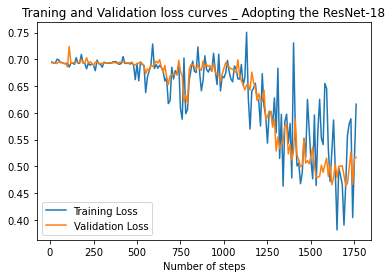

Finished Training


In [12]:
model = Net("absolute_substraction").cuda()
num_epochs = 20
best_val_loss = None
criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
threshold = 0.5
save_path = f'cifar_net.pt'
model = model.to(device)


TRAIN_VGG(model, train_loaderRGB, valid_loaderRGB, num_epochs, criterion, optimizer, best_val_loss,threshold, device, save_path)

### 4.2.4 Evaluation

In [13]:
def eval(net, valid_loader):
    max_valid_acc = 0
    optimal_threshold = 0
    threshold_array = np.arange(0.0, 1.0, 0.02)
    for threshold in threshold_array:
        print(threshold)
        with torch.no_grad():
            running_loss = 0.0
            running_corrects = 0
            for input1,input2, labels in tqdm(valid_loader):

                input1 = input1.to(device)
                input2 = input2.to(device)

                labels = labels.to(device)
                labels = labels.unsqueeze(1)
                labels = labels.float()

                outputs = net(input1,input2)
                preds = torch.gt(outputs, threshold).int()

                running_corrects += torch.sum(preds == labels.data)

            valid_acc = running_corrects / float(len(valid_loader.dataset))
            print("valid_acc: ", valid_acc)
            if(valid_acc > max_valid_acc):
                max_valid_acc = valid_acc
                optimal_threshold = threshold
    return max_valid_acc,optimal_threshold
                    

In [14]:
max_valid_acc,optimal_threshold = eval(model, valid_loaderRGB)
print(max_valid_acc)
print(optimal_threshold)

0.0


  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

  0%|          | 0/13 [00:00<?, ?it/s]

tensor([[0.0068, 0.0036, 0.0636,  ..., 0.0000, 0.0000, 0.0000],
        [0.0137, 0.0384, 0.1323,  ..., 0.0000, 0.0000, 0.0000],
        [0.0245, 0.0041, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0079, 0.0398, 0.0241,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0334, 0.0151,  ..., 0.0000, 0.0000, 0.0000],
        [0.0079, 0.0215, 0.0587,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0000, 0.0264, 0.0473,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0007, 0.0523,  ..., 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0286, 0.1226,  ..., 0.0000, 0.0000, 0.0000],
        ...,
        [0.0133, 0.0873, 0.0335,  ..., 0.0000, 0.0000, 0.0000],
        [0.0118, 0.0436, 0.0578,  ..., 0.0000, 0.0000, 0.0000],
        [0.0059, 0.0142, 0.0192,  ..., 0.0000, 0.0000, 0.0000]],
       device='cuda:0')
tensor([[0.0023, 0.0310, 0.0581,  ..., 0.0337, 0.0027, 0.0056],
        [0.0096, 0.0017, 0.0404,  ..., 0.0350, 0.0042, 0.0000],
        [0.0089, 0.0147, 0.0

In [15]:
print(max_valid_acc)

tensor(0.7300, device='cuda:0')


In [16]:
print(optimal_threshold)

0.44


### Predicting output

In [17]:
test_loaderRGB = DataLoader(test_setRGB,
                         num_workers = 0,
                         batch_size=1,
                         shuffle=False)
test_df = pd.read_csv(PATH + 'test.csv')
predictions=[]
i = 0
with torch.no_grad():
    for input1,input2, label in tqdm(test_loaderRGB):
        input1 = input1.to(device)
        input2 = input2.to(device)

        outputs = model(input1,input2)
        preds = torch.gt(outputs, optimal_threshold).int()
    
        predictions.append(preds.cpu().numpy().ravel()[0])
        
test_df['target'] = predictions

test_df.to_csv("submission_Q8D_Architecture_2_ResNet18.csv", index=False)#submission.csv should be placed directly in current fold.
test_df.head(50)#show the result to be committed

  0%|          | 0/700 [00:00<?, ?it/s]

tensor([[2.1718e-01, 7.9924e-02, 1.1520e-01, 0.0000e+00, 2.3818e-02, 1.4189e-01,
         1.1065e-01, 1.9753e-01, 1.9434e-01, 4.6981e-02, 1.1431e-01, 3.7412e-02,
         0.0000e+00, 0.0000e+00, 2.6711e-02, 0.0000e+00, 2.3164e-01, 2.3942e-03,
         1.3198e-02, 1.9859e-01, 5.5306e-02, 2.2609e-01, 1.1971e-01, 0.0000e+00,
         6.5314e-02, 5.9420e-02, 6.7304e-02, 1.8820e-01, 8.8711e-02, 1.0100e-01,
         8.5246e-02, 1.2303e-02, 2.9863e-02, 4.1532e-01, 2.7403e-01, 4.0108e-02,
         7.7206e-02, 1.2831e-03, 3.6386e-02, 9.1202e-02, 6.8272e-01, 1.0513e-01,
         2.4076e-02, 2.7251e-03, 0.0000e+00, 1.5642e-01, 3.8364e-03, 7.2471e-02,
         1.0238e-02, 6.5700e-02, 4.0640e-01, 3.2311e-01, 5.8383e-02, 9.6733e-02,
         2.6474e-02, 5.9955e-02, 6.6948e-02, 9.9906e-03, 2.1298e-02, 7.7611e-02,
         1.5776e-01, 1.3683e-01, 9.2831e-02, 2.8174e-02, 1.3881e-02, 5.5901e-02,
         3.0755e-01, 1.9293e-01, 0.0000e+00, 8.9832e-01, 4.0985e-02, 3.8100e-02,
         4.9940e-02, 0.0000e

,id1,id2,target
0,4988,4973,0
1,4958,4939,0
2,4552,4891,0
3,4509,4504,1
4,4589,4587,1
5,4635,4634,1
6,4758,4751,1
7,4544,4543,1
8,4849,4887,1
9,4929,4926,0
